# Evaluation Script for Dot-Line Plots

In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

In [2]:
# ! unzip /content/drive/MyDrive/Evaluation/csv_dot_line.zip

In [3]:
# ! mv /content/content/final_csv /content

In [4]:
# ! rm -rf /content/content

## Load the binary classifier

In [5]:
# Running Sequence
# Terminate Session
# Tapas -> Reset
# Load Classifier -> Reset
# Tapas -> No Reset

In [ ]:
import tensorflow
print(tensorflow.__version__) # 2.6.0

2.6.0


In [ ]:
!pip install tensorflow==2.6

  Using cached tensorflow-2.6.0-cp37-cp37m-manylinux2010_x86_64.whl (458.3 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tapas-table-parsing 0.0.1.dev0 requires tensorflow~=2.2.0, but you have tensorflow 2.6.0 which is incompatible.


In [ ]:
import tensorflow
from tensorflow import keras
from tensorflow.keras.preprocessing.sequence import pad_sequences
import pickle

model = tensorflow.keras.models.load_model('/home/pessat/Capstone/Binary_Classifier/binary_classifier.h5')

with open('/home/pessat/Capstone/Binary_Classifier/tokenizer.pickle', 'rb') as handle:
    loaded_tokenizer = pickle.load(handle)

2021-10-25 11:18:34.124287: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2021-10-25 11:18:34.124305: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2021-10-25 11:18:35.020891: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2021-10-25 11:18:35.020909: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2021-10-25 11:18:35.020922: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (pessat145): /proc/driver/nvidia/version does not exist
2021-10-25 11:18:35.021040: I tensorflow/core/platform/cpu_feature_

In [ ]:
def binary_classifier_predict(questions):
  maxlen = 100
  seq= loaded_tokenizer.texts_to_sequences(questions)
  padded = pad_sequences(seq, maxlen=maxlen)
  predictions = model.predict(padded)

  result = []
  for e in predictions:
    result.append(e[0])

  THRESHOLD = 0.5
  tapas_questions = []
  tabfact_questions = []
  for i in range(len(result)):
      # print("Question = ", questions[i])

      # Class 0
      if result[i] < THRESHOLD:
          # print("Class 0: Tabfact")
          tabfact_questions.append(questions[i])

      else:
          # print("Class 1: Tapas")
          tapas_questions.append(questions[i])

  return tapas_questions, tabfact_questions

In [ ]:
binary_classifier_predict(
    ['How many different coloured dotlines are there ?' ,
'Is the number of dotlines equal to the number of legend labels ?' ,
'What is the number of tourist arrivals in 1997 ?' ,
'Across all years, what is the maximum number of tourist arrivals ?' ,
'Across all years, what is the minimum number of tourist departures ?' ,
'In which year was the number of tourist arrivals maximum?' ,
'In which year was the number of tourist departures minimum?' ,
'What is the total number of tourist departures in the graph ?']
) # returns tapas_questions and tabfact_questions

2021-10-25 11:18:58.263105: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


(['How many different coloured dotlines are there ?',
  'What is the number of tourist arrivals in 1997 ?',
  'Across all years, what is the maximum number of tourist arrivals ?',
  'Across all years, what is the minimum number of tourist departures ?',
  'In which year was the number of tourist arrivals maximum?',
  'In which year was the number of tourist departures minimum?',
  'What is the total number of tourist departures in the graph ?'],
 ['Is the number of dotlines equal to the number of legend labels ?'])

## Download TAPAS

In [ ]:
! pip install tapas-table-parsing

  Using cached tensorflow-2.2.3-cp37-cp37m-manylinux2010_x86_64.whl (516.4 MB)


  Using cached numpy-1.18.5-cp37-cp37m-manylinux1_x86_64.whl (20.1 MB)
  Using cached tensorflow_estimator-2.2.0-py2.py3-none-any.whl (454 kB)
  Using cached tensorboard-2.2.2-py3-none-any.whl (3.0 MB)
  Using cached gast-0.3.3-py2.py3-none-any.whl (9.7 kB)
  Using cached h5py-2.10.0-cp37-cp37m-manylinux1_x86_64.whl (2.9 MB)


  Attempting uninstall: numpy
    Found existing installation: numpy 1.19.5
    Uninstalling numpy-1.19.5:
      Successfully uninstalled numpy-1.19.5
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.6.0
    Uninstalling tensorflow-estimator-2.6.0:
      Successfully uninstalled tensorflow-estimator-2.6.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.7.0
    Uninstalling tensorboard-2.7.0:
      Successfully uninstalled tensorboard-2.7.0
  Attempting uninstall: h5py
    Found existing installation: h5py 3.1.0
    Uninstalling h5py-3.1.0:
      Successfully uninstalled h5py-3.1.0
  Attempting uninstall: gast
    Found existing installation: gast 0.4.0
    Uninstalling gast-0.4.0:
      Successfully uninstalled gast-0.4.0
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.6.0
    Uninstalling tensorflow-2.6.0:
      Successfully uninstalled tensorflow-2.6.0


In [ ]:
import tensorflow
print(tensorflow.__version__) 
# First = 2.2.3
# Then = 2.6.0

2.6.0


In [ ]:
# ! gsutil cp "gs://tapas_models/2020_10_07/tapas_wtq_wikisql_sqa_inter_masklm_large_reset.zip" "tapas_model.zip" && unzip tapas_model.zip
# ! mv tapas_wtq_wikisql_sqa_inter_masklm_large_reset tapas_model

Copying gs://tapas_models/2020_10_07/tapas_wtq_wikisql_sqa_inter_masklm_large_reset.zip...
- [1 files][  3.4 GiB/  3.4 GiB]   49.4 MiB/s                                   
Operation completed over 1 objects/3.4 GiB.                                      
Archive:  tapas_model.zip
   creating: tapas_wtq_wikisql_sqa_inter_masklm_large_reset/
  inflating: tapas_wtq_wikisql_sqa_inter_masklm_large_reset/bert_config.json  
  inflating: tapas_wtq_wikisql_sqa_inter_masklm_large_reset/README.txt  
  inflating: tapas_wtq_wikisql_sqa_inter_masklm_large_reset/model.ckpt.index  
  inflating: tapas_wtq_wikisql_sqa_inter_masklm_large_reset/model.ckpt.data-00000-of-00001  
  inflating: tapas_wtq_wikisql_sqa_inter_masklm_large_reset/vocab.txt  
  inflating: tapas_wtq_wikisql_sqa_inter_masklm_large_reset/model.ckpt.meta  


## Download TABFACT

In [ ]:
# ! gsutil cp "gs://tapas_models/2020_10_07/tapas_tabfact_inter_masklm_large_reset.zip" "tabfact_model.zip" && unzip tabfact_model.zip
# ! mv tapas_tabfact_inter_masklm_large_reset tabfact_model

Copying gs://tapas_models/2020_10_07/tapas_tabfact_inter_masklm_large_reset.zip...
| [1 files][  3.4 GiB/  3.4 GiB]   56.8 MiB/s                                   
Operation completed over 1 objects/3.4 GiB.                                      
Archive:  tabfact_model.zip
   creating: tapas_tabfact_inter_masklm_large_reset/
  inflating: tapas_tabfact_inter_masklm_large_reset/bert_config.json  
  inflating: tapas_tabfact_inter_masklm_large_reset/README.txt  
  inflating: tapas_tabfact_inter_masklm_large_reset/model.ckpt.index  
  inflating: tapas_tabfact_inter_masklm_large_reset/model.ckpt.data-00000-of-00001  
  inflating: tapas_tabfact_inter_masklm_large_reset/vocab.txt  
  inflating: tapas_tabfact_inter_masklm_large_reset/model.ckpt.meta  


## Load TABFACT

In [ ]:


# from google.colab import files
import os
import glob
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import re
import json
from natsort import natsorted 
import shutil
import pandas as pd
from statistics import median
from math import floor
from math import ceil

import numpy as np
import pickle
%matplotlib inline

import tensorflow.compat.v1 as tf
import os 
import shutil
import csv
import pandas as pd
import numpy as np
import IPython
print(tf.__version__)
tf.get_logger().setLevel('ERROR')

import random

from tapas.utils import tf_example_utils
from tapas.protos import interaction_pb2
from tapas.utils import number_annotation_utils
import math




from tapas.utils import tf_example_utils
from tapas.protos import interaction_pb2
from tapas.utils import number_annotation_utils
from tapas.scripts import prediction_utils

2.6.0


In [ ]:
os.makedirs('results/tabfact/tf_examples', exist_ok=True)
os.makedirs('results/tabfact/model', exist_ok=True)
with open('results/tabfact/model/checkpoint', 'w') as f:
  f.write('model_checkpoint_path: "model.ckpt-0"')
for suffix in ['.data-00000-of-00001', '.index', '.meta']:
  shutil.copyfile(f'tabfact_model/model.ckpt{suffix}', f'results/tabfact/model/model.ckpt-0{suffix}')

In [ ]:
max_seq_length = 512
tabfact_vocab_file = "tabfact_model/vocab.txt"
tabfact_config = tf_example_utils.ClassifierConversionConfig(
    vocab_file=tabfact_vocab_file,
    max_seq_length=max_seq_length,
    max_column_id=max_seq_length,
    max_row_id=max_seq_length,
    strip_column_names=False,
    add_aggregation_candidates=False,
)
tabfact_converter = tf_example_utils.ToClassifierTensorflowExample(tabfact_config)

def tabfact_convert_interactions_to_examples(tables_and_queries, question_answer):
  """Calls Tapas converter to convert interaction to example."""
  for idx, (table, queries) in enumerate(tables_and_queries):
    interaction = interaction_pb2.Interaction()
    for position, query in enumerate(queries):
      question = interaction.questions.add()
      question.original_text = query
      question.id = f"{idx}-0_{position}"
    for header in table[0]:
      interaction.table.columns.add().text = header
    for line in table[1:]:
      row = interaction.table.rows.add()
      for cell in line:
        row.cells.add().text = cell
    number_annotation_utils.add_numeric_values(interaction)
    for i in range(len(interaction.questions)):
      try:
        yield tabfact_converter.convert(interaction, i)
      except ValueError as e:
        print(f"Can't convert interaction: {interaction.id} error: {e}")
        
def tabfact_write_tf_example(filename, examples):
  with tf.io.TFRecordWriter(filename) as writer:
    for example in examples:
      writer.write(example.SerializeToString())

def tabfact_predict_new(table_data, queries, question_answer):
  global TOTAL_CORRECT_QA, TOTAL_QA

  table = table_data
  examples = tabfact_convert_interactions_to_examples([(table, queries)], question_answer)
  tabfact_write_tf_example("results/tabfact/tf_examples/test.tfrecord", examples)
  tabfact_write_tf_example("results/tabfact/tf_examples/dev.tfrecord", [])
  
  ! python -m tapas.run_task_main \
    --task="TABFACT" \
    --output_dir="results" \
    --noloop_predict \
    --test_batch_size={len(queries)} \
    --tapas_verbosity="ERROR" \
    --compression_type= \
    --reset_position_index_per_cell \
    --init_checkpoint="tabfact_model/model.ckpt" \
    --bert_config_file="tabfact_model/bert_config.json" \
    --mode="predict" 2> error


  results_path = "results/tabfact/model/test.tsv"
  all_results = []
  df = pd.DataFrame(table[1:], columns=table[0])
  # display(IPython.display.HTML(df.to_html(index=False)))
  print()
  with open(results_path) as csvfile:
    reader = csv.DictReader(csvfile, delimiter='\t')
    for row in reader:
      supported = int(row["pred_cls"])
      all_results.append(supported)
      score = float(row["logits_cls"])
      position = int(row['position'])
      print("> " + queries[position])
      print("EXPECTED = ", question_answer[queries[position]])
      
    #   print(queries[position])
      if supported:
        # print("> YES")
        print("PREDICTED = ", "Yes")
        answer_text = "Yes"
      else:
        # print("> NO")
        print("PREDICTED = ", "No")
        answer_text = "No"

      print()

      TOTAL_QA += 1

      if answer_text == question_answer[queries[position]]:
          TOTAL_CORRECT_QA += 1

          
      print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)} \n\n")


  print()
  return all_results

## Load TAPAS

In [ ]:
os.makedirs('results/wtq/tf_examples', exist_ok=True)
os.makedirs('results/wtq/model', exist_ok=True)
with open('results/wtq/model/checkpoint', 'w') as f:
  f.write('model_checkpoint_path: "model.ckpt-0"')
for suffix in ['.data-00000-of-00001', '.index', '.meta']:
  shutil.copyfile(f'tapas_model/model.ckpt{suffix}', f'results/wtq/model/model.ckpt-0{suffix}')

In [ ]:
def isfloat(value):
  try:
    float(value)
    return True
  except ValueError:
    return False

In [ ]:
def Average(Values) :  
  if '' in Values:
    return str('0')
  res_avg = sum(float(x) for x in Values if x != 'nan') / len(Values)
  return str(res_avg)
  # res_average = np.mean(Values)
  # return str(res_average)

def Count(Values) :
  return str(len(Values))

def Sum(Values):
  if isfloat(Values[0]):
    return str(sum(float(x) for x in Values if x != 'nan'))
  else:
    return str("")
  # return str(np.sum(Values))

def Max(Values):
  pass

def Min(Values):
  pass

In [ ]:
def predict_new(table_data, queries, question_answer, display = False):
  global TOTAL_CORRECT_QA, TOTAL_QA
  table = table_data
  examples = convert_interactions_to_examples([(table, queries)])
  write_tf_example("results/wtq/tf_examples/test.tfrecord", examples)
  write_tf_example("results/wtq/tf_examples/random-split-1-dev.tfrecord", [])
  
  ! python -m tapas.run_task_main \
    --task="WTQ" \
    --output_dir="results" \
    --noloop_predict \
    --test_batch_size={len(queries)} \
    --tapas_verbosity="ERROR" \
    --compression_type= \
    --reset_position_index_per_cell \
    --init_checkpoint="tapas_model/model.ckpt" \
    --bert_config_file="tapas_model/bert_config.json" \
    --mode="predict" 2> error

  ANSWERS = []
  results_path = "results/wtq/model/test.tsv"
  all_coordinates = []
  df = pd.DataFrame(table[1:], columns=table[0])
  print("\n\n\n")
  # display(IPython.display.HTML(df.to_html(index=False)))
  Method_mapper = {'AVERAGE' : Average , 'SUM' : Sum , 'COUNT' : Count , 'MAX' : Max , 'MIN' : Min}
  print()
  with open(results_path) as csvfile:
    reader = csv.DictReader(csvfile, delimiter='\t')
    query_index = 0

    for row in reader:
      coordinates = sorted(prediction_utils.parse_coordinates(row["answer_coordinates"]))
      all_coordinates.append(coordinates)
      answers = ', '.join([table[row + 1][col] for row, col in coordinates])
      position = int(row['position'])
      aggregation = aggregation_to_string(int(row["pred_aggr"]))
      
      if display:
        print(">", queries[position])
      answer_text = str(answers)
      #print(aggregation ,  type(aggregation)  , answers , type(answers) , answer_text , type(answer_text) , sep = "\n")
      # print(aggregation, answer_text)

      if re.search("list", queries[position]):
          answer_text += "\n"
          ANSWERS.append(answer_text)

      elif aggregation != "NONE":
        num_results = answer_text.split(",")
        num_results = [num.strip() for num in num_results]

        num_results = [float(x) if x.isnumeric() else x for x in num_results]
        
        #print("NUMS : " , num_results)

        # answer_text = f"{answer_text}"

        actual_answer = Method_mapper[aggregation](num_results)

        answer_text =  actual_answer + "\n"
        ANSWERS.append(actual_answer)
    
      else:
          # answer_text += "\n"
          ANSWERS.append(answer_text)
    
      if display:
        # print(answer_text)

        print("EXPECTED = ", question_answer[queries[position]])
        print("PREDICTED = ", answer_text)

        print("\n")

        TOTAL_QA += 1

        if isfloat(answer_text):
            buffer = float(question_answer[queries[position]]) * 0.05
            lower = float(question_answer[queries[position]]) - buffer
            upper = float(question_answer[queries[position]]) + buffer
            
            if float(answer_text) * -1 > 0:
              lower, upper = upper, lower

            if lower <= float(answer_text) <= upper:
              TOTAL_CORRECT_QA += 1

        elif answer_text == question_answer[queries[position]]:
          TOTAL_CORRECT_QA += 1

          
        print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)} \n\n")

  return ANSWERS

In [ ]:
max_seq_length = 512
vocab_file = "tapas_model/vocab.txt"
config = tf_example_utils.ClassifierConversionConfig(
    vocab_file=vocab_file,
    max_seq_length=max_seq_length,
    max_column_id=max_seq_length,
    max_row_id=max_seq_length,
    strip_column_names=False,
    add_aggregation_candidates=False,
)
converter = tf_example_utils.ToClassifierTensorflowExample(config)


def convert_interactions_to_examples(tables_and_queries):
  """Calls Tapas converter to convert interaction to example."""
  for idx, (table, queries) in enumerate(tables_and_queries):
    interaction = interaction_pb2.Interaction()
    for position, query in enumerate(queries):
      question = interaction.questions.add()
      question.original_text = query
      question.id = f"{idx}-0_{position}"
    for header in table[0]:
      interaction.table.columns.add().text = header
    for line in table[1:]:
      row = interaction.table.rows.add()
      for cell in line:
        row.cells.add().text = cell
    number_annotation_utils.add_numeric_values(interaction)
    for i in range(len(interaction.questions)):
      try:
        yield converter.convert(interaction, i)
      except ValueError as e:
        print(f"Can't convert interaction: {interaction.id} error: {e}")
        
def write_tf_example(filename, examples):
  with tf.io.TFRecordWriter(filename) as writer:
    for example in examples:
      writer.write(example.SerializeToString())

def aggregation_to_string(index):
  if index == 0:
    return "NONE"
  if index == 1:
    return "SUM"
  if index == 2:
    return "AVERAGE"
  if index == 3:
    return "COUNT"
  raise ValueError(f"Unknown index: {index}")

## Load Functions used in TAPAS

In [ ]:
# def get_csvfile_path(ind):
#   return "/content/plotqa/TEST/csv/FrRCNN_test_predicted_tables_0.5/"+str(annot[ind]["image_index"])+".csv"

In [ ]:
def get_list_of_list(path, display = False):
    df = pd.read_csv(path)
    df = df.astype(str)
    df.drop(axis = 1 , labels = ['Unknown' , 'xlabel' , 'ylabel' ,'title' , 'legend orientation'] , inplace= True, errors = 'ignore')
    df = df.sort_values(df.columns[0],ignore_index=True)
    if display:
        print(df)

    list_of_list_1 = [[]]
    list_of_list_1[0] = list(df.columns)
    list_of_list_1.extend(df.values.tolist()) 
    return list_of_list_1

In [ ]:
def display_image_qa_pairs(img_id):

  # print("png/"+str(img_id)+".png")
  for i, path in enumerate(images):
    if re.search("png/"+str(img_id)+".png", path):
      break

  # Image
  print("\nImage:\n")
  print(images[i])
  img = mpimg.imread(images[i])
  imgplot = plt.imshow(img)
  plt.show()

  questions = list()
  answers = list()
  # print("\nQA Pairs:\n")
  img_index = annot[i]["image_index"]
  count = 0

  for j in qa["qa_pairs"]:
    if j["image_index"] == img_index:
      count  += 1

      if j['template'] != "structural":
        questions.append(j['question_string'])
        answers.append(j['answer'])

  print("Number of QA = ", len(questions))
  print("\n\n")
  return i, questions, answers

In [ ]:
def spilt_ratio(query):
    s1 = []
    s2 = []
    flag = False
    query = query.split()
    i = 0
    while i < len(query):
        # print(s1, s2)
        if query[i] != "to":
            s1.append(query[i])
            i = i + 1
        elif i+1 < len(query):
            s2 = s1[:-1]
            s2.append(query[i+1])
            flag = True
            i = i + 2
        while flag and i < len(query):
            # s1.append(query[i])
            s2.append(query[i])
            i += 1
    return " ".join(s1), " ".join(s2)

# works - "What is the ratio of male workers in 1981 to 1980 for the country Hong Kong"
# doesn't work - What is the ratio of the education completion rate of male students in Burkina Faso to that in Cabo Verde ?

In [ ]:
def find_ratio(q, list_of_list, question_answer):
    q = re.sub("ratio", "", q , flags = re.I)
    q1, q2 = spilt_ratio(q)
    # print(q1)
    # print(q2)
    res = predict_new(list_of_list, [q1, q2], question_answer)
    # print(res)
    return str(float(res[0]) / float(res[1]))

In [ ]:
def find_trend(q, list_of_list, question_answer):
    def is_increasing(vals):
        return all(i <= j for i, j in zip(vals, vals[1:]))

    def is_decreasing(vals):
        return all(i >= j for i, j in zip(vals, vals[1:]))


    query = "get the list of all values" + q[re.search("trend", q, flags = re.I).end():]
    list_val = predict_new(list_of_list, [query], question_answer) 
    vals = list(map(lambda val: float(val), list_val[0].split(", ")))

    if is_increasing(vals):
        return "INCREASING"
    elif is_decreasing(vals):
        return "DECREASING"
    else:
        return "NONE"

In [ ]:
from difflib import SequenceMatcher
def find_median(q, list_of_list, columns, question_answer, percent):
    for col in columns:
        q = q.lower()
        p = col.lower()
        match = SequenceMatcher(None, p, q).find_longest_match(0, len(p), 0, len(q))

        LOWER_BOUND = int((percent * len(p)) / 100)

        # print( LOWER_BOUND , len(p[match.a: match.a + match.size]) ,  len(p))
        if LOWER_BOUND < len(p[match.a: match.a + match.size]) <= len(p):
            # print(p[match.a: match.a + match.size])
            query = "get the list of all values in " + col

            # print(query)
            list_val = predict_new(list_of_list, [query], question_answer)

            # print(list_val)
            vals = list(map(lambda val: float(val), list_val[0].split(", ")))
            return median(vals)

In [ ]:
def find_difference(q, list_of_list, column, question_answer):
    q = "".join(q.split("difference between")[-1]).strip()
    pat = re.compile(r'\band\b')
    x = pat.search(q) 
    if x != None:
      q1 = q[0: x.span()[0]]
      name2 = q[x.span()[1] :] 
      qsplit = q1.split()
      q2 = qsplit[:-1]
      q2 = ' '.join(q2) + name2
      # print(q1)
      # print(q2)
      val1, val2 = predict_new(list_of_list, [q1, q2], question_answer) 
      # print(val1, val2)
      return str(float(val1) - float(val2))

In [ ]:
def find_range(q, list_of_list, question_answer):
  subquery = q.split("range")[-1].strip()
  q1 = "maximum " + subquery
  q2 = "minimum " + subquery
  maximum, minimum = predict_new(list_of_list, [q1, q2], question_answer)
  return str(float(maximum) - float(minimum))

In [ ]:
def find_quartiles(q, list_of_list, columns, question_answer):
  for col in columns:
    if re.search(col, q):
      query = "get the list of all values in " + col
      list_val = predict_new(list_of_list, [query], question_answer)
      vals = list(map(lambda val: float(val), list_val[0].split(", ")))
      vals.sort()
      n = len(vals)

      q1 = (n + 1)/4
      q3 = 3*(n + 1)/4
      # print(n, q1, q3)
      if (n + 1) % 4:
        q1_left = floor(q1)
        q1_right = ceil(q1)
        q1_value = ( vals[q1_left-1] + vals[q1_right-1] ) / 2

      else:
        q1_value = vals[q1-1]


      if (3*(n + 1)) % 4:
        q3_left = floor(q3)
        q3_right = ceil(q3)
        q3_value = ( vals[q3_left-1] + vals[q3_right-1] ) / 2
      else:
        q3_value = vals[q3-1]

      q2_value = median(vals)

      return str(q1_value), str(q2_value), str(q3_value)

In [ ]:
def find_iqr(q1, q3):
  return str(float(q3) - float(q1))

In [ ]:
def tapas_find_answers(question, columns, list_of_list, question_answer, dic_labels):

    global TOTAL_CORRECT_QA, TOTAL_QA

    unanswered = []
    for qes in question:

        try:

          qes = qes.lower()
          ANSWERED = False
          if re.search("x-axis", qes):
              ans = dic_labels['xlabel']
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("y-axis", qes):
              ans = dic_labels['ylabel']
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("title", qes):
              ans = dic_labels['title']
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          
          elif re.search("ratio", qes):
              ans = find_ratio(qes.lower(), list_of_list, question_answer)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("median", qes):
              ans = find_median(qes, list_of_list, columns, question_answer, 40)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("trend", qes):
              ans = find_trend(qes, list_of_list, question_answer)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("difference", qes):
              ans = find_difference(qes, list_of_list, columns, question_answer)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          # elif re.search("interquartile range", qes):
          #     q1, _, q3 = find_quartiles(qes, list_of_list, columns)
          #     ans = find_iqr(q1, q3)
          #     print(">", qes)
          #     print("PREDICTED = ", answer_text)
          #     print("EXPECTED = ", question_answer[qes])
          #     print("\n")

          # elif re.search("quartiles", qes):
          #     q1, q2, q3 = find_quartiles(qes, list_of_list, columns)
          #     print(">", qes)
          #     print("FIRST QUARTILE (Q1) = ", q1)
          #     print("SECOND QUARTILE (Q2) = ", q2)
          #     print("THIRD QUARTILE (Q3) = ", q3)
          #     print("\n")

              
          elif re.search("range", qes):
              ans = find_range(qes, list_of_list, question_answer)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          else:
              unanswered.append(qes)

          if ANSWERED:
            TOTAL_QA += 1

            if isfloat(ans):
              buffer = float(question_answer[qes]) * 0.05
              lower = float(question_answer[qes]) - buffer
              upper = float(question_answer[qes]) + buffer
              
              if float(ans) * -1 > 0:
                lower, upper = upper, lower

              if lower <= float(ans) <= upper:
                TOTAL_CORRECT_QA += 1

            elif ans == question_answer[qes]:
              TOTAL_CORRECT_QA += 1
            
            print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)}\n\n")

        except:
          TOTAL_QA += 1
          print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)}\n\n")
          pass
        
    try:

      if unanswered:
          res = predict_new(list_of_list, unanswered, question_answer, True) 

    except:
      pass

## Load Functions used in TABFACT

In [ ]:
def part_answer(parts, columns, list_of_list, question_answer):
  to_return = []
  for part in parts:
    if re.search("ratio", part, flags = re.I):
        ans = find_ratio(part, list_of_list, question_answer)
        to_return.append(ans)

    elif re.search("median", part, flags = re.I):
        ans = find_median(part, list_of_list, columns, question_answer, 40)
        to_return.append(ans)

    elif re.search("sum", part, flags = re.I):
        ans = predict_new(list_of_list, [part], question_answer)
        to_return.append(ans[0])

    elif re.search("difference", part, flags = re.I):
        ans = find_difference(part, list_of_list, columns, question_answer)
        to_return.append(ans)

    elif re.search("trend", part, flags = re.I):
        ans = find_trend(part, list_of_list, question_answer)
        to_return.append(ans)

    else:
        ans = predict_new(list_of_list, [part], question_answer)
        to_return.append(ans[0])
        # return "NOT_FOUND"
  return to_return        

def tabfact_find_answers(list_of_list, question, columns, question_answer):

    global TOTAL_CORRECT_QA, TOTAL_QA

    unanswered = []
    pattern = re.compile(r'\bgreat\b|\bgreater\b|\bhigh\b|\bhigher\b|\blow\b|\blower\b|\bless\b|\blesser\b|\bsmall\b|\bsmaller\b|\bequal\b', flags=re.I | re.X)
    prelim = re.compile(r'\bratio\b|\bmedian\b|\bdifference\b|\bsum\b', flags=re.I | re.X)
    incdec = re.compile(r'\bincrease\b|\bincreasing\b|\bdecrease\b|\bdecreasing\b', flags=re.I | re.X)
    for qes in question:
        qes = qes.lower()
        if prelim.search(qes) != None:
          x = pattern.search(qes)
          if x != None:
            try:
              first_part = qes[0: x.span()[0]]
              second_part = qes[x.span()[1] : ] 

              first_ans , second_ans = part_answer([first_part, second_part],  columns, list_of_list, question_answer)
              # second_ans = part_answer(second_part, columns, list_of_list) 

              exact_match = x.group().lower()
              fl_fans = round(float(first_ans), 2)
              fl_sans = round(float(second_ans), 2)

              answer_got = "No"
              if exact_match == "equal":
                if fl_fans == fl_sans:
                    answer_got = "Yes"
                else:
                  answer_got = "No"

              elif exact_match == "great" or exact_match == "greater" or exact_match == "high" or exact_match == "higher":
                if fl_fans > fl_sans:
                  answer_got = "Yes"
                else:
                  answer_got = "No"

              else:
                if fl_fans < fl_sans:
                  answer_got = "Yes"
                else:
                  answer_got = "No"

              print("PREDICTED = ", answer_got)
              print("EXPECTED = ", question_answer[qes])
              print("\n")

              TOTAL_QA +=1

              if question_answer[qes] == answer_got:
                TOTAL_CORRECT_QA +=1
              
              print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)}\n\n")
            except:
              unanswered.append(qes)
          else:
            unanswered.append(qes) 
        else:
          unanswered.append(qes)
          # find_incdec  = incdec.search(qes)
          # if find_incdec != None:
          #   get_trend_for_qes = qes[0: find_incdec.span()[0]]
          #   final_qes = ' '.join(get_trend_for_qes.split()[:-1])
          #   final_qes = "get trend for " + final_qes
          #   got_ans = part_answer([final_qes],  columns, list_of_list)
          #   ans = got_ans[0]

          #   exact_match = find_incdec.group().lower()

          #   if exact_match in ["increase", "increasing"]:
          #     if ans == "INCREASING":
          #        print("> SUPPORTS:", qes)
          #     else:
          #        print("> REFUTES", qes)
          #   elif exact_match in ["decrease", "decreasing"]:
          #     if ans == "DECREASING":
          #       print("> SUPPORTS:", qes)
          #     else:
          #       print("> REFUTES", qes)
          #   else:
          #     print("> REFUTES", qes)
          
          # else:
          #   unanswered.append(qes)


    if unanswered:
        res = tabfact_predict_new(list_of_list, unanswered, question_answer) 

In [ ]:
# !rm /content/tabfact_model.zip

In [ ]:
# !rm /content/tapas_model.zip

## Load Images and Annotations

In [ ]:
# !mkdir "plotqa"

# # Images

# # https://drive.google.com/file/d/1MpqaHqqPRGjRht9w672DJbxMwZx1j3qC/view?usp=sharing
# !gdown -O "TEST.tar.gz" --id 1MpqaHqqPRGjRht9w672DJbxMwZx1j3qC

# !tar -xvf  '/content/TEST.tar.gz' -C '/content/plotqa/'

# !rm TEST.tar.gz

Streaming output truncated to the last 5000 lines.
TEST/png/9525.png
TEST/png/27535.png
TEST/png/2324.png
TEST/png/24199.png
TEST/png/5976.png
TEST/png/21791.png
TEST/png/28934.png
TEST/png/17043.png
TEST/png/4326.png
TEST/png/21901.png
TEST/png/18113.png
TEST/png/27814.png
TEST/png/20542.png
TEST/png/10557.png
TEST/png/14240.png
TEST/png/9661.png
TEST/png/22899.png
TEST/png/20728.png
TEST/png/16651.png
TEST/png/6325.png
TEST/png/24477.png
TEST/png/30715.png
TEST/png/23348.png
TEST/png/14643.png
TEST/png/17510.png
TEST/png/3392.png
TEST/png/23341.png
TEST/png/1946.png
TEST/png/32301.png
TEST/png/10984.png
TEST/png/2385.png
TEST/png/30516.png
TEST/png/13308.png
TEST/png/17750.png
TEST/png/28523.png
TEST/png/8054.png
TEST/png/25213.png
TEST/png/28977.png
TEST/png/29057.png
TEST/png/12706.png
TEST/png/12463.png
TEST/png/791.png
TEST/png/5352.png
TEST/png/20372.png
TEST/png/1647.png
TEST/png/19889.png
TEST/png/7593.png
TEST/png/24825.png
TEST/png/29991.png
TEST/png/789.png
TEST/png/13106.p

In [ ]:

import os
import glob
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import re
import json
from natsort import natsorted 
import shutil
import pandas as pd
from statistics import median
from math import floor
from math import ceil
from distutils.dir_util import copy_tree

import numpy as np
import pickle
%matplotlib inline

In [ ]:
images = natsorted(glob.glob("/home/pessat/Capstone/TEST/png/*png"))
print(f"Number of Images in Testing set = {len(images)}")

Number of Images in Testing set = 33657


In [ ]:
with open('/home/pessat/Capstone/TEST/annotations.json') as f:
  annot = json.load(f)

print(type(annot))   # List of dict 
print(len(annot))
annot = sorted(annot, key=lambda k: k['image_index']) 

<class 'list'>
33657


In [ ]:
with open('/home/pessat/Capstone/TEST/qa_pairs.json') as fp:
    qa = json.load(fp)
print(len(qa["qa_pairs"]))
print(qa["qa_pairs"][0])

1228313
{'image_index': 0, 'qid': 'S7', 'question_string': 'How many different coloured dotlines are there ?', 'answer_bbox': [], 'template': 'structural', 'answer': 2, 'answer_id': 0, 'type': 'dot', 'question_id': 0}


In [ ]:
import glob

In [ ]:
csvs = glob.glob("/home/pessat/Capstone/content/final_csv/*.csv")

In [ ]:
len(csvs)

3646

In [ ]:
plot_types = dict()
for item in annot:
  if item["type"] not in plot_types:
    plot_types[item["type"]] = [item["image_index"]]
  else:
    plot_types[item["type"]].append(item["image_index"])

In [ ]:
for k in plot_types:
    print(f"{k} = {len(plot_types[k])}")

dot_line = 5574
hbar_categorical = 11292
line = 5549
vbar_categorical = 11242


## TESTING

In [ ]:
# import collections
# map_csv_category = collections.defaultdict(list)
# names = [os.path.basename(x) for x in glob.glob("/content/final_csv/*.csv")]
# for i in names:
#   if int(i[:-4]) in plot_types['hbar_categorical']:
#     map_csv_category['hbar_categorical'].append(i[:-4])
#   elif int(i[:-4]) in plot_types['vbar_categorical']:
#     map_csv_category['vbar_categorical'].append(i[:-4])
#   elif int(i[:-4]) in plot_types['dot_line']:
#     map_csv_category['dot_line'].append(i[:-4])
#   elif int(i[:-4]) in plot_types['line']:
#     map_csv_category['line'].append(i[:-4]) 
#   else:
#     continue

In [ ]:
f_dotline = open("/home/pessat/Capstone/dot-line_remaining.txt", "r")
content = f_dotline.read()
content_list = content.split("\n")

In [ ]:
dl_IMAGE_IDs = content_list[:-1]

In [ ]:
len(dl_IMAGE_IDs)

1726

In [ ]:
f_line = open("/home/pessat/Capstone/line_remaining.txt", "r")
content = f_line.read()
content_list = content.split("\n")

In [ ]:
l_IMAGE_IDs  = content_list[:-1]

In [ ]:
len(l_IMAGE_IDs )

1720

In [ ]:
# dl_IMAGE_IDs = map_csv_category['dot_line']

In [ ]:
# l_IMAGE_IDs = map_csv_category['line']

In [ ]:
df_dl = pd.read_csv("/home/pessat/Capstone/dot_line_2.csv")

In [ ]:
dl_IMAGE_IDs

['4666',
 '3447',
 '282',
 '1383',
 '5526',
 '2308',
 '246',
 '4116',
 '3020',
 '1526',
 '1412',
 '2434',
 '2439',
 '4431',
 '4064',
 '5567',
 '704',
 '2113',
 '5005',
 '1480',
 '2198',
 '4442',
 '445',
 '1881',
 '1750',
 '4866',
 '494',
 '4766',
 '5539',
 '4510',
 '1314',
 '4379',
 '3000',
 '2745',
 '1106',
 '684',
 '3668',
 '1845',
 '3632',
 '2328',
 '3836',
 '885',
 '3825',
 '3235',
 '5529',
 '1951',
 '2573',
 '2284',
 '3782',
 '708',
 '1340',
 '3649',
 '4091',
 '2969',
 '3932',
 '3144',
 '415',
 '874',
 '3948',
 '707',
 '451',
 '336',
 '2410',
 '3893',
 '4326',
 '5389',
 '3251',
 '4331',
 '1286',
 '406',
 '1925',
 '353',
 '4032',
 '3182',
 '2607',
 '420',
 '2225',
 '4623',
 '3113',
 '4877',
 '2790',
 '3356',
 '5045',
 '4886',
 '5396',
 '3350',
 '1627',
 '47',
 '2351',
 '3639',
 '4904',
 '418',
 '4122',
 '2623',
 '1423',
 '4637',
 '620',
 '5490',
 '3469',
 '805',
 '816',
 '2016',
 '1226',
 '2167',
 '5040',
 '4040',
 '2135',
 '5491',
 '4010',
 '5092',
 '765',
 '970',
 '5463',
 '2665'

In [ ]:
already_done  = [str(i) for i in list(df_dl['Image ID'])]

In [ ]:
dl_IMAGE_IDs = [image for image in dl_IMAGE_IDs if image not in already_done]

In [ ]:
len(dl_IMAGE_IDs)

1226

### dot_line

In [ ]:
sample_dl_IMAGE_IDs = dl_IMAGE_IDs

In [ ]:
# already_done = [str(i) for i in list(pd.read_csv("/content/dot_line.csv")['Image ID'])]
# already_done_1 = [str(i) for i in list(pd.read_csv("/content/dot_line_1.csv")['Image ID'])]
# combined = already_done + already_done_1

In [ ]:
# set(sample_dl_IMAGE_IDs).intersection(set(combined))

set()

Image number =  1




Image:

/home/pessat/Capstone/TEST/png/4377.png


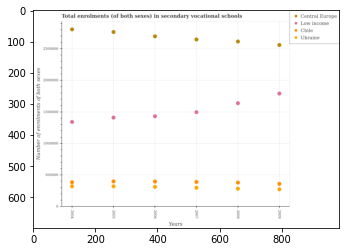

Number of QA =  29





,Years,Central Europe,Chile,Ukraine,Low income
0,2004,2.822842e+06,393342.900059,327603.494325,1.351283e+06
1,2009,2.573709e+06,367059.403961,281693.028035,1.804096e+06
2,2008,2.630519e+06,388267.081905,292308.121090,1.650053e+06
3,2005,2.781584e+06,407311.860996,328206.531915,1.421134e+06
4,2006,2.712730e+06,403677.018686,319949.811320,1.441399e+06
5,2007,2.662893e+06,397500.717353,306242.942123,1.508334e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in low income in 2007 and that in 2008 ?
PREDICTED =  -141719.57407600014
EXPECTED =  -141956.25




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in ukraine in 2006 and the number of enrolments in secondary schools in chile in 2008?
PREDICTED =  27641.69023037562
EXPECTED =  -67826.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the number of enrolments in secondary schools in central europe and number of enrolments in secondary schools 

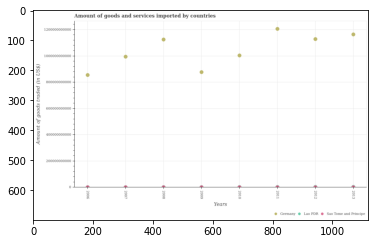

Number of QA =  28





,Years,Lao PDR,Sao Tome and Principe,Germany
0,2006,NaN,4.564914e+09,8.537935e+11
1,2008,NaN,4.443903e+09,1.122428e+12
2,2009,NaN,4.498719e+09,8.756477e+11
3,2007,NaN,4.730125e+09,9.932361e+11
4,2013,NaN,4.476931e+09,1.161405e+12
5,2010,NaN,4.942728e+09,1.001933e+12
6,2012,NaN,5.502335e+09,1.126402e+12
7,2011,NaN,5.356275e+09,1.203351e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services imported in germany in 2006 and that in 2011 ?
PREDICTED =  -1203351132731.4858
EXPECTED =  -351206000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services imported in sao tome and principe in 2013 and the total amount of goods and services imported in lao pdr in 2008?
PREDICTED =  -8920834360.901108
EXPECTED =  -1274524801.8




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total amount of goods and services imported in sao tome and principe and total

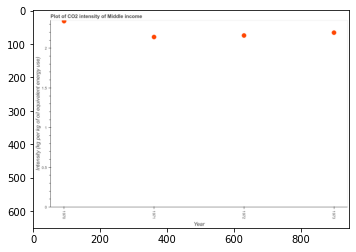

Number of QA =  24





,Year,Intensity (kg per kg of oil equivalent energy use)
0,1973,2.189958
1,1970,2.335131
2,1971,2.135776
3,1972,2.155267


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 intensity in 1971 and 1972 ?
PREDICTED =  -0.0194911336766177
EXPECTED =  -0.019123989871030034




				 1 / 1 = 1.0


> what is the median co2 intensity ?
PREDICTED =  None
EXPECTED =  2.178104922092955




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the co2 intensity in 1971 to that in 1973 ?
PREDICTED =  0.9752587405776567
EXPECTED =  0.9750120276803441




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest co2 intensity ?
PREDICTED =  0.0
EXPECTED =  0.14527816708811025




				 2 / 5 = 0.4


is_built_with_cuda: T

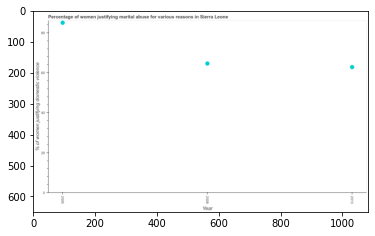

Number of QA =  24





,Year,% of women justifying domestic violence
0,2005,85.486238
1,2008,65.046857
2,2013,63.242902


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying marital abuse in 2005 and 2013 ?
PREDICTED =  22.2433363559037
EXPECTED =  22.200000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of women justifying marital abuse ?
PREDICTED =  2008.0
EXPECTED =  64.6




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of women justifying marital abuse in 2005 to that in 2013 ?
PREDICTED =  1.3517127729570355
EXPECTED =  1.3535031847133758




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finis

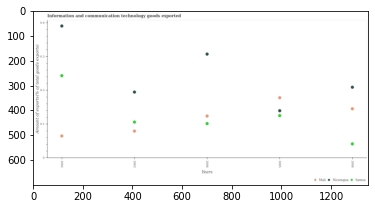

Number of QA =  28





,Years,Unnamed: 1,Samoa,Nicaragua
0,2003,0.080245,0.107059,0.195677
1,2006,0.146373,0.042420,0.210204
2,2002,0.065901,0.244136,0.391181
3,2004,0.124947,0.102573,0.308014
4,2005,0.179012,0.126162,0.140320


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in nicaragua in 2003 and that in 2005 ?
PREDICTED =  0.05535774747545172
EXPECTED =  0.055277763399999985




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in nicaragua in 2004 and the amount of goods exported in mali in 2005?
PREDICTED =  0.16769418835793862
EXPECTED =  0.12915345649999987




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the amount of goods exported in mali and amount of goods exported in samoa ?
PREDICTED =  0.0
EXPECTED =  0.022289585




				 1 / 3 = 0.3

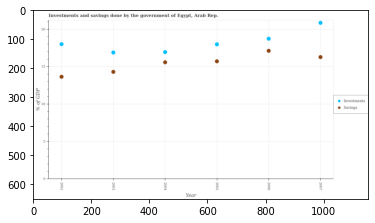

Number of QA =  27





,Year,Investments,Savings
0,2006,18.875116,17.254347
1,2004,17.074036,15.705830
2,2002,18.134171,13.756375
3,2005,18.117626,15.834332
4,2003,17.019559,14.423906
5,2007,21.015414,16.415275


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the savings of government in 2003 and that in 2005 ?
PREDICTED =  -1.4104258633361262
EXPECTED =  -1.4109052571538




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investments of government in 2006 and the savings of government in 2002?
PREDICTED =  0.7409450305193594
EXPECTED =  5.086014457698498




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the investments of government and savings of government ?
PREDICTED =  -72.37465024123242
EXPECTED =  4.3547109699140005




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_avail

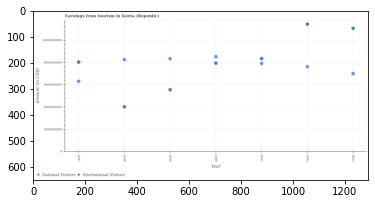

Number of QA =  27





,Year,International Visitors,National Visitors
0,1998,4.044441e+09,8.255557e+09
1,2000,7.947367e+09,8.528097e+09
2,2003,1.105403e+10,7.004162e+09
3,2001,8.348354e+09,7.926561e+09
4,1999,5.562136e+09,8.340003e+09
5,2002,1.142740e+10,7.623132e+09
6,1997,8.039643e+09,6.320575e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from national visitors in 2002 and that in 2003 ?
PREDICTED =  618969764.4672956
EXPECTED =  616000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from national visitors in 1999 and the amount earned from international visitors in 2002?
PREDICTED =  716871304.9854889
EXPECTED =  -3103000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the amount earned from national visitors and amount earned from international visitors ?
PREDICTED =  904965167.6800661
EXPECTED =  4236000000




				 1 

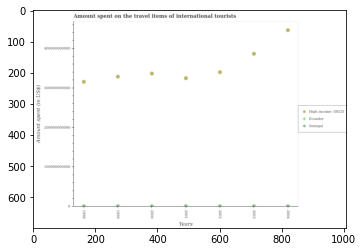

Number of QA =  28





,Years,High income: OECD,Ecuador,Senegal
0,1998,3.162883e+11,NaN,1.763127e+09
1,2003,3.872622e+11,NaN,1.776993e+09
2,2004,4.470163e+11,NaN,1.820009e+09
3,1999,3.292740e+11,NaN,1.667050e+09
4,2001,3.255961e+11,NaN,1.829598e+09
5,2002,3.408022e+11,NaN,1.768822e+09
6,2000,3.374799e+11,NaN,1.902292e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of international tourists in senegal in 1998 and that in 2001 ?
PREDICTED =  -66470523.350835085
EXPECTED =  11000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of international tourists in senegal in 2003 and the amount spent on the travel items of international tourists in ecuador in 2001?
PREDICTED =  -52604474.19196606
EXPECTED =  -285000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the amount spent on the travel items of international t

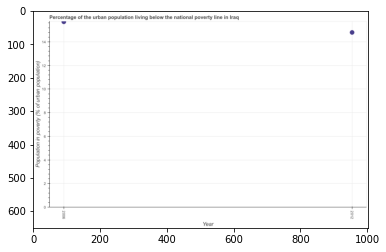

Number of QA =  20





,Year,Population in poverty (% of urban population)
0,2006,15.707092
1,2012,14.817993


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population living below poverty line in 2006 and 2012 ?
PREDICTED =  0.8890989226459478
EXPECTED =  0.8999999999999986




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of urban population living below poverty line ?
PREDICTED =  15.262542559330303
EXPECTED =  15.25




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of urban population living below poverty line in 2006 to that in 2012 ?
PREDICTED =  1.0
EXPECTED =  1.0608108108108107




				 2 / 3 = 0.6667


> what is the difference between two consecutive major ticks on t

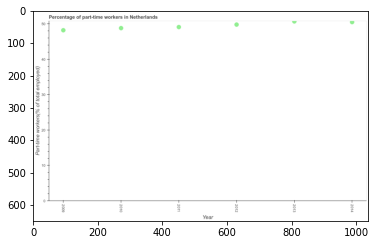

Number of QA =  24





,Year,Part-time workers(% of total employed)
0,2011,49.048711
1,2013,50.628763
2,2009,48.145478
3,2010,48.736300
4,2012,49.742883
5,2014,50.454094


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time workers in 2011 and 2012 ?
PREDICTED =  -0.6941717845822737
EXPECTED =  -0.7000007629393963




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time workers ?
PREDICTED =  2011.5
EXPECTED =  49.4499988555908




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of part-time workers in 2010 to that in 2013 ?
PREDICTED =  0.962620798351705
EXPECTED =  0.9625246253000481




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 

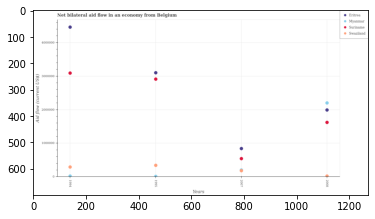

Number of QA =  29





,Years,Suriname,Eritrea,Myanmar,Swaziland
0,1994,3.094672e+06,4.465329e+06,2.778922e+04,300432.483378
1,2008,1.627071e+06,1.998225e+06,2.206345e+06,26653.027267
2,1995,2.916850e+06,3.106490e+06,2.170408e+04,349837.884026
3,2007,5.487088e+05,8.489251e+05,NaN,192752.149433


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in myanmar in 2007 and that in 2008 ?
PREDICTED =  -2206344.9988109157
EXPECTED =  -2000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in swaziland in 2008 and the net bilateral aid flow in myanmar in 2007?
PREDICTED =  -166099.12216675296
EXPECTED =  -180000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the net bilateral aid flow in swaziland and net bilateral aid flow in myanmar ?
PREDICTED =  349834.88402615354
EXPECTED =  -2180000.0




				 0 / 3 = 0.0


is_bu

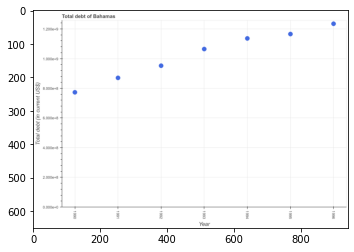

Number of QA =  24





,Year,Total debt (in current US$)
0,1990,0.772245
1,1995,1.162634
2,1994,1.133266
3,1993,1.062301
4,1996,1.231960
5,1992,0.950565
6,1991,0.869474


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in 1991 and 1995 ?
PREDICTED =  -0.29315995099232395
EXPECTED =  -295400000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total debt ?
PREDICTED =  1.2319601239177569
EXPECTED =  1064700000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total debt in 1994 to that in 1995 ?
PREDICTED =  0.9747406114195086
EXPECTED =  0.9746954880768571




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the s

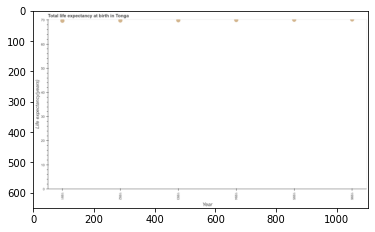

Number of QA =  24





,Year,Life expectancy(years)
0,1996,69.946249
1,1992,69.576915
2,1991,69.433125
3,1993,69.629242
4,1994,69.706142
5,1995,69.813711


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in 1993 and 1994 ?
PREDICTED =  -0.07689941927446853
EXPECTED =  -0.1057317073170907




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median life expectancy at birth ?
PREDICTED =  69.6676921459083
EXPECTED =  69.95359756097565




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the life expectancy at birth in 1993 to that in 1994 ?
PREDICTED =  0.998896805687025
EXPECTED =  0.9984896864923619




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





>

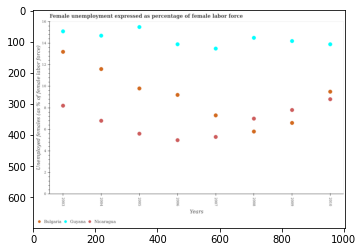

Number of QA =  28





,Years,Nicaragua,Bulgaria,Guyana
0,2009,7.882703,6.676376,14.309577
1,2004,6.877125,11.694880,14.806068
2,2006,5.071994,9.293407,13.998389
3,2008,7.080001,5.871985,14.604304
4,2003,8.280771,13.302528,15.209063
5,2010,8.879251,9.592259,14.002956
6,2005,5.671837,9.893083,15.613779
7,2007,5.374768,7.379354,13.598767


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in bulgaria in 2004 and that in 2009 ?
PREDICTED =  5.018503723104662
EXPECTED =  5.000000476837129




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in guyana in 2008 and the unemployment in females in in nicaragua in 2007?
PREDICTED =  1.0055370014979168
EXPECTED =  9.199999809265137




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the unemployment in females in in bulgaria and unemployment in females in in guyana ?
PREDICTED =  1998.5
EXPECTED =  -4.69999980926516





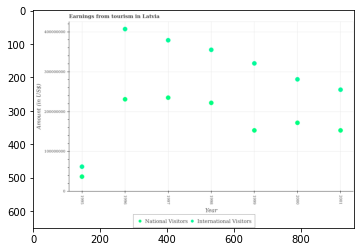

Number of QA =  27





,Year,International Visitors,National Visitors
0,2000,2.823044e+08,1.731718e+08
1,1997,3.804082e+08,2.364462e+08
2,1995,6.314180e+07,3.813235e+07
3,1998,3.562022e+08,2.232813e+08
4,2001,2.562735e+08,1.543227e+08
5,1999,3.223096e+08,1.541586e+08
6,1996,4.079945e+08,2.321544e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from national visitors in 1997 and that in 2000 ?
PREDICTED =  63274347.243379414
EXPECTED =  63000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from national visitors in 1997 and the amount earned from international visitors in 1998?
PREDICTED =  13164904.56040439
EXPECTED =  -120000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the amount earned from international visitors and amount earned from national visitors ?
PREDICTED =  27586332.99956584
EXPECTED =  133000000




				 1 / 

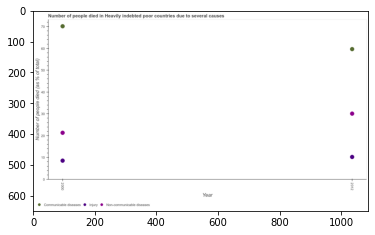

Number of QA =  24





,Year,Communicable diseases,Non-communicable diseases,Injury
0,2000,69.937024,21.444079,8.835362
1,2012,59.547657,30.178402,10.452789


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of people who died of injury in 2000 and that in 2012 ?
PREDICTED =  -1.6174266093843954
EXPECTED =  -1.6961467652762803




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of people who died of injury in 2012 and the number of people who died of communicable diseases in 2000?
PREDICTED =  1.6174266093843954
EXPECTED =  -59.92486252111732




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the number of people who died of injury and number of people who dies of non-communicable diseases ?
PREDICTED =  0.0
EXPECTED 

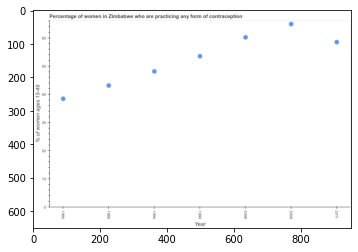

Number of QA =  24





,Year,% of women ages 15-49
0,1989,43.391880
1,2006,60.486944
2,1999,53.788478
3,2009,65.197634
4,1994,48.387729
5,1984,38.642106
6,2011,58.784129


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contraceptive prevalence in 1984 and 1994 ?
PREDICTED =  -9.745623372664262
EXPECTED =  -9.700000000000003




				 1 / 1 = 1.0


> what is the median contraceptive prevalence ?
PREDICTED =  None
EXPECTED =  53.5




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the contraceptive prevalence in 2009 to that in 2011 ?
PREDICTED =  1.1091026529261754
EXPECTED =  1.1094017094017095




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest contraceptive prevalence ?
PREDICTED =  -1939.4690329735533
EXPECTED =  4.700000000000003





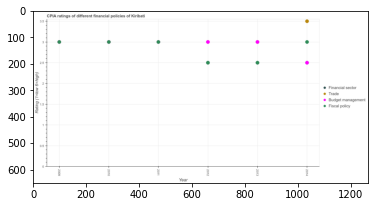

Number of QA =  29





,Year,Financial sector,Fiscal policy,Trade,Budget management
0,2012,NaN,2.493947,NaN,2.989887
1,2011,NaN,2.988102,NaN,NaN
2,2014,NaN,2.989588,3.485202,2.493130
3,2009,NaN,2.989447,NaN,NaN
4,2013,NaN,2.493495,NaN,2.988700
5,2010,NaN,2.989776,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of budget management in 2014 and the cpia rating of fiscal policy in 2013?
PREDICTED =  -0.4955703406785763
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest cpia rat

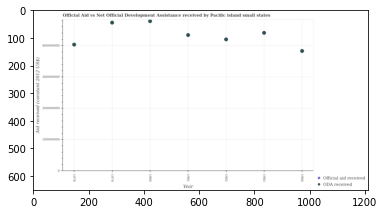

Number of QA =  27





,Year,Official aid received,ODA received
0,1981,NaN,4.359203e+08
1,1978,NaN,4.050587e+08
2,1984,NaN,3.849698e+08
3,1983,NaN,4.428851e+08
4,1980,NaN,4.800795e+08
5,1979,NaN,4.751699e+08
6,1982,NaN,4.219403e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in 1983 and that in 1984 ?
PREDICTED =  57915354.408002436
EXPECTED =  57970000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official aid received in 1978 and the oda received in 1984?
PREDICTED =  nan
EXPECTED =  20350000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1983, what is the difference between the oda received and official aid received ?
PREDICTED =  0.0
EXPECTED =  0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wh

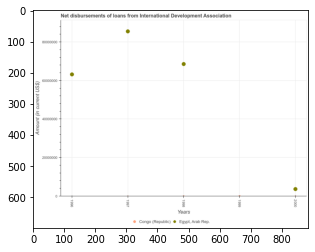

Number of QA =  24





,Years,"Egypt, Arab Rep.",Congo (Republic)
0,1998,6.873226e+07,NaN
1,1999,NaN,142752.177245
2,2000,3.963577e+06,NaN
3,1997,8.563639e+07,NaN
4,1996,6.330176e+07,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in egypt, arab rep. in 1996 and that in 1997 ?
PREDICTED =  -22334632.17199736
EXPECTED =  -22333000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in congo (republic) in 1998 and the amount of loans disbursed in egypt, arab rep. in 2000?
PREDICTED =  -3820824.557725517
EXPECTED =  -3627000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of loans disbursed in egypt, arab rep. in 1996 to that in 1998?
PREDICTED =  0.9209905157074241
EXPECTED =  0.921531142373475




				 2 / 3 = 0.6667


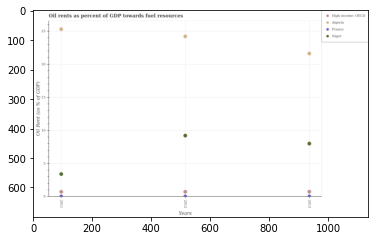

Number of QA =  29





,Years,Algeria,High income: OECD,France,Niger
0,2012,24.209790,0.792154,0.077887,9.249266
1,2013,21.644667,0.781638,0.074267,8.051150
2,2011,25.313323,0.775055,0.084063,3.445954


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in algeria in 2011 and that in 2013 ?
PREDICTED =  3.66865531626652
EXPECTED =  3.676601721994402




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in high income: oecd in 2013 and the oil rent in france in 2012?
PREDICTED =  -2.5651223611452707
EXPECTED =  0.7186085243944877




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the oil rent in algeria and oil rent in niger ?
PREDICTED =  2.9762229173440495
EXPECTED =  14.985526055259209




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False

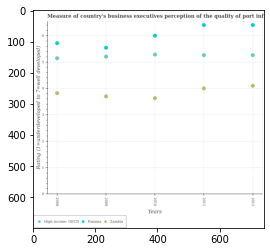

Number of QA =  28





,Years,Zambia,High income: OECD,Panama
0,2010,3.649876,5.298599,6.014621
1,2008,3.835475,5.158391,5.728623
2,2011,4.018641,5.276731,6.417951
3,2009,3.714275,5.221977,5.558110
4,2012,4.119044,5.276219,6.416461


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ratings of the quality of port infrastructure in panama in 2010 and the ratings of the quality of port infrastructure in zambia in 2009?
PREDICTED =  -1.5351292609609501
EXPECTED =  2.2994224616




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the ratings of the quality of port infrastructure in panama in 2009 to that in 2010?
PREDICTED =  0.9382746535455149
EXPECTED =  0.9238946482831534


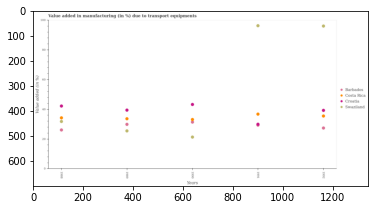

Number of QA =  29





,Years,Barbados,Swaziland,Croatia,Costa Rica
0,1990,31.583252,21.509580,43.421633,33.246769
1,1989,30.066969,25.681699,39.594088,33.882837
2,1992,27.619881,96.145337,39.488898,35.601266
3,1988,26.342490,31.965150,42.386739,34.425567
4,1991,NaN,96.378231,30.163501,36.934947


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in swaziland in 1990 and that in 1991 ?
PREDICTED =  -74.86865037787756
EXPECTED =  -74.96445701415831




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in costa rica in 1988 and the percentage of value added in manufacturing due to transport equipments in croatia in 1989?
PREDICTED =  -5.168520291431335
EXPECTED =  -5.196915997684897




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1989, what is the difference between t

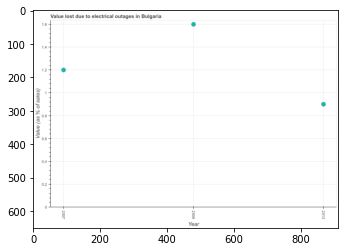

Number of QA =  24





,Year,Value (as % of sales)
0,2007,1.206406
1,2009,1.606737
2,2013,0.906695


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value lost due to electrical outages in 2009 and 2013 ?
PREDICTED =  0.700042592340576
EXPECTED =  0.7000000000000001




				 1 / 1 = 1.0


> what is the median value lost due to electrical outages ?
PREDICTED =  None
EXPECTED =  1.2




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the value lost due to electrical outages in 2009 to that in 2013 ?
PREDICTED =  1.0
EXPECTED =  1.777777777777778




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest value lost due to electrical outages ?
PREDICTED =  0.700042592340576
EXPE

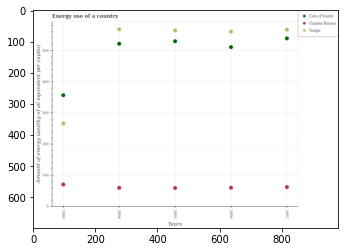

Number of QA =  28





,Years,Guinea-Bissau,Cote d'Ivoire,Tonga
0,2006,61.994633,513.082782,563.213013
1,2005,61.083602,532.093667,566.793533
2,1990,72.434384,359.111689,267.792714
3,2004,61.723114,523.765789,570.209617
4,2007,63.912894,541.261977,569.139737


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of energy used in in cote d'ivoire in 2004 and that in 2006 ?
PREDICTED =  10.68300705775198
EXPECTED =  10.69320084740093




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of energy used in in cote d'ivoire in 2004 and the amount of energy used in in tonga in 2005?
PREDICTED =  -8.327877487709202
EXPECTED =  -42.80820744291009




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount of energy used in in guinea-bissau and amount of energy used in in tonga ?
PREDICTED =  -2215.999987875899
EXPECTED =  -505.4

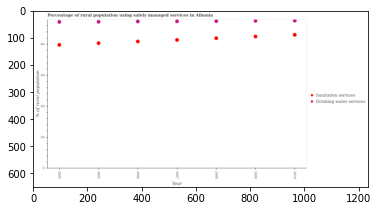

Number of QA =  27





,Year,Sanitation services,Drinking water services
0,2004,79.711226,94.429356
1,2008,84.014272,95.014035
2,2005,80.851212,94.675362
3,2006,81.960601,94.839348
4,2009,85.192239,95.224776
5,2010,86.245718,95.348764
6,2007,82.961830,94.899858


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population who used sanitation services in 2006 and that in 2008 ?
PREDICTED =  -2.0536706268424467
EXPECTED =  -2.1000000000000085




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population who used drinking water services in 2005 and the percentage of rural population who used sanitation services in 2008?
PREDICTED =  -0.3386732801109815
EXPECTED =  10.599999999999994




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of rural population who used sanitation services a

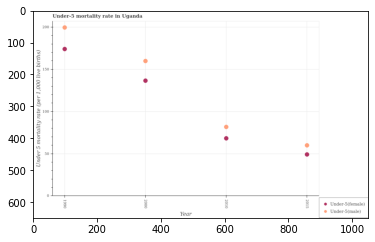

Number of QA =  27





,Year,Under-5(female),Under-5(male)
0,2000,136.935437,160.316106
1,1990,174.407748,199.939006
2,2015,49.694055,60.336645
3,2010,68.816338,82.287482


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 male mortality rate in 1990 and that in 2010 ?
PREDICTED =  117.6515237384174
EXPECTED =  117.8




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 female mortality rate in 2010 and the under-5 male mortality rate in 2015?
PREDICTED =  19.122283037630325
EXPECTED =  8.300000000000004




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the under-5 female mortality rate and under-5 male mortality rate ?
PREDICTED =  0.0
EXPECTED =  -25.5




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPU

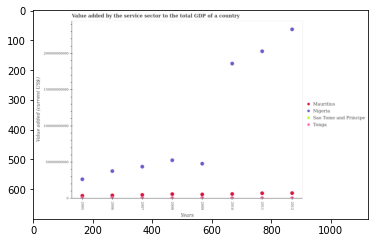

Number of QA =  29





,Years,Nigeria,Sao Tome and Principe,Tonga,Mauritius
0,2006,3.849833e+10,NaN,1.206526e+09,4.845000e+09
1,2008,5.349153e+10,NaN,9.186822e+08,6.653963e+09
2,2005,2.722932e+10,NaN,1.311117e+09,4.526700e+09
3,2012,2.345985e+11,NaN,9.423057e+08,7.995171e+09
4,2009,4.875920e+10,NaN,7.780883e+08,6.247473e+09
5,2010,1.872097e+11,NaN,1.027232e+09,6.858595e+09
6,2011,2.042609e+11,NaN,8.387606e+08,7.870208e+09
7,2007,4.463964e+10,NaN,7.824499e+08,5.625395e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the service sector to the total gdp in sao tome and principe in 2008 and that in 2010 ?
PREDICTED =  -240701231195.7378
EXPECTED =  -434919.15246398747




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the service sector to the total gdp in nigeria in 2009 and the value added by the service sector to the total gdp in sao tome and principe in 2007?
PREDICTED =  4119560416.177147
EXPECTED =  47767300207.05444




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the value added by the service sector t

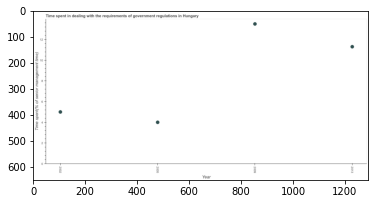

Number of QA =  24





,Year,Time spent(% of senior management time)
0,2013,11.309207
1,2009,13.506880
2,2005,4.038744
3,2002,5.026917


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time spent in dealing with government regulations in 2002 and 2005 ?
PREDICTED =  0.9881724888012382
EXPECTED =  1.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median time spent in dealing with government regulations ?
PREDICTED =  2007.0
EXPECTED =  8.15




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the time spent in dealing with government regulations in 2005 to that in 2009 ?
PREDICTED =  0.2990138564936937
EXPECTED =  0.2962962962962963




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fin

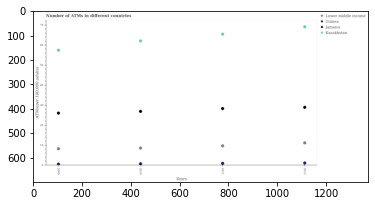

Number of QA =  29





,Years,Jamaica,Lower middle income,Kazakhstan,Guinea
0,2010,27.051024,8.772276,62.108188,0.880331
1,2011,28.421997,9.857623,65.502617,1.130852
2,2012,29.010967,11.322796,69.160843,1.327670
3,2009,26.176706,8.426764,57.460138,0.717118


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of atms in lower middle income in 2009 and that in 2012 ?
PREDICTED =  7.426764377261755
EXPECTED =  -2.940256032109181




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of atms in kazakhstan in 2010 and the number of atms in guinea in 2009?
PREDICTED =  61.39106990961208
EXPECTED =  61.55704831131253




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the number of atms in kazakhstan and number of atms in lower middle income ?
PREDICTED =  0.0
EXPECTED =  57.994227167456295




				 1 / 3 = 0.3333


is_built_wit

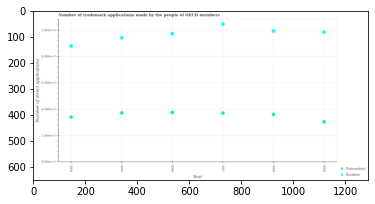

Number of QA =  27





,Year,Resident,Nonresident
0,2006,34.479111,13.394194
1,2008,35.216767,12.856972
2,2009,34.871805,10.889457
3,2004,31.193496,12.154303
4,2007,37.088670,13.214584
5,2005,33.422094,13.266691


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by non residents in 2004 and that in 2009 ?
PREDICTED =  0.0
EXPECTED =  36335




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by non residents in 2009 and the number of trademark applications made by residents in 2004?
PREDICTED =  0.0
EXPECTED =  -575338




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the number of trademark applications made by non residents and number of trademark applications made by residents ?
PREDICTED =  0.0
EXPECTED =  

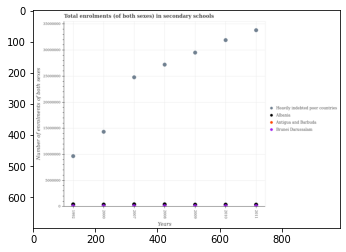

Number of QA =  29





,Years,Brunei Darussalam,Albania,Heavily indebted poor countries,Antigua and Barbuda
0,1992,250275.404013,NaN,9.703943e+06,495052.144832
1,2008,247857.371865,NaN,2.720457e+07,494534.773088
2,2011,149696.521762,436752.518381,3.378569e+07,NaN
3,2009,147331.134458,NaN,2.949532e+07,433773.546343
4,2000,130738.931881,440294.245649,1.436790e+07,NaN
5,2010,148667.224294,NaN,3.188806e+07,436289.606821
6,2007,244083.281148,NaN,2.478293e+07,499218.348870


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in antigua and barbuda in 2000 and that in 2007 ?
PREDICTED =  -374817.2130290407
EXPECTED =  -2562.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in albania in 2011 and the number of enrolments in secondary schools in brunei darussalam in 2010?
PREDICTED =  288085.2940871467
EXPECTED =  306434.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the number of enrolments in secondary schools in heavily indebted poor countries and number o

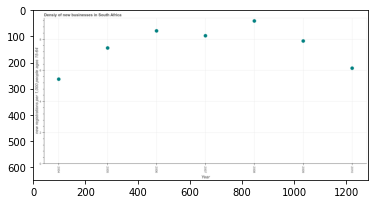

Number of QA =  24





,Year,"new registrations per 1,000 people ages 15-64"
0,2005,7.548712
1,2008,9.298172
2,2010,6.228066
3,2004,5.518591
4,2007,8.339078
5,2009,7.992034
6,2006,8.650300


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the density of new business in 2005 and 2007 ?
PREDICTED =  -0.7903658247067451
EXPECTED =  -0.78785714460553




				 1 / 1 = 1.0


> what is the median density of new business ?
PREDICTED =  None
EXPECTED =  7.891546514613959




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the density of new business in 2008 to that in 2010 ?
PREDICTED =  1.492946959805146
EXPECTED =  1.4948811076661617




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest density of new business ?
PREDICTED =  1998.7018281845353
EXPECTED =  0.636378061016

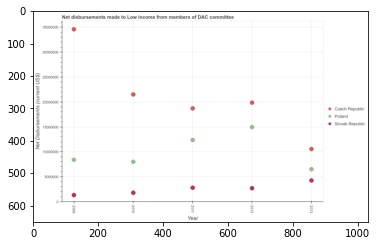

Number of QA =  28





,Year,Poland,Czech Republic,Slovak Republic
0,2013,6.620280e+06,1.067309e+07,4.382579e+06
1,2011,1.247182e+07,1.877996e+07,2.924581e+06
2,2010,8.094000e+06,2.157606e+07,1.914527e+06
3,2009,8.495018e+06,3.461447e+07,1.456508e+06
4,2012,1.501691e+07,1.993511e+07,2.818749e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements made by slovak republic in 2009 and that in 2011 ?
PREDICTED =  -1468072.8587902586
EXPECTED =  -1480000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements made by czech republic in 2013 and the net disbursements made by poland in 2009?
PREDICTED =  -23941384.674240142
EXPECTED =  2160000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the net disbursements made by slovak republic and net disbursements made by poland ?
PREDICTED =  -37201079.88810806
EXPECTED =  -6210000




				 1 / 3 = 

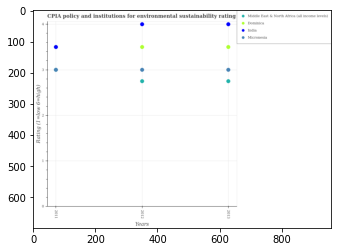

Number of QA =  29





,Years,India,Micronesia,Middle East & North Africa (all income levels),Dominica
0,2012,3.990043,2.996255,2.747893,3.494850
1,2011,3.494050,2.997609,NaN,NaN
2,2013,3.990298,2.996738,2.747575,3.494728


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in india in 2012 and that in 2013 ?
PREDICTED =  -0.00025479292234198425
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in india in 2013 and the cpia rating in middle east & north africa (all income levels) in 2012?
PREDICTED =  0.00025479292234198425
EXPECTED =  1.25




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the cpia rating in dominica and cpia rating in micronesia ?
PREDICTED =  0.49485026449286806
EXPECTED =  0.5




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_a

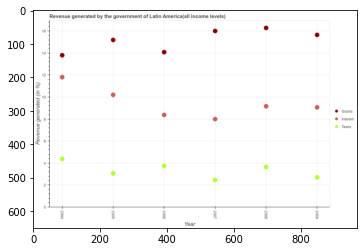

Number of QA =  28





,Year,Grants,Interest,Taxes
0,2006,14.078410,8.394183,3.776004
1,2004,13.796006,11.815746,4.410986
2,2009,15.641381,9.083565,2.749533
3,2007,15.996696,8.011674,2.505965
4,2005,15.182821,10.221704,3.100594
5,2008,16.278838,9.181674,3.676363


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes in 2004 and that in 2006 ?
PREDICTED =  0.6349821078008047
EXPECTED =  0.6336195465504009




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by interest in 2004 and the percentage of revenue generated by taxes in 2009?
PREDICTED =  2.7321809253436964
EXPECTED =  9.10363054319631




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of revenue generated by taxes and percentage of revenue generated by interest ?
PREDICTED =  -49.79159488877714
E

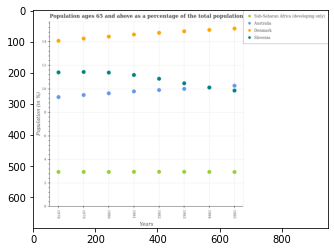

Number of QA =  29





,Years,Australia,Slovenia,Denmark,Sub-Saharan Africa (developing only)
0,1981,9.754954,11.149581,14.561315,2.961650
1,1983,9.967484,10.442277,14.831612,2.964232
2,1982,9.872475,10.829243,14.708372,2.963750
3,1985,10.241592,9.829279,15.067666,2.950140
4,1984,NaN,10.080329,14.947384,2.957161
5,1978,9.279009,11.365665,14.031701,2.958915
6,1979,9.453397,11.410167,14.222984,2.957865
7,1980,9.596042,11.345091,14.390068,2.951383


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 65 and above in sub-saharan africa (developing only) in 1979 and that in 1981 ?
PREDICTED =  -1980.0
EXPECTED =  -0.006161307144709749




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 65 and above in australia in 1984 and the percentage of the population ages 65 and above in slovenia in 1981?
PREDICTED =  -10.442276629861794
EXPECTED =  -1.0642086672458007




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the percentage of the population ages 65 and above i

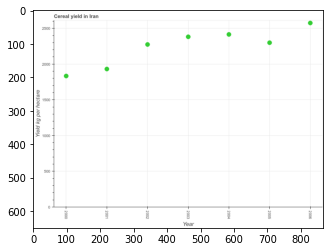

Number of QA =  24





,Year,Yield kg per hectare
0,2003,2380.316709
1,2006,2571.571131
2,2005,2297.220178
3,2000,1832.654213
4,2002,2272.936179
5,2004,2413.251405
6,2001,1931.020808


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cereal yield in 2001 and 2004 ?
PREDICTED =  -482.23059692044103
EXPECTED =  -484.0529999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median cereal yield ?
PREDICTED =  2003.0
EXPECTED =  2299.371




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cereal yield in 2001 to that in 2004 ?
PREDICTED =  0.8001739081596764
EXPECTED =  0.799576008893876




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the secon

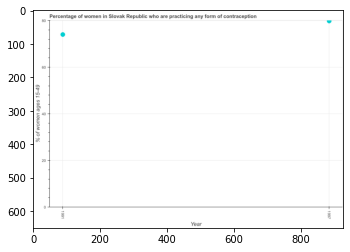

Number of QA =  20





,Year,% of women ages 15-49
0,1997,80.048147
1,1991,74.263109


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contraceptive prevalence in 1991 and 1997 ?
PREDICTED =  -5.78503825090533
EXPECTED =  -5.799999999999997




				 1 / 1 = 1.0


> what is the median contraceptive prevalence ?
PREDICTED =  None
EXPECTED =  76.9




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the contraceptive prevalence in 1991 to that in 1997 ?
PREDICTED =  0.9277305167176306
EXPECTED =  0.9273182957393484




				 2 / 4 = 0.5


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  % of women ages 15-49
EXPECTED =  20.0




				 2 / 5 = 0.4


> what is the title of the graph ?
PREDICTED =  Percentage of women in Slovak Republic who are practicing any form of contraception
EXPECTED = 

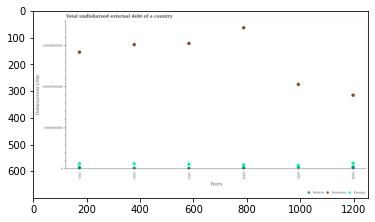

Number of QA =  28





,Years,Panama,Indonesia,Belarus
0,2002,6.779581e+08,1.515543e+10,1.022309e+08
1,2006,7.211672e+08,9.003369e+09,2.570672e+08
2,2004,5.188931e+08,1.719528e+10,1.257288e+08
3,2001,6.774617e+08,1.423441e+10,1.920276e+08
4,2005,2.910950e+08,1.031368e+10,4.630131e+08
5,2003,6.155856e+08,1.529528e+10,9.150684e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in belarus in 2001 and that in 2002 ?
PREDICTED =  89796784.17260593
EXPECTED =  95409000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in belarus in 2006 and the total undisbursed external debt in panama in 2005?
PREDICTED =  -205945873.9415991
EXPECTED =  -220040000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the total undisbursed external debt in panama and total undisbursed external debt in belarus ?
PREDICTED =  3502160773.0842466
EXPECTED =  

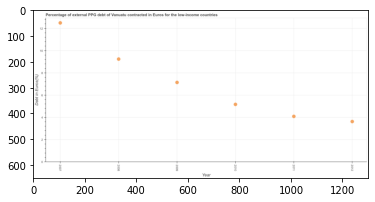

Number of QA =  24





,Year,Debt in Euros(%)
0,2007,12.519487
1,2008,9.276349
2,2010,5.209418
3,2012,3.661494
4,2009,7.183808
5,2011,4.126558


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the currency composition of ppg debt in 2008 and 2012 ?
PREDICTED =  5.614855127965789
EXPECTED =  5.616100000000001




				 1 / 1 = 1.0


> what is the median currency composition of ppg debt ?
PREDICTED =  None
EXPECTED =  6.151599999999998




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the currency composition of ppg debt in 2009 to that in 2011 ?
PREDICTED =  1.7408714983131186
EXPECTED =  1.7476132190942466




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest currency composition of ppg debt ?
PREDICTED =  8.85799276

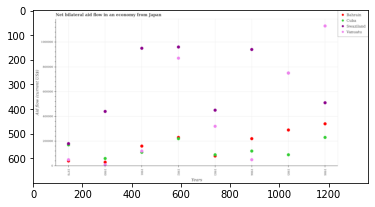

Number of QA =  29





,Years,Swaziland,Bahrain,Cuba,Vanuatu
0,1980,440517.953116,33963.372796,62439.665087,1.019148e+04
1,1984,936883.939409,221659.532687,122805.952235,5.345662e+04
2,1981,946362.618482,162941.648393,122874.675983,1.121260e+05
3,1978,183487.570775,NaN,172136.426461,4.407054e+04
4,1982,956672.298826,222207.751149,232686.732475,8.670812e+05
5,1985,NaN,291863.167966,93261.691697,7.477579e+05
6,1983,449988.411934,82858.777950,92341.506707,3.214019e+05
7,1986,509785.839319,340759.993531,231640.312175,1.125253e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in cuba in 1978 and that in 1985 ?
PREDICTED =  78874.7347636199
EXPECTED =  80000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in swaziland in 1985 and the net bilateral aid flow in vanuatu in 1980?
PREDICTED =  -440517.9531157618
EXPECTED =  740000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the net bilateral aid flow in cuba and net bilateral aid flow in vanuatu ?
PREDICTED =  1130178.962819478
EXPECTED =  50000.0




				 1 / 3 = 0.3333


is_built_with_cuda: Tr

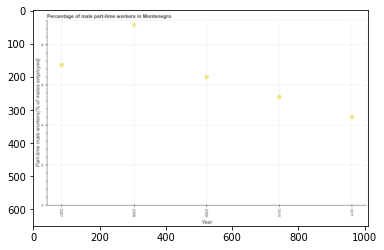

Number of QA =  24





,Year,Part-time male workers(% of males employed)
0,2009,6.416118
1,2007,7.016511
2,2010,5.416093
3,2008,9.011214
4,2011,4.421075


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time male workers in 2008 and 2010 ?
PREDICTED =  3.5951215252576647
EXPECTED =  3.599999904632571




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time male workers ?
PREDICTED =  2009.0
EXPECTED =  6.400000095367429




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of part-time male workers in 2007 to that in 2009 ?
PREDICTED =  1.0935757425100403
EXPECTED =  1.0937499837018556




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after 

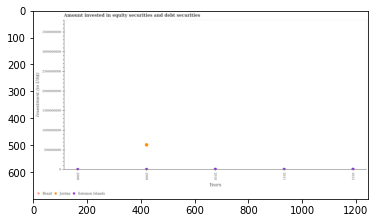

Number of QA =  21





,Years,Solomon Islands,Brazil,Jordan
0,2009,1.284335e+07,NaN,6.366539e+08
1,2011,1.372175e+07,NaN,NaN
2,2010,1.562611e+07,NaN,NaN
3,2012,1.521906e+07,NaN,NaN
4,2008,1.155186e+07,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in solomon islands in 2010 and that in 2012 ?
PREDICTED =  -30845168.21394604
EXPECTED =  -639672.952




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in solomon islands in 2010 and the amount invested in equity securities and debt securities in jordan in 2008?
PREDICTED =  -24395206.740144767
EXPECTED =  2647728.946




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest amount invested in equity securities 

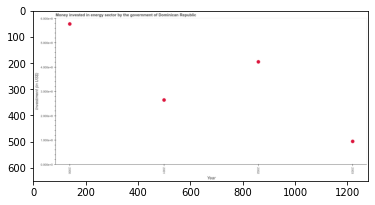

Number of QA =  24





,Year,Investment (in US$)
0,2002,4.261224
1,2000,5.817897
2,2001,2.685569
3,2003,0.978539


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investment in energy in 2001 and 2002 ?
PREDICTED =  -1.5756555340043543
EXPECTED =  -156800000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median investment in energy ?
PREDICTED =  3.4733963963186296
EXPECTED =  343400000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the investment in energy in 2002 to that in 2003 ?
PREDICTED =  4.354681099731729
EXPECTED =  4.44




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the high

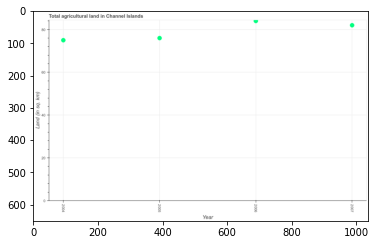

Number of QA =  24





,Year,Land (in sq. km)
0,2005,76.860321
1,2006,84.881815
2,2007,82.873603
3,2004,75.837169


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the agricultural land in 2006 and 2007 ?
PREDICTED =  2.0082118829508886
EXPECTED =  2.0




				 1 / 1 = 1.0


> what is the median agricultural land ?
PREDICTED =  None
EXPECTED =  79.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the agricultural land in 2005 to that in 2007 ?
PREDICTED =  0.9274403162065784
EXPECTED =  0.926829268292683




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest agricultural land ?
PREDICTED =  0.0
EXPECTED =  2.0




				 2 / 5 = 0.4


is_built_with_cuda: True
is_gpu_available: False
GPUs:

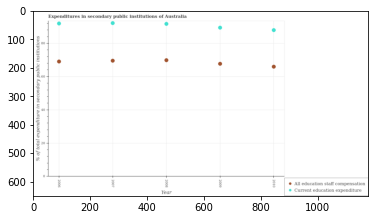

Number of QA =  27





,Year,All education staff compensation,Current education expenditure
0,2008,70.077793,91.968517
1,2006,69.288543,92.226375
2,2009,67.983922,89.671675
3,2010,66.218906,88.199961
4,2007,69.766377,92.419342


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in 2007 and that in 2009 ?
PREDICTED =  1.7824550204564105
EXPECTED =  1.8572387695311932




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in 2006 and the expenditure in staff compensation in 2008?
PREDICTED =  0.2578579684050908
EXPECTED =  22.067161560058608




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the expenditure in staff compensation and expenditure in education ?
PREDICTED =  -362.51735290647775
EXPECTED =  -21.8390731811524




				 1 / 3 = 0.3333


i

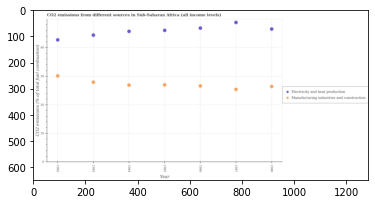

Number of QA =  27





,Year,Manufacturing industries and construction,Electricity and heat production
0,1988,26.348706,46.245438
1,1986,26.551684,46.592396
2,1982,30.003253,42.524637
3,1983,27.821245,44.160676
4,1984,26.824942,45.460832
5,1985,26.916330,45.813289
6,1987,25.331306,48.564633


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions due to manufacturing industries in 1983 and that in 1986 ?
PREDICTED =  1.2695602878989725
EXPECTED =  1.309658484270301




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions due to electricity and heat production in 1985 and the co2 emissions due to manufacturing industries in 1986?
PREDICTED =  43.623128778457364
EXPECTED =  19.4390145933178




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the co2 emissions due to manufacturing industries and co2 emissions due to electricity and heat production ?
P

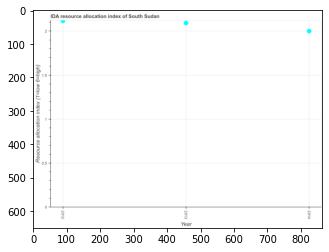

Number of QA =  24





,Year,Resource allocation index (1=low 6=high)
0,2013,2.083230
1,2014,1.992786
2,2012,2.108731


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in 2012 and 2014 ?
PREDICTED =  0.11594445783085039
EXPECTED =  0.1166666666666698




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median ida resource allocation index ?
PREDICTED =  2.0832304113518982
EXPECTED =  2.09166666666667




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the ida resource allocation index in 2012 to that in 2014 ?
PREDICTED =  1.0581820790538188
EXPECTED =  1.058333333333335




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training ste

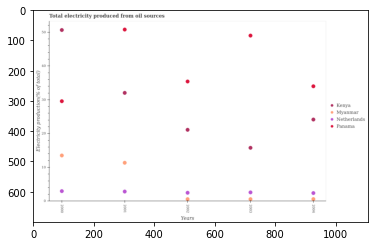

Number of QA =  29





,Years,Panama,Myanmar,Netherlands,Kenya
0,2004,34.290223,0.755808,2.556065,24.373372
1,2001,51.130266,11.538128,2.974485,32.314913
2,2000,29.815878,13.702654,3.106062,51.004022
3,2002,35.694483,0.728026,2.637053,21.340596
4,2003,49.343036,0.739454,2.745609,15.995184


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in myanmar in 2000 and that in 2004 ?
PREDICTED =  12.94684621410636
EXPECTED =  12.913027554178495




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in kenya in 2003 and the total electricity produced in panama in 2000?
PREDICTED =  -35.00883790859446
EXPECTED =  -13.796041503223798




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the total electricity produced in netherlands and total electricity produced in panama ?
PREDICTED =  9.019273900066354
EXPECTED =  -32.94230

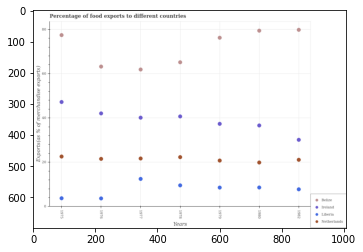

Number of QA =  29





,Years,Ireland,Belize,Netherlands,Liberia
0,1976,42.297060,63.459850,21.700541,3.853793
1,1975,47.403291,77.699831,22.768530,3.929984
2,1979,37.572231,76.536568,20.952559,8.759403
3,1980,36.864953,79.683968,20.103399,8.813043
4,1982,30.367672,80.075118,21.324730,7.991797
5,1978,40.946861,65.414716,22.510357,9.754740
6,1977,40.335921,62.130890,21.906118,12.655058


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in belize in 1977 and that in 1978 ?
PREDICTED =  -3.283825998769096
EXPECTED =  -3.2632944129822974




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in netherlands in 1975 and the percentage of exports to different countries in belize in 1982?
PREDICTED =  0.0
EXPECTED =  -57.2410347239842




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1982, what is the difference between the percentage of exports to different countries in ireland and percentage of exports to differen

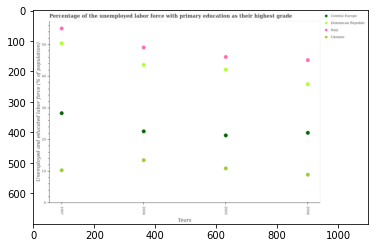

Number of QA =  29





,Years,Ukraine,Italy,Dominican Republic,Central Europe
0,2004,13.679712,49.461420,43.920106,22.828675
1,1997,10.473807,55.505289,50.785083,28.577655
2,2006,9.092105,45.453941,37.806776,22.363104
3,2005,11.076987,46.466694,42.435411,21.514766


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with primary education in central europe in 2004 and that in 2006 ?
PREDICTED =  0.4655708575282951
EXPECTED =  0.4700733760335005




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with primary education in italy in 1997 and the percentage of the unemployed labor force with primary education in ukraine in 2005?
PREDICTED =  9.038595024117775
EXPECTED =  44.1999988555908




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of the une

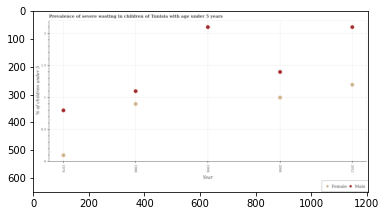

Number of QA =  27





,Year,Male,Female
0,2006,1.405281,1.005509
1,1988,1.105573,0.905495
2,1974,0.805738,0.107008
3,1994,2.104342,NaN
4,2012,2.105533,1.206185


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished male children in 1988 and that in 1994 ?
PREDICTED =  -0.998769254848515
EXPECTED =  -0.9999998807907102




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in 1994 and the percentage of undernourished male children in 1974?
PREDICTED =  0.0
EXPECTED =  1.299999892711642




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of undernourished male children and percentage of undernourished female children ?
PREDICTED =  0.0
EXPECTED =  0.8999998

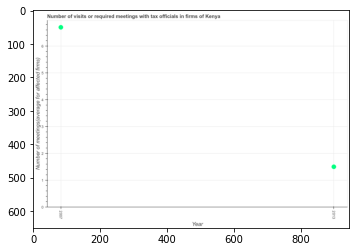

Number of QA =  20





,Year,Number of meetings(average for affected firms)
0,2013,1.523551
1,2007,6.730648


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of required meetings with tax officials in 2007 and 2013 ?
PREDICTED =  5.207096713810952
EXPECTED =  5.2




				 1 / 1 = 1.0


> what is the median number of required meetings with tax officials ?
PREDICTED =  None
EXPECTED =  4.1




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of required meetings with tax officials in 2007 to that in 2013 ?
PREDICTED =  4.417736025630407
EXPECTED =  4.466666666666667




				 2 / 4 = 0.5


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Number of meetings(average for affected firms)
EXPECTED =  1.0




				 2 / 5 = 0.4


> what is the title of the graph ?
PREDICTED =  Number of visits or req

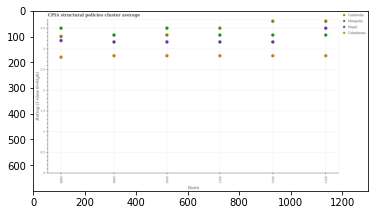

Number of QA =  29





,Years,Mongolia,Uzbekistan,Cambodia,Nepal
0,2012,3.352790,2.852141,3.686959,3.185076
1,2013,3.353152,2.851734,3.687458,3.519994
2,2008,3.518177,2.817147,3.318556,3.220079
3,2009,3.350977,2.851543,NaN,3.185756
4,2010,3.519949,2.851982,3.353117,3.186210
5,2011,3.352570,2.851300,3.518572,3.186515


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in cambodia in 2010 and that in 2013 ?
PREDICTED =  -0.33434058547712864
EXPECTED =  -0.33333333333334014




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in mongolia in 2013 and the cpia rating in nepal in 2009?
PREDICTED =  0.0021754306080516983
EXPECTED =  0.16666666666665986




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the cpia rating in uzbekistan and cpia rating in nepal ?
PREDICTED =  -3.154025337843983
EXPECTED =  -0.33333333333334014




				 1 / 3 = 0.3333


is_built_with_cuda: True
is

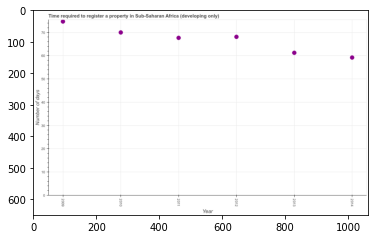

Number of QA =  24





,Year,Number of days
0,2009,75.718440
1,2013,62.143884
2,2010,70.977784
3,2014,60.101655
4,2012,69.059583
5,2011,68.635920


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to register property in 2009 and 2013 ?
PREDICTED =  13.574555190219655
EXPECTED =  13.438863049095609




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of days required to register property ?
PREDICTED =  68.8477515126651
EXPECTED =  67.8710359408034




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of days required to register property in 2010 to that in 2013 ?
PREDICTED =  6.543480009324156
EXPECTED =  1.142746947442332




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predictin

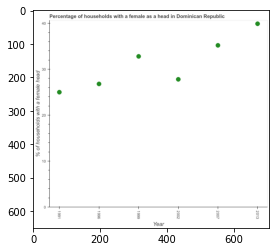

Number of QA =  24





,Year,% of households with a female head
0,1996,26.906541
1,1999,32.912109
2,2013,40.004641
3,2007,35.331553
4,2002,27.914279
5,1991,25.124280


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of female supervised households in 2002 and 2013 ?
PREDICTED =  -12.090361366767532
EXPECTED =  -12.099999999999998




				 1 / 1 = 1.0


> what is the median number of female supervised households ?
PREDICTED =  None
EXPECTED =  30.299999999999997




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of female supervised households in 1991 to that in 1999 ?
PREDICTED =  0.7633749607784373
EXPECTED =  0.7621951219512195




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest number of female supervised househo

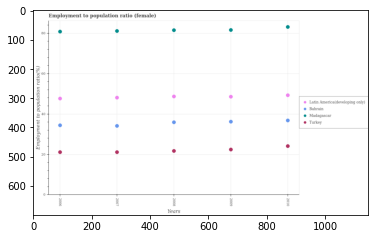

Number of QA =  29





,Years,Bahrain,Latin America(developing only),Turkey,Madagascar
0,2006,34.620277,47.870041,21.334110,81.020010
1,2007,34.350299,48.339850,21.343171,81.360684
2,2008,36.124060,48.894357,21.932779,81.711266
3,2009,36.447380,48.812133,22.640785,81.813506
4,2010,36.994714,49.517225,24.383746,83.336205


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in latin america(developing only) in 2008 ?
PREDICTED =  0.0
EXPECTED =  48.6826117406944




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in latin america(developing only) ?
PREDICTED =  40.591935688095575
EXPECTED =  49.2881224935454




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in madagascar ?
PREDICTED =  24.759315697066647
EXPECTED =  80.8000030517578




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting 

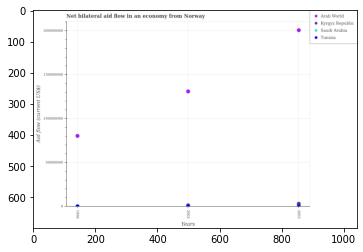

Number of QA =  29





,Years,Arab World,Saudi Arabia,Tunisia,Kyrgyz Republic
0,2003,2.013923e+08,NaN,9.203424e+05,3.541112e+06
1,2002,1.315655e+08,NaN,1.548962e+06,NaN
2,1996,8.083853e+07,NaN,7.050237e+05,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in arab world in 1996 and that in 2002 ?
PREDICTED =  -50726965.70367114
EXPECTED =  -50640000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in kyrgyz republic in 2002 and the net bilateral aid flow in saudi arabia in 1996?
PREDICTED =  -3541111.8514287304
EXPECTED =  1290000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the net bilateral aid flow in tunisia and net bilateral aid flow in kyrgyz republic ?
PREDICTED =  -1992149.5050933256
EXPECTED =  -190000.0




				

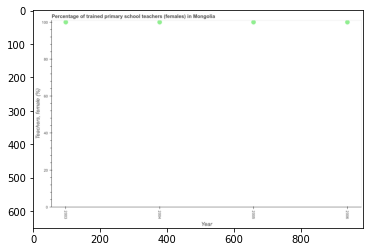

Number of QA =  24





,Year,"Teachers, female (%)"
0,2004,100.626658
1,2005,100.559087
2,2006,100.567846
3,2003,100.615053


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained female teachers in 2003 and 2004 ?
PREDICTED =  -0.01160451630842374
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of trained female teachers ?
PREDICTED =  2004.5
EXPECTED =  100.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of trained female teachers in 2004 to that in 2006 ?
PREDICTED =  1.0005848024308985
EXPECTED =  1.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the 

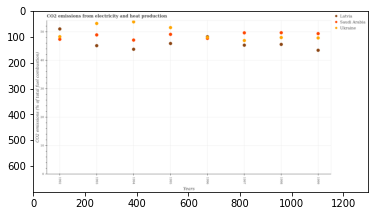

Number of QA =  28





,Years,Saudi Arabia,Latvia,Ukraine
0,1998,49.837932,45.730971,48.159209
1,1992,47.539736,51.132409,48.460250
2,1996,NaN,NaN,47.851788
3,1995,49.260911,46.070698,51.648987
4,1999,49.504885,43.686031,48.006239
5,1997,49.770736,45.454198,47.041695
6,1994,47.225011,43.997881,53.617508
7,1993,49.063382,45.282309,53.074266


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in ukraine in 1993 and that in 1996 ?
PREDICTED =  5.2224781275279994
EXPECTED =  4.898519180832885




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in latvia in 1995 and the amount of co2 emitted in ukraine in 1996?
PREDICTED =  46.07069779424647
EXPECTED =  -2.133097893894714




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the amount of co2 emitted in latvia and amount of co2 emitted in saudi arabia ?
PREDICTED =  -20.848096325873712
EXPECTED =  3.6310782476494055




				 0 /

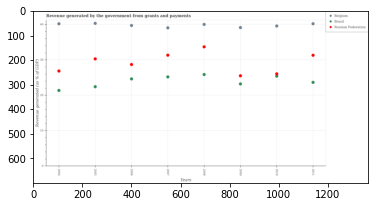

Number of QA =  28





,Years,Brazil,Russian Federation,Belgium
0,2011,23.747776,31.410749,40.310591
1,2006,24.723125,28.816652,39.839293
2,2008,25.965249,33.773848,40.154926
3,2009,23.303671,25.616690,39.220649
4,2007,25.286320,31.444994,39.169008
5,2005,22.513888,30.390520,40.434573
6,2004,21.445378,26.937453,40.302961
7,2010,25.501054,26.144760,39.703916


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total revenue generated by the government in russian federation in the graph ?
PREDICTED =  0.012757315699511461
EXPECTED =  233.7032026249135




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by the government in belgium in 2008 and that in 2009 ?
PREDICTED =  0.9342773367831185
EXPECTED =  0.892765634654296




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by the government in russian federation in 2006 and the revenue generated by the government in belgium in 2008?
PREDICTED =  0.00049800796812749
EXPECTED =  -11.331108779

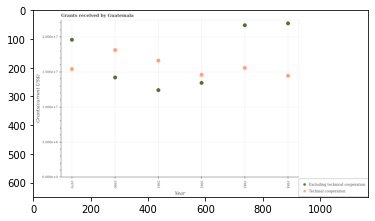

Number of QA =  27





,Year,Excluding technical cooperation,Techinal cooperation
0,1983,2.170956,1.564862
1,1982,1.349737,1.466121
2,1984,2.198305,1.452560
3,1980,1.426718,1.818793
4,1981,1.246353,1.667851
5,1979,1.964107,1.546917


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the amount of grants received(including technical cooperation) in 1980 ?
PREDICTED =  0.23778632086454662
EXPECTED =  18120000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum amount of grants received(excluding technical cooperation) ?
PREDICTED =  0.3663842043349927
EXPECTED =  21930000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum amount of grants received(including technical cooperation) ?
PREDICTED =  330.1666666666667
EXPECTED =  14460000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Eva

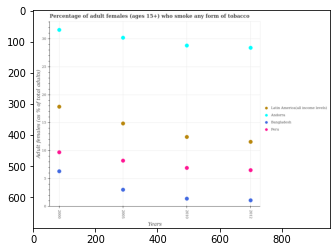

Number of QA =  29





,Years,Unnamed: 1,Latin America(all income levels),Bangladesh,Andorra
0,2005,8.284541,14.946020,3.097825,30.256626
1,2000,9.790785,17.923570,6.392462,31.654992
2,2012,6.600329,11.656188,1.194378,28.460778
3,2010,6.979457,12.520744,1.495733,28.871031


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of adult females who smoke in andorra in 2000 and that in 2012 ?
PREDICTED =  3.194214115864387
EXPECTED =  3.200000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of adult females who smoke in peru in 2000 and the percentage of adult females who smoke in andorra in 2012?
PREDICTED =  -18.669993663099916
EXPECTED =  -18.7




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of adult females who smoke in bangladesh and percentage of adult females who smoke in andorra ?
PREDICTED =

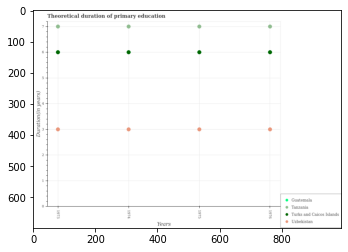

Number of QA =  29





,Years,Turks and Caicos Islands,Uzbekistan,Guatemala,Tanzania
0,1974,6.043737,3.030394,NaN,7.042663
1,1975,6.042008,3.031006,NaN,7.041215
2,1973,6.041604,3.027186,NaN,7.040394
3,1976,6.039300,3.032643,NaN,7.042151


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total theoretical duration of primary education in uzbekistan in 1975 ?
PREDICTED =  0.7577515482334173
EXPECTED =  3




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum total theoretical duration of primary education in tanzania ?
PREDICTED =  493.5
EXPECTED =  7




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum total theoretical duration of primary education in guatemala ?
PREDICTED =  493.25
EXPECTED =  6




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.


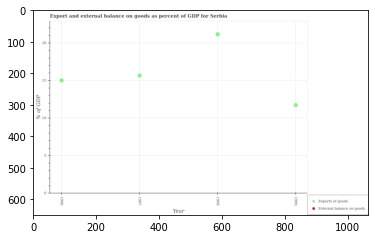

Number of QA =  24





,Year,External balance on goods,Exports of goods
0,1997,NaN,15.766638
1,1998,NaN,21.258546
2,1999,NaN,11.824996
3,1996,NaN,15.100906


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in 1997 and that in 1998 ?
PREDICTED =  -5.491907681772661
EXPECTED =  -5.495608009966901




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external balance on goods as percentage of gdp in 1999 and the export of goods as percentage of gdp in 1996?
PREDICTED =  nan
EXPECTED =  -15.0134584477094




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the export of goods as percentage of gdp in 1997 to that in 1998?
PREDICTED =  0.7416611749980817
EXPECTED =  0.7402609607401117




				 2 / 3 = 0.6667


is_built_with_cuda: 

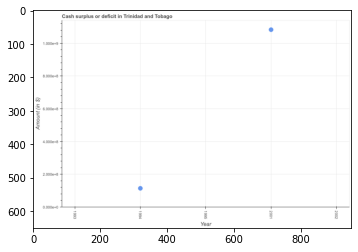

Number of QA =  19





,Year,Amount (in $)
0,1994,4.145747
1,1993,NaN
2,2002,NaN
3,1995,NaN
4,2001,38.300217


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cash surplus or deficit in 1994 and 2001 ?
PREDICTED =  -1996.8542526572344
EXPECTED =  -969087300




				 0 / 1 = 0.0


> what is the median cash surplus or deficit ?
PREDICTED =  None
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest cash surplus or deficit ?
PREDICTED =  0.0
EXPECTED =  1083287300




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Amount (in $)
EXPECTED =  200000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Cash surplus or deficit in Trinidad and Tobago
EXPECTED =  Cash surplus or deficit in Trinidad and Tobago




				 1 / 6 = 

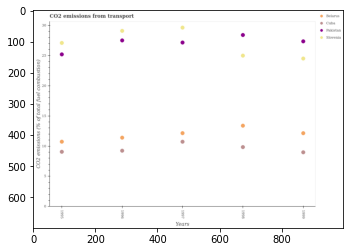

Number of QA =  29





,Years,Slovenia,Pakistan,Cuba,Belarus
0,1996,29.153722,27.565407,9.323917,11.488616
1,1995,27.151283,25.277493,9.122102,10.799351
2,1999,24.568624,27.431532,9.058771,12.225027
3,1998,25.056491,28.464294,9.913190,13.464937
4,1997,29.693811,27.213914,10.803350,12.220560


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in pakistan in 1995 and that in 1997 ?
PREDICTED =  -1.936421276014297
EXPECTED =  -1.961905843664102




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in cuba in 1997 and the total co2 emitted in slovenia in 1996?
PREDICTED =  1.4794335574363782
EXPECTED =  -18.358562187963198




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the total co2 emitted in slovenia and total co2 emitted in cuba ?
PREDICTED =  87.40260109665964
EXPECTED =  18.8961623634195




				 1 / 3 = 0.3333


is_built_with

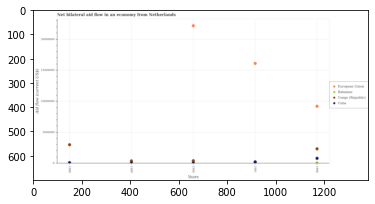

Number of QA =  28





,Years,Cuba,Bahamas,European Union,Congo (Republic)
0,1990,126606.331037,NaN,2.232059e+07,4.512404e+05
1,1988,118054.446199,NaN,NaN,3.045723e+06
2,1989,91129.221142,NaN,NaN,4.209701e+05
3,1991,246649.811126,NaN,1.622630e+07,NaN
4,1996,851840.997400,78600.469633,9.272890e+06,2.386636e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in cuba in 1988 and that in 1990 ?
PREDICTED =  -8551.884837820457
EXPECTED =  70000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in bahamas in 1991 and the net bilateral aid flow in european union in 1996?
PREDICTED =  0.0
EXPECTED =  -9180000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the net bilateral aid flow in bahamas and net bilateral aid flow in cuba ?
PREDICTED =  -1355680.3372709637
EXPECTED =  210000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_

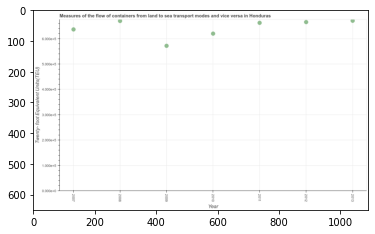

Number of QA =  24





,Year,Twenty- foot Equivalent Units(TEU)
0,2013,6.759098
1,2008,6.748483
2,2010,6.245074
3,2009,5.766189
4,2012,6.703482
5,2011,6.672058
6,2007,6.411915


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in 2010 and 2012 ?
PREDICTED =  -0.45840791732821984
EXPECTED =  -45487.18284999998




				 0 / 1 = 0.0


> what is the median container port traffic ?
PREDICTED =  None
EXPECTED =  662431.798




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the container port traffic in 2008 to that in 2013 ?
PREDICTED =  0.9984295261746796
EXPECTED =  0.9986216984929919




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest container port traffic ?
PREDICTED =  0.08703991132520894
EXPECTED =  924.4632951499661




	

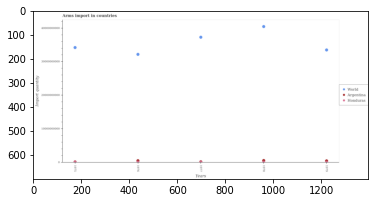

Number of QA =  28





,Years,Argentina,Honduras,World
0,1976,6.099116e+08,2.902443e+08,3.252353e+10
1,1979,3.121200e+08,5.975340e+08,3.381757e+10
2,1977,NaN,3.099628e+08,3.763626e+10
3,1978,6.624875e+08,NaN,4.085638e+10
4,1975,NaN,2.834893e+08,3.457448e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arms import in world in 1976 and that in 1979 ?
PREDICTED =  -1294042210.9977074
EXPECTED =  -1310000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arms import in world in 1975 and the total arms import in honduras in 1977?
PREDICTED =  -3061775669.671829
EXPECTED =  34166000000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1976, what is the difference between the total arms import in honduras and total arms import in world ?
PREDICTED =  -1.0
EXPECTED =  -32131000000.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available

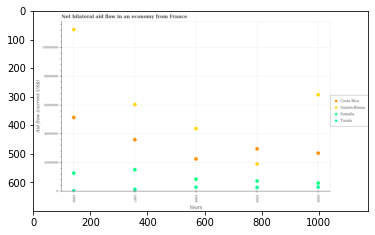

Number of QA =  29





,Years,Somalia,Costa Rica,Tuvalu,Guinea-Bissau
0,1998,8.712712e+05,2.275150e+06,309226.214926,4.380675e+06
1,1999,7.407529e+05,2.971180e+06,291543.972465,1.922121e+06
2,1996,1.285289e+06,5.143103e+06,58454.922735,1.124244e+07
3,1997,1.525925e+06,3.605093e+06,157191.805593,6.038724e+06
4,2000,5.931991e+05,2.673200e+06,317996.931111,6.718239e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in somalia in 1998 and that in 2000 ?
PREDICTED =  278072.13306704815
EXPECTED =  270000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in guinea-bissau in 1997 and the net bilateral aid flow in costa rica in 1999?
PREDICTED =  4116602.9942918653
EXPECTED =  3080000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the net bilateral aid flow in costa rica and net bilateral aid flow in somalia ?
PREDICTED =  16667720.08415839
EXPECTED =  2240000.0




				 1 / 3 = 0.3333




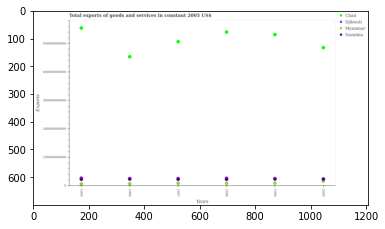

Number of QA =  29





,Years,Djibouti,Namibia,Myanmar,Chad
0,1999,NaN,2.603165e+10,1.037250e+10,5.335601e+11
1,1998,NaN,2.445886e+10,9.820853e+09,5.420053e+11
2,1996,NaN,2.596548e+10,8.579073e+09,4.552814e+11
3,1995,NaN,2.529301e+10,7.793219e+09,5.563576e+11
4,1997,NaN,2.642631e+10,9.981066e+09,5.082918e+11
5,2000,NaN,2.484228e+10,1.768816e+10,4.874664e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in namibia in 1996 and that in 2000 ?
PREDICTED =  -50807765972.40999
EXPECTED =  -13486101.64169693




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in myanmar in 1998 and the total exports of goods and services in namibia in 2000?
PREDICTED =  -27509008906.253113
EXPECTED =  -15049648559.361198




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the total exports of goods and services in chad and total exports of goods and services in djibouti ?
PREDICT

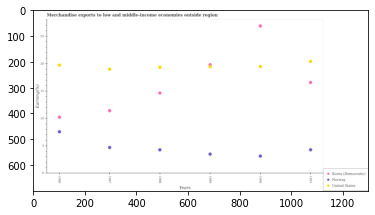

Number of QA =  28





,Years,Norway,United States,Korea (Democratic)
0,1990,3.193523,19.534058,26.929882
1,1986,7.615824,19.760641,10.271363
2,1989,3.547908,19.479993,19.868678
3,1988,4.332981,19.380196,14.692814
4,1991,4.351460,20.467044,16.611746
5,1987,4.742786,19.036989,11.474448


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in norway in 1987 and that in 1991 ?
PREDICTED =  0.391326415061636
EXPECTED =  0.41013666757098033




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in united states in 1989 and the percentage of amount earned from merchandise exports in norway in 1986?
PREDICTED =  -0.280648284285256
EXPECTED =  11.868504338486652




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the percentage of amount earned from merchandise exports

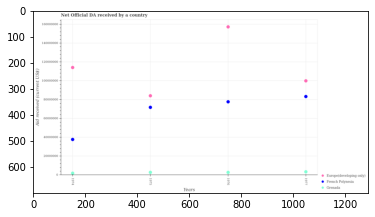

Number of QA =  28





,Years,Grenada,French Polynesia,Europe(developing only:
0,1975,3.121425e+06,7.217050e+07,8.440982e+07
1,1974,2.248922e+06,3.807154e+07,1.143770e+08
2,1977,3.734579e+06,8.362815e+07,1.002530e+08
3,1976,3.172122e+06,7.800499e+07,1.574259e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official development assistance aid received in grenada in 1975 and that in 1976 ?
PREDICTED =  -50697.09698149189
EXPECTED =  30000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official development assistance aid received in french polynesia in 1976 and the net official development assistance aid received in grenada in 1977?
PREDICTED =  -5623160.057528138
EXPECTED =  74310000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the net official development assistance aid received in europe(developing only) an

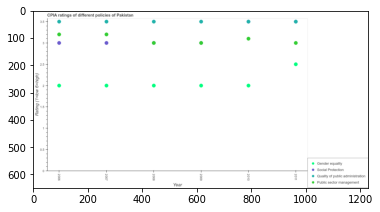

Number of QA =  29





,Year,Quality of public administration,Gender equality,Social Protection,Public sector management
0,2010,3.505266,2.008101,NaN,3.105348
1,2009,3.505987,2.008886,NaN,3.006505
2,2008,3.505388,2.008903,NaN,3.007770
3,2007,3.504716,2.008681,3.005655,3.205349
4,2006,3.503907,2.008877,3.007616,3.206470
5,2011,3.504757,2.508405,NaN,3.007281


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the cpia rating of quality of public administration in 2008 ?
PREDICTED =  1.7526940970223501
EXPECTED =  3.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the cpia rating of quality of public administration minimum?
PREDICTED =  1003.0
EXPECTED =  2006




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of gender equality in 2009 and that in 2010 ?
PREDICTED =  0.0007850439592589353
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the d

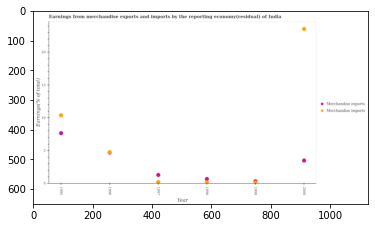

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,1995,10.415738,7.699323
1,1998,0.238513,0.768165
2,1996,4.805379,NaN
3,2000,23.482316,3.548008
4,1999,0.374598,0.156782
5,1997,0.294138,1.359080


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 1996 and that in 1997 ?
PREDICTED =  -1.3590797128846888
EXPECTED =  3.41016445349032




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 2000 and the earnings from merchandise imports in 1998?
PREDICTED =  2.7798433360593435
EXPECTED =  3.3248927312071976




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the earnings from merchandise exports and earnings from merchandise imports ?
PREDICTED =  -0.8417365236836187
EXPECTED =  1.075203339848855




				 0

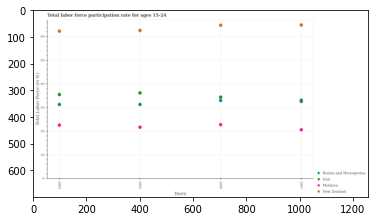

Number of QA =  29





,Years,Iran,New Zealand,Moldova,Bosnia and Herzegovina
0,2004,35.563069,62.261685,22.675447,31.328593
1,2005,36.258649,62.583789,21.828701,31.381876
2,2007,33.156511,64.850378,20.731558,NaN
3,2006,34.430191,64.756137,22.901206,33.043760


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in bosnia and herzegovina in 2004 and that in 2006 ?
PREDICTED =  62.71046928514121
EXPECTED =  -1.7000007629394993




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in iran in 2005 and the labor force participation rate in moldova in 2007?
PREDICTED =  3.102138066277057
EXPECTED =  15.600000381469801




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the labor force participation rate in bosnia and herzegovina and labor force participation rate in moldova ?
PREDIC

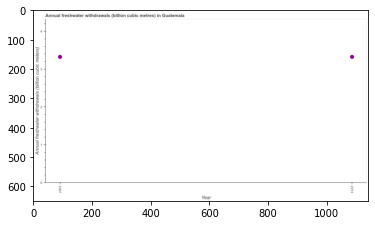

Number of QA =  20





,Year,Annual freshwater withdrawals (billion cubic meters)
0,2013,3.327259
1,2007,3.325894


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual freshwater withdrawals in 2007 and 2013 ?
PREDICTED =  -0.0013650669993134912
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median annual freshwater withdrawals ?
PREDICTED =  3.3265769029554
EXPECTED =  3.324




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the annual freshwater withdrawals in 2007 to that in 2013 ?
PREDICTED =  0.9995897323231374
EXPECTED =  1.0




				 2 / 3 = 0.6667


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Annual freshwater withdrawals (billion cubic meters)
EXPECTED =  1.0



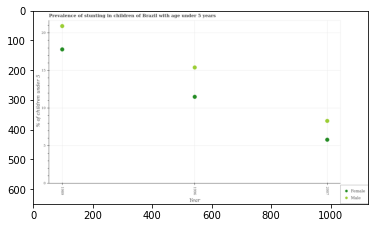

Number of QA =  27





,Year,Male,Female
0,1989,20.993207,17.895627
1,1996,15.496129,11.577133
2,2007,8.377522,5.878209


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted male children in 1996 and that in 2007 ?
PREDICTED =  7.118607321920193
EXPECTED =  7.099999427795439




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted female children in 2007 and the percentage of stunted male children in 1996?
PREDICTED =  -5.698923959330278
EXPECTED =  -9.599999427795439




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of stunted male children and percentage of stunted female children ?
PREDICTED =  2.4993131465194853
EXPECTED =  3.8999996185303


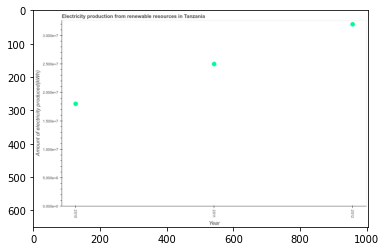

Number of QA =  24





,Year,Amount of electricity produced(kWh)
0,2011,2.510875
1,2012,3.210922
2,2010,1.812265


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of electricity produced in 2010 and 2011 ?
PREDICTED =  -0.6986097531582418
EXPECTED =  -7000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of electricity produced ?
PREDICTED =  2.5108748711489035
EXPECTED =  25000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of electricity produced in 2010 to that in 2012 ?
PREDICTED =  0.5644063937738674
EXPECTED =  0.5625




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is t

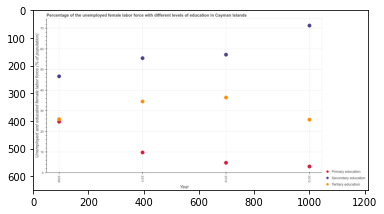

Number of QA =  28





,Year,Primary education,Secondary education,Tertiary education
0,2013,3.231389,70.674906,25.652946
1,2011,9.942440,55.054144,34.328082
2,2012,5.005045,56.768304,36.224395
3,2008,24.664158,46.326843,25.822544


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in 2008 and that in 2012 ?
PREDICTED =  19.659113306219226
EXPECTED =  19.900000572204636




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in 2011 and the percentage of female labor force who received secondary education in 2012?
PREDICTED =  4.937395066768714
EXPECTED =  -47.40000057220465




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of female labor force who received primary e

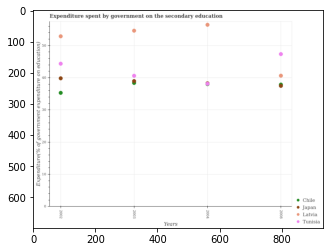

Number of QA =  29





,Years,Latvia,Chile,Tunisia,Japan
0,2004,56.767475,NaN,38.424170,NaN
1,2003,54.935113,39.204865,40.908769,38.657370
2,2002,53.204726,35.593877,44.673613,40.067234
3,2008,40.933443,37.756004,47.644311,38.143502


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure spent by government on the secondary education in chile in 2003 and that in 2004 ?
PREDICTED =  39.20486537750532
EXPECTED =  0.374526977539098




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure spent by government on the secondary education in latvia in 2004 and the expenditure spent by government on the secondary education in chile in 2008?
PREDICTED =  15.834032725365958
EXPECTED =  18.57683181762689




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the expenditure spent by government on the seconda

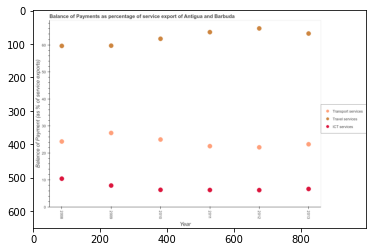

Number of QA =  28





,Year,ICT services,Travel services,Transport services
0,2008,10.804417,60.155792,24.640192
1,2010,6.647393,62.801119,25.375133
2,2011,6.564966,65.312998,22.882232
3,2013,6.962620,64.785544,23.612142
4,2012,6.523298,66.686114,22.475287
5,2009,8.230967,60.248629,27.774011


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payment of travel services in 2009 and that in 2013 ?
PREDICTED =  -4.536915825479795
EXPECTED =  -4.494952992414703




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payment of travel services in 2013 and the balance of payment of ict services in 2008?
PREDICTED =  4.629752784202296
EXPECTED =  53.7338189666131




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the balance of payment of ict services and balance of payment of travel services ?
PREDICTED =  10.80441741776108
EXPECTED =  -59.86107482068775

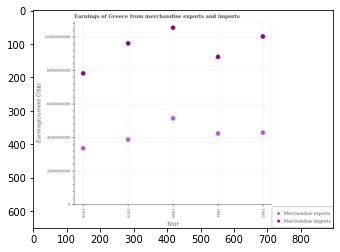

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,1980,1.058663e+10,5.190247e+09
1,1979,9.650451e+09,3.921911e+09
2,1981,8.843188e+09,4.283361e+09
3,1982,1.006445e+10,4.330295e+09
4,1978,7.861355e+09,3.402543e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 1978 and that in 1982 ?
PREDICTED =  -2203100246.7126675
EXPECTED =  -2197030000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 1979 and the earnings from merchandise imports in 1981?
PREDICTED =  -361449856.4803648
EXPECTED =  -4925120000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the earnings from merchandise exports and earnings from merchandise imports ?
PREDICTED =  0.0
EXPECTED =  -5395000000.0




				 1 / 3 = 0.3333


is_built_wit

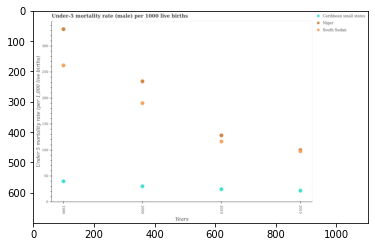

Number of QA =  28





,Years,Caribbean small states,Niger,South Sudan
0,2010,25.380471,129.783459,117.925458
1,1990,40.889994,335.612473,265.378000
2,2015,22.830810,NaN,101.360608
3,2000,31.199571,234.538269,192.231817


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in caribbean small states in 1990 and that in 2010 ?
PREDICTED =  15.509523017690746
EXPECTED =  15.38122788939329




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in south sudan in 2000 and the under-five mortality rate in caribbean small states in 2010?
PREDICTED =  74.30635857519573
EXPECTED =  165.69477953848087




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the under-five mortality rate in caribbean small states and under-five mortality rate in niger ?
PREDICTED = 

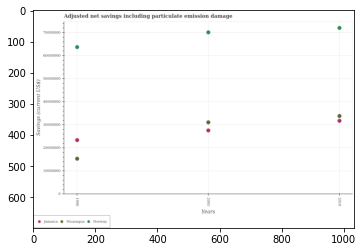

Number of QA =  28





,Years,Nicaragua,Norway,Jamaica
0,1990,1.552389e+07,6.395043e+07,2.358597e+07
1,2010,3.409564e+07,7.230068e+07,3.200870e+07
2,2005,3.134120e+07,7.036068e+07,2.778006e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings in nicaragua in 1990 and that in 2005 ?
PREDICTED =  -15817312.657435197
EXPECTED =  -15784769.368887698




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings in jamaica in 1990 and the net savings in norway in 2010?
PREDICTED =  -8422727.95120982
EXPECTED =  -48658217.6101969




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the net savings in jamaica and net savings in norway ?
PREDICTED =  -174603092.25860322
EXPECTED =  -40287702.39676571




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_avail

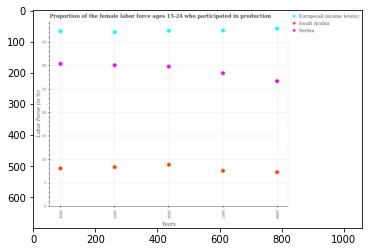

Number of QA =  28





,Years,Europe(all income levels),Saudi Arabia,Serbia
0,2008,38.183369,7.470293,26.934130
1,2006,37.697148,9.065605,30.070694
2,2007,37.755033,7.747919,28.638802
3,2004,37.597675,8.252036,30.666937
4,2005,37.425766,8.560981,30.314323


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in serbia in 2005 and that in 2006 ?
PREDICTED =  0.24362984199482085
EXPECTED =  0.30000114440919035




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in serbia in 2008 and the proportion of the female labor force who participated in production in saudi arabia in 2007?
PREDICTED =  19.18621118710118
EXPECTED =  19.100000858306927




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the proport

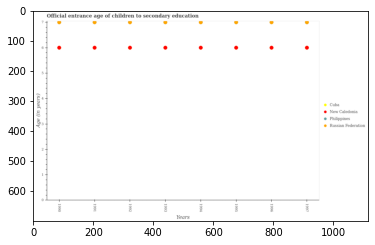

Number of QA =  29





,Years,Cuba,Philippines,Russian Federation,New Caledonia
0,1996,NaN,NaN,6.935615,5.946151
1,1991,NaN,NaN,6.936632,5.944070
2,1992,NaN,NaN,6.936353,5.943755
3,1994,NaN,NaN,6.934043,5.946165
4,1990,NaN,NaN,6.933154,5.948378
5,1997,NaN,NaN,6.934211,5.945366
6,1993,NaN,NaN,6.931851,5.944413
7,1995,NaN,NaN,6.935766,5.947682


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum secondary school starting age of children in russian federation ?
PREDICTED =  248.875
EXPECTED =  7




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary school starting age of children in cuba in 1993 and the secondary school starting age of children in russian federation in 1994?
PREDICTED =  0.125
EXPECTED =  -1




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_g

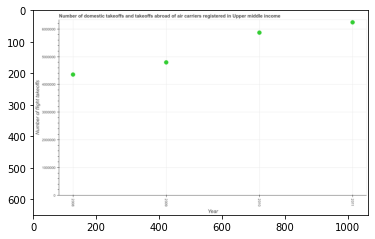

Number of QA =  24





,Year,Number of flight takeoffs
0,2011,6.252060e+06
1,2010,5.877026e+06
2,2008,4.368337e+06
3,2009,4.809282e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of flight takeoffs in 2008 and 2009 ?
PREDICTED =  -440945.3159401966
EXPECTED =  -439350.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of flight takeoffs ?
PREDICTED =  5343154.101444246
EXPECTED =  5331480.233867855




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of flight takeoffs in 2009 to that in 2010 ?
PREDICTED =  0.8183190980287308
EXPECTED =  0.8170988607112845




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is t

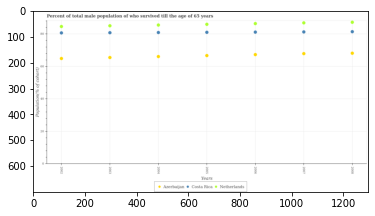

Number of QA =  28





,Years,Azerbaijan,Netherlands,Costa Rica
0,2004,66.104078,85.412205,80.910186
1,2008,68.152312,87.161846,81.388117
2,2002,64.871065,84.581599,80.653709
3,2005,66.700647,85.867700,81.002560
4,2003,65.464641,85.069947,80.808564
5,2006,67.322624,86.377965,81.156418
6,2007,67.927220,86.786210,81.234826


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total male population who survived till the age of 65 years in netherlands in 2002 and that in 2003 ?
PREDICTED =  -20.198882518118523
EXPECTED =  -0.44955999999997687




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total male population who survived till the age of 65 years in costa rica in 2006 and the percentage of total male population who survived till the age of 65 years in azerbaijan in 2007?
PREDICTED =  -0.604595344022357
EXPECTED =  13.25788




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference be

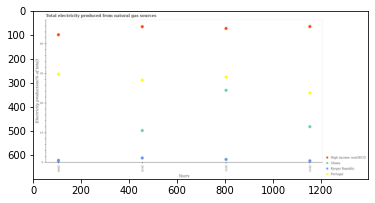

Number of QA =  29





,Years,High income: nonOECD,Ghana,Kyrgyz Republic,Portugal
0,2009,42.979777,0.416929,0.833839,29.706353
1,2012,45.763053,12.114283,0.655645,23.440073
2,2011,45.126027,24.354683,1.151765,28.779152
3,2010,45.732159,10.821648,1.609618,27.759471


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in ghana in 2009 and that in 2010 ?
PREDICTED =  -10.404718483255419
EXPECTED =  -10.517367333250718




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in high income: nonoecd in 2011 and the total electricity produced in ghana in 2009?
PREDICTED =  2.146250573558305
EXPECTED =  44.939199513762716




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the total electricity produced in portugal and total electricity produced in high income: nonoecd ?
PREDICTED =  -69.91596748202

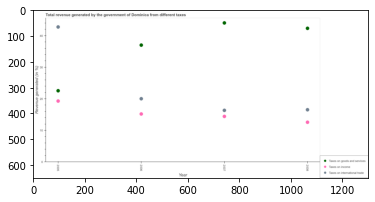

Number of QA =  28





,Year,Taxes on goods and services,Taxes on international trade,Taxes on income
0,2006,37.151574,20.154139,15.304977
1,2007,44.185091,16.495240,14.513929
2,2008,42.479215,16.666177,12.687282
3,2005,22.656051,42.947710,19.388682


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on income in 2006 and that in 2007 ?
PREDICTED =  0.7910479154852244
EXPECTED =  0.7679880975750901




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on goods and services in 2006 and the percentage of revenue generated by taxes on income in 2008?
PREDICTED =  31.497808843544593
EXPECTED =  24.4600336206299




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of revenue generated by tax on international trade and percentage of reven

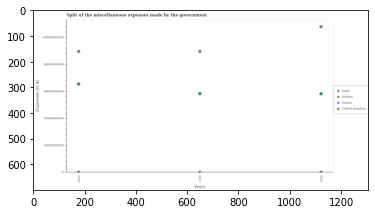

Number of QA =  29





,Years,Samoa,Kiribati,United Kingdom,India
0,2012,3.756149e+08,NaN,5.844959e+10,1.081106e+11
1,2010,3.869780e+08,NaN,6.566431e+10,8.984090e+10
2,2011,3.769285e+08,NaN,5.855162e+10,8.980749e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the miscellaneous expenses made by the government in samoa in 2010 and that in 2012 ?
PREDICTED =  11363071.644602716
EXPECTED =  -693.3834900000002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the miscellaneous expenses made by the government in united kingdom in 2011 and the miscellaneous expenses made by the government in samoa in 2010?
PREDICTED =  -7112695805.922211
EXPECTED =  58315983465.85388




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished afte

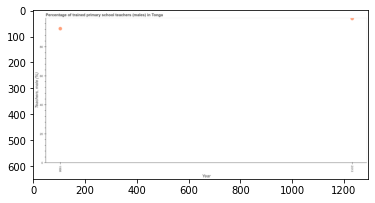

Number of QA =  20





,Year,"Teachers, male (%)"
0,2013,99.433373
1,1998,92.445244


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained male teachers in 1998 and 2013 ?
PREDICTED =  -6.988129348296724
EXPECTED =  -6.9907210571289085




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of trained male teachers ?
PREDICTED =  2005.5
EXPECTED =  96.08091052856446




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of trained male teachers in 1998 to that in 2013 ?
PREDICTED =  0.9297204837094183
EXPECTED =  0.9297953118457489




				 2 / 3 = 0.6667


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Teachers, male (%)
EXP

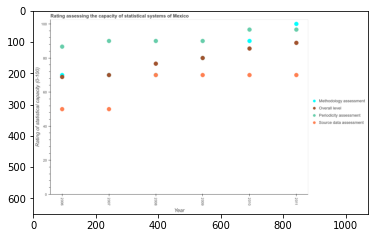

Number of QA =  29





,Year,Source data assessment,Methodology assessment,Overall level,Periodicity assessment
0,2010,70.224851,90.114627,85.652019,96.740834
1,2008,70.216656,NaN,76.820525,90.101279
2,2007,50.201944,NaN,70.145227,90.082979
3,2009,70.228284,NaN,80.146820,90.102770
4,2006,50.199240,68.986094,70.021483,86.767944
5,2011,70.162226,100.074495,88.952158,96.726414


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the source data assessment rating in 2006 and that in 2008 ?
PREDICTED =  -20.01741555710378
EXPECTED =  -20




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the periodicity assessment rating in 2007 and the source data assessment rating in 2010?
PREDICTED =  -6.657855332493398
EXPECTED =  20.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the overall level rating and source data assessment rating ?
PREDICTED =  8.805338454561607
EXPECTED =  18.8888888888889




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: F

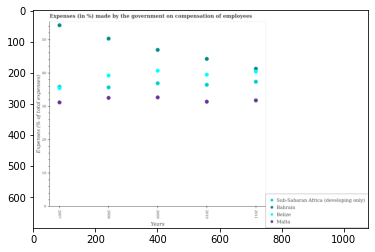

Number of QA =  29





,Years,Malta,Belize,Bahrain,Sub-Saharan Africa (developing only)
0,2008,32.760302,39.481012,50.525899,35.887761
1,2009,32.885418,40.913045,47.169330,37.103278
2,2007,31.426299,35.688616,54.508863,36.074234
3,2011,31.989854,40.568070,41.492784,37.600031
4,2010,31.601807,39.711767,44.451675,36.673674


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on compensation of employees in belize in 2007 and that in 2008 ?
PREDICTED =  -3.7923954507079003
EXPECTED =  -3.818593125858115




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on compensation of employees in sub-saharan africa (developing only) in 2007 and the percentage of expenses made by the government on compensation of employees in malta in 2008?
PREDICTED =  0.18647275296964239
EXPECTED =  3.324663428698898




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008

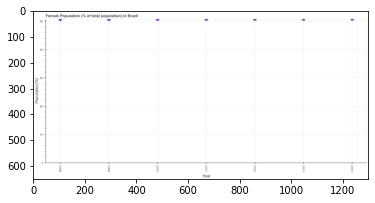

Number of QA =  24





,Year,Population(%)
0,2012,50.712279
1,2013,50.703398
2,2008,50.621371
3,2010,50.661308
4,2009,50.663902
5,2014,50.754001
6,2011,50.660361


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female population in 2012 and 2013 ?
PREDICTED =  0.008881488236326618
EXPECTED =  -0.01701365560890622




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median female population ?
PREDICTED =  50.66390221335621
EXPECTED =  50.7613885872473




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the female population in 2010 to that in 2011 ?
PREDICTED =  1.000018692119229
EXPECTED =  0.9996560886449668




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the differe

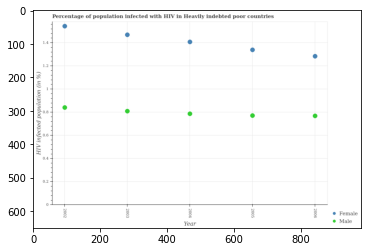

Number of QA =  27





,Year,Male,Female
0,2002,0.845798,1.551294
1,2003,0.814785,1.475158
2,2006,0.774001,1.289714
3,2004,0.792425,1.413934
4,2005,0.776739,1.345017


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of males who are infected with hiv in 2002 and that in 2005 ?
PREDICTED =  0.06905942555547251
EXPECTED =  0.06966844959445095




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of males who are infected with hiv in 2004 and the percentage of females who are infected with hiv in 2005?
PREDICTED =  0.015685508023355443
EXPECTED =  -0.5520927084008391




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of females who are infected with hiv and percentage of males who are infected with hiv ?
PRE

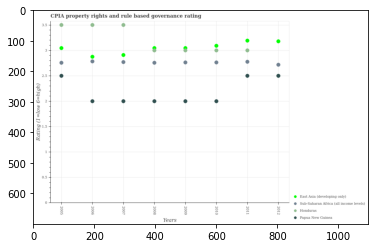

Number of QA =  29





,Years,Sub-Saharan Africa (all income levels),East Asia (developing only),Honduras,Papua New Guinea
0,2005,2.771036,3.059008,3.511477,2.515755
1,2008,2.770639,3.060446,3.014777,2.013124
2,2011,2.790822,3.208351,3.013923,2.514095
3,2006,2.797524,2.890506,3.515092,2.013580
4,2007,2.786021,2.923211,3.514774,2.012314
5,2012,2.732317,3.193149,NaN,2.514698
6,2009,2.777493,3.060863,3.014226,2.012544
7,2010,2.778000,3.106279,3.015779,2.013290


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in honduras in 2007 and that in 2012 ?
PREDICTED =  nan
EXPECTED =  1.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in sub-saharan africa (all income levels) in 2010 and the cpia rating in east asia (developing only) in 2009?
PREDICTED =  -2.785513814218451
EXPECTED =  -0.28229665071771004




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the cpia rating in east asia (developing only) and cpia rating in honduras ?
PREDICTED =  13.611306049681154
EXPECTED =  -0.625




				 0 / 3 = 0.0


is_built

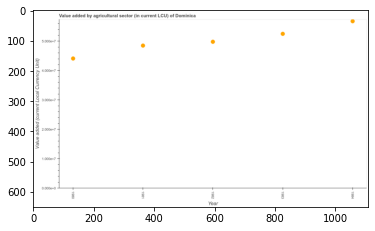

Number of QA =  24





,Year,Value added (current Local Currency Unit)
0,1980,4.429700
1,1981,4.869225
2,1982,4.998163
3,1984,5.694999
4,1983,5.268121


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agriculture sector in 1982 and 1983 ?
PREDICTED =  -0.2699584515207434
EXPECTED =  -2700000




				 0 / 1 = 0.0


> what is the median value added by agriculture sector ?
PREDICTED =  None
EXPECTED =  49800000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the value added by agriculture sector in 1980 to that in 1982 ?
PREDICTED =  0.8862657857081468
EXPECTED =  0.8855421686746988




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest value added by agriculture sector ?
PREDICTED =  0.4268774886217592
EXP

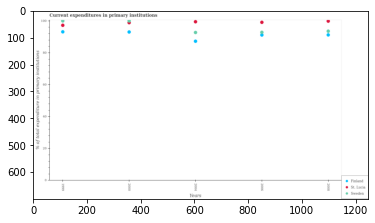

Number of QA =  28





,Years,St. Lucia,Sweden,Finland
0,2008,100.241527,93.943265,91.614138
1,2004,99.838845,93.130331,87.643209
2,2006,99.500044,93.238648,91.584777
3,1999,97.714781,100.473746,93.549761
4,2000,100.339527,99.245899,93.484892


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in primary institutions in sweden in 2000 and that in 2006 ?
PREDICTED =  6.007251842557949
EXPECTED =  7.175682067871094




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in primary institutions in finland in 2006 and the current expenditures in primary institutions in st. lucia in 2000?
PREDICTED =  82.8593882505247
EXPECTED =  -7.7329559326171875




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after train

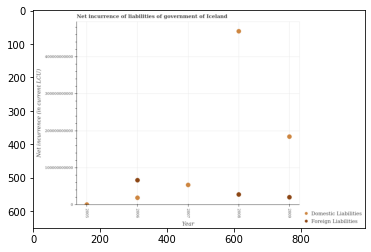

Number of QA =  26





,Year,Foreign Liabilities,Domestic Liabilities
0,2007,NaN,5.535293e+10
1,2009,2.201358e+10,1.860147e+11
2,2008,2.944197e+10,4.716381e+11
3,2006,6.820206e+10,2.058723e+10
4,2005,NaN,2.756906e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of domestic liabilities in 2005 and that in 2008 ?
PREDICTED =  -468881152898.885
EXPECTED =  -468274085000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in 2009 and the net incurrence of domestic liabilities in 2008?
PREDICTED =  -7428389042.948067
EXPECTED =  -448407785000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the net incurrence of domestic liabilities and net incurrence of foreign liabilities ?
PREDICTED =  29441973442.706524
EXPECTED =  -47505517000

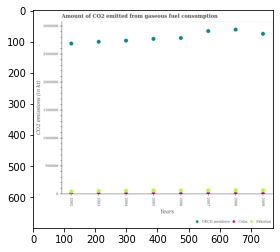

Number of QA =  28





,Years,Cuba,OECD members,Pakistan
0,2003,61299.939252,2.724919e+06,14040.262150
1,2006,10543.936962,2.792833e+06,72147.351337
2,2009,11130.022233,2.866831e+06,75737.144827
3,2007,12225.348599,2.917205e+06,73326.137603
4,2005,11671.663411,2.777847e+06,72741.579037
5,2004,11044.187458,2.745406e+06,69338.891785
6,2008,13387.510739,2.943042e+06,74127.318713
7,2002,50977.035317,2.693957e+06,17730.987836


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in oecd members in 2002 and that in 2009 ?
PREDICTED =  -172874.31123583345
EXPECTED =  -174127.41788154002




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in cuba in 2004 and the amount of co2 emitted in oecd members in 2007?
PREDICTED =  -1181.1611413675637
EXPECTED =  -2907791.9527156




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount of co2 emitted in oecd members and amount of co2 emitted in pakistan ?
PREDICTED =  19768076.57388579
EXPECTED =  2721080.98917602





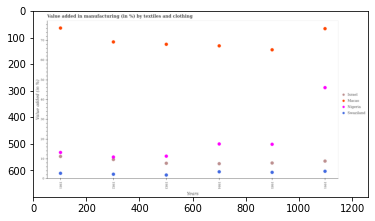

Number of QA =  29





,Years,Swaziland,Macao,Nigeria,Israel
0,1983,2.063148,68.523395,11.669371,8.016249
1,1984,3.681269,67.747574,17.831980,7.828759
2,1985,3.415758,65.745627,17.706037,8.172689
3,1991,3.907066,76.470080,46.493885,9.154163
4,1982,2.479924,69.706256,11.194541,9.933397
5,1981,2.932524,76.828215,13.529957,11.513339


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing by textiles and clothing in israel in 1981 and that in 1982 ?
PREDICTED =  -3.9333966080504457
EXPECTED =  1.5687739166339707




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing by textiles and clothing in israel in 1984 and the percentage of value added in manufacturing by textiles and clothing in macao in 1991?
PREDICTED =  -3.1541630032172403
EXPECTED =  -68.35224200579168




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1982, what is the difference between the percentage of

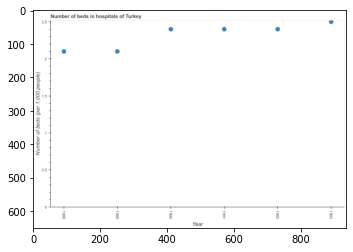

Number of QA =  24





,Year,"Number of beds (per 1,000 people)"
0,1990,2.424021
1,1989,2.121250
2,1988,2.122050
3,1993,2.525017
4,1992,2.424544
5,1991,2.424868


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hospital beds in 1988 and 1992 ?
PREDICTED =  -0.30249359815203114
EXPECTED =  -0.3000001907674297




				 1 / 1 = 1.0


> what is the median number of hospital beds ?
PREDICTED =  None
EXPECTED =  2.4000000954




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of hospital beds in 1988 to that in 1990 ?
PREDICTED =  0.8754257047658882
EXPECTED =  0.874999925482324




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest number of hospital beds ?
PREDICTED =  0.0
EXPECTED =  0.09999990460000019




				 2 

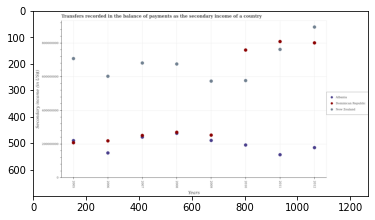

Number of QA =  28





,Years,Dominican Republic,New Zealand,Albania
0,2006,2.216953e+08,6.063878e+08,1.499994e+08
1,2005,2.108747e+08,7.120600e+08,2.233083e+08
2,2008,2.732138e+08,6.791240e+08,NaN
3,2009,2.558914e+08,5.773276e+08,2.247568e+08
4,2010,7.626367e+08,5.804979e+08,1.970034e+08
5,2007,2.528877e+08,6.850553e+08,2.434362e+08
6,2011,8.131965e+08,7.660496e+08,1.395255e+08
7,2012,8.050225e+08,8.995097e+08,1.814219e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in dominican republic in 2005 and that in 2006 ?
PREDICTED =  -10820623.48729989
EXPECTED =  -11100000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in albania in 2005 and the secondary income of in new zealand in 2007?
PREDICTED =  -20127963.353259712
EXPECTED =  -460808191.70000005




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the secondary income of in new zealand and secondary income of in albania ?
PREDICTED =  -719376189.5027697
EXPECTED =  487074118.29999995




				 1

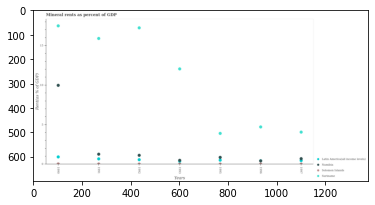

Number of QA =  29





,Years,Latin America(all income levels,Namibia,Solomon Islands,Suriname
0,1996,NaN,0.483846,0.078576,4.739661
1,1995,0.549243,0.892259,0.070473,3.916026
2,1997,0.509348,0.715935,0.053530,4.082159
3,1990,0.955939,9.976970,0.079322,17.499876
4,1991,0.699331,1.307127,0.059388,15.910947
5,1993,NaN,0.501985,0.075595,12.068050
6,1992,0.591651,1.164313,0.069836,17.251654


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in suriname in 1992 and that in 1996 ?
PREDICTED =  12.511993129294837
EXPECTED =  12.537804448083289




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in latin america(all income levels) in 1993 and the mineral rent in suriname in 1992?
PREDICTED =  -0.5916514787805416
EXPECTED =  -16.880470456429755




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the mineral rent in latin america(all income levels) and mineral rent in suriname ?
PREDICTED =  0.0
EXPECTED =  -4.274814444392668




				 1 / 3 = 0.

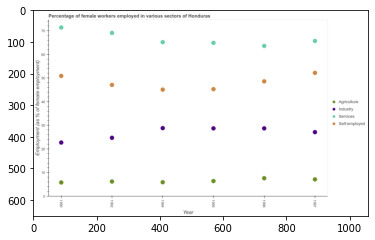

Number of QA =  29





,Year,Services,Agriculture,Self-employed,Industry
0,1990,71.227686,6.051551,50.818556,22.878968
1,1994,65.063224,6.130816,45.106476,28.899227
2,1996,63.478817,7.826148,48.575474,28.803511
3,1995,64.752463,6.601587,45.285248,28.799659
4,1992,68.926371,6.465745,47.082620,24.833071
5,1997,65.558256,7.331842,52.136150,27.220839


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self employed female workers in 1990 and that in 1995 ?
PREDICTED =  5.53330748798583
EXPECTED =  5.600002288818402




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female workers in industry in 1992 and the percentage of female workers in agriculture in 1995?
PREDICTED =  -3.966588089621574
EXPECTED =  18.30000066757207




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the percentage of self employed female workers and percentage of female workers in industry ?
PREDICTED =  7.029673761658778
EXP

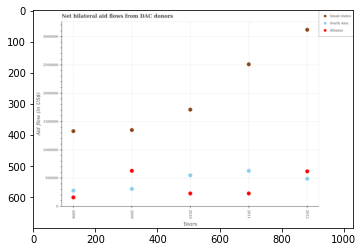

Number of QA =  28





,Years,South Asia,Albania,Small states
0,2012,499262.064088,628955.422464,3.127798e+06
1,2008,289153.277362,168536.761371,1.336254e+06
2,2010,560510.870578,238365.336279,1.718430e+06
3,2009,318826.898731,637004.732604,1.357883e+06
4,2011,638549.721698,238519.843577,2.517181e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in small states in 2009 and that in 2010 ?
PREDICTED =  -360547.05648919335
EXPECTED =  -360000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in albania in 2011 and the net bilateral aid flow in south asia in 2008?
PREDICTED =  69983.0822058509
EXPECTED =  -50000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the net bilateral aid flow in albania and net bilateral aid flow in small states ?
PREDICTED =  -8146164.396183888
EXPECTED =  -720000




				 1 / 3 = 0.3333


is_bu

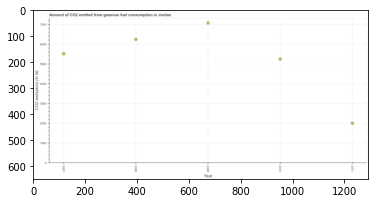

Number of QA =  24





,Year,CO2 emissions (in kt)
0,2008,6273.104958
1,2010,5272.567212
2,2007,5540.668068
3,2009,7099.544150
4,2011,2027.476791


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions from gaseous fuel consumption in 2007 and 2009 ?
PREDICTED =  -1558.8760820186753
EXPECTED =  -1554.808




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median co2 emissions from gaseous fuel consumption ?
PREDICTED =  5540.668067680802
EXPECTED =  5511.501




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the co2 emissions from gaseous fuel consumption in 2008 to that in 2011 ?
PREDICTED =  3.094045261975737
EXPECTED =  3.1229357798165136




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fin

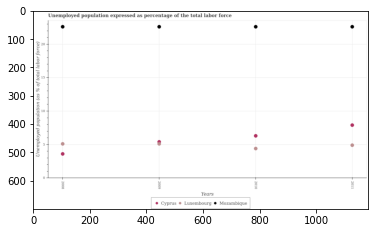

Number of QA =  28





,Years,Cyprus,Luxembourg,Mozambique
0,2008,3.659826,5.173871,22.788560
1,2011,8.002800,4.998166,22.798832
2,2009,5.495636,5.167650,22.801802
3,2010,6.395645,4.475501,22.798816


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in in cyprus in 2008 and that in 2010 ?
PREDICTED =  -2.7358189904431023
EXPECTED =  -2.7000002861022905




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in in cyprus in 2010 and the unemployment in in luxembourg in 2008?
PREDICTED =  2.7358189904431023
EXPECTED =  1.2000002861022905




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the unemployment in in luxembourg and unemployment in in cyprus ?
PREDICTED =  0.9537971158526677
EXPECTED =  1.5




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_

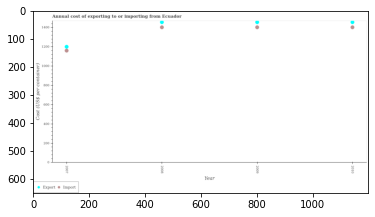

Number of QA =  27





,Year,Import,Export
0,2009,1404.669419,1456.934750
1,2008,1404.351536,1456.726628
2,2010,1404.822218,1457.189480
3,2007,1163.730900,1202.585986


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export cost in 2007 and that in 2010 ?
PREDICTED =  -254.60349378323485
EXPECTED =  -255




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export cost in 2008 and the import cost in 2009?
PREDICTED =  -0.20812191167601668
EXPECTED =  53




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the export cost and import cost ?
PREDICTED =  0.0
EXPECTED =  53




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the rati

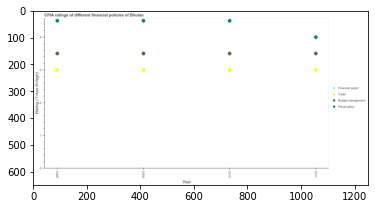

Number of QA =  29





,Year,Fiscal policy,Financial sector,Trade,Budget management
0,2008,4.505834,NaN,3.008193,3.508612
1,2010,4.507693,NaN,3.010475,3.509758
2,2009,4.509103,NaN,3.008922,3.506476
3,2011,4.008438,NaN,3.010723,3.509167


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of financial sector in 2008 and that in 2009 ?
PREDICTED =  nan
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of financial sector in 2010 and the cpia rating of fiscal policy in 2009?
PREDICTED =  nan
EXPECTED =  -1.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the cpia rating of fiscal policy and cpia rating of financial sector ?
PREDICTED =  17.531068228258004
EXPECTED =  1.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

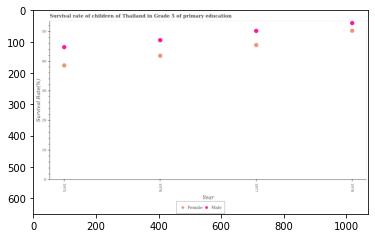

Number of QA =  27





,Year,Male,Female
0,1975,44.605392,38.480446
1,1977,50.023109,45.281300
2,1978,52.677264,50.086661
3,1976,46.956275,41.690820


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of male students in primary education in 1975 and that in 1976 ?
PREDICTED =  -2.3508823713587716
EXPECTED =  -2.3457799999999978




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of male students in primary education in 1978 and the survival rate of female students in primary education in 1976?
PREDICTED =  5.72098961887496
EXPECTED =  11.032579999999996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1976, what is the difference between the survival rate of male students in primary education and survival rate of female students i

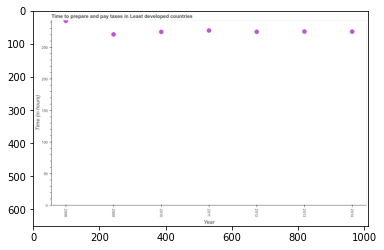

Number of QA =  24





,Year,Time (in hours)
0,2008,293.542169
1,2012,276.268290
2,2009,272.190720
3,2010,276.075434
4,2014,276.559899
5,2013,276.668704
6,2011,278.237996


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time to prepare and pay taxes in 2009 and 2014 ?
PREDICTED =  -4.369178104431967
EXPECTED =  -4.3412537917089935




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median time to prepare and pay taxes ?
PREDICTED =  2011.0
EXPECTED =  275.108695652174




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the time to prepare and pay taxes in 2013 to that in 2014 ?
PREDICTED =  0.9838146358728179
EXPECTED =  1.0006321612011053




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





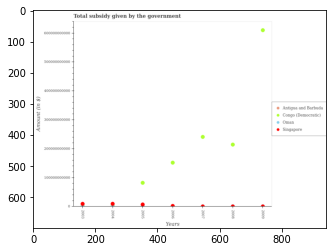

Number of QA =  29





,Years,Oman,Antigua and Barbuda,Congo (Democratic),Singapore
0,2006,NaN,NaN,1.552261e+11,3.973864e+09
1,2008,NaN,NaN,2.182671e+11,2.719062e+09
2,2004,NaN,NaN,NaN,1.145357e+10
3,2003,NaN,NaN,NaN,1.087595e+10
4,2005,NaN,NaN,8.465727e+10,9.338716e+09
5,2009,NaN,NaN,6.180818e+11,2.582477e+09
6,2007,NaN,NaN,2.451117e+11,2.581647e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue collected by the government in singapore in 2006 and that in 2007 ?
PREDICTED =  1392216804.550517
EXPECTED =  1815000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue collected by the government in congo (democratic) in 2005 and the total revenue collected by the government in singapore in 2009?
PREDICTED =  -533424557774.49493
EXPECTED =  81754438000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the total revenue collected by the government in congo (democratic) and total revenue col

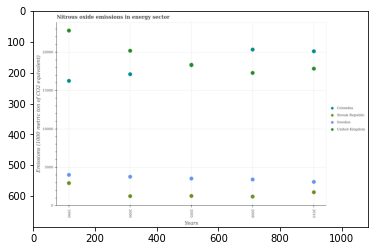

Number of QA =  29





,Years,Colombia,Sweden,Slovak Republic,United Kingdom
0,2005,NaN,3624.265638,1338.051045,18456.673742
1,1990,16387.436793,4109.291782,3023.011685,22948.769381
2,2000,17249.351458,3851.648244,1313.677464,20305.849140
3,2010,20239.354280,3191.945180,1832.312924,17976.558849
4,2008,20472.203689,3501.328759,1265.335011,17421.697303


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in colombia in 2005 and that in 2010 ?
PREDICTED =  -20239.354279699885
EXPECTED =  -1806.7999999999993




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in slovak republic in 1990 and the amount of nitrous oxide emitted in sweden in 2005?
PREDICTED =  -601.2539527188319
EXPECTED =  -593.9000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of nitrous oxide emitted in sweden and amount of nitrous oxide emitted in colombia ?
PREDICTED =  -702

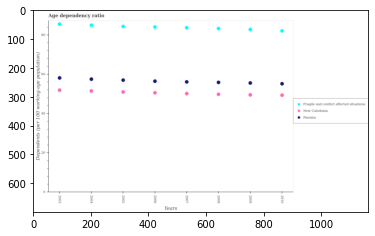

Number of QA =  28





,Years,Fragile and conflict affected situations,Panama,New Caledonia
0,2003,85.803022,58.417025,52.195177
1,2004,85.256830,57.786028,51.802542
2,2006,84.382772,56.749698,50.853922
3,2005,84.681775,57.281907,51.269313
4,2010,82.393832,55.450671,49.639117
5,2007,83.999933,56.370432,50.474223
6,2009,83.083259,55.830994,49.751727
7,2008,83.579520,56.134541,50.056751


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio in in fragile and conflict affected situations in 2010 ?
PREDICTED =  10.29922903115621
EXPECTED =  82.0807704080075




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio in in fragile and conflict affected situations ?
PREDICTED =  250.375
EXPECTED =  85.5130333207695




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio in in fragile and conflict affected situations ?
PREDICTED =  251.25
EXPECTED =  82.0807704080075




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tra

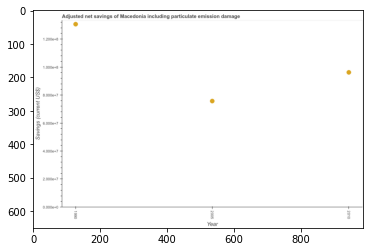

Number of QA =  24





,Year,Savings (current US$)
0,2005,0.758619
1,1990,1.304985
2,2010,0.961912


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in 2005 and 2010 ?
PREDICTED =  -0.2032925724267236
EXPECTED =  -20502196.568881303




				 0 / 1 = 0.0


> what is the median adjusted net savings ?
PREDICTED =  None
EXPECTED =  96195067.0606175




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the adjusted net savings in 1990 to that in 2010 ?
PREDICTED =  1.3566581508082256
EXPECTED =  1.357831570532714




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest adjusted net savings ?
PREDICTED =  0.0
EXPECTED =  34421631.9238005




				 1 / 5 = 0.2


is

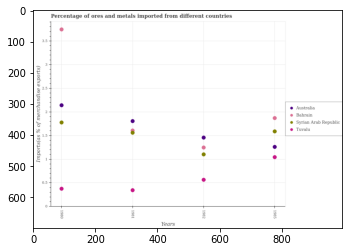

Number of QA =  29





,Years,Syrian Arab Republic,Tuvalu,Bahrain,Australia
0,1982,1.110321,0.573393,1.253510,1.464470
1,1980,1.781755,0.386955,3.749494,2.145693
2,1981,1.568810,0.353082,1.616293,1.816081
3,1985,1.594621,1.051186,1.876718,1.267735


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in tuvalu in 1981 and that in 1985 ?
PREDICTED =  -0.6981042880142124
EXPECTED =  -0.69871692669173




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in tuvalu in 1981 and the percentage of imports to different countries in bahrain in 1980?
PREDICTED =  -3.3964121963385923
EXPECTED =  -3.3994224253830203




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the percentage of imports to different countries in tuvalu and percentage of imports

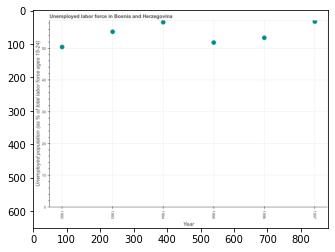

Number of QA =  24





,Year,Unemployed population (as % of total labor force ages 15-24)
0,1996,53.698259
1,1993,55.592504
2,1995,52.180284
3,1992,50.775884
4,1994,58.606788
5,1997,58.820603


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed youth population in 1992 and 1995 ?
PREDICTED =  -1.4043999117031376
EXPECTED =  -1.399997711181598




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed youth population ?
PREDICTED =  1994.5
EXPECTED =  54.25




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total unemployed youth population in 1992 to that in 1997 ?
PREDICTED =  0.8632329884114429
EXPECTED =  0.8630137022093236




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.




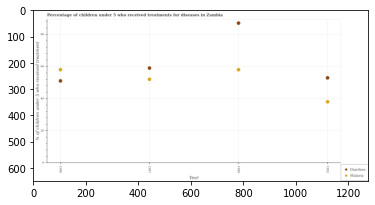

Number of QA =  27





,Year,Diarrhea,Malaria
0,1989,87.354316,58.347568
1,1992,53.238726,38.312650
2,1987,59.321069,52.370236
3,1986,51.292040,58.335402


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received treatment for diarrhoea in 1987 and that in 1992 ?
PREDICTED =  6.082342418534225
EXPECTED =  6.100000000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received treatment for malaria in 1986 and the percentage of children who received treatment for diarrhoea in 1992?
PREDICTED =  20.02275233014354
EXPECTED =  5.100000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the percentage of children who received treatment for malaria and percentage o

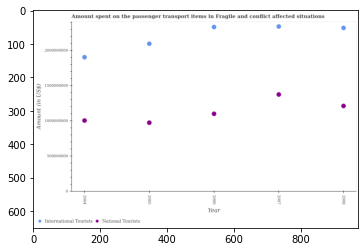

Number of QA =  27





,Year,International Tourists,National Tourists
0,2006,2.342077e+09,1.109221e+09
1,2005,2.104660e+09,9.849605e+08
2,2007,2.349980e+09,1.384274e+09
3,2008,2.330048e+09,1.221398e+09
4,2004,1.913391e+09,1.015613e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of national tourists in 2005 and that in 2008 ?
PREDICTED =  883262240.4463971
EXPECTED =  -237345723.21875393




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of national tourists in 2008 and the amount spent on transport items of international tourists in 2005?
PREDICTED =  236437682.3505658
EXPECTED =  -881745607.0767999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the amount spent on transport items of international tourists and amount spent on transpo

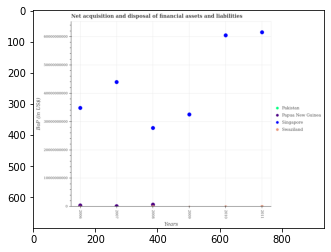

Number of QA =  27





,Years,Pakistan,Singapore,Swaziland,Papua New Guinea
0,2011,NaN,6.164362e+10,9.796802e+07,NaN
1,2010,NaN,6.053127e+10,NaN,5.852927e+07
2,2009,NaN,3.262907e+10,NaN,NaN
3,2006,NaN,3.491743e+10,NaN,4.528833e+08
4,2008,8.173002e+08,2.784983e+10,NaN,1.406131e+08
5,2007,NaN,4.402376e+10,NaN,2.574503e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in papua new guinea in 2006 and that in 2008 ?
PREDICTED =  312270138.5223741
EXPECTED =  -291821284.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in pakistan in 2006 and the balance of payments in swaziland in 2009?
PREDICTED =  -817300159.0952111
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the balance of payments in singapore and balance of payments in papua new guinea ?
PREDICTED =  61643619847.37018
EXPECTED =  34431328641.5




				 0 / 3 = 0.0


is_built

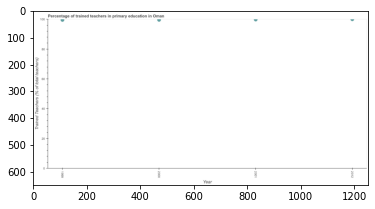

Number of QA =  24





,Year,Trained Teachers (% of total teachers)
0,1999,99.352127
1,2000,99.334986
2,2012,99.672769
3,2001,99.527289


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained teachers in 1999 and 2001 ?
PREDICTED =  -0.17516228946746537
EXPECTED =  -0.2561492919922159




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of trained teachers ?
PREDICTED =  2000.5
EXPECTED =  99.7082290649414




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of trained teachers in 1999 to that in 2012 ?
PREDICTED =  0.9967830530803833
EXPECTED =  0.9955719757080079




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

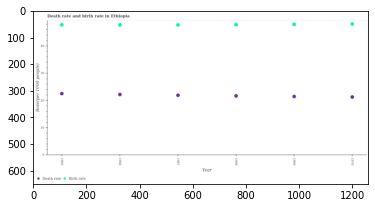

Number of QA =  27





,Year,Death rate,Birth rate
0,1965,22.726179,48.083798
1,1968,21.927133,48.177859
2,1969,21.709194,48.272121
3,1967,22.173053,48.119246
4,1966,22.440822,48.065126
5,1970,21.517585,48.426268


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in 1968 and that in 1970 ?
PREDICTED =  0.4095479809583793
EXPECTED =  0.40199999999999747




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate in 1969 and the death rate in 1967?
PREDICTED =  0.1528752848976609
EXPECTED =  26.006




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1968, what is the difference between the death rate and birth rate ?
PREDICTED =  0.0
EXPECTED =  -26.128999999999998




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training ste

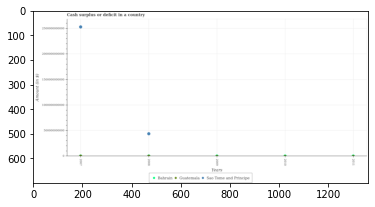

Number of QA =  21





,Years,Bahrain,Sao Tome and Principe,Guatemala
0,2010,7.027841e+09,NaN,NaN
1,2011,8.086514e+09,NaN,NaN
2,2008,NaN,4.455103e+11,1.049190e+10
3,2009,6.909305e+09,NaN,NaN
4,2007,NaN,2.544089e+12,8.977310e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of cash surplus or deficit in sao tome and principe in 2011 and the amount of cash surplus or deficit in bahrain in 2009?
PREDICTED =  1.0
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount of cash surplus or deficit in sao tome and principe and amount of cash surplus or deficit in bahrain ?
PREDICTED =  -8086513662.827892
EXPECTED =  2528682727983.967




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest amount of cash surplus or deficit in bahrain ?
PREDICTED =  6909304797.

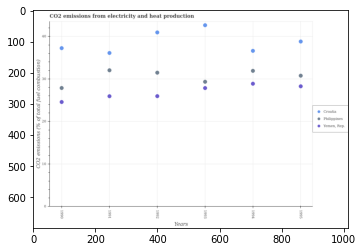

Number of QA =  28





,Years,Philippines,"Yemen, Rep.",Croatia
0,1994,31.942095,28.920499,36.621751
1,1990,27.915191,24.623461,37.225189
2,1991,32.064393,25.983791,36.109056
3,1992,31.507095,26.003004,40.935605
4,1993,29.365956,27.901275,42.636002
5,1995,30.789088,28.318689,38.810027


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in philippines in 1992 and that in 1993 ?
PREDICTED =  2.141138849309634
EXPECTED =  2.140253771205998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in croatia in 1993 and the amount of co2 emitted in yemen, rep. in 1991?
PREDICTED =  6.526946543850535
EXPECTED =  16.699720331314403




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the amount of co2 emitted in yemen, rep. and amount of co2 emitted in philippines ?
PREDICTED =  -177.5838186926301
EXPECTED =  -1.4814619890649006


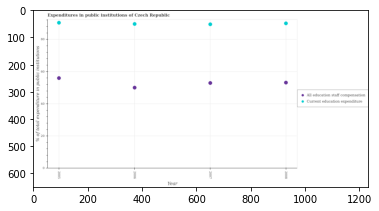

Number of QA =  27





,Year,Current education expenditure,All education staff compensatior
0,2007,89.007069,52.828668
1,2006,89.160258,49.928662
2,2005,89.957209,55.812681
3,2008,89.565979,53.045812


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in 2005 and that in 2007 ?
PREDICTED =  0.9501401046330216
EXPECTED =  3.0445404052735086




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in 2007 and the expenditure in education in 2008?
PREDICTED =  -0.5589098237817893
EXPECTED =  -37.03784179687501




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the expenditure in staff compensation and expenditure in education ?
PREDICTED =  0.0
EXPECTED =  -34.378128051757805




				 0 / 3 = 0.0


is_built_with_cud

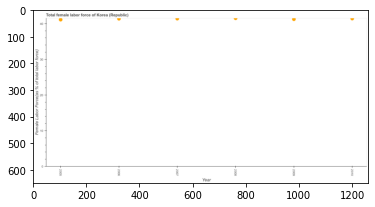

Number of QA =  24





,Year,Female Labor Force(as % of total labor force)
0,2009,41.375148
1,2006,41.524302
2,2007,41.526729
3,2010,41.558777
4,2005,41.248284
5,2008,41.633376


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total female labor force in 2007 and 2008 ?
PREDICTED =  -0.10664768830809379
EXPECTED =  -0.10811846226549449




				 1 / 1 = 1.0


> what is the median total female labor force ?
PREDICTED =  None
EXPECTED =  41.393754879529155




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total female labor force in 2007 to that in 2009 ?
PREDICTED =  1.003663572988274
EXPECTED =  1.0038717980732945




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest total female labor force ?
PREDICTED =  0.0
EXPECTED =  0.08611318243720234


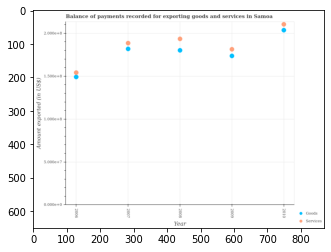

Number of QA =  27





,Year,Services,Goods
0,2009,1.819043,1.740682
1,2008,1.940870,1.806692
2,2007,1.889297,1.823511
3,2010,2.109210,2.041670
4,2006,1.546007,1.496611


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of services exported in 2006 and that in 2009 ?
PREDICTED =  -0.27303598577667687
EXPECTED =  -27226568.91600001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of services exported in 2006 and the amount of goods exported in 2008?
PREDICTED =  -0.3948623294825053
EXPECTED =  -26002528.63499999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the amount of services exported and amount of goods exported ?
PREDICTED =  0.0
EXPECTED =  7750891.281000018




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_ava

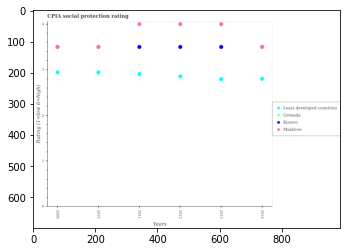

Number of QA =  29





,Years,Kosovo,Least developed countries,Maldives,Grenada
0,2014,NaN,2.818584,3.520120,NaN
1,2010,NaN,2.958394,3.521132,NaN
2,2012,3.521470,2.873903,4.020545,NaN
3,2011,3.519005,2.926299,4.021225,NaN
4,2009,NaN,2.960743,3.520617,NaN
5,2013,3.522925,2.812743,4.020055,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in kosovo in 2012 and that in 2013 ?
PREDICTED =  -0.0014544453215314945
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in grenada in 2013 and the cpia rating in least developed countries in 2010?
PREDICTED =  nan
EXPECTED =  0.5581395348837201




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the cpia rating in least developed countries and cpia rating in maldives ?
PREDICTED =  2.229384280461239
EXPECTED =  -1.09302325581395




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_a

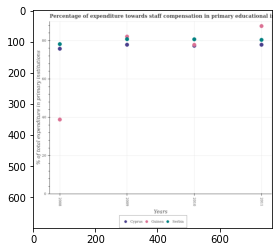

Number of QA =  28





,Years,Unnamed: 1,Serbia,Guinea
0,2008,76.170736,78.620267,39.185699
1,2009,78.289391,81.241284,82.596778
2,2011,78.286592,80.805263,88.046913
3,2010,NaN,81.097558,77.717343


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in cyprus in 2008 and that in 2009 ?
PREDICTED =  -2.1186549598309483
EXPECTED =  -2.0945663452148864




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in cyprus in 2010 and the percentage of expenditure towards staff compensation in serbia in 2008?
PREDICTED =  2.4772915659000034
EXPECTED =  -0.8604049682617898




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of expenditure towards staff compensation in 

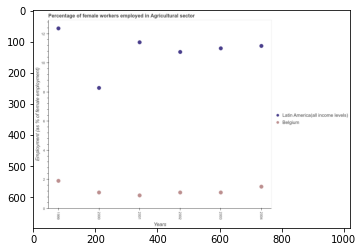

Number of QA =  27





,Years,Latin America(all income levels),Belgium
0,2000,8.343470,1.146266
1,2004,11.239759,1.550241
2,1999,12.444744,1.947653
3,2003,11.070590,1.148440
4,2001,11.493281,0.947030
5,2002,10.824439,1.148951


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in agricultural sector in belgium in 2000 and that in 2002 ?
PREDICTED =  -0.002685181266297132
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in agricultural sector in latin america(all income levels) in 2003 and the percentage of females employed in agricultural sector in belgium in 2000?
PREDICTED =  2.72711988505867
EXPECTED =  9.89778769592464




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of females employed in agricultur

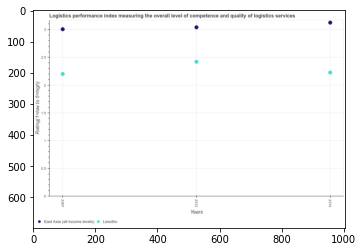

Number of QA =  27





,Years,Lesotho,East Asia (all income levels)
0,2012,2.438397,3.061652
1,2007,2.217921,3.025760
2,2014,2.243087,3.145801


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in lesotho in 2007 and that in 2012 ?
PREDICTED =  -0.22047657674530052
EXPECTED =  -0.21999999999999975




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in lesotho in 2014 and the logistic performance index in east asia (all income levels) in 2012?
PREDICTED =  -0.19530965301966408
EXPECTED =  -0.815191




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the logistic performance index in lesotho and logistic performance index in east asia (all income levels) ?
PREDICTED =

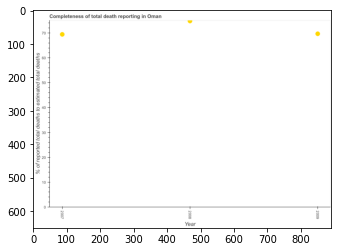

Number of QA =  24





,Year,% of reported total deaths to estimated total deaths
0,2008,75.175321
1,2007,69.804960
2,2009,70.066668


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completeness of total death reports in 2007 and 2008 ?
PREDICTED =  -5.370361166124027
EXPECTED =  -5.379432124369487




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median completeness of total death reports ?
PREDICTED =  2008.0
EXPECTED =  69.6838798350677




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the completeness of total death reports in 2008 to that in 2009 ?
PREDICTED =  75.1753213536646
EXPECTED =  1.073714417210577




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after traini

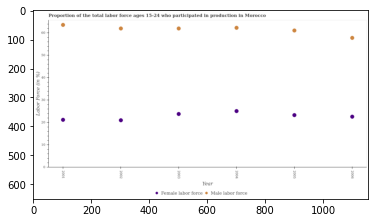

Number of QA =  27





,Year,Male labor force,Female labor force
0,2006,57.974282,22.785497
1,2005,61.238025,23.471877
2,2003,62.169262,23.969628
3,2001,63.742571,21.371995
4,2004,62.507694,25.270947
5,2002,62.131579,21.210185


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in 2001 and that in 2005 ?
PREDICTED =  -2.0998817444586138
EXPECTED =  -2.0999984741210014




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in 2006 and the percentage of male labour force in 2002?
PREDICTED =  1.5753113522101607
EXPECTED =  -39.39999961853031




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of male labour force and percentage of female labor force ?
PREDICTED =  0.0
EXPECTED =  38.200000762939496




				 1 / 3 = 0.3333


is_

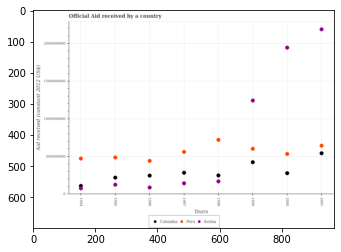

Number of QA =  28





,Years,Peru,Serbia,Colombia
0,2000,5.378517e+08,1.947860e+09,2.821444e+08
1,1998,7.255221e+08,1.748558e+08,2.522620e+08
2,1999,6.064103e+08,1.246569e+09,4.280041e+08
3,1997,5.655611e+08,1.486323e+08,2.879691e+08
4,1995,4.913022e+08,1.300110e+08,2.246333e+08
5,1996,4.464982e+08,9.305308e+07,2.505445e+08
6,1994,4.780658e+08,1.142696e+08,8.242567e+07
7,2001,6.477780e+08,2.190851e+09,5.456411e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid received in serbia in 1994 and that in 2001 ?
PREDICTED =  -2076581556.4084222
EXPECTED =  -2111230000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid received in colombia in 1995 and the net official aid received in peru in 1996?
PREDICTED =  -221864886.0169799
EXPECTED =  -222360000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the net official aid received in serbia and net official aid received in colombia ?
PREDICTED =  1704028514.2738833
EXPECTED =  1645690000.0




				 3 / 

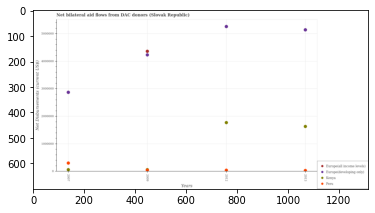

Number of QA =  29





,Years,Peru,Kenya,Europe(all income levels),Europe(developing only)
0,2013,42136.133253,1.636135e+06,NaN,5.137687e+06
1,2007,310435.157094,7.213414e+04,NaN,2.868031e+06
2,2009,64790.627699,NaN,4.357805e+06,4.230208e+06
3,2012,54227.629503,1.772772e+06,NaN,5.256244e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in kenya in 2007 and that in 2013 ?
PREDICTED =  -1564000.9460919737
EXPECTED =  -1570000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in europe(all income levels) in 2009 and the net bilateral aid flows in kenya in 2007?
PREDICTED =  4357804.679481673
EXPECTED =  4300000




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the net bilateral aid flows in europe(developing only) and net bilateral aid flows in europe(all income levels) ?
PREDICTED =  -2905203.1196544487
EXPECTE

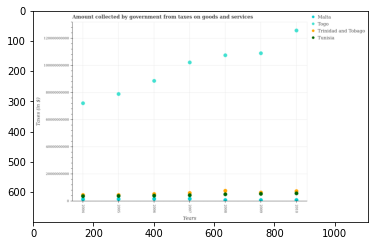

Number of QA =  29





,Years,Malta,Togo,Tunisia,Trinidad and Tobago
0,2004,1.605032e+09,7.252573e+10,4.039231e+09,NaN
1,2008,1.090999e+09,1.079153e+11,5.310578e+09,7.939614e+09
2,2006,1.882785e+09,8.902792e+10,5.611943e+09,4.512275e+09
3,2009,1.045078e+09,1.093559e+11,5.726196e+09,NaN
4,2010,1.088469e+09,1.261791e+11,6.139596e+09,7.746623e+09
5,2007,1.954373e+09,1.026569e+11,4.748962e+09,6.384681e+09
6,2005,1.774548e+09,7.929975e+10,4.555048e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by government from taxes on goods and services in trinidad and tobago in 2006 and that in 2008 ?
PREDICTED =  63460850992.93249
EXPECTED =  -2373900000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by government from taxes on goods and services in tunisia in 2006 and the amount collected by government from taxes on goods and services in malta in 2008?
PREDICTED =  64990218418.438705
EXPECTED =  3260966516.241496




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount collected by 

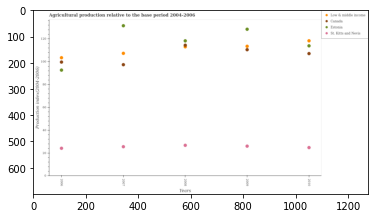

Number of QA =  29





,Years,Estonia,St. Kitts and Nevis,Low & middle income,Canada
0,2010,113.907777,25.028474,118.330897,107.208066
1,2006,92.675762,24.424588,103.504565,99.858079
2,2008,118.372005,27.030521,113.248069,114.365518
3,2007,131.581902,25.823057,107.381212,97.444378
4,2009,128.398770,26.267824,113.658169,110.537744


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the agricultural production index in st. kitts and nevis in 2008 and that in 2010 ?
PREDICTED =  2.0020463397415575
EXPECTED =  1.9899999999999984




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the agricultural production index in estonia in 2006 and the agricultural production index in canada in 2010?
PREDICTED =  -21.232014294322354
EXPECTED =  -14.469999999999999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the agricultural production index in low & middle income and agricultural production index in estonia ?
PREDICTED = 

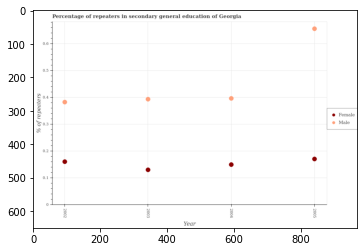

Number of QA =  27





,Year,Male,Female
0,2005,0.659192,0.173779
1,2002,0.385080,0.163118
2,2003,0.396089,0.132832
3,2004,0.399587,0.152187


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female repeaters in 2002 and that in 2003 ?
PREDICTED =  0.03028596100065986
EXPECTED =  0.030319988727568997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female repeaters in 2003 and the percentage of male repeaters in 2004?
PREDICTED =  -0.01935505899795245
EXPECTED =  -0.26613999903202




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of male repeaters and percentage of female repeaters ?
PREDICTED =  0.0
EXPECTED =  0.4853599965572349




				 1 / 3 = 0.3333


is_built_with

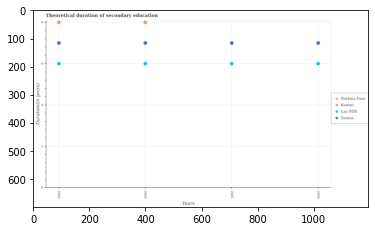

Number of QA =  29





,Years,Samoa,Lao PDR,Burkina Faso,Kuwait
0,2004,7.016922,6.017354,NaN,8.016211
1,2003,7.018795,6.018608,NaN,8.021802
2,2006,7.017757,6.016947,NaN,NaN
3,2005,7.015031,6.015933,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total theoretical duration of secondary education in kuwait in 2004 ?
PREDICTED =  2.0040526407863903
EXPECTED =  8




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum total theoretical duration of secondary education in samoa ?
PREDICTED =  1.7546986275324195
EXPECTED =  7




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum total theoretical duration of secondary education in samoa ?
PREDICTED =  501.25
EXPECTED =  7




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training 

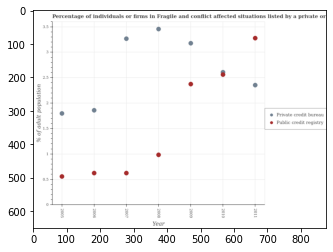

Number of QA =  27





,Year,Public credit registry,Private credit bureau
0,2010,2.595531,2.644871
1,2006,0.641211,1.888406
2,2008,1.004061,3.500665
3,2005,0.573867,1.825406
4,2007,0.641297,3.308988
5,2011,3.320221,2.387966
6,2009,2.406715,3.218850


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms listed by private credit bureau in 2007 and that in 2008 ?
PREDICTED =  -0.19167714414066772
EXPECTED =  -0.18965517241379004




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms listed by private credit bureau in 2007 and the percentage of firms listed by public credit bureau in 2009?
PREDICTED =  0.09013769826043072
EXPECTED =  0.8921839080459799




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of firms listed by private credit bureau and percentage of firms listed by pu

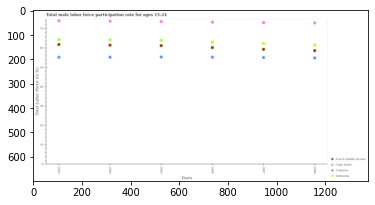

Number of QA =  29





,Years,Comoros,Low & middle income,Cabo Verde,Indonesia
0,2004,55.591954,61.797190,74.173916,64.515067
1,2006,55.578526,60.531924,73.678367,63.349373
2,2008,55.155394,58.907959,73.274963,61.827155
3,2003,55.522783,62.139905,74.360079,64.662341
4,2005,55.652891,61.553658,73.983799,64.317535
5,2007,55.394962,59.623691,73.502989,62.599958


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in cabo verde in 2004 and that in 2007 ?
PREDICTED =  0.6709276943611258
EXPECTED =  0.7000045776367045




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in indonesia in 2005 and the male labor force participation rate in comoros in 2007?
PREDICTED =  1.7175764220421925
EXPECTED =  8.9000015258789




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the male labor force participation rate in indonesia and male labor force participation rate in low & middle 

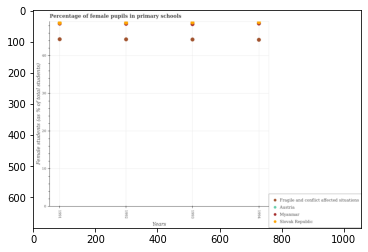

Number of QA =  29





,Years,Austria,Slovak Republic,Fragile and conflict affected situations,Myanmar
0,1993,48.863429,48.505117,44.415638,NaN
1,1992,NaN,48.707505,44.447028,NaN
2,1994,NaN,48.897586,44.334042,NaN
3,1991,NaN,48.763864,44.497204,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in primary schools in slovak republic in 1993 and that in 1994 ?
PREDICTED =  -0.3924694742254715
EXPECTED =  -0.05810999999999922




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in primary schools in fragile and conflict affected situations in 1991 and the percentage of female pupils in primary schools in slovak republic in 1992?
PREDICTED =  -44.52859325193293
EXPECTED =  -4.3879501660155995




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the percentage of female 

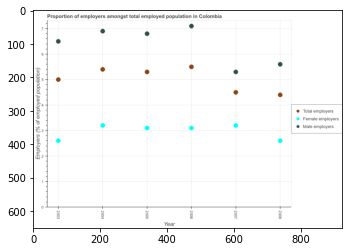

Number of QA =  28





,Year,Male employers,Total employers,Female employers
0,2006,7.126304,5.522607,3.127704
1,2004,6.923190,5.425694,3.223340
2,2005,6.820686,5.320836,3.125565
3,2008,5.624553,4.422394,2.623643
4,2007,5.323082,4.529027,3.221786
5,2003,6.523060,5.022646,2.624542


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male employers in 2003 and that in 2008 ?
PREDICTED =  0.898506323184848
EXPECTED =  0.900000095367429




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female employers in 2007 and the percentage of total employers in 2006?
PREDICTED =  0.09408207346447295
EXPECTED =  -2.29999995231628




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of total employers and percentage of male employers ?
PREDICTED =  0.0
EXPECTED =  -1.5




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_ava

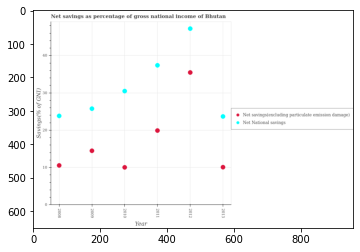

Number of QA =  27





,Year,Net National saving:,Net savings(excluding particulate emission damage)
0,2009,25.766281,14.524934
1,2011,37.310383,19.955180
2,2013,23.657870,10.183006
3,2008,23.828178,10.682934
4,2012,47.076062,35.398477
5,2010,30.455850,10.161645


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in 2008 and that in 2010 ?
PREDICTED =  -6.6276719355308416
EXPECTED =  -6.6540293525728025




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings(excluding particulate emission damage) in 2010 and the net national savings in 2013?
PREDICTED =  -0.02136138319963088
EXPECTED =  -13.642846200105799




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the net national savings and net savings(excluding particulate emission damage) ?
PREDICTED =  14.531407760430618
EXPECTED =  11.756403036689392




				 

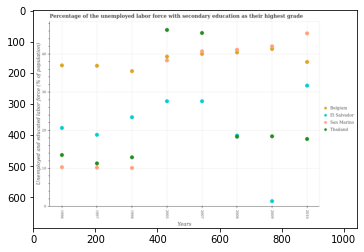

Number of QA =  29





,Years,Belgium,San Marino,Thailand,El] Salvador
0,1996,37.254187,10.442325,13.693120,20.804887
1,1997,37.156103,10.341604,11.489193,18.999225
2,1998,35.749375,10.273172,13.074102,23.608732
3,2008,40.680706,41.365030,18.492052,NaN
4,2010,38.177585,45.697563,17.897248,31.951177
5,2005,39.579545,38.574560,46.597559,27.826454
6,2007,40.287375,40.972923,45.787074,27.838299
7,2009,41.587830,42.268257,18.605837,1.546263


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with secondary education in thailand in 1997 and that in 2008 ?
PREDICTED =  -7.002859628372102
EXPECTED =  -6.9999990463256




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with secondary education in thailand in 1996 and the percentage of the unemployed labor force with secondary education in san marino in 2007?
PREDICTED =  -27.279803676114852
EXPECTED =  -27.200000762939503




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage o

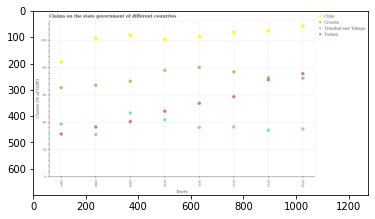

Number of QA =  29





,Years,Turkey,Trinidad and Tobago,Chile,Croatia
0,2009,40.552988,47.019944,103.730952,70.195870
1,2007,31.611310,39.062701,84.228521,65.516422
2,2008,36.761033,31.305997,101.644455,67.275066
3,2010,48.309410,42.110168,100.729644,78.232516
4,2014,75.749737,35.355395,110.594853,72.471611
5,2013,71.284703,34.376687,107.155769,72.766404
6,2012,58.907728,36.776770,105.946766,77.111800
7,2011,54.124616,36.395587,102.888252,80.320256


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gdp claimed on the state government in chile in 2011 and that in 2014 ?
PREDICTED =  -7.706601068151855
EXPECTED =  -7.704715511572999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gdp claimed on the state government in croatia in 2007 and the percentage of gdp claimed on the state government in trinidad and tobago in 2010?
PREDICTED =  -12.716094496246868
EXPECTED =  23.471093359056297




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of gdp claimed on the state government in c

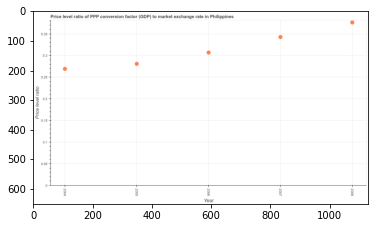

Number of QA =  24





,Year,Price level ratio
0,2006,0.312316
1,2008,0.382523
2,2004,0.274113
3,2005,0.285616
4,2007,0.348367


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the price level ratio in 2004 ?
PREDICTED =  0.05482264176458109
EXPECTED =  0.269175257399672




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum price level ratio ?
PREDICTED =  401.6
EXPECTED =  0.3763263904699361




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum price level ratio ?
PREDICTED =  400.8
EXPECTED =  0.269175257399672




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the price level ratio maximum ?
PREDICTED =  401.6
EXPE

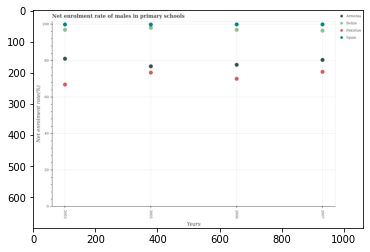

Number of QA =  29





,Years,Pakistan,Armenia,Spain,Belize
0,2005,73.784122,77.220211,100.071456,98.314824
1,2006,70.382803,78.062992,100.163773,97.246584
2,2007,74.170152,80.724630,100.208625,96.794863
3,2003,67.207829,81.383603,100.139862,97.348799


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of males in primary schools in spain in 2003 and that in 2006 ?
PREDICTED =  -0.023910829374813147
EXPECTED =  -0.03150939941409092




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of males in primary schools in belize in 2005 and the net enrolment rate of males in primary schools in armenia in 2007?
PREDICTED =  17.590193838557468
EXPECTED =  17.560295104980398




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the net enrolment rate of males in primary schools in belize and net enrolme

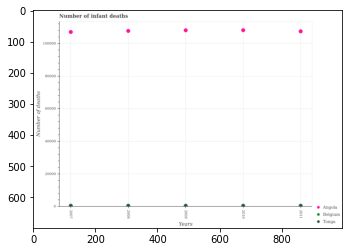

Number of QA =  28





,Years,Angola,Tonga,Belgium
0,2009,108138.795254,758.636128,NaN
1,2008,107730.545713,676.926383,NaN
2,2010,108165.692420,713.575949,NaN
3,2011,107462.597020,667.532787,NaN
4,2007,107035.001542,734.084816,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths in belgium in 2008 and that in 2010 ?
PREDICTED =  -1.0
EXPECTED =  18




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths in angola in 2011 and the number of infant deaths in tonga in 2007?
PREDICTED =  427.59547714338987
EXPECTED =  107398.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the number of infant deaths in angola and number of infant deaths in tonga ?
PREDICTED =  0.0
EXPECTED =  107662.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPU

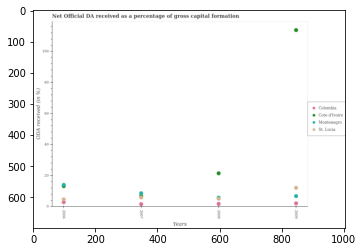

Number of QA =  29





,Years,Colombia,Montenegro,Cote d'Ivoire,St. Lucia
0,2006,3.146580,14.257351,NaN,4.822827
1,2008,2.039765,NaN,21.695912,6.136351
2,2009,2.377286,7.032315,113.766402,12.353210
3,2007,1.963911,8.755029,NaN,6.133516


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net oda received in colombia in 2007 and that in 2009 ?
PREDICTED =  -0.41337489805624816
EXPECTED =  -0.5058652789653302




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net oda received in cote d'ivoire in 2006 and the net oda received in colombia in 2008?
PREDICTED =  0.0
EXPECTED =  11.41212708710502




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the net oda received in st. lucia and net oda received in montenegro ?
PREDICTED =  -1.9041401551828052
EXPECTED =  -0.68114149439499




				 0 / 3 = 0.0


is_built_with_cu

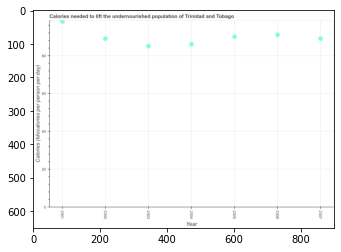

Number of QA =  24





,Year,Calories (kilocafories per person per day)
0,2002,90.245616
1,2006,92.271645
2,2005,91.235082
3,2003,86.193331
4,2004,87.195164
5,2001,99.356961
6,2007,90.240566


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the depth of food deficit in 2004 and 2007 ?
PREDICTED =  -3.04540174485642
EXPECTED =  -3




				 1 / 1 = 1.0


> what is the median depth of food deficit ?
PREDICTED =  None
EXPECTED =  89.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the depth of food deficit in 2001 to that in 2005 ?
PREDICTED =  1.0890214532815645
EXPECTED =  1.0888888888888888




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest depth of food deficit ?
PREDICTED =  8.121879559573955
EXPECTED =  7




				 2 / 5 = 0.4


is_built_with_cuda: True
is

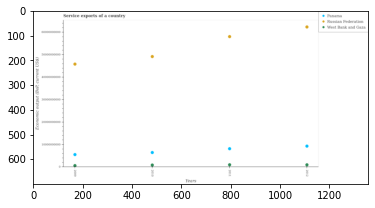

Number of QA =  28





,Years,Panama,Russian Federation,West Bank and Gaza
0,2012,9.409506e+09,6.239199e+10,1.116943e+09
1,2009,5.624043e+09,4.585804e+10,7.080543e+08
2,2011,8.252588e+09,5.809898e+10,1.131777e+09
3,2010,6.559185e+09,4.920369e+10,9.970937e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum service exports in russian federation ?
PREDICTED =  503.0
EXPECTED =  62340015000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the service exports in russian federation minimum?
PREDICTED =  502.25
EXPECTED =  2009




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total service exports in russian federation in the graph ?
PREDICTED =  1.0
EXPECTED =  215334534700




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service exports 

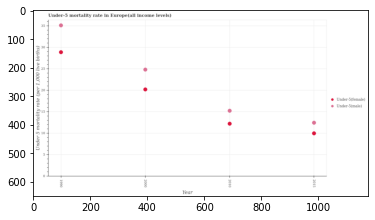

Number of QA =  27





,Year,Under-5(male),Under-5(female}
0,1990,35.193059,28.963000
1,2015,12.554597,10.065118
2,2010,15.335606,12.340039
3,2000,24.912247,20.288580


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 female mortality rate in 2000 and that in 2015 ?
PREDICTED =  10.223461718270189
EXPECTED =  10.2296130929254




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 male mortality rate in 2010 and the under-5 female mortality rate in 2015?
PREDICTED =  2.781009059879219
EXPECTED =  5.265101027950289




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the under-5 male mortality rate and under-5 female mortality rate ?
PREDICTED =  0.0
EXPECTED =  6.250366239314289




				 1 / 3 = 0.3333


is_built_with_cuda: True
is

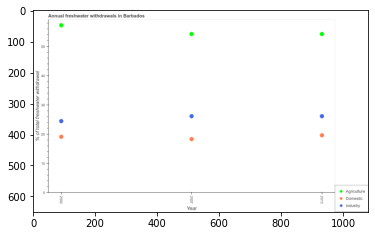

Number of QA =  28





,Year,Domestic,Agriculture,Industry
0,2013,19.773328,54.403887,26.282719
1,2007,18.464965,54.413181,26.288061
2,2002,19.267266,57.391708,24.588134


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of freshwater withdrawal for domestic purposes in 2002 and that in 2007 ?
PREDICTED =  0.8023013677400463
EXPECTED =  0.8100000000000023




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of freshwater withdrawal for agriculture in 2007 and the percentage of freshwater withdrawal for domestic purposes in 2002?
PREDICTED =  -2.978527049427676
EXPECTED =  35.16




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of freshwater withdrawal for industry and percentage of freshwater withdrawal for 

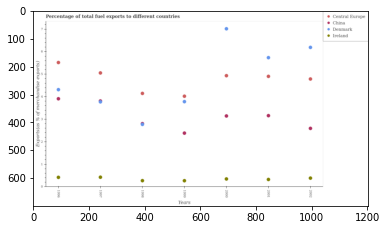

Number of QA =  29





,Years,Denmark,Central Europe,China,Ireland
0,1998,2.820857,4.199489,NaN,0.288908
1,1999,3.826263,4.074036,2.420095,0.287853
2,1997,3.818568,5.115066,NaN,0.446456
3,1996,4.363179,5.581501,3.956348,0.438708
4,2000,7.096641,4.993747,3.190357,0.367659
5,2001,5.801289,4.965174,3.203592,0.342018
6,2002,6.261559,4.845693,2.634566,0.405747


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in central europe in 1997 and the percentage of exports to different countries in ireland in 2000?
PREDICTED =  0.12131978391970932
EXPECTED =  4.7089374913188164




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of exports to different countries in denmark and percentage of exports to different countries in central europe ?
PREDICTED =  -1997.0
EXPECTED =  -0.24132858655279943




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: 

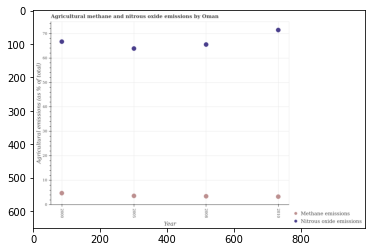

Number of QA =  27





,Year,Methane emissions,Nitrous oxide emissions
0,2010,3.540028,71.398681
1,2000,4.977684,66.648555
2,2005,3.872415,63.840809
3,2008,3.730809,65.499153


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emissions in 2000 and that in 2008 ?
PREDICTED =  1.14940192578527
EXPECTED =  1.1755658097121966




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emissions in 2005 and the amount of methane emissions in 2008?
PREDICTED =  -1.6583439797210673
EXPECTED =  60.35465335112849




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount of methane emissions and amount of nitrous oxide emissions ?
PREDICTED =  12.580907901161021
EXPECTED =  -60.19804694371106




				 1 / 3 = 0.3333

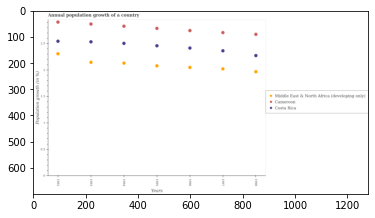

Number of QA =  28





,Years,Middle East & North Africa (developing only),Costa Rica,Cameroon
0,1994,2.127898,2.498617,2.823058
1,1996,2.045753,2.411338,2.739654
2,1998,1.965569,2.269203,2.669279
3,1992,2.302555,2.537488,2.898289
4,1993,2.140825,2.528526,2.860039
5,1995,2.076661,2.454222,2.780413
6,1997,2.020875,2.360573,2.701956


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual population growth in costa rica in 1996 and that in 1998 ?
PREDICTED =  0.1421348232385875
EXPECTED =  0.14224853508234991




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual population growth in middle east & north africa (developing only) in 1993 and the annual population growth in cameroon in 1998?
PREDICTED =  0.1752562764378669
EXPECTED =  -0.5296148588610801




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the annual population growth in middle east & north africa (developing only) and annual population gr

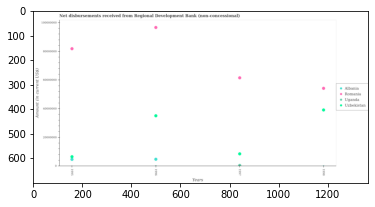

Number of QA =  27





,Years,Uganda,Uzbekistan,Romania,Albania
0,1997,670534.721478,8.794726e+06,6.167771e+07,NaN
1,1998,NaN,3.929934e+07,5.434657e+07,NaN
2,1996,NaN,3.531486e+07,9.667689e+07,5.027969e+06
3,1995,NaN,6.712475e+06,8.191002e+07,4.952976e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in romania in 1997 and that in 1998 ?
PREDICTED =  7331135.445464909
EXPECTED =  7333000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in albania in 1998 and the amount of disbursements received from regional development bank in uganda in 1997?
PREDICTED =  1.0
EXPECTED =  -406000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the amount of disbursements received from regional development b

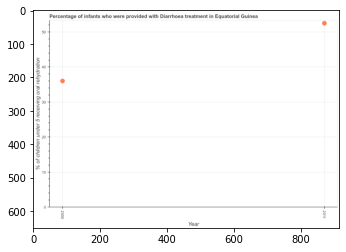

Number of QA =  20





,Year,% of children under 5 receiving oral rehydration
0,2011,52.850820
1,2000,36.296511


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who were provided with treatment diarrhoea in 2000 and 2011 ?
PREDICTED =  -16.554309117301962
EXPECTED =  -16.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of children who were provided with treatment diarrhoea ?
PREDICTED =  2005.5
EXPECTED =  44.25




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of children who were provided with treatment diarrhoea in 2000 to that in 2011 ?
PREDICTED =  0.6867728977697066
EXPECTED =  0.6857142857142857




				 2 / 3 = 0.6667


> what is the difference between two consecutiv

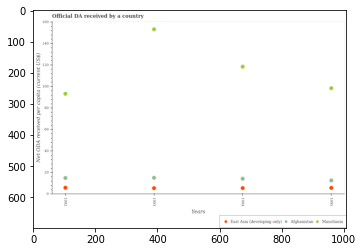

Number of QA =  28





,Years,East Asia (developing only),Afghanistan,Mauritania
0,1995,6.193746,13.167432,98.786473
1,1992,6.394488,15.423089,93.621309
2,1993,5.902700,15.618632,153.463247
3,1994,5.953748,14.760699,118.778769


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in in afghanistan in 1992 and that in 1995 ?
PREDICTED =  2.2556564589063264
EXPECTED =  2.2352353668813




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in in mauritania in 1992 and the oda received in in afghanistan in 1994?
PREDICTED =  -25.15745977296112
EXPECTED =  79.00227743514411




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the oda received in in east asia (developing only) and oda received in in afghanistan ?
PREDICTED =  5.902699843878153
EXPECTED =  -8.730370085052051




				 1 / 3

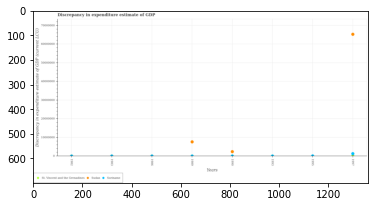

Number of QA =  25





,Years,Sudan,St. Vincent and the Grenadines,Suriname
0,1993,NaN,NaN,249814.482426
1,1989,7.860376e+06,NaN,260319.368157
2,1986,NaN,NaN,251372.720705
3,1995,NaN,NaN,299458.407943
4,1983,NaN,NaN,233520.110873
5,1997,6.585948e+07,1.431663e+06,341713.924286
6,1990,2.576301e+06,NaN,263960.682149
7,1982,NaN,NaN,270803.911351


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in st. vincent and the grenadines in 1990 and that in 1997 ?
PREDICTED =  0.0
EXPECTED =  -4.499999999999999e-08




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in sudan in 1993 and the discrepancy in expenditure estimate of gdp in suriname in 1990?
PREDICTED =  1.0
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1986, what is the difference between the discrepancy in expenditure estimate of gdp in st. vincent and the grenadines and discrepancy in expenditure

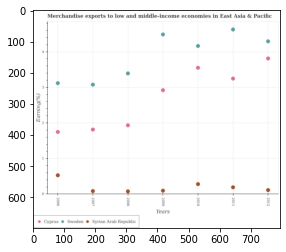

Number of QA =  28





,Years,Syrian Arab Republic,Sweden,Cyprus
0,2009,0.104243,4.501857,2.934853
1,2008,0.089912,3.406993,1.945336
2,2006,0.538518,3.132415,1.757827
3,2010,0.291791,4.177338,3.563980
4,2007,0.097956,3.089172,1.825623
5,2011,0.201620,4.642653,3.261354
6,2012,0.122105,4.310511,3.827033


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in cyprus in 2009 and that in 2012 ?
PREDICTED =  -0.8921799894401325
EXPECTED =  -0.8921668010845503




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in cyprus in 2011 and the percentage of amount earned from merchandise exports in sweden in 2009?
PREDICTED =  -1.2405027715973551
EXPECTED =  -1.2402292670823396




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of amount earned from merchandise exports in

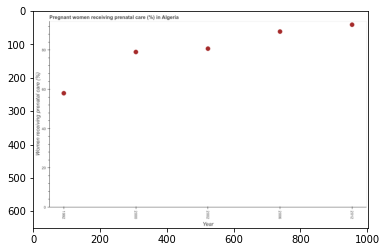

Number of QA =  24





,Year,Women receiving prenatal care (%)
0,1992,58.227682
1,2000,79.118038
2,2012,93.020336
3,2006,89.506946
4,2002,80.823571


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant women receiving prenatal care in 1992 and 2000 ?
PREDICTED =  -20.890355350571788
EXPECTED =  -21.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of pregnant women receiving prenatal care ?
PREDICTED =  2002.0
EXPECTED =  80.7




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of pregnant women receiving prenatal care in 2006 to that in 2012 ?
PREDICTED =  0.9622298717380858
EXPECTED =  0.9623250807319699




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Ev

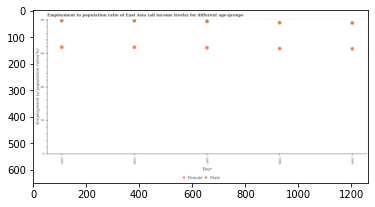

Number of QA =  27





,Year,Male,Female
0,1995,79.673311,63.956047
1,1996,79.569136,63.825587
2,1998,78.482499,63.035037
3,1997,79.237643,63.565462
4,1999,78.353271,62.912259


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio(female) in 1995 ?
PREDICTED =  1.2251112353287539
EXPECTED =  63.7323482782978




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio(male) ?
PREDICTED =  25.08995757196497
EXPECTED =  79.5214952601892




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio(male) ?
PREDICTED =  25.512655206092365
EXPECTED =  78.15708885010679




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.


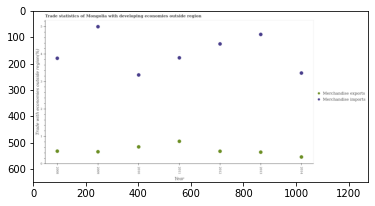

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,2008,3.866255,0.477676
1,2012,4.396942,0.475778
2,2011,3.887582,0.838039
3,2014,3.330891,0.265024
4,2013,4.739347,0.439791
5,2009,5.023913,0.457302
6,2010,3.261388,0.633584


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 2008 and that in 2014 ?
PREDICTED =  0.5353640275636682
EXPECTED =  0.5383338467546199




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 2013 and the merchandise exports in 2008?
PREDICTED =  0.8730919555109402
EXPECTED =  4.25444696890163




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the merchandise imports and merchandise exports ?
PREDICTED =  23.254514809882288
EXPECTED =  3.043528682972993




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: [

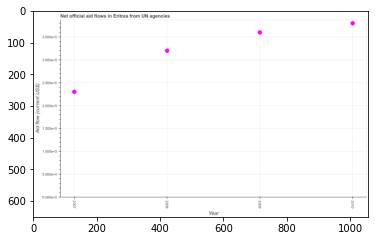

Number of QA =  24





,Year,Aid flow (current US$)
0,2007,2.305973
1,2009,3.601434
2,2010,3.799202
3,2008,3.201157


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official flows from un agencies in 2008 and 2009 ?
PREDICTED =  -0.40027748033449884
EXPECTED =  -40000




				 0 / 1 = 0.0


> what is the median net official flows from un agencies ?
PREDICTED =  None
EXPECTED =  340000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net official flows from un agencies in 2007 to that in 2009 ?
PREDICTED =  0.6402930116010364
EXPECTED =  0.6388888888888888




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest net official flows from un agencies ?
PREDICTED =  0.0
EXPECTED =  2

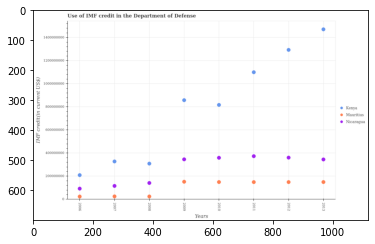

Number of QA =  28





,Years,Nicaragua,Mauritius,Kenya
0,2006,9.605440e+07,2.706393e+07,2.119602e+08
1,2008,1.446364e+08,2.843750e+07,3.125017e+08
2,2011,3.759478e+08,1.524031e+08,1.103128e+09
3,2007,1.192100e+08,2.922634e+07,3.314294e+08
4,2012,3.645843e+08,1.531295e+08,1.297568e+09
5,2009,3.499358e+08,1.553565e+08,8.621848e+08
6,2013,3.487512e+08,1.532637e+08,1.474672e+09
7,2010,3.633844e+08,1.531174e+08,8.207158e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imf credit in the department of defense in nicaragua in 2006 and that in 2009 ?
PREDICTED =  -253881451.9973591
EXPECTED =  -253390285.2




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imf credit in the department of defense in kenya in 2012 and the imf credit in the department of defense in nicaragua in 2009?
PREDICTED =  947632030.688764
EXPECTED =  947418882.8




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the imf credit in the department of defense in kenya and imf credit in the department of defense in nicaragua ?


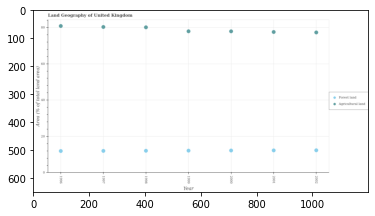

Number of QA =  27





,Year,Agricultural land,Forest land
0,1999,77.878649,12.314921
1,1996,80.830942,12.136190
2,1997,80.249124,12.219502
3,1998,80.047814,12.244034
4,2002,77.251915,12.501241
5,2001,77.515539,12.464376
6,2000,77.847915,12.360455


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under agriculture in 1997 and that in 1999 ?
PREDICTED =  2.3704750182700423
EXPECTED =  2.3849873930476093




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under forests in 2002 and the percentage of land area under agriculture in 1996?
PREDICTED =  0.3650505641229813
EXPECTED =  -68.50411275988921




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the percentage of land area under agriculture and percentage of land area under forests ?
PREDICTED =  65.1157250629823
EXPECTED =

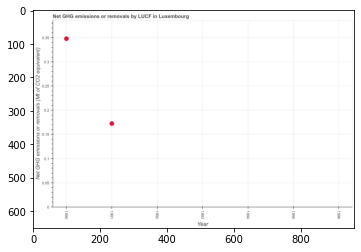

Number of QA =  18





,Year,Net GHG emissions or removals (Mt of CO2 equivalent)
0,1992,NaN
1,1995,NaN
2,1990,0.350152
3,1996,NaN
4,1993,NaN
5,1994,NaN
6,1991,0.174333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ghg net emissions or removals in 1990 and 1991 ?
PREDICTED =  0.17581937350502358
EXPECTED =  0.1753214132735661




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median ghg net emissions or removals ?
PREDICTED =  0.2622426777104725
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest ghg net emissions or removals ?
PREDICTED =  -0.3501523644629843
EXPECTED =  0.3477497855414911




				 1 / 3 = 0.3333


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Net GHG emissions or removals (M

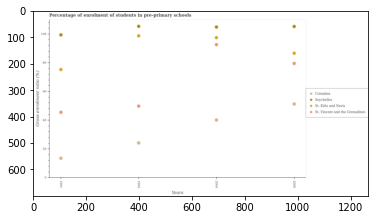

Number of QA =  29





,Years,St. Vincent and the Grenadines,St. Kitts and Nevis,Colombia,Seychelles
0,1994,50.166538,99.110320,24.437782,105.752054
1,1991,45.876732,75.660787,13.835842,99.795462
2,2004,93.018742,97.888202,40.458132,105.271138
3,2009,79.960255,87.112920,51.657980,105.691905


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of students enrolled in pre-primary schools in st. kitts and nevis in 1991 and the percentage of students enrolled in pre-primary schools in seychelles in 2004?
PREDICTED =  186.2232404073502
EXPECTED =  -29.602219692382974




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of students enrolled in pre-primary schools in st. kitts and nevis in 1991 to that in 2004?
P

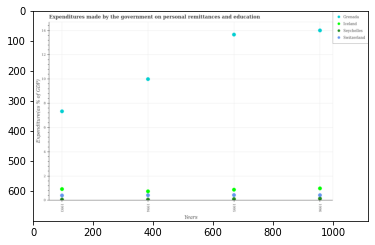

Number of QA =  29





,Years,Seychelles,Grenada,Switzerland,Iceland
0,1994,0.102972,10.141421,0.473244,0.788009
1,1995,0.139827,13.857327,0.494051,0.934822
2,1996,0.176543,14.204243,0.477597,1.032724
3,1993,0.107576,7.452152,0.458778,0.978872


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in seychelles in 1993 and that in 1995 ?
PREDICTED =  3.860172628921839
EXPECTED =  -0.03808341806169021




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in grenada in 1993 and the expenditures made by the government on personal remittances and education in switzerland in 1995?
PREDICTED =  -9.857327156991706
EXPECTED =  6.905035049701533




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the differenc

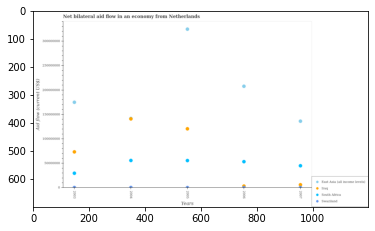

Number of QA =  29





,Years,Swaziland,Iraq,South Africa,East Asia (all income levels.
0,2006,4.072947e+06,1.286927e+06,5.399606e+07,2.088346e+08
1,2005,1.048687e+06,1.215107e+08,5.634841e+07,3.260368e+08
2,2007,1.313244e+06,6.576984e+06,4.584289e+07,1.371714e+08
3,2004,1.169701e+06,1.419501e+08,5.651310e+07,NaN
4,2003,1.215129e+06,7.391077e+07,3.030219e+07,1.756800e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in iraq in 2003 and that in 2007 ?
PREDICTED =  67333787.907133
EXPECTED =  67330000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in iraq in 2004 and the net bilateral aid flow in swaziland in 2005?
PREDICTED =  20439331.141817734
EXPECTED =  140720000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the net bilateral aid flow in swaziland and net bilateral aid flow in east asia (all income levels) ?
PREDICTED =  8819703.720384866
EXPECTED =  -324450000.0




				 1 / 3

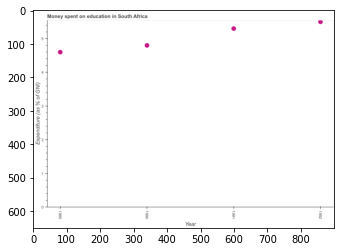

Number of QA =  24





,Year,Expenditure (as % of GNI)
0,1989,4.634030
1,1990,4.834768
2,1991,5.335126
3,1992,5.536397


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on education in 1989 and 1992 ?
PREDICTED =  -0.9023670044926133
EXPECTED =  -0.8999999999999702




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median expenditure on education ?
PREDICTED =  5.084946850725482
EXPECTED =  5.05




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the expenditure on education in 1989 to that in 1992 ?
PREDICTED =  0.8370118709479601
EXPECTED =  0.8363636363636409




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the di

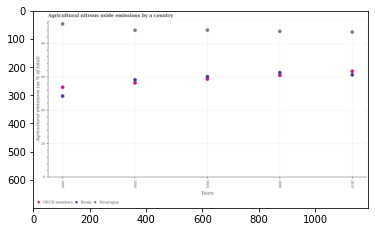

Number of QA =  28





,Years,Nicaragua,Benin,OECD members
0,1990,92.091473,48.796334,54.138916
1,2000,88.318669,58.606297,56.773554
2,2010,87.286452,61.549553,63.746511
3,2008,87.650561,62.884966,61.275185
4,2005,88.391497,60.465463,59.061194


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural nitrous oxide emitted in nicaragua in 2000 and that in 2008 ?
PREDICTED =  0.6681080580431171
EXPECTED =  0.6390094843893479




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural nitrous oxide emitted in benin in 2000 and the amount of agricultural nitrous oxide emitted in oecd members in 2010?
PREDICTED =  -2.9432558218954554
EXPECTED =  -5.124867456634213




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the amount of agricultural nitrous oxide emitted in nicaragua and amount of ag

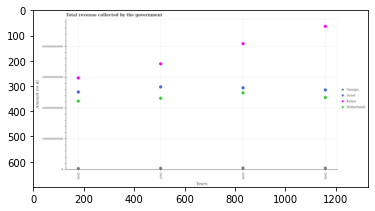

Number of QA =  29





,Years,Israel,Kenya,Netherlands,Georgia
0,2006,2.543277e+11,3.010554e+11,2.244844e+11,4.450603e+09
1,2008,2.682032e+11,4.123087e+11,2.517845e+11,6.172289e+09
2,2007,2.713838e+11,3.466479e+11,2.345617e+11,5.298745e+09
3,2009,2.613389e+11,4.690179e+11,2.365804e+11,5.640814e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue collected by the government in israel in 2006 and that in 2008 ?
PREDICTED =  -13875585395.533142
EXPECTED =  -13685211882.656097




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue collected by the government in netherlands in 2006 and the total revenue collected by the government in kenya in 2008?
PREDICTED =  -27300085082.57672
EXPECTED =  -186824789159.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the total revenue collected by the government in netherlands and total revenue collected by t

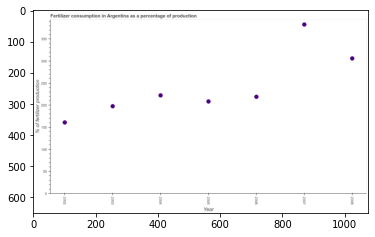

Number of QA =  24





,Year,% of fertilizer production
0,2006,219.382038
1,2005,208.758454
2,2003,198.151180
3,2008,306.027217
4,2002,161.774404
5,2004,222.492046
6,2007,382.642790


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in 2002 and 2008 ?
PREDICTED =  -144.25281359813886
EXPECTED =  -145.02905907731397




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of fertilizer consumption ?
PREDICTED =  219.38203755664276
EXPECTED =  218.98272683826




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of fertilizer consumption in 2004 to that in 2008 ?
PREDICTED =  0.7270335226297938
EXPECTED =  0.726247799984662




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tra

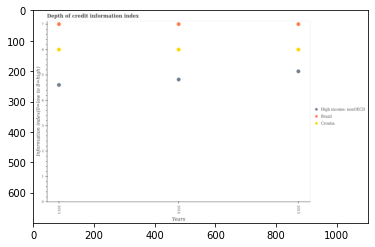

Number of QA =  28





,Years,Croatia,High income: nonOECD,Brazil
0,2014,5.962136,4.793964,6.953127
1,2015,5.964807,5.114733,6.953684
2,2013,5.965221,4.580559,6.950426


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the information index in high income: nonoecd in 2014 and that in 2015 ?
PREDICTED =  -0.3207690207983642
EXPECTED =  -0.3214285714285694




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the information index in croatia in 2015 and the information index in high income: nonoecd in 2013?
PREDICTED =  -0.00041353094073226515
EXPECTED =  1.3928571428571397




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the information index in croatia and information index in brazil ?
PREDICTED =  14.89216494521768
EXPECTED =  -1




				 1 / 3 = 0.

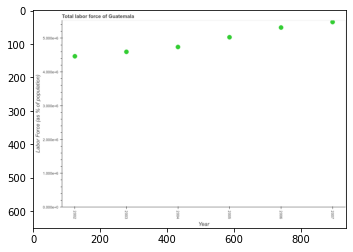

Number of QA =  24





,Year,Labor Force (as % of population)
0,2002,4.475795
1,2005,5.037311
2,2004,4.747237
3,2006,5.321753
4,2007,5.481092
5,2003,4.603200


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total labor force in 2002 and 2004 ?
PREDICTED =  -0.271441656996962
EXPECTED =  -274279




				 0 / 1 = 0.0


> what is the median total labor force ?
PREDICTED =  None
EXPECTED =  4882594.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total labor force in 2004 to that in 2005 ?
PREDICTED =  0.9424148592413986
EXPECTED =  0.9425696805056909




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest total labor force ?
PREDICTED =  -5.179532024202927
EXPECTED =  162477




				 1 / 5 = 0.2


is_built_with_cuda: True
is_

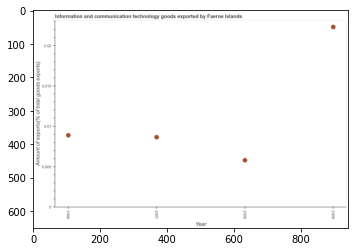

Number of QA =  24





,Year,Amount of exports(% of total goods exports)
0,2006,0.009043
1,2008,0.005926
2,2007,0.008811
3,2009,0.022564


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of ict goods exports in 2006 and 2008 ?
PREDICTED =  0.0031177845044631936
EXPECTED =  0.0030884003000000012




				 1 / 1 = 1.0


> what is the median amount of ict goods exports ?
PREDICTED =  None
EXPECTED =  0.00876856175




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of ict goods exports in 2006 to that in 2007 ?
PREDICTED =  1.0264153559799574
EXPECTED =  1.027567943193813




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest amount of ict goods exports ?
PREDICTED =  0.0
EXPECTED =  0.013420765

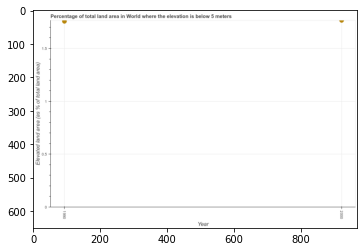

Number of QA =  20





,Year,Elevated land area (as % of total land area)
0,2000,1.768034
1,1990,1.760048


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total elevated land area in 1990 and 2000 ?
PREDICTED =  -0.007986200497053675
EXPECTED =  -0.00891424830373011




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total elevated land area ?
PREDICTED =  1995.0
EXPECTED =  1.760506101156745




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total elevated land area in 1990 to that in 2000 ?
PREDICTED =  0.9954830063537402
EXPECTED =  0.9949493291554721




				 1 / 3 = 0.3333


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Elevated land area (as % of total land area)
EXPECT

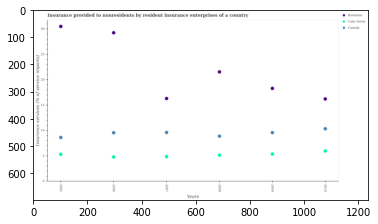

Number of QA =  28





,Years,Barbados,Canada,Cabo Verde
0,2008,21.502176,8.921695,5.198317
1,2009,18.295772,9.618426,5.426020
2,2006,29.167291,9.590371,4.857489
3,2005,30.417534,8.659463,5.354882
4,2010,16.210838,10.374692,6.017800
5,2007,16.295792,9.641099,4.914111


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to nonresidents in barbados in 2007 and that in 2009 ?
PREDICTED =  -1.9999803273388785
EXPECTED =  -1.9969586934149994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to nonresidents in barbados in 2009 and the insurance provided to nonresidents in canada in 2010?
PREDICTED =  2.0849337736088422
EXPECTED =  7.9504964653561




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the insurance provided to nonresidents in cabo verde and insurance provided to nonresidents in canada ?
PREDICTED 

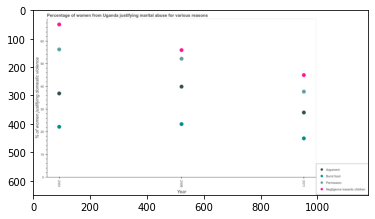

Number of QA =  29





,Year,Burnt food,Negligence towards children,Argument,Permission
0,2001,22.665230,68.107046,37.436809,57.023904
1,2006,23.838238,56.715348,40.475979,52.909621
2,2011,17.501448,45.636434,29.005295,38.256099


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying abuse for showing negligence towards children in 2001 and that in 2011 ?
PREDICTED =  22.47061278873774
EXPECTED =  22.299999999999997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying abuse for going without permission in 2001 and the percentage of women justifying abuse for burning food in 2006?
PREDICTED =  -17.50144804870191
EXPECTED =  32.9




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the percentage of women justifying abuse for going without permission 

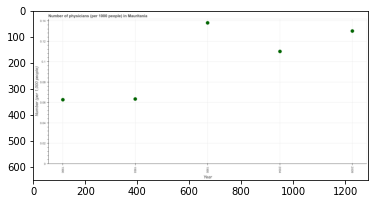

Number of QA =  24





,Year,"Number (per 1,000 people)"
0,2009,0.130080
1,1990,0.062964
2,2004,0.110141
3,1993,0.063668
4,1995,0.138018


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of physicians in 1993 and 2009 ?
PREDICTED =  -0.0664124106536883
EXPECTED =  -0.0665999997




				 1 / 1 = 1.0


> what is the median number of physicians ?
PREDICTED =  None
EXPECTED =  0.11




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of physicians in 1990 to that in 2009 ?
PREDICTED =  0.4840355343977772
EXPECTED =  0.4823077184615384




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest number of physicians ?
PREDICTED =  0.007937324820454034
EXPECTED =  0.008000000000000007




				 3 / 5 = 0.

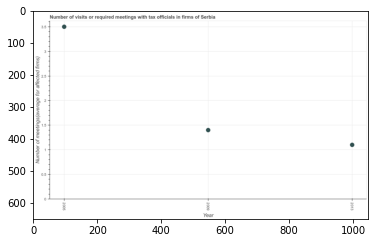

Number of QA =  24





,Year,Number of meetings(average for affected firms)
0,2009,1.415918
1,2013,1.115103
2,2005,3.514559


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of required meetings with tax officials in 2009 and 2013 ?
PREDICTED =  0.300814463509697
EXPECTED =  0.2999999999999998




				 1 / 1 = 1.0


> what is the median number of required meetings with tax officials ?
PREDICTED =  None
EXPECTED =  1.4




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of required meetings with tax officials in 2005 to that in 2013 ?
PREDICTED =  3.1517791371435244
EXPECTED =  3.1818181818181817




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest number of required meetings w

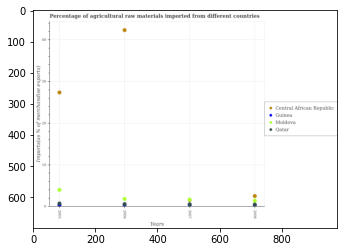

Number of QA =  29





,Years,Central African Republic,Moldova,Guinea,Qatar
0,2006,42.354062,1.931285,NaN,0.651263
1,2005,27.426490,4.116025,0.841617,0.519656
2,2007,NaN,1.747203,NaN,0.616330
3,2008,2.633838,1.509758,0.544257,0.195287


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in central african republic in 2006 and that in 2008 ?
PREDICTED =  39.72022414313793
EXPECTED =  39.80905400894273




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in guinea in 2006 and the percentage of imports to different countries in qatar in 2007?
PREDICTED =  nan
EXPECTED =  -0.12032398403239403




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of imports to different countries in guinea and percentage of imports 

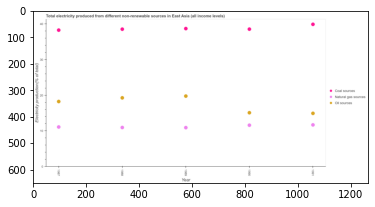

Number of QA =  28





,Year,Oil sources,Coal sources,Natural gas sources
0,1990,15.184817,38.571244,11.698052
1,1991,14.991814,39.929228,11.784768
2,1988,19.339921,38.570231,11.058856
3,1987,18.322364,38.305731,11.185405
4,1989,19.831837,38.742392,11.019355


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by natural gas in 1987 and that in 1989 ?
PREDICTED =  0.16604910844176857
EXPECTED =  0.18074135445339934




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by natural gas in 1989 and the percentage of electricity produced by coal in 1990?
PREDICTED =  -0.6786969106341303
EXPECTED =  -27.6468548951212




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wh

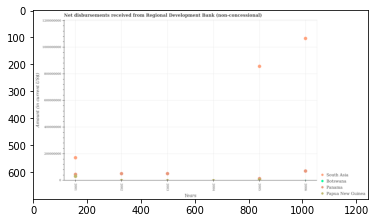

Number of QA =  27





,Years,Botswana,South Asia,Panama,Papua New Guinea
0,2004,1.768591e+06,NaN,NaN,NaN
1,2006,NaN,1.075503e+09,7.353348e+07,NaN
2,2003,NaN,NaN,5.374549e+07,1.437358e+06
3,2002,NaN,2.746159e+06,5.368128e+07,NaN
4,2001,NaN,1.738166e+08,4.858422e+07,3.371161e+07
5,2005,NaN,8.654621e+08,NaN,1.520926e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in panama in 2001 and that in 2003 ?
PREDICTED =  -5161272.1392887905
EXPECTED =  -5687000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in papua new guinea in 2006 and the amount of disbursements received from regional development bank in botswana in 2001?
PREDICTED =  50358228.98213048
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount of disbursements received from reg

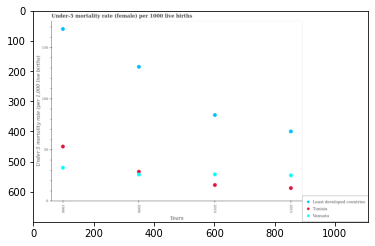

Number of QA =  28





,Years,Least developed countries,Vanuatu,Tunisia
0,1990,168.427830,33.061926,53.675586
1,2000,131.533293,26.258842,29.307583
2,2010,84.486177,26.589081,16.203850
3,2015,68.510379,25.734367,13.147314


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in tunisia in 2000 and that in 2015 ?
PREDICTED =  16.160268449219423
EXPECTED =  16.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in vanuatu in 2000 and the under-five mortality rate in tunisia in 1990?
PREDICTED =  -1988.7411582668708
EXPECTED =  -27.4




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the under-five mortality rate in vanuatu and under-five mortality rate in tunisia ?
PREDICTED =  2001.8526855860146
EXPECTED =  10.400000000000002




				 1 / 3 = 0.3

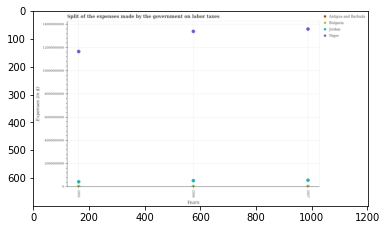

Number of QA =  28





,Years,Niger,Bulgaria,Jordan,Antigua and Barbuda
0,2005,1.157555e+10,4.974053e+07,4.678093e+08,NaN
1,2007,1.349016e+10,5.498630e+07,5.913120e+08,NaN
2,2006,1.328620e+10,5.372708e+07,5.547200e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenses made by the government on labor taxes in jordan in 2005 and that in 2006 ?
PREDICTED =  -86910648.91507095
EXPECTED =  -97380000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenses made by the government on labor taxes in antigua and barbuda in 2006 and the expenses made by the government on labor taxes in bulgaria in 2007?
PREDICTED =  -54356692.72060618
EXPECTED =  11300000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the expenses made by the government on labor taxes in antigua and barbuda and exp

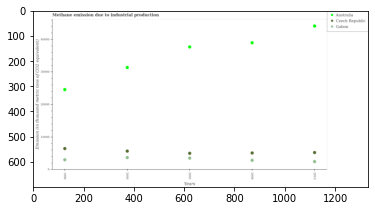

Number of QA =  28





,Years,Australia,Gabon,Czech Republic
0,1990,24815.979244,3109.127507,6589.631046
1,2005,37958.517509,3621.797614,5118.878419
2,2000,31617.069340,3799.654630,5796.496489
3,2008,39302.336667,2971.890154,5224.555804
4,2010,44423.672776,2555.003510,5374.883357


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in gabon in 2000 and that in 2010 ?
PREDICTED =  1244.6511206636615
EXPECTED =  1236.2999999999997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in australia in 2000 and the amount of methane emitted in czech republic in 2010?
PREDICTED =  -12806.603436296711
EXPECTED =  26144.2




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount of methane emitted in australia and amount of methane emitted in gabon ?
PREDICTED =  28366.19936098277
EXPECTED =  34179.9




				 

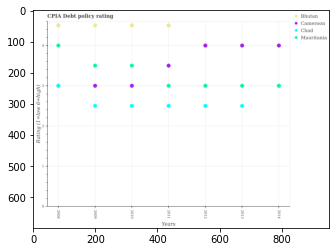

Number of QA =  29





,Years,Chad,Mauritania,Bhutan,Cameroon
0,2014,NaN,3.021379,NaN,4.023284
1,2010,2.521225,3.524097,4.524959,3.020074
2,2011,2.521305,3.020786,4.525467,3.523145
3,2012,2.522398,3.021479,NaN,4.025195
4,2009,2.518162,3.521536,4.523638,3.019778
5,2008,3.022421,4.025902,4.526539,NaN
6,2013,2.519427,3.021153,NaN,4.025537


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in mauritania in 2008 and that in 2010 ?
PREDICTED =  0.5018055452008672
EXPECTED =  0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in chad in 2014 and the cpia rating in bhutan in 2012?
PREDICTED =  -2.522398252919396
EXPECTED =  -1.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the cpia rating in mauritania and cpia rating in chad ?
PREDICTED =  -2.691952713882474
EXPECTED =  0.5




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ..

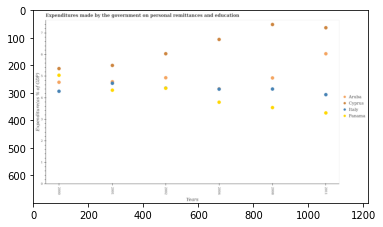

Number of QA =  29





,Years,Aruba,Cyprus,Panama,Italy
0,2008,4.937724,7.416248,3.563666,4.424054
1,2001,NaN,5.515853,4.369898,4.690200
2,2004,NaN,6.720349,3.810993,4.422545
3,2002,4.946438,6.059775,4.463070,NaN
4,2000,4.733302,5.369857,5.060277,4.316137
5,2011,6.059143,7.264843,3.314079,4.163007


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in cyprus in 2002 and that in 2004 ?
PREDICTED =  -6.7801235374997475
EXPECTED =  -0.661419868469241




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in cyprus in 2002 and the expenditures made by the government on personal remittances and education in panama in 2008?
PREDICTED =  -0.7380114485830065
EXPECTED =  2.497309923171999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between

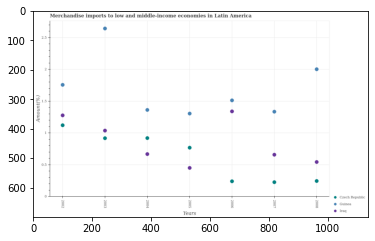

Number of QA =  28





,Years,Iraq,Czech Republic,Guinea
0,2002,1.290657,1.134371,1.773412
1,2004,0.679163,0.932361,1.377448
2,2003,1.051468,0.931552,2.665204
3,2006,1.355630,0.249538,1.527988
4,2008,0.555290,0.253925,2.021118
5,2007,0.670770,0.236103,1.350175
6,2005,0.461759,0.780775,1.320405


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in czech republic in 2002 and that in 2007 ?
PREDICTED =  0.8982687639718618
EXPECTED =  0.894965440104835




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in guinea in 2006 and the percentage of amount earned from merchandise imports in iraq in 2008?
PREDICTED =  0.9726979702934462
EXPECTED =  0.9689982830886872




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of amount earned from merchandise imports i

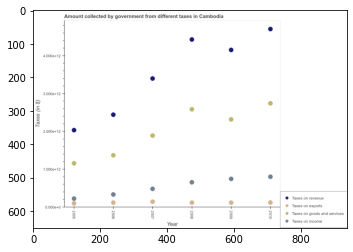

Number of QA =  29





,Year,Taxes on goods and services,Taxes on revenue,Taxes on exports,Taxes on income
0,2005,1.168649,2.043175,0.114133,0.237906
1,2006,1.382721,2.450975,0.133124,0.347020
2,2007,1.901151,3.406161,0.156872,0.496897
3,2010,2.754152,4.712025,0.136544,0.815203
4,2008,2.593519,4.434877,0.133503,0.668695
5,2009,2.329572,4.163606,0.133255,0.759074


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on exports in 2005 and that in 2006 ?
PREDICTED =  -0.21407159493081562
EXPECTED =  -19944394832




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on goods in 2009 and the amount collected as tax on exports in 2008?
PREDICTED =  -0.2639470824186003
EXPECTED =  2201467821938




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount collected as tax on revenue and amount collected as tax on goods ?
PREDICTED =  1.9578728560022882
EXPECTED =  1846391002353




				 0 / 3 = 0.0


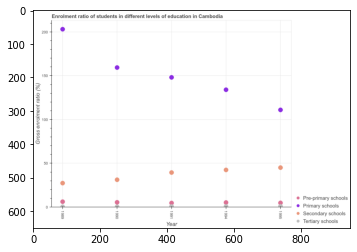

Number of QA =  29





,Year,Tertiary schools,Secondary schools,Pre-primary schools,Primary schools
0,1994,1.308777,43.371829,6.071311,135.307579
1,1995,1.408339,46.005290,5.613122,112.226666
2,1990,1.110592,32.115157,6.215287,160.826008
3,1989,1.021975,28.329608,6.842219,204.834889
4,1991,1.515711,40.364805,5.525280,149.491161


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio in pre-primary schools in 1990 ?
PREDICTED =  6.215287119136607
EXPECTED =  5.36669




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum gross enrolment ratio in primary schools ?
PREDICTED =  204.83488891224889
EXPECTED =  203.14101




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum gross enrolment ratio in secondary schools ?
PREDICTED =  28.329608190877263
EXPECTED =  27.2947902679443




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

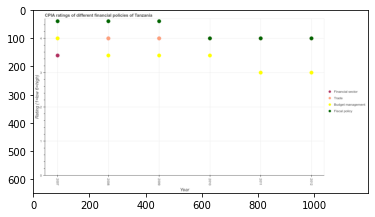

Number of QA =  29





,Year,Financial sector,Trade,Fiscal policy,Budget management
0,2010,NaN,NaN,4.003692,3.507024
1,2011,NaN,NaN,4.003189,3.006502
2,2009,NaN,4.003262,4.501239,3.505852
3,2012,NaN,NaN,4.003938,3.006168
4,2008,NaN,4.002255,4.503288,3.504567
5,2007,3.504295,NaN,4.503017,4.002369


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of budget management in 2009 and that in 2011 ?
PREDICTED =  0.49934991349375535
EXPECTED =  0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of fiscal policy in 2011 and the cpia rating of trade in 2009?
PREDICTED =  -0.4980497404812647
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating of budget management in 2009 to that in 2011?
PREDIC

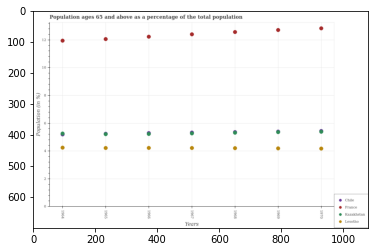

Number of QA =  29





,Years,Lesotha,France,Kazakhstan,Chile
0,1966,4.284814,12.344503,5.304836,NaN
1,1965,4.275481,12.172488,5.290180,NaN
2,1967,4.277525,12.514797,5.360721,NaN
3,1964,4.301524,12.062921,5.296882,NaN
4,1969,4.251244,12.830163,5.442173,NaN
5,1968,4.265837,12.687971,5.397212,NaN
6,1970,4.239117,12.961051,5.460934,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 65 and above in kazakhstan in 1965 and that in 1968 ?
PREDICTED =  -1961.7608834482733
EXPECTED =  -0.10444303831280877




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 65 and above in chile in 1966 and the percentage of the population ages 65 and above in lesotho in 1967?
PREDICTED =  -0.04569742141833366
EXPECTED =  1.0723480238168097




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1969, what is the difference between the percentage of the population ages 65 and above in lesotho and percen

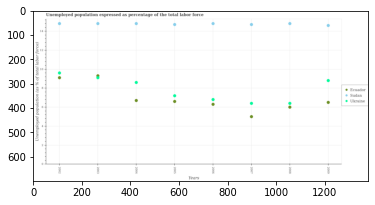

Number of QA =  28





,Years,Ukraine,Ecuador,Sudan
0,2004,8.598982,6.705560,14.766732
1,2009,8.799126,6.506100,14.568279
2,2006,6.808246,6.313090,14.765835
3,2003,9.092300,9.292025,14.768185
4,2005,7.214715,6.613611,14.671039
5,2002,9.604708,9.099320,14.761203
6,2008,6.412682,6.012451,14.768345
7,2007,6.404237,5.016873,14.673263


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in in ukraine in 2007 and that in 2009 ?
PREDICTED =  -2.3948895917710677
EXPECTED =  -2.4000000953674308




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in in sudan in 2006 and the unemployment in in ecuador in 2004?
PREDICTED =  -0.0008965602788819638
EXPECTED =  8.100000381469762




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the unemployment in in sudan and unemployment in in ukraine ?
PREDICTED =  6.850985678312045
EXPECTED =  5.6999998092651705




				 1 / 3 = 0.3333


is_built_with_cuda

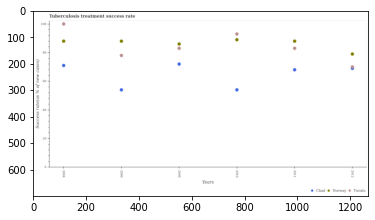

Number of QA =  28





,Years,Norway,Tuvalu,Chad
0,2004,88.532822,100.565077,71.394912
1,2009,86.535441,83.541881,72.531476
2,2010,89.553753,93.630942,54.439404
3,2011,88.527228,83.526699,68.472670
4,2012,79.526948,70.554440,69.417084
5,2006,88.503987,78.516533,54.401567


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in norway in 2004 and that in 2011 ?
PREDICTED =  0.005594151840739414
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in tuvalu in 2006 and the tuberculosis treatment success rate in chad in 2011?
PREDICTED =  -5.010165045665062
EXPECTED =  10.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the tuberculosis treatment success rate in tuvalu and tuberculosis treatment success rate in chad ?
PREDICTED =  -1938.4455597691
EXPECTED =  1

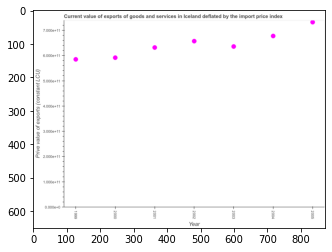

Number of QA =  24





,Year,Prive value of exports (constant LCU)
0,2005,51.511333
1,1999,41.241331
2,2000,41.680637
3,2004,47.713207
4,2001,44.496381
5,2003,44.802998
6,2002,46.279235


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price value of exports in 2000 and 2003 ?
PREDICTED =  -3.1223615007370853
EXPECTED =  -44254981712.17798




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median price value of exports ?
PREDICTED =  44.80299825200426
EXPECTED =  635719415246.879




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the price value of exports in 2002 to that in 2004 ?
PREDICTED =  0.969946029654414
EXPECTED =  0.9698976650072475




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is

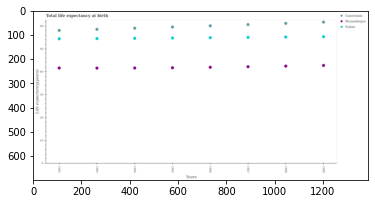

Number of QA =  28





,Years,Sudan,Guatemala,Mozambique
0,1982,54.448984,58.129780,41.709128
1,1983,54.567708,58.608946,41.685006
2,1989,55.396389,61.763208,42.880649
3,1985,54.800362,59.602549,41.866749
4,1987,55.115956,60.679603,42.327015
5,1984,54.705643,59.121634,41.713153
6,1986,54.918410,60.126128,42.067490
7,1988,55.277206,61.226366,42.585524


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in mozambique in 1983 and that in 1988 ?
PREDICTED =  -0.9005183549449356
EXPECTED =  -0.866219512195201




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in guatemala in 1985 and the life expectancy at birth in in mozambique in 1986?
PREDICTED =  -0.5235792234022654
EXPECTED =  17.60053658536581




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the life expectancy at birth in in guatemala and life expectancy at birth in in sudan ?
PREDICTED =  1927.5510162750945
EXPECT

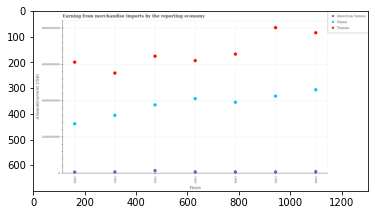

Number of QA =  28





,Years,Oman,Tunisia,American Samoa
0,1996,4.626781e+09,7.777942e+09,1.088066e+08
1,1990,2.745498e+09,6.147282e+09,8.767867e+07
2,1995,4.274739e+09,8.060523e+09,9.484160e+07
3,1991,3.218686e+09,5.550832e+09,9.418274e+07
4,1993,4.138861e+09,6.237993e+09,9.395793e+07
5,1994,3.937703e+09,6.594367e+09,9.536703e+07
6,1992,3.795148e+09,6.484887e+09,1.664505e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in american samoa in 1993 and that in 1996 ?
PREDICTED =  -14848685.013906226
EXPECTED =  -15969415.930000007




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in tunisia in 1993 and the amount earned from merchandise imports in oman in 1996?
PREDICTED =  -1539948312.0843992
EXPECTED =  1608078373.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the amount earned from merchandise imports in tunisia and amount earned from merchandise imports in o

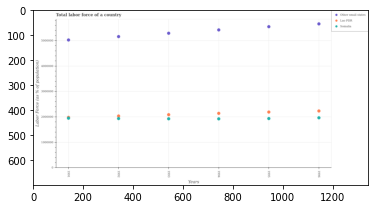

Number of QA =  28





,Years,Lao PDR,Somalia,Other small states
0,1994,2.152720e+06,1.933299e+06,5.417859e+06
1,1995,2.205606e+06,1.945561e+06,5.546437e+06
2,1992,2.046429e+06,1.948326e+06,5.156379e+06
3,1991,NaN,1.961703e+06,5.022529e+06
4,1996,2.244614e+06,1.976058e+06,5.654161e+06
5,1993,2.097928e+06,1.934636e+06,5.290107e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force in lao pdr in 1991 and that in 1996 ?
PREDICTED =  -2244614.0537670986
EXPECTED =  -251421




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force in other small states in 1993 and the percentage of labor force in lao pdr in 1991?
PREDICTED =  267578.38070989214
EXPECTED =  3309071




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the percentage of labor force in somalia and percentage of labor force in lao pdr ?
PREDICTED =  -268556.15929141105
EXPECTED =  -32504




				 0 / 3 

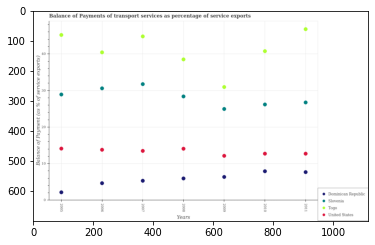

Number of QA =  29





,Years,Slovenia,United States,Togo,Dominican Republic
0,2006,30.558464,13.838828,40.349048,4.769865
1,2010,26.150740,12.784905,40.692165,7.983620
2,2007,31.711457,13.539027,44.697543,5.408452
3,2011,26.707962,12.786592,46.667112,7.751217
4,2008,28.380232,14.123706,38.455643,6.025046
5,2009,24.949197,12.194646,30.903323,6.443861
6,2005,28.866001,14.158376,45.103714,2.271076


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in slovenia in 2007 and that in 2010 ?
PREDICTED =  5.560716849969811
EXPECTED =  5.569495960191389




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in dominican republic in 2005 and the balance of payments of transport services in united states in 2008?
PREDICTED =  -3.7539692315087123
EXPECTED =  -11.92247367585695




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the balance of payments of transport services in togo and balance of payment

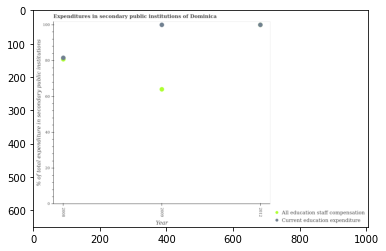

Number of QA =  27





,Year,All education staff compensation,Current education expenditure
0,2009,64.385538,100.475181
1,2012,NaN,100.494884
2,2008,NaN,81.937463


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in 2009 and that in 2012 ?
PREDICTED =  -0.019703662082761753
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the expenditure in staff compensation and expenditure in education ?
PREDICTED =  -182.43234717847596
EXPECTED =  -0.7975387573242898




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the expenditure in education in 2009 to that in 2012?

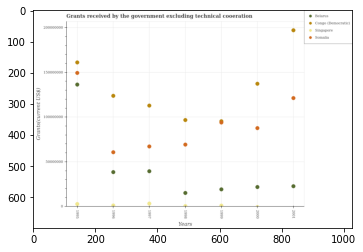

Number of QA =  28





,Years,Belarus,Somalia,Congo (Democratic),Singapore
0,1998,1.566294e+07,6.950862e+07,9.691929e+07,8.537536e+05
1,1995,1.364054e+08,1.493391e+08,1.611068e+08,3.152265e+06
2,1997,3.989354e+07,6.746139e+07,1.129771e+08,3.833344e+06
3,1996,3.893591e+07,6.107503e+07,1.239294e+08,1.511050e+06
4,1999,1.965288e+07,9.543047e+07,NaN,1.466739e+06
5,2000,2.223606e+07,8.790425e+07,1.373865e+08,1.300603e+05
6,2001,2.317495e+07,1.214534e+08,1.969535e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in somalia in 1995 and that in 1999 ?
PREDICTED =  53908604.24416688
EXPECTED =  55440000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in singapore in 1998 and the total grants received by the government in belarus in 2000?
PREDICTED =  723693.3052209103
EXPECTED =  -21320000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the total grants received by the government in congo (democratic) and total grants received by the government in sin

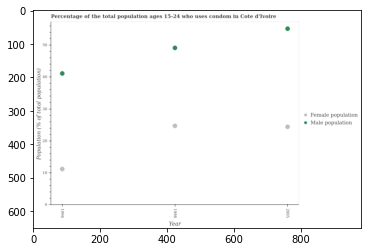

Number of QA =  27





,Year,Female population,Male population
0,1998,24.956104,49.452701
1,1994,11.422415,41.410897
2,2005,24.659674,55.449101


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female population in 1994 and that in 2005 ?
PREDICTED =  -13.237258271475328
EXPECTED =  -13.2




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male population in 1994 and the female population in 2005?
PREDICTED =  -14.038203550815105
EXPECTED =  16.700000000000003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the female population and male population ?
PREDICTED =  0.0
EXPECTED =  -24.400000000000002




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluat

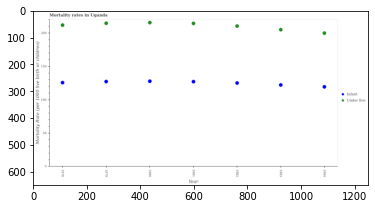

Number of QA =  27





,Year,Infant,Under five
0,1984,119.893694,200.306548
1,1978,126.266814,212.217691
2,1981,127.618795,214.786175
3,1983,122.623758,205.512862
4,1979,127.683962,214.921174
5,1980,128.162177,216.067892
6,1982,125.536757,210.896111


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in 1982 and that in 1983 ?
PREDICTED =  2.9129994126325585
EXPECTED =  2.9000000000000057




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 mortality rate in 1982 and the infant mortality rate in 1979?
PREDICTED =  -4.025062272297475
EXPECTED =  83.2




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1982, what is the difference between the under-5 mortality rate and infant mortality rate ?
PREDICTED =  0.0
EXPECTED =  85.4




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...

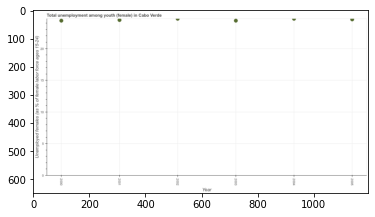

Number of QA =  24





,Year,Unemployed females (as % of female labor force ages 15-24)
0,2004,24.933777
1,2000,24.633963
2,2005,24.837084
3,2001,24.729190
4,2002,24.932442
5,2003,24.644625


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth population in 2003 and 2004 ?
PREDICTED =  -0.2891524422190237
EXPECTED =  -0.30000114440919035




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed female youth population ?
PREDICTED =  2002.5
EXPECTED =  24.550000190734846




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed female youth population in 2002 to that in 2003 ?
PREDICTED =  1.0116787020024087
EXPECTED =  1.0122951290614512




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after t

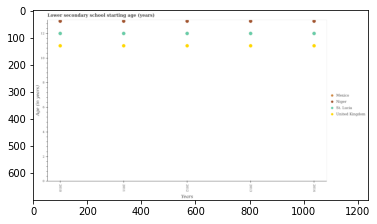

Number of QA =  29





,Years,St. Lucia,Mexico,United Kingdom,Niger
0,2014,11.993581,NaN,10.998534,12.989582
1,2010,11.990518,NaN,10.989183,12.993073
2,2011,11.991612,NaN,10.996689,12.990194
3,2012,11.992379,NaN,11.000567,12.989552
4,2013,11.996642,NaN,11.001675,12.994139


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary school starting age of children in niger in 2012 and that in 2014 ?
PREDICTED =  -0.997202158477382
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the lower secondary school starting age of children in st. lucia and lower secondary school starting age of children in niger ?
PREDICTED =  -2000.0094818744008
EXPECTED =  -1




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 

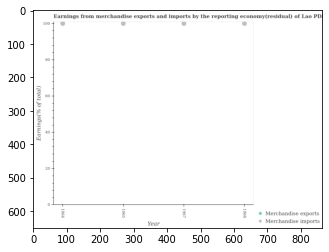

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,1965,100.325956,NaN
1,1967,100.291423,NaN
2,1964,100.333688,NaN
3,1968,100.356332,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 1964 and that in 1965 ?
PREDICTED =  0.0077315973544358485
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 1965 and the earnings from merchandise imports in 1964?
PREDICTED =  nan
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1964, what is the difference between the earnings from merchandise exports and earnings from merchandise imports ?
PREDICTED =  nan
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []


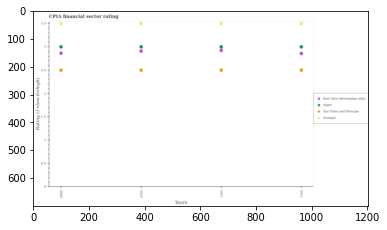

Number of QA =  29





,Years,Senegal,East Asia (developing only),Sao Tome and Principe,Niger
0,2011,3.498597,2.922716,2.501880,3.001014
1,2010,3.500082,2.910034,2.503005,3.001434
2,2012,3.498040,2.858382,2.502846,3.001068
3,2009,3.498231,2.866884,2.503345,2.999928


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in senegal in 2010 and that in 2012 ?
PREDICTED =  0.002042477474367921
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in niger in 2011 and the cpia rating in east asia (developing only) in 2012?
PREDICTED =  -5.462286645308012e-05
EXPECTED =  0.14285714285714013




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the cpia rating in senegal and cpia rating in sao tome and principe ?
PREDICTED =  9.994949711887083
EXPECTED =  1.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_a

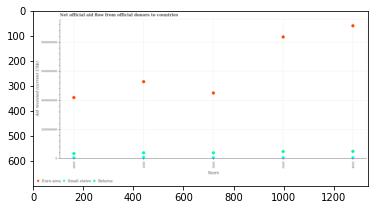

Number of QA =  28





,Years,Euro area,Small states,Belarus
0,2004,9.205484e+08,7.058038e+06,5.237490e+07
1,2003,8.430874e+08,5.942891e+06,5.141451e+07
2,2000,4.238749e+08,7.462287e+06,3.736424e+07
3,2001,5.345363e+08,1.113800e+07,4.267346e+07
4,2002,4.564074e+08,7.222190e+06,4.176577e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total aid received in belarus in 2000 and that in 2003 ?
PREDICTED =  -14050267.693250626
EXPECTED =  -13940000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total aid received in belarus in 2004 and the total aid received in euro area in 2003?
PREDICTED =  960389.9832932875
EXPECTED =  -786820000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the total aid received in euro area and total aid received in belarus ?
PREDICTED =  0.0
EXPECTED =  489440000.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_av

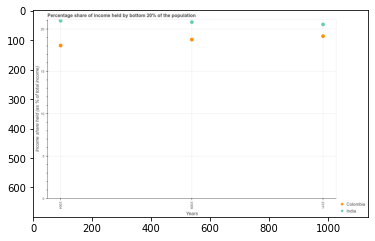

Number of QA =  27





,Years,Colombia,India
0,2009,18.848624,20.911033
1,2011,19.250575,20.642851
2,2004,18.156372,21.081472


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by bottom 20% of the population in india in 2009 and that in 2011 ?
PREDICTED =  0.2681815188938472
EXPECTED =  0.2699999999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by bottom 20% of the population in colombia in 2011 and the share of income held by bottom 20% of the population in india in 2009?
PREDICTED =  0.4019516620192718
EXPECTED =  -1.6600000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the share of income held by bottom 20% of the population in in

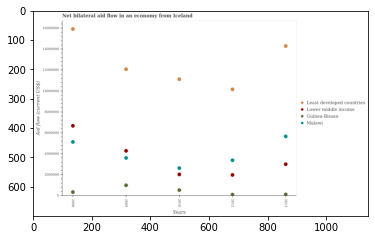

Number of QA =  29





,Years,Lower middle income,Least developed countries,Malawi,Guinea-Bissau
0,2009,4.344240e+06,1.215516e+07,3.653811e+06,1.038594e+06
1,2010,2.076164e+06,1.120689e+07,2.685465e+06,5.797486e+05
2,2008,6.733686e+06,1.601236e+07,5.193685e+06,3.798574e+05
3,2013,3.053705e+06,1.438570e+07,5.732087e+06,1.749463e+05
4,2012,2.032474e+06,1.023818e+07,3.441118e+06,1.522696e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in lower middle income in 2010 and that in 2012 ?
PREDICTED =  43690.107102876995
EXPECTED =  50000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in malawi in 2010 and the net bilateral aid flow in guinea-bissau in 2008?
PREDICTED =  -2508220.008084605
EXPECTED =  2290000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the net bilateral aid flow in malawi and net bilateral aid flow in least developed countries ?
PREDICTED =  20706162.11621926
EXPECTED =  -8490000




		

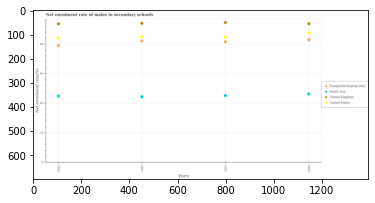

Number of QA =  29





,Years,South Asia,United States,United Kingdom,Europe(developing only)
0,2001,44.695475,85.531007,94.629239,82.621038
1,2003,46.679692,88.125149,94.326239,83.528851
2,2002,45.533547,85.134514,95.153460,82.161890
3,2000,45.135539,84.583910,94.239836,79.585942


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of males in secondary schools in south asia in 2000 and that in 2001 ?
PREDICTED =  0.4400645255316178
EXPECTED =  0.5030059814453054




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of males in secondary schools in europe(developing only) in 2002 and the net enrolment rate of males in secondary schools in south asia in 2003?
PREDICTED =  -1.3669609629532857
EXPECTED =  35.3055419921875




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the net enrolment rate of males in secondary school

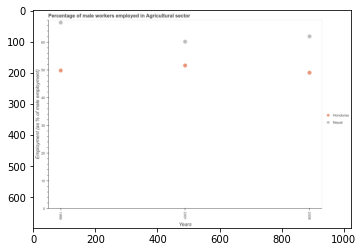

Number of QA =  27





,Years,Honduras,Nepal
0,1999,50.092075,67.377049
1,2008,49.276487,62.417770
2,2001,51.895092,60.493462


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sector in honduras in 1999 and that in 2008 ?
PREDICTED =  0.8155879846160019
EXPECTED =  0.7999992370604971




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sector in honduras in 1999 and the percentage of male workers employed in agricultural sector in nepal in 2008?
PREDICTED =  0.8155879846160019
EXPECTED =  -12.299999237060604




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of male workers employed i

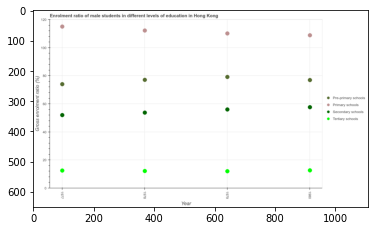

Number of QA =  29





,Year,Tertiary schools,Pre-primary schools,Primary schools,Secondary schools
0,1980,13.005456,77.095224,108.853444,57.779381
1,1978,12.537693,77.213728,112.170586,53.948922
2,1979,12.316427,79.285005,110.131424,56.202547
3,1977,12.844050,74.082379,114.942735,52.182364


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio(female) in pre-primary schools in 1977 ?
PREDICTED =  18.520594821603698
EXPECTED =  74.00021




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum gross enrolment ratio(female) in primary schools ?
PREDICTED =  19.821251290191576
EXPECTED =  115.03704




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum gross enrolment ratio(female) in secondary schools ?
PREDICTED =  13.0455910742529
EXPECTED =  51.97369000000001




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished


Image:

/home/pessat/Capstone/TEST/png/2840.png


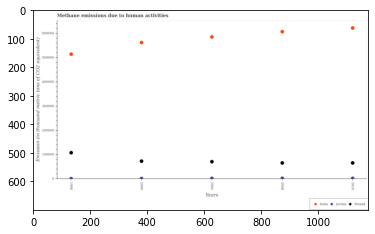

Number of QA =  28





,Years,Poland,Jordan,India
0,2000,74403.906936,3121.137305,563273.089680
1,2008,67053.042638,3900.110350,607888.799559
2,2005,72402.316603,3705.645511,586374.388913
3,1990,109125.346968,2791.700289,515639.155637
4,2010,67077.328289,3688.365336,623393.400653


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in india in 2008 and that in 2010 ?
PREDICTED =  -15504.601093581878
EXPECTED =  -15282.099999999977




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in poland in 2010 and the amount of methane emitted in india in 2008?
PREDICTED =  24.28565135190729
EXPECTED =  -540745.1




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of methane emitted in india and amount of methane emitted in jordan ?
PREDICTED =  -17201.958791138593
EXPECTED =  603993.0




				 1 / 3 = 0.

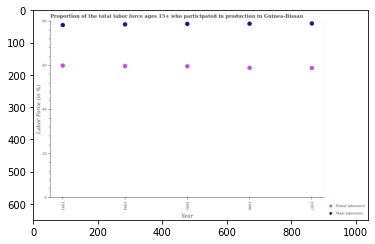

Number of QA =  27





,Year,Femal labourers,Male labourers
0,1995,59.612040,78.688196
1,1996,58.871990,78.744422
2,1993,59.908279,78.223915
3,1994,59.704802,78.506308
4,1997,58.796542,78.911990


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in 1993 and that in 1996 ?
PREDICTED =  -0.5205071864996853
EXPECTED =  -0.599998474121108




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in 1994 and the percentage of female labor force in 1993?
PREDICTED =  0.28239344159953816
EXPECTED =  18.699996948242095




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the percentage of female labor force and percentage of male labour force ?
PREDICTED =  -20.115448085236814
EXPECTED =  -18.89999771118149




				 0 / 3

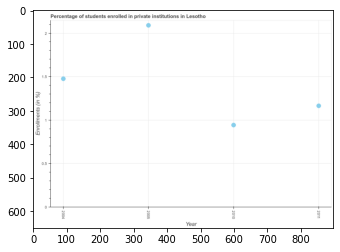

Number of QA =  24





,Year,Enrollments (in %)
0,2010,0.952690
1,2011,1.174655
2,2005,2.102699
3,2004,1.486415


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollments in private institutions in 2010 and 2011 ?
PREDICTED =  -0.22196563430886096
EXPECTED =  -0.22151005268097124




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median enrollments in private institutions ?
PREDICTED =  1.3305354249141135
EXPECTED =  1.319830000400545




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the enrollments in private institutions in 2004 to that in 2005 ?
PREDICTED =  0.7069083562969029
EXPECTED =  0.7059960441524524




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fini

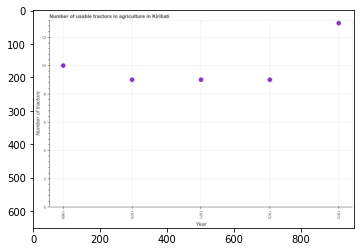

Number of QA =  24





,Year,Number of tractors
0,1970,9.067229
1,1972,9.075262
2,1969,10.071322
3,1973,13.079004
4,1971,9.073271


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tractors in 1971 and 1973 ?
PREDICTED =  -4.005733059748554
EXPECTED =  -4




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of tractors ?
PREDICTED =  9.07526233084022
EXPECTED =  9.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of tractors in 1970 to that in 1971 ?
PREDICTED =  0.9993340959366661
EXPECTED =  1.0




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest n

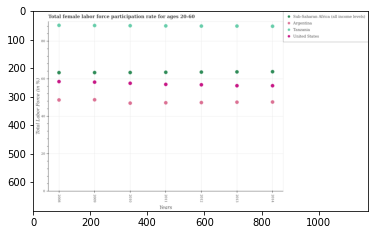

Number of QA =  29





,Years,Unnamed: 1,Sub-Saharan Africa (all income levels),Tanzania,United States
0,2014,47.519116,63.598073,87.691522,56.165991
1,2011,47.118325,63.326736,87.874710,56.910893
2,2013,47.408303,63.470282,87.815878,56.150571
3,2012,47.239109,63.394070,87.796198,56.636477
4,2009,48.686621,63.099423,88.109371,58.016447
5,2010,46.906788,63.133182,87.986993,57.462235
6,2008,48.571829,63.103458,88.157710,58.300750


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in united states in 2012 and that in 2014 ?
PREDICTED =  0.47048582534250727
EXPECTED =  0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in argentina in 2014 and the female labor force participation rate in tanzania in 2010?
PREDICTED =  -24.388919558677486
EXPECTED =  -40.7000045776367




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the female labor force participation rate in united states and female labor force participation rate in sub-sa

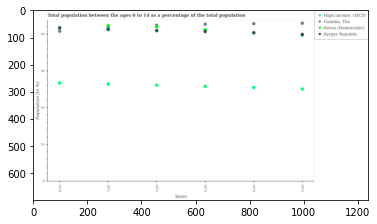

Number of QA =  29





,Years,"Gambia, The",High income: OECD,Korea (Democratic),Kyrgyz Republic
0,1974,42.805772,25.476349,NaN,40.342611
1,1971,NaN,26.438260,42.229736,41.235644
2,1972,NaN,26.125708,42.310686,40.909575
3,1973,42.668112,25.842802,41.144462,40.661347
4,1970,40.757288,26.738621,NaN,41.628817
5,1975,42.938257,25.115440,NaN,39.807653


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 0 to 14 in gambia, the in 1971 and that in 1973 ?
PREDICTED =  -1.9108236134052277
EXPECTED =  -0.9193536758675123




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 0 to 14 in high income: oecd in 1975 and the percentage of the population ages 0 to 14 in korea (democratic) in 1974?
PREDICTED =  -0.3609091504919455
EXPECTED =  -15.247704904675313




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the percentage of the population ages 0 to 14 in high income: oe

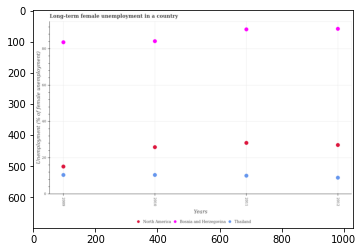

Number of QA =  28





,Years,Thailand,North America,Bosnia and Herzegovina
0,2010,10.764355,26.043981,84.282780
1,2012,9.275410,27.223417,91.056988
2,2011,10.366296,28.418183,90.720256
3,2009,10.725659,15.364641,83.708180


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed female population in bosnia and herzegovina in 2009 and that in 2012 ?
PREDICTED =  0.0
EXPECTED =  -7.400001525879006




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed female population in north america in 2011 and the percentage of long-term unemployed female population in bosnia and herzegovina in 2009?
PREDICTED =  13.053541998755868
EXPECTED =  -55.4341494959683




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of long-term unemployed f

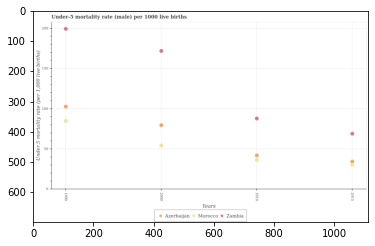

Number of QA =  28





,Years,Zambia,Morocco,Azerbaijan
0,2015,69.718199,31.061586,34.836741
1,1990,200.622125,85.579131,103.397260
2,2010,88.789992,37.255123,42.819298
3,2000,172.980082,54.944997,80.404390


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in azerbaijan in 1990 and that in 2010 ?
PREDICTED =  60.5779624493517
EXPECTED =  60.599999999999994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in morocco in 1990 and the under-five mortality rate in azerbaijan in 2010?
PREDICTED =  48.32400824290987
EXPECTED =  42.8




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2015, what is the difference between the under-five mortality rate in morocco and under-five mortality rate in zambia ?
PREDICTED =  31.061585891590394
EXPECTED =  -38.60000000000001




		

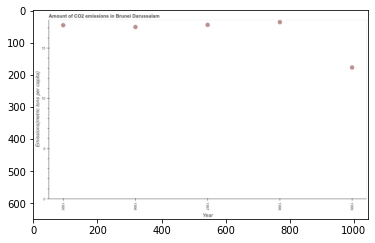

Number of QA =  24





,Year,Emissions(metric tons per capita)
0,1998,17.674776
1,1995,17.378093
2,1996,17.190379
3,1999,13.153354
4,1997,17.406403


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions in 1995 and 1999 ?
PREDICTED =  4.224738674680278
EXPECTED =  4.209380143594201




				 1 / 1 = 1.0


> what is the median amount of co2 emissions ?
PREDICTED =  None
EXPECTED =  17.2778210908105




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of co2 emissions in 1996 to that in 1999 ?
PREDICTED =  1.3069197481665586
EXPECTED =  1.3081395913531344




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest amount of co2 emissions ?
PREDICTED =  0.0
EXPECTED =  0.2703394357349005




				 2 /

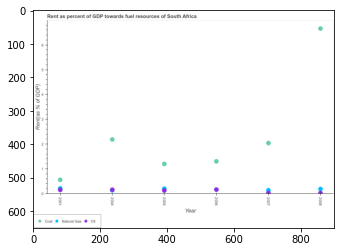

Number of QA =  28





,Year,Coal,Oil,Natural Gas
0,2004,2.207696,0.177033,NaN
1,2006,1.329631,0.188786,NaN
2,2005,1.222658,0.229136,NaN
3,2008,6.681429,0.045305,0.209700
4,2001,0.584014,0.173510,NaN
5,2007,2.061526,0.063043,0.165817


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards coal in 2006 and that in 2007 ?
PREDICTED =  -0.7318945513637471
EXPECTED =  -0.7370932056802801




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards coal in 2006 and the rent towards oil in 2005?
PREDICTED =  0.1069729178979748
EXPECTED =  1.178161879101367




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the rent towards natural gas and rent towards coal ?
PREDICTED =  -0.20849725628788107
EXPECTED =  -0.347569436258505




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs:

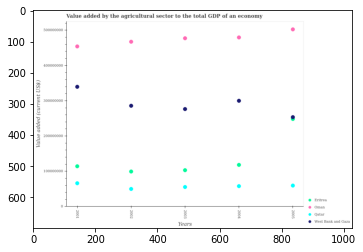

Number of QA =  29





,Years,Eritrea,Oman,West Bank and Gaza,Qatar
0,2001,1.147273e+08,4.523426e+08,3.384382e+08,6.696089e+07
1,2002,1.001519e+08,4.655055e+08,2.852565e+08,5.095025e+07
2,2004,1.185826e+08,4.775294e+08,2.991936e+08,5.880034e+07
3,2005,2.528335e+08,5.002675e+08,2.478044e+08,6.023976e+07
4,2003,1.036591e+08,4.752514e+08,2.759569e+08,5.643641e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector to the total gdp in west bank and gaza in 2001 and that in 2003 ?
PREDICTED =  1170692727.36678
EXPECTED =  63155596.73462504




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector to the total gdp in west bank and gaza in 2005 and the value added by the agricultural sector to the total gdp in eritrea in 2001?
PREDICTED =  860406991.3225803
EXPECTED =  139341827.007742




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the value added by the agricultural

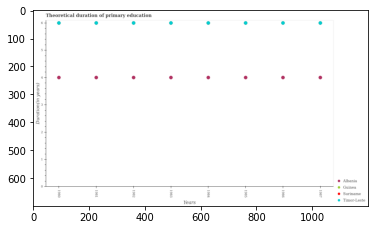

Number of QA =  29





,Years,Suriname,Albania,Guinea,Timor-Leste
0,1982,NaN,4.037811,NaN,6.049201
1,1986,NaN,4.037733,NaN,6.050213
2,1984,NaN,4.037889,NaN,6.051522
3,1980,NaN,4.034165,NaN,6.045304
4,1981,NaN,4.037429,NaN,6.048910
5,1983,NaN,4.036145,NaN,6.049278
6,1987,NaN,4.038889,NaN,6.049697
7,1985,NaN,4.039375,NaN,6.050287


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total theoretical duration of primary education in guinea in 1987 ?
PREDICTED =  0.0
EXPECTED =  6




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum total theoretical duration of primary education in guinea ?
PREDICTED =  248.375
EXPECTED =  6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum total theoretical duration of primary education in timor-leste ?
PREDICTED =  0.125
EXPECTED =  6.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which 

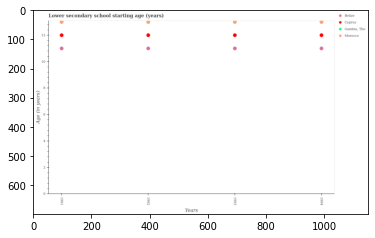

Number of QA =  29





,Years,"Gambia, The",Morocco,Cyprus,Belize
0,1994,NaN,13.010307,12.006823,11.009446
1,1991,NaN,13.011236,12.004105,11.014026
2,1992,NaN,13.008781,12.007823,11.015622
3,1993,NaN,13.006132,12.009848,11.014321


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary school starting age of children in gambia, the in 1991 and that in 1993 ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary school starting age of children in belize in 1993 and the lower secondary school starting age of children in cyprus in 1991?
PREDICTED =  -1979.9856792474927
EXPECTED =  -1.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the lower secondary school starting age of children in gambia, the and lower secondary school starting age of children

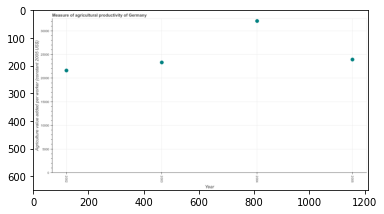

Number of QA =  24





,Year,Agriculture value added per worker (constant 2005 US$)
0,2002,21817.765289
1,2003,23527.944265
2,2004,32331.531437
3,2005,24150.293150


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the agriculture value added per worker in 2002 and 2003 ?
PREDICTED =  -1710.1789755015307
EXPECTED =  -1699.7352116218972




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median agriculture value added per worker ?
PREDICTED =  23839.118707244088
EXPECTED =  23620.998431383297




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the agriculture value added per worker in 2002 to that in 2004 ?
PREDICTED =  0.6748138525867509
EXPECTED =  0.6736896783112757




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished

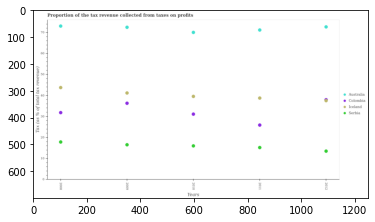

Number of QA =  29





,Years,Iceland,Serbia,Australia,Colombia
0,2012,37.959915,13.698357,73.049884,NaN
1,2008,44.114452,18.085022,73.440136,32.052747
2,2010,39.867609,16.213894,70.381326,31.343478
3,2011,39.052213,15.407764,71.518911,26.140274
4,2009,41.454876,16.759209,72.816448,36.555495


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the tax revenue collected in serbia in 2009 and that in 2011 ?
PREDICTED =  1.3514443410617325
EXPECTED =  1.3278900725587004




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the tax revenue collected in colombia in 2011 and the proportion of the tax revenue collected in iceland in 2008?
PREDICTED =  -5.912472875896945
EXPECTED =  -17.8518881243705




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the proportion of the tax revenue collected in australia and proportion of the tax revenue collected

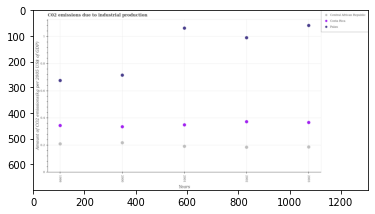

Number of QA =  28





,Years,~-entral African Republic,Palau,Costa Rica
0,2001,0.192073,1.058900,0.349374
1,2003,0.187618,1.078866,0.367155
2,2002,0.185340,0.988621,0.372895
3,1999,0.210034,0.674263,0.344372
4,2000,0.218461,0.713974,0.335997


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted due to industrial production in costa rica in 1999 and that in 2003 ?
PREDICTED =  -0.02278265521601469
EXPECTED =  -0.022360844656681922




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted due to industrial production in central african republic in 2002 and the amount of co2 emitted due to industrial production in palau in 2000?
PREDICTED =  1.7815394915995433
EXPECTED =  -0.5308793293495799




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the amount of co2 emitted due to industria

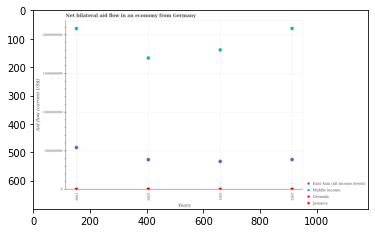

Number of QA =  28





,Years,East Asia (all income levels),Jamaica,Middle income,Grenada
0,2001,3.666200e+08,8.388952e+06,1.807947e+09,NaN
1,2002,3.908436e+08,8.159675e+06,2.085783e+09,NaN
2,1999,5.470938e+08,8.069198e+06,2.083789e+09,NaN
3,2000,3.891972e+08,8.140952e+06,1.703242e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in middle income in 2000 and that in 2002 ?
PREDICTED =  -382540817.15595865
EXPECTED =  -382130000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in grenada in 1999 and the net bilateral aid flow in middle income in 2000?
PREDICTED =  0.0
EXPECTED =  -1699900000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the net bilateral aid flow in middle income and net bilateral aid flow in east asia (all income levels) ?
PREDICTED =  0.0
EXPECTED =  1315340000




				 1 / 3 = 0.

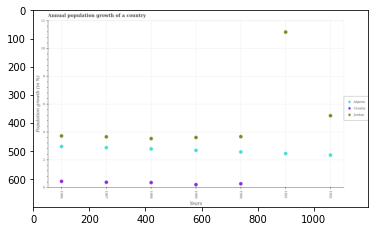

Number of QA =  27





,Years,Algeria,Croatia,Jordan
0,1991,2.499842,NaN,11.306039
1,1990,2.617580,0.305024,3.726947
2,1986,3.003133,0.489852,3.774278
3,1989,2.730171,0.255339,3.663117
4,1988,2.836375,0.400981,3.583958
5,1992,2.389783,NaN,5.248033
6,1987,2.925073,0.420611,3.717122


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual population growth in algeria in 1987 and that in 1990 ?
PREDICTED =  0.3074927545193553
EXPECTED =  0.31065191146807036




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual population growth in jordan in 1992 and the annual population growth in croatia in 1990?
PREDICTED =  1.5210858799689824
EXPECTED =  4.895066966767996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the annual population growth in jordan and annual population growth in croatia ?
PREDICTED =  3976.0
EXPECTED =  3.269309276035795




				 1 / 3

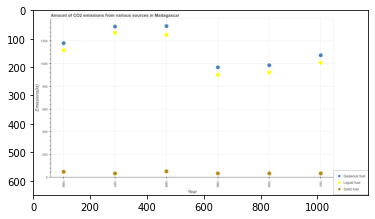

Number of QA =  28





,Year,Solid fuel,Gaseous fuel,Liquid fuel
0,1988,55.382288,1330.692095,1254.291151
1,1986,53.129286,1181.374339,1119.277808
2,1990,37.592761,987.820769,925.174389
3,1987,37.445281,1326.763973,1272.866063
4,1991,37.954142,1075.525608,1009.177008
5,1989,37.568969,969.260231,903.043040


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from gaseous fuel in 1989 and that in 1991 ?
PREDICTED =  -106.26537762470548
EXPECTED =  -106.34300000000007




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from gaseous fuel in 1987 and the amount of co2 emissions from solid fuel in 1988?
PREDICTED =  -3.9281216506662986
EXPECTED =  1276.116




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1986, what is the difference between the amount of co2 emissions from liquid fuel and amount of co2 emissions from gaseous fuel ?
PREDICTED =  6477.829458924943
EXPECTED = 

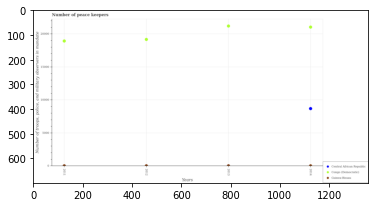

Number of QA =  28





,Years,Central African Republic,Guinea-Bissau,Congo (Democratic)
0,2014,8719.071913,71.678732,21024.051883
1,2013,NaN,73.295366,21186.586079
2,2012,NaN,90.818581,19160.397369
3,2011,NaN,92.590156,18911.066524


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of peace keepers in in congo (democratic) in 2011 and that in 2012 ?
PREDICTED =  0.0
EXPECTED =  -238.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of peace keepers in in central african republic in 2013 and the number of peace keepers in in guinea-bissau in 2014?
PREDICTED =  1.0
EXPECTED =  -10.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the number of peace keepers in in guinea-bissau and number of peace keepers in in central african republic ?
PREDICTED =  3.0
EXPECTED =  14.0




				 0 / 3 =

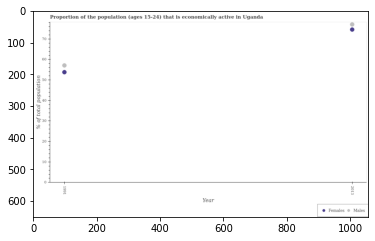

Number of QA =  23





,Year,Males,Females
0,1991,57.673780,54.385991
1,2013,77.865602,75.322794


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in 1991 and that in 2013 ?
PREDICTED =  -20.191822348236812
EXPECTED =  -19.999999999999893




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in 2013 and the percentage of economically active male population in 1991?
PREDICTED =  20.936802770431377
EXPECTED =  17.499999999999893




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 

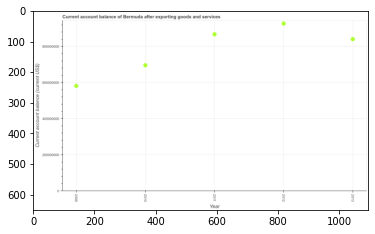

Number of QA =  24





,Year,Current account balance (current US$)
0,2009,5.843576e+08
1,2013,8.435785e+08
2,2012,9.303686e+08
3,2011,8.703277e+08
4,2010,6.994870e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current account balance in 2010 and 2012 ?
PREDICTED =  -230881550.66581678
EXPECTED =  -231028954.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median current account balance ?
PREDICTED =  843578469.1291081
EXPECTED =  840649668.3




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the current account balance in 2011 to that in 2013 ?
PREDICTED =  1.031709232647583
EXPECTED =  1.0320550965713147




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the differ

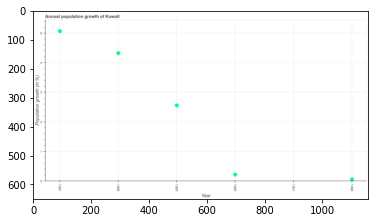

Number of QA =  22





,Year,Population growth (in %)
0,1996,0.074126
1,1987,5.092728
2,1991,NaN
3,1990,0.234757
4,1989,2.577643
5,1988,4.346398


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population growth in 1988 and 1989 ?
PREDICTED =  1.7687553744002784
EXPECTED =  1.7675941374574098




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median population growth ?
PREDICTED =  2.5776428312578954
EXPECTED =  1.3835012441685821




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the population growth in 1990 to that in 1996 ?
PREDICTED =  3.1669826695927195
EXPECTED =  3.993676531601313




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the differen

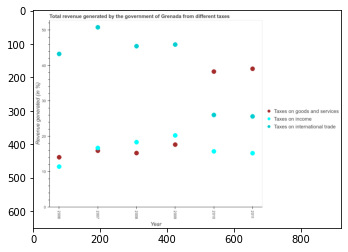

Number of QA =  28





,Year,Taxes on goods and services,Taxes on international trade,Taxes on income
0,2009,17.736708,45.871974,20.328922
1,2008,15.342876,45.394916,18.439173
2,2006,14.177175,43.232874,11.547010
3,2011,39.058965,25.660730,15.324861
4,2007,15.963032,50.706152,16.773791
5,2010,38.287038,26.058935,15.839712


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by tax on international trade in 2008 and that in 2011 ?
PREDICTED =  19.734186010050113
EXPECTED =  19.8490611371077




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on goods and services in 2010 and the percentage of revenue generated by tax on international trade in 2008?
PREDICTED =  -32.394886471846924
EXPECTED =  -7.1831110409753975




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of revenue generated by tax on international trade

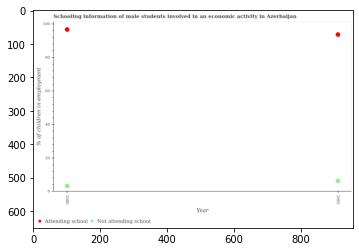

Number of QA =  23





,Year,Not attending school,Attending school
0,2005,6.608379,93.703476
1,2000,3.693546,96.645694


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed males who are not attending school in 2000 and that in 2005 ?
PREDICTED =  -2.9148330154597533
EXPECTED =  -2.9996699999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed males who are not attending school in 2000 and the percentage of employed males who are attending school in 2005?
PREDICTED =  -2.9148330154597533
EXPECTED =  -90.39967




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trai

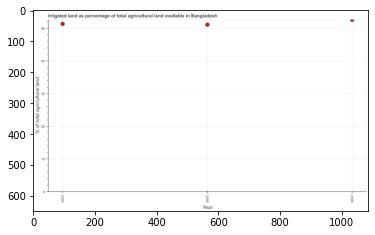

Number of QA =  24





,Year,% of total agricultural land
0,2004,51.843155
1,2005,51.624878
2,2006,53.123661


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural irrigated land in 2004 and 2006 ?
PREDICTED =  -1.2805062585560094
EXPECTED =  -1.272401263837601




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of agricultural irrigated land ?
PREDICTED =  51.843154729657606
EXPECTED =  51.346133218921




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of agricultural irrigated land in 2005 to that in 2006 ?
PREDICTED =  0.9717869021438347
EXPECTED =  0.9715650375152763




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Ev

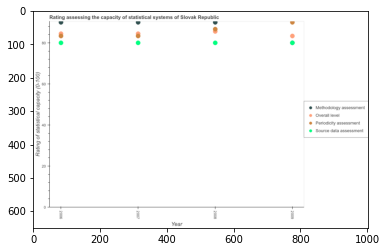

Number of QA =  29





,Year,Source data assessment,Methodology assessment,Overall level,Periodicity assessment
0,2009,80.341412,NaN,83.710174,90.351612
1,2007,80.331580,90.351868,83.699179,84.832194
2,2006,80.407494,90.418018,84.852597,83.636706
3,2008,80.360684,90.422030,86.986403,85.868824


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the source data assessment rating in 2006 and that in 2007 ?
PREDICTED =  0.07591336731253762
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the methodology assessment rating in 2007 and the periodicity assessment rating in 2008?
PREDICTED =  -0.0701612123602331
EXPECTED =  3.3333300000000037




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the overall level rating and source data assessment rating ?
PREDICTED =  1.8033451240022487
EXPECTED =  5.5555555555555




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_a

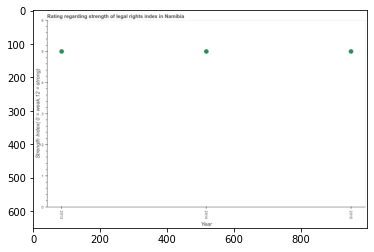

Number of QA =  24





,Year,"Strength Index( 0 = weak,12 = strong)"
0,2015,5.006829
1,2013,5.006906
2,2014,5.006005


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the strength of legal rights index in 2013 and 2014 ?
PREDICTED =  0.000900574725381631
EXPECTED =  0




				 0 / 1 = 0.0


> what is the median strength of legal rights index ?
PREDICTED =  None
EXPECTED =  5.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the strength of legal rights index in 2014 to that in 2015 ?
PREDICTED =  0.9998353573744659
EXPECTED =  1.0




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest strength of legal rights index ?
PREDICTED =  0.0
EXPECTED =  0




				 2 / 5 = 0.4


is_built_with_cuda: T

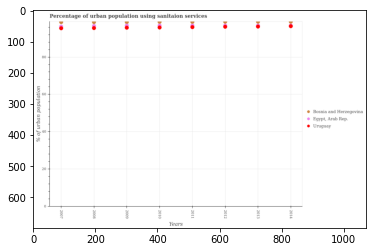

Number of QA =  28





,Years,Uruguay,"Egypt, Arab Rep.",Bosnia and Herzegovina
0,2014,97.620661,NaN,100.036711
1,2010,96.877926,NaN,99.918158
2,2013,97.360853,NaN,99.992334
3,2009,96.851978,NaN,99.821962
4,2008,96.685623,NaN,99.781620
5,2012,97.286205,NaN,100.005671
6,2011,97.091280,NaN,99.899745
7,2007,96.659671,NaN,99.839717


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population using sanitaion services in bosnia and herzegovina in 2007 and that in 2008 ?
PREDICTED =  -99.61566618777701
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population using sanitaion services in egypt, arab rep. in 2013 and the percentage of urban population using sanitaion services in bosnia and herzegovina in 2007?
PREDICTED =  nan
EXPECTED =  -1.9000000000000057




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the percentage of urban population using 

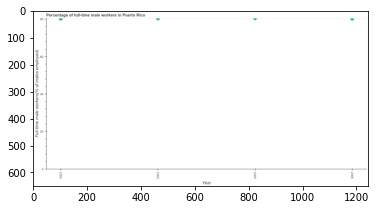

Number of QA =  24





,Year,Full-time male workers(% of males employed)
0,2005,80.192958
1,2004,80.332563
2,2002,80.238563
3,2003,80.278952


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in 2003 and 2005 ?
PREDICTED =  0.08599392033175945
EXPECTED =  0.10000610351559658




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of full-time male workers ?
PREDICTED =  80.25875730032419
EXPECTED =  80.25




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of full-time male workers in 2003 to that in 2004 ?
PREDICTED =  0.9993326335415772
EXPECTED =  0.9987562379076707




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished afte

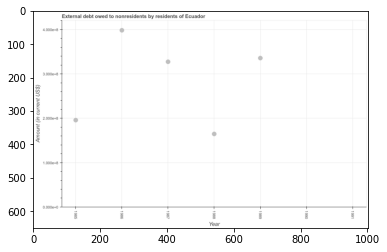

Number of QA =  22





,Year,Amount (in current US$)
0,1988,1.663266
1,1989,3.377604
2,1985,1.975071
3,1986,4.005861
4,1990,NaN
5,1991,NaN
6,1987,3.294531


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt in 1985 and 1986 ?
PREDICTED =  -2.030790047542215
EXPECTED =  -202533000




				 0 / 1 = 0.0


> what is the median debt ?
PREDICTED =  None
EXPECTED =  195853000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the debt in 1988 to that in 1989 ?
PREDICTED =  0.4924395621112955
EXPECTED =  0.4905768285599392




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest debt ?
PREDICTED =  0.6282575296059045
EXPECTED =  62671000




				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pre

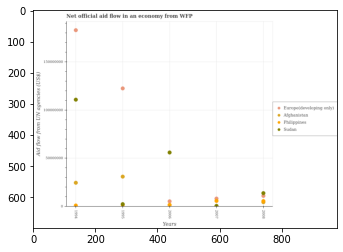

Number of QA =  29





,Years,Sudan,Philippines,Afghanistan,Europe(developing only)
0,1995,2.671330e+06,NaN,3.148076e+07,1.228078e+08
1,2007,1.171875e+06,6.390262e+06,NaN,8.720453e+06
2,1994,1.111233e+08,1.469966e+06,2.511386e+07,1.830274e+08
3,2006,5.646740e+07,2.025214e+06,NaN,5.749301e+06
4,2008,1.433491e+07,5.542621e+06,NaN,1.151820e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in europe(developing only) in 2006 and that in 2008 ?
PREDICTED =  -5768901.616068796
EXPECTED =  -5650000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in afghanistan in 1995 and the net official aid flow in sudan in 2007?
PREDICTED =  31480760.18497049
EXPECTED =  30310000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the net official aid flow in afghanistan and net official aid flow in europe(developing only) ?
PREDICTED =  -9769998.877794921
EXPECTED =  -158110000.0



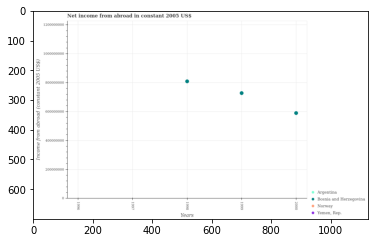

Number of QA =  21





,Years,Unnamed: 1,Norway,"Yemen, Rep.",Bosnia and Herzegovine
0,1998,NaN,NaN,NaN,8.120914e+08
1,1999,NaN,NaN,NaN,7.307697e+08
2,2000,NaN,NaN,NaN,5.927875e+08
3,1996,NaN,NaN,NaN,NaN
4,1997,NaN,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest net income from abroad in bosnia and herzegovina ?
PREDICTED =  -730767718.0494226
EXPECTED =  81359532.71087587




				 0 / 2 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Income from abroad (constant 2005 US$)
EXPECTED =  200000000.0




				 0 / 3 = 0.0


> what is the title of the graph ?
PREDICTED =  Net income from abroad in constant 2(
EXPECTED =  Net income from abroad in constant 2005 US$




				 0 / 4 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Years
EXPECTED =  Years




				 1 / 5 = 0.2


> what is the label or title of the y-axis ?
PREDICTED =  Incom

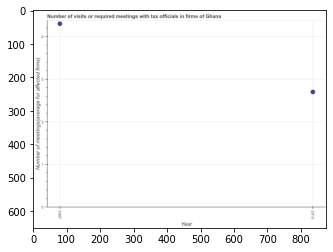

Number of QA =  20





,Year,Number of meetings(average for affected firms)
0,2013,2.723627
1,2007,4.325582


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of required meetings with tax officials in 2007 and 2013 ?
PREDICTED =  1.6019550766293955
EXPECTED =  1.5999999999999996




				 1 / 1 = 1.0


> what is the median number of required meetings with tax officials ?
PREDICTED =  None
EXPECTED =  3.5




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of required meetings with tax officials in 2007 to that in 2013 ?
PREDICTED =  1.5881697380351452
EXPECTED =  1.5925925925925923




				 2 / 4 = 0.5


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Number of meetings(average for affected firms)
EXPECTED =  1.0




				 2 / 5 = 0.4


> what is the title of the graph ?
PREDICTED =  Numbe

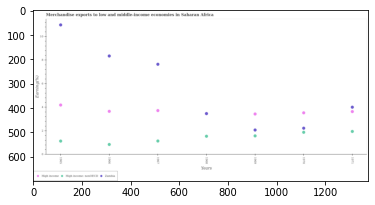

Number of QA =  28





,Years,Zambia,High income: nonOECD,High income
0,1968,3.510969,1.578305,NaN
1,1966,8.442959,0.876008,3.715067
2,1971,4.068945,1.991469,3.691841
3,1965,11.100354,1.166743,4.255524
4,1967,7.744475,1.170382,3.779762
5,1969,2.117265,1.608383,3.484827
6,1970,2.275264,1.916828,3.585361


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in zambia in 1969 and that in 1970 ?
PREDICTED =  -0.157998222238525
EXPECTED =  -0.15460982651033994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in zambia in 1969 and the percentage of amount earned from merchandise exports in high income in 1968?
PREDICTED =  -5.627209677975593
EXPECTED =  -1.39617153275069




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1969, what is the difference between the percentage of amount earned from merchandise exports 

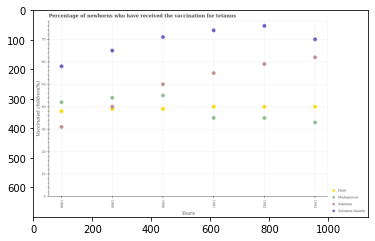

Number of QA =  29





,Years,Solomon Islands,Madagascar,Haiti,Pakistan
0,1991,74.097811,35.140554,40.139379,55.112765
1,1989,65.092142,44.146106,39.121005,40.088021
2,1993,70.074998,33.151506,40.127055,62.109967
3,1992,76.097806,35.122195,40.122329,59.097308
4,1988,58.115403,42.139930,38.150547,31.115237
5,1990,71.105056,45.129525,39.139965,50.146718


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in pakistan in 1989 and that in 1992 ?
PREDICTED =  -19.009286723992567
EXPECTED =  -19.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in madagascar in 1991 and the percentage of vaccinated children in haiti in 1990?
PREDICTED =  -9.988971313177998
EXPECTED =  -4.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1989, what is the difference between the percentage of vaccinated children in solomon islands and percentage of vaccinated children in pakistan ?
PREDICTED =  -3.9945630860744927

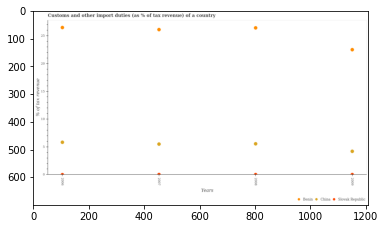

Number of QA =  27





,Years,China,Benin,Slovak Republic
0,2006,5.861886,26.466815,0.102110
1,2009,4.274661,22.495216,0.098641
2,2008,5.605196,26.409428,0.113266
3,2007,5.555918,26.097451,0.110740


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of tax revenue from customs in china in 2006 and that in 2008 ?
PREDICTED =  0.2566903960487483
EXPECTED =  0.2728728984983997




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of tax revenue from customs in china in 2006 and the percentage of tax revenue from customs in benin in 2007?
PREDICTED =  -5.299227942783154
EXPECTED =  -20.29959167804973




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of tax revenue from customs in slovak republic and percentage of tax revenue from customs in 

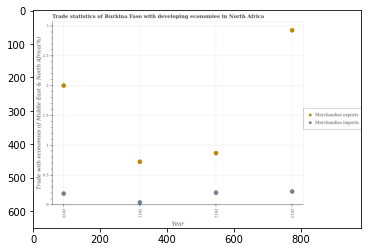

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,2010,0.197138,2.007047
1,2012,0.213069,0.875655
2,2013,0.232841,2.933099
3,2011,0.050527,0.730702


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 2011 and that in 2012 ?
PREDICTED =  -0.16254197893420563
EXPECTED =  -0.1632426250677993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 2010 and the merchandise imports in 2013?
PREDICTED =  -0.9260523580624871
EXPECTED =  1.776905963271757




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the merchandise exports and merchandise imports ?
PREDICTED =  2.7002579216062066
EXPECTED =  0.6820644620953032




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
G

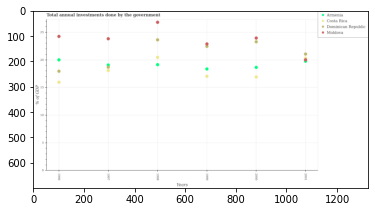

Number of QA =  29





,Years,Moldova,Dominican Republic,Armenia,Costa Rica
0,1998,26.809967,23.648809,19.166539,20.472210
1,1999,22.884793,22.469354,18.384484,17.078525
2,1996,24.250037,17.982833,20.040827,15.982089
3,2001,20.015417,21.070468,NaN,NaN
4,1997,23.843805,18.740667,19.089428,18.127484
5,2000,23.955749,23.292106,18.676820,16.950041


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual investments done by the government in moldova in 1997 and that in 1998 ?
PREDICTED =  -2.9661613128922504
EXPECTED =  -2.9790478687020006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual investments done by the government in dominican republic in 1998 and the total annual investments done by the government in costa rica in 2001?
PREDICTED =  2.57834056214762
EXPECTED =  3.3191909224210008




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the total annual investments done by the government in costa 

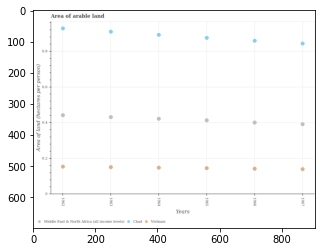

Number of QA =  28





,Years,Chad,Vietnam,Middle East & North Africa (all income levels
0,1965,0.874367,0.147101,0.414038
1,1966,0.858124,0.144127,0.401066
2,1963,0.909336,0.152821,0.431932
3,1964,0.891591,0.149792,0.423297
4,1967,0.843217,0.141774,0.392789
5,1962,0.926280,0.156150,0.442627


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in middle east & north africa (all income levels) in 1965 and that in 1967 ?
PREDICTED =  0.02124885046974051
EXPECTED =  0.02211340175452109




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in vietnam in 1963 and the total arable land in chad in 1964?
PREDICTED =  0.0030291755521890673
EXPECTED =  -0.7413211472667129




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1964, what is the difference between the total arable land in vietnam and total arable land in chad ?
PREDICTED =  -4.4111503705622646
EXPECTED =  -0.7442804503

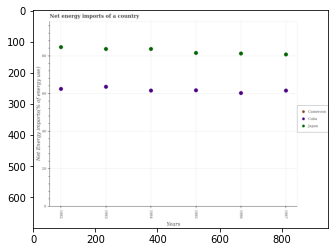

Number of QA =  27





,Years,Cuba,Japan,Cameroon
0,1983,63.774705,83.835876,NaN
1,1986,60.426590,81.458194,NaN
2,1984,61.808101,83.844972,NaN
3,1985,61.933619,81.749940,NaN
4,1982,62.625708,84.817582,NaN
5,1987,61.807112,80.957197,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net energy imports in japan in 1985 and that in 1987 ?
PREDICTED =  0.7927426061277743
EXPECTED =  0.8038939076931086




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net energy imports in cuba in 1984 and the net energy imports in cameroon in 1985?
PREDICTED =  -0.1255183463251015
EXPECTED =  61.5458416739069




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the net energy imports in cuba and net energy imports in japan ?
PREDICTED =  366.3758353416164
EXPECTED =  -19.18306258242019




				 1 / 3 = 0.3333


is_built_with_

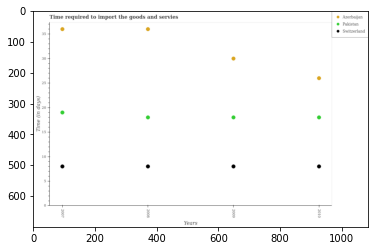

Number of QA =  28





,Years,Pakistan,Azerbaijan,Switzerland
0,2008,17.967620,35.816740,8.025019
1,2010,17.956221,25.890758,8.044772
2,2009,17.952686,29.857393,8.032146
3,2007,18.941587,35.800193,8.025839


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to import the goods and services in pakistan in 2007 and that in 2009 ?
PREDICTED =  -13.952686406361252
EXPECTED =  1.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to import the goods and services in pakistan in 2007 and the number of days required to import the goods and services in azerbaijan in 2008?
PREDICTED =  -32.9092071189408
EXPECTED =  -17.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the number of days required to import the goods and services in switzer

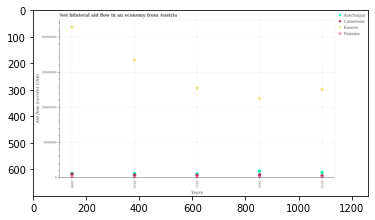

Number of QA =  29





,Years,Azerbaijan,Kosovo,Panama,Cameroon
0,2013,794756.600049,1.254818e+07,95326.923408,287303.718527
1,2012,978981.744950,1.129277e+07,116471.128419,474714.504569
2,2009,NaN,2.136251e+07,85972.117084,634548.938508
3,2010,407561.097430,1.673097e+07,606826.740540,181287.556566
4,2011,194668.627432,1.274704e+07,545039.772138,345702.928685


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in panama in 2009 and that in 2012 ?
PREDICTED =  -30499.011334434224
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in panama in 2013 and the net bilateral aid flow in cameroon in 2009?
PREDICTED =  9354.806323153156
EXPECTED =  -480000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the net bilateral aid flow in panama and net bilateral aid flow in kosovo ?
PREDICTED =  -73231839.03910774
EXPECTED =  -12530000.0




				 0 / 3 = 0.0


is_built_with_cuda: 

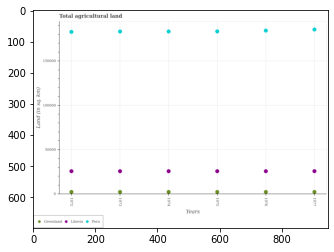

Number of QA =  28





,Years,Liberia,Greenland,Peru
0,1972,26086.685028,2813.658651,182388.074276
1,1977,26231.808862,2685.380167,185190.318057
2,1974,26190.642006,2745.178759,182865.412508
3,1976,26200.123181,2697.954189,183804.724057
4,1973,26165.467300,2689.571507,182845.684279
5,1975,26181.667418,2703.883922,183061.405006


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total agricultural land in peru in 1972 and that in 1976 ?
PREDICTED =  -1416.6497804345563
EXPECTED =  -1470




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total agricultural land in greenland in 1972 and the total agricultural land in liberia in 1974?
PREDICTED =  68.47989249691409
EXPECTED =  -23360




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the total agricultural land in peru and total agricultural land in liberia ?
PREDICTED =  158958.5091945534
EXPECTED =  157010




				 2 / 3 = 0.6667


is_built_with_cuda: 

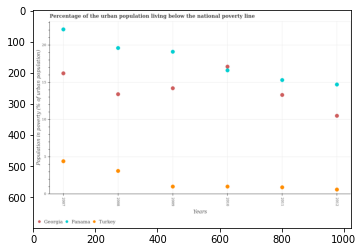

Number of QA =  28





,Years,Georgia,Turkey,Panama
0,2008,13.446959,3.174023,19.638258
1,2010,17.155426,1.081155,16.643037
2,2009,14.247817,1.070977,19.138648
3,2011,13.350720,0.975300,15.340893
4,2012,10.558449,0.681429,14.745588
5,2007,16.237860,4.470515,22.125427


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the urban population living below the national poverty line in turkey in 2007 and that in 2008 ?
PREDICTED =  0.0
EXPECTED =  1.3000000000000003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of the urban population living below the national poverty line in turkey and percentage of the urban population living below the national poverty line in panama ?
PREDICTED =  -2011.318570703559
EXPECTED =  -15.600000000000001




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: Fa

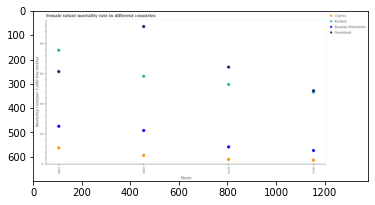

Number of QA =  29





,Years,Swaziland,Kiribati,Russian Federation,Cyprus
0,1990,61.815337,75.933587,25.459009,11.180043
1,2000,91.716805,58.714736,22.658973,6.141973
2,2010,64.794418,53.293635,11.773898,3.379814
3,2015,48.120357,49.111281,9.386783,2.949010


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the female infant mortality rate in russian federation maximum?
PREDICTED =  41.35463920229374
EXPECTED =  1990




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female infant mortality rate in russian federation in 1990 and that in 2010 ?
PREDICTED =  0.02078122572979585
EXPECTED =  13.7




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female infant mortality rate in swaziland in 2015 and the female infant mortality rate in kiribati in 2000?
PREDICTED =  -43.59644834421298
EXPECTED =  -9.600000000000001




				 0 / 3 = 0.0


is_built_with_cuda: True
is

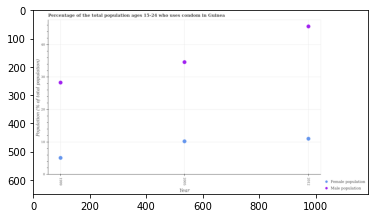

Number of QA =  27





,Year,Female population,Male population
0,2012,11.218161,46.037462
1,2005,10.346175,34.979004
2,1999,5.273674,28.587621


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female population in 1999 and that in 2005 ?
PREDICTED =  -5.072500327002027
EXPECTED =  -5.1




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female population in 2012 and the male population in 2005?
PREDICTED =  0.8719862011006345
EXPECTED =  -23.6




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the female population and male population ?
PREDICTED =  -34.819300940844705
EXPECTED =  -24.400000000000002




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluat

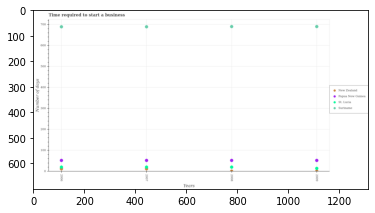

Number of QA =  29





,Years,St. Lucia,New Zealand,Papua New Guinea,Suriname
0,2008,21.448760,2.919992,54.204265,694.468454
1,2009,15.455963,2.946008,54.042194,694.390610
2,2007,13.038531,21.201586,53.978740,693.218838
3,2006,12.703416,21.593064,54.276789,693.314274


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to start a business in papua new guinea in 2006 and that in 2008 ?
PREDICTED =  0.07252482723738751
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to start a business in new zealand in 2006 and the number of days required to start a business in suriname in 2009?
PREDICTED =  20.593063539638486
EXPECTED =  -678.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the number of days required to start a business in papua new guinea and number of days required to st

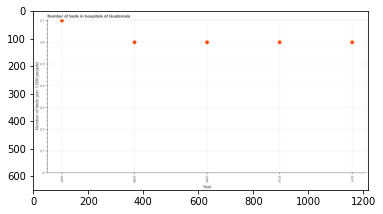

Number of QA =  24





,Year,"Number of beds (per 1,000 people)"
0,2007,0.700818
1,2010,0.601084
2,2011,0.601103
3,2008,0.601141
4,2009,0.601072


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hospital beds in 2009 and 2011 ?
PREDICTED =  -3.113003109678214e-05
EXPECTED =  0.0




				 0 / 1 = 0.0


> what is the median number of hospital beds ?
PREDICTED =  None
EXPECTED =  0.6




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of hospital beds in 2009 to that in 2011 ?
PREDICTED =  0.9999482118312074
EXPECTED =  1.0




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest number of hospital beds ?
PREDICTED =  0.0
EXPECTED =  0.09999999999999998




				 1 / 5 = 0.2


is_built_with_cuda: True
is

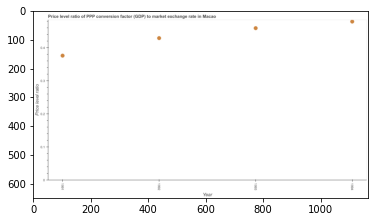

Number of QA =  24





,Year,Price level ratio
0,1991,0.377803
1,1993,0.460564
2,1992,0.430618
3,1994,0.480526


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the price level ratio in 1993 ?
PREDICTED =  0.11514093215778698
EXPECTED =  0.4591475643294321




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum price level ratio ?
PREDICTED =  0.1201315040070605
EXPECTED =  0.47907449462039




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum price level ratio ?
PREDICTED =  497.75
EXPECTED =  0.376048104238154




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the price level ratio maximum ?
PREDICTED 

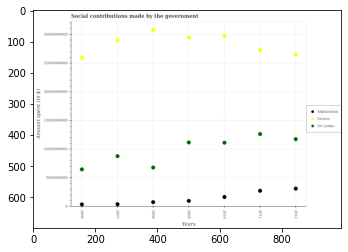

Number of QA =  28





,Years,Greece,Afghanistan,Sri Lanka
0,2012,2.663673e+10,3.227915e+09,1.186525e+10
1,2006,2.610437e+10,4.639910e+08,6.592346e+09
2,2008,3.091651e+10,8.552523e+08,6.909449e+09
3,2011,2.743416e+10,2.845946e+09,1.274999e+10
4,2009,2.961815e+10,1.093448e+09,1.128445e+10
5,2007,2.911338e+10,5.089594e+08,8.897949e+09
6,2010,2.986133e+10,1.748197e+09,1.124010e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on social contributions in greece in 2009 and that in 2011 ?
PREDICTED =  2183996997.232723
EXPECTED =  2185000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on social contributions in sri lanka in 2006 and the amount spent on social contributions in afghanistan in 2012?
PREDICTED =  3364431031.102445
EXPECTED =  3351406867.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount spent on social contributions in sri lanka and amount spent on social contributions in afghanistan ?
PREDI

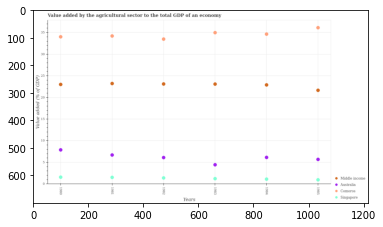

Number of QA =  29





,Years,Comoros,Australia,Middle income,Singapore
0,1984,34.497709,6.218225,22.854286,1.216264
1,1981,34.037797,6.759435,23.173766,1.612124
2,1982,33.367723,6.174109,23.051228,1.488958
3,1983,34.824950,4.510178,23.033419,1.341285
4,1985,35.969701,5.753266,21.612576,1.064248
5,1980,33.889943,7.928029,22.943025,1.645874


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector to the total gdp in australia in 1980 and that in 1983 ?
PREDICTED =  18.43284660100728
EXPECTED =  3.4413846724129806




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector to the total gdp in comoros in 1984 and the value added by the agricultural sector to the total gdp in singapore in 1983?
PREDICTED =  -0.32724124525867637
EXPECTED =  33.4077744365529




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1983, what is the difference between the value added by the agricultural sector to th

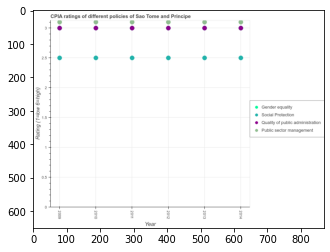

Number of QA =  29





,Year,Quality of public administration,Gender equality,Social Protection,Public sector management
0,2012,3.007874,NaN,2.506862,3.105057
1,2014,3.006967,NaN,2.506154,3.105407
2,2013,3.007511,NaN,2.508099,3.104012
3,2010,3.008074,NaN,2.507844,3.104813
4,2009,3.006423,NaN,2.506521,3.106463
5,2011,3.008640,NaN,2.506756,3.106007


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of quality of public administration in 2009 and that in 2012 ?
PREDICTED =  0.16666666666666666
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of social protection in 2010 and the cpia rating of gender equality in 2012?
PREDICTED =  0.0009817686592601405
EXPECTED =  -0.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the average cpia rating of quality of public administration per year?
PREDICTED =  335.25
EXPECTED =  3.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predictin

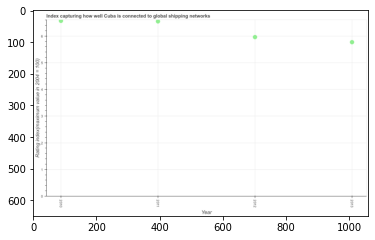

Number of QA =  24





,Year,Rating index(maximum value in 2004 = 100)
0,2013,5.814391
1,2012,6.009589
2,2010,6.619211
3,2011,6.596073


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the liner shipping connectivity index in 2012 and 2013 ?
PREDICTED =  0.1951985494647941
EXPECTED =  0.1900000000000004




				 1 / 1 = 1.0


> what is the median liner shipping connectivity index ?
PREDICTED =  None
EXPECTED =  6.255




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the liner shipping connectivity index in 2012 to that in 2013 ?
PREDICTED =  1.0335716250228377
EXPECTED =  1.0329289428076258




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest liner shipping connectivity index ?
PREDICTED =  0.70722061766174

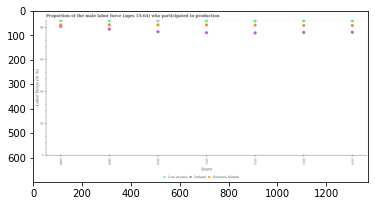

Number of QA =  28





,Years,Solomon Islands,Ireland,Low income
0,2012,81.644091,76.772823,84.442949
1,2010,81.737397,77.470169,84.437297
2,2008,81.675956,NaN,84.446607
3,2014,81.380818,77.180537,84.365742
4,2009,81.777953,79.029988,84.416177
5,2013,81.522343,77.078294,84.418859
6,2011,81.724260,76.868402,84.425391


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in ireland in 2009 and that in 2013 ?
PREDICTED =  1.9516938826291863
EXPECTED =  2.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in low income in 2014 and the proportion of the male labor force who participated in production in solomon islands in 2008?
PREDICTED =  -0.08086462902508629
EXPECTED =  2.694973743316794




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the proportion of the ma

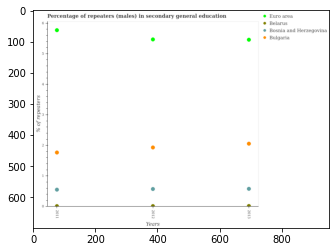

Number of QA =  29





,Years,Bulgaria,Belarus,Euro area,Bosnia and Herzegovina
0,2013,2.073469,0.033513,5.483941,0.595874
1,2012,1.950418,0.030042,5.493065,0.590376
2,2011,1.785390,0.028701,5.797937,0.568679


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male repeaters in bosnia and herzegovina in 2011 and that in 2013 ?
PREDICTED =  -0.02719475291156237
EXPECTED =  -0.02736997604370195




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male repeaters in bulgaria in 2011 and the percentage of male repeaters in belarus in 2012?
PREDICTED =  1.7553476031907094
EXPECTED =  1.7531900079920857




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of male repeaters in euro area and percentage of male repeaters in bosnia and herzegovina ?
PREDI

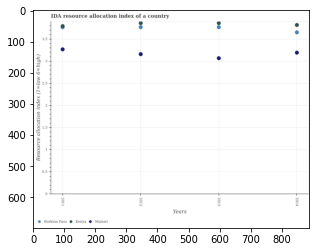

Number of QA =  28





,Years,Burkina Faso,Malawi,Kenya
0,2013,3.784876,3.084268,3.872144
1,2014,3.669019,3.208512,3.833824
2,2011,NaN,3.284449,3.803128
3,2012,3.781906,3.176187,3.875829


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in burkina faso in 2011 and that in 2013 ?
PREDICTED =  -3.784875763263423
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in kenya in 2011 and the ida resource allocation index in burkina faso in 2012?
PREDICTED =  -0.07270050342211931
EXPECTED =  0.02499999999999991




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the ida resource allocation index in burkina faso and ida resource allocation index in kenya ?
PREDICTED =  8.235800732681291
EXPECTE

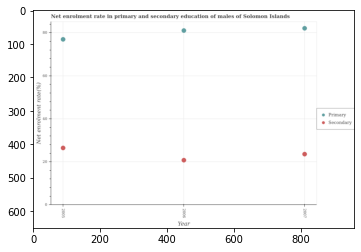

Number of QA =  27





,Year,Secondary,Primary
0,2006,20.873205,80.760390
1,2007,23.656845,81.818389
2,2005,26.497161,76.642515


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education in 2005 and that in 2007 ?
PREDICTED =  2.8403159091337358
EXPECTED =  2.870948791503899




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education in 2007 and the enrollment rate in primary education in 2006?
PREDICTED =  2.7836398383981766
EXPECTED =  -57.464958190918




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the enrollment rate in secondary education and enrollment rate in primary education ?
PREDICTED =  68.0272103623281
EXPECTED =  -60.27711868

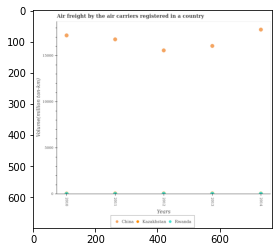

Number of QA =  28





,Years,Rwanda,China,Kazakhstan
0,2012,87.825981,15641.144510,NaN
1,2014,98.482431,17903.972423,NaN
2,2010,95.162346,17262.836487,NaN
3,2013,100.705103,16128.929663,NaN
4,2011,82.700942,16833.012284,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the volume of the air carriers in rwanda in 2011 and that in 2013 ?
PREDICTED =  -18.00416098686236
EXPECTED =  -13.5626104071305




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the volume of the air carriers in china in 2014 and the volume of the air carriers in rwanda in 2010?
PREDICTED =  641.1359366240322
EXPECTED =  17819.312505541




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the volume of the air carriers in china and volume of the air carriers in kazakhstan ?
PREDICTED =  17903.97242328983
EXPECTED =  16713.892




			

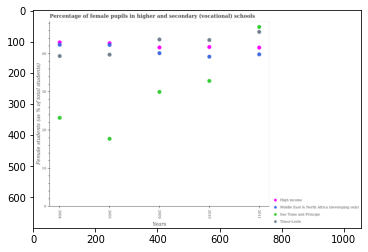

Number of QA =  29





,Years,Middle East & North Africa (developing only),Sao Tome and Principe,High income,Timor-Leste
0,2004,42.695129,23.479701,43.332127,39.747389
1,2005,43.111799,17.955032,42.633706,40.096500
2,2010,39.556280,33.168648,42.099286,43.934315
3,2009,40.478217,30.278566,42.018522,44.088498
4,2011,40.172563,47.357713,41.956934,46.060491


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in higher and secondary schools in sao tome and principe in 2009 and that in 2011 ?
PREDICTED =  1956.642287024402
EXPECTED =  -16.992481231689503




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in higher and secondary schools in sao tome and principe in 2004 and the percentage of female pupils in higher and secondary schools in middle east & north africa (developing only) in 2009?
PREDICTED =  1963.5217833749803
EXPECTED =  -16.920398712158203




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what


Image number =  284




Image:

/home/pessat/Capstone/TEST/png/1380.png


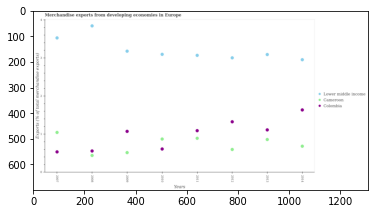

Number of QA =  28





,Years,Colombia,Lower middle income,Cameroon
0,2009,1.084911,3.193699,0.524823
1,2012,1.336851,3.019758,0.606301
2,2014,1.649898,2.969420,0.694900
3,2011,1.102808,3.083106,0.901498
4,2010,0.619645,3.111384,0.883084
5,2008,0.564564,3.860482,0.448798
6,2013,1.123066,3.105731,0.871385
7,2007,0.543310,3.543027,1.056962


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total merchandise exports in lower middle income in 2011 and that in 2012 ?
PREDICTED =  0.06334828380534985
EXPECTED =  0.06480450228248014




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total merchandise exports in lower middle income in 2013 and the percentage of total merchandise exports in cameroon in 2007?
PREDICTED =  -0.4372956900569904
EXPECTED =  2.0450719816056098




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of total merchandise exports in lower middle income and 

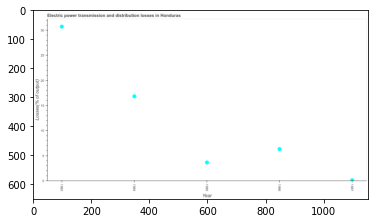

Number of QA =  24





,Year,Losses(% of output)
0,1984,17.021900
1,1983,30.960339
2,1987,0.212126
3,1985,3.796532
4,1986,6.464990


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


> what is the median electric power transmission and distribution losses ?
PREDICTED =  None
EXPECTED =  6.31364562118126




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the electric power transmission and distribution losses in 1983 to that in 1984 ?
PREDICTED =  1.8188533471759152
EXPECTED =  1.824968467521543




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest electric power transmission and distribution losses ?
PREDICTED =  1952.0396610630844
EXPECTED =  13.8876601316441




				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_availa

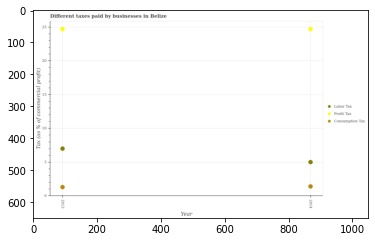

Number of QA =  24





,Year,Profit Tax,Labor Tax,Consumption Tax
0,2013,24.895233,7.125244,1.390542
1,2014,24.901440,5.095940,1.490105


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of profit tax in 2013 and that in 2014 ?
PREDICTED =  -0.006206883374453298
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor tax in 2014 and the percentage of profit tax in 2013?
PREDICTED =  -2.0293046844878466
EXPECTED =  -19.7




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the percentage of consumption tax and percentage of labor tax ?
PREDICTED =  1.440323869485956
EXPECTED =  -3.6




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training 

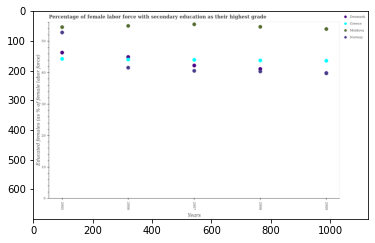

Number of QA =  29





,Years,Denmark,Moldova,Norway,Greece
0,2008,41.306273,54.661381,40.518754,43.988147
1,2006,45.112888,54.965398,41.712945,44.248868
2,2009,NaN,53.990844,39.959358,43.908352
3,2005,46.472258,54.556136,52.914863,44.529447
4,2007,42.388476,55.492698,40.707633,44.218121


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with secondary education in norway in 2005 and that in 2006 ?
PREDICTED =  11.20191789538206
EXPECTED =  11.200000762939396




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with secondary education in denmark in 2009 and the percentage of female labor force with secondary education in norway in 2008?
PREDICTED =  0.0
EXPECTED =  -0.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of female labor force with secondary education in greece and p

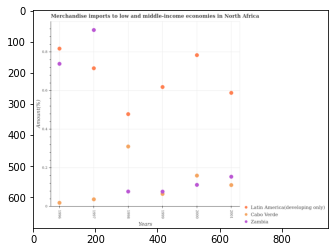

Number of QA =  28





,Years,Zambia,Latin America(developing only),Cabo Verde
0,1996,0.741621,0.820062,0.021054
1,2000,0.114150,0.786455,0.163128
2,2001,0.156835,0.590875,0.113481
3,1998,0.080218,0.481194,0.313301
4,1999,0.079347,0.620969,0.067635
5,1997,0.916511,0.718529,0.039729


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in latin america(developing only) in 1998 and that in 1999 ?
PREDICTED =  -0.13977466116125475
EXPECTED =  -0.14033115746596003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in zambia in 2001 and the percentage of amount earned from merchandise imports in latin america(developing only) in 1996?
PREDICTED =  -0.5847853406104513
EXPECTED =  -0.6634378181685979




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the perce

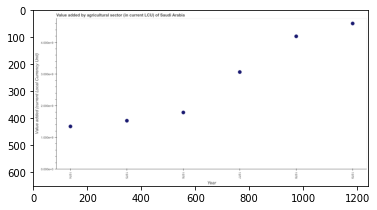

Number of QA =  24





,Year,Value added (current Local Currency Unit)
0,1975,1.557062
1,1974,1.373766
2,1976,1.818132
3,1977,3.107460
4,1978,4.243799
5,1979,4.651082


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agriculture sector in 1975 and 1978 ?
PREDICTED =  -2.686736917388405
EXPECTED =  -2667000000




				 0 / 1 = 0.0


> what is the median value added by agriculture sector ?
PREDICTED =  None
EXPECTED =  2427000000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the value added by agriculture sector in 1975 to that in 1976 ?
PREDICTED =  0.8564074857423235
EXPECTED =  0.854586129753915




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest value added by agriculture sector ?
PREDICTED =  1.5436217309869549


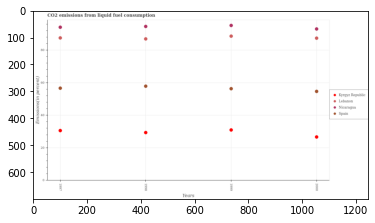

Number of QA =  29





,Years,Nicaragua,Spain,Kyrgyz Republic,Lebanon
0,1998,94.395600,57.822089,29.498250,86.705572
1,1999,94.947157,56.324496,31.038235,88.457958
2,1997,93.883840,56.589435,30.665509,87.280681
3,2000,92.827688,54.625432,26.740489,87.179913


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in spain in 1997 and that in 2000 ?
PREDICTED =  1.9640022301977709
EXPECTED =  1.9778116176509926




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in spain in 1998 and the total co2 emitted in kyrgyz republic in 2000?
PREDICTED =  3.1966562650383636
EXPECTED =  31.1986088718478




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the total co2 emitted in kyrgyz republic and total co2 emitted in spain ?
PREDICTED =  -107.41896925014704
EXPECTED =  -28.493196823998996




				 1 / 3 = 0.3333


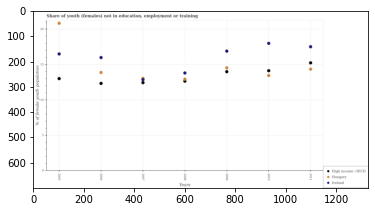

Number of QA =  28





,Years,Hungary,High income: OECD,Ireland
0,2011,14.372751,15.270596,17.546509
1,2010,13.478696,14.142461,18.027486
2,2008,12.956040,12.692349,13.845546
3,2009,14.576109,14.034526,16.924211
4,2005,20.854681,13.060537,16.515822
5,2006,13.903217,12.354707,16.012601
6,2007,NaN,12.476421,12.966622


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female population in in ireland in 2008 and that in 2011 ?
PREDICTED =  -4.579887283132779
EXPECTED =  -3.7100000381469993




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female population in in high income: oecd in 2006 and the percentage of unemployed female population in in ireland in 2007?
PREDICTED =  -0.12171407018695746
EXPECTED =  -0.5337388879321008




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of unemployed female population in in hungary and pe

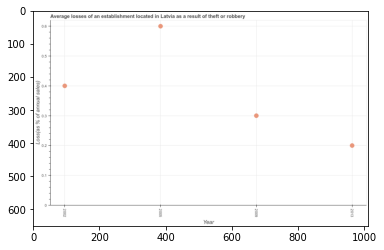

Number of QA =  24





,Year,Loss(as % of annual sales)
0,2005,0.601862
1,2013,0.201914
2,2009,0.302290
3,2002,0.402014


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the losses due to theft in 2002 and 2009 ?
PREDICTED =  0.09972460735012428
EXPECTED =  0.10000000000000003




				 1 / 1 = 1.0


> what is the median losses due to theft ?
PREDICTED =  None
EXPECTED =  0.35




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the losses due to theft in 2002 to that in 2005 ?
PREDICTED =  0.37556422164164205
EXPECTED =  0.6666666666666667




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest losses due to theft ?
PREDICTED =  0.0
EXPECTED =  0.19999999999999996




				 1 / 5 = 0.2


is_built_w

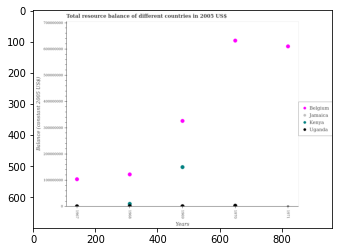

Number of QA =  27





,Years,Uganda,Jamaica,Kenya,Belgium
0,1968,2.646614e+06,NaN,1.182142e+07,1.247348e+08
1,1971,7.555475e+05,NaN,NaN,6.139823e+08
2,1970,4.591468e+06,NaN,NaN,6.358211e+08
3,1967,2.396447e+06,NaN,NaN,1.061276e+08
4,1969,3.056185e+06,NaN,1.527264e+08,3.290473e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in belgium in 1969 and that in 1970 ?
PREDICTED =  -306773823.3272529
EXPECTED =  -306072660




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in belgium in 1971 and the total resource balance in jamaica in 1968?
PREDICTED =  489247489.6649285
EXPECTED =  610052700




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1968, what is the difference between the total resource balance in uganda and total resource balance in kenya ?
PREDICTED =  13446259.714064687
EXPECTED =  -9020000.000000002




				 1 / 3 = 0.3333


is_b

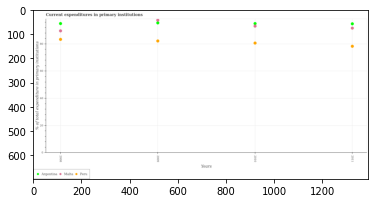

Number of QA =  28





,Years,Peru,Malta,Argentina
0,2010,81.430922,94.024310,95.897263
1,2011,79.053146,92.466535,95.618626
2,2009,82.943625,98.527577,96.352560
3,2008,84.113182,90.489376,95.852212


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in primary institutions in peru in 2008 and that in 2009 ?
PREDICTED =  1.1695567817311314
EXPECTED =  1.1728286743162926




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in primary institutions in peru in 2011 and the current expenditures in primary institutions in argentina in 2010?
PREDICTED =  -2.3777757408204536
EXPECTED =  -16.683090209960994




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the current expenditures in primary institutions in peru and current expenditures in p

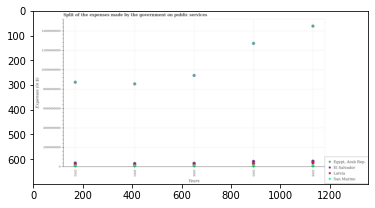

Number of QA =  29





,Years,"Egypt, Arab Rep.",Latvia,San Marino,El] Salvador
0,2004,9.464411e+09,3.889748e+08,1.558894e+08,NaN
1,2003,8.594853e+09,NaN,3.516033e+08,1.233381e+08
2,2005,1.277012e+10,3.985932e+08,1.427901e+08,5.899143e+08
3,2006,1.456287e+10,4.621694e+08,1.367974e+08,6.011326e+08
4,2002,8.771514e+09,3.031333e+08,1.259196e+08,4.136587e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenses made by the government on public services in el salvador in 2003 and that in 2004 ?
PREDICTED =  123338101.39919306
EXPECTED =  -26900000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenses made by the government on public services in latvia in 2002 and the expenses made by the government on public services in egypt, arab rep. in 2003?
PREDICTED =  303133337.9287058
EXPECTED =  -8350950000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the expenses made by the government on public services in egypt, ar

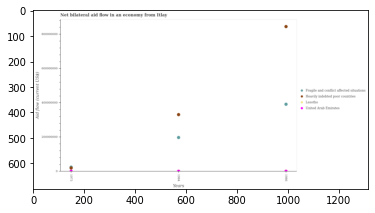

Number of QA =  29





,Years,Lesotho,Heavily indebted poor countries,United Arab Emirates,Fragile and conflict affected situations
0,1984,NaN,3.335666e+08,4.041340e+06,2.001952e+08
1,1973,NaN,2.311771e+07,2.832855e+06,NaN
2,1986,NaN,8.479603e+08,4.277817e+06,3.941549e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in heavily indebted poor countries in 1973 and that in 1984 ?
PREDICTED =  -310448882.86131704
EXPECTED =  -311590000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilateral aid flow in heavily indebted poor countries in 1973 to that in 1986?
PREDICTED =  0.02726273073434082
EXPECTED =  0.022886302553841418




				 1 / 4 = 0.25


is_built_with_cuda: Tr

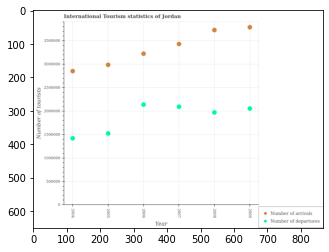

Number of QA =  27





,Year,Number of arrivals,Number of departures
0,2009,3.792006e+06,2.060311e+06
1,2004,2.857842e+06,1.428348e+06
2,2008,3.731987e+06,1.980002e+06
3,2007,3.434645e+06,2.102713e+06
4,2005,2.991715e+06,1.533636e+06
5,2006,3.230026e+06,2.146417e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist arrivals in 2005 and that in 2008 ?
PREDICTED =  -740271.2494037338
EXPECTED =  -742000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist departures in 2006 and the number of tourist arrivals in 2005?
PREDICTED =  612781.334198782
EXPECTED =  -848000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the number of tourist departures and number of tourist arrivals ?
PREDICTED =  7459421.237859586
EXPECTED =  -1086000




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False


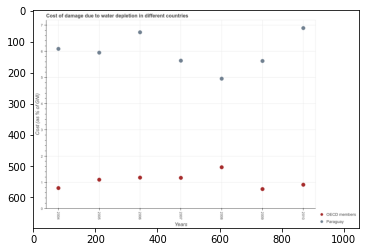

Number of QA =  27





,Years,Paraguay,OECD members
0,2008,4.990341,1.602061
1,2006,6.765486,1.206018
2,2004,6.130700,0.807854
3,2010,6.928923,0.933324
4,2007,5.681415,1.196984
5,2009,5.670251,0.767099
6,2005,5.986415,1.124761


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to water depletion in oecd members in 2006 and that in 2007 ?
PREDICTED =  1.0840716227499954
EXPECTED =  0.008763551780650136




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to water depletion in paraguay in 2007 and the cost of damage caused due to water depletion in oecd members in 2010?
PREDICTED =  -1.247507882659077
EXPECTED =  4.733974825777177




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the cost of damage caused due to water depletion in paraguay and cost of

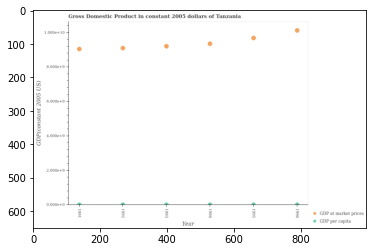

Number of QA =  27





,Year,GDP at market prices,GDP per capita
0,1992,32.140312,0.159096
1,1996,35.776473,0.158506
2,1993,32.547637,0.168988
3,1994,33.039165,0.161281
4,1995,34.239339,0.162173
5,1991,31.966768,0.141543


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at market prices in 1991 and that in 1995 ?
PREDICTED =  -2.2725709011888107
EXPECTED =  -640454622.0169792




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in 1994 and the gdp at market prices in 1993?
PREDICTED =  -0.007707358877101972
EXPECTED =  -9203284591.36678




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the gdp per capita and gdp at market prices ?
PREDICTED =  0.005241129597529703
EXPECTED =  -10121212673.965359




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []

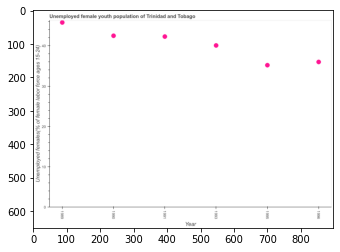

Number of QA =  24





,Year,Unemployed females(% of female labor force ages 15-24)
0,1996,35.888092
1,1995,35.091902
2,1989,45.593641
3,1993,39.968156
4,1991,42.159281
5,1990,42.355399


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth in 1990 and 1995 ?
PREDICTED =  7.263497064271931
EXPECTED =  7.299999237060497




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed female youth ?
PREDICTED =  1992.0
EXPECTED =  41.1999988555908




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed female youth in 1989 to that in 1995 ?
PREDICTED =  1.2992639066851837
EXPECTED =  1.301136313760574




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the differ

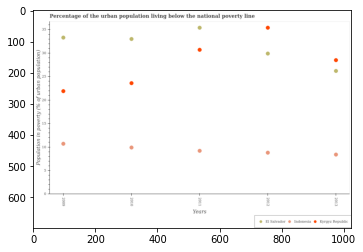

Number of QA =  28





,Years,E] Salvador,Kyrgyz Republic,Indonesia
0,2013,26.109712,28.374628,8.443301
1,2010,32.848801,23.516639,9.932106
2,2009,33.132570,21.813165,10.715180
3,2012,29.777823,35.236068,8.844701
4,2011,35.238045,30.570038,9.219843


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the urban population living below the national poverty line in kyrgyz republic in 2011 and that in 2013 ?
PREDICTED =  2.1954097234455574
EXPECTED =  2.1999999999999993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of the urban population living below the national poverty line in el salvador in 2010 to that in 2012?
PREDICTED =  0.9321970480509646
EXPECTE

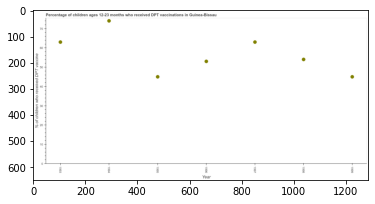

Number of QA =  24





,Year,% of children who received DPT vaccine
0,1994,75.078795
1,1999,45.736301
2,1998,54.857954
3,1995,45.747850
4,1996,53.844005
5,1993,63.992102
6,1997,63.950954


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccine in 1996 and 1999 ?
PREDICTED =  8.1077038410915
EXPECTED =  8




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of children who received dpt vaccine ?
PREDICTED =  45.7363008400663
EXPECTED =  54.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of children who received dpt vaccine in 1995 to that in 1998 ?
PREDICTED =  0.8339328452522995
EXPECTED =  0.8333333333333334




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fini

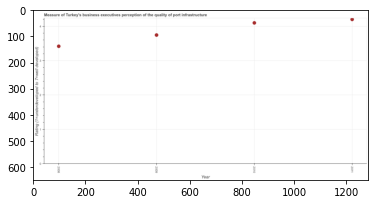

Number of QA =  24





,Year,Rating (1=underdeveloped to 7=well developed)
0,2008,3.438527
1,2010,4.122791
2,2009,3.764878
3,2011,4.222046


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating measuring quality of port infrastructure in 2010 and 2011 ?
PREDICTED =  -0.09925528679175244
EXPECTED =  -0.10140993770000062




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median rating measuring quality of port infrastructure ?
PREDICTED =  2009.5
EXPECTED =  3.9214614563




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rating measuring quality of port infrastructure in 2009 to that in 2011 ?
PREDICTED =  0.891718741314724
EXPECTED =  0.8915078215




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...


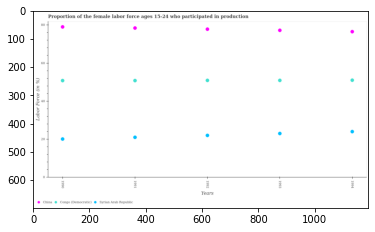

Number of QA =  28





,Years,Syrian Arab Republic,China,Congo (Democratic)
0,1994,24.121280,76.292147,50.982808
1,1990,20.218069,78.795508,50.731508
2,1991,21.136534,78.209738,50.746430
3,1992,22.112082,77.610376,50.832140
4,1993,23.126714,77.029834,50.830799


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in syrian arab republic in 1992 and that in 1993 ?
PREDICTED =  -1.014631228675409
EXPECTED =  -1.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in syrian arab republic in 1992 and the proportion of the female labor force who participated in production in congo (democratic) in 1990?
PREDICTED =  1.89401342877618
EXPECTED =  -28.799999237060497




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: 

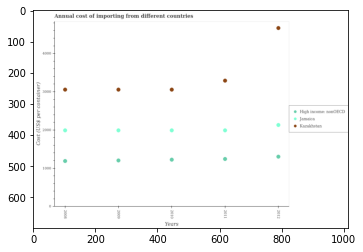

Number of QA =  28





,Years,High income: nonOECD,Kazakhstan,Jamaica
0,2010,1233.461706,3063.379144,2000.141997
1,2009,1214.093384,3063.221024,1998.912635
2,2011,1251.855267,3298.712239,1998.281645
3,2008,1199.110737,3063.215320,1998.825204
4,2012,1314.021232,4669.399812,2137.727183


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in jamaica in 2009 and that in 2012 ?
PREDICTED =  -138.81454866901936
EXPECTED =  -140




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in jamaica in 2012 and the total annual cost of importing in high income: nonoecd in 2010?
PREDICTED =  137.58518603767493
EXPECTED =  906.04




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the total annual cost of importing in jamaica and total annual cost of importing in kazakhstan ?
PREDICTED =  0.0
EXPECTED =  -1065




		

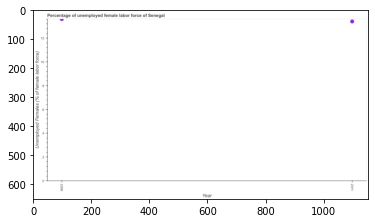

Number of QA =  20





,Year,Unemployed Females (% of female labor force)
0,2006,13.591293
1,2011,13.401429


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed female labour force in 2006 and 2011 ?
PREDICTED =  0.18986397051086001
EXPECTED =  0.20000076293939983




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed female labour force ?
PREDICTED =  2008.5
EXPECTED =  13.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total unemployed female labour force in 2006 to that in 2011 ?
PREDICTED =  1.0141674424840785
EXPECTED =  1.014925430495




				 1 / 3 = 0.3333


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Unemployed Females (% of female lab

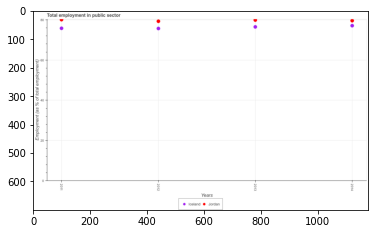

Number of QA =  27





,Years,Iceland,Jordan
0,2014,77.269015,79.749944
1,2013,76.657746,80.050633
2,2012,75.889426,79.477953
3,2011,75.943221,80.305715


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in public sector in jordan in 2011 and that in 2014 ?
PREDICTED =  0.5557715698070922
EXPECTED =  0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in public sector in jordan in 2013 and the employment in public sector in iceland in 2012?
PREDICTED =  0.5726800393012326
EXPECTED =  4.2000045776367045




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the employment in public sector in iceland and employment in public sector in jordan ?
PREDICTED =  1.5
EXPECTED =  -2.5




				 0 / 3 = 0.0


is_built

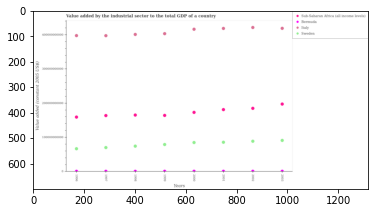

Number of QA =  29





,Years,Italy,Sub-Saharan Africa (all income levels),Bermuda,Sweden
0,1998,4.031667e+11,1.667305e+11,2.207616e+09,7.559133e+10
1,2000,4.185406e+11,1.747526e+11,2.274249e+09,8.621191e+10
2,2003,4.211817e+11,1.991190e+11,2.122141e+09,9.240737e+10
3,1999,4.055699e+11,1.658591e+11,2.255611e+09,8.042181e+10
4,1996,3.997930e+11,1.604470e+11,2.213055e+09,6.804414e+10
5,2002,4.237019e+11,1.864942e+11,2.249307e+09,8.991925e+10
6,1997,3.995581e+11,1.653039e+11,2.083226e+09,7.140726e+10
7,2001,4.208589e+11,1.828196e+11,2.241274e+09,8.696206e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in sub-saharan africa (all income levels) in 1997 and that in 2000 ?
PREDICTED =  -9448671693.548035
EXPECTED =  -9334276068.084991




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in sweden in 2003 and the value added by the industrial sector in bermuda in 1999?
PREDICTED =  11985559739.313416
EXPECTED =  90366718156.76764




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished a

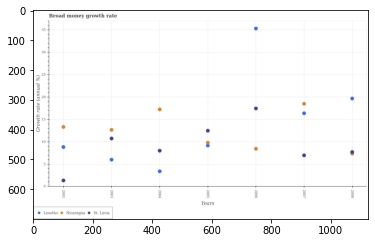

Number of QA =  28





,Years,Nicaragua,St. Lucia,Lesotho
0,2008,NaN,7.734506,19.710891
1,2003,12.709875,10.781023,6.061096
2,2006,8.505219,17.476028,35.300962
3,2004,17.270318,8.067492,3.464522
4,2005,9.852591,12.514385,9.218330
5,2002,13.359044,1.447457,8.867336
6,2007,18.528462,7.037635,16.408758


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the growth rate in nicaragua in 2003 and that in 2006 ?
PREDICTED =  4.204656413345722
EXPECTED =  4.222841301255759




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the growth rate in lesotho in 2002 and the growth rate in st. lucia in 2003?
PREDICTED =  2.8062395723539115
EXPECTED =  -1.9063776263605892




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the growth rate in lesotho and growth rate in nicaragua ?
PREDICTED =  29.300962468750704
EXPECTED =  -0.6440029800265705




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_

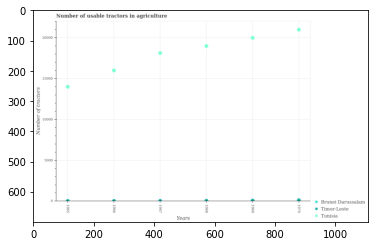

Number of QA =  28





,Years,Brunei Darussalar,Tunisia,Timor-Leste
0,1968,NaN,19020.651359,92.721632
1,1969,NaN,20008.233368,116.193631
2,1965,NaN,14039.921556,84.273384
3,1970,NaN,21021.668143,145.740457
4,1967,NaN,18157.140618,78.882329
5,1966,NaN,16035.712012,82.474106


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of usable tractors in agriculture in timor-leste in 1965 and that in 1970 ?
PREDICTED =  -61.46707287195218
EXPECTED =  -90.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of usable tractors in agriculture in timor-leste in 1970 and the number of usable tractors in agriculture in tunisia in 1965?
PREDICTED =  -13894.181098829886
EXPECTED =  -13902.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wh

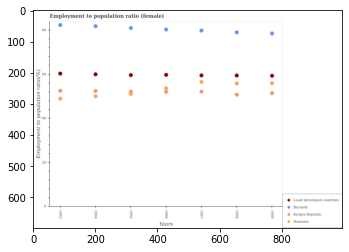

Number of QA =  29





,Years,Least developed countries,Romania,Kyrgyz Republic,Burundi
0,1996,59.845152,53.635533,52.149675,80.349598
1,1994,60.068628,50.099968,52.500372,81.835746
2,1997,59.560190,56.612770,52.219019,79.849153
3,1998,59.506174,55.898373,50.850176,79.061057
4,1993,60.360051,48.993450,52.585792,82.285506
5,1995,59.733845,51.176330,52.175376,81.044678
6,1999,59.384655,56.012550,51.527772,78.545007


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in burundi in 1993 ?
PREDICTED =  24.293464367256547
EXPECTED =  82.3000030517578




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in least developed countries ?
PREDICTED =  33.11793081550886
EXPECTED =  60.2832038268781




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in burundi ?
PREDICTED =  1.0
EXPECTED =  78.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 

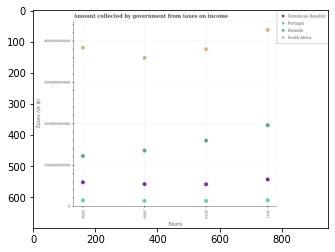

Number of QA =  29





,Years,Portugal,South Africa,Dominican Republic,Rwanda
0,2008,1.613542e+10,3.840702e+11,5.968408e+10,1.230795e+11
1,2009,1.478429e+10,3.600490e+11,5.541499e+10,1.362699e+11
2,2010,1.490156e+10,3.807093e+11,5.489803e+10,1.602983e+11
3,2011,1.621481e+10,4.273179e+11,6.632058e+10,1.976441e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by government from taxes on income in south africa in 2008 and that in 2011 ?
PREDICTED =  -43247709480.65735
EXPECTED =  -43100730530.47998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by government from taxes on income in dominican republic in 2008 and the amount collected by government from taxes on income in south africa in 2010?
PREDICTED =  4786045305.82663
EXPECTED =  -321406571709.07996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the amount collected by government from tax

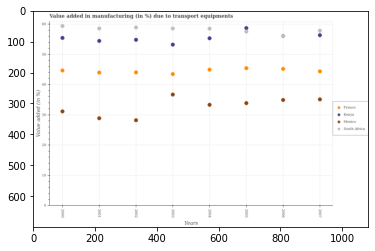

Number of QA =  29





,Years,France,Unnamed: 2,South Africa,Mexico
0,2004,44.908055,55.227856,58.430291,33.341509
1,2006,45.152902,NaN,56.060485,34.911868
2,2005,45.409579,58.603619,57.463385,33.889359
3,2001,43.936509,54.371992,58.451670,28.864896
4,2002,43.996340,54.715882,58.795914,28.252618
5,2000,44.627779,55.367074,59.259735,31.142014
6,2003,43.455743,53.151854,58.473065,36.730422
7,2007,44.352821,56.243032,57.713388,35.085671


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in south africa in 2002 and that in 2003 ?
PREDICTED =  0.3228493825722438
EXPECTED =  0.3467987690289007




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in mexico in 2001 and the percentage of value added in manufacturing due to transport equipments in kenya in 2007?
PREDICTED =  27.86489597823196
EXPECTED =  -27.4711553067963




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the pe

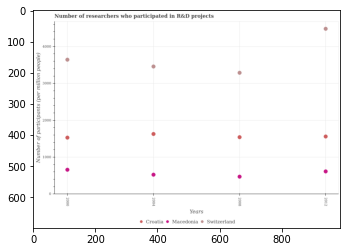

Number of QA =  28





,Years,Macedonia,Switzerland,Croatia
0,2000,674.762214,3664.839594,1546.978208
1,2012,628.773179,4507.730385,1578.713818
2,2004,540.012623,3481.022837,1645.561903
3,2008,486.552973,3311.256084,1560.412263


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of researchers who participated in r&d projects in croatia in 2004 and that in 2012 ?
PREDICTED =  66.84808482680205
EXPECTED =  68.20164999999997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of researchers who participated in r&d projects in switzerland in 2004 and the number of researchers who participated in r&d projects in macedonia in 2012?
PREDICTED =  -1026.7075479485934
EXPECTED =  2844.73427




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the number of researchers who participated in r&d project

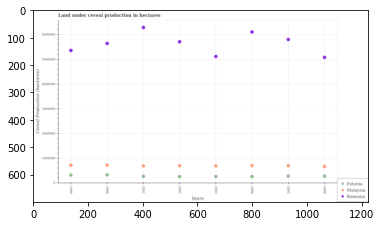

Number of QA =  28





,Years,Estonia,Romania,Malaysia
0,1999,334376.473988,5.330702e+06,730450.969893
1,2001,286751.308330,6.252002e+06,706174.638499
2,2005,296816.195798,5.769720e+06,710635.282264
3,2004,273974.397774,6.069192e+06,712147.666335
4,2000,339571.665953,5.609751e+06,734535.447131
5,2006,296263.187378,5.054700e+06,679972.173408
6,2003,275629.060710,5.089235e+06,705132.378698
7,2002,273153.945355,5.680007e+06,711099.030830


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the land under cereal production in estonia in 1999 and that in 2003 ?
PREDICTED =  58747.41327836801
EXPECTED =  57834.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the land under cereal production in estonia in 2006 and the land under cereal production in romania in 2003?
PREDICTED =  20634.126668038196
EXPECTED =  -4836449.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the land under cereal production in romania and land under cereal production in estonia ?
PREDICTED =  4757632.77665469
EXPECTED =  5314097.0




				 1

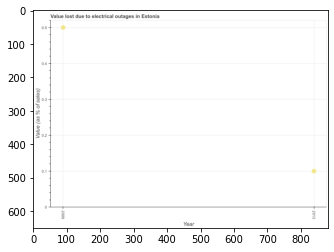

Number of QA =  20





,Year,Value (as % of sales)
0,2013,0.101851
1,2009,0.501956


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value lost due to electrical outages in 2009 and 2013 ?
PREDICTED =  0.40010505182627437
EXPECTED =  0.4




				 1 / 1 = 1.0


> what is the median value lost due to electrical outages ?
PREDICTED =  None
EXPECTED =  0.3




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Value (as % of sales)
EXPECTED =  0.1




				 1 / 5 = 0.2


> what is the title of the graph ?
PREDICTED =  Value lost due to electrical outages in Estonia
EXPECTED =  Value lost due to electrical outages in Estonia




				 2 / 6 = 0.3333


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 7

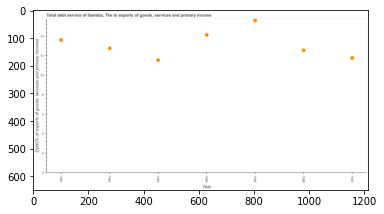

Number of QA =  24





,Year,"Debt(% of exports of goods, services and primary income)"
0,1993,11.656569
1,1996,12.660192
2,1994,14.258927
3,1997,11.880404
4,1995,15.746934
5,1992,12.869001
6,1991,13.735595


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in 1992 and 1995 ?
PREDICTED =  -2.8779327885124317
EXPECTED =  -2.852446336647601




				 1 / 1 = 1.0


> what is the median total debt service ?
PREDICTED =  None
EXPECTED =  12.7473706625892




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total debt service in 1992 to that in 1993 ?
PREDICTED =  1.1040128298728051
EXPECTED =  1.1044918305084304




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest total debt service ?
PREDICTED =  0.0
EXPECTED =  1.4740912277587999




				 2 / 5 = 0.4


is_bui

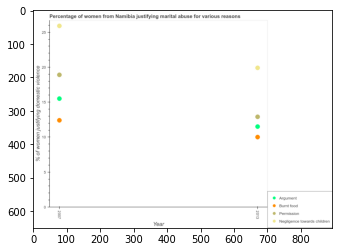

Number of QA =  25





,Year,Permission,Negligence towards children,Argument,Burnt food
0,2013,13.025963,20.049958,11.631925,10.120964
1,2007,19.049243,26.066926,15.649225,12.531663


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying abuse for showing negligence towards children in 2007 and that in 2013 ?
PREDICTED =  6.0169679527144915
EXPECTED =  6.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying abuse for showing negligence towards children in 2007 and the percentage of women justifying abuse for burning food in 2013?
PREDICTED =  6.0169679527144915
EXPECTED =  15.899999999999999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of women justifying abuse for burning food a

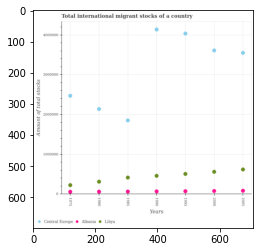

Number of QA =  28





,Years,Libya,Albania,Central Europe
0,1975,240813.289056,70210.974358,2.497395e+06
1,1990,475303.754909,81979.452206,4.176793e+06
2,1985,431910.106325,80203.005642,1.876121e+06
3,1995,523448.773221,85232.185465,4.073224e+06
4,1980,325172.631728,71383.496380,2.161430e+06
5,2000,578010.820235,92531.429445,3.646343e+06
6,2005,637123.569648,98362.076975,3.584466e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of total stocks in in albania in 1980 and that in 2005 ?
PREDICTED =  -26978.58059528323
EXPECTED =  -22938




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of total stocks in in libya in 1995 and the amount of total stocks in in central europe in 2000?
PREDICTED =  -578009.8202346085
EXPECTED =  -3104037




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the amount of total stocks in in libya and amount of total stocks in in albania ?
PREDICTED =  0.0
EXPECTED =  166582




				 0 / 3 = 0.0


is_built_with_cud

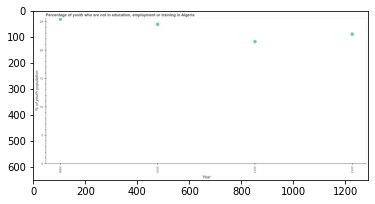

Number of QA =  24





,Year,% of youth population
0,2009,25.414265
1,2013,21.454163
2,2014,22.758766
3,2010,24.474983


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed youth population in 2010 and 2014 ?
PREDICTED =  1.7162162334591748
EXPECTED =  1.730001449585




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed youth population ?
PREDICTED =  2011.5
EXPECTED =  23.664999961853




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed youth population in 2009 to that in 2013 ?
PREDICTED =  1.1845842991042106
EXPECTED =  1.1837209657181162




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is 

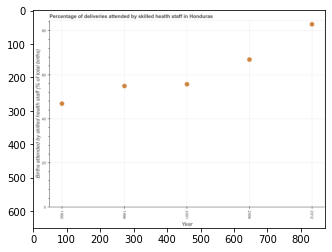

Number of QA =  24





,Year,Births attended by skilled health staff (% of total births)
0,2006,67.034447
1,1992,47.085048
2,1996,55.042675
3,2012,82.919771
4,2001,55.798979


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of births attended by skilled health staff in 1996 and 2006 ?
PREDICTED =  -11.991771620117888
EXPECTED =  -12.000000000000007




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of births attended by skilled health staff ?
PREDICTED =  2001.0
EXPECTED =  55.7




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of births attended by skilled health staff in 1996 to that in 2012 ?
PREDICTED =  0.663806406643713
EXPECTED =  0.6622436670687575




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ..

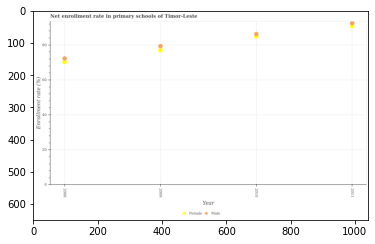

Number of QA =  27





,Year,Male,Female
0,2009,79.866158,77.450554
1,2010,85.465708,86.705405
2,2011,92.876368,91.402440
3,2008,72.659394,70.694422


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of female students in 2009 and that in 2011 ?
PREDICTED =  -13.951886148001947
EXPECTED =  -13.892082214355497




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of male students in 2011 and the enrollment rate of female students in 2009?
PREDICTED =  13.010210084296446
EXPECTED =  15.481277465820284




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the enrollment rate of female students and enrollment rate of male students ?
PREDICTED =  0.0
EXPECTED =  -1.3045654296875




				 1 / 3 = 0.3333

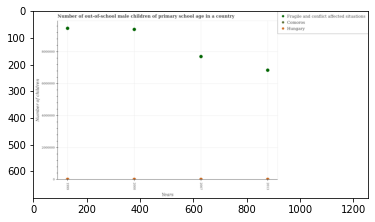

Number of QA =  28





,Years,Hungary,Comoros,Fragile and conflict affected situations
0,2013,27759.975360,NaN,6.897206e+06
1,1999,38783.540461,NaN,9.532231e+06
2,2007,36697.515928,NaN,7.758035e+06
3,2000,36263.589998,NaN,9.461318e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school male children in comoros in 1999 and that in 2007 ?
PREDICTED =  2086.0245332282866
EXPECTED =  4021.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school male children in comoros in 2013 and the number of out-of-school male children in hungary in 2000?
PREDICTED =  -8503.614638896433
EXPECTED =  -309.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the number of out-of-school male children in comoros and number of out-of-school male children in fragile and conflict affected s

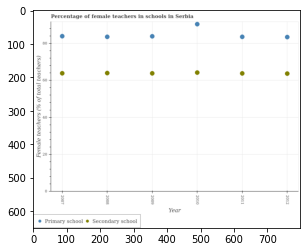

Number of QA =  27





,Year,Secondary school,Primary school
0,2009,64.145527,84.255616
1,2007,64.193998,84.296116
2,2011,64.171945,84.000866
3,2008,64.313739,83.957134
4,2012,64.057035,83.865439
5,2010,64.616447,90.868851


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in primary schools in 2008 and that in 2009 ?
PREDICTED =  -0.29848195688600754
EXPECTED =  -0.28484344482420454




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in primary schools in 2011 and the percentage of female teachers in secondary schools in 2012?
PREDICTED =  0.13542751967386835
EXPECTED =  19.86141967773441




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of female teachers in primary schools and percentage of female teachers in secondary

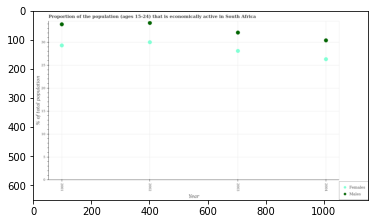

Number of QA =  27





,Year,Males,Females
0,2003,32.233170,28.241702
1,2002,34.317495,30.121766
2,2001,34.003731,29.431970
3,2004,30.530292,26.415103


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in 2001 and that in 2003 ?
PREDICTED =  1.7705610881991873
EXPECTED =  1.8000030517577983




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in 2002 and the percentage of economically active female population in 2004?
PREDICTED =  3.7872030433921964
EXPECTED =  7.900001525879002




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of economically active male population and percentage of economically active female po

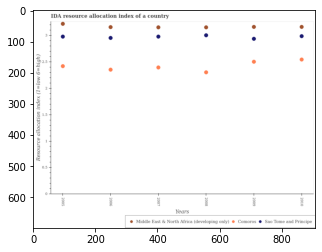

Number of QA =  28





,Years,Comoros,Middle East & North Africa (developing only),Sao Tome and Principe
0,2008,2.307563,3.158483,3.007081
1,2010,2.550097,3.166098,2.991796
2,2009,2.508501,3.166537,2.941329
3,2006,2.358500,3.162989,2.958325
4,2005,2.424208,3.223317,2.982671
5,2007,2.399946,3.159198,2.983012


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in middle east & north africa (developing only) in 2007 and that in 2008 ?
PREDICTED =  0.0007153431037165703
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in middle east & north africa (developing only) in 2007 and the ida resource allocation index in sao tome and principe in 2008?
PREDICTED =  0.0007153431037165703
EXPECTED =  0.1499999999999999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the ida resource allocation index in sao tome and 

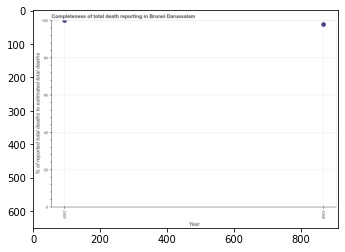

Number of QA =  20





,Year,% of reported total deaths to estimated total deaths
0,2007,100.691010
1,2008,98.527874


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completeness of total death reports in 2007 and 2008 ?
PREDICTED =  2.163135757613503
EXPECTED =  2.1524663677000007




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median completeness of total death reports ?
PREDICTED =  2007.5
EXPECTED =  98.92376681614999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the completeness of total death reports in 2007 to that in 2008 ?
PREDICTED =  1.0219545562916832
EXPECTED =  1.021998166819296




				 2 / 3 = 0.6667


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  % of reported total death

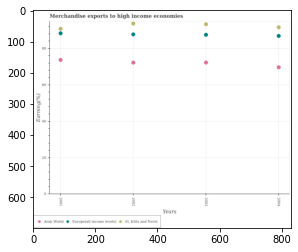

Number of QA =  28





,Years,Arab World,Europe(all income levels),St. Kitts and Nevis
0,2002,72.440066,87.889682,93.852973
1,2004,69.848048,87.091859,91.850611
2,2001,73.879944,88.580830,90.919840
3,2003,72.471887,87.661509,93.474463


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in arab world in 2003 and that in 2004 ?
PREDICTED =  2.6238393343173527
EXPECTED =  2.6225082771951946




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in arab world in 2004 and the percentage of amount earned from merchandise exports in st. kitts and nevis in 2002?
PREDICTED =  -2.5920179430913635
EXPECTED =  -24.029900978528588




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of amount earned from mer

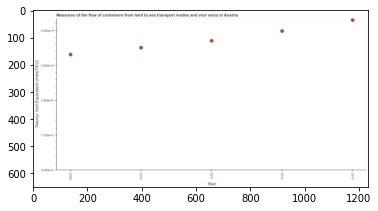

Number of QA =  24





,Year,Twenty- foot Equivalent Units(TEU)
0,2013,4.314586
1,2009,3.326626
2,2011,3.722946
3,2010,3.522159
4,2012,4.001574


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in 2010 and 2013 ?
PREDICTED =  -0.7924269728249298
EXPECTED =  -79218.45852422499




				 0 / 1 = 0.0


> what is the median container port traffic ?
PREDICTED =  None
EXPECTED =  370437.277




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the container port traffic in 2009 to that in 2012 ?
PREDICTED =  0.8313293939481267
EXPECTED =  0.8311883191149366




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest container port traffic ?
PREDICTED =  0.0
EXPECTED =  31459.38574922498




				 1 / 5 = 0.2



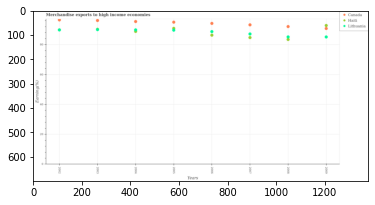

Number of QA =  28





,Years,Lithuania,Haiti,Canada
0,2004,88.720842,89.632085,95.249108
1,2005,89.497435,90.685103,94.776916
2,2006,88.447429,86.086061,93.983244
3,2003,89.923475,NaN,95.837030
4,2008,84.951697,83.271021,91.891821
5,2009,84.941895,92.575621,90.621177
6,2002,89.632017,NaN,96.263377
7,2007,86.949872,84.519437,92.997415


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in canada in 2004 and that in 2008 ?
PREDICTED =  3.3572863655268748
EXPECTED =  3.373952188320999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in lithuania in 2003 and the percentage of amount earned from merchandise exports in haiti in 2009?
PREDICTED =  -2.652145644822241
EXPECTED =  -2.7611187080114092




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of amount earned from merchandise exports in c

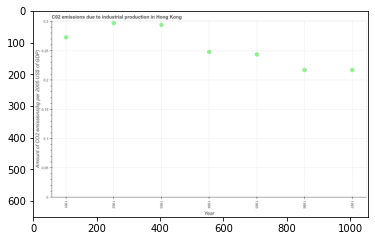

Number of QA =  24





,Year,Amount of CO2 emissions(kg per 2005 US$ of GDP)
0,1995,0.243214
1,1993,0.293395
2,1992,0.296602
3,1994,0.247908
4,1996,0.216905
5,1997,0.216939
6,1991,0.272455


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions in 1992 and 1994 ?
PREDICTED =  0.04869402818950769
EXPECTED =  0.049041631835684024




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of co2 emissions ?
PREDICTED =  0.2479084332375956
EXPECTED =  0.248036411737916




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of co2 emissions in 1994 to that in 1997 ?
PREDICTED =  1.1427563383247832
EXPECTED =  1.1426955865815007




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wh

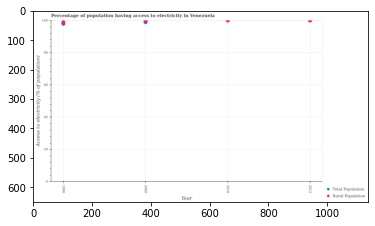

Number of QA =  27





,Year,Total Population,Rural Population
0,1990,99.448834,98.557077
1,2000,NaN,100.109507
2,2012,NaN,100.471027
3,2010,NaN,100.532645


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2000 and that in 2012 ?
PREDICTED =  -0.36152058652834285
EXPECTED =  -0.20000000000000284




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2010 and the percentage of population having access to electricity in 1990?
PREDICTED =  1.9755684232792419
EXPECTED =  2.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of rural population having access to electricity and percentage of populat

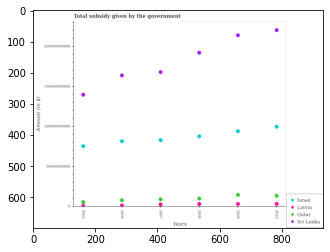

Number of QA =  29





,Years,Israel,Qatar,Sri Lanka,Latvia
0,2008,8.800478e+10,1.058460e+10,1.920213e+11,3.823755e+09
1,2006,8.178385e+10,8.348641e+09,1.637341e+11,1.739850e+09
2,2005,7.557631e+10,6.099905e+09,1.396708e+11,1.642101e+09
3,2009,9.425187e+10,1.516152e+10,2.136707e+11,3.863150e+09
4,2010,9.991863e+10,1.402826e+10,2.200683e+11,3.965937e+09
5,2007,8.313141e+10,9.464790e+09,1.679470e+11,3.222039e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue collected by the government in qatar in 2005 and that in 2007 ?
PREDICTED =  -3364884248.1332483
EXPECTED =  -3409319875.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue collected by the government in qatar in 2009 and the total revenue collected by the government in sri lanka in 2008?
PREDICTED =  4576912924.01667
EXPECTED =  -177605874482.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total revenue collected by the government in israel and total revenue collected by the government in

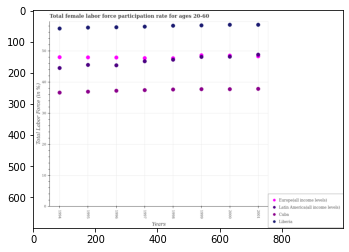

Number of QA =  29





,Years,Cuba,Europe(all income levels),Libenia,Latin America(all income levels)
0,1996,37.356894,48.048242,57.736268,45.561523
1,1998,37.753600,NaN,58.258388,47.308704
2,1999,37.857647,48.670152,58.339457,48.201930
3,1997,37.538913,47.826307,57.939846,46.815963
4,1994,36.752918,48.124248,57.339929,44.681913
5,1995,37.077095,48.087639,57.632759,45.636967
6,2001,37.938463,NaN,58.545409,48.910002
7,2000,37.850584,NaN,58.547160,48.280579


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in latin america(all income levels) in 1997 and that in 1998 ?
PREDICTED =  -0.4927404797676971
EXPECTED =  -0.5072204737825956




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in liberia in 1994 and the female labor force participation rate in cuba in 2000?
PREDICTED =  -1.0976656322137401
EXPECTED =  19.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the female labor force participation rate in latin america(all income levels) and female labor

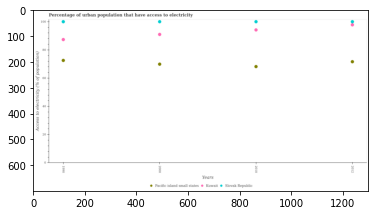

Number of QA =  28





,Years,Kuwait,Slovak Republic,Pacific island small states
0,1990,87.735034,100.326243,72.937459
1,2010,94.621282,100.375130,68.584283
2,2012,98.194405,100.343987,72.043543
3,2000,91.371132,100.389100,70.299681


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population that have access to electricity in pacific island small states in 1990 and that in 2000 ?
PREDICTED =  2.6377772824166925
EXPECTED =  2.655769054138702




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the percentage of urban population that have access to electricity in pacific island small states and percentage of urban population that have access to electricity in kuwait ?
PREDICTED =  -24.39618018722409
EXPECTED =  -14.781461758931599




				 1 / 3 = 0.3333


is_built_with_cuda:

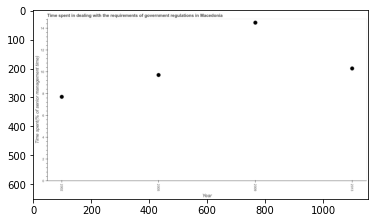

Number of QA =  24





,Year,Time spent(% of senior management time)
0,2005,9.747100
1,2009,14.546577
2,2002,7.744335
3,2013,10.347989


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time spent in dealing with government regulations in 2009 and 2013 ?
PREDICTED =  4.19858749920278
EXPECTED =  4.199999999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median time spent in dealing with government regulations ?
PREDICTED =  2007.0
EXPECTED =  10.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the time spent in dealing with government regulations in 2009 to that in 2013 ?
PREDICTED =  1.4057394600615793
EXPECTED =  1.407766990291262




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Eva

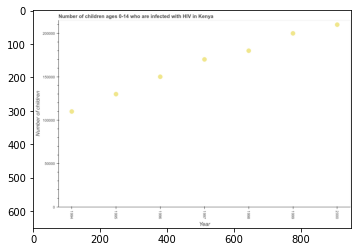

Number of QA =  24





,Year,Number of children
0,1996,150247.706504
1,1995,130274.487989
2,1999,200019.532234
3,1998,180106.483919
4,1994,110413.804027
5,1997,170154.703011
6,2000,209918.925305


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of children living with hiv in 1995 and 1999 ?
PREDICTED =  -69745.04424431814
EXPECTED =  -70000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of children living with hiv ?
PREDICTED =  170154.70301089814
EXPECTED =  170000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of children living with hiv in 1994 to that in 1999 ?
PREDICTED =  0.5520151096948066
EXPECTED =  0.55




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is

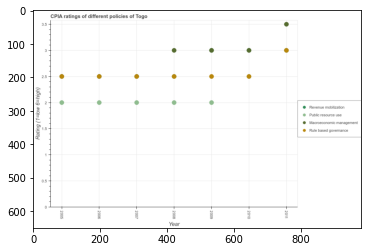

Number of QA =  29





,Year,Macroeconomic management,Revenue mobilization,Rule based governance,Public resource use
0,2010,3.012564,NaN,2.513231,NaN
1,2006,NaN,NaN,2.514119,2.012385
2,2008,3.013384,NaN,2.513703,2.012482
3,2005,NaN,NaN,2.514225,2.011942
4,2009,3.014067,NaN,2.514103,2.013305
5,2011,3.512264,NaN,3.013934,NaN
6,2007,NaN,NaN,2.514217,2.012312


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of rule based governance in 2007 and that in 2009 ?
PREDICTED =  0.0001134512960421219
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of public resource use in 2007 and the cpia rating of revenue mobilization in 2006?
PREDICTED =  -7.393455247717284e-05
EXPECTED =  -0.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating of revenue mobilization 

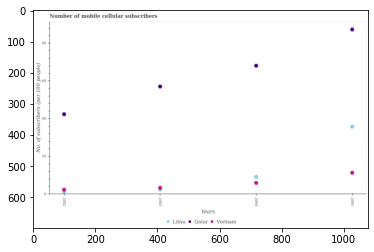

Number of QA =  28





,Years,Vietnam,Libya,Qatar
0,2002,2.459595,1.359782,42.612212
1,2003,2.629422,3.541227,57.371999
2,2004,6.096952,9.366662,68.398982
3,2005,11.561048,36.069123,87.696247


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in qatar in 2002 and that in 2003 ?
PREDICTED =  -14.75978680872182
EXPECTED =  -14.679240567195592




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in libya in 2003 and the number of mobile cellular subscribers in qatar in 2005?
PREDICTED =  2.54122661794608
EXPECTED =  -84.9447048257023




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the number of mobile cellular subscribers in libya and number of mobile cellular subscribers in vietnam ?
PREDICT

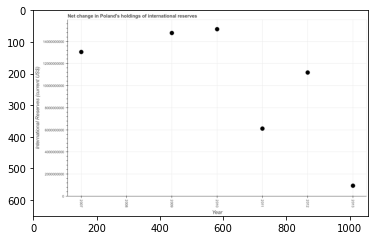

Number of QA =  22





,Year,international Reserves (current US$)
0,2008,NaN
1,2009,1.500011e+10
2,2010,1.535398e+10
3,2013,1.020289e+09
4,2012,1.138787e+10
5,2011,6.242484e+09
6,2007,1.325587e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the reserves and related items in 2011 and 2013 ?
PREDICTED =  3113994083.02584
EXPECTED =  5168010376.4




				 0 / 1 = 0.0


> what is the median reserves and related items ?
PREDICTED =  None
EXPECTED =  11185757136.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the reserves and related items in 2009 to that in 2012 ?
PREDICTED =  1.3172004676388511
EXPECTED =  1.3196447303949403




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest reserves and related items ?
PREDICTED =  0.0
EXPECTED =  345143868.0




				 1 / 5 = 0

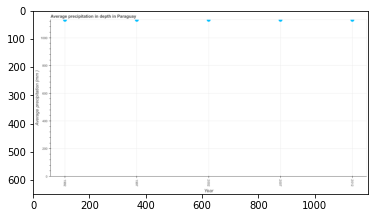

Number of QA =  24





,Year,Average precipitation (mm )
0,2012,1139.269577
1,1997,1139.927472
2,2002,1139.412350
3,2007,1139.436779
4,1992,1139.115653


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average precipitation in depth in 1992 and 2002 ?
PREDICTED =  -0.29669688865806165
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median average precipitation in depth ?
PREDICTED =  1139.4123502763175
EXPECTED =  1130.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the average precipitation in depth in 1992 to that in 2002 ?
PREDICTED =  0.9997396053425381
EXPECTED =  1.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference

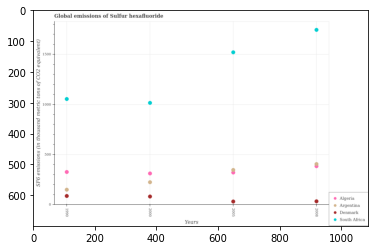

Number of QA =  29





,Years,Unnamed: 1,South Africa,Denmark,Algeria
0,1990,152.943390,1054.090119,91.002493,328.758359
1,2000,227.575605,1016.213466,85.443283,315.031236
2,2008,408.975483,1741.803346,37.411038,386.313377
3,2005,348.411025,1518.375370,36.177509,324.094992


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the global emissions of sulfur hexafluoride in algeria in 2000 and that in 2005 ?
PREDICTED =  -9.06375650320905
EXPECTED =  -9.200000000000045




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the global emissions of sulfur hexafluoride in algeria in 1990 and the global emissions of sulfur hexafluoride in argentina in 2008?
PREDICTED =  -57.55501762922415
EXPECTED =  -79.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the global emissions of sulfur hexafluoride in denmark and global emissions of sulfur hexafluoride in south afr

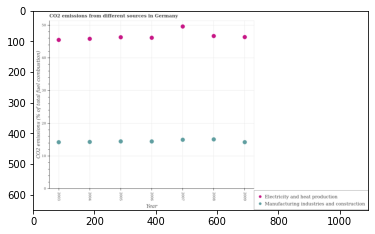

Number of QA =  27





,Year,Manufacturing industries and construction,Electricity and heat production
0,2005,14.693129,46.635581
1,2006,14.694263,46.537302
2,2008,15.322740,47.030131
3,2003,14.429072,45.851551
4,2009,14.460046,46.712401
5,2004,14.542407,46.163403
6,2007,15.203321,49.959212


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions due to electricity and heat production in 2008 and that in 2009 ?
PREDICTED =  0.11295999777604493
EXPECTED =  0.3179643140607098




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions due to manufacturing industries in 2006 and the co2 emissions due to electricity and heat production in 2009?
PREDICTED =  0.23421623724190255
EXPECTED =  -31.902112657367503




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the co2 emissions due to manufacturing industries and co2 emissions due to electricity and heat p

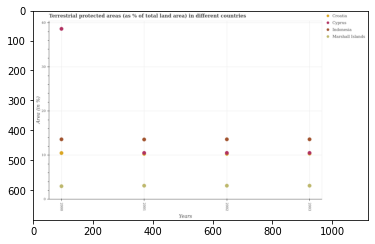

Number of QA =  29





,Years,Croatia,Marshall Islands,Cyprus,Indonesia
0,2001,NaN,3.204993,10.576297,13.677249
1,2003,NaN,3.206803,10.574631,13.708987
2,2002,NaN,3.202688,10.575539,13.703199
3,2000,10.601488,3.088572,38.764202,13.696147


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of terrestrial protected land in croatia in 2000 and that in 2003 ?
PREDICTED =  0.0
EXPECTED =  0.12803371144649844




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of terrestrial protected land in cyprus in 2002 and the percentage of terrestrial protected land in croatia in 2001?
PREDICTED =  -0.0007584203463331107
EXPECTED =  0.21453311275559983




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of terrestrial protected land in cyprus and percentage of terrestrial protected land in ind

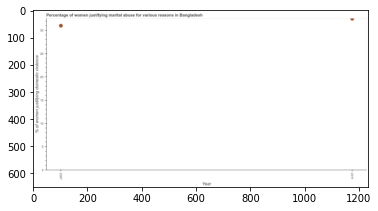

Number of QA =  20





,Year,% of women justifying domestic violence
0,2007,30.962860
1,2011,32.442136


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying marital abuse in 2007 and 2011 ?
PREDICTED =  -1.4792763148543244
EXPECTED =  -1.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of women justifying marital abuse ?
PREDICTED =  2009.0
EXPECTED =  31.75




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of women justifying marital abuse in 2007 to that in 2011 ?
PREDICTED =  0.954402623325121
EXPECTED =  0.9538461538461539




				 2 / 3 = 0.6667


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  % of women justifying 

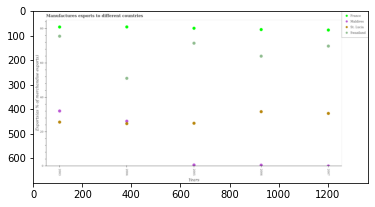

Number of QA =  29





,Years,Swaziland,St. Lucia,France,Maldives
0,2005,71.634309,25.038665,80.327765,0.802819
1,2007,69.947510,30.804426,79.265912,0.287428
2,2006,64.082375,31.820425,79.590233,0.647186
3,2003,75.699553,25.702324,81.008914,32.192283
4,2004,51.182656,24.891525,81.075742,26.259971


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in maldives in 2005 and that in 2006 ?
PREDICTED =  0.8028194688461612
EXPECTED =  0.09661844576039996




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in swaziland in 2005 and the percentage of exports to different countries in st. lucia in 2007?
PREDICTED =  1.6867986789059017
EXPECTED =  40.85799610706079




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of exports to different countries in swaziland and percentage of

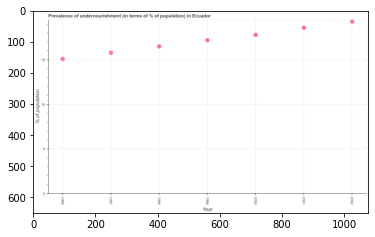

Number of QA =  24





,Year,% of population
0,1998,16.537167
1,1999,17.226859
2,1996,15.121623
3,1997,15.830367
4,2000,17.826662
5,2001,18.634684
6,2002,19.322180


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in 1996 and 1999 ?
PREDICTED =  -2.1052358804944067
EXPECTED =  -2.0999999999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of undernourished population ?
PREDICTED =  17.22685911737382
EXPECTED =  17.2




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of undernourished population in 1997 to that in 2002 ?
PREDICTED =  0.819284738753292
EXPECTED =  0.8186528497409327




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished 

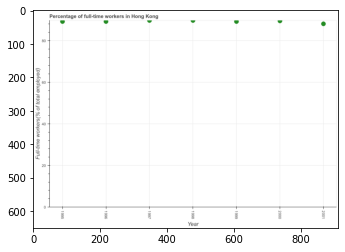

Number of QA =  24





,Year,Full-time workers(% of total employed)
0,1996,89.611122
1,1999,89.633054
2,1998,90.042609
3,1995,89.592084
4,1997,90.093057
5,2000,89.882867
6,2001,88.508245


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in 1997 and 1999 ?
PREDICTED =  0.46000269636407154
EXPECTED =  0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of full-time workers ?
PREDICTED =  88.50824535385959
EXPECTED =  89.1999969482422




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of full-time workers in 1995 to that in 1997 ?
PREDICTED =  0.9944393801864969
EXPECTED =  0.994425863801439




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.




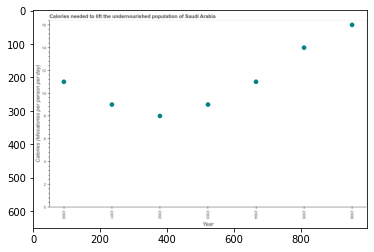

Number of QA =  24





,Year,Calories (kilocafories per person per day)
0,2006,16.035974
1,2005,14.048767
2,2003,9.050012
3,2001,9.049169
4,2002,8.044749
5,2004,11.047162
6,2000,11.046424


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the depth of food deficit in 2003 and 2004 ?
PREDICTED =  -1.99714906533975
EXPECTED =  -2




				 1 / 1 = 1.0


> what is the median depth of food deficit ?
PREDICTED =  None
EXPECTED =  11.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the depth of food deficit in 2004 to that in 2005 ?
PREDICTED =  0.7863438482996582
EXPECTED =  0.7857142857142857




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest depth of food deficit ?
PREDICTED =  0.0
EXPECTED =  2




				 2 / 5 = 0.4


is_built_with_cuda: True
is_gpu_available

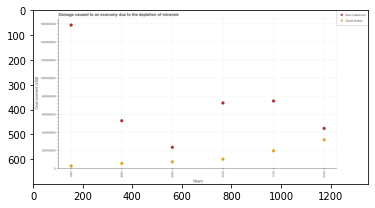

Number of QA =  27





,Years,Saudi Arabia,New Caledonia
0,2007,3.307133e+07,1.586589e+09
1,2009,7.978143e+07,2.397257e+08
2,2012,3.212231e+08,4.464275e+08
3,2010,1.080225e+08,7.281366e+08
4,2008,6.160019e+07,5.317617e+08
5,2011,2.008007e+08,7.496873e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in new caledonia in 2007 and that in 2010 ?
PREDICTED =  858452308.630943
EXPECTED =  862434229.2726041




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in saudi arabia in 2011 and the cost of damage caused due to the depletion of minerals in new caledonia in 2007?
PREDICTED =  167729382.48917854
EXPECTED =  -1392228198.154459




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the cost of damage caused due to the dep

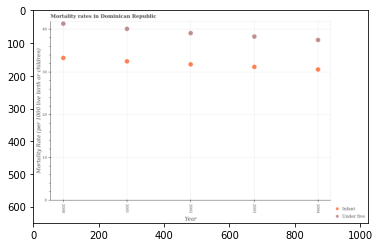

Number of QA =  27





,Year,Infant,Under five
0,2003,31.209325,38.276870
1,2001,32.492665,40.062157
2,2000,33.286418,41.258973
3,2004,30.616790,37.474716
4,2002,31.800492,39.084928


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 mortality rate in 2001 and that in 2004 ?
PREDICTED =  2.587440420834838
EXPECTED =  2.6000000000000014




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in 2000 and the under-5 mortality rate in 2004?
PREDICTED =  -4.188298752893132
EXPECTED =  -4.200000000000003




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the infant mortality rate and under-5 mortality rate ?
PREDICTED =  0.0
EXPECTED =  -7.600000000000001




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: [

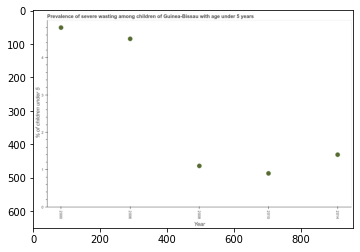

Number of QA =  24





,Year,% of children under 5
0,2006,4.503806
1,2008,1.114228
2,2000,4.805571
3,2010,0.917815
4,2014,1.416840


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the prevalence of severe wasting in 2006 and 2010 ?
PREDICTED =  3.5859914212684716
EXPECTED =  3.600000023841858




				 1 / 1 = 1.0


> what is the median prevalence of severe wasting ?
PREDICTED =  None
EXPECTED =  1.39999997615814




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the prevalence of severe wasting in 2000 to that in 2006 ?
PREDICTED =  1.0670021159065484
EXPECTED =  1.0666667090521917




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest prevalence of severe wasting ?
PREDICTED =  0.0
EXPECTED =  0.30000019

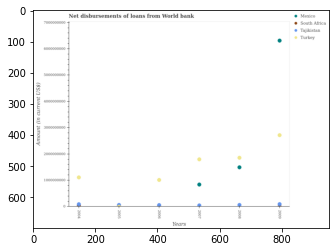

Number of QA =  28





,Years,Mexico,Tajikistan,South Africa,Turkey
0,2004,1.028453e+08,3.300617e+07,NaN,1.131415e+09
1,2008,1.516447e+09,3.147430e+07,7.830949e+07,1.883131e+09
2,2009,6.356547e+09,3.772814e+07,1.066569e+08,2.748959e+09
3,2005,NaN,8.229019e+07,NaN,3.318877e+07
4,2007,8.605375e+08,6.364556e+07,NaN,1.824760e+09
5,2006,NaN,7.342889e+07,NaN,1.036908e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from world bank in tajikistan in 2004 and that in 2007 ?
PREDICTED =  -30639386.190418813
EXPECTED =  45154000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from world bank in turkey in 2006 and the amount of loan disbursed from world bank in mexico in 2004?
PREDICTED =  -94507105.9358679
EXPECTED =  1009347000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount of loan disbursed from world bank in mexico and amount of loan disbursed from world bank in tajikist

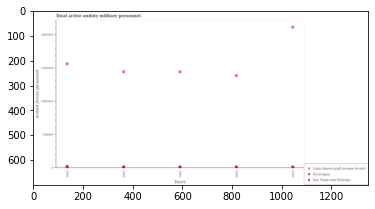

Number of QA =  28





,Years,Nicaragua,Latin America(all income levels},Sao Tome and Principe
0,1994,NaN,1.392463e+06,19130.169128
1,1993,NaN,1.447721e+06,18827.569167
2,1992,NaN,1.447606e+06,18087.804479
3,1995,NaN,2.118739e+06,17242.050112
4,1991,23394.119059,1.567988e+06,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of armed forces personnel in sao tome and principe in 1994 and that in 1995 ?
PREDICTED =  -36368.219240274295
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of armed forces personnel in nicaragua in 1993 and the number of armed forces personnel in latin america(all income levels) in 1991?
PREDICTED =  -1567988.0947749226
EXPECTED =  -1548000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the number of armed forces personnel in nicaragua and number of armed forces personnel in sao tome and

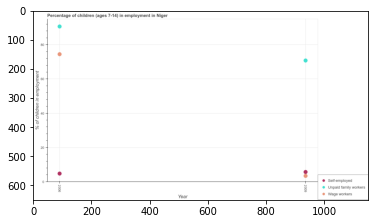

Number of QA =  24





,Year,Unpaid family workers,Self-employec,Wage workers
0,2006,91.187524,5.109159,74.987291
1,2009,71.248324,6.135165,3.825509


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self employed children in 2006 and that in 2009 ?
PREDICTED =  -1.0260060722752433
EXPECTED =  -0.9299999999999997




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children employed as wage workers in 2006 and the percentage of self employed children in 2009?
PREDICTED =  71.16178136383985
EXPECTED =  68.78999999999999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of children employed as unpaid family workers and percentage of self employed children ?
PREDICTED =  60.0040012102

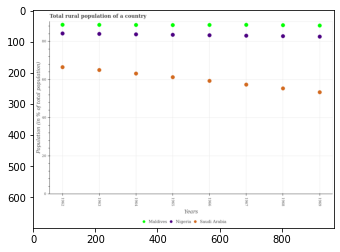

Number of QA =  28





,Years,Nigeria,Maldives,Saudi Arabia
0,1966,83.210701,88.605893,59.400295
1,1965,83.478333,88.564648,61.271915
2,1963,83.897801,88.598942,65.034723
3,1964,83.632325,88.561587,63.176481
4,1968,82.736479,88.470095,55.483863
5,1967,82.989818,88.679015,57.422430
6,1962,84.122622,88.666968,66.560810
7,1969,82.498165,88.298279,53.461204


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in maldives in 1963 and that in 1966 ?
PREDICTED =  -0.006951244396859124
EXPECTED =  0.04799999999998761




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in maldives in 1969 and the rural population in saudi arabia in 1964?
PREDICTED =  -0.2633080495844382
EXPECTED =  25.174000000000007




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1968, what is the difference between the rural population in nigeria and rural population in saudi arabia ?
PREDICTED =  -1886.5018347655234
EXPECTED =  27.385000000000026




				 0 / 3 = 0.0


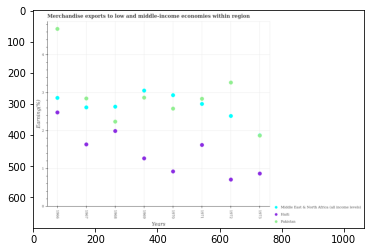

Number of QA =  28





,Years,Middle East & North Africa (all income levels),Pakistan,Haiti
0,1966,2.870282,4.683518,2.482469
1,1972,2.390881,3.272266,0.719442
2,1969,3.061892,2.874160,1.278597
3,1970,2.939355,2.585991,0.931888
4,1973,NaN,1.880452,0.877968
5,1968,2.636761,2.243607,1.997711
6,1971,2.710220,2.843178,1.631046
7,1967,2.615365,2.851663,1.642806


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in haiti in 1967 and that in 1971 ?
PREDICTED =  0.011759731043986088
EXPECTED =  0.014483163243369956




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in haiti in 1969 and the percentage of amount earned from merchandise exports in pakistan in 1970?
PREDICTED =  0.3467089798792423
EXPECTED =  -1.3119921655611002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1966, what is the difference between the percentage of amount earned from merchandise exports i

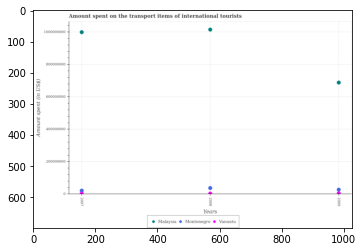

Number of QA =  28





,Years,Vanuatu,Montenegro,Malaysia
0,2009,5.308675e+06,2.950206e+07,6.912799e+08
1,2008,5.177683e+06,3.961047e+07,1.018461e+09
2,2007,4.846533e+06,2.330439e+07,1.001794e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the transport items of international tourists in vanuatu in 2007 and that in 2008 ?
PREDICTED =  -331149.98437459394
EXPECTED =  -1000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the transport items of international tourists in montenegro in 2009 and the amount spent on the transport items of international tourists in vanuatu in 2007?
PREDICTED =  6197671.586993735
EXPECTED =  25000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount spent on the transport items of int

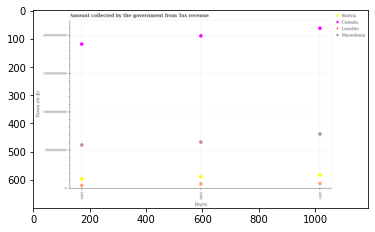

Number of QA =  29





,Years,Lesotho,Bolivia,Macedonia,Canada
0,2005,4.837266e+09,1.325903e+10,5.750052e+10,1.895563e+11
1,2006,6.636811e+09,1.620366e+10,6.132871e+10,2.005112e+11
2,2007,7.150773e+09,1.833194e+10,7.194210e+10,2.104045e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by the government from tax revenue in lesotho in 2005 and that in 2007 ?
PREDICTED =  -2313507035.464366
EXPECTED =  -2384105677.71




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by the government from tax revenue in lesotho in 2005 and the amount collected by the government from tax revenue in macedonia in 2007?
PREDICTED =  -2313507035.464366
EXPECTED =  -67108780174.55




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount collected by the government from tax revenue in canada an

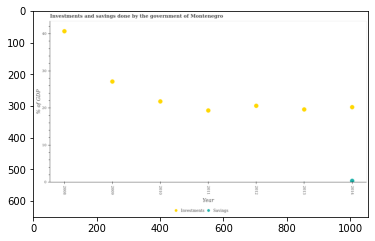

Number of QA =  25





,Year,Investments,Savings
0,2008,40.670272,NaN
1,2009,27.155312,NaN
2,2010,21.837651,NaN
3,2012,20.658495,NaN
4,2011,19.390812,NaN
5,2013,19.672380,NaN
6,2014,20.290688,0.54335


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investments of government in 2011 and that in 2012 ?
PREDICTED =  -1.2676822933024887
EXPECTED =  -1.256797231000089




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investments of government in 2010 and the savings of government in 2009?
PREDICTED =  -5.317661354221801
EXPECTED =  21.76993302592889




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the investments of government and savings of government ?
PREDICTED =  149.38492269490908
EXPECTED =  19.84021039225295




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_

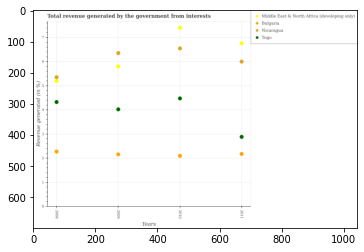

Number of QA =  29





,Years,Nicaragua,Togo,Middle East & North Africa (developing only),Bulgaria
0,2009,6.410820,4.065996,5.856576,2.192105
1,2011,6.056038,2.921213,6.818083,2.208269
2,2008,5.399514,4.371618,5.247134,2.310210
3,2010,6.601533,4.520037,7.460126,2.131005


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in middle east & north africa (developing only) in 2008 and that in 2011 ?
PREDICTED =  -1.570948775227504
EXPECTED =  -1.5634069534277923




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in nicaragua in 2011 and the total revenue generated in middle east & north africa (developing only) in 2008?
PREDICTED =  0.6565244462423996
EXPECTED =  0.8059263005952122




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total revenue generated in togo and total revenue generated in bul

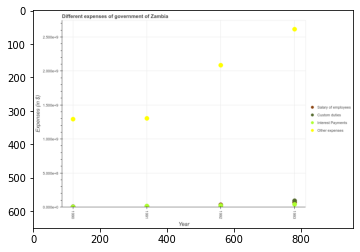

Number of QA =  29





,Year,Custom duties,Interest Payments,Other expenses,Salary of employees
0,1990,NaN,0.015337,1.306468,NaN
1,1991,NaN,0.022847,1.318258,NaN
2,1993,0.103232,0.051644,2.634525,NaN
3,1992,0.021220,0.042654,2.103754,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties in 1990 and that in 1992 ?
PREDICTED =  1.9787798124082985
EXPECTED =  -14464600.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties in 1990 and the amount spent on interest payments in 1992?
PREDICTED =  1.9787798124082985
EXPECTED =  -17641000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the amount spent on interest payments and amount spent on custom duties ?
PREDICTED =  -0.042654363567850836
EXPECTED =  1909200.0




				 0 / 3 = 0.0


is_built_with_cuda

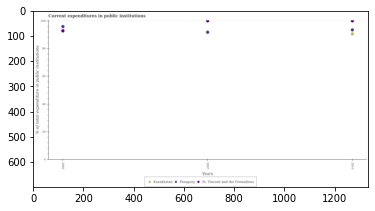

Number of QA =  28





,Years,Kazakhstan,Paraguay,St. Vincent and the Grenadines
0,2010,91.30859,94.105539,100.746662
1,2002,NaN,96.573666,93.519374
2,2007,NaN,92.438540,100.733115


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in public institutions in st. vincent and the grenadines in 2002 and that in 2010 ?
PREDICTED =  -2007.0
EXPECTED =  -7.24755859375




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in public institutions in paraguay in 2010 and the current expenditures in public institutions in st. vincent and the grenadines in 2007?
PREDICTED =  1.6669992921622878
EXPECTED =  -6.516639709472699




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the current expenditures in public institutions in kaza

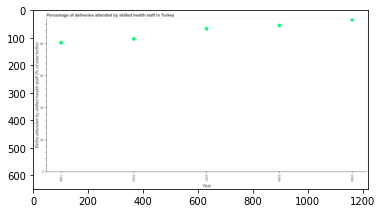

Number of QA =  24





,Year,Births attended by skilled health staff (% of total births)
0,2007,89.844246
1,2009,95.546651
2,2003,83.505703
3,2008,91.817092
4,1998,81.067378


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of births attended by skilled health staff in 1998 and 2007 ?
PREDICTED =  -8.776868327600951
EXPECTED =  -8.700000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of births attended by skilled health staff ?
PREDICTED =  2007.0
EXPECTED =  89.3




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of births attended by skilled health staff in 1998 to that in 2009 ?
PREDICTED =  0.8484586064797693
EXPECTED =  0.8484210526315789




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...

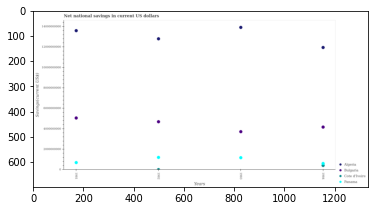

Number of QA =  28





,Years,Algeria,Bulgaria,Cote d'Ivoire,Panama
0,1982,1.290842e+10,4.753672e+09,5.276054e+07,1.241138e+09
1,1984,1.204754e+10,4.226520e+09,4.557669e+08,6.414185e+08
2,1983,1.402953e+10,3.777863e+09,NaN,1.214787e+09
3,1981,1.370115e+10,5.116822e+09,NaN,7.322188e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in panama in 1983 and that in 1984 ?
PREDICTED =  573368403.3001552
EXPECTED =  566596649.897079




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in bulgaria in 1983 and the net national savings in cote d'ivoire in 1981?
PREDICTED =  -975808955.4017768
EXPECTED =  3710826507.693871




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1982, what is the difference between the net national savings in algeria and net national savings in panama ?
PREDICTED =  8217978574.140593
EXPECTED =  11599288225.26497




				 1 / 3 = 0.3

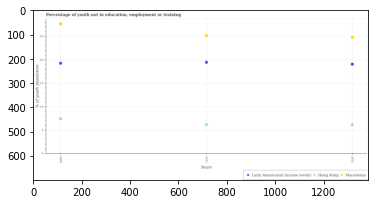

Number of QA =  28





,Years,Macedonia,Hong Kong,Latin America(all income levels)
0,2009,27.501740,7.432470,19.190617
1,2012,24.671951,6.195652,18.985753
2,2011,25.052042,6.186079,19.370332


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed youth population in in macedonia in 2011 and that in 2012 ?
PREDICTED =  0.3800909345716832
EXPECTED =  0.3800010681152983




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed youth population in in macedonia in 2011 and the percentage of unemployed youth population in in latin america(all income levels) in 2012?
PREDICTED =  6.066289649573456
EXPECTED =  6.114963046441499




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of unemployed youth population in in maced

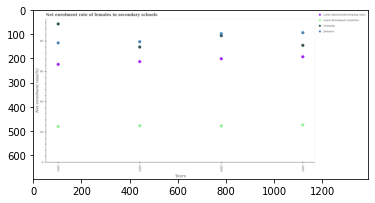

Number of QA =  29





,Years,Grenada,Jamaica,Latin America(developing only),Least developed countries
0,2003,76.090199,79.589955,66.512470,24.342728
1,2005,77.196460,85.554655,69.682785,24.867527
2,2004,83.611382,84.853556,68.379951,24.198555
3,2002,91.271296,78.818797,64.685532,23.806123


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of females in secondary schools in least developed countries in 2002 and that in 2004 ?
PREDICTED =  -6.0347586830597635
EXPECTED =  -0.3636722564697017




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of females in secondary schools in grenada in 2004 and the net enrolment rate of females in secondary schools in least developed countries in 2002?
PREDICTED =  -7.659914177863826
EXPECTED =  59.8514537811279




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the net enrolment rate of fema

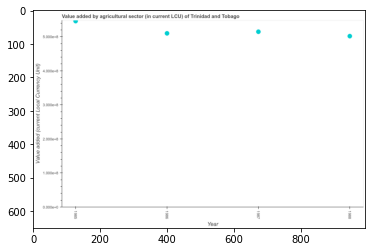

Number of QA =  24





,Year,Value added (current Local Currency Unit)
0,1987,5.144494
1,1986,5.096966
2,1985,5.454680
3,1988,5.014679


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agriculture sector in 1985 and 1986 ?
PREDICTED =  0.35771413165744725
EXPECTED =  36000000




				 0 / 1 = 0.0


> what is the median value added by agriculture sector ?
PREDICTED =  None
EXPECTED =  512350000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the value added by agriculture sector in 1985 to that in 1987 ?
PREDICTED =  1.0602948731008506
EXPECTED =  1.0608121235671264




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest value added by agriculture sector ?
PREDICTED =  0.44000074730817484
E

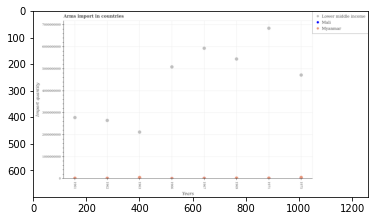

Number of QA =  28





,Years,Lower middle income,Mali,Myanmar
0,1969,5.436607e+09,NaN,3.906070e+07
1,1967,5.920475e+09,NaN,3.299532e+07
2,1975,4.709588e+09,NaN,6.823900e+07
3,1966,5.075141e+09,NaN,2.748258e+07
4,1971,6.828152e+09,NaN,3.796241e+07
5,1961,2.779789e+09,NaN,3.382996e+07
6,1963,2.127589e+09,NaN,7.389385e+07
7,1962,2.657426e+09,NaN,3.497232e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arms import in lower middle income in 1961 and that in 1975 ?
PREDICTED =  -1929798968.6597767
EXPECTED =  -1935000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arms import in myanmar in 1969 and the total arms import in mali in 1971?
PREDICTED =  1098289.6232147738
EXPECTED =  7000000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1961, what is the difference between the total arms import in lower middle income and total arms import in myanmar ?
PREDICTED =  35534766104.91811
EXPECTED =  2763000000.0




				 1 / 3 = 0.3333


is_built_

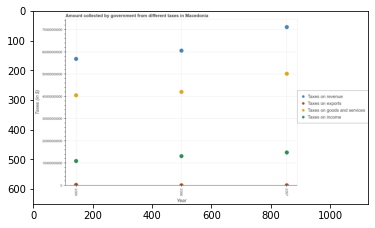

Number of QA =  29





,Year,Taxes on goods and services,Taxes on revenue,Taxes on exports,Taxes on income
0,2006,4.186999e+10,6.024532e+10,2.575795e+08,1.324391e+10
1,2005,4.028364e+10,5.656084e+10,4.443304e+08,1.106045e+10
2,2007,4.995106e+10,7.076815e+10,2.936819e+08,1.486104e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on goods in 2006 and that in 2007 ?
PREDICTED =  -8081064526.881775
EXPECTED =  -8165622407.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on exports in 2007 and the amount collected as tax on income in 2006?
PREDICTED =  36102375.34013736
EXPECTED =  -13122152374.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount collected as tax on revenue and amount collected as tax on income ?
PREDICTED =  0.0
EXPECTED =  47425818937.5




				 1 / 3 = 0.3333


is_built_wit

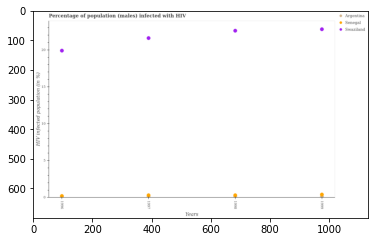

Number of QA =  28





,Years,Unnamed: 1,Swaziland,Senegal
0,1996,0.28239,19.970447,0.097190
1,1999,NaN,22.879481,0.435715
2,1997,NaN,21.677388,0.332189
3,1998,NaN,22.678858,0.349934


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected male population in senegal in 1996 and that in 1998 ?
PREDICTED =  -0.2527437520821062
EXPECTED =  -0.09999999999999998




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected male population in swaziland in 1998 and the percentage of hiv infected male population in argentina in 1997?
PREDICTED =  1.0014699328095311
EXPECTED =  22.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the percentage of hiv infected male population in senegal and percentage of hiv infected male pop

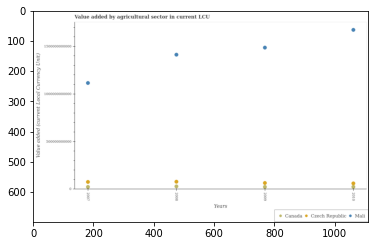

Number of QA =  28





,Years,Czech Republic,Mali,Canada
0,2007,7.978291e+10,1.119706e+12,2.909305e+10
1,2008,8.293614e+10,1.417342e+12,3.293704e+10
2,2010,6.391797e+10,1.678794e+12,2.835881e+10
3,2009,6.841406e+10,1.491665e+12,2.731282e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in mali in 2008 and that in 2010 ?
PREDICTED =  -261452227999.39307
EXPECTED =  -260655199024.58984




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in czech republic in 2009 and the value added by agricultural sector in mali in 2007?
PREDICTED =  -11368843179.184517
EXPECTED =  -1050268693545.8301




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the value added by agricultural sector in canada and value added by agricultural sector in czech republic ?
P

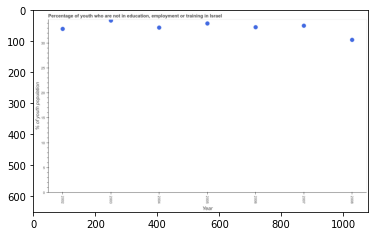

Number of QA =  24





,Year,% of youth population
0,2008,30.878347
1,2005,34.185315
2,2004,33.367942
3,2007,33.734863
4,2006,33.431009
5,2003,34.773990
6,2002,33.076095


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed youth population in 2005 and 2008 ?
PREDICTED =  3.306967921743574
EXPECTED =  3.2899990081786896




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed youth population ?
PREDICTED =  2005.0
EXPECTED =  33.189998626709




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed youth population in 2006 to that in 2007 ?
PREDICTED =  0.9909928732591409
EXPECTED =  0.9910420114445502




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what 

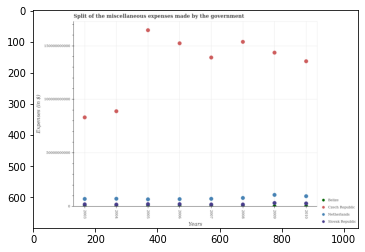

Number of QA =  29





,Years,Belize,Czech Republic,Netherlands,Slovak Republic
0,2008,NaN,1.550470e+11,8.550626e+09,2.205386e+09
1,2004,NaN,8.997856e+10,7.841924e+09,2.159069e+09
2,2006,2.565531e+09,1.537564e+11,7.444418e+09,1.128849e+09
3,2003,NaN,8.416388e+10,7.661758e+09,2.377711e+09
4,2007,NaN,1.404150e+11,7.739922e+09,2.378532e+09
5,2005,2.581491e+09,1.660931e+11,7.241816e+09,1.151972e+09
6,2010,3.351961e+09,1.369523e+11,1.032569e+10,5.785731e+08
7,2009,7.761350e+08,1.450156e+11,1.145152e+10,3.881103e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the miscellaneous expenses made by the government in czech republic in 2006 and that in 2007 ?
PREDICTED =  13341420043.347046
EXPECTED =  13277000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the miscellaneous expenses made by the government in czech republic in 2003 and the miscellaneous expenses made by the government in slovak republic in 2008?
PREDICTED =  -70883116995.4969
EXPECTED =  81341572216.40376




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the miscellaneous expenses made by the government in netherlands a

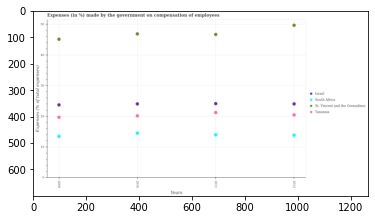

Number of QA =  29





,Years,Tanzania,South Africa,Israel],St. Vincent and the Grenadines
0,2012,20.489946,13.884461,24.066632,49.570603
1,2010,20.166577,14.566030,24.073610,46.774753
2,2011,21.266709,14.031923,24.171635,46.569814
3,2009,19.711477,13.505126,23.711768,45.052021


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on compensation of employees in south africa in 2009 and that in 2012 ?
PREDICTED =  -0.37933565577149153
EXPECTED =  -0.37484222991399996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on compensation of employees in tanzania in 2011 and the percentage of expenses made by the government on compensation of employees in st. vincent and the grenadines in 2012?
PREDICTED =  0.7767634001556871
EXPECTED =  -28.456872671397203




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the ye

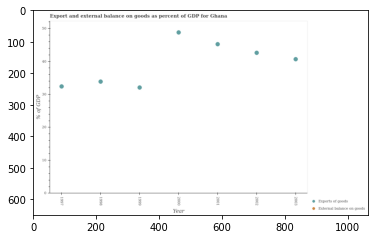

Number of QA =  23





,Year,External balance on goods,Exports of goods
0,2000,NaN,48.747646
1,2002,NaN,42.603227
2,1999,NaN,32.119450
3,2001,NaN,45.229573
4,1998,NaN,33.900716
5,2003,NaN,40.678429
6,1997,NaN,32.450143


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in 1997 and that in 2001 ?
PREDICTED =  -12.77942961080084
EXPECTED =  -12.822725537543711




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in 1997 and the external balance on goods as percentage of gdp in 2003?
PREDICTED =  -8.228285881761153
EXPECTED =  32.4102909291879




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the export of goods as percentage of gdp in 2001 to that in 2003?
PREDICTED =  1.1118810093582323
EXPECTED =  1.111948893553576




				 2 / 3 = 0.6667


is_bui

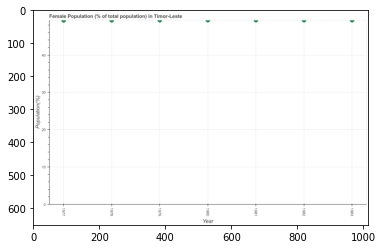

Number of QA =  24





,Year,Population(%)
0,1978,49.729560
1,1982,49.727290
2,1980,49.724303
3,1983,49.741409
4,1979,49.724543
5,1981,49.748209
6,1977,49.665343


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female population in 1980 and 1982 ?
PREDICTED =  -0.002987384539096638
EXPECTED =  -0.0016557778859933592




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median female population ?
PREDICTED =  49.66534321039385
EXPECTED =  49.3211844805893




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the female population in 1980 to that in 1981 ?
PREDICTED =  0.9995194574040813
EXPECTED =  0.9999054633086484




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the dif

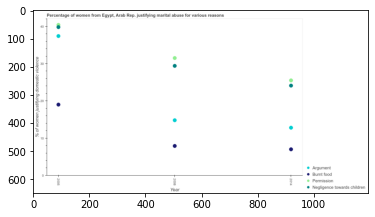

Number of QA =  29





,Year,Burnt food,Negligence towards children,Argument,Permission
0,2014,7.133502,24.292235,12.983433,25.724465
1,2008,8.037506,29.606039,14.952444,31.713511
2,2005,19.175219,40.000545,37.620724,40.593653


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying abuse for showing negligence towards children in 2005 and that in 2008 ?
PREDICTED =  10.394505575063743
EXPECTED =  10.399999999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying abuse in the case of an argument in 2008 and the percentage of women justifying abuse for showing negligence towards children in 2005?
PREDICTED =  -22.66827965469936
EXPECTED =  -24.999999999999996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of women justifyin

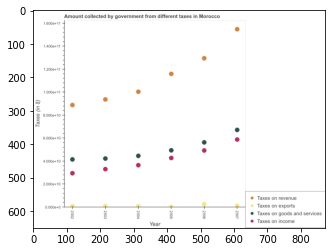

Number of QA =  29





,Year,Taxes on goods and services,Taxes on revenue,Taxes on exports,Taxes on income
0,2003,0.430916,0.947480,0.010899,0.337808
1,2004,0.452883,1.014353,0.011543,0.371980
2,2006,0.571542,1.307754,0.030922,0.500170
3,2005,0.502263,1.171529,0.006568,0.434928
4,2007,0.680259,1.562281,0.015060,0.596834
5,2002,0.422375,0.897803,0.011636,0.300473


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on revenue in 2006 and that in 2007 ?
PREDICTED =  -0.25452664875165865
EXPECTED =  -25286849266.955017




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on goods in 2006 and the amount collected as tax on revenue in 2002?
PREDICTED =  0.14916693812119397
EXPECTED =  -32502648857.14289




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount collected as tax on revenue and amount collected as tax on exports ?
PREDICTED =  0.8820217826784121
EXPECTED =  153794655067.821






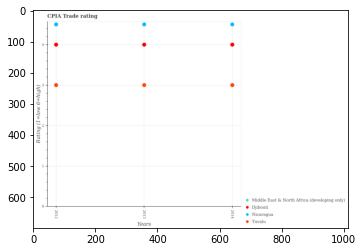

Number of QA =  29





,Years,Djibouti,Tuvalu,Middle East & North Africa (developing only),Nicaragua
0,2012,4.005291,3.005598,NaN,4.503342
1,2014,4.006219,3.005996,NaN,4.505259
2,2013,4.005334,3.006780,NaN,4.506373


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in nicaragua in 2012 and that in 2013 ?
PREDICTED =  -0.0030313953606411204
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in middle east & north africa (developing only) in 2013 and the cpia rating in djibouti in 2014?
PREDICTED =  nan
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in middle east & north africa (developing 

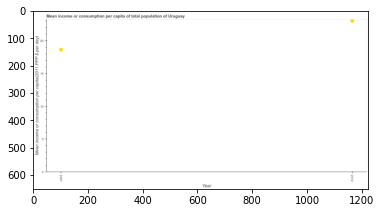

Number of QA =  20





,Year,Mean income or consumption per capita(2011 PPP $ per day)
0,2012,23.089922
1,2007,18.688313


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mean income or consumption in 2007 and 2012 ?
PREDICTED =  -4.401609029893756
EXPECTED =  -4.399314058770798




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median mean income or consumption ?
PREDICTED =  2009.5
EXPECTED =  20.8280771562919




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the mean income or consumption in 2007 to that in 2012 ?
PREDICTED =  0.8093709914459629
EXPECTED =  0.8089558432758415




				 2 / 3 = 0.6667


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Mean income or consumption per capita(2011 PPP $ pe

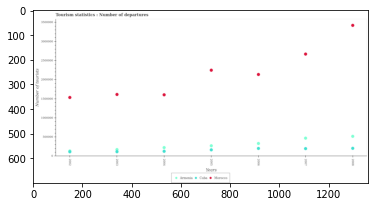

Number of QA =  28





,Years,Cuba,Morocco,Armenia
0,2008,209053.930666,3.393212e+06,519107.170266
1,2006,205397.935474,2.121507e+06,333662.693910
2,2004,130551.415826,1.595373e+06,229113.069064
3,2002,122141.415773,1.524589e+06,NaN
4,2005,168502.388357,2.232433e+06,274302.193221
5,2007,200248.561182,2.648672e+06,471692.530336
6,2003,123203.482767,1.602374e+06,176784.830980


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist departures in cuba in 2006 and that in 2007 ?
PREDICTED =  5149.374292225984
EXPECTED =  5000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist departures in cuba in 2002 and the number of tourist departures in armenia in 2007?
PREDICTED =  -78107.1454087798
EXPECTED =  -357000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the number of tourist departures in armenia and number of tourist departures in cuba ?
PREDICTED =  -1.0
EXPECTED =  97000.0




				 1 / 3 = 0.3333


is_built_wit

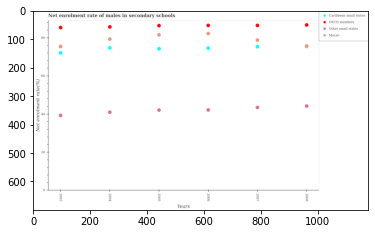

Number of QA =  29





,Years,Caribbean small states,Macao,Other small states,OECD members
0,2005,74.763160,82.130156,42.443309,86.976797
1,2004,75.223843,79.831986,41.376282,86.272569
2,2006,75.114981,82.743680,42.525152,87.048356
3,2008,NaN,76.130406,44.596102,87.290712
4,2003,72.608100,75.930440,39.625184,85.935940
5,2007,75.847501,79.314838,43.838123,87.045340


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of males in secondary schools in other small states in 2004 and that in 2006 ?
PREDICTED =  -1.1488698620860305
EXPECTED =  -1.1638984680175994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of males in secondary schools in oecd members in 2006 and the net enrolment rate of males in secondary schools in caribbean small states in 2003?
PREDICTED =  14.440255932127926
EXPECTED =  14.399650573730383




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the net enrolment rate of males in seco

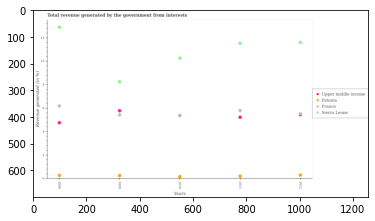

Number of QA =  29





,Years,France,Estonia,Sierra Leone,Upper middle income
0,2011,5.893189,0.252043,11.677023,5.314183
1,2008,6.287212,0.310875,13.059055,4.841650
2,2012,5.611849,0.333633,11.752956,NaN
3,2010,5.452855,0.213026,10.404250,NaN
4,2009,5.519138,0.304602,8.372123,5.879718


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in france in 2010 and that in 2012 ?
PREDICTED =  -0.15899464187625423
EXPECTED =  -0.1705031839915092




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in sierra leone in 2011 and the total revenue generated in estonia in 2010?
PREDICTED =  1.2727726837654458
EXPECTED =  11.361361858820393




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the total revenue generated in upper middle income and total revenue generated in france ?
PREDICTED =  13.035550487735083
EXPECTED =  -0.07

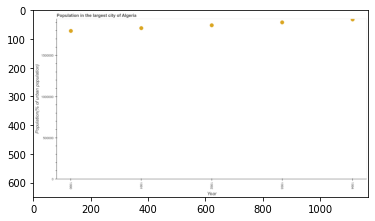

Number of QA =  24





,Year,Population(% of urban population)
0,1992,1.860169e+06
1,1991,1.825099e+06
2,1994,1.929859e+06
3,1990,1.791613e+06
4,1993,1.894715e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in largest city in 1990 and 1994 ?
PREDICTED =  -138245.66594874486
EXPECTED =  -139430




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median population in largest city ?
PREDICTED =  1992.0
EXPECTED =  1865529.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the population in largest city in 1992 to that in 1993 ?
PREDICTED =  0.9817674306771286
EXPECTED =  0.9815174534292861




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference 

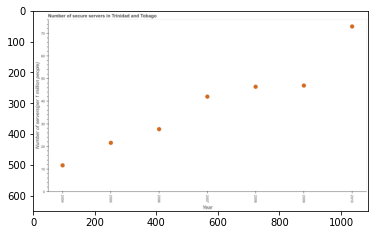

Number of QA =  24





,Year,Number of servers(per 1 million people)
0,2007,42.413032
1,2004,11.955462
2,2009,47.356716
3,2008,46.779730
4,2006,27.961558
5,2005,22.003048
6,2010,73.518812


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secure internet servers in 2004 and 2009 ?
PREDICTED =  -35.40125318958799
EXPECTED =  -35.288894467917096




				 1 / 1 = 1.0


> what is the median number of secure internet servers ?
PREDICTED =  None
EXPECTED =  42.0084627957778




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of secure internet servers in 2006 to that in 2009 ?
PREDICTED =  0.5904454620114796
EXPECTED =  0.5888806972117071




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest number of secure internet servers ?
PREDICTED =  0.0


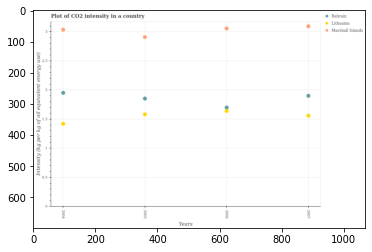

Number of QA =  28





,Years,Lithuania,Bahrain,Marshall Islands
0,2004,1.419684,1.949754,3.028685
1,2007,1.558552,1.898686,3.087090
2,2005,1.581033,1.850745,2.901560
3,2006,1.639121,1.695941,3.050278


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 intensity in in bahrain in 2005 and that in 2007 ?
PREDICTED =  -0.04794119448578926
EXPECTED =  -0.04708657908037006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 intensity in in lithuania in 2005 and the co2 intensity in in marshall islands in 2007?
PREDICTED =  0.02248111375939743
EXPECTED =  -1.51237552272717




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the co2 intensity in in bahrain and co2 intensity in in lithuania ?
PREDICTED =  2.4533872986790595
EXPECTED =  0.05825011595019003




				 1 / 3 = 0.33

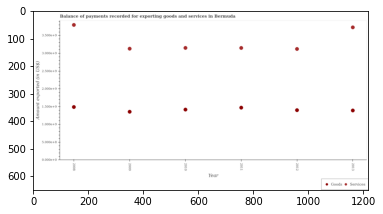

Number of QA =  27





,Year,Services,Goods
0,2008,3.777731,1.486675
1,2012,3.107572,1.401363
2,2010,3.140239,1.416405
3,2009,3.117579,1.354974
4,2011,3.138689,1.469336
5,2013,3.712023,1.392952


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in 2012 and that in 2013 ?
PREDICTED =  0.008411275951201835
EXPECTED =  8835047




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in 2012 and the amount of services exported in 2013?
PREDICTED =  0.008411275951201835
EXPECTED =  -2328665032




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the amount of services exported and amount of goods exported ?
PREDICTED =  11.472127635406759
EXPECTED =  1720963587




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: Fals

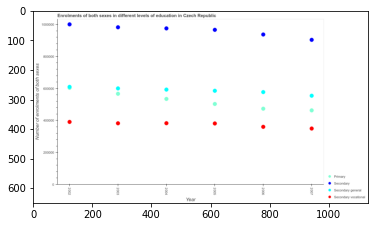

Number of QA =  29





,Year,Secondary general,Secondary,Secondary vocational,Primary
0,2004,595574.432618,9.770269e+05,385345.874147,537352.864176
1,2002,612393.010762,1.002177e+06,393496.168263,NaN
2,2007,557075.553047,9.055775e+05,352306.280000,465892.365307
3,2003,602796.322799,9.840555e+05,384586.623044,568924.139350
4,2005,588349.291130,9.680508e+05,384070.484965,505561.065502
5,2006,579814.070417,9.390010e+05,362943.598570,476129.433724


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary education in 2002 and that in 2003 ?
PREDICTED =  18121.942710256437
EXPECTED =  18285




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in primary education in 2007 and the number of enrolments in secondary education in 2006?
PREDICTED =  -10237.068417133181
EXPECTED =  -474206




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the number of enrolments in secondary vocational education and number of enrolments in secondary general education ?
PREDICTED =  0.0
EXPECTED = 

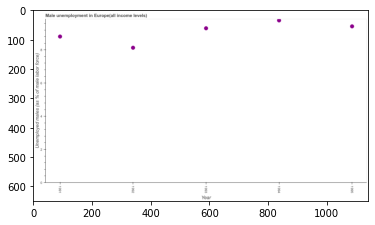

Number of QA =  24





,Year,Unemployed males (as % of male labor force)
0,1991,8.815843
1,1992,8.144620
2,1995,9.430579
3,1994,9.791046
4,1993,9.318557


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed males population in 1991 and 1995 ?
PREDICTED =  -0.6147356658881016
EXPECTED =  -0.614300080990601




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed males population ?
PREDICTED =  1993.0
EXPECTED =  9.302636401761381




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed males population in 1991 to that in 1994 ?
PREDICTED =  0.9003984991646213
EXPECTED =  0.900570701510952




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wh

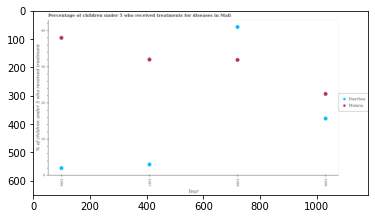

Number of QA =  27





,Year,Diarrhea,Malaria
0,1989,41.147988,32.061008
1,1986,2.116934,38.141853
2,1987,3.120880,32.144589
3,1996,15.827875,22.631260


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received treatment for diarrhoea in 1986 and that in 1987 ?
PREDICTED =  -1.0039467771319495
EXPECTED =  -1.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received treatment for malaria in 1987 and the percentage of children who received treatment for diarrhoea in 1996?
PREDICTED =  9.513328700922116
EXPECTED =  16.3




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1986, what is the difference between the percentage of children who received treatment for diarrhoea and percentage of children who receive

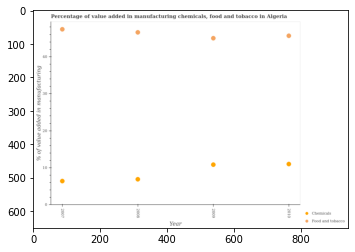

Number of QA =  27





,Year,Food and tobacco,Chemicals
0,2008,46.889992,7.074211
1,2007,47.731841,6.589257
2,2009,45.317991,11.035954
3,2010,45.949071,11.224388


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing food and tobacco in 2008 and that in 2010 ?
PREDICTED =  -88.83906320175568
EXPECTED =  0.9263402273723003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing food and tobacco in 2007 and the value added by  manufacturing chemicals in 2009?
PREDICTED =  -41.317991246215094
EXPECTED =  36.5615247012761




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the value added by manufacturing food and tobacco and value added by  manufacturing chemicals ?
PREDICTED =  -31.92381027

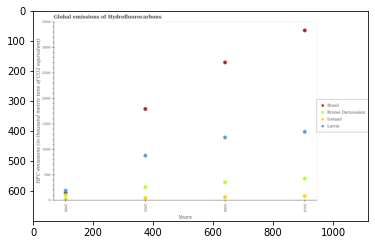

Number of QA =  29





,Years,Iceland,Latvia,Brazil,Brunei Darussalam
0,2008,71.662099,1240.345417,2713.163559,362.811035
1,2000,30.517771,167.474480,201.124430,113.366635
2,2005,58.568321,884.445371,1800.432990,265.086072
3,2010,89.663550,1353.190382,3344.080597,434.704728


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the global emissions of hydrofluorocarbons in latvia in 2000 and that in 2005 ?
PREDICTED =  -716.9708917585958
EXPECTED =  -686.6




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the global emissions of hydrofluorocarbons in brunei darussalam in 2000 and the global emissions of hydrofluorocarbons in latvia in 2008?
PREDICTED =  -1126.9787821714892
EXPECTED =  -1132.3999999999999




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the global emissions of hydrofluorocarbons in brazil and global emissions of hydrofluorocarbons in latvi

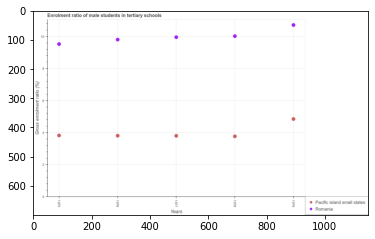

Number of QA =  27





,Years,Pacific island small states,Romania
0,1975,3.864603,9.589274
1,1976,3.846261,9.869514
2,1979,4.896024,10.778947
3,1978,3.807960,10.082244
4,1977,3.849122,10.024975


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the enrolment ratio of male students in tertiary schools in romania in 1979 ?
PREDICTED =  2.155789335417915
EXPECTED =  10.71285




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum enrolment ratio of male students in tertiary schools in pacific island small states ?
PREDICTED =  0.9792048857153877
EXPECTED =  4.84638977050781




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum enrolment ratio of male students in tertiary schools in pacific island small states ?
PREDICTED =  0.7615920806602425
EXPECTED =  3.76433992385864




				 0 / 3 = 0.0


is_built_with_cuda

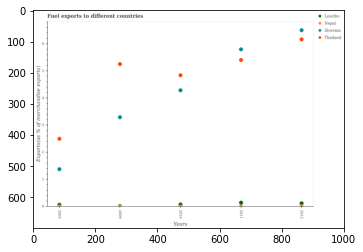

Number of QA =  29





,Years,Thailand,Nepal,Lesotho,Slovenia
0,2003,2.515725,0.036064,0.085197,1.394326
1,2009,5.274385,0.033811,NaN,3.313710
2,2010,4.861500,0.032210,0.097864,4.305379
3,2012,6.186386,0.032681,0.137105,6.524227
4,2011,5.422368,0.022695,0.162605,5.816965


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in lesotho in 2003 and that in 2010 ?
PREDICTED =  -0.012666984360724262
EXPECTED =  -0.0099886767389736




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in thailand in 2011 and the percentage of exports to different countries in lesotho in 2010?
PREDICTED =  0.560868352852121
EXPECTED =  5.325637715604545




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of exports to different countries in lesotho and percentage of exp

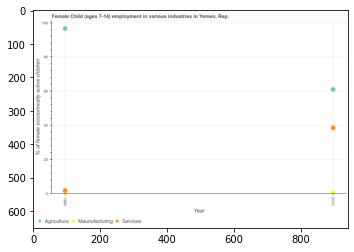

Number of QA =  24





,Year,Agriculture,Services,Maunufacturing
0,1999,98.020380,2.179436,NaN
1,2010,62.002135,39.289520,0.809409


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in services in 1999 and that in 2010 ?
PREDICTED =  -37.110084458062744
EXPECTED =  -36.669999999999995




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in services in 2010 and the percentage of economically active children in agriculture in 1999?
PREDICTED =  37.110084458062744
EXPECTED =  -58.11000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of economically active children in services and percentage of econo

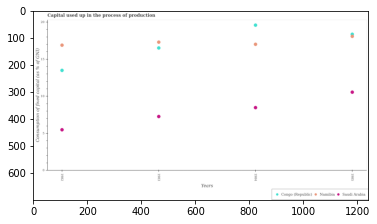

Number of QA =  28





,Years,Saudi Arabia,Namibia,Congo (Republic)
0,1982,5.519610,16.905475,13.504313
1,1983,7.307652,17.311653,16.531504
2,1984,8.505203,17.019325,19.601712
3,1985,10.580887,18.086101,18.381452


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the capital used up in the process of production in congo (republic) in 1983 and that in 1984 ?
PREDICTED =  -1967.4684961719324
EXPECTED =  -3.0775019146439995




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the capital used up in the process of production in saudi arabia in 1984 and the capital used up in the process of production in congo (republic) in 1982?
PREDICTED =  2.9855923953748906
EXPECTED =  -5.021914329553399




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the capital used up in the process of production in namibia

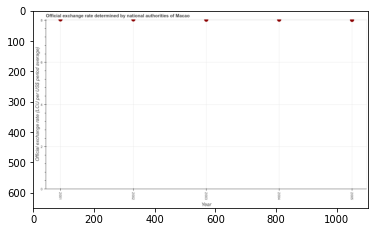

Number of QA =  24





,Year,Official exchange rate (LCU per US$ period average)
0,2005,8.065323
1,2001,8.082315
2,2002,8.080039
3,2003,8.071365
4,2004,8.072122


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official exchange rate in 2002 and 2005 ?
PREDICTED =  0.01471606255785396
EXPECTED =  0.02236875000000005




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median official exchange rate ?
PREDICTED =  8.072122185864966
EXPECTED =  8.02217108333333




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the official exchange rate in 2004 to that in 2005 ?
PREDICTED =  1.0008430177164367
EXPECTED =  1.0013863950146036




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what 

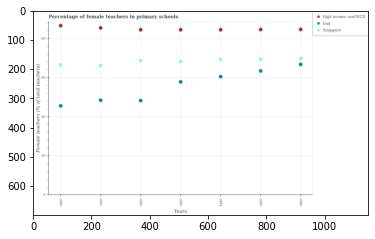

Number of QA =  28





,Years,Iraq,High income: nonOECD,Singapore
0,1986,67.048597,84.929300,70.117612
1,1981,48.692330,85.739897,66.467252
2,1983,58.090465,84.795794,68.619484
3,1984,60.811993,84.818920,69.594723
4,1982,48.571638,84.805544,68.977856
5,1980,45.873734,86.868548,66.781187
6,1985,63.732786,84.938359,69.685849


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in high income: nonoecd in 1980 and that in 1983 ?
PREDICTED =  2.0727539591265725
EXPECTED =  2.0964584350584943




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in singapore in 1986 and the percentage of female teachers in high income: nonoecd in 1982?
PREDICTED =  -14.687931804234381
EXPECTED =  -14.650959062499993




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the percentage of female teachers in singapore and percentage of female teachers in iraq ?
PREDICTE

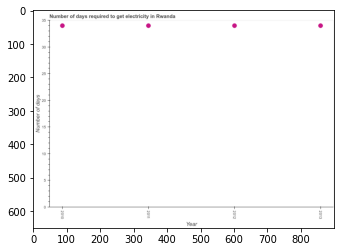

Number of QA =  24





,Year,Number of days
0,2010,33.941426
1,2012,33.940904
2,2011,33.932046
3,2013,33.932463


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time to get electricity in 2010 and 2012 ?
PREDICTED =  0.0005211069728687789
EXPECTED =  0




				 0 / 1 = 0.0


> what is the median time to get electricity ?
PREDICTED =  None
EXPECTED =  34.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the time to get electricity in 2011 to that in 2012 ?
PREDICTED =  1.0002764150806567
EXPECTED =  1.0




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest time to get electricity ?
PREDICTED =  -1979.0585744986392
EXPECTED =  0




				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu

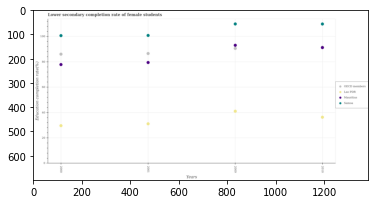

Number of QA =  29





,Years,Unnamed: 1,Lao PDR,OECD members,Mauritius
0,2009,109.577720,41.129469,90.345249,92.746234
1,2000,100.377107,29.667550,85.769801,77.754865
2,2010,109.504668,36.376845,NaN,91.037552
3,2001,100.513573,31.203572,86.302339,79.325060


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in mauritius in 2001 and that in 2010 ?
PREDICTED =  -11.71249196222206
EXPECTED =  -11.75753784179689




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in oecd members in 2000 and the lower secondary completion rate of female students in samoa in 2010?
PREDICTED =  85.7698009465049
EXPECTED =  -23.786407470703608




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the lower secondary completion rate of female students in samo

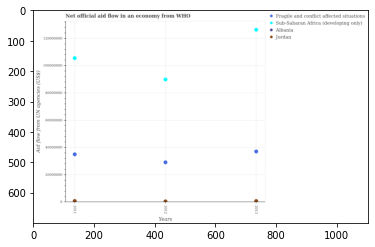

Number of QA =  29





,Years,Fragile and conflict affected situations,Sub-Saharan Africa (developing only),Albania,Jordan
0,2012,2.972273e+07,9.088277e+07,NaN,7.966424e+05
1,2013,3.778303e+07,1.277374e+08,NaN,9.966146e+05
2,2011,3.560852e+07,1.066600e+08,NaN,1.054490e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in sub-saharan africa (developing only) in 2012 and that in 2013 ?
PREDICTED =  -36854633.548094526
EXPECTED =  -36470000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in fragile and conflict affected situations in 2011 and the net official aid flow in jordan in 2012?
PREDICTED =  -30959822.700690694
EXPECTED =  34510000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.








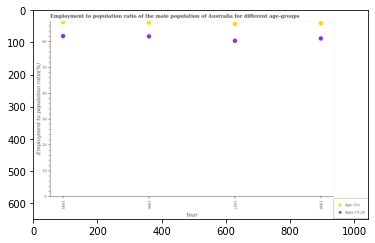

Number of QA =  27





,Year,Age 15+,Ages 15-24
0,1996,67.859617,62.550022
1,1997,67.380002,60.864982
2,1998,67.672647,61.738269
3,1995,68.065519,62.678277


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio(age 15-24) in 1998 ?
PREDICTED =  32.346226183048536
EXPECTED =  61.2000007629395




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio(age 15+) ?
PREDICTED =  29.309994568411003
EXPECTED =  67.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio(age 15-24) ?
PREDICTED =  32.81032745507317
EXPECTED =  60.2999992370605




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.




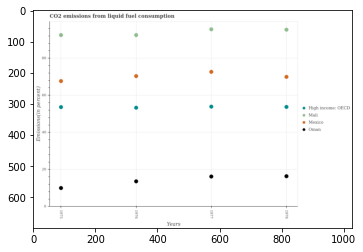

Number of QA =  29





,Years,Mexico,Oman,High income: OECD,Mali
0,1976,70.661757,13.798191,53.589670,92.812073
1,1978,70.279402,16.609167,53.971550,95.717546
2,1975,67.956274,10.179732,53.896534,92.816546
3,1977,72.979154,16.480027,54.179313,95.953340


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1978, what is the difference between the total co2 emitted in high income: oecd and total co2 emitted in mexico ?
PREDICTED =  -18.799840371479505
EXPECTED =  -16.22141908688119




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total co2 emitted in mali in 1975 to that in 1978?
PREDICTED =  0.9696920793318627
EXPECTED =  0.9696210460382086




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: Fal

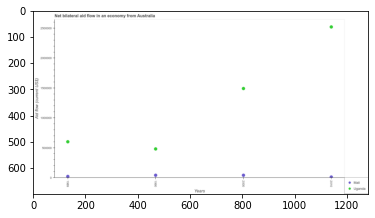

Number of QA =  27





,Years,Uganda,Mali
0,2010,2.538541e+06,17723.549244
1,1989,6.115017e+05,26938.659250
2,1990,4.908729e+05,48139.853586
3,2000,1.503712e+06,47731.679909


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in uganda in 1990 and that in 2000 ?
PREDICTED =  -1012838.8566342853
EXPECTED =  -1010000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in mali in 2000 and the net bilateral aid flow in uganda in 2010?
PREDICTED =  30008.13066432208
EXPECTED =  -2480000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the net bilateral aid flow in uganda and net bilateral aid flow in mali ?
PREDICTED =  2398007.602234751
EXPECTED =  440000.0




				 1 / 3 = 0.3333


is_built_with_cuda: T

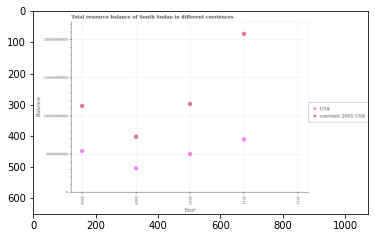

Number of QA =  26





,Year,US$,constant 2005 US$
0,2008,5.491975e+09,1.142480e+10
1,2010,5.102379e+09,1.167259e+10
2,2012,NaN,NaN
3,2009,3.228696e+09,7.378641e+09
4,2011,7.032791e+09,2.088463e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the resource balance in constant us$ in 2010 and that in 2011 ?
PREDICTED =  -9212045517.45922
EXPECTED =  -9168000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the resource balance in constant us$ in 2011 and the resource balance in us$ in 2012?
PREDICTED =  20884632998.76257
EXPECTED =  20741000000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the resource balance in constant us$ and resource balance in us$ ?
PREDICTED =  0.0
EXPECTED =  6551957872.35889




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_ava

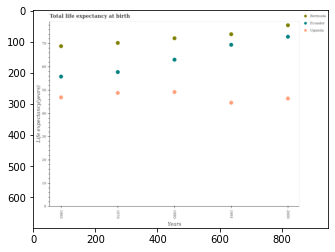

Number of QA =  28





,Years,Uganda,Bermuda,Ecuador
0,1965,46.892877,68.823096,55.790242
1,1980,49.165230,72.196773,63.032528
2,1991,44.648013,73.929010,69.406201
3,1970,48.833984,70.207363,57.719664
4,2000,46.440788,77.745560,72.839087


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in uganda in 1991 and the life expectancy at birth in in bermuda in 1980?
PREDICTED =  -27.548760222720915
EXPECTED =  -27.692414634146402




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the life expectancy at birth in in uganda and life expectancy at birth in in bermuda ?
PREDICTED =  1910.690065356501
EXPECTED =  -29.417292682926913




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

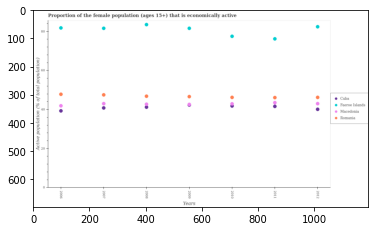

Number of QA =  29





,Years,Macedonia,Cuba,Faeroe Islands,Romania
0,2008,43.200211,41.672040,84.228589,47.282078
1,2011,44.008687,42.043644,76.863813,46.631893
2,2006,42.343240,39.808247,82.492367,48.282076
3,2009,42.850863,NaN,82.257699,47.109646
4,2010,43.373647,42.265011,78.161492,46.732154
5,2007,43.482894,41.247402,82.257568,48.003223
6,2012,43.519687,40.546486,83.088429,46.708557


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population that is economically active in macedonia in 2010 and that in 2011 ?
PREDICTED =  -0.6350397459902908
EXPECTED =  -0.5999984741211009




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population that is economically active in romania in 2008 and the proportion of the female population that is economically active in macedonia in 2010?
PREDICTED =  0.5499236393867335
EXPECTED =  3.899997711181598




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the proportion of the 

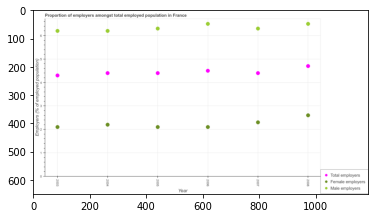

Number of QA =  28





,Year,Female employers,Total employers,Male employers
0,2004,2.226868,4.424246,6.224322
1,2008,2.625358,4.726855,6.525381
2,2007,2.324153,4.425326,6.325262
3,2003,2.124540,4.325246,6.222551
4,2006,2.123863,4.521538,6.525914
5,2005,2.123253,4.427106,6.325786


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male employers in 2004 and that in 2007 ?
PREDICTED =  -0.10093948475703307
EXPECTED =  -0.10000038146972123




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female employers in 2003 and the percentage of total employers in 2008?
PREDICTED =  -0.5008172645766238
EXPECTED =  -2.5999999046325675




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of total employers and percentage of female employers ?
PREDICTED =  0.0
EXPECTED =  2.40000009536743




				 1 / 3 = 0.3333


is_built_with

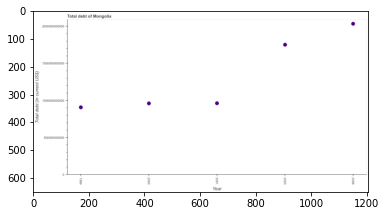

Number of QA =  24





,Year,Total debt (in current US$)
0,2006,2.045319e+12
1,2000,9.693644e+11
2,2001,9.713839e+11
3,2003,1.762601e+12
4,1999,9.162021e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in 2001 and 2003 ?
PREDICTED =  -791217474166.7185
EXPECTED =  -789104111118.79




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total debt ?
PREDICTED =  971383883336.0764
EXPECTED =  961785000000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total debt in 2003 to that in 2006 ?
PREDICTED =  0.861773210112531
EXPECTED =  0.8609400039959731




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the 

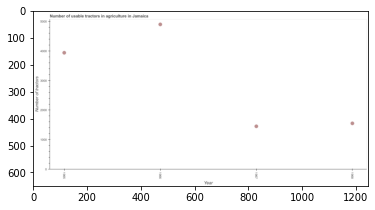

Number of QA =  24





,Year,Number of tractors
0,1967,1469.920611
1,1968,1570.946633
2,1965,3954.515271
3,1966,4910.681922


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tractors in 1965 and 1966 ?
PREDICTED =  -956.1666514887638
EXPECTED =  -960




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of tractors ?
PREDICTED =  2762.730951760865
EXPECTED =  2745.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of tractors in 1965 to that in 1966 ?
PREDICTED =  0.8052884168365996
EXPECTED =  0.8040816326530612




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and

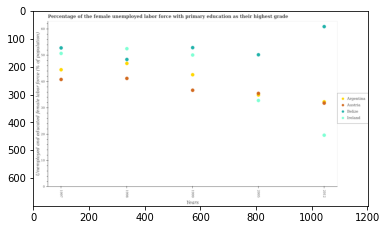

Number of QA =  29





,Years,Unnamed: 1,Ireland,Austria,Belize
0,1999,42.963260,50.503588,37.049350,53.307180
1,1998,47.279571,52.884153,41.577542,48.764458
2,1997,44.912202,51.094684,41.137634,53.191605
3,2005,NaN,33.124078,35.773663,50.608925
4,2012,32.099672,19.854889,32.679992,61.351753


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with primary education in ireland in 1998 and that in 2012 ?
PREDICTED =  33.02926439272997
EXPECTED =  32.8999996185303




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with primary education in argentina in 1999 and the percentage of the unemployed female labor force with primary education in austria in 2012?
PREDICTED =  10.2832681135327
EXPECTED =  10.7999992370606




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percent

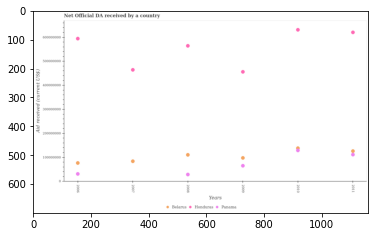

Number of QA =  27





,Years,Honduras,Panama,Belarus
0,2007,4.712740e+08,NaN,8.675529e+07
1,2010,6.396396e+08,1.321016e+08,1.416160e+08
2,2006,6.024555e+08,3.331099e+07,7.916077e+07
3,2009,4.627511e+08,6.760156e+07,1.007058e+08
4,2011,6.287161e+08,1.148704e+08,1.292890e+08
5,2008,5.720103e+08,3.057642e+07,1.134769e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official development assistance aid received in honduras in 2009 and that in 2011 ?
PREDICTED =  -165964961.58934355
EXPECTED =  -164350000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official development assistance aid received in honduras in 2011 and the net official development assistance aid received in panama in 2009?
PREDICTED =  165964961.58934355
EXPECTED =  555390000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the net official development assistance aid received in honduras and net official devel

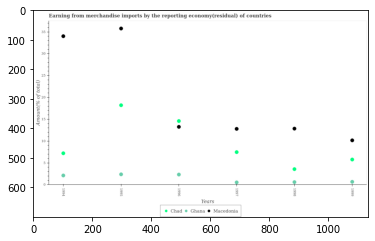

Number of QA =  28





,Years,Chad,Macedonia,Ghana
0,1998,3.722698,13.081021,0.736063
1,1999,5.936833,10.376335,0.799261
2,1995,18.492763,36.219056,2.528092
3,1996,14.838582,13.495129,2.461657
4,1994,7.368727,34.423969,2.264571
5,1997,7.638278,13.035201,0.678467


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in macedonia in 1994 and that in 1995 ?
PREDICTED =  -1.7950874609772498
EXPECTED =  -1.7608117917882993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in ghana in 1999 and the percentage of amount earned from merchandise imports in macedonia in 1996?
PREDICTED =  -1.662395636618
EXPECTED =  -12.583020061281385




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of amount earned from merchandise imports i

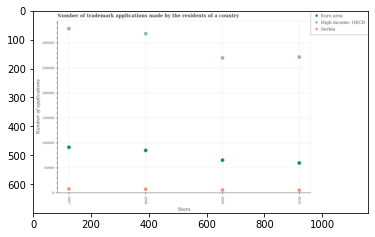

Number of QA =  28





,Years,High income: OECD,Serbia,Euro area
0,2010,270775.831376,6492.635715,60609.903718
1,2008,317267.237536,8331.520639,85371.210337
2,2007,327221.805046,8801.142476,91527.102394
3,2009,269109.607227,6851.096550,66179.098058


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the residents in serbia in 2008 and that in 2009 ?
PREDICTED =  0.0
EXPECTED =  1561.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the residents in serbia in 2009 and the number of trademark applications made by the residents in high income: oecd in 2007?
PREDICTED =  -3.0
EXPECTED =  -322837.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the number of trademark applications made by the residents in high income: oecd and number of tr

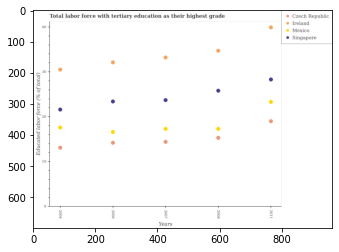

Number of QA =  29





,Years,Mexico,ireland,Czech Republic,Singapore
0,2008,17.452505,34.859201,15.435456,25.938221
1,2004,17.739709,30.625868,13.211048,21.736261
2,2011,23.446109,40.072845,19.142289,28.445304
3,2006,16.767542,32.248643,14.329730,23.569447
4,2007,17.450254,33.353571,14.545599,23.856733


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with tertiary education in ireland in 2004 and that in 2007 ?
PREDICTED =  -2.7277031516005437
EXPECTED =  -2.700000762939503




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with tertiary education in czech republic in 2004 and the percentage of male labor force with tertiary education in ireland in 2008?
PREDICTED =  -2.2244078791099895
EXPECTED =  -21.600000381469805




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or p

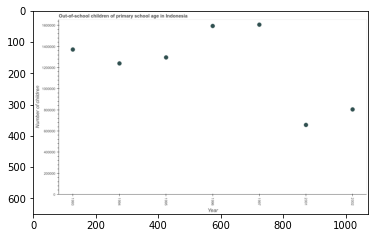

Number of QA =  24





,Year,Number of children
0,1995,1.291833e+06
1,1993,1.364724e+06
2,1997,1.598991e+06
3,1996,1.586525e+06
4,1994,1.234666e+06
5,2001,6.574974e+05
6,2002,8.031006e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school children in 1993 and 1997 ?
PREDICTED =  -234266.8880109163
EXPECTED =  -235278




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of out-of-school children ?
PREDICTED =  1291832.8410774323
EXPECTED =  1296114.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of out-of-school children in 1996 to that in 2001 ?
PREDICTED =  2.4129750228872946
EXPECTED =  2.4253450744624354




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.






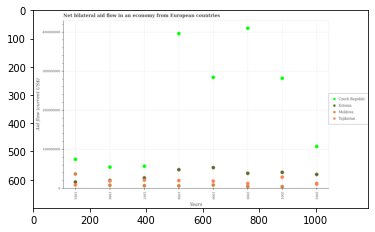

Number of QA =  29





,Years,Moldova,Estonia,Tajikistan,Czech Republic
0,1997,8.446980e+06,2.822094e+07,2.183510e+07,5.796292e+07
1,1996,9.022684e+06,NaN,2.087240e+07,5.585025e+07
2,2001,5.388295e+06,4.240806e+07,3.005178e+07,2.834978e+08
3,1999,9.817031e+06,5.430840e+07,1.967376e+07,2.857210e+08
4,2002,NaN,3.699985e+07,1.304020e+07,1.086973e+08
5,1998,7.783173e+06,4.908080e+07,2.113359e+07,3.979089e+08
6,1995,3.832204e+07,1.756202e+07,1.013194e+07,7.565262e+07
7,2000,6.492398e+06,3.978814e+07,1.369746e+07,4.117577e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in tajikistan in 1996 and that in 2000 ?
PREDICTED =  7174945.140687175
EXPECTED =  6290000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in czech republic in 2002 and the net bilateral aid flow in tajikistan in 1997?
PREDICTED =  50734374.83449142
EXPECTED =  86220000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the net bilateral aid flow in tajikistan and net bilateral aid flow in estonia ?
PREDICTED =  15981.0
EXPECTED =  -12320000.0




				 0 / 3 = 0.0


is_buil

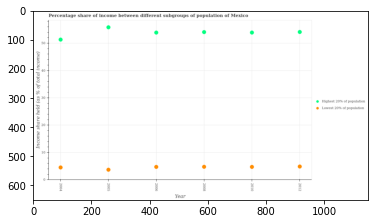

Number of QA =  27





,Year,Lowest 20% of population,Highest 20% of population
0,2004,4.621395,51.197001
1,2008,4.882334,53.946860
2,2006,4.831089,53.785177
3,2012,4.994273,54.000529
4,2005,3.791280,55.675548
5,2010,4.824548,53.775484


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 20% of the population in 2004 and that in 2005 ?
PREDICTED =  0.8301144860839944
EXPECTED =  -4.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 20% of the population in 2012 and the income share held by lowest 20% of the population in 2004?
PREDICTED =  -46.20272819492473
EXPECTED =  49.58




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the income share held by lowest 20% of the population and income share held by highest 20% of the population ?
PREDICTED =  50.

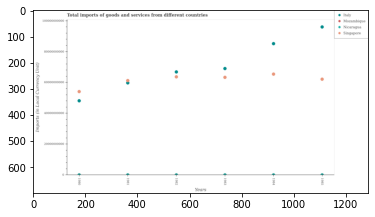

Number of QA =  29





,Years,Mozambique,Nicaragua,Italy,Singapore
0,1984,NaN,3.988014e+08,8.544501e+10,6.568619e+10
1,1985,NaN,3.765420e+08,9.629326e+10,6.241867e+10
2,1983,NaN,3.609951e+08,6.931729e+10,6.358670e+10
3,1980,NaN,3.815363e+08,4.833354e+10,5.430506e+10
4,1981,NaN,3.492107e+08,5.997828e+10,6.146758e+10
5,1982,NaN,3.226815e+08,6.711929e+10,6.388466e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods and services imports in italy in 1983 and that in 1985 ?
PREDICTED =  -96293255306.7626
EXPECTED =  -26970277200




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods and services imports in mozambique in 1983 and the amount of goods and services imports in nicaragua in 1982?
PREDICTED =  -683676577.3793095
EXPECTED =  29616298.522699952




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1982, what is the difference between the amount of goods and services imports in italy and amount of goods and services imports in singapore ?
PREDIC

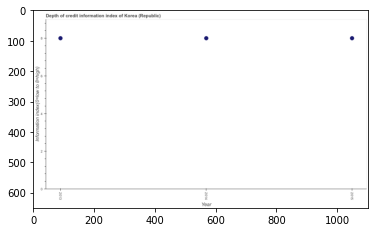

Number of QA =  24





,Year,Information index(O=low to 8=high)
0,2014,8.007190
1,2013,8.007009
2,2015,8.006396


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the depth of credit information index in 2014 and 2015 ?
PREDICTED =  0.0007943467351179123
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median depth of credit information index ?
PREDICTED =  8.007009187708222
EXPECTED =  8.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the depth of credit information index in 2013 to that in 2014 ?
PREDICTED =  0.9999773949608943
EXPECTED =  1.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the diff

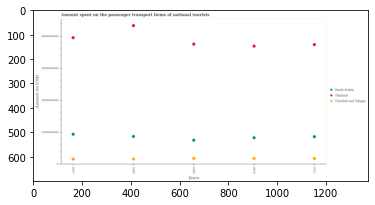

Number of QA =  28





,Years,Saudi Arabia,Trinidad and Tobago,Thailand
0,2010,8.375359e+08,1.935575e+08,3.704148e+09
1,2008,8.796318e+08,1.741058e+08,4.342524e+09
2,2009,7.623183e+08,1.944252e+08,3.766588e+09
3,2011,8.727619e+08,1.920901e+08,3.750323e+09
4,2007,9.475890e+08,1.730992e+08,3.963934e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the passenger transport items of national tourists in thailand in 2010 and that in 2011 ?
PREDICTED =  -46174454.7049036
EXPECTED =  -47000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the passenger transport items of national tourists in saudi arabia in 2011 and the amount spent on the passenger transport items of national tourists in thailand in 2009?
PREDICTED =  110443543.43356979
EXPECTED =  -2898000000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the amount spent on the pa

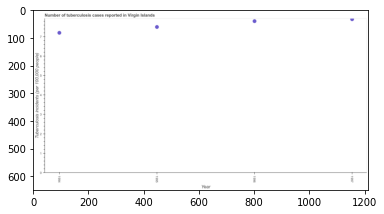

Number of QA =  24





,Year,"Tuberculosis incidents (per 100,000 people)"
0,1995,7.517779
1,1994,7.215571
2,1996,7.816178
3,1997,7.916751


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis incidents in 1996 and 1997 ?
PREDICTED =  -0.10057309094249778
EXPECTED =  -0.10000000000000053




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of tuberculosis incidents ?
PREDICTED =  7.666978804982173
EXPECTED =  7.65




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of tuberculosis incidents in 1995 to that in 1996 ?
PREDICTED =  0.9618228845972083
EXPECTED =  0.9615384615384616




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training ste

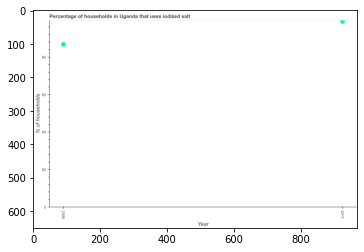

Number of QA =  20





,Year,% of households
0,2006,86.978863
1,2011,99.087831


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of households where iodized salt is consumed in 2006 and 2011 ?
PREDICTED =  -12.108968482867638
EXPECTED =  -12.200000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of households where iodized salt is consumed ?
PREDICTED =  93.03334698868099
EXPECTED =  92.9




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of households where iodized salt is consumed in 2006 to that in 2011 ?
PREDICTED =  0.8777956048432769
EXPECTED =  0.8767676767676768




				 3 / 3 = 1.0


> what is the difference between two consecutive major t

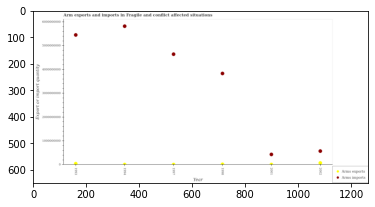

Number of QA =  27





,Year,Arms imports,Arms exports
0,1993,5.494184e+09,6.001293e+07
1,1994,5.864379e+09,2.882518e+07
2,2002,5.900428e+08,8.576247e+07
3,1998,3.867970e+09,3.689775e+07
4,2001,4.467357e+08,2.785853e+07
5,1997,4.683636e+09,2.810148e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms imports in 1993 and that in 2001 ?
PREDICTED =  5047448157.523098
EXPECTED =  5021000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms imports in 1997 and the arms exports in 1994?
PREDICTED =  -1180743927.5118961
EXPECTED =  4637000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the arms imports and arms exports ?
PREDICTED =  20861184597.35875
EXPECTED =  5814000000




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tr

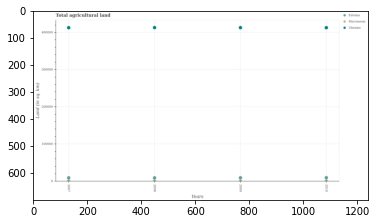

Number of QA =  28





,Years,Ukraine,Estonia,Micronesia
0,2009,414281.389120,10243.201925,1670.327455
1,2007,414023.535688,10094.581852,1601.920344
2,2010,414047.785018,10517.632275,1654.601170
3,2008,414369.129704,9883.769447,2021.362186


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total agricultural land in estonia in 2009 and that in 2010 ?
PREDICTED =  -274.4303502815528
EXPECTED =  -180.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total agricultural land in ukraine in 2007 and the total agricultural land in estonia in 2009?
PREDICTED =  -257.853431750671
EXPECTED =  403350.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total agricultural land in ukraine and total agricultural land in micronesia ?
PREDICTED =  1235725.8433561253
EXPECTED =  412540.0




				 0 / 3 = 0.0


is_built_wi

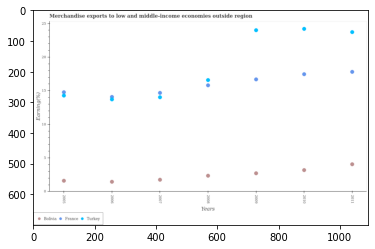

Number of QA =  28





,Years,Bolivia,France,Turkey
0,2008,2.426918,15.918013,16.708169
1,2005,1.678222,14.882706,14.399743
2,2010,3.269291,17.590359,24.350713
3,2007,1.829390,14.793244,14.135995
4,2009,2.797289,16.813010,24.160637
5,2006,1.532124,14.189979,13.826885
6,2011,4.130730,17.937424,23.872461


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in france in 2008 and that in 2009 ?
PREDICTED =  -0.8949970593636998
EXPECTED =  -0.8827605197439983




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in france in 2006 and the percentage of amount earned from merchandise exports in turkey in 2007?
PREDICTED =  -0.6032648768549382
EXPECTED =  0.04746264939999989




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of amount earned from merchandise exports in

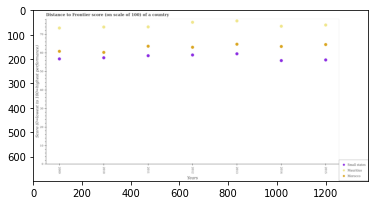

Number of QA =  28





,Years,Mauritius,Morocco,Small states
0,2011,74.154186,63.758690,58.674242
1,2009,73.576459,60.976194,56.894350
2,2010,74.116631,60.463193,57.572828
3,2015,75.226694,64.657627,56.362677
4,2012,76.716148,63.221254,59.048213
5,2013,77.409587,64.857469,59.686985
6,2014,74.584535,63.654723,56.069628


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the distance to frontier score of in mauritius in 2010 and that in 2015 ?
PREDICTED =  -1.1100626974277503
EXPECTED =  -1.0900000000000034




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the distance to frontier score of in mauritius in 2010 and the distance to frontier score of in small states in 2009?
PREDICTED =  0.540172409131344
EXPECTED =  17.188461538461496




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the distance to frontier score of in mauritius and distance to frontier score of in morocco ?
PREDICTED =  13.177459542

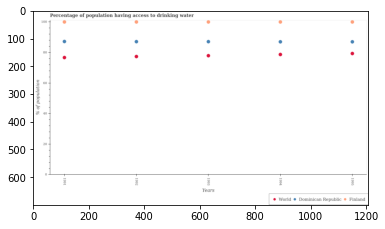

Number of QA =  28





,Years,World,Dominican Republic,Finland
0,1995,79.364227,86.970055,99.981272
1,1994,78.756368,87.014297,99.944409
2,1993,77.943080,87.145258,99.963309
3,1991,76.728056,87.185678,99.969035
4,1992,77.361924,87.099232,99.985290


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to drinking water in dominican republic in 1993 and that in 1995 ?
PREDICTED =  0.17520363336808487
EXPECTED =  0.09999999999999432




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to drinking water in finland in 1991 and the percentage of population having access to drinking water in dominican republic in 1995?
PREDICTED =  12.998980480551694
EXPECTED =  13.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of population having ac

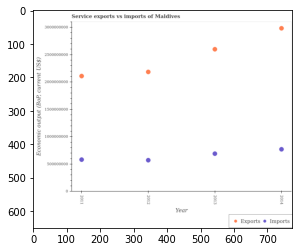

Number of QA =  27





,Year,Imports,Exports
0,2013,6.953970e+08,2.596315e+09
1,2012,5.779990e+08,2.182277e+09
2,2014,7.774193e+08,2.977606e+09
3,2011,5.897413e+08,2.106550e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of service imports in 2012 and that in 2013 ?
PREDICTED =  -117397974.558959
EXPECTED =  -119101650.39999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of service imports in 2011 and the amount of service exports in 2014?
PREDICTED =  -187678065.82771826
EXPECTED =  -2400902486.6




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the amount of service exports and amount of service imports ?
PREDICTED =  337049315.3493147
EXPECTED =  1613374430.6




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_av

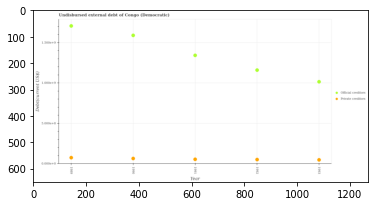

Number of QA =  27





,Year,Private creditors,Official creditors
0,1993,0.052484,1.023944
1,1990,0.070195,1.600113
2,1991,0.059950,1.351981
3,1992,0.056021,1.169349
4,1989,0.079767,1.718379


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of private creditors in 1989 and that in 1993 ?
PREDICTED =  0.027282626614692107
EXPECTED =  27096000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of official creditors in 1993 and the undisbursed external debt of private creditors in 1992?
PREDICTED =  -0.1454057967173139
EXPECTED =  963908000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the undisbursed external debt of official creditors and undisbursed external debt of private creditors ?
PREDICTED =  -6.81128

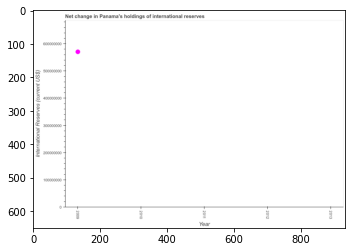

Number of QA =  16





,Year,International Reserves (current US$)
0,2012,NaN
1,2011,NaN
2,2010,NaN
3,2013,NaN
4,2009,5.744075e+08


> what is the median reserves and related items ?
PREDICTED =  None
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest reserves and related items ?
PREDICTED =  0.0
EXPECTED =  570525762.0




				 0 / 3 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  International Reserves (current US$)
EXPECTED =  100000000.0




				 0 / 4 = 0.0


> what is the title of the graph ?
PREDICTED =  Net change in Panama's holdings of international reserves
EXPECTED =  Net change in Panama's holdings of international reserves




				 1 / 5 = 0.2


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 6 = 0.3333


> what is the label or title of the y-axis ?
PREDICTED =  International Reserves (current US$)
EXPECTED =  International Reserve

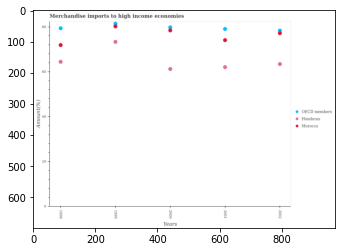

Number of QA =  28





,Years,Honduras,Morocco,OECD members
0,1999,73.629534,80.582582,81.805068
1,2001,62.363685,74.432907,79.375130
2,2000,61.538463,78.762590,80.111688
3,1998,64.734617,72.205220,79.713153
4,2002,63.737039,77.488932,78.712263


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in morocco in 2000 and that in 2001 ?
PREDICTED =  4.3296821703494
EXPECTED =  4.3499471000277055




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in oecd members in 2002 and the percentage of amount earned from merchandise imports in morocco in 1999?
PREDICTED =  -1.8703188945955702
EXPECTED =  -1.877743105798615




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of amount earned from merchandise imports 

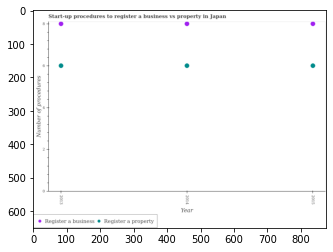

Number of QA =  27





,Year,Register a business,Register a property
0,2015,8.026290,6.027948
1,2013,8.029239,6.026930
2,2014,8.026482,6.027987


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to register a business in 2013 and that in 2015 ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to register a property in 2014 and the number of procedures to register a business in 2015?
PREDICTED =  0.0
EXPECTED =  -2




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the number of procedures to register a business and number of procedures to register a property ?
PREDICTED =  0.0
EXPECTED =  2




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_

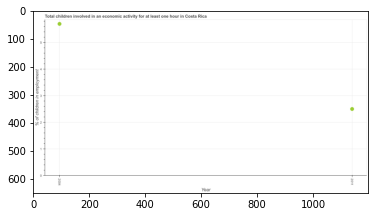

Number of QA =  20





,Year,% of children in employment
0,2004,5.722318
1,2011,2.521813


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children in employment in 2004 and 2011 ?
PREDICTED =  3.2005054373124193
EXPECTED =  3.2




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of children in employment ?
PREDICTED =  4.122065764785339
EXPECTED =  4.1




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of children in employment in 2004 to that in 2011 ?
PREDICTED =  2.2691287493436727
EXPECTED =  2.2800000000000002




				 3 / 3 = 1.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  % of children in employment
EXPECTED =  1

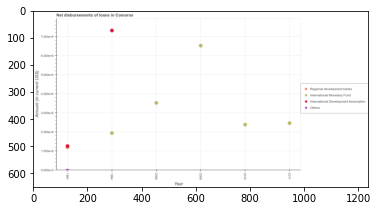

Number of QA =  26





,Year,International Development Associatior,Intemational Monetary Fund,Others,Regional development banks
0,1994,7.338763,1.962788,NaN,NaN
1,2010,NaN,2.404550,NaN,NaN
2,2008,NaN,3.547733,NaN,NaN
3,1991,1.265275,0.010689,NaN,NaN
4,2009,NaN,6.546395,NaN,NaN
5,2011,NaN,2.485518,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by international monetary fund in 1991 and that in 2009 ?
PREDICTED =  -6.535705854505835
EXPECTED =  -5290000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by regional development banks in 1991 and the amount of loan disimbursed by other organisations in 2009?
PREDICTED =  1.2652751295368687
EXPECTED =  1196000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the amount of loan disimbursed by international monetary fund and amount of loan disimbursed by regional dev

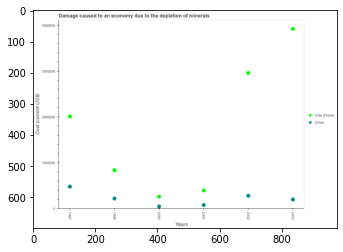

Number of QA =  27





,Years,Oman,Cote d'Ivoire
0,2000,60675.397090,2.724223e+05
1,2002,292747.750631,2.977547e+06
2,1998,232219.557906,8.498453e+05
3,1997,492228.559381,2.024239e+06
4,2001,90101.528969,4.077038e+05
5,2003,211299.305352,3.937408e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in oman in 1998 and that in 2002 ?
PREDICTED =  -60528.19272435678
EXPECTED =  -59300.76519283201




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in cote d'ivoire in 1997 and the cost of damage caused due to the depletion of minerals in oman in 2000?
PREDICTED =  1751816.554293574
EXPECTED =  1963909.115198461




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the cost of damage caused due to the depletion of minera

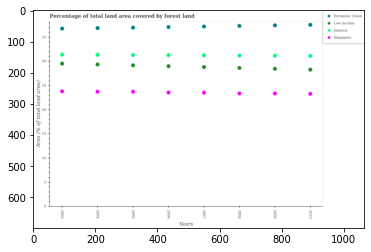

Number of QA =  29





,Years,Jamaica,European Union,Singapore,Low income
0,2006,31.653075,37.532384,23.886048,29.357687
1,2003,31.755872,37.189028,24.106446,29.876734
2,2004,31.721519,37.290989,24.036281,29.722278
3,2007,31.617797,37.622748,23.850231,29.187253
4,2005,31.680419,37.392701,24.043167,29.547171
5,2010,31.500378,37.978206,23.591251,28.633087
6,2009,31.536138,37.864728,23.665920,28.809732
7,2008,31.586702,37.744380,23.663152,28.994141


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of forest land in european union in 2005 and that in 2007 ?
PREDICTED =  -0.2300471919348226
EXPECTED =  -0.2417369590745011




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of forest land in european union in 2004 and the percentage of forest land in jamaica in 2003?
PREDICTED =  0.10196098563746858
EXPECTED =  5.485190589134298




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of forest land in jamaica and percentage of forest land in low income ?
PREDICTED =  2.995037831866089
EXPECTE

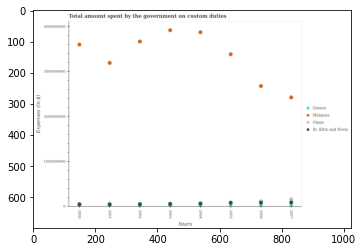

Number of QA =  28





,Years,Greece,Oman,Malaysia,St. Kitts and Nevis
0,2002,NaN,6.423040e+07,3.690011e+09,3.232341e+07
1,2005,1.514768e+07,NaN,3.408815e+09,9.341933e+07
2,2000,5.924164e+07,NaN,3.621521e+09,2.566580e+07
3,2003,7.075387e+07,NaN,3.942941e+09,3.030913e+07
4,2001,3.296234e+07,NaN,3.214778e+09,6.165136e+07
5,2004,NaN,7.961818e+07,3.898581e+09,2.314503e+07
6,2006,2.062491e+07,NaN,2.699835e+09,1.030393e+08
7,2007,2.030639e+07,1.715354e+08,2.443378e+09,9.999493e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties by the government in greece in 2002 and that in 2003 ?
PREDICTED =  -37791526.47968146
EXPECTED =  -5000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties by the government in malaysia in 2004 and the amount spent on custom duties by the government in oman in 2005?
PREDICTED =  489765651.41316175
EXPECTED =  3785500000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the amount spent on custom duties by the government in oman and amount spent on custom dutie

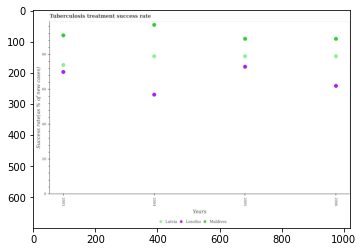

Number of QA =  28





,Years,Latvia,Lesotho,Maldives
0,2005,79.248027,73.244899,89.270029
1,2004,79.289536,57.286455,97.270305
2,2006,79.263530,62.262884,89.241421
3,2003,74.265041,70.260377,91.197080


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in lesotho in 2005 and that in 2006 ?
PREDICTED =  10.982015184659872
EXPECTED =  11.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in latvia in 2004 and the tuberculosis treatment success rate in maldives in 2003?
PREDICTED =  5.024494296850804
EXPECTED =  -12




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the tuberculosis treatment success rate in maldives and tuberculosis treatment success rate in lesotho ?
PREDICTED =  31.506651330909563
EXPE

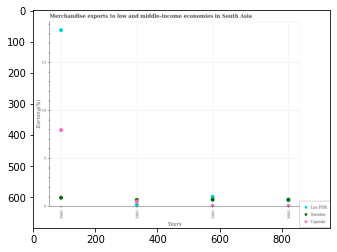

Number of QA =  28





,Years,Uganda,Lao PDR,Sweden
0,1984,0.104485,NaN,0.755666
1,1983,0.116825,1.077154,0.762887
2,1982,0.599976,0.229798,0.755145
3,1964,8.026536,18.453910,0.969629


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in uganda in 1964 and that in 1984 ?
PREDICTED =  7.922050585575152
EXPECTED =  7.914685381772627




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in sweden in 1984 and the percentage of amount earned from merchandise exports in lao pdr in 1964?
PREDICTED =  -0.21396323207800672
EXPECTED =  -17.65160203664721




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the percentage of amount earned from merchandise exports in ug

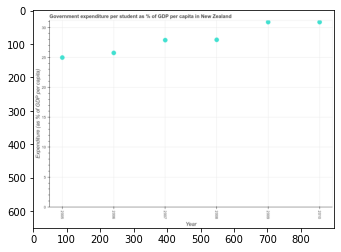

Number of QA =  24





,Year,Expenditure (as % of GDP per capita)
0,2008,28.127575
1,2005,25.158045
2,2006,25.924351
3,2007,28.067751
4,2009,31.096240
5,2010,31.083788


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government expenditure per student in 2006 and 2009 ?
PREDICTED =  -5.171889064174728
EXPECTED =  -5.1471099853514986




				 1 / 1 = 1.0


> what is the median government expenditure per student ?
PREDICTED =  None
EXPECTED =  27.909399986267097




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the government expenditure per student in 2005 to that in 2006 ?
PREDICTED =  0.9704407100751433
EXPECTED =  0.9699019432877007




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest government expenditure per student ?
PREDICTED =

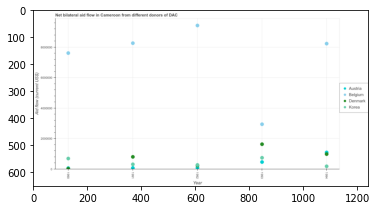

Number of QA =  29





,Year,Austria,Korea,Denmark,Belgium
0,1993,5.014688e+05,789238.604272,1.676447e+06,2.994323e+06
1,1992,1.226213e+05,307489.550439,NaN,9.511032e+06
2,1994,1.021942e+06,220122.976089,1.134951e+06,8.314754e+06
3,1991,1.052419e+05,348370.209127,8.486269e+05,8.342019e+06
4,1990,NaN,734308.285046,8.707661e+04,7.687376e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by belgium in 1991 and that in 1993 ?
PREDICTED =  5347696.463670954
EXPECTED =  5320000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by austria in 1994 and the amount of aid given by korea in 1991?
PREDICTED =  916699.8804304502
EXPECTED =  780000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the amount of aid given by denmark and amount of aid given by korea ?
PREDICTED =  3526979.046373227
EXPECTED =  890000




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_availabl

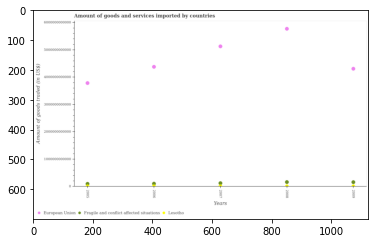

Number of QA =  28





,Years,Lesotho,European Union,Fragile and conflict affected situations
0,2005,2.888370e+10,3.777014e+12,1.104530e+11
1,2008,1.805982e+10,5.756404e+12,1.748230e+11
2,2009,1.582478e+10,4.301287e+12,1.723089e+11
3,2006,2.753212e+10,4.368937e+12,1.165410e+11
4,2007,3.051262e+10,5.114967e+12,1.347840e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services imported in european union in 2005 and that in 2008 ?
PREDICTED =  -5756403612240.706
EXPECTED =  -1987135287755.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services imported in lesotho in 2009 and the total amount of goods and services imported in fragile and conflict affected situations in 2008?
PREDICTED =  -33884594828.26861
EXPECTED =  -157181539657.189




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the total amount of goods and services imported in

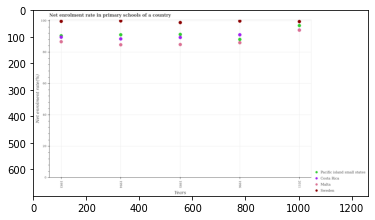

Number of QA =  29





,Years,Pacific island small states,Malta,Sweden,Costa Rica
0,1996,88.496548,86.435771,100.193843,91.494466
1,1994,91.463862,85.098568,100.289268,88.830300
2,1993,90.859554,87.107056,100.070068,89.986125
3,1995,91.723114,85.225211,99.267312,89.815833
4,2011,97.218211,94.434530,99.902493,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate in primary schools in sweden in 1993 and that in 1996 ?
PREDICTED =  -0.12377537300548624
EXPECTED =  -0.1766099999999966




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate in primary schools in malta in 1993 and the net enrolment rate in primary schools in costa rica in 2011?
PREDICTED =  -7.3274742679599285
EXPECTED =  -7.423727250976583




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the net enrolment rate in primary schools in pacific island small states and net enrolment rate in pr

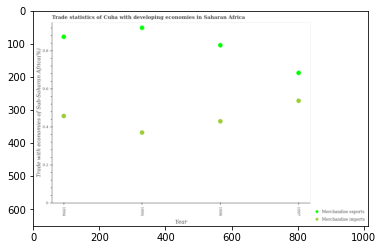

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,1996,0.433943,0.833764
1,1994,0.460406,0.877798
2,1997,0.541363,0.688230
3,1995,0.374082,0.925206


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1994 and that in 1995 ?
PREDICTED =  0.08632451070176761
EXPECTED =  0.08673912934884503




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1997 and the merchandise exports in 1994?
PREDICTED =  0.08095664015578807
EXPECTED =  -0.33599032496967407




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the merchandise exports and merchandise imports ?
PREDICTED =  0.14686721905093236
EXPECTED =  0.39932773754612005




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: Fal

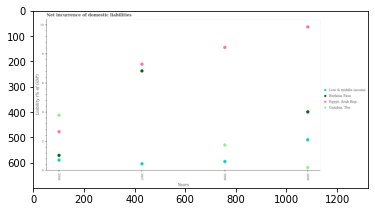

Number of QA =  28





,Years,Low & middle income,Burkina Faso,"Egypt, Arab Rep.","Gambia, The"
0,2008,0.642656,NaN,8.513804,1.786951
1,2009,2.140451,4.066887,9.928994,0.237646
2,2006,0.740045,1.069586,2.693630,3.841010
3,2007,0.480745,6.896497,7.364476,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of domestic liabilities in gambia, the in 2006 and the net incurrence of domestic liabilities in low & middle income in 2009?
PREDICTED =  -1.4004065750049701
EXPECTED =  1.69246461969446




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the net incurrence of domestic liabilities in egypt, arab rep. and net incurrence of domestic liabilities in low & middle income ?
PREDICTED =  8026.0
EXPECTED =  1.945702315666773




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trai

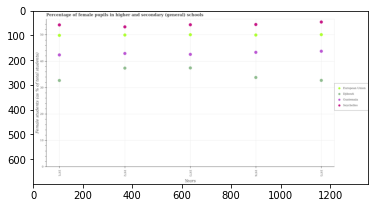

Number of QA =  29





,Years,European Union,Guatemala,Djibouti,Seychelles
0,1974,49.750806,43.215989,33.791153,53.722188
1,1972,49.759822,42.807705,37.300524,52.816837
2,1975,49.887525,43.659285,32.680053,54.625709
3,1973,49.845840,42.455470,37.363724,53.607130
4,1971,49.636961,42.286076,32.633151,53.577284


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in higher and secondary schools in guatemala in 1973 and that in 1975 ?
PREDICTED =  -42.45547011024589
EXPECTED =  -1.1926700000000068




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the percentage of female pupils in higher and secondary schools in guatemala and percentage of female pupils in higher and secondary schools in seychelles ?
PREDICTED =  -43.65928462156955
EXPECTED =  -11.065329999999996




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tra

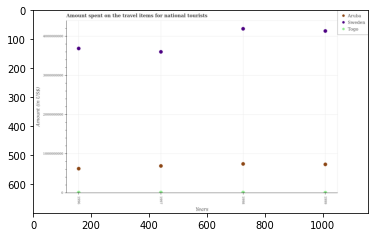

Number of QA =  28





,Years,Togo,Sweden,Aruba
0,1998,2.496786e+07,4.201567e+09,7.540814e+08
1,1997,2.438528e+07,3.610639e+09,7.011566e+08
2,1996,2.379908e+07,3.698020e+09,6.297788e+08
3,1999,2.003937e+07,4.146242e+09,7.389980e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items for national tourists in togo in 1996 and that in 1999 ?
PREDICTED =  3759710.2561790943
EXPECTED =  3000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items for national tourists in aruba in 1998 and the amount spent on the travel items for national tourists in sweden in 1996?
PREDICTED =  124302569.51357067
EXPECTED =  -2945000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the amount spent on the travel items for national tourists in aruba and amou

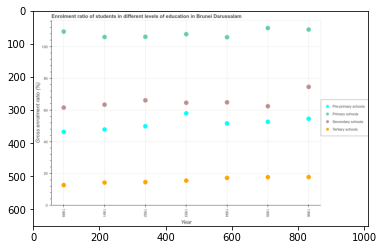

Number of QA =  29





,Year,Tertiary schools,Pre-primary schools,Primary schools,Secondary schools
0,1993,15.887421,58.559193,108.748700,65.239119
1,1991,14.701433,48.329059,106.889679,64.044083
2,1994,17.680179,52.229381,106.808588,65.561794
3,1995,18.183026,53.210093,112.613917,63.079786
4,1989,13.130234,46.851810,110.361613,62.179073
5,1996,18.257897,55.135239,111.609766,75.361804
6,1992,15.005706,50.385339,107.048617,66.826952


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

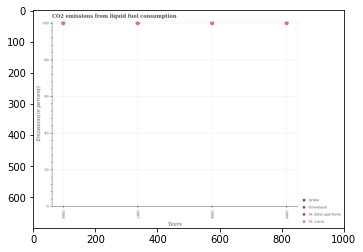

Number of QA =  29





,Years,St. Kitts and Nevis,St. Lucia,Aruba,Greenland
0,1987,NaN,100.013760,NaN,NaN
1,1989,NaN,100.005214,NaN,NaN
2,1986,NaN,100.003883,NaN,NaN
3,1988,NaN,100.058731,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in st. lucia in 1986 and that in 1988 ?
PREDICTED =  -0.0548479390129728
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in aruba in 1989 and the total co2 emitted in st. kitts and nevis in 1987?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or p

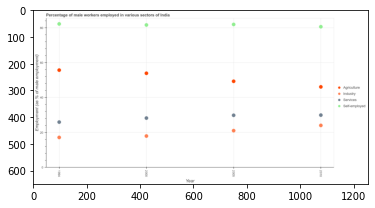

Number of QA =  29





,Year,Self-employed,Services,Industry,Agriculture
0,2000,82.072716,28.543653,18.265033,54.319167
1,1994,82.670582,26.205065,17.433430,56.178678
2,2005,82.352942,30.193802,21.374335,49.753986
3,2010,81.071989,30.259942,24.357463,46.499771


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers in services in 1994 and that in 2005 ?
PREDICTED =  -3.9887376076266925
EXPECTED =  -3.8999996185301917




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers in agriculture in 1994 and the percentage of male workers in services in 2005?
PREDICTED =  6.424691857689581
EXPECTED =  25.900001525879002




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of male workers in services and percentage of male workers in industry ?
PREDICTED =  8.885607009884652
EXPECTED =  

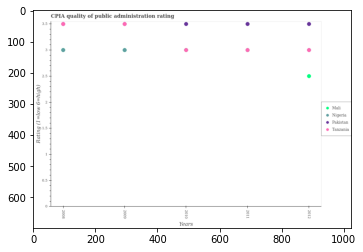

Number of QA =  29





,Years,Nigeria,Tanzania,Mali,Pakistan
0,2008,2.998681,3.493097,NaN,NaN
1,2012,NaN,2.998357,2.499366,3.494564
2,2010,NaN,2.997163,NaN,3.495110
3,2011,NaN,2.997674,NaN,3.494393
4,2009,2.997222,3.495511,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in pakistan in 2009 and that in 2011 ?
PREDICTED =  0.0007173987916289093
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in pakistan in 2011 and the cpia rating in mali in 2008?
PREDICTED =  -0.0007173987916289093
EXPECTED =  0.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in tanzania in 2008 to that in 2010?
PREDICTED =  1.1654674729256

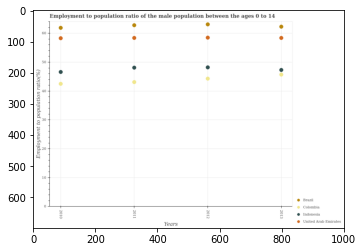

Number of QA =  29





,Years,United Arab Emirates,Colombia,Brazil,Indonesia
0,2013,58.440656,45.769245,62.317065,47.362149
1,2012,58.528857,44.394319,63.093103,48.276787
2,2010,58.369780,42.565042,61.895577,46.678470
3,2011,58.427533,43.170826,62.810588,48.156754


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in colombia in 2012 ?
PREDICTED =  1.316423077081653
EXPECTED =  44.2999992370605




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in united arab emirates ?
PREDICTED =  34.3932906081986
EXPECTED =  58.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in brazil ?
PREDICTED =  1.0
EXPECTED =  61.9000015258789




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.






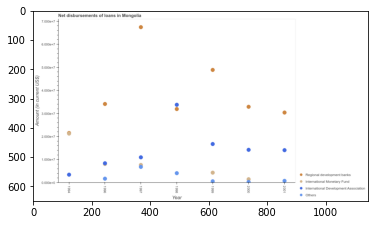

Number of QA =  28





,Year,Intemational Development Association,Others,International Monetary Func,Regional development banks
0,1998,3.430364,0.441569,NaN,3.236910
1,1999,1.714120,0.088157,0.462865,4.954595
2,1996,0.868523,0.201376,NaN,3.463566
3,2001,1.446703,0.105710,NaN,3.091490
4,2000,1.459522,0.075664,0.177385,3.340054
5,1997,1.134485,0.715231,0.802393,6.819380
6,1994,0.375363,NaN,2.183465,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by international development association in 2000 and that in 2001 ?
PREDICTED =  0.01281854922010206
EXPECTED =  152000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by regional development banks in 1998 and the amount of loan disimbursed by international development association in 2000?
PREDICTED =  -0.10314424093664343
EXPECTED =  17688000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the amount of loan disimbursed by international monetary fund and amount of lo

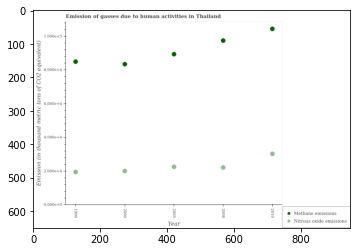

Number of QA =  27





,Year,Methane emissions,Nitrous oxide emissions
0,2000,29.497262,7.184863
1,2008,34.420382,7.927183
2,2010,36.867385,10.768366
3,2005,31.585236,8.066415
4,1990,30.043074,6.973248


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emissions in 2000 and that in 2010 ?
PREDICTED =  -3.5835030167099697
EXPECTED =  -10179.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emissions in 1990 and the amount of methane emissions in 2008?
PREDICTED =  -0.9539354062200855
EXPECTED =  -77964.70000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the amount of nitrous oxide emissions and amount of methane emissions ?
PREDICTED =  0.0
EXPECTED =  -74165.7




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu

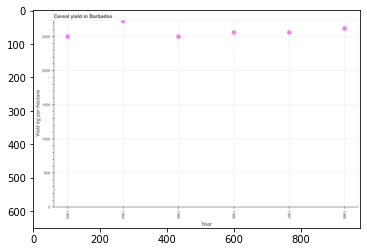

Number of QA =  24





,Year,Yield kg per hectare
0,1986,2585.444985
1,1984,2754.384353
2,1988,2645.507679
3,1987,2585.170127
4,1985,2524.477517
5,1983,2524.327805


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cereal yield in 1983 and 1988 ?
PREDICTED =  -121.17987416909091
EXPECTED =  -119.04799999999977




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median cereal yield ?
PREDICTED =  1985.5
EXPECTED =  2560.976




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cereal yield in 1983 to that in 1987 ?
PREDICTED =  0.9764648674865659
EXPECTED =  0.9761903274376643




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the sec

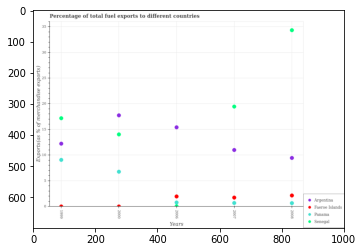

Number of QA =  29





,Years,Senegal,Unnamed: 2,Faeroe Islands,Panama
0,2006,0.145931,15.379324,2.031712,0.823958
1,2007,19.386396,10.997413,1.811059,0.771871
2,1999,17.128178,12.206786,0.103810,9.067306
3,2008,34.157539,9.443707,2.203732,0.725828
4,2000,14.018097,17.684602,0.084066,6.794096


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in argentina in 2000 and that in 2006 ?
PREDICTED =  1.854069258104589
EXPECTED =  2.3310925008008017




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in senegal in 1999 and the percentage of exports to different countries in faeroe islands in 2000?
PREDICTED =  3.110081789331529
EXPECTED =  17.178659680372775




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of exports to different countries in argentina and percentage 

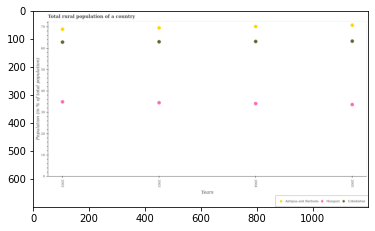

Number of QA =  28





,Years,Uzbekistan,Antigua and Barbuda,Hungary
0,2005,62.788225,70.152621,33.447239
1,2004,62.640061,69.559576,33.897683
2,2003,62.483577,68.946411,34.292723
3,2002,62.320699,68.318748,34.657591


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in uzbekistan in 2003 and that in 2004 ?
PREDICTED =  -0.15648353803151593
EXPECTED =  -0.14999999999999858




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in uzbekistan in 2003 and the rural population in hungary in 2005?
PREDICTED =  -0.30464722143614154
EXPECTED =  29.378




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the rural population in uzbekistan and rural population in hungary ?
PREDICTED =  28.40763676932638
EXPECTED =  29.677999999999997




				 2 / 3 = 0.6667


is_built_wi

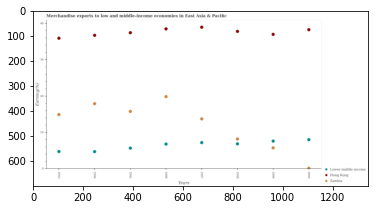

Number of QA =  28





,Years,Zambia,Hong Kong,Lower middle income
0,2000,0.214352,38.442828,8.119164
1,1996,19.995436,38.664465,6.895239
2,1999,5.861392,37.174235,7.729827
3,1995,15.905810,37.621617,5.798696
4,1998,8.302877,37.994363,6.960281
5,1994,18.055275,36.898408,4.804010
6,1993,15.029328,36.071857,4.829587
7,1997,13.854487,39.151021,7.320001


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in hong kong in 1994 and that in 1998 ?
PREDICTED =  -1.0959545630600545
EXPECTED =  -1.085899404128




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in zambia in 1994 and the percentage of amount earned from merchandise exports in hong kong in 1997?
PREDICTED =  4.200787926094613
EXPECTED =  -21.05369948694411




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percentage of amount earned from merchandise exports in 

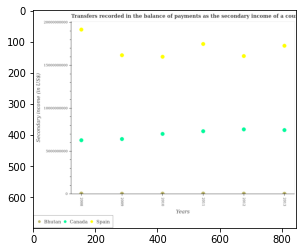

Number of QA =  28





,Years,Bhutan,Spain,Canada
0,2012,1.012200e+08,1.612391e+10,7.584918e+09
1,2011,1.171349e+08,1.752332e+10,7.368328e+09
2,2008,1.191461e+08,1.919461e+10,6.317822e+09
3,2013,1.012808e+08,1.732660e+10,7.509815e+09
4,2010,1.216684e+08,1.604004e+10,7.066083e+09
5,2009,9.133428e+07,1.621893e+10,6.458444e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in canada in 2011 and that in 2013 ?
PREDICTED =  -141486824.4131918
EXPECTED =  -132129124




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in bhutan in 2011 and the secondary income of in canada in 2010?
PREDICTED =  -4533525.729763642
EXPECTED =  -6956936331.16




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the secondary income of in spain and secondary income of in bhutan ?
PREDICTED =  15948701242.507421
EXPECTED =  19115938560.83




				 0 / 3 = 0.0


is_built_with_cuda: Tru

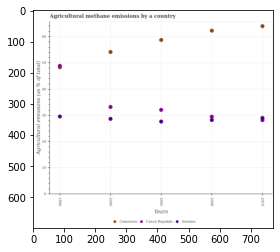

Number of QA =  28





,Years,Sweden,Czech Republic,Cameroon
0,2005,27.929912,32.416236,59.200246
1,2008,28.516713,29.791971,62.766513
2,1990,29.888536,49.261639,NaN
3,2010,29.311440,28.494095,64.539106
4,2000,28.960427,33.517115,54.617629


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural methane emitted in cameroon in 2008 and that in 2010 ?
PREDICTED =  -1.7725930505380632
EXPECTED =  -1.7140829130356963




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural methane emitted in cameroon in 1990 and the amount of agricultural methane emitted in czech republic in 2008?
PREDICTED =  178.35698108815586
EXPECTED =  18.814471052952488




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the amount of agricultural methane emitted in sweden and amount of agricultural methane emi

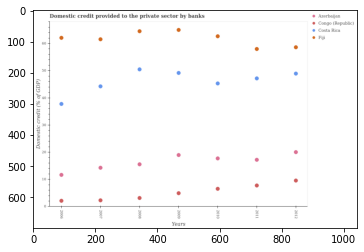

Number of QA =  29





,Years,Azerbaijan,Fiji,Congo (Republic),Costa Rica
0,2012,20.257200,58.997279,9.773270,49.254783
1,2006,11.829716,62.471301,2.303912,38.029064
2,2011,17.428415,58.333447,7.941928,47.482147
3,2008,15.768555,64.864712,3.339504,50.829464
4,2009,19.186654,65.374962,5.083552,49.502542
5,2010,17.943809,63.027342,6.699771,45.610612
6,2007,14.497524,61.911815,2.461492,44.506335


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided to the private sector by banks in fiji in 2009 and that in 2011 ?
PREDICTED =  7.041515055176674
EXPECTED =  7.017401709667205




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided to the private sector by banks in costa rica in 2011 and the domestic credit provided to the private sector by banks in congo (republic) in 2010?
PREDICTED =  1.8715353934424428
EXPECTED =  40.64030397686332




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the domestic credit provided to the private s

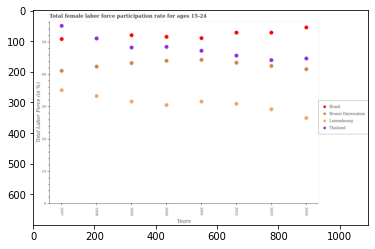

Number of QA =  29





,Years,Brunei Darussalam,Brazil,Luxembourg,Thailand
0,1997,41.363873,51.185447,35.344211,55.332938
1,2004,41.895285,54.826382,26.735898,45.187924
2,2003,42.880909,53.238026,29.430818,44.702637
3,1998,42.676078,NaN,33.545145,51.427113
4,1999,43.787635,52.410883,31.844861,48.613390
5,2002,43.907818,53.248397,31.145476,46.115534
6,2001,44.808260,51.539578,31.831958,47.619794
7,2000,44.487818,51.915302,30.767623,48.810076


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in brunei darussalam in 1998 and that in 2004 ?
PREDICTED =  0.780793309552223
EXPECTED =  0.8000030517577983




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in brazil in 2004 and the female labor force participation rate in brunei darussalam in 2003?
PREDICTED =  1.5883557149603647
EXPECTED =  11.9000015258789




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the female labor force participation rate in luxembourg and female labor force participat

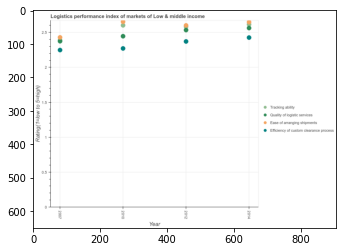

Number of QA =  29





,Year,Quality of logistic services,Tracking ability,Ease of arranging shipments,Efficiency of custom clearance process
0,2010,2.456518,2.613035,2.662702,2.281255
1,2014,2.574290,NaN,2.656131,2.437880
2,2012,2.545654,NaN,2.609827,2.382961
3,2007,2.388605,NaN,2.440203,2.259838


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi rating of ease of arranging shipments in 2010 and that in 2012 ?
PREDICTED =  0.052875140283688005
EXPECTED =  0.05250000000000021




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi rating of tracking ability in 2010 and the lpi rating of efficiency of custom clearance process in 2014?
PREDICTED =  nan
EXPECTED =  0.1751634273504301




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the lpi rating of tracking ability and lpi rating of efficiency of custom clearance process ?
PREDICTED =  0.17515550083885012
EXPECTED = 

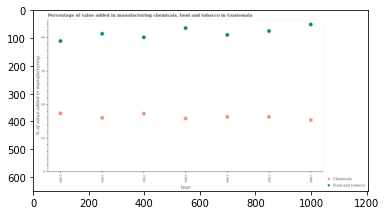

Number of QA =  27





,Year,Food and tobacco,Chemicals
0,1981,41.068002,16.151304
1,1986,43.820214,15.481498
2,1982,40.015550,17.385862
3,1985,41.881820,16.399431
4,1983,42.746923,15.959250
5,1984,40.753223,16.384516
6,1980,38.907633,17.420808


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by  manufacturing chemicals in 1980 and that in 1985 ?
PREDICTED =  1.021376469036312
EXPECTED =  1.0261338084434009




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by  manufacturing chemicals in 1982 and the value added by manufacturing food and tobacco in 1981?
PREDICTED =  1.2345577134719434
EXPECTED =  -23.7726959760664




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the value added by manufacturing food and tobacco and value added by  manufacturing chemicals ?
PREDICTED =  0.0
EXPECTED =  21.

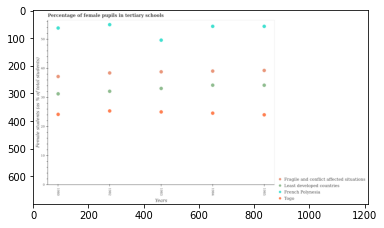

Number of QA =  29





,Years,Togo,Least developed countries,Fragile and conflict affected situations,French Polynesia
0,1984,24.727885,34.341708,39.182505,54.531311
1,1982,25.490566,32.230316,38.549952,55.112740
2,1980,24.319521,31.350989,37.286514,53.965098
3,1985,24.178384,34.343905,39.411035,54.530696
4,1983,25.175214,33.241926,38.949632,49.826187


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in tertiary schools in fragile and conflict affected situations in 1983 and that in 1984 ?
PREDICTED =  0.0
EXPECTED =  -0.24330139160160513




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in tertiary schools in fragile and conflict affected situations in 1984 and the percentage of female pupils in tertiary schools in togo in 1982?
PREDICTED =  0.3996797030356092
EXPECTED =  13.675370185546903




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: 

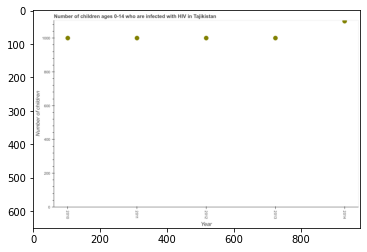

Number of QA =  24





,Year,Number of children
0,2014,1101.215731
1,2011,1001.107116
2,2013,1001.421205
3,2012,1001.516677
4,2010,1001.613387


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of children living with hiv in 2010 and 2012 ?
PREDICTED =  0.0967107686202553
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of children living with hiv ?
PREDICTED =  1001.5166765825237
EXPECTED =  1000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of children living with hiv in 2010 to that in 2014 ?
PREDICTED =  0.9095523782567589
EXPECTED =  0.9090909090909091




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.






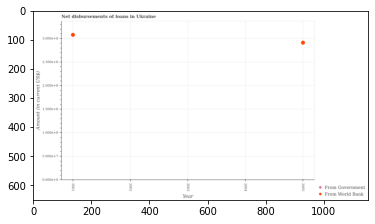

Number of QA =  21





,Year,From World Bank,From Government
0,2003,NaN,NaN
1,2002,NaN,NaN
2,2005,2.926251,NaN
3,2001,3.092465,NaN
4,2004,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements of loan from world bank in 2001 and that in 2005 ?
PREDICTED =  nan
EXPECTED =  16619000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements of loan from government in 2003 and the net disbursements of loan from world bank in 2004?
PREDICTED =  nan
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest net disbursements of

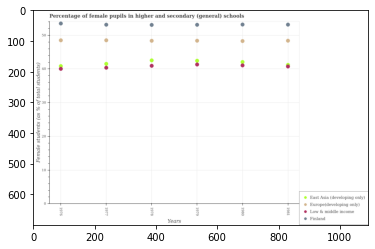

Number of QA =  29





,Years,Low & middle income,Europe(developing only,Finland,Fast Asia (developing only)
0,1977,40.771978,48.989785,53.662397,41.946413
1,1978,41.378420,48.854777,53.583111,42.991732
2,1981,41.667047,48.868206,53.695196,41.173673
3,1979,41.753805,48.873151,53.614102,42.900362
4,1976,40.466814,49.021533,54.034963,41.280493
5,1980,41.479325,48.767298,53.702999,42.507843


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in higher and secondary schools in low & middle income in 1976 and that in 1979 ?
PREDICTED =  -41.753805425479634
EXPECTED =  -1.2863006591797088




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in higher and secondary schools in low & middle income in 1981 and the percentage of female pupils in higher and secondary schools in europe(developing only) in 1976?
PREDICTED =  -41.66704670222829
EXPECTED =  -7.76533126831049




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1979, what is the difference betwee

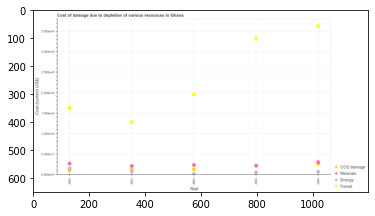

Number of QA =  29





,Year,Energy,Minerals,CO2 damage,Forest
0,1993,0.082107,0.316581,0.270955,3.644999
1,1984,0.111286,0.281066,0.158057,1.637233
2,1985,0.088367,0.222643,0.145510,1.293770
3,1986,0.025069,0.247062,0.142362,1.971908
4,1992,0.064167,0.230265,NaN,3.341490


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal in 1984 and that in 1985 ?
PREDICTED =  0.012547220469544873
EXPECTED =  -3410231.2800216805




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of forests in 1986 and the cost of damage due to depletion of energy in 1992?
PREDICTED =  -3.1991280699962594
EXPECTED =  190620266.79060742




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio 

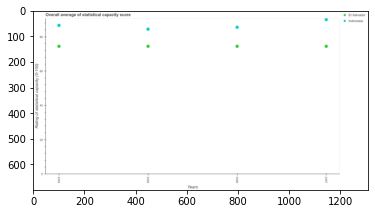

Number of QA =  27





,Years,El Salvador,Indonesia
0,2004,74.966315,87.157272
1,2005,74.966492,84.941295
2,2006,74.957402,86.076740
3,2007,74.968763,90.583992


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in indonesia in 2005 and that in 2006 ?
PREDICTED =  -1.1354449582535864
EXPECTED =  -1.1111111111111711




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in indonesia in 2005 and the rating of statistical capacity in el salvador in 2007?
PREDICTED =  -5.64269739318847
EXPECTED =  10.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the rating of statistical capacity in indonesia and rating of statistical capacity in el salvador ?
PREDICTED =  15.619249611893508

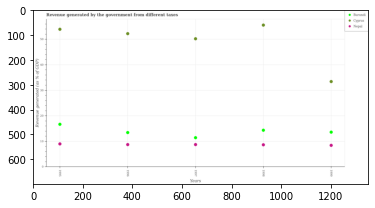

Number of QA =  28





,Years,Cyprus,Nepal,Burundi
0,1996,52.149429,8.864363,13.536265
1,1998,55.527051,8.787314,14.444314
2,1995,53.840461,9.129353,16.810121
3,1999,33.470617,8.597294,13.709367
4,1997,50.136559,8.856210,11.560685


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by the government in burundi in 1995 and that in 1996 ?
PREDICTED =  3.2738565077003194
EXPECTED =  3.2392099992117007




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by the government in nepal in 1998 and the revenue generated by the government in cyprus in 1997?
PREDICTED =  -0.06889580819070673
EXPECTED =  -41.56235578366546




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the revenue generated by the government in cyprus and revenue generated by the government in nepal ?
PREDICTED =

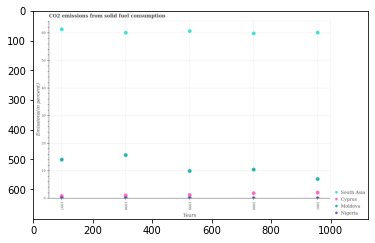

Number of QA =  29





,Years,Nigeria,Moldova,South Asia,Cyprus
0,1998,0.350035,15.739006,59.828542,1.283030
1,1999,0.253716,10.028035,60.406574,1.420021
2,1997,0.290662,14.117939,61.053365,1.047750
3,2000,0.205654,10.556304,59.599302,2.036846
4,2001,0.245381,7.169058,59.896958,2.266846


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in cyprus in 1998 and that in 2000 ?
PREDICTED =  -0.7538159194939529
EXPECTED =  -0.78358708618506




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in nigeria in 1998 and the total co2 emitted in cyprus in 2000?
PREDICTED =  0.14438124287546672
EXPECTED =  -1.755026882865592




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the total co2 emitted in cyprus and total co2 emitted in moldova ?
PREDICTED =  -0.6963081432671601
EXPECTED =  -4.919971807318989




				 1 / 3 = 0.3333


is_built_

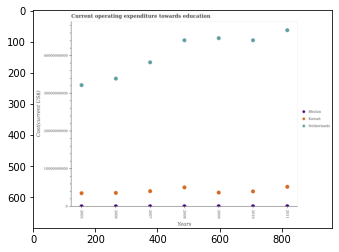

Number of QA =  28





,Years,Bhutan,Netherlands,Kuwait
0,2007,1.560606e+08,3.834268e+10,4.177384e+09
1,2008,1.302962e+08,4.417791e+10,5.157942e+09
2,2006,1.448923e+08,3.400984e+10,3.697913e+09
3,2009,1.248142e+08,4.473428e+10,3.787899e+09
4,2005,1.489453e+08,3.229747e+10,3.624282e+09
5,2011,1.697594e+08,4.685999e+10,5.327802e+09
6,2010,1.537216e+08,4.418103e+10,4.093576e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure towards education in kuwait in 2010 and that in 2011 ?
PREDICTED =  -1234226438.342207
EXPECTED =  -1222016000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure towards education in netherlands in 2005 and the expenditure towards education in bhutan in 2009?
PREDICTED =  -12436817063.956379
EXPECTED =  32132203222.3965




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the expenditure towards education in kuwait and expenditure towards education in bhutan ?
PREDICTED =  5327802047.55719
EXPECTED =  4

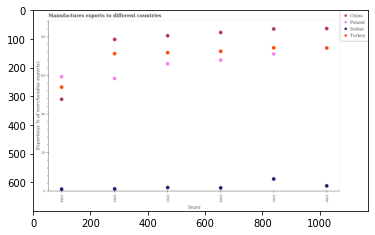

Number of QA =  29





,Years,Sudan,China,Poland,Turkey
0,1995,6.569629,84.040350,71.118974,74.317283
1,1984,1.307693,47.683919,59.326843,53.966233
2,1996,3.016615,84.265817,NaN,74.196695
3,1994,1.912952,82.203897,67.946839,72.515686
4,1992,1.418169,78.594030,58.466467,71.277505
5,1993,2.132745,80.541440,66.056251,71.833632


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in china in 1992 and that in 1993 ?
PREDICTED =  -1.9474099080019869
EXPECTED =  -1.8847662542211907




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in sudan in 1984 and the percentage of exports to different countries in turkey in 1994?
PREDICTED =  -0.6923065848729428
EXPECTED =  -71.49350878579921




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of exports to different countries in poland and percentage of exports t

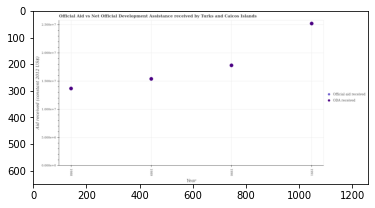

Number of QA =  27





,Year,Official aid received,ODA received
0,1990,NaN,1.782304
1,1988,NaN,1.370691
2,1989,NaN,1.541914
3,1991,NaN,2.523196


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in 1989 and that in 1990 ?
PREDICTED =  -0.2403896569576136
EXPECTED =  -2400000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in 1990 and the official aid received in 1991?
PREDICTED =  -0.7408923090110053
EXPECTED =  -7430000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the official aid received and oda received ?
PREDICTED =  nan
EXPECTED =  0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training ste

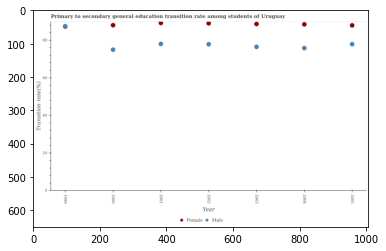

Number of QA =  27





,Year,Male,Female
0,2005,77.768766,87.720413
1,2002,77.772495,88.765940
2,2004,75.741361,88.257585
3,2003,76.379542,88.449257
4,1999,87.281225,NaN
5,2001,77.918850,88.929629
6,2000,74.865491,87.823941


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among male students in 1999 and that in 2003 ?
PREDICTED =  10.901683227652967
EXPECTED =  11.007766723632699




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the transition rate among female students and transition rate among male students ?
PREDICTED =  82.72041300077345
EXPECTED =  11.1300048828125




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the transition ra

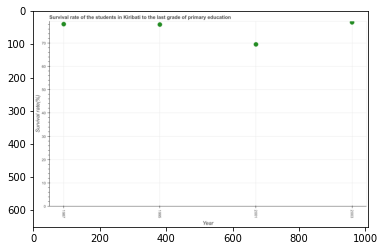

Number of QA =  24





,Year,Survival rate(%)
0,1995,78.490112
1,2003,79.459297
2,1987,78.714977
3,2001,69.985474


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate in primary education in 1995 and 2001 ?
PREDICTED =  8.504638080528665
EXPECTED =  8.509980253906207




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median survival rate in primary education ?
PREDICTED =  1998.0
EXPECTED =  78.043815




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the survival rate in primary education in 1995 to that in 2001 ?
PREDICTED =  1.1215200465690771
EXPECTED =  1.1225414299713738




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

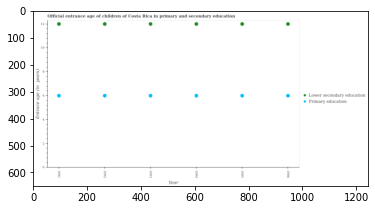

Number of QA =  27





,Year,Primary education,Lower secondary education
0,1994,6.091324,12.151609
1,1991,6.093652,12.157408
2,1996,6.090508,12.154517
3,1993,6.088001,12.154572
4,1995,6.091543,12.154807
5,1992,6.090116,12.153895


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of chiildren in primary education in 1991 and that in 1996 ?
PREDICTED =  0.00314401972066225
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of children in lower secondary education in 1995 and the entrance age of chiildren in primary education in 1992?
PREDICTED =  0.00091164077726269
EXPECTED =  6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the entrance age of children in lower secondary education and entrance age of chiildren in primary education ?
PREDICTED =  -0.002962680

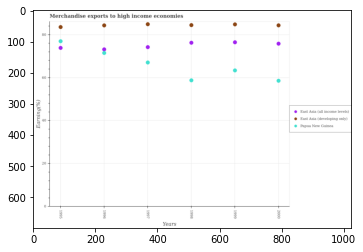

Number of QA =  28





,Years,East Asia (developing only),Papua New Guinea,East Asia (all income levels)
0,2000,84.486705,58.713684,75.964355
1,1995,83.745934,77.083225,74.060180
2,1996,84.485607,71.662433,73.321076
3,1998,84.604563,58.961292,76.409396
4,1999,84.944357,63.545401,76.652110
5,1997,85.049668,67.214677,74.379783


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in papua new guinea in 1995 and that in 1999 ?
PREDICTED =  13.537824116553516
EXPECTED =  13.578950919685795




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in papua new guinea in 1998 and the percentage of amount earned from merchandise exports in east asia (developing only) in 1996?
PREDICTED =  -12.70114173686084
EXPECTED =  -25.566962907094485




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of amo

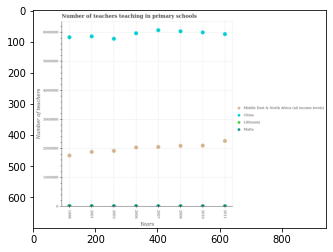

Number of QA =  29





,Years,Lithuania,Malta,China,Middle East & North Africa (all income levels)
0,1998,NaN,30274.809537,5.863452e+06,1.778068e+06
1,2006,NaN,28790.370230,6.004880e+06,2.055840e+06
2,2010,NaN,23402.502667,6.035539e+06,2.120880e+06
3,2011,NaN,25808.352078,5.973271e+06,2.282358e+06
4,2003,NaN,29703.568122,5.812604e+06,1.937055e+06
5,2001,NaN,27140.372744,5.895263e+06,1.900485e+06
6,2008,NaN,27233.991952,6.068927e+06,2.112735e+06
7,2007,NaN,26797.102313,6.111188e+06,2.076730e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of teachers teaching in primary schools in malta in 1998 and that in 2011 ?
PREDICTED =  4466.4574592161625
EXPECTED =  -3.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of teachers teaching in primary schools in lithuania in 2003 and the number of teachers teaching in primary schools in china in 2010?
PREDICTED =  -6005835.679442328
EXPECTED =  -5985593.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the number of teachers teaching in primary schools in malta and number of teachers teaching in primary

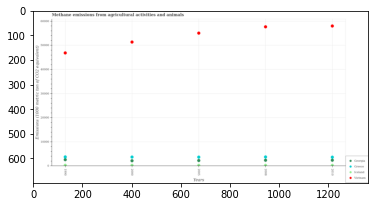

Number of QA =  29





,Years,Georgia,Vietnam,Iceland,Greece
0,1990,2791.691562,47155.043936,447.251547,3918.173892
1,2008,2562.866648,58048.943630,442.383533,3914.931688
2,2000,2280.550075,51766.428067,366.569941,3884.389685
3,2010,2580.910629,58404.179783,368.409177,3777.522494
4,2005,2411.283404,55413.359647,437.342894,3818.773500


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in georgia in 2000 and that in 2005 ?
PREDICTED =  -130.73332937604437
EXPECTED =  -95.69999999999982




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in vietnam in 1990 and the amount of methane emitted in iceland in 2010?
PREDICTED =  -11249.135847058984
EXPECTED =  46635.299999999996




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the amount of methane emitted in georgia and amount of methane emitted in vietnam ?
PREDICTED =  -258160.6527454592
EXPECTED =  -55651.8




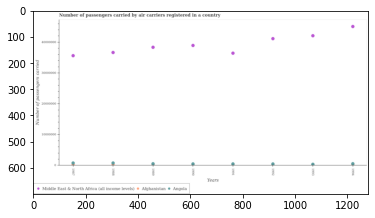

Number of QA =  28





,Years,Afghanistan,Angola,Middle East & North Africa (all income levels)
0,1987,863771.902141,327772.752933,3.581252e+07
1,1988,874553.471745,318626.018672,3.685576e+07
2,1994,NaN,641528.161685,4.531657e+07
3,1991,NaN,572951.121259,3.662781e+07
4,1992,NaN,565139.372157,4.134651e+07
5,1990,NaN,560294.836166,3.911445e+07
6,1989,NaN,628691.966482,3.854675e+07
7,1993,NaN,467823.647287,4.228418e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of passengers carried by air carriers in angola in 1987 and that in 1988 ?
PREDICTED =  9146.734261589125
EXPECTED =  -4000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of passengers carried by air carriers in angola in 1992 and the number of passengers carried by air carriers in afghanistan in 1989?
PREDICTED =  -63552.59432496375
EXPECTED =  220000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the number of passengers carried by air carriers in angola and number of passengers carried by air carri

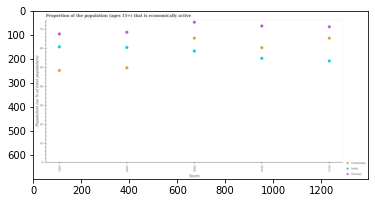

Number of QA =  28





,Years,Norway,Guatemala,India
0,1981,68.126856,48.873644,61.267222
1,1994,69.015559,50.262220,61.030157
2,2000,74.364929,65.909673,59.092055
3,2012,71.958130,65.929751,53.861620
4,2010,72.388241,60.924218,55.274720


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the population that is economically active in guatemala in 1981 and that in 1994 ?
PREDICTED =  -1.3885761118618376
EXPECTED =  -1.399997711181598




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the population that is economically active in norway in 1981 and the proportion of the population that is economically active in india in 2012?
PREDICTED =  -3.8312737958148944
EXPECTED =  14.199996948242095




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the proportion of the population that is econom

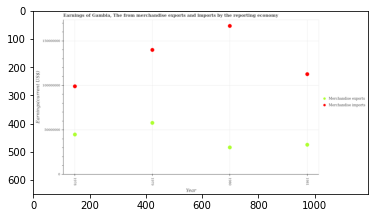

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,1978,9.956527e+07,4.546738e+07
1,1979,1.405359e+08,5.853203e+07
2,1980,1.675546e+08,3.089897e+07
3,1981,1.132400e+08,3.389340e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 1978 and that in 1981 ?
PREDICTED =  -13674748.872648552
EXPECTED =  -13654200.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 1979 and the earnings from merchandise imports in 1980?
PREDICTED =  27633063.806638766
EXPECTED =  -108897000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1981, what is the difference between the earnings from merchandise exports and earnings from merchandise imports ?
PREDICTED =  137892819.29624975
EXPECTED =  -79294409.74




				 1 / 3 = 0.3333


i

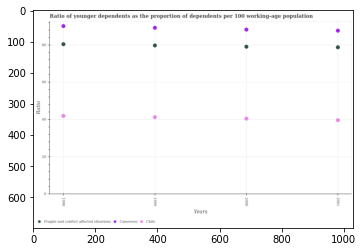

Number of QA =  28





,Years,Chile,Fragile and conflict affected situations,Cameroon
0,1998,42.356129,81.078292,90.830079
1,1999,41.702490,80.450273,89.900894
2,2000,40.944048,79.743341,88.968669
3,2001,40.121298,79.413466,88.400536


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio(young) in chile in 2001 ?
PREDICTED =  0.020065665361009215
EXPECTED =  39.6026729165264




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio(young) in cameroon ?
PREDICTED =  0.9992498124531133
EXPECTED =  90.08742724601306




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio(young) in chile ?
PREDICTED =  1.0007501875468867
EXPECTED =  39.6026729165264




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step

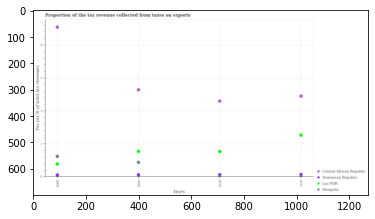

Number of QA =  29





,Years,Dominican Republic,Mongolia,Central African Republic,Lao PDR
0,2011,0.038717,0.075343,2.459721,1.275164
1,2008,0.068086,0.632111,4.549330,0.399907
2,2010,0.069461,0.019769,2.304760,0.779009
3,2009,0.073147,0.450291,2.647575,0.783801


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the tax revenue collected in mongolia in 2008 and that in 2010 ?
PREDICTED =  0.6123420324965039
EXPECTED =  0.6088116429709639




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the tax revenue collected in lao pdr in 2008 and the proportion of the tax revenue collected in central african republic in 2009?
PREDICTED =  -0.38389357376844285
EXPECTED =  -2.2535418727668723




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the proportion of the tax revenue collected in mongolia and proportion of the 

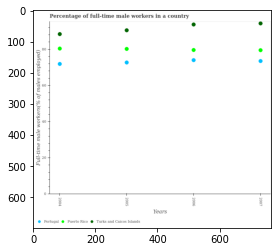

Number of QA =  28





,Years,Turks and Caicos Islands,Puerto Rico,Portugal
0,2007,94.679723,79.854063,73.896785
1,2006,94.057404,79.957204,74.360422
2,2004,88.731652,80.786757,72.221127
3,2005,90.874962,80.572207,73.057527


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in puerto rico in 2004 and that in 2007 ?
PREDICTED =  0.9326943679224087
EXPECTED =  0.9000015258789062




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in turks and caicos islands in 2004 and the percentage of full-time male workers in puerto rico in 2005?
PREDICTED =  14.10751611433713
EXPECTED =  8.200004577636705




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of full-time male workers in puerto rico and percentage of full-time m

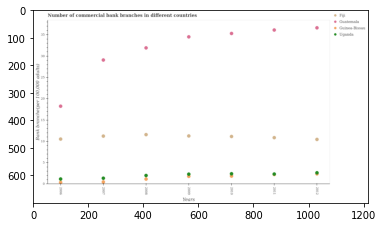

Number of QA =  29





,Years,Uganda,Fiji,Guatemala,Guinea-Bissau
0,2006,1.249473,10.526937,18.171276,0.433151
1,2012,2.636451,10.452064,36.394982,NaN
2,2008,2.071149,11.567506,31.716549,1.213080
3,2009,2.380983,11.265368,34.284798,1.866074
4,2011,2.362547,10.873021,35.879456,NaN
5,2007,1.425436,11.216202,28.888684,0.533708
6,2010,2.454215,11.135701,35.068441,1.913742


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of commercial bank branches in guatemala in 2006 and that in 2010 ?
PREDICTED =  -16.89716481215561
EXPECTED =  -17.06496672196021




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of commercial bank branches in guatemala in 2011 and the number of commercial bank branches in fiji in 2008?
PREDICTED =  4.162907221009554
EXPECTED =  24.539478101203386




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the number of commercial bank branches in guinea-bissau and number of commercial bank branches in guatemala ?
PRED

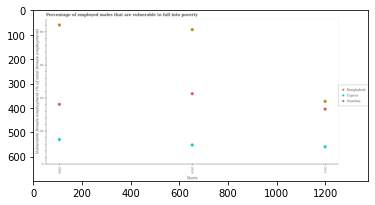

Number of QA =  28





,Years,Cyprus,Namibia,Bangladesh
0,2011,10.677044,33.344787,37.986511
1,2000,14.996788,36.175635,83.961981
2,2010,11.758963,42.606301,81.141211


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed males who are vulnerable to fall into poverty in cyprus in 2000 and that in 2010 ?
PREDICTED =  3.2378249581087832
EXPECTED =  3.2999992370606




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed males who are vulnerable to fall into poverty in bangladesh in 2011 and the percentage of employed males who are vulnerable to fall into poverty in cyprus in 2000?
PREDICTED =  -45.975469887598074
EXPECTED =  23.100000381469698




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentag

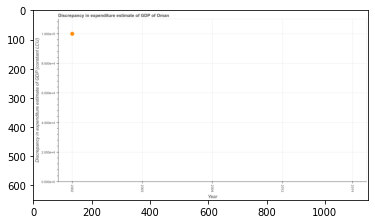

Number of QA =  16





,Year,Discrepancy in expenditure estimate of GDP (constant LCU)
0,2004,NaN
1,2012,NaN
2,2003,NaN
3,2014,NaN
4,2002,35.33117


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median discrepancy in expenditure estimate of gdp ?
PREDICTED =  35.33117016274339
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest discrepancy in expenditure estimate of gdp ?
PREDICTED =  1.0
EXPECTED =  100000.0




				 0 / 2 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (constant LCU)
EXPECTED =  20000.0




				 0 / 3 = 0.0


> what is the title of the graph ?
PREDICTED =  Discrepancy in expenditure estimate of GDP of Oman
EXPECTED =  Discrepancy in expenditure estimate of GDP of Oman




				 1 / 4 = 0.25


> what is the label or title of the x-axis ?
PREDICTED 

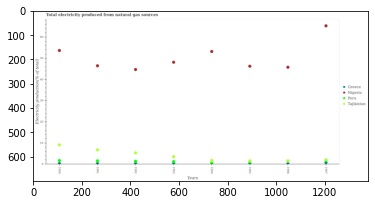

Number of QA =  29





,Years,Peru,Nigeria,Tajikistan,Greece
0,1991,1.692199,46.380217,6.858464,0.435698
1,1995,0.550730,46.174837,1.720264,NaN
2,1993,1.340001,48.089264,3.681333,0.429823
3,1992,0.424074,44.690724,5.444308,1.525995
4,1994,0.427110,53.124106,1.870088,NaN
5,1997,NaN,65.164067,2.202932,0.892230
6,1990,1.833109,53.624898,9.162750,0.456093
7,1996,NaN,45.682025,1.711655,0.385865


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in peru in 1992 and that in 1993 ?
PREDICTED =  -0.9159269356475751
EXPECTED =  0.17557459147257015




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in tajikistan in 1994 and the total electricity produced in peru in 1990?
PREDICTED =  -7.292662247757823
EXPECTED =  0.011667148625640111




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the total electricity produced in peru and total electricity produced in tajikistan ?
PREDICTED =  -26.384570915696017
EXPECTED =  -2.323

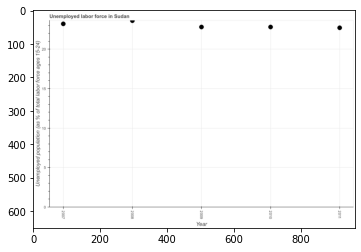

Number of QA =  24





,Year,Unemployed population (as % of total labor force ages 15-24)
0,2009,22.822537
1,2010,22.826829
2,2008,23.638419
3,2011,22.730035
4,2007,23.233661


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed youth population in 2008 and 2011 ?
PREDICTED =  0.9083846080620717
EXPECTED =  0.8999996185301917




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed youth population ?
PREDICTED =  2009.0
EXPECTED =  22.7999992370605




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total unemployed youth population in 2007 to that in 2010 ?
PREDICTED =  1.0178225200458955
EXPECTED =  1.0175439271606996




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training 

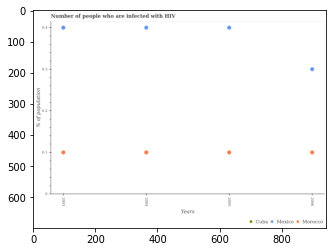

Number of QA =  28





,Years,Cuba,Mexico,Morocco
0,2006,NaN,0.300049,0.100858
1,2005,NaN,0.399795,0.100740
2,2004,NaN,0.399796,0.100622
3,2003,NaN,0.399806,0.100512


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in cuba in 2004 and that in 2005 ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in cuba in 2006 and the percentage of hiv infected population in in morocco in 2005?
PREDICTED =  -0.10074037932587857
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of hiv infected population in in mexico and percentage of hiv infected population in in morocco ?
PREDICTED =  -0.1026832349234296

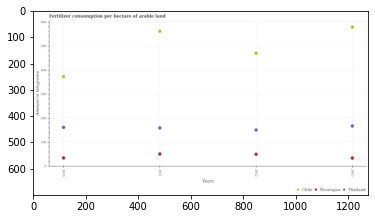

Number of QA =  28





,Years,Thailand,Chile,Nicaragua
0,2010,164.811994,376.856530,36.609526
1,2012,153.451190,474.608617,52.214383
2,2011,162.243648,566.520856,53.543570
3,2013,170.284002,583.630141,36.421320


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in thailand in 2010 and that in 2012 ?
PREDICTED =  11.360803718333784
EXPECTED =  11.194237229945998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in thailand in 2011 and the amount of fertilizer consumption in chile in 2010?
PREDICTED =  -2.5683458954511593
EXPECTED =  -213.44894039027588




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the amount of fertilizer consumption in thailand and amount of fertilizer consumption in chile ?
PREDICTED =  476.5068

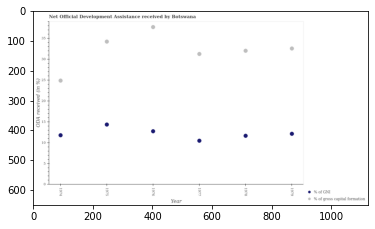

Number of QA =  27





,Year,% of gross capital formatior,% of GNI
0,1974,24.912950,11.831044
1,1978,32.031284,11.706665
2,1976,37.693000,12.793746
3,1977,31.256447,10.507520
4,1975,34.202870,14.380159
5,1979,32.563313,12.180492


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received as percentage of gross capital formation in 1977 and that in 1978 ?
PREDICTED =  -0.7748373764418339
EXPECTED =  -0.768361423522002




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received as percentage of gni in 1974 and the oda received as percentage of gross capital formation in 1977?
PREDICTED =  1.3235238598508001
EXPECTED =  -19.4833721212016




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1976, what is the difference between the oda received as percentage of gross capital formation and oda received as percentage of gni ?
PREDICTED = 

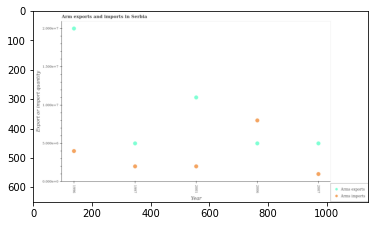

Number of QA =  27





,Year,Arms imports,Arms exports
0,2006,0.808864,0.507947
1,1997,0.206949,0.507548
2,2001,0.207088,1.108349
3,2007,0.107271,0.508356
4,1996,0.408022,2.010856


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports in 1996 and that in 2007 ?
PREDICTED =  1.5024998261667553
EXPECTED =  15000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms imports in 1997 and the arms exports in 2001?
PREDICTED =  -0.00013818679857993676
EXPECTED =  -9000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the arms imports and arms exports ?
PREDICTED =  -0.5809724667202815
EXPECTED =  -16000000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tra

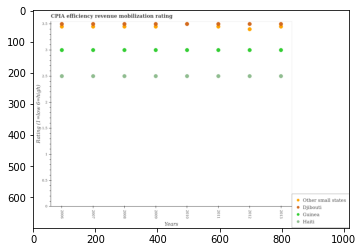

Number of QA =  29





,Years,Haiti,Djibouti,Guinea,Other small states
0,2006,2.499754,3.492398,2.998828,3.445616
1,2008,2.498281,3.493202,2.996753,3.445194
2,2011,2.499294,3.493270,2.997618,3.443129
3,2010,2.500004,3.496103,2.997745,NaN
4,2009,2.499164,3.493438,2.998810,3.445641
5,2012,2.498653,3.493408,2.997772,3.395344
6,2013,2.499931,3.492133,2.997990,3.445546
7,2007,2.499342,3.493120,2.997528,3.445831


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in djibouti in 2007 and that in 2013 ?
PREDICTED =  0.0009877414362140513
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in djibouti in 2011 and the cpia rating in other small states in 2008?
PREDICTED =  6.795147332105955e-05
EXPECTED =  0.04999999999999982




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the cpia rating in other small states and cpia rating in haiti ?
PREDICTED =  0.9397622645342385
EXPECTED =  0.9500000000000002




				 1 / 3 = 0.3333


is_built_with_cuda: True

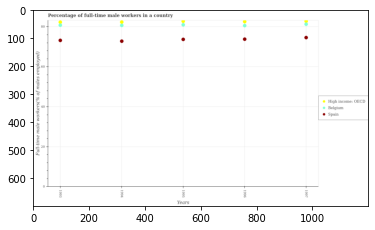

Number of QA =  28





,Years,High income: OECD,Spain,Belgium
0,1994,82.406568,72.821270,80.691476
1,1996,82.518976,73.776417,80.563487
2,1997,82.742566,74.588319,81.350307
3,1995,82.772034,73.710118,81.038243
4,1993,82.409527,73.192087,80.831743


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in belgium in 1995 and that in 1996 ?
PREDICTED =  0.47475673915305094
EXPECTED =  0.4000015258790057




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in belgium in 1995 and the percentage of full-time male workers in high income: oecd in 1996?
PREDICTED =  0.47475673915305094
EXPECTED =  -1.5877360394276963




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the percentage of full-time male workers in belgium and percentage of full-time male workers in

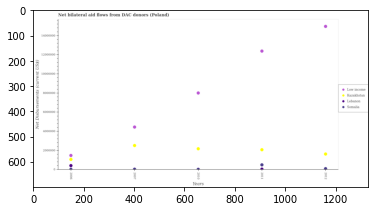

Number of QA =  29





,Years,Kazakhstan,Somalia,Lebanon,Low income
0,2012,1.677220e+06,128448.132350,NaN,1.510336e+07
1,2006,1.119207e+06,70730.821119,454628.551005,1.520010e+06
2,2011,2.129644e+06,536698.904634,75552.233173,1.250669e+07
3,2010,2.228448e+06,67438.070270,NaN,8.093120e+06
4,2007,2.568408e+06,77885.410180,NaN,4.522282e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in kazakhstan in 2011 and that in 2012 ?
PREDICTED =  452424.4537286458
EXPECTED =  450000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in low income in 2011 and the net bilateral aid flows in lebanon in 2010?
PREDICTED =  4413574.093414044
EXPECTED =  12360000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the net bilateral aid flows in kazakhstan and net bilateral aid flows in low income ?
PREDICTED =  9720917.854829155
EXPECTED =  -410000




				 1 / 3 = 0.3333


is

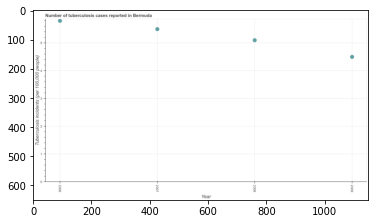

Number of QA =  24





,Year,"Tuberculosis incidents (per 100,000 people)"
0,2008,5.109595
1,2006,5.807816
2,2009,4.513021
3,2007,5.508919


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis incidents in 2008 and 2009 ?
PREDICTED =  0.59657394822736
EXPECTED =  0.5999999999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of tuberculosis incidents ?
PREDICTED =  5.3092567091214145
EXPECTED =  5.3




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of tuberculosis incidents in 2006 to that in 2008 ?
PREDICTED =  1.1366490275314731
EXPECTED =  1.1372549019607843




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.



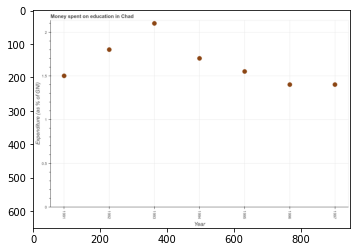

Number of QA =  24





,Year,Expenditure (as % of GNI)
0,1995,1.560351
1,1996,1.409791
2,1992,1.810260
3,1993,2.111313
4,1994,1.710215
5,1991,1.509606
6,1997,1.409821


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on education in 1993 and 1996 ?
PREDICTED =  0.7015216886221238
EXPECTED =  0.7000000000000002




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median expenditure on education ?
PREDICTED =  1.5603513101796291
EXPECTED =  1.54999999999998




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the expenditure on education in 1992 to that in 1997 ?
PREDICTED =  1.2840354227518314
EXPECTED =  1.2857142857142716




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wha

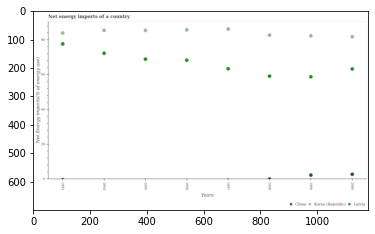

Number of QA =  26





,Years,Latvia,China,Korea (Republic)
0,1994,72.722343,NaN,85.931049
1,1995,69.322989,NaN,85.888419
2,1997,63.844540,NaN,86.697426
3,1996,68.740294,NaN,86.223177
4,1999,59.182927,2.527624,82.792571
5,1998,59.540567,0.264007,83.214483
6,1993,78.177727,0.104315,84.400478
7,2000,63.700028,3.009150,82.223610


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net energy imports in china in 1999 and that in 2000 ?
PREDICTED =  -0.4815262320349887
EXPECTED =  -0.46343068037447965




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net energy imports in latvia in 1998 and the net energy imports in korea (republic) in 1995?
PREDICTED =  -9.782421697901277
EXPECTED =  -26.288780459353795




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the net energy imports in korea (republic) and net energy imports in china ?
PREDICTED =  673.3712126111989
EXPECTED =  80.02458231820113




				 1 / 3

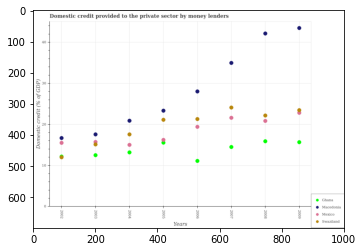

Number of QA =  29





,Years,Swaziland,Mexico,Macedonia,Ghana
0,2004,17.658150,15.109549,20.966963,13.274931
1,2002,12.114327,15.620482,16.759712,NaN
2,2007,24.194852,21.703753,35.065697,14.611221
3,2008,22.257351,20.936352,42.216063,15.985312
4,2009,23.518135,22.910120,43.540943,15.754319
5,2003,15.232040,15.847882,17.650675,12.594990
6,2006,21.381980,19.484163,28.111155,11.217808
7,2005,21.222048,16.310325,23.430160,15.627715


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided to the private sector by money lenders in swaziland in 2004 and that in 2009 ?
PREDICTED =  -5.859985169063339
EXPECTED =  -5.897671256830499




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided to the private sector by money lenders in mexico in 2002 and the domestic credit provided to the private sector by money lenders in swaziland in 2003?
PREDICTED =  -0.2273999863606999
EXPECTED =  0.3878669496043994




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
G

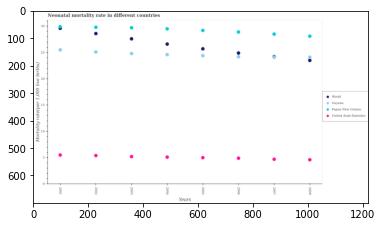

Number of QA =  29





,Years,Guyana,United Arab Emirates,World,Papua New Guinea
0,2006,24.141588,4.957791,24.845269,28.819360
1,2008,24.038367,4.661290,23.460934,28.031856
2,2004,24.540893,5.160501,26.527255,29.410283
3,2002,25.044065,5.440883,28.507709,29.709120
4,2001,25.445815,5.556215,29.810414,29.522039
5,2003,24.734770,5.263985,27.523693,29.604001
6,2005,24.342215,5.077655,25.639152,29.123859
7,2007,24.147854,4.759824,NaN,28.425198


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the neonatal mortality rate in guyana in 2002 and that in 2007 ?
PREDICTED =  0.896210640453468
EXPECTED =  1.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the neonatal mortality rate in papua new guinea in 2006 and the neonatal mortality rate in world in 2001?
PREDICTED =  -0.9910541812779208
EXPECTED =  -0.7000000000000028




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the neonatal mortality rate in united arab emirates and neonatal mortality rate in guyana ?
PREDICTED =  0.0
EXPECTED =  -19.4




				 0 / 3 = 0.0


is_bu

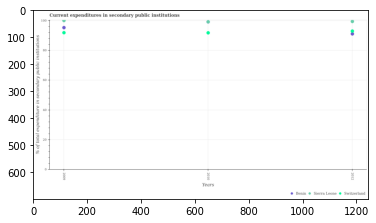

Number of QA =  28





,Years,Sierra Leone,Switzerland,Benin
0,2012,100.035699,93.504956,91.660922
1,2010,99.778812,92.372912,NaN
2,2009,100.671636,92.527805,95.791285


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in secondary public institutions in sierra leone in 2009 and that in 2012 ?
PREDICTED =  0.6359373200162963
EXPECTED =  0.6120681762694886




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in secondary public institutions in benin in 2012 and the current expenditures in secondary public institutions in sierra leone in 2010?
PREDICTED =  91.6609221869706
EXPECTED =  -8.095199584960795




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the current expenditures in secondary public instit

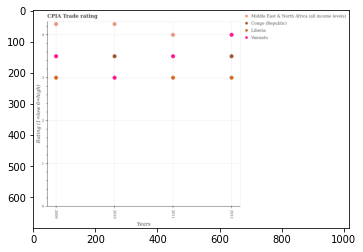

Number of QA =  29





,Years,Vanuatu,Congo (Republic),Liberia,Middle East & North Africa (all income levels)
0,2012,4.004232,3.505263,3.005231,NaN
1,2011,3.505821,NaN,3.006166,4.003924
2,2010,3.006003,3.505464,NaN,4.252253
3,2009,3.504743,NaN,3.005214,4.255030


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in middle east & north africa (all income levels) in 2010 and that in 2012 ?
PREDICTED =  0.24832833490865625
EXPECTED =  0.25




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in middle east & north africa (all income levels) in 2011 and the cpia rating in liberia in 2009?
PREDICTED =  -0.25110607870608703
EXPECTED =  1.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of th

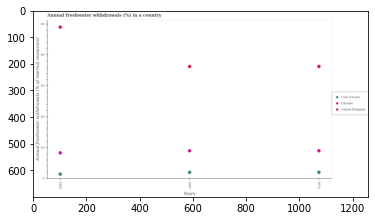

Number of QA =  28





,Years,Ukraine,Cote d'Ivoire,United Kingdom
0,2013,36.583260,2.167841,9.175550
1,1992,49.383987,1.554176,8.460504
2,2007,36.582236,2.150011,9.164173


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of annual freshwater withdrawals in cote d'ivoire in 2007 and that in 2013 ?
PREDICTED =  -0.017829950132562722
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of annual freshwater withdrawals in cote d'ivoire in 1992 and the percentage of annual freshwater withdrawals in ukraine in 2007?
PREDICTED =  -0.5958354018194945
EXPECTED =  -34.80197558749516




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of annual freshwater withdrawals in united kingdom and percentage of an

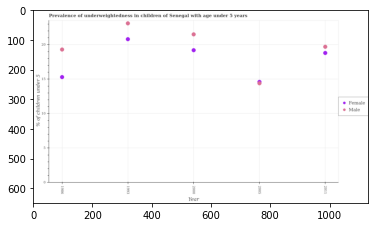

Number of QA =  27





,Year,Male,Female
0,1986,19.339082,15.332553
1,2000,21.546584,19.252131
2,1993,23.142028,20.845467
3,2011,19.739285,18.848484
4,2005,14.651137,14.461498


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of underweighted male children in 1993 and that in 2000 ?
PREDICTED =  1.5954445039447052
EXPECTED =  1.600000381469691




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of underweighted female children in 2000 and the percentage of underweighted male children in 2005?
PREDICTED =  4.790632496364024
EXPECTED =  4.800001144409199




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of underweighted male children and percentage of underweighted female children ?
PREDICTED =  0.0
EXPECTED =  2.

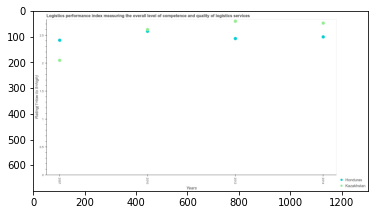

Number of QA =  27





,Years,Honduras,Kazakhstan
0,2014,2.489806,2.737075
1,2010,2.622140,2.591658
2,2012,2.459596,2.773333
3,2007,2.429491,2.069193


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in kazakhstan in 2007 and that in 2010 ?
PREDICTED =  -0.5224651858416176
EXPECTED =  -0.5500000000000003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in honduras in 2010 and the logistic performance index in kazakhstan in 2012?
PREDICTED =  0.16254390629411652
EXPECTED =  -0.18000000000000016




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the logistic performance index in kazakhstan and logistic performance index in honduras ?
PREDICTED =  1.4997415868737503
EXPE

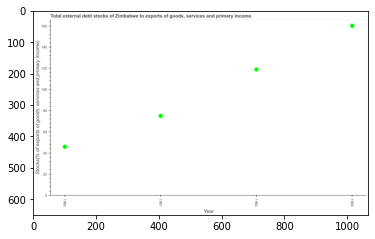

Number of QA =  24





,Year,"Stocks(% of exports of goods, services and primary income)"
0,1980,46.646819
1,1982,119.804173
2,1983,161.300360
3,1981,75.818057


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external debt stocks in 1982 and 1983 ?
PREDICTED =  -41.49618750868214
EXPECTED =  -41.257146939647




				 1 / 1 = 1.0


> what is the median external debt stocks ?
PREDICTED =  None
EXPECTED =  96.93929533251395




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the external debt stocks in 1980 to that in 1981 ?
PREDICTED =  0.6152468294401405
EXPECTED =  0.6109884078624728




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest external debt stocks ?
PREDICTED =  0.0
EXPECTED =  41.257146939647




				 2 / 5 = 0.4


is_

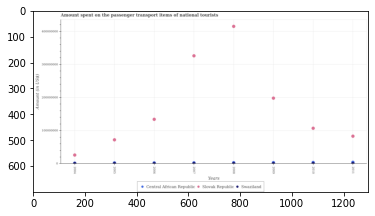

Number of QA =  28





,Years,Swaziland,Central African Republic,Slovak Republic
0,2008,3.670719e+06,NaN,4.168234e+08
1,2004,2.249764e+06,NaN,2.713579e+07
2,2007,3.351229e+06,NaN,3.276072e+08
3,2006,2.980750e+06,NaN,1.352432e+08
4,2011,4.864768e+06,NaN,8.427768e+07
5,2009,3.537069e+06,NaN,1.994804e+08
6,2010,3.649573e+06,NaN,1.085382e+08
7,2005,3.252446e+06,NaN,7.307206e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the passenger transport items of national tourists in central african republic in 2008 and that in 2009 ?
PREDICTED =  133649.31873719487
EXPECTED =  -200000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the passenger transport items of national tourists in central african republic in 2011 and the amount spent on the passenger transport items of national tourists in slovak republic in 2008?
PREDICTED =  -411958607.3978875
EXPECTED =  -411000000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda

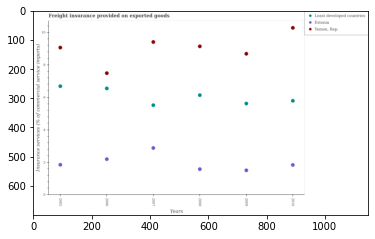

Number of QA =  28





,Years,Estonia,Least developed countries,"Yemen, Rep"
0,2005,1.876870,6.706240,9.093163
1,2010,1.863349,5.814758,10.305061
2,2006,2.221436,6.575387,7.514573
3,2007,2.908628,5.542860,9.428116
4,2009,1.531437,5.641834,8.711553
5,2008,1.605582,6.161186,9.161645


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the freight insurance provided on exported goods in estonia and freight insurance provided on exported goods in yemen, rep. ?
PREDICTED =  6.007303196863946
EXPECTED =  -7.17760589367613




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the freight insurance provided on exported goods in least developed countries in 2005 to that in 2006?
PREDICTED =  1.01990052372969
EXPECTED 

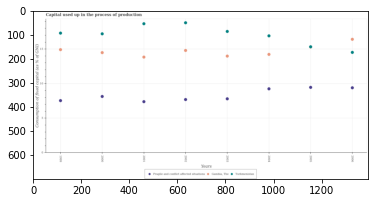

Number of QA =  28





,Years,"Gambia, The",Turkmenistan,Fragile and conflict affected situation:
0,2004,14.297937,16.988873,9.319440
1,2006,16.488022,14.597309,9.469710
2,2005,NaN,15.407590,9.533338
3,2003,14.058695,17.639967,7.871358
4,2000,14.547526,17.283462,8.203589
5,1999,15.001600,17.382803,7.592806
6,2001,13.903705,18.735914,7.451046
7,2002,14.869240,18.871132,7.766652


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the capital used up in the process of production in turkmenistan in 2000 and that in 2003 ?
PREDICTED =  -3.0924416775349535
EXPECTED =  -0.347058037579




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the capital used up in the process of production in gambia, the in 2003 and the capital used up in the process of production in turkmenistan in 1999?
PREDICTED =  1987.99840011358
EXPECTED =  -3.327572603988399




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished

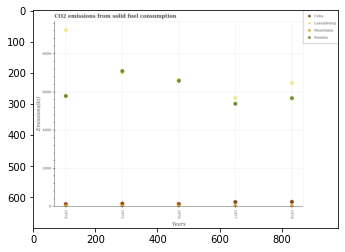

Number of QA =  29





,Years,Cuba,Sweden,Luxembourg,Mauritania
0,1974,152.997722,5792.083113,9230.169200,49.002386
1,1977,261.285708,5393.135467,5707.470924,37.288619
2,1978,268.691944,5681.121025,6480.604855,44.646740
3,1976,158.323604,6587.916653,NaN,35.257373
4,1975,178.398963,7084.350594,NaN,42.075316


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in luxembourg in 1975 and that in 1978 ?
PREDICTED =  -6480.604854988189
EXPECTED =  542.7159999999994




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in luxembourg in 1975 and the amount of co2 emitted in sweden in 1977?
PREDICTED =  -5393.135467063525
EXPECTED =  1635.4819999999982




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1976, what is the difference between the amount of co2 emitted in luxembourg and amount of co2 emitted in mauritania ?
PREDICTED =  -205.27043301194058
EXPECTED =  6611.601000000001






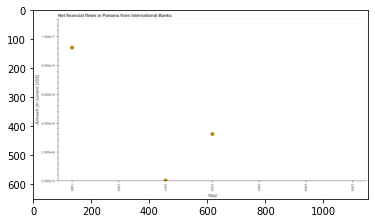

Number of QA =  19





,Year,Amount (in current US$)
0,1999,32.499339
1,2004,NaN
2,2002,11.491521
3,2000,NaN
4,2003,NaN
5,2001,0.211800
6,2005,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net financial flows from ibrd in 1999 and 2001 ?
PREDICTED =  32.287539146273275
EXPECTED =  9229000




				 0 / 1 = 0.0


> what is the median net financial flows from ibrd ?
PREDICTED =  None
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest net financial flows from ibrd ?
PREDICTED =  0.0
EXPECTED =  5998000




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest net financial flows from ibrd ?
PREDICTED =  -1991.1084787758582
EXPECTED =  9241000




				 0 / 5 = 0.0


> 

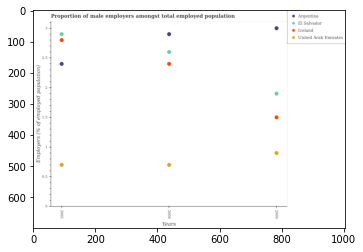

Number of QA =  29





,Years,United Arab Emirates,El] Salvador,Iceland,Argentina
0,2005,0.712873,2.922250,2.822348,2.423265
1,2008,0.712755,2.622542,2.421687,2.923886
2,2009,0.914071,1.919495,1.517014,3.024450


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of male employers in iceland in 2005 and that in 2008 ?
PREDICTED =  0.40066130276556455
EXPECTED =  0.3999998569488503




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of male employers in argentina in 2008 and the proportion of male employers in united arab emirates in 2009?
PREDICTED =  -0.10056435687938503
EXPECTED =  2.0000001192092878




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the proportion of male employers in united arab emirates and proportion of male employers in argentina ?
PREDICTED

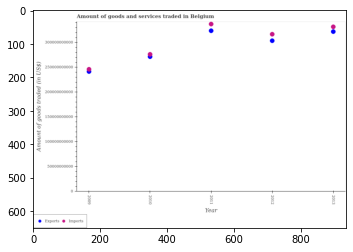

Number of QA =  27





,Year,Imports,Exports
0,2012,3.177028e+11,3.044905e+11
1,2013,3.324908e+11,3.227499e+11
2,2011,3.380747e+11,3.244746e+11
3,2010,2.773851e+11,2.723935e+11
4,2009,2.424621e+11,2.468434e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in 2009 and that in 2013 ?
PREDICTED =  -75906469301.27313
EXPECTED =  -80435000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in 2012 and the amount of goods imported in 2013?
PREDICTED =  -18259359601.648254
EXPECTED =  -28020000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the amount of goods exported and amount of goods imported ?
PREDICTED =  -13600051708.172607
EXPECTED =  -9687000000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False

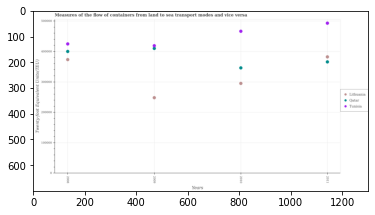

Number of QA =  28





,Years,Lithuania,Qatar,Tunisia
0,2010,295276.748144,346311.392677,466041.180147
1,2011,382275.198689,366055.269040,492729.691199
2,2008,373760.282043,400217.009377,424431.897093
3,2009,248454.687637,410228.811553,418853.109099


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in tunisia in 2009 and that in 2011 ?
PREDICTED =  -73876.58210070338
EXPECTED =  -74098.74386795604




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in qatar in 2011 and the container port traffic in lithuania in 2010?
PREDICTED =  19743.876363047922
EXPECTED =  70768.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the container port traffic in tunisia and container port traffic in qatar ?
PREDICTED =  69810.84872286965
EXPECTED =  24780.0




				 1 / 3 = 0.3333


is_built

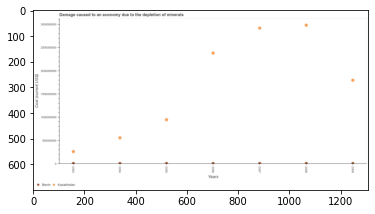

Number of QA =  27





,Years,Kazakhstan,Benin
0,2009,1.810588e+09,1.330205e+07
1,2004,5.670202e+08,1.176384e+07
2,2008,3.001839e+09,1.279135e+07
3,2003,2.703994e+08,1.292869e+07
4,2007,2.939840e+09,1.165430e+07
5,2006,2.398903e+09,1.244206e+07
6,2005,9.596829e+08,1.268199e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in benin in 2007 and that in 2008 ?
PREDICTED =  -1137046.559288593
EXPECTED =  -122744.6847777782




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in benin in 2006 and the cost of damage caused due to the depletion of minerals in kazakhstan in 2009?
PREDICTED =  -859991.074964473
EXPECTED =  -1794820914.693171




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
E

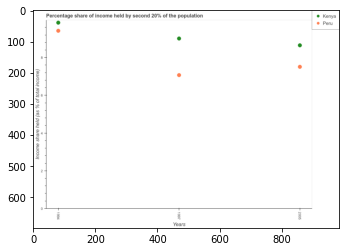

Number of QA =  27





,Years,Peru,Kenya
0,1994,9.463664,9.888646
1,2005,7.547879,8.687543
2,1997,7.107296,9.052904


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by second 20% of the population in peru in 1997 and that in 2005 ?
PREDICTED =  -0.4405822007404847
EXPECTED =  -0.4399999999999995




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by second 20% of the population in peru in 1994 and the share of income held by second 20% of the population in kenya in 2005?
PREDICTED =  1986.4521214405988
EXPECTED =  0.7699999999999996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the share of income held by second 20% of the population in peru a

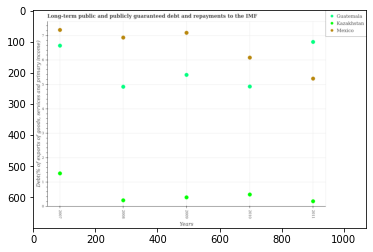

Number of QA =  28





,Years,Guatemala,Mexico,Kazakhstan
0,2007,6.632927,7.273107,1.379663
1,2008,4.940096,6.961373,0.270834
2,2011,6.780651,5.275015,0.234069
3,2009,5.428135,7.157882,0.394573
4,2010,4.947676,6.135404,0.509725


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt and repayments in kazakhstan in 2010 and that in 2011 ?
PREDICTED =  4.765930959142327
EXPECTED =  0.276429818618063




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt and repayments in guatemala in 2011 and the debt and repayments in mexico in 2010?
PREDICTED =  -1.7806505781577506
EXPECTED =  0.6424771858319787




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the debt and repayments in guatemala and debt and repayments in mexico ?
PREDICTED =  -23.729485119962675
EXPECTED =  -1.7243086711761597




				 0 / 3 = 0

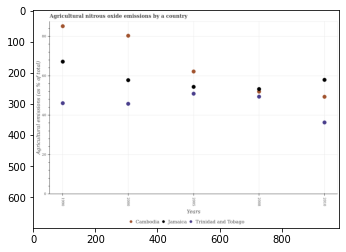

Number of QA =  28





,Years,Cambodia,Jamaica,Trinidad and Tobago
0,1990,85.171714,67.254143,46.197662
1,2008,52.042014,53.443052,49.496422
2,2000,80.321481,57.890996,45.902522
3,2005,62.230441,54.472115,51.058708
4,2010,49.456072,57.979605,36.475223


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural nitrous oxide emitted in jamaica in 2008 and that in 2010 ?
PREDICTED =  -4.536553404379845
EXPECTED =  -4.6792321078835855




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural nitrous oxide emitted in trinidad and tobago in 1990 and the amount of agricultural nitrous oxide emitted in cambodia in 2000?
PREDICTED =  -9.42729891918259
EXPECTED =  -34.2085849390303




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the amount of agricultural nitrous oxide emitted in cambodia and amount 

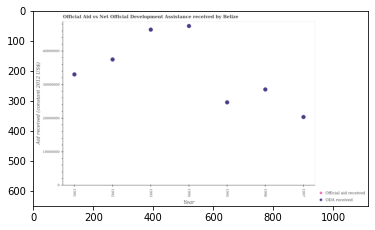

Number of QA =  27





,Year,Official aid received,ODA received
0,1994,NaN,4.749467e+07
1,1993,NaN,4.639764e+07
2,1992,NaN,3.749049e+07
3,1996,NaN,2.858704e+07
4,1997,NaN,2.041974e+07
5,1995,NaN,2.477707e+07
6,1991,NaN,3.306709e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in 1993 and that in 1996 ?
PREDICTED =  17810600.424264174
EXPECTED =  17820000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official aid received in 1995 and the oda received in 1991?
PREDICTED =  nan
EXPECTED =  -8320000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the oda received and official aid received ?
PREDICTED =  0.0
EXPECTED =  0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wh

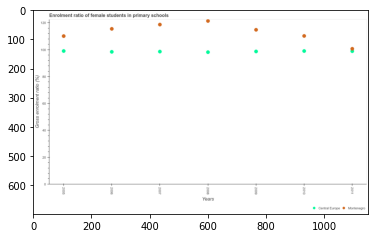

Number of QA =  27





,Years,Central Europe,Montenegro
0,2008,97.601858,120.639643
1,2007,98.044965,117.954727
2,2009,98.170191,114.107488
3,2006,97.859454,114.766832
4,2005,98.473515,109.386599
5,2010,98.472741,109.549394
6,2011,98.330925,100.074764


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

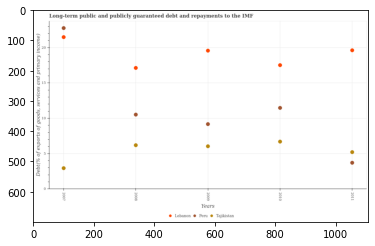

Number of QA =  28





,Years,Unnamed: 1,Tajikistan,Lebanon
0,2009,9.306497,6.148197,19.753594
1,2011,3.794128,5.312202,19.801768
2,2010,11.608902,6.817890,17.692810
3,2008,10.643486,6.297070,17.292949
4,2007,22.950016,3.029040,21.688194


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt and repayments in peru in 2008 and that in 2010 ?
PREDICTED =  10027.70705117442
EXPECTED =  -0.9511084445127




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt and repayments in peru in 2010 and the debt and repayments in tajikistan in 2007?
PREDICTED =  10022.04998399842
EXPECTED =  8.53206616074934




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the debt and repayments in tajikistan and debt and repayments in peru ?
PREDICTED =  10017.395600867214
EXPECTED =  -4.77323183048766




				 0 / 3 = 0.0


is_built_wi

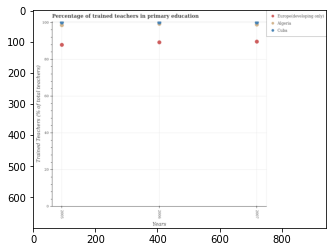

Number of QA =  28





,Years,Algeria,Europe(developing only),Cuba
0,2007,100.321048,90.029881,99.273020
1,2006,NaN,89.648385,100.244608
2,2005,98.912195,88.299651,100.428578


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained teachers in cuba in 2005 and that in 2006 ?
PREDICTED =  0.18397070429729467
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained teachers in europe(developing only) in 2005 and the percentage of trained teachers in cuba in 2007?
PREDICTED =  -1.7302298330542385
EXPECTED =  -12.148323059081989




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of trained teachers in europe(developing only) and percentage of trained teachers in cuba ?
PREDICTED =  0.0
EXPE

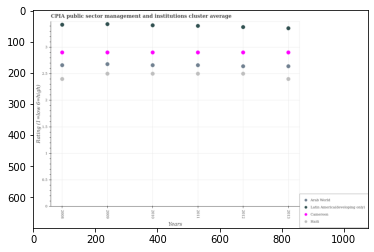

Number of QA =  29





,Years,Arab World,Latin America(developing only,Haiti,Cameroon
0,2008,2.685243,3.448619,2.421381,2.923976
1,2013,2.663322,3.382673,2.422591,2.924477
2,2009,2.705370,3.459813,2.521104,2.923690
3,2011,2.683621,3.427769,2.520867,2.924889
4,2010,2.684015,3.438238,2.520862,2.924717
5,2012,2.663389,3.405587,2.521494,2.924273


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in cameroon in 2010 and that in 2013 ?
PREDICTED =  0.0002399719765957542
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in cameroon in 2011 and the cpia rating in arab world in 2008?
PREDICTED =  0.0009136737452855037
EXPECTED =  0.23999999999999977




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the cpia rating in cameroon and cpia rating in arab world ?
PREDICTED =  -1.4626272642691198
EXPECTED =  0.23999999999999977




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_availa

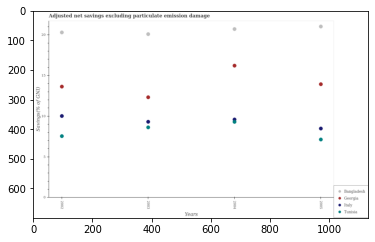

Number of QA =  29





,Years,Georgia,Bangladesh,Tunisia,Italy
0,2004,16.255914,20.744668,9.346979,9.638913
1,2005,13.974624,21.080835,7.180480,8.531435
2,2002,13.675947,20.339785,7.587813,10.062197
3,2003,12.376638,20.127827,8.670503,9.359084


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in bangladesh in 2002 and that in 2005 ?
PREDICTED =  -0.7410499428614585
EXPECTED =  -0.7289860754461088




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in tunisia in 2002 and the adjusted net savings in bangladesh in 2005?
PREDICTED =  0.4073338378263802
EXPECTED =  -13.483798760079




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the adjusted net savings in italy and adjusted net savings in tunisia ?
PREDICTED =  4.805855150540253
EXPECTED =  0.6894082006082805




				 1 / 3 =

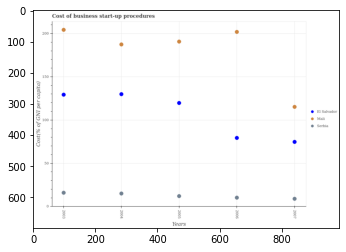

Number of QA =  28





,Years,Serbia,Mali,El Salvador
0,2004,15.606980,188.007658,130.473681
1,2006,10.815352,202.436993,79.938898
2,2003,16.583052,204.802918,129.812339
3,2005,12.672292,191.325124,120.364865
4,2007,9.523946,115.830975,75.310426


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of business start-up procedures in mali in 2005 and that in 2007 ?
PREDICTED =  75.49414874107615
EXPECTED =  75.49999999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of business start-up procedures in mali in 2003 and the cost of business start-up procedures in el salvador in 2007?
PREDICTED =  88.97194294215498
EXPECTED =  129.60000000000002




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the cost of business start-up procedures in serbia and cost of business start-up procedures in el salvador ?
PRED

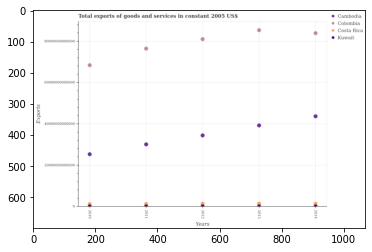

Number of QA =  29





,Years,Colombia,Cambodia,Costa Rica,Kuwait
0,2014,8.447845e+13,4.406879e+13,1.631792e+12,2.723797e+11
1,2012,8.156706e+13,3.478587e+13,1.586457e+12,4.362086e+11
2,2013,8.591484e+13,3.965677e+13,1.635909e+12,4.084540e+11
3,2010,6.886828e+13,2.558208e+13,1.369804e+12,2.756047e+11
4,2011,7.698374e+13,3.039640e+13,1.486288e+12,2.660821e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in cambodia in 2010 and that in 2013 ?
PREDICTED =  -39656771637289.73
EXPECTED =  -13941416118700.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in colombia in 2011 and the total exports of goods and services in cambodia in 2010?
PREDICTED =  -145852019096190.6
EXPECTED =  51139628663900.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the total exports of goods and services in kuwait and total exports of goods and services in costa rica ?
PREDI

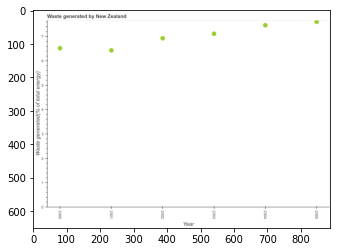

Number of QA =  24





,Year,Waste generated(% of total energy)
0,2002,6.937138
1,2001,6.440089
2,2005,7.613968
3,2004,7.471094
4,2000,6.530420
5,2003,7.122730


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of waste generated in 2000 and 2005 ?
PREDICTED =  -1.0835479190921546
EXPECTED =  -1.0858131567758207




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of waste generated ?
PREDICTED =  7.029934196086903
EXPECTED =  7.01884109998234




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of waste generated in 2001 to that in 2002 ?
PREDICTED =  0.9283494757866673
EXPECTED =  0.9283427280462314




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





>

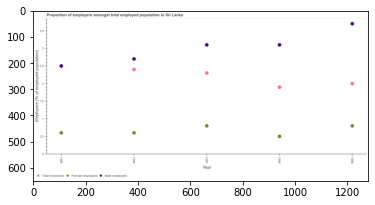

Number of QA =  28





,Year,Female employers,Total employers,Male employers
0,1997,0.827419,2.349565,3.162789
1,1998,0.523097,1.946519,3.164307
2,1995,0.625826,NaN,2.555903
3,1996,0.625886,2.452591,2.759374
4,1999,0.830950,2.048782,3.774652


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total employers in 1997 and that in 1999 ?
PREDICTED =  0.3007832769729655
EXPECTED =  0.2999999523162802




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total employers in 1998 and the percentage of male employers in 1996?
PREDICTED =  -0.8128553148415765
EXPECTED =  -0.8000000715255797




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percentage of total employers and percentage of female employers ?
PREDICTED =  1.9294943077281899
EXPECTED =  1.4999999403953521




				 2 / 3 = 0.6667


i

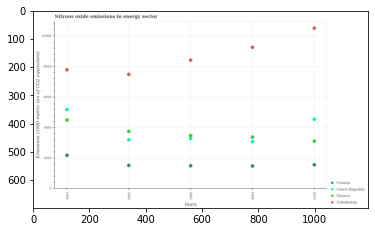

Number of QA =  29





,Years,Czech Republic,Croatia,Uzbekistan,Greece
0,1990,5175.592084,2198.804670,7774.045989,4495.663407
1,2008,3091.196476,1497.967268,9246.011171,3386.411324
2,2005,3285.502108,1516.088630,8407.534018,3481.038819
3,2000,3214.529527,1539.685000,7472.573089,3761.354396
4,2010,4554.899708,1578.721531,10492.363410,3122.024697


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in croatia in 2000 and that in 2005 ?
PREDICTED =  23.59637013934571
EXPECTED =  28.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in czech republic in 2010 and the amount of nitrous oxide emitted in uzbekistan in 2008?
PREDICTED =  1463.7032316684072
EXPECTED =  -4718.2




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount of nitrous oxide emitted in czech republic and amount of nitrous oxide emitted in greece ?
PREDICTED =  16199.695206549644
EXPEC

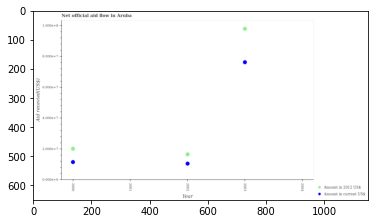

Number of QA =  23





,Year,Amount in current US$,Amount in 2012 US$
0,2000,4.150770,7.197296
1,2002,3.796134,5.919833
2,2003,26.907172,34.550257
3,2001,NaN,NaN
4,2004,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in 2012 us$) in 2000 and that in 2003 ?
PREDICTED =  -31.550256570113355
EXPECTED =  -77790000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in 2012 us$) in 2003 and the amount of aid received(expressed in us$) in 2001?
PREDICTED =  -5.919833205590699
EXPECTED =  97920000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest amount of aid received(expressed in 2012 us$) ?
PREDICTED =  -30.399486513569826
EXPECTED =  77790000




				 0 / 3 = 0

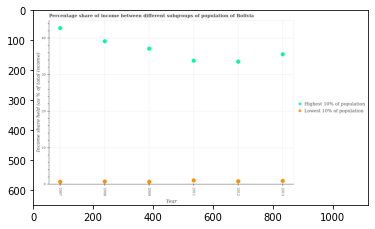

Number of QA =  27





,Year,Lowest 10% of population,Highest 10% of population
0,2008,0.886810,39.193871
1,2013,1.046935,35.607617
2,2009,0.822695,37.175093
3,2007,0.802130,42.778708
4,2012,0.930048,33.645381
5,2011,1.163449,33.878217


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 10% of the population in 2012 and that in 2013 ?
PREDICTED =  -0.11688689940007246
EXPECTED =  -2.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 10% of the population in 2007 and the income share held by lowest 10% of the population in 2012?
PREDICTED =  -32.84325055512925
EXPECTED =  41.89




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the income share held by highest 10% of the population and income share held by lowest 10% of the population ?
PREDICTED =  1

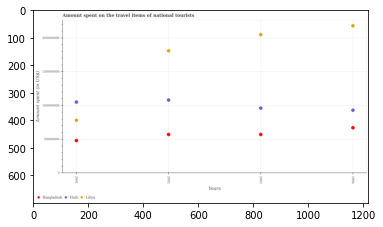

Number of QA =  28





,Years,Unnamed: 1,Haiti,Bangladesh
0,2001,7.876308e+07,1.058379e+08,4.869017e+07
1,2002,1.822157e+08,1.089334e+08,5.775588e+07
2,2003,2.061946e+08,9.685668e+07,5.777885e+07
3,2004,2.193245e+08,9.392880e+07,6.781622e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of national tourists in haiti in 2001 and that in 2003 ?
PREDICTED =  8981219.33963184
EXPECTED =  9000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of national tourists in bangladesh in 2004 and the amount spent on the travel items of national tourists in libya in 2001?
PREDICTED =  19126050.025994137
EXPECTED =  -11000000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the amount spent on the travel items of national tourists in haiti and amount 

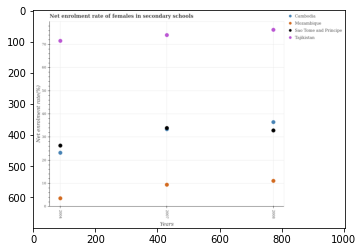

Number of QA =  29





,Years,Cambodia,Sao Tome and Principe,Tajikistan,Mozambique
0,2008,36.816570,33.165256,76.819626,11.343707
1,2004,23.557302,26.597618,71.974724,3.770662
2,2007,NaN,34.253590,74.516324,9.650814


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of females in secondary schools in mozambique in 2004 and that in 2007 ?
PREDICTED =  -5.880151989637268
EXPECTED =  -5.864610195159919




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of females in secondary schools in sao tome and principe in 2004 and the net enrolment rate of females in secondary schools in cambodia in 2007?
PREDICTED =  59.7628743786301
EXPECTED =  -7.064458847045913




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the net enrolment rate of females in secondary sch

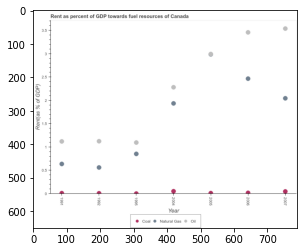

Number of QA =  28





,Year,Coal,Oil,Natural Gas
0,2004,0.065279,2.282025,1.936468
1,2007,0.058704,3.532890,2.046065
2,1995,0.017874,1.103307,0.860047
3,1992,0.022356,1.130489,0.569569
4,2005,0.024943,2.989425,NaN
5,1991,0.023274,1.126538,0.648735
6,2006,0.030350,3.452088,2.463553


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards natural gas in 1995 and that in 2004 ?
PREDICTED =  -1.0764216564317874
EXPECTED =  -1.0826078249757707




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards natural gas in 2006 and the rent towards coal in 2004?
PREDICTED =  0.5270849471145462
EXPECTED =  2.4146388336157205




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rent towards oil in 1991 to that in 2007?
PREDICT

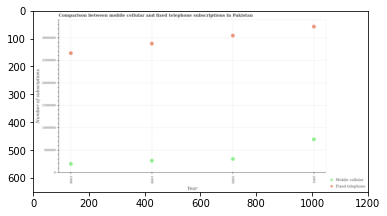

Number of QA =  27





,Year,Mobile cellular,Fixed telephone
0,2000,318360.835711,3.075634e+06
1,1999,277849.353014,2.895147e+06
2,1998,208402.433576,2.682402e+06
3,2001,754925.082456,3.274918e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in 1998 and that in 2001 ?
PREDICTED =  -592516.2366575333
EXPECTED =  -591000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscriptions in 2001 and the number of fixed telephone subscriptions in 1998?
PREDICTED =  546522.6488800043
EXPECTED =  -1918394




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the number of fixed telephone subscriptions and number of mobile cellular subscriptions ?
PREDICTED =  0.0
EXPECTED =  2746967




				 1 / 3 = 0.3333


i

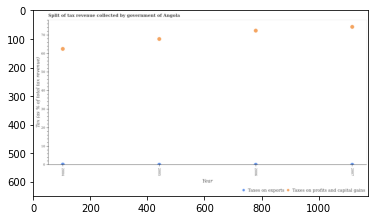

Number of QA =  27





,Year,Taxes on exports,Taxes on profits and capital gains
0,2005,0.381055,67.628318
1,2007,0.351263,74.125217
2,2006,0.374705,72.123278
3,2004,0.467117,62.341617


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on exports in 2004 and that in 2006 ?
PREDICTED =  0.09241241013747115
EXPECTED =  0.10453503711802403




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on exports in 2007 and the percentage of revenue obtained from taxes on profits and capital gains in 2004?
PREDICTED =  -0.11585454210888824
EXPECTED =  -62.503342263238736




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of revenue obtained from taxes on profits and capital g

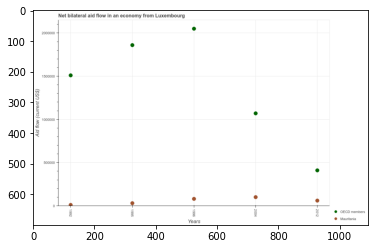

Number of QA =  27





,Years,OECD members,Mauritania
0,1995,1.862614e+06,36428.707126
1,2004,1.073962e+06,106180.436460
2,2012,4.151303e+05,66590.806246
3,1992,1.513328e+06,16535.383948
4,1996,2.052583e+06,86116.199882


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in mauritania in 1995 and that in 2012 ?
PREDICTED =  -30162.099119806837
EXPECTED =  -30000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in mauritania in 1992 and the net bilateral aid flow in oecd members in 1995?
PREDICTED =  -19893.323178174727
EXPECTED =  -1850000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the net bilateral aid flow in oecd members and net bilateral aid flow in mauritania ?
PREDICTED =  2052578.4892457784
EXPECTED =  1500000.0




				 1 / 3 

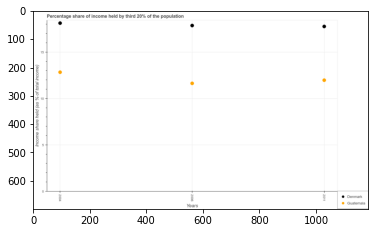

Number of QA =  27





,Years,Guatemala,Denmark
0,2004,12.901127,18.179359
1,2006,11.699012,17.939852
2,2011,12.047000,17.826839


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by third 20% of the population in denmark in 2006 and that in 2011 ?
PREDICTED =  0.11301356906241367
EXPECTED =  0.09999999999999787




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by third 20% of the population in guatemala in 2011 and the share of income held by third 20% of the population in denmark in 2004?
PREDICTED =  -0.8541272506675099
EXPECTED =  -6.15




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the share of income held by third 20% of the population in guatemala an

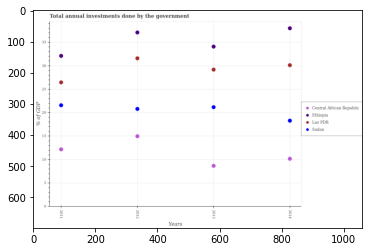

Number of QA =  29





,Years,Lao PDR,Central African Republic,Sudan,Ethiopia
0,2014,29.921601,10.184154,18.228404,37.740557
1,2011,26.287117,12.170325,21.463525,31.894052
2,2012,31.385729,14.957827,20.717255,36.849311
3,2013,29.000313,8.708552,21.075350,33.858730


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual investments done by the government in lao pdr in 2012 and that in 2013 ?
PREDICTED =  2.3854158163628583
EXPECTED =  2.4040667833832003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual investments done by the government in central african republic in 2013 and the total annual investments done by the government in ethiopia in 2012?
PREDICTED =  -6.249274212423961
EXPECTED =  -28.42757702212658




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the total annual investments done by the government in et

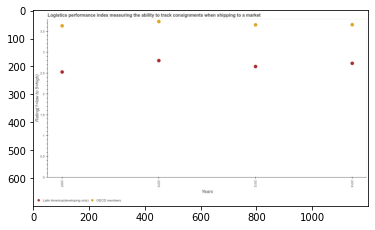

Number of QA =  27





,Years,Latin America(developing only),OECD members
0,2014,2.768787,3.702271
1,2010,2.834946,3.776902
2,2012,2.689622,3.698227
3,2007,2.559119,3.673792


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in oecd members in 2012 and that in 2014 ?
PREDICTED =  -0.004043708969159621
EXPECTED =  -0.004054834224590298




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in latin america(developing only) in 2014 and the logistic performance index in oecd members in 2010?
PREDICTED =  -0.06615946307099874
EXPECTED =  -1.00177467973857




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the logistic performance index in oecd members and logistic performance index in latin america(dev

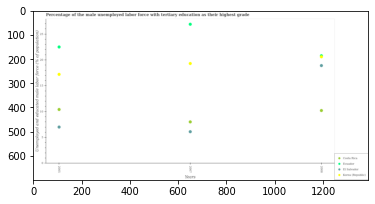

Number of QA =  29





,Years,Korea (Republic),Ecuador,EF) Salvador,Costa Rica
0,2008,20.938845,NaN,19.061577,10.324331
1,2005,17.326870,22.645159,7.103857,10.507673
2,2007,19.454080,27.085885,6.197856,8.106697


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with tertiary education in ecuador in 2007 and that in 2008 ?
PREDICTED =  27.08588492215209
EXPECTED =  6.100000381469808




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with tertiary education in ecuador in 2005 and the percentage of the unemployed male labor force with tertiary education in korea (republic) in 2007?
PREDICTED =  -4.440725579958411
EXPECTED =  3.2000007629394993




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_

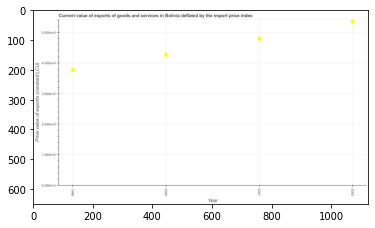

Number of QA =  24





,Year,Prive value of exports (constant LCU)
0,1999,3.806858
1,2000,4.305721
2,2002,5.392139
3,2001,4.833850


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price value of exports in 1999 and 2002 ?
PREDICTED =  -1.585280326940718
EXPECTED =  -1579263204.9325013




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median price value of exports ?
PREDICTED =  4.569785445900196
EXPECTED =  4533889826.71155




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the price value of exports in 1999 to that in 2002 ?
PREDICTED =  0.7060015610387919
EXPECTED =  0.7050333942498489




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what i

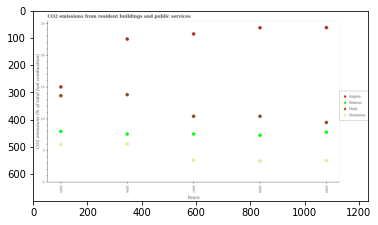

Number of QA =  29





,Years,Honduras,Angola,Belarus,Haiti
0,2005,5.982665,15.052152,8.069115,13.670823
1,2006,6.056922,22.580847,7.642113,13.830798
2,2008,3.402646,24.367496,7.464896,10.441872
3,2009,3.487278,24.384819,7.932017,9.477230
4,2007,3.550050,23.391807,7.642068,10.439205


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in belarus in 2005 and that in 2006 ?
PREDICTED =  0.4270017614368866
EXPECTED =  0.42179365370294963




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in haiti in 2008 and the total co2 emitted in belarus in 2007?
PREDICTED =  0.0026673242940784547
EXPECTED =  2.79905920850804




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total co2 emitted in haiti and total co2 emitted in angola ?
PREDICTED =  -51.917192653553315
EXPECTED =  -14.943755095801109




				 1 / 3 = 0.3333


is_built_

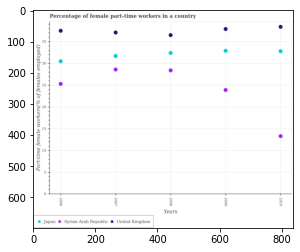

Number of QA =  28





,Years,Syrian Arab Republic,United Kingdom,Japan
0,2008,28.459425,36.543902,32.449691
1,2006,25.359932,37.543627,30.536974
2,2009,23.964526,37.951568,32.956186
3,2010,13.396092,38.444688,32.866673
4,2007,28.672077,37.135585,31.760278


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female part-time workers in japan in 2007 and that in 2010 ?
PREDICTED =  -1.1063947995839207
EXPECTED =  -1.0999984741209978




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female part-time workers in united kingdom in 2006 and the percentage of female part-time workers in japan in 2010?
PREDICTED =  -0.9010616633252155
EXPECTED =  4.700000762939503




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of female part-time workers in united kingdom and percentage of female part-time w

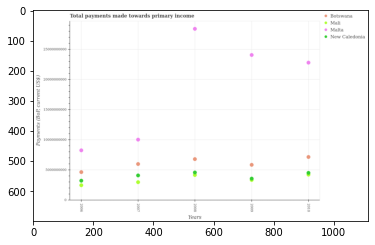

Number of QA =  29





,Years,Botswana,Malta,Mali,New Caledonia
0,2008,6.895321e+09,2.851935e+10,4.255122e+09,4.667942e+09
1,2010,7.248717e+09,2.291616e+10,4.587337e+09,4.356131e+09
2,2009,5.965013e+09,2.417842e+10,NaN,3.618320e+09
3,2006,4.737843e+09,8.361423e+09,2.547938e+09,3.289754e+09
4,2007,6.075699e+09,1.013334e+10,3.054544e+09,4.192555e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total payments made towards primary income in malta in 2007 and that in 2009 ?
PREDICTED =  -14045080201.73984
EXPECTED =  -14039021797




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total payments made towards primary income in new caledonia in 2010 and the total payments made towards primary income in botswana in 2009?
PREDICTED =  737810902.7293401
EXPECTED =  -1334212751.6999998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the total payments made towards primary income in mali and total payments made towards prim

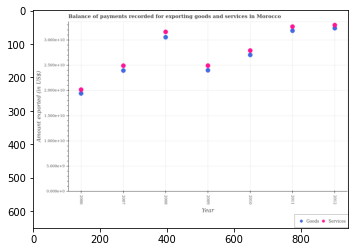

Number of QA =  27





,Year,Services,Goods
0,2007,2.513250,2.413635
1,2012,3.315812,3.257752
2,2008,3.184966,3.078940
3,2006,2.036886,1.960753
4,2011,3.290031,3.206731
5,2009,2.514517,2.420863
6,2010,2.815121,2.724695


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of services exported in 2008 and that in 2012 ?
PREDICTED =  -0.13084644797991984
EXPECTED =  -1341400396.0999985




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in 2011 and the amount of services exported in 2007?
PREDICTED =  0.7930960679094814
EXPECTED =  6934507139.599998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount of goods exported and amount of services exported ?
PREDICTED =  0.0
EXPECTED =  -960797725.4000015




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_ava

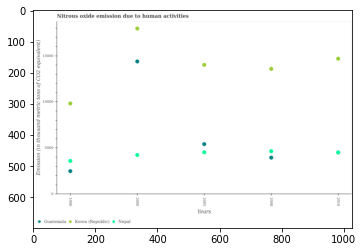

Number of QA =  28





,Years,Korea (Republic),Guatemala,Nepal
0,1990,9944.157764,2559.440727,3683.268248
1,2005,14182.308936,5515.908934,4626.120052
2,2008,13743.307750,4028.762388,4742.989321
3,2000,18148.672222,14550.171019,4322.220078
4,2010,14856.218951,NaN,4609.799309


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in nepal in 2005 and that in 2008 ?
PREDICTED =  -116.86926889936967
EXPECTED =  -117.60000000000036




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in nepal in 1990 and the amount of nitrous oxide emitted in korea (republic) in 2010?
PREDICTED =  -11172.950702935746
EXPECTED =  -11094.2




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the amount of nitrous oxide emitted in nepal and amount of nitrous oxide emitted in korea (republic) ?
PREDICTED =  -48890.26

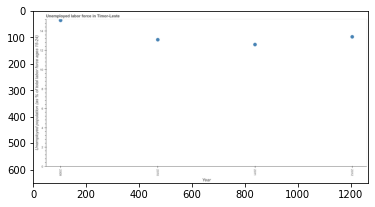

Number of QA =  24





,Year,Unemployed population (as % of total labor force ages 15-24)
0,2011,12.649239
1,2010,13.164894
2,2012,13.453714
3,2009,15.152897


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed youth population in 2009 and 2011 ?
PREDICTED =  2.5036577602667496
EXPECTED =  2.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed youth population ?
PREDICTED =  2010.5
EXPECTED =  13.25




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total unemployed youth population in 2010 to that in 2011 ?
PREDICTED =  1.040765729213421
EXPECTED =  1.0396825384811361




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the 

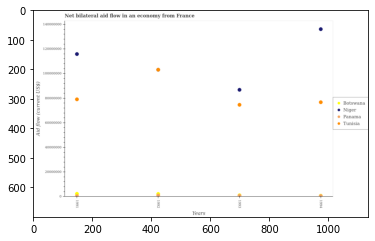

Number of QA =  29





,Years,Botswana,Tunisia,Panama,Niger
0,1993,NaN,7.516361e+07,1.184615e+06,8.736528e+07
1,1994,NaN,7.727072e+07,9.792864e+05,1.368695e+08
2,1992,NaN,1.037635e+08,1.063650e+06,2.446531e+06
3,1991,2.749967e+06,7.959793e+07,7.177568e+05,1.165408e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in panama in 1993 and that in 1994 ?
PREDICTED =  205328.779913145
EXPECTED =  200000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in niger in 1993 and the net bilateral aid flow in tunisia in 1991?
PREDICTED =  -29175552.14319825
EXPECTED =  7740000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the net bilateral aid flow in botswana and net bilateral aid flow in panama ?
PREDICTED =  -1195341.7720587715
EXPECTED =  1870000.0




				 1 / 3 = 0.3333


is_built_with_c

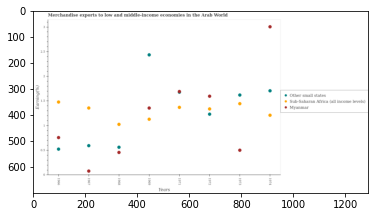

Number of QA =  28





,Years,Sub-Saharan Africa (all income levels),Other small states,Myanmar
0,1971,1.384301,NaN,1.697605
1,1972,1.353036,1.245770,1.611974
2,1967,1.372733,0.604495,0.086961
3,1973,1.460883,1.635994,0.512272
4,1969,1.143714,2.453376,1.371020
5,1974,1.224120,1.722162,3.026149
6,1966,1.492061,0.532049,0.768891
7,1968,1.038005,0.573277,0.467259


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in myanmar in 1968 and that in 1973 ?
PREDICTED =  -0.42287860893659635
EXPECTED =  -0.044979610138394965




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in sub-saharan africa (all income levels) in 1973 and the percentage of amount earned from merchandise exports in myanmar in 1971?
PREDICTED =  0.07658250239856934
EXPECTED =  -0.24671068818266995




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the percentage of amo

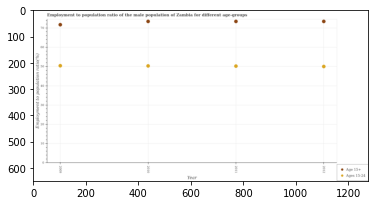

Number of QA =  27





,Year,Ages 15-24,Age 15+
0,2010,50.605793,73.790749
1,2012,50.306105,73.795858
2,2011,50.536117,73.779399
3,2009,50.652321,72.039720


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio(age 15+) ?
PREDICTED =  27.264402873750075
EXPECTED =  73.4000015258789




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio(age 15-24) ?
PREDICTED =  39.935510494792034
EXPECTED =  50.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the employment to population ratio(age 15+) maximum?
PREDICTED =  0.9985089463220675
EXPECTED =  2010





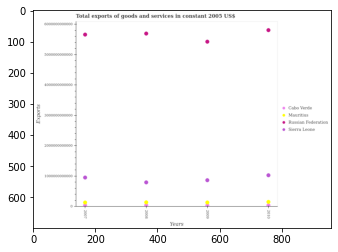

Number of QA =  29





,Years,Sierra Leone,Russian Federation,Mauritius,Cabo Verde
0,2008,8.080900e+11,5.689496e+12,1.503338e+11,3.227316e+10
1,2009,8.777825e+11,5.420316e+12,1.456354e+11,3.333935e+10
2,2010,1.042595e+12,5.800277e+12,1.663646e+11,4.997802e+10
3,2007,9.657114e+11,5.653685e+12,1.474752e+11,3.310443e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total total exports of goods and services in russian federation in the graph ?
PREDICTED =  1.0
EXPECTED =  22575940629700.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in cabo verde in 2007 and that in 2009 ?
PREDICTED =  -33339349190.90402
EXPECTED =  4375650300.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in mauritius in 2008 and the total exports of goods and services in sierra leone in 2010?
PREDICTED =  -316698424543.8932
EXPECTED =  -890824472300.0




				 0 / 3 = 0.0



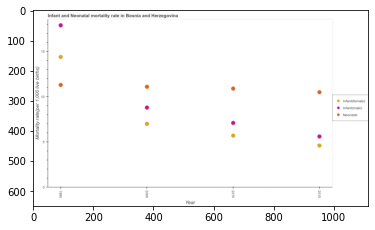

Number of QA =  28





,Year,Infant(male),Neonatal,Infant(female)
0,1990,17.950062,11.345226,14.451190
1,2000,8.857755,11.151200,7.059575
2,2015,5.666053,10.551021,4.664270
3,2010,7.151277,10.939804,5.759808


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the neonatal mortality rate in 2000 and that in 2010 ?
PREDICTED =  0.2113965120981245
EXPECTED =  0.1999999999999993




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate(female) in 2010 and the infant mortality rate(male) in 2000?
PREDICTED =  -1.2997666509433063
EXPECTED =  -3.1000000000000005




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2015, what is the difference between the neonatal mortality rate and infant mortality rate(female) ?
PREDICTED =  0.0
EXPECTED =  5.9




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False

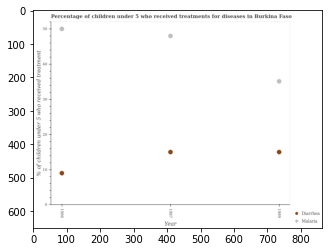

Number of QA =  27





,Year,Diarrhea,Malaria
0,1987,15.126775,48.099288
1,1989,15.124129,35.200789
2,1986,9.136622,50.101441


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received treatment for diarrhoea in 1987 and that in 1989 ?
PREDICTED =  0.0026466630431727367
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received treatment for diarrhoea in 1987 and the percentage of children who received treatment for malaria in 1986?
PREDICTED =  -34.97466596858449
EXPECTED =  -35.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1989, what is the difference between the percentage of children who received treatment for diarrhoea and percentage of children who receiv

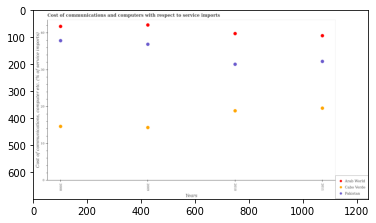

Number of QA =  28





,Years,Arab World,Pakistan,Cabo Verde
0,2009,42.139135,36.907894,14.405058
1,2010,39.810622,31.523962,18.922113
2,2008,41.761437,37.901908,14.686242
3,2011,39.239274,32.285482,19.644051


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in cabo verde in 2008 and that in 2011 ?
PREDICTED =  118.97519522357689
EXPECTED =  -4.9508587130807005




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in pakistan in 2008 and the cost of communications and computers in cabo verde in 2009?
PREDICTED =  101.71135209341742
EXPECTED =  23.563568892999598




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the cost of communications and computers in pakistan and cost of communications and computers in ara

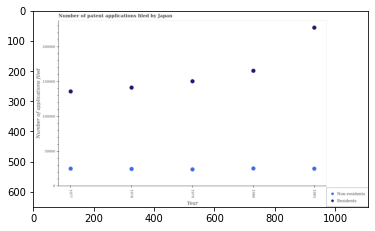

Number of QA =  27





,Year,Residents,Non-residents
0,1978,141965.780642,25181.508400
1,1980,166096.936875,25886.116534
2,1979,151113.651360,24513.094935
3,1983,227995.667955,25581.932662
4,1977,136411.116754,25615.897516


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by residents in 1978 and that in 1980 ?
PREDICTED =  -24131.156233517977
EXPECTED =  -24213




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by residents in 1979 and the number of patent applications by non residents in 1980?
PREDICTED =  -166095.936875177
EXPECTED =  125333




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the number of patent applications by non residents and number of patent applications by residents ?
PREDICTED =  0.0
EXPECTED =  -140440




		

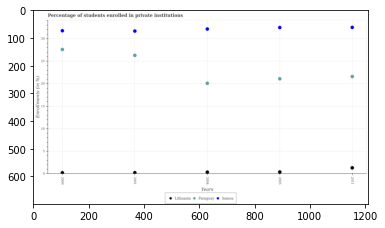

Number of QA =  28





,Years,Lithuania,Samoa,Paraguay
0,2000,0.298448,31.977275,27.790611
1,2004,0.449985,32.359043,20.261327
2,2011,1.444532,32.715351,21.780469
3,2005,0.499547,32.674926,21.262626
4,2001,0.309669,31.897205,26.482197


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained teachers in samoa in 2004 and that in 2011 ?
PREDICTED =  -0.3563082581783661
EXPECTED =  -0.3586387634277983




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained teachers in paraguay in 2004 and the percentage of trained teachers in lithuania in 2011?
PREDICTED =  -1.5191425821115985
EXPECTED =  18.778789401054357




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of trained teachers in paraguay and percentage of trained teachers in samoa ?
PREDICTED =  -12.097716163487

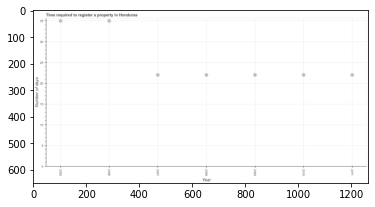

Number of QA =  24





,Year,Number of days
0,2010,21.842657
1,2005,34.651353
2,2009,21.832988
3,2011,21.854977
4,2006,34.676017
5,2007,21.841051
6,2008,21.839473


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to register property in 2007 and 2010 ?
PREDICTED =  -0.001605191427270114
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of days required to register property ?
PREDICTED =  21.842656571078216
EXPECTED =  22.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of days required to register property in 2006 to that in 2011 ?
PREDICTED =  6.169802141857945
EXPECTED =  1.5909090909090908




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finish

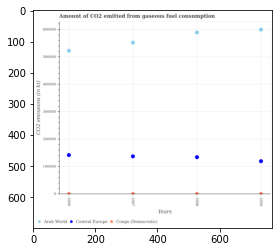

Number of QA =  28





,Years,Arab World,Congo (Democratic),Central Europe
0,2007,554889.061472,1791.148270,139221.322584
1,2006,524559.284060,2136.559953,143848.689963
2,2008,591571.446312,2371.498224,135956.246523
3,2009,602349.007320,2060.179844,121878.385638


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in central europe in 2006 and that in 2009 ?
PREDICTED =  21970.304325043195
EXPECTED =  22324.69600000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in arab world in 2007 and the amount of co2 emitted in congo (democratic) in 2008?
PREDICTED =  -36682.384839572595
EXPECTED =  552044.818716416




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount of co2 emitted in arab world and amount of co2 emitted in central europe ?
PREDICTED =  61444.36261309101
EXPECTED =  38010

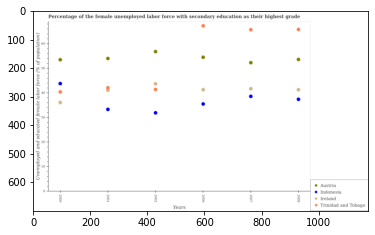

Number of QA =  29





,Years,Austria,Trinidad and Tobago,Ireland,Indonesia
0,2001,54.240549,42.332536,41.299673,33.508427
1,2006,54.747876,67.580394,41.542485,35.708583
2,2000,53.740737,40.595839,36.273544,44.023891
3,2002,57.084579,41.638264,43.966674,32.117344
4,2007,52.562033,65.987132,41.942039,38.817286
5,2008,53.848435,66.071488,41.529025,37.618581


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with secondary education in austria in 2001 and that in 2006 ?
PREDICTED =  -2.844029598469163
EXPECTED =  -0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with secondary education in austria in 2000 and the percentage of the unemployed female labor force with secondary education in trinidad and tobago in 2008?
PREDICTED =  -12.33075115093935
EXPECTED =  -12.300003051757798




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_

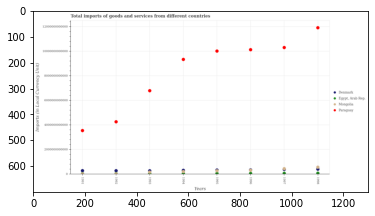

Number of QA =  29





,Years,Mongolia,"Egypt, Arab Rep",Paraguay,Denmark
0,1992,5.881088e+10,NaN,4.294271e+12,3.191602e+11
1,1997,4.706668e+11,1.118846e+11,1.033597e+13,NaN
2,1996,3.659498e+11,8.061858e+10,1.017034e+13,NaN
3,1993,1.879512e+11,3.110084e+11,6.830632e+12,NaN
4,1995,3.449741e+11,8.528675e+10,1.005192e+13,NaN
5,1994,1.294492e+11,2.459236e+11,9.375516e+12,3.416972e+11
6,1998,6.017769e+11,1.166176e+11,1.194533e+13,4.491082e+11
7,1991,6.505265e+10,NaN,3.592576e+12,3.213559e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods and services imports in paraguay in 1993 and that in 1994 ?
PREDICTED =  -16206148487512.887
EXPECTED =  -2545604922800.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods and services imports in egypt, arab rep. in 1995 and the amount of goods and services imports in paraguay in 1996?
PREDICTED =  -165905327343.15814
EXPECTED =  -10069276000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the amount of goods and services imports in mongolia and amount of goods and services imports in d

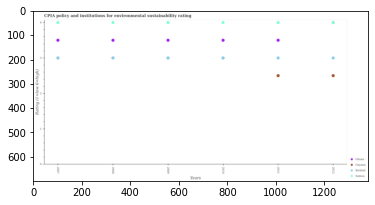

Number of QA =  29





,Years,Samoa,Ghana,Kiribati,Guyana
0,2009,4.009958,3.509388,3.011499,NaN
1,2008,4.008532,3.509550,3.012655,NaN
2,2010,4.010495,3.512117,3.011844,NaN
3,2012,4.009546,NaN,3.009310,2.511034
4,2007,4.011157,3.507493,3.008003,NaN
5,2011,4.009220,3.510035,3.010809,2.512228


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in samoa in 2008 and that in 2010 ?
PREDICTED =  -0.0019627417584615614
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in kiribati in 2012 and the cpia rating in ghana in 2008?
PREDICTED =  -0.003344967708006852
EXPECTED =  -0.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in samoa in 2007 to that in 2012?
PREDICTED =  1.0004015670496935


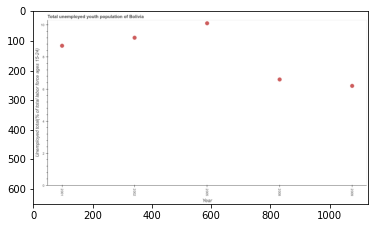

Number of QA =  24





,Year,Unemployed total(% of total labor force ages 15-24)
0,2009,6.247643
1,2002,9.249499
2,2005,10.154333
3,2001,8.751124
4,2008,6.643533


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed youth in 2002 and 2009 ?
PREDICTED =  3.001855781750624
EXPECTED =  3.000000000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed youth ?
PREDICTED =  2005.0
EXPECTED =  8.699999809265138




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed youth in 2002 to that in 2005 ?
PREDICTED =  0.9108917848830475
EXPECTED =  0.9108910358205753




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the hi

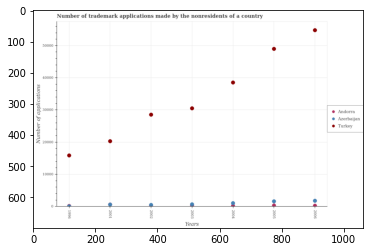

Number of QA =  28





,Years,Azerbaijan,Turkey,Andorra
0,2004,1182.931472,38781.758435,214.943759
1,2006,1909.887515,55125.217304,331.180750
2,2001,748.424343,20500.445478,NaN
3,1996,290.902130,16086.763045,NaN
4,2003,227.990678,30763.724026,743.333585
5,2002,581.635358,28753.965209,NaN
6,2005,1754.169002,49265.526718,389.911144


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents in andorra in 2002 and that in 2004 ?
PREDICTED =  0.0
EXPECTED =  38.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents in andorra in 2002 and the number of trademark applications made by the nonresidents in turkey in 2005?
PREDICTED =  1.0
EXPECTED =  -48741.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the number of trademark applications made by the nonresidents in turkey and number of trademark appl

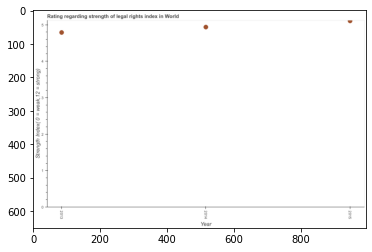

Number of QA =  24





,Year,"Strength Index( 0 = weak, 12 = strong)"
0,2014,4.979016
1,2015,5.149040
2,2013,4.828133


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the strength of legal rights index in 2013 and 2014 ?
PREDICTED =  -0.150883162744881
EXPECTED =  -0.14814814814815058




				 1 / 1 = 1.0


> what is the median strength of legal rights index ?
PREDICTED =  None
EXPECTED =  4.93650793650794




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the strength of legal rights index in 2013 to that in 2015 ?
PREDICTED =  0.9376764163208811
EXPECTED =  0.9378238341968904




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest strength of legal rights index ?
PREDICTED =  0.0
EXPECTED = 

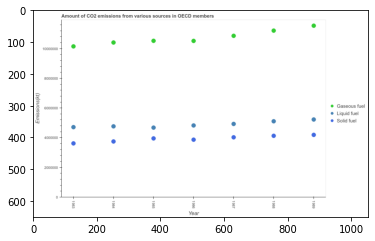

Number of QA =  28





,Year,Solid fuel,Gaseous fuel,Liquid fuel
0,1985,4.008605e+06,1.060058e+07,4.737986e+06
1,1988,4.185005e+06,1.129350e+07,5.170656e+06
2,1986,3.924148e+06,1.060209e+07,4.884725e+06
3,1987,4.080630e+06,1.094537e+07,4.981303e+06
4,1989,4.248888e+06,1.162741e+07,5.286664e+06
5,1983,3.670769e+06,1.022966e+07,4.771848e+06
6,1984,3.800574e+06,1.049103e+07,4.824777e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from liquid fuel in 1985 and that in 1989 ?
PREDICTED =  -548677.7417497328
EXPECTED =  -546927.8042568797




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from liquid fuel in 1987 and the amount of co2 emissions from solid fuel in 1988?
PREDICTED =  796298.2507973099
EXPECTED =  800208.0818825802




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the amount of co2 emissions from solid fuel and amount of co2 emissions from gaseous fuel ?
PREDICTED =  578118.7941884571
EXPECTED 

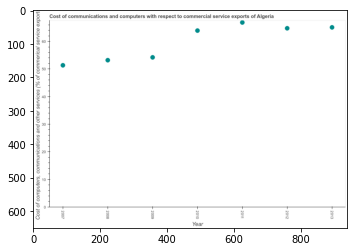

Number of QA =  24





,Year,"Cost of computers, communications and other services (% of commerical service exports"
0,2008,53.629731
1,2010,64.420450
2,2013,65.575252
3,2009,54.693522
4,2007,51.792315
5,2011,67.366961
6,2012,65.297625


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the  computer and other services in 2007 and 2008 ?
PREDICTED =  -98.4220463144739
EXPECTED =  -1.8498188805684066




				 0 / 1 = 0.0


> what is the median  computer and other services ?
PREDICTED =  None
EXPECTED =  63.9045966058596




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the  computer and other services in 2007 to that in 2010 ?
PREDICTED =  0.8039731884167041
EXPECTED =  0.8033248739887004




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest  computer and other services ?
PREDICTED =  1943.6330389111947
EXPECTED

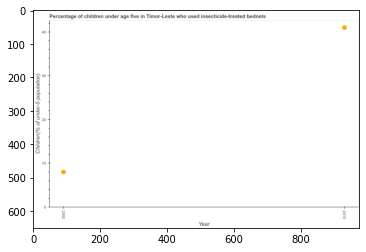

Number of QA =  20





,Year,Children(% of under-5 population)
0,2002,8.222212
1,2010,41.343509


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who use of insecticide-treated bed nets in 2002 and 2010 ?
PREDICTED =  -33.12129718593064
EXPECTED =  -33




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of children who use of insecticide-treated bed nets ?
PREDICTED =  2006.0
EXPECTED =  24.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of children who use of insecticide-treated bed nets in 2002 to that in 2010 ?
PREDICTED =  0.1988755189002284
EXPECTED =  0.1951219512195122




				 2 / 3 = 0.6667


> what is the difference between two consecutive major ticks

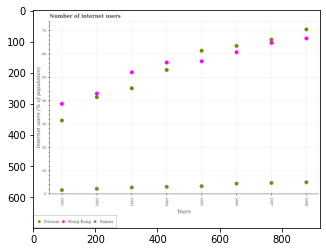

Number of QA =  28





,Years,Samoa,Hong Kong,Estonia
0,2003,2.967821,52.131351,45.305215
1,2002,2.414066,43.059700,41.529451
2,2004,3.235940,56.312258,53.119708
3,2001,1.899987,38.677351,31.555777
4,2008,5.173729,66.547723,70.437364
5,2005,3.535453,56.800390,61.353188
6,2006,4.624642,60.683054,63.408109
7,2007,4.896665,64.684803,66.052221


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of internet users in estonia in 2002 and that in 2008 ?
PREDICTED =  -28.907913087331835
EXPECTED =  -29.059999999999995




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of internet users in samoa in 2004 and the number of internet users in estonia in 2003?
PREDICTED =  0.2681182829574089
EXPECTED =  -42.24447058955103




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the number of internet users in samoa and number of internet users in hong kong ?
PREDICTED =  -49.68834923372509
EXPECTED =  -61.66838468376299

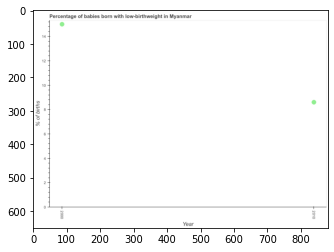

Number of QA =  20





,Year,% of births
0,2000,14.979877
1,2010,8.616849


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of babies who were born with low-birthweight in 2000 and 2010 ?
PREDICTED =  6.363028224086339
EXPECTED =  6.4




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of babies who were born with low-birthweight ?
PREDICTED =  11.798362849199163
EXPECTED =  11.8




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of babies who were born with low-birthweight in 2000 to that in 2010 ?
PREDICTED =  1.7384402834703196
EXPECTED =  1.744186046511628




				 3 / 3 = 1.0


> what is the difference between two consecutive major ticks on the y-axis

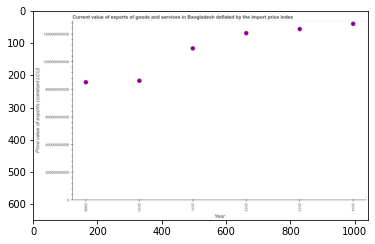

Number of QA =  24





,Year,Prive value of exports (constant LCU)
0,2013,1.240385e+12
1,2012,1.210883e+12
2,2010,8.668922e+11
3,2014,1.278362e+12
4,2011,1.100957e+12
5,2009,8.560239e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price value of exports in 2013 and 2014 ?
PREDICTED =  -37976775934.83594
EXPECTED =  -38097005386.08008




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median price value of exports ?
PREDICTED =  1155920156809.274
EXPECTED =  1150762988814.71




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the price value of exports in 2010 to that in 2013 ?
PREDICTED =  0.6988897704556348
EXPECTED =  0.6974745505470836




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is th

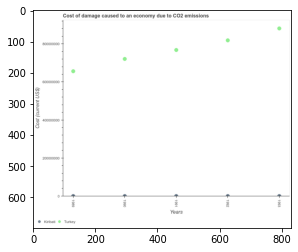

Number of QA =  27





,Years,Kiribati,Turkey
0,1992,3.681503e+06,8.219536e+08
1,1989,3.978479e+06,6.596547e+08
2,1991,3.699492e+06,7.711533e+08
3,1993,3.654069e+06,8.849618e+08
4,1990,3.886683e+06,7.237997e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to co2 emissisons in turkey in 1990 and that in 1993 ?
PREDICTED =  -161162047.19965684
EXPECTED =  -160428850.81733906




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to co2 emissisons in turkey in 1991 and the cost of damage caused due to co2 emissisons in kiribati in 1989?
PREDICTED =  111498558.7312901
EXPECTED =  767645592.6775907




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trai

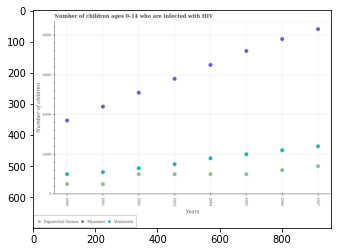

Number of QA =  28





,Years,F quatorial Guinea,Venezuela,Myanmar
0,2003,1023.714029,1520.327615,5805.870889
1,2006,1223.618974,2219.555479,7798.846019
2,2005,1023.604407,2018.173258,7203.295276
3,2002,1021.130761,1320.811829,5110.929963
4,2004,1022.440507,1820.869455,6502.324599
5,2001,526.493947,1123.069776,4409.911446
6,2007,1423.070655,2420.304752,8295.765385
7,2000,528.744537,1021.558764,3713.540905


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hiv infected children in venezuela in 2006 and that in 2007 ?
PREDICTED =  -200.74927297167505
EXPECTED =  -200




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hiv infected children in venezuela in 2005 and the number of hiv infected children in equatorial guinea in 2001?
PREDICTED =  895.1034819164504
EXPECTED =  1500




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the number of hiv infected children in myanmar and number of hiv infected children in venezuela ?
PREDICTED =  48832.484481994645
EXPECTE

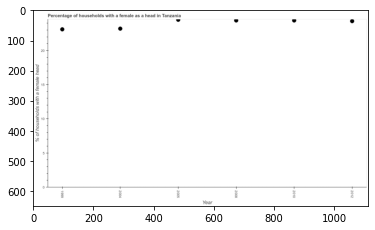

Number of QA =  24





,Year,% of households with a female head
0,1999,23.218201
1,2004,23.323939
2,2008,24.538770
3,2005,24.647348
4,2012,24.421936
5,2010,24.549205


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of female supervised households in 2004 and 2012 ?
PREDICTED =  -1.09799643231732
EXPECTED =  -1.1000000000000014




				 1 / 1 = 1.0


> what is the median number of female supervised households ?
PREDICTED =  None
EXPECTED =  24.35




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of female supervised households in 2004 to that in 2012 ?
PREDICTED =  0.9550405648071212
EXPECTED =  0.9547325102880658




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest number of female supervised households ?
PREDICTED

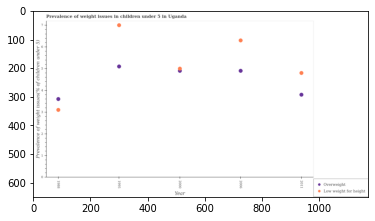

Number of QA =  27





,Year,Overweight,Low weight for height
0,2006,4.894708,6.285694
1,1988,3.598001,3.097408
2,2000,4.892243,4.988958
3,1995,5.090581,6.982012
4,2011,3.798597,4.793798


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of overweight children in 1988 and that in 2006 ?
PREDICTED =  -1.2967068801352313
EXPECTED =  -1.3000001907348597




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of underweight children in 2006 and the percentage of overweight children in 2000?
PREDICTED =  0.0024650638685743687
EXPECTED =  1.4000000953674308




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of underweight children and percentage of overweight children ?
PREDICTED =  0.0
EXPECTED =  0.09999990463257014




				 1 / 3 =

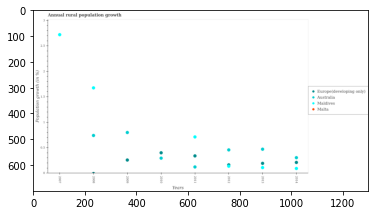

Number of QA =  27





,Years,Maldives,Australia,Malta,Europe(developing only)
0,2008,1.690229,0.749599,NaN,0.005044
1,2012,0.170617,0.466640,NaN,0.141222
2,2009,NaN,0.809837,NaN,0.266087
3,2010,NaN,0.301870,NaN,0.409509
4,2007,2.741285,NaN,NaN,NaN
5,2014,0.101068,0.314066,NaN,0.219702
6,2013,0.117195,0.480463,NaN,0.200644
7,2011,0.723486,0.130341,NaN,0.347226


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population growth in maldives in 2011 and that in 2014 ?
PREDICTED =  0.24615818635984485
EXPECTED =  0.6194755284477456




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population growth in malta in 2010 and the percentage of rural population growth in maldives in 2007?
PREDICTED =  0.4095085375616122
EXPECTED =  -2.72039391108563




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of rural population growth in maldives and percentage of rural population growth in austra

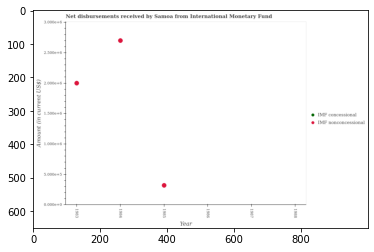

Number of QA =  21





,Year,IMF nonconcessional,IMF concessional
0,1986,NaN,NaN
1,1985,0.327145,NaN
2,1983,2.000558,NaN
3,1988,NaN,NaN
4,1984,2.698352,NaN
5,1987,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net non concessional disbursements from imf in 1984 and that in 1985 ?
PREDICTED =  2.3712073435748846
EXPECTED =  2380000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net concessional disbursements from imf in 1983 and the net non concessional disbursements from imf in 1986?
PREDICTED =  nan
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest net non concessional disbursements from imf ?
PREDICTED =  1980.999442218116
EXPECTED =  700000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu

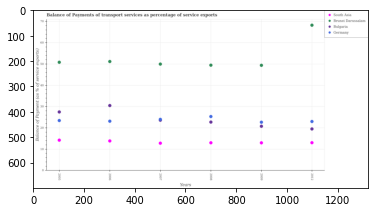

Number of QA =  29





,Years,South Asia,Germany,Bulgaria,Brunei Darussalam
0,2007,12.970603,23.869567,NaN,49.990451
1,2008,13.172374,25.491768,22.815999,49.469105
2,2005,14.428768,23.606241,27.580439,50.858896
3,2006,14.036928,23.268060,30.581860,51.201119
4,2009,13.154450,22.774595,20.935647,49.433145
5,2012,13.191263,23.113424,19.659154,68.188750


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in brunei darussalam in 2005 and that in 2012 ?
PREDICTED =  -17.329854230850515
EXPECTED =  -17.407636437214492




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in brunei darussalam in 2009 and the balance of payments of transport services in germany in 2008?
PREDICTED =  0.0718099531740819
EXPECTED =  24.05478245476




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the balance of payments of transport services in brunei darussalam and bala

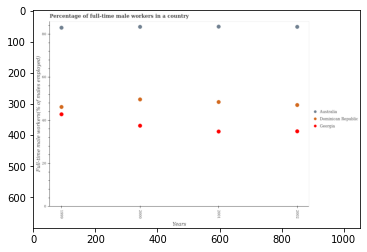

Number of QA =  28





,Years,Georgia,Australia,Dominican Republic
0,2001,35.072112,83.869261,48.838139
1,1999,43.063579,83.332101,46.445492
2,2002,35.159926,83.769084,47.390580
3,2000,37.786809,83.766578,49.983321


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in australia in 2000 and that in 2001 ?
PREDICTED =  -0.10268280819543918
EXPECTED =  -0.09999847412109375




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in georgia in 2002 and the percentage of full-time male workers in australia in 2000?
PREDICTED =  -2.626882833592923
EXPECTED =  -48.50000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of full-time male workers in georgia and percentage of full-time male workers in aust

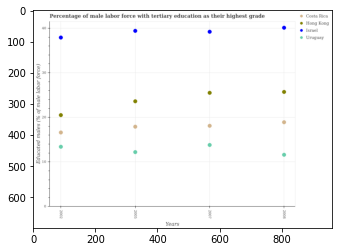

Number of QA =  29





,Years,Hong Kong,Israel,Uruguay,Costa Rica
0,2008,25.850806,40.265241,11.749769,19.060500
1,2007,25.645190,39.370018,13.945093,18.249702
2,2005,23.748556,39.582401,12.329421,18.051206
3,2002,20.645491,38.048888,13.526646,16.729512


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with tertiary education in israel in 2005 and that in 2008 ?
PREDICTED =  -0.6828403266178498
EXPECTED =  -0.6999969482422017




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with tertiary education in hong kong in 2005 and the percentage of male labor force with tertiary education in costa rica in 2007?
PREDICTED =  -1.8966343512380845
EXPECTED =  5.499999999999989




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of male labor force with tertiary

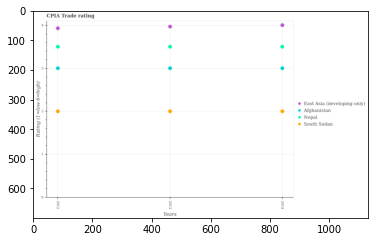

Number of QA =  29





,Years,East Asia (developing only),Afghanistan,South Sudan,Nepal
0,2014,4.011823,3.011108,2.009372,3.510652
1,2013,3.979072,3.009322,2.011292,3.510479
2,2012,3.939423,3.008628,2.010325,3.508148


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in nepal in 2012 and that in 2014 ?
PREDICTED =  -0.0025043916800782107
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in nepal in 2013 and the cpia rating in east asia (developing only) in 2012?
PREDICTED =  0.0023318683235937776
EXPECTED =  -0.42857142857143105




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in south sudan in 2012 to that 

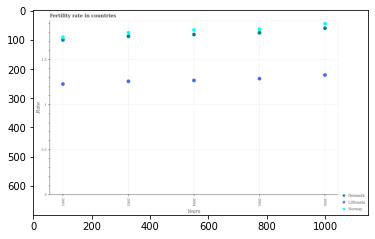

Number of QA =  28





,Years,Denmark,Lithuania,Norway
0,2004,1.784014,1.273672,1.833838
1,2006,1.852491,1.333273,1.902464
2,2005,1.802942,1.293702,1.843457
3,2002,1.724073,1.233539,1.753940
4,2003,1.763089,1.263902,1.802709


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fertility rate in lithuania in 2003 and that in 2006 ?
PREDICTED =  -0.06937135332330158
EXPECTED =  -0.07000000000000006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fertility rate in lithuania in 2002 and the fertility rate in denmark in 2005?
PREDICTED =  -0.07994891845794339
EXPECTED =  -0.5700000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the fertility rate in lithuania and fertility rate in norway ?
PREDICTED =  -3.666726595231223
EXPECTED =  -0.52




				 1 / 3 = 0.3333


is_built_with_cuda: True

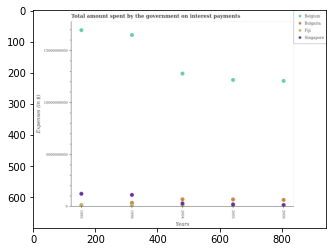

Number of QA =  29





,Years,Fiji,Bulgaria,Belgium,Singapore
0,1996,9.312614e+07,4.006528e+08,1.653188e+10,1.156453e+09
1,1995,1.691569e+08,NaN,1.699605e+10,1.269852e+09
2,2005,NaN,7.264184e+08,1.221067e+10,2.334534e+08
3,2004,3.209124e+08,7.397183e+08,1.282308e+10,9.373541e+07
4,2006,NaN,6.800869e+08,1.211537e+10,1.793639e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on interest payments by the government in belgium in 2004 and that in 2005 ?
PREDICTED =  612407409.606472
EXPECTED =  612700000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on interest payments by the government in bulgaria in 2005 and the amount spent on interest payments by the government in singapore in 1996?
PREDICTED =  325765637.71704906
EXPECTED =  -434197000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount spent on interest payments by the government in singapore and am

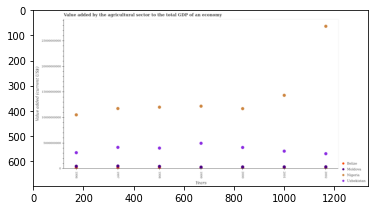

Number of QA =  29





,Years,Nigeria,Moldova,Uzbekistan,Belize
0,1998,1.207051e+10,2.741214e+08,4.095581e+09,5.044086e+08
1,2001,1.438010e+10,9.592730e+07,3.503440e+09,3.883076e+08
2,1999,1.226609e+10,3.620142e+08,5.014428e+09,NaN
3,1996,1.059045e+10,5.455891e+08,3.200358e+09,2.548647e+08
4,2000,1.177909e+10,3.788191e+08,4.213210e+09,NaN
5,2002,2.784438e+10,4.207072e+08,2.991402e+09,NaN
6,1997,1.180061e+10,2.440434e+08,4.228312e+09,5.617717e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector to the total gdp in nigeria in 1996 and that in 2001 ?
PREDICTED =  -3789655821.3230343
EXPECTED =  -3820342831.1021996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector to the total gdp in belize in 2002 and the value added by the agricultural sector to the total gdp in uzbekistan in 2000?
PREDICTED =  -4213209716.500837
EXPECTED =  -4013026486.4086




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the value added by the agricultural sector to the

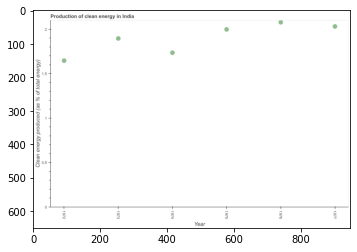

Number of QA =  24





,Year,Clean energy produced (as % of total energy)
0,1975,2.016907
1,1973,1.913492
2,1976,2.096724
3,1974,1.752831
4,1977,2.049781
5,1972,1.662336


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the production of clean energy in 1974 and 1977 ?
PREDICTED =  -0.29695012196556725
EXPECTED =  -0.2955482425286198




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median production of clean energy ?
PREDICTED =  1974.5
EXPECTED =  1.945907169190905




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the production of clean energy in 1972 to that in 1973 ?
PREDICTED =  0.868744487519198
EXPECTED =  0.8683205892726894




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wha

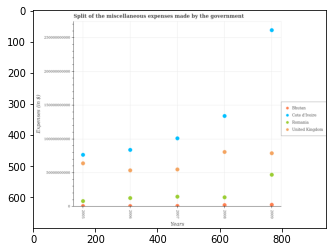

Number of QA =  29





,Years,Cote d'Ivoire,Romania,Bhutan,United Kingdom
0,2008,1.338572e+11,1.432142e+10,2.697988e+09,8.096071e+10
1,2007,1.009824e+11,1.512442e+10,1.546701e+09,5.514065e+10
2,2005,7.671595e+10,8.852749e+09,1.191316e+09,6.411775e+10
3,2009,2.602430e+11,4.743250e+10,3.191905e+09,7.910105e+10
4,2006,8.395662e+10,1.320519e+10,1.288211e+09,5.389417e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the miscellaneous expenses made by the government in romania in 2005 and that in 2009 ?
PREDICTED =  -38579752654.33789
EXPECTED =  -39012064251.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the miscellaneous expenses made by the government in bhutan in 2007 and the miscellaneous expenses made by the government in united kingdom in 2009?
PREDICTED =  -77554344800.8488
EXPECTED =  -78058254000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the miscellaneous expenses made by the government in cote d'ivoire and miscellaneous

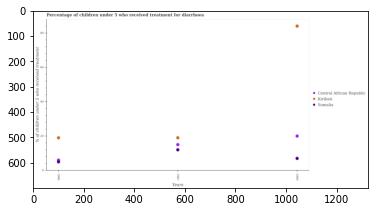

Number of QA =  28





,Years,Somalia,Kiribati,Central African Republic
0,1989,7.276029,84.273991,20.242566
1,1987,12.254145,19.286133,15.261991
2,1986,5.239339,19.233493,6.248085


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received treatment for diarrhoea  in kiribati in 1986 and that in 1987 ?
PREDICTED =  -0.05264000019425197
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received treatment for diarrhoea  in kiribati in 1986 and the percentage of children who received treatment for diarrhoea  in central african republic in 1987?
PREDICTED =  3.9715022330636867
EXPECTED =  4.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the percentage of children who received treat

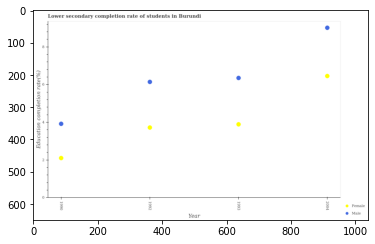

Number of QA =  27





,Year,Male,Female
0,1993,6.413987,3.939650
1,1990,3.969828,2.143023
2,1992,6.203355,3.771548
3,2004,9.087749,6.518230


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of male students in 1990 and that in 2004 ?
PREDICTED =  -5.11792086509195
EXPECTED =  -5.095250129089359




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of female students in 1990 and the education completion rate of male students in 2004?
PREDICTED =  -4.375206489898477
EXPECTED =  -6.912320129089359




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the education completion rate of male students and education completion rate of female students ?
PREDICTED =  -7.49942159

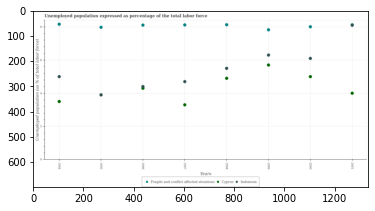

Number of QA =  28





,Years,Cyprus,Fragile and conflict affected situations,Indonesia
0,1994,3.514565,8.171967,5.021311
1,1999,5.718285,7.841382,6.312734
2,2001,4.020427,NaN,8.121387
3,1996,4.414013,8.120467,4.314417
4,1998,4.918281,8.143633,5.512370
5,1995,NaN,7.984881,3.917437
6,1997,3.319050,8.132229,4.718230
7,2000,5.019390,8.020750,6.117521


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in in indonesia in 1996 and that in 1997 ?
PREDICTED =  -0.4038136049907495
EXPECTED =  -0.29999971389770774




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in in indonesia in 1998 and the unemployment in in fragile and conflict affected situations in 2001?
PREDICTED =  -2.60901673505594
EXPECTED =  -2.6242508707925207




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the unemployment in in fragile and conflict affected situations and unemployment in in indonesia ?
PREDICTED =  -0.2103098997171884

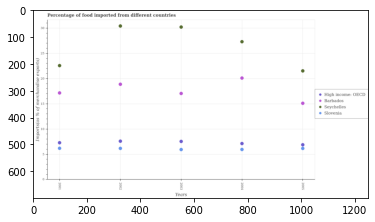

Number of QA =  29





,Years,Slovenia,High income: OECD,Barbados,Seychelles
0,2002,6.256053,7.680772,19.000921,30.571631
1,2001,6.297980,7.358965,17.265672,22.689860
2,2003,6.023427,7.645325,17.171369,30.352809
3,2005,6.252430,6.970007,15.207564,21.653422
4,2004,6.039394,7.215462,20.216023,27.443218


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in high income: oecd in 2004 and that in 2005 ?
PREDICTED =  0.0
EXPECTED =  0.24297941293762104




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in high income: oecd in 2004 and the percentage of imports to different countries in slovenia in 2001?
PREDICTED =  -0.38895753998079474
EXPECTED =  0.9413687981997398




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of imports to different countries in high income: oecd and p

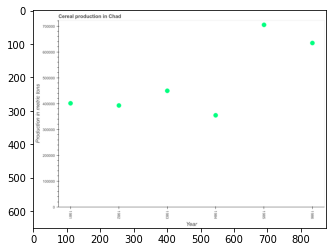

Number of QA =  24





,Year,Production in metric tons
0,1986,637258.895219
1,1981,404221.824170
2,1985,707705.039488
3,1982,395377.159955
4,1983,451999.084829
5,1984,357671.787326


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cereal production in 1982 and 1983 ?
PREDICTED =  -56621.924874220975
EXPECTED =  -56829




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median cereal production ?
PREDICTED =  1983.5
EXPECTED =  425564.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cereal production in 1982 to that in 1985 ?
PREDICTED =  0.5586750664385421
EXPECTED =  0.5573690026797405




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the s

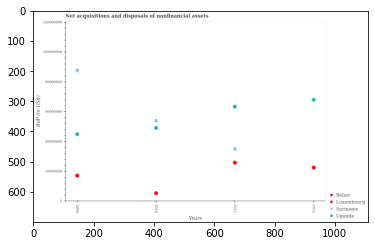

Number of QA =  28





,Years,Uganda,Belize,Luxembourg,Suriname
0,2010,4.955676e+07,5.598852e+06,NaN,5.447685e+07
1,2011,6.393292e+07,2.622063e+07,NaN,3.547421e+07
2,2012,6.862719e+07,2.289407e+07,NaN,NaN
3,2009,4.531392e+07,1.747536e+07,NaN,8.838512e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in uganda in 2009 and that in 2011 ?
PREDICTED =  -18618994.38453041
EXPECTED =  -18481044.060000002




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in uganda in 2011 and the balance of payments in luxembourg in 2010?
PREDICTED =  14376156.395979337
EXPECTED =  63363619.97




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the balance of payments in belize and balance of payments in suriname ?
PREDICTED =  -106147277.34637232
EXPECTED =  -9201732.869999997




				 1 / 3 = 0.3333


is

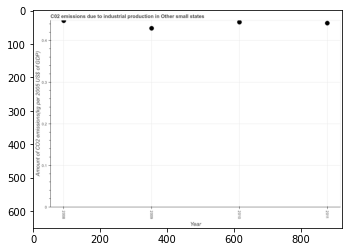

Number of QA =  24





,Year,Amount of CO2 emissions(kg per 2005 US$ of GDP)
0,2008,0.447068
1,2011,0.440958
2,2009,0.428585
3,2010,0.443409


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions in 2009 and 2010 ?
PREDICTED =  -0.014824375122662214
EXPECTED =  -0.014726862633377857




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of co2 emissions ?
PREDICTED =  0.44218365058791187
EXPECTED =  0.4428584930398699




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of co2 emissions in 2008 to that in 2010 ?
PREDICTED =  1.008251724984167
EXPECTED =  1.0078877062390244




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







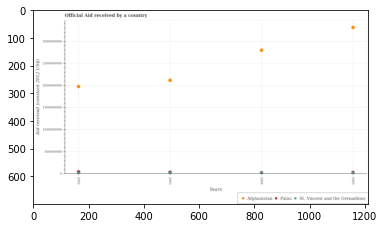

Number of QA =  28





,Years,Palau,St. Vincent and the Grenadines,Afghanistan
0,2003,NaN,3.970595e+07,2.147266e+09
1,2005,NaN,3.778948e+07,3.358065e+09
2,2004,NaN,3.382562e+07,2.837563e+09
3,2002,5.546316e+07,2.252140e+07,2.006078e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid received in st. vincent and the grenadines in 2002 and that in 2005 ?
PREDICTED =  -5771827.436226893
EXPECTED =  -2880000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid received in afghanistan in 2004 and the net official aid received in palau in 2003?
PREDICTED =  690296578.0894325
EXPECTED =  2766660000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the net official aid received in afghanistan and net official aid received in st. vincent and the grenadines ?
PREDICTED =  3224222

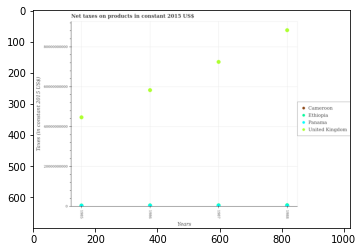

Number of QA =  29





,Years,United Kingdom,Ethiopia,Panama,Cameroon
0,1986,5.864152e+10,NaN,7.425119e+08,NaN
1,1988,8.871680e+10,NaN,8.299049e+08,NaN
2,1985,4.500920e+10,NaN,7.194626e+08,NaN
3,1987,7.280385e+10,NaN,8.257917e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products in panama in 1988 and the net taxes on products in united kingdom in 1987?
PREDICTED =  4113230.0011395216
EXPECTED =  -72336896813.2048




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1986, what is the difference between the net taxes on products in united kingdom and net taxes on products in cameroon ?
PREDICTED =  265171372121.75555
EXPECTED =  57938544322.58678




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0

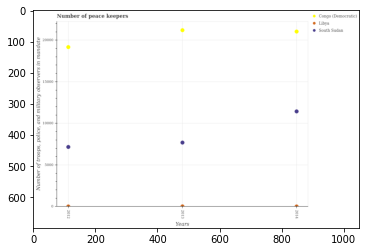

Number of QA =  28





,Years,Unnamed: 1,South Sudan,Congo (Democratic)
0,2013,96.249838,7720.394419,21180.497723
1,2012,73.815631,7193.616749,19163.445228
2,2014,66.576551,11450.964747,21016.295726


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of peace keepers in in congo (democratic) in 2013 and that in 2014 ?
PREDICTED =  0.0
EXPECTED =  162.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of peace keepers in in south sudan in 2013 and the number of peace keepers in in congo (democratic) in 2012?
PREDICTED =  7719.39441892055
EXPECTED =  -11482.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the number of peace keepers in in libya and number of peace keepers in in south sudan ?
PREDICTED =  0.0
EXPECTED =  -7155.0




				 0 / 3 = 0.0


is_b

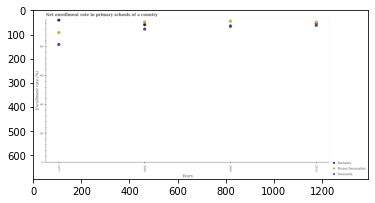

Number of QA =  28





,Years,Venezuela,Brunei Darussalam,Barbados
0,2010,94.965541,96.961522,95.751281
1,2009,94.254450,97.681374,NaN
2,2008,92.279197,97.083387,95.342260
3,1977,81.698565,89.852234,98.462600


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary schools in brunei darussalam in 2009 and that in 2010 ?
PREDICTED =  0.7198514062190924
EXPECTED =  0.6155014038085085




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary schools in barbados in 2010 and the enrollment rate in primary schools in brunei darussalam in 1977?
PREDICTED =  -2.7113187316639085
EXPECTED =  6.359169560546917




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1977, what is the difference between the enrollment rate in primary schools in barbados and enrollment rate in primary schools in 

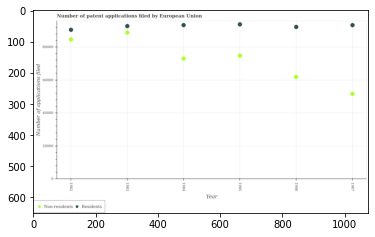

Number of QA =  27





,Year,Non-residents,Residents
0,1984,73035.346855,93339.281009
1,1986,62005.129393,92253.716250
2,1983,88793.817135,92664.926745
3,1987,51745.789123,93261.397882
4,1982,84654.455462,90482.478907
5,1985,74884.185051,93738.012403


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by residents in 1983 and that in 1987 ?
PREDICTED =  92663.92674540983
EXPECTED =  -560




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by residents in 1982 and the number of patent applications by non residents in 1983?
PREDICTED =  1688.6617719740025
EXPECTED =  1663




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the number of patent applications by non residents and number of patent applications by residents ?
PREDICTED =  0.0
EXPECTED =  -18962




				 1 /

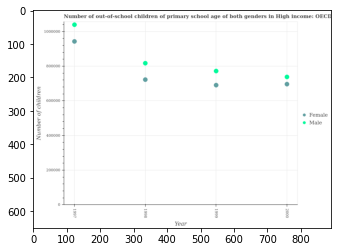

Number of QA =  27





,Year,Male,Female
0,1998,8.224823e+05,727563.878194
1,2000,7.433527e+05,701231.116970
2,1999,7.776808e+05,696240.835730
3,1997,1.045809e+06,948601.603092


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of male out-of-school students in 1997 and that in 2000 ?
PREDICTED =  302456.3336880889
EXPECTED =  301455




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of male out-of-school students in 1999 and the number of female out-of-school students in 2000?
PREDICTED =  34328.040429094224
EXPECTED =  75594




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of female out-of-schoo

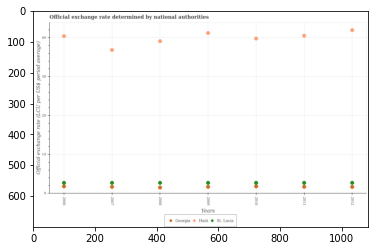

Number of QA =  28





,Years,Georgia,St. Lucia,Haiti
0,2009,1.805253,2.859744,41.335623
1,2010,1.897797,2.834591,39.932165
2,2006,1.898729,2.847465,40.529215
3,2011,1.812868,2.832720,40.654580
4,2008,1.620324,2.849481,39.252551
5,2012,1.796453,2.814318,42.083575
6,2007,1.807398,2.819524,36.965000


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official exchange rate in st. lucia in 2009 and that in 2011 ?
PREDICTED =  0.027023627036672604
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official exchange rate in georgia in 2010 and the official exchange rate in haiti in 2012?
PREDICTED =  0.10134404725951929
EXPECTED =  -40.16738128564893




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the official exchange rate in st. lucia and official exchange rate in haiti ?
PREDICTED =  0.0
EXPECTED =  -39.249722952315594




				 0 / 3 = 0.0


is_built_wit

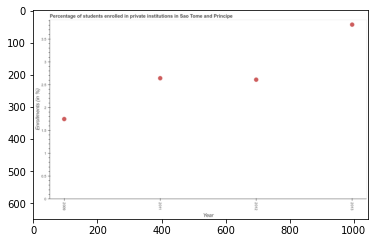

Number of QA =  24





,Year,Enrollments (in %)
0,2013,3.832239
1,2009,1.764357
2,2011,2.658982
3,2012,2.627014


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollments in private institutions in 2009 and 2013 ?
PREDICTED =  -2.067882353156259
EXPECTED =  -2.0677199363708487




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median enrollments in private institutions ?
PREDICTED =  2.642998021568208
EXPECTED =  2.6261349916458148




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the enrollments in private institutions in 2012 to that in 2013 ?
PREDICTED =  0.6855037824457787
EXPECTED =  0.6840479040389593




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finishe

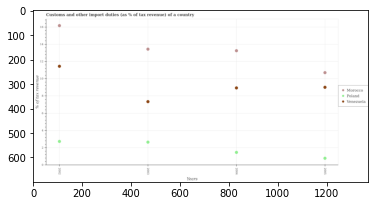

Number of QA =  28





,Years,Venezuela,Morocco,Poland
0,2003,7.420912,13.518020,2.710122
1,2004,9.017320,13.343423,1.515826
2,2002,11.520198,16.256447,2.788575
3,2005,9.079234,10.786911,0.824262


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of tax revenue from customs in venezuela in 2003 and that in 2004 ?
PREDICTED =  -1.5964080252544104
EXPECTED =  -1.5901718200701298




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of tax revenue from customs in morocco in 2004 and the percentage of tax revenue from customs in poland in 2002?
PREDICTED =  -2.9130234049388832
EXPECTED =  10.51090462177719




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of tax revenue from customs in poland and percentage of tax revenue from customs in 

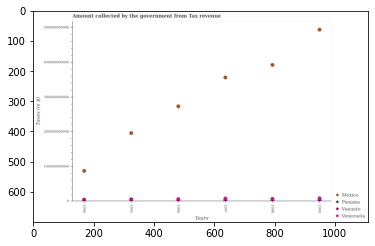

Number of QA =  29





,Years,Vanuatu,Mexico,Panama,Venezuela
0,1998,NaN,3.924315e+11,7.135227e+09,1.967326e+09
1,1999,8.149285e+09,4.939507e+11,NaN,3.913575e+09
2,1996,NaN,2.735926e+11,7.004302e+09,2.183252e+09
3,1997,7.971029e+09,3.564669e+11,NaN,4.278158e+09
4,1990,NaN,8.798232e+10,NaN,4.821396e+09
5,1995,5.500443e+09,1.967640e+11,NaN,2.033558e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by the government from tax revenue in mexico in 1995 and that in 1999 ?
PREDICTED =  -297186658610.16846
EXPECTED =  -297972000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by the government from tax revenue in venezuela in 1995 and the amount collected by the government from tax revenue in vanuatu in 1997?
PREDICTED =  -2244599380.704399
EXPECTED =  -4006501000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the amount collected by the government from tax revenue in venezuela 

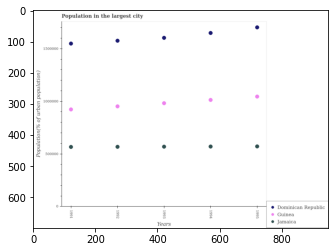

Number of QA =  28





,Years,Jamaica,Dominican Republic,Guinea
0,1993,573293.149616,1.607196e+06,9.861874e+05
1,1991,570157.322361,1.552751e+06,9.262902e+05
2,1994,574068.200010,1.653300e+06,1.016987e+06
3,1995,575190.702357,1.706863e+06,1.049090e+06
4,1992,571222.164391,1.579558e+06,9.561203e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in the largest city in jamaica in 1993 and that in 1994 ?
PREDICTED =  -775.0503940791823
EXPECTED =  -1265




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in the largest city in jamaica in 1993 and the population in the largest city in dominican republic in 1995?
PREDICTED =  -1897.5527416939149
EXPECTED =  -1134389




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the population in the largest city in jamaica and population in the largest city in dominican republic ?
PREDICTED =  -1131671.8112433285

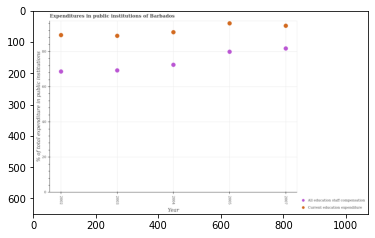

Number of QA =  27





,Year,All education staff compensatior,Current education expenditure
0,2005,80.324025,96.499939
1,2007,82.186088,95.121519
2,2003,69.693277,89.435014
3,2004,72.893707,91.416737
4,2002,69.065583,89.745096


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in 2002 and that in 2004 ?
PREDICTED =  -1.6716411746417634
EXPECTED =  -3.820899963378892




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in 2002 and the expenditure in education in 2004?
PREDICTED =  -1.6716411746417634
EXPECTED =  -22.345100402832088




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the expenditure in staff compensation and expenditure in education ?
PREDICTED =  96.49993886929875
EXPECTED =  -12.893325805664091




				 0 / 3 = 0.0


i

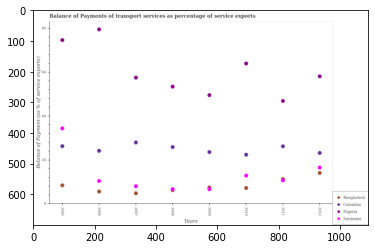

Number of QA =  29





,Years,Nigeria,Colombia,Bangladesh,Suriname
0,2009,49.714886,23.786711,7.648907,6.892415
1,2008,53.617092,26.101182,NaN,6.952555
2,2006,79.664080,24.401551,5.861644,10.658779
3,2010,64.132045,22.581772,7.439383,13.082071
4,2011,47.060959,26.431951,NaN,10.944858
5,2005,74.799178,26.456095,8.654889,34.546394
6,2012,58.295446,23.416713,14.273625,16.783525
7,2007,57.678523,28.148556,5.038942,8.300766


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in suriname in 2008 and that in 2009 ?
PREDICTED =  0.060140240267002376
EXPECTED =  0.037276568253319375




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in suriname in 2009 and the balance of payments of transport services in colombia in 2007?
PREDICTED =  -1.4083511804205342
EXPECTED =  -21.307874578446977




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the balance of payments of transport services in bangladesh and balance of payments 

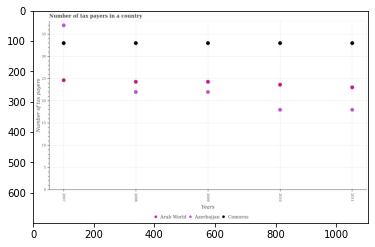

Number of QA =  28





,Years,Comoros,Arab World,Azerbaijan
0,2009,33.115739,24.417951,22.120113
1,2008,33.112791,24.426645,22.120284
2,2011,33.116660,23.155781,18.114748
3,2010,33.112146,23.762471,18.115952
4,2007,33.127336,24.748781,37.138900


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tax payers in in arab world in 2010 and that in 2011 ?
PREDICTED =  0.6066895222835953
EXPECTED =  0.5999999999999979




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tax payers in in comoros in 2008 and the number of tax payers in in azerbaijan in 2010?
PREDICTED =  0.0006452053273804381
EXPECTED =  15




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the number of tax payers in in comoros and number of tax payers in in arab world ?
PREDICTED =  0.0
EXPECTED =  8.350000000000001




				 1 / 3 = 0.3333


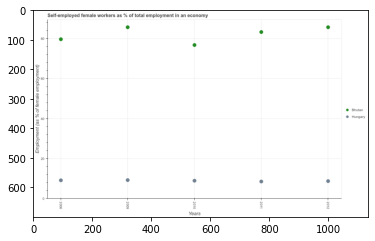

Number of QA =  27





,Years,Hungary,Bhutan
0,2006,9.421989,80.196819
1,2011,8.802665,83.818625
2,2009,9.516376,86.203672
3,2010,9.210652,77.300772
4,2012,9.030853,86.220651


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in bhutan in 2010 and that in 2012 ?
PREDICTED =  -8.919878718864027
EXPECTED =  -8.899993896484403




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in bhutan in 2011 and the percentage of self-employed female workers in hungary in 2012?
PREDICTED =  -2.4020261286293874
EXPECTED =  74.60000324249266




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of self-employed female workers in hungary and percentage of self-employed fe

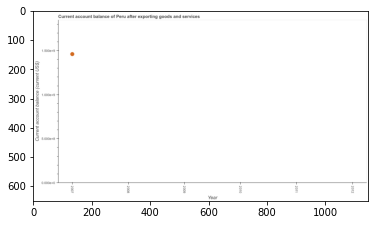

Number of QA =  16





,Year,Current account balance (current US$)
0,2007,1.461754
1,2010,NaN
2,2008,NaN
3,2009,NaN
4,2011,NaN
5,2012,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median current account balance ?
PREDICTED =  1.4617542153346788
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest current account balance ?
PREDICTED =  nan
EXPECTED =  1460344786.0




				 0 / 2 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Current account balance (current US$)
EXPECTED =  500000000.0




				 0 / 3 = 0.0


> what is the title of the graph ?
PREDICTED =  Current account balance of Peru after exporting goods and services
EXPECTED =  Current account balance of Peru after exporting goods and services




				 1 / 4 = 0.25


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED 

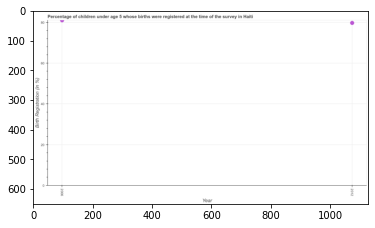

Number of QA =  20





,Year,Birth Registration (in %)
0,2012,80.196950
1,2006,81.428937


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the birth registration in 2006 ?
PREDICTED =  40.71446841054313
EXPECTED =  81.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum birth registration ?
PREDICTED =  40.71446841054313
EXPECTED =  81.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum birth registration ?
PREDICTED =  1006.0
EXPECTED =  79.7




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the birth registration maximum ?
PREDICTED =  1003.0
EXPECTED =  2006




				 0 

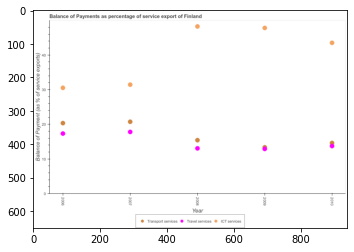

Number of QA =  28





,Year,ICT services,Travel services,Transport services
0,2010,43.822692,13.931595,14.845209
1,2007,31.719444,17.997373,20.998030
2,2009,48.164986,13.075671,13.612501
3,2008,48.580011,13.260876,15.657345
4,2006,30.809772,17.557752,20.584672


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payment of transport services in 2007 and that in 2009 ?
PREDICTED =  7.385528824592809
EXPECTED =  7.3657386647923




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payment of transport services in 2007 and the balance of payment of ict services in 2008?
PREDICTED =  5.3406851971126805
EXPECTED =  -27.497306429984103




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the balance of payment of travel services and balance of payment of transport services ?
PREDICTED =  -35.08931454910649
EXPECTED =  -2.93

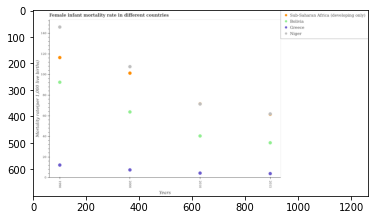

Number of QA =  29





,Years,Niger,Bolivia,Sub-Saharan Africa (developing only),Greece
0,1990,145.860564,92.642734,116.481216,12.589766
1,2000,107.615660,63.927544,101.394567,7.859327
2,2015,61.778704,34.155259,NaN,4.292659
3,2010,71.649330,40.710719,NaN,4.789130


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female infant mortality rate in bolivia in 2010 and that in 2015 ?
PREDICTED =  6.555460288649584
EXPECTED =  6.600000000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female infant mortality rate in bolivia in 2015 and the female infant mortality rate in greece in 2000?
PREDICTED =  -29.772285111871597
EXPECTED =  26.299999999999997




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the f

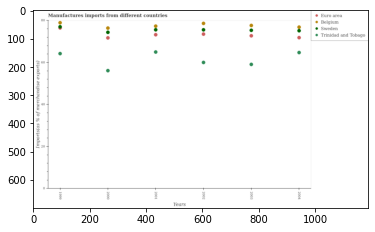

Number of QA =  29





,Years,Trinidad and Tobago,Euro area,Belgium,Sweden
0,2004,64.692752,71.767374,76.797605,75.096376
1,1999,64.183280,NaN,78.893941,76.777122
2,2000,56.106842,71.652691,76.325126,74.306196
3,2002,59.995151,73.455841,78.553024,75.494949
4,2003,59.072690,72.665028,77.556754,75.294320
5,2001,64.960455,73.162784,77.189132,75.496303


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in belgium in 1999 and that in 2002 ?
PREDICTED =  0.8390522451782658
EXPECTED =  0.3124644484230146




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in belgium in 2004 and the percentage of imports to different countries in trinidad and tobago in 2001?
PREDICTED =  -0.39152743569403015
EXPECTED =  11.8470182773478




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of imports to different countries in trinidad and tobago 

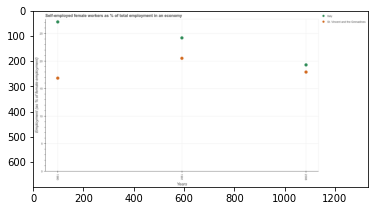

Number of QA =  27





,Years,St. Vincent and the Grenadines,Italy
0,2008,18.025231,19.310634
1,1980,16.924607,27.093482
2,1991,20.514543,24.200107


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in st. vincent and the grenadines in 1980 and that in 2008 ?
PREDICTED =  -1.100623889749432
EXPECTED =  -1.1000003814697017




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in italy in 1991 and the percentage of self-employed female workers in st. vincent and the grenadines in 1980?
PREDICTED =  -2.8933751235922998
EXPECTED =  7.300001144409201




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the percentage of self-employed female worker

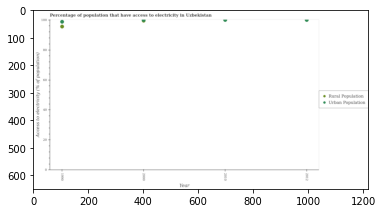

Number of QA =  27





,Year,Urban Population,Rural Population
0,1990,98.993015,95.868634
1,2012,100.285537,NaN
2,2000,99.906943,NaN
3,2010,100.296008,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 1990 and that in 2010 ?
PREDICTED =  nan
EXPECTED =  -4.420540000000003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2010 and the percentage of urban population having access to electricity in 1990?
PREDICTED =  nan
EXPECTED =  1.2333449387632953




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the percentage of urban population having access to electricity and percentage of rural population hav

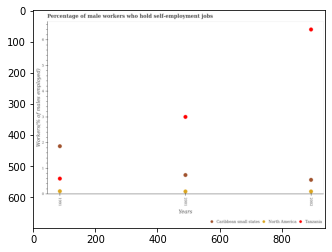

Number of QA =  28





,Years,North America,Tanzania,Caribbean small states
0,1991,0.132504,0.617515,1.868167
1,2001,0.120973,3.005013,0.756090
2,2002,0.120583,6.389399,0.571540


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed male workers in north america in 1991 and that in 2001 ?
PREDICTED =  0.011530491588594663
EXPECTED =  0.009958858447905006




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed male workers in north america in 1991 and the percentage of self-employed male workers in tanzania in 2001?
PREDICTED =  0.011530491588594663
EXPECTED =  -2.890041140061979




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the percentage of self-employed male workers in tanzania and percentage of se

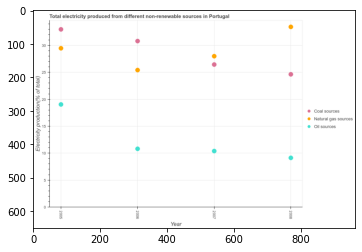

Number of QA =  28





,Year,Natural gas sources,Oil sources,Coal sources
0,2008,33.734821,9.285207,24.872293
1,2007,28.261613,10.572260,26.692912
2,2005,29.767790,19.254051,33.278508
3,2006,25.685745,10.990758,31.086525


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by natural gas in 2006 and that in 2008 ?
PREDICTED =  -8.049075865782157
EXPECTED =  -8.016032571209198




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by natural gas in 2006 and the percentage of electricity produced by oil sources in 2008?
PREDICTED =  -8.049075865782157
EXPECTED =  16.287369597205817




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of electricity produced by coal and percentage of electricity produced by natural gas ?

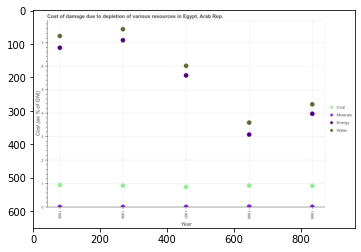

Number of QA =  29





,Year,Coal,Water,Minerals,Energy
0,1998,0.945460,3.648380,0.049018,3.138001
1,1996,0.947413,7.653117,0.039818,7.180753
2,1999,0.936912,4.434959,0.045200,4.028211
3,1997,0.890643,6.084630,0.040734,5.672144
4,1995,0.968788,7.365214,0.038712,6.858538


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals in 1996 and that in 1998 ?
PREDICTED =  -0.00919942486028412
EXPECTED =  -0.01286053402338869




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal in 1999 and the cost of damage due to depletion of energy in 1995?
PREDICTED =  -0.031876086188835195
EXPECTED =  -5.879772736236545




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ra

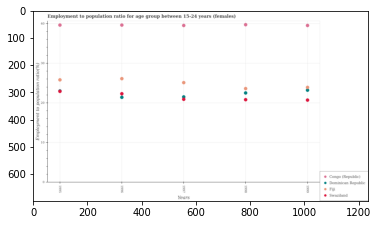

Number of QA =  29





,Years,Swaziland,Fiji,Dominican Republic,Congo (Republic)
0,1995,23.045768,25.932774,NaN,39.738610
1,1999,20.832465,24.027131,23.347403,39.669392
2,1996,22.446527,26.265253,21.528019,39.771510
3,1998,20.942296,23.754893,22.645475,39.872842
4,1997,21.059572,25.255349,21.642729,39.663919


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in dominican republic in 1996 ?
PREDICTED =  92.85573228335929
EXPECTED =  21.3999996185303




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in dominican republic ?
PREDICTED =  85.61980231683495
EXPECTED =  23.2000007629395




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in dominican republic ?
PREDICTED =  1.001252191334836
EXPECTED =  21.3999996185303




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...


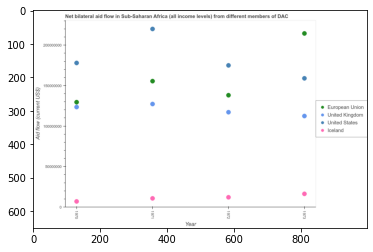

Number of QA =  29





,Year,Iceland,European Union,United States,United Kingdom
0,1973,1.710517e+07,2.145231e+08,1.592349e+08,1.127711e+08
1,1972,1.283500e+07,1.385059e+08,1.752313e+08,1.175332e+08
2,1971,1.148882e+07,1.558111e+08,2.200272e+08,1.276398e+08
3,1970,7.757730e+06,1.298595e+08,1.781442e+08,1.237792e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by iceland in 1970 and that in 1972 ?
PREDICTED =  -5077268.282703376
EXPECTED =  -5120000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by us in 1972 and the amount of aid given by iceland in 1971?
PREDICTED =  -44795888.34905103
EXPECTED =  164310000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the amount of aid given by iceland and amount of aid given by uk ?
PREDICTED =  -432536633.68432033
EXPECTED =  -105120000




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_av

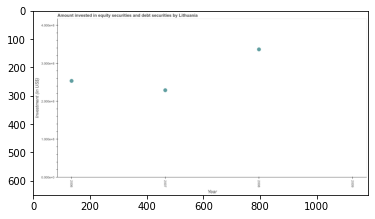

Number of QA =  22





,Year,Investment (in US$)
0,2007,2.294844
1,2006,2.539544
2,2008,3.366134
3,2009,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the portfolio investment in 2006 and 2008 ?
PREDICTED =  -0.8265893490368255
EXPECTED =  -82959571.20000002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median portfolio investment ?
PREDICTED =  2.5395441751537184
EXPECTED =  241200629.89999998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the portfolio investment in 2007 to that in 2008 ?
PREDICTED =  0.6817447380648365
EXPECTED =  0.68047611649227




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the

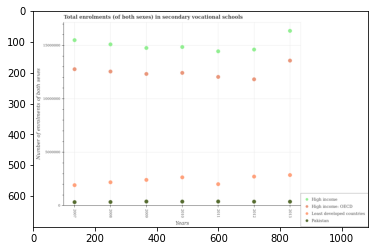

Number of QA =  29





,Years,High income: OECD,Least developed countries,High income,Pakistan
0,2012,1.189089e+07,2.785425e+06,1.467935e+07,436657.743989
1,2008,1.263090e+07,2.247409e+06,1.516048e+07,396752.873940
2,2007,1.282965e+07,1.987493e+06,1.556041e+07,383188.710813
3,2013,1.365383e+07,2.935112e+06,1.643255e+07,430681.362603
4,2009,1.239717e+07,2.472146e+06,1.482604e+07,444132.630685
5,2010,1.249827e+07,2.714082e+06,1.491732e+07,439645.934683
6,2011,1.211831e+07,2.072890e+06,1.451573e+07,444625.664510


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in high income: oecd in 2011 and that in 2012 ?
PREDICTED =  227413.6155568324
EXPECTED =  224835.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in high income in 2008 and the number of enrolments in secondary schools in least developed countries in 2012?
PREDICTED =  740007.6089495625
EXPECTED =  12372177.25




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the number of enrolments in secondary schools in high income: oecd and number of

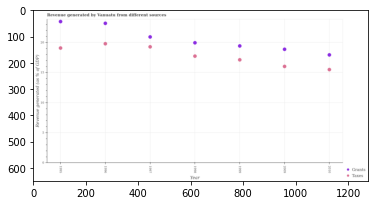

Number of QA =  27





,Year,Grants,Taxes
0,1997,21.075672,19.409170
1,1998,20.092713,17.871852
2,1996,23.335753,19.940841
3,1999,19.563277,17.251110
4,2009,19.019326,16.148781
5,2010,18.076801,15.630290
6,1995,23.628763,19.231744


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by grants in 1998 and that in 2010 ?
PREDICTED =  2.0159122921954946
EXPECTED =  2.012098771321




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by taxes in 2009 and the revenue generated by grants in 1995?
PREDICTED =  -3.082963416628985
EXPECTED =  -7.458692793564108




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the revenue generated by taxes and revenue generated by grants ?
PREDICTED =  118.48378792919364
EXPECTED =  -4.400716927887711




				 1 / 3 = 0.3333


is_built_with_cuda:

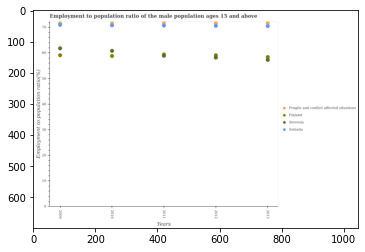

Number of QA =  29





,Years,Slovenia,Somalia,Fragile and conflict affected situations,Finland
0,2013,57.525857,70.729785,71.810081,58.564695
1,2011,59.086621,70.923703,71.823558,NaN
2,2009,61.985747,71.787965,71.139265,59.246340
3,2012,58.409230,70.832866,71.832579,59.292899
4,2010,60.965201,71.000329,71.810730,58.967235


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in slovenia in 2009 ?
PREDICTED =  32.47520777274459
EXPECTED =  61.7999992370605




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in fragile and conflict affected situations ?
PREDICTED =  1.0004970178926442
EXPECTED =  71.6180531719436




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in fragile and conflict affected situations ?
PREDICTED =  1.0019910403185666
EXPECTED =  71.489114716013




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
G

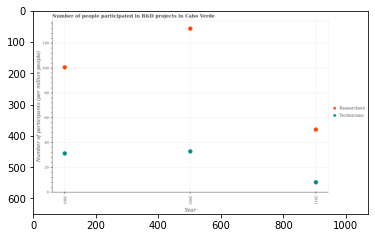

Number of QA =  27





,Year,Technicians,Researchers
0,2002,32.956454,130.759104
1,2001,31.386921,99.892296
2,2011,8.423233,50.349831


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of technicians in 2001 and that in 2011 ?
PREDICTED =  22.963687232220714
EXPECTED =  23.21671




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of researchers in 2001 and the number of technicians in 2002?
PREDICTED =  -30.866808679602485
EXPECTED =  67.65243000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the number of technicians and number of researchers ?
PREDICTED =  -208.23462356629852
EXPECTED =  -98.81509




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tra

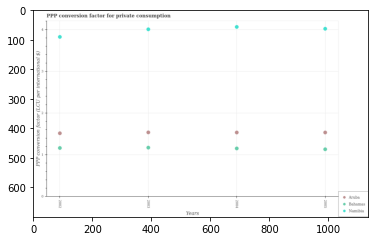

Number of QA =  28





,Years,Bahamas,Unnamed: 2,Namibia
0,2004,1.165624,1.548974,4.080261
1,2005,1.146517,1.548117,4.033993
2,2003,1.186814,1.551085,4.023588
3,2002,1.176041,1.529456,3.841524


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for private consumption in namibia in 2003 and that in 2005 ?
PREDICTED =  -0.01040512365459989
EXPECTED =  -0.013286490089869929




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for private consumption in bahamas in 2003 and the ppp conversion factor for private consumption in namibia in 2005?
PREDICTED =  -2.8471793517472825
EXPECTED =  -2.8466203323518293




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the ppp conversion factor for private consumption in namibia and ppp conve

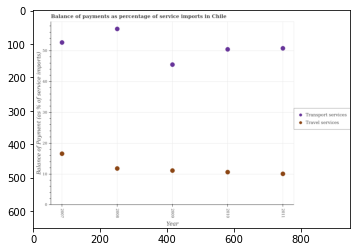

Number of QA =  27





,Year,Travel services,Transport services
0,2010,10.782431,50.565873
1,2008,11.948889,57.201871
2,2007,16.702675,52.795240
3,2009,11.272241,45.609559
4,2011,10.197367,50.913928


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2008 and that in 2009 ?
PREDICTED =  0.6766481760359291
EXPECTED =  0.6736882509226998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in 2007 and the balance of payments of travel services in 2009?
PREDICTED =  7.185681016359965
EXPECTED =  41.5584307176343




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the balance of payments of travel services and balance of payments of transport services ?
PREDICTED =  5.197367261435053
EXPECTED =  -

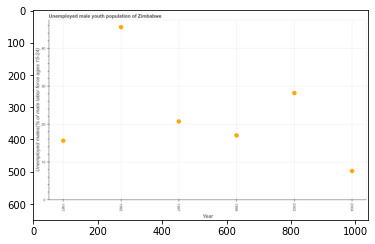

Number of QA =  24





,Year,Unemployed males(% of male labor force ages 15-24)
0,1997,20.897360
1,1992,45.862833
2,1999,17.205739
3,2002,28.429148
4,1987,15.780358
5,2004,7.784506


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed male youth in 1999 and 2004 ?
PREDICTED =  9.42123301022025
EXPECTED =  9.400000095367428




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed male youth ?
PREDICTED =  1998.0
EXPECTED =  18.850000381469748




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed male youth in 1992 to that in 2002 ?
PREDICTED =  1.6132327734335177
EXPECTED =  1.6170211787387154




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference

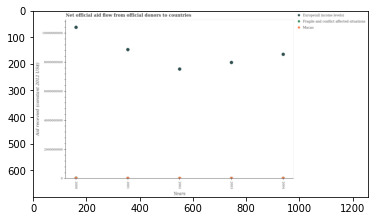

Number of QA =  28





,Years,Macao,Fragile and conflict affected situations,Europe(all income levels)
0,2004,4.560091e+07,NaN,8.557112e+09
1,2001,4.726606e+07,NaN,8.881032e+09
2,2000,5.571269e+07,NaN,1.040298e+10
3,2002,4.596740e+07,NaN,7.539626e+09
4,2003,4.882602e+07,NaN,7.994552e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total aid received in macao in 2001 and that in 2003 ?
PREDICTED =  -1559961.910183996
EXPECTED =  680000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total aid received in macao in 2000 and the total aid received in europe(all income levels) in 2001?
PREDICTED =  8446623.025874287
EXPECTED =  -8866010000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the total aid received in europe(all income levels) and total aid received in fragile and conflict affected situations ?
PREDICTED =  34818186453.35623
EXPECTED =  

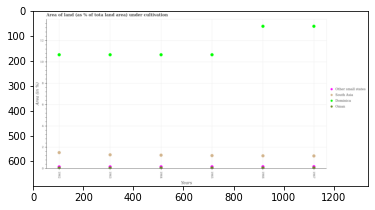

Number of QA =  29





,Years,Oman,South Asia,Other small states,Dominica
0,1963,NaN,1.334495,0.159604,10.694772
1,1966,0.112716,1.236968,0.208818,13.358358
2,1965,NaN,1.249727,0.196776,10.700730
3,1962,NaN,1.534313,0.198166,10.691920
4,1964,0.108754,1.291678,0.203542,10.696808
5,1967,0.101108,1.219724,0.206565,13.361961


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land under cultivation in dominica in 1962 and that in 1963 ?
PREDICTED =  -0.002851985347149366
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land under cultivation in other small states in 1966 and the percentage of land under cultivation in dominica in 1963?
PREDICTED =  0.04921354581648252
EXPECTED =  -10.493704806666504




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> 

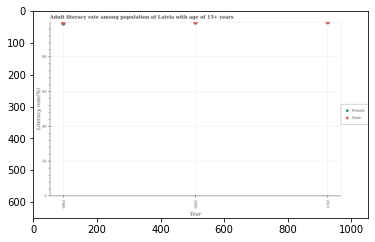

Number of QA =  27





,Year,Male,Female
0,1989,99.082204,NaN
1,2000,99.412452,NaN
2,2011,99.514986,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female adult literacy rate in 2000 and that in 2011 ?
PREDICTED =  nan
EXPECTED =  -0.19818115234369316




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female adult literacy rate in 1989 and the male adult literacy rate in 2000?
PREDICTED =  nan
EXPECTED =  -0.5907925903319864




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the female adult literacy rate and male adult literacy rate ?
PREDICTED =  nan
EXPECTED =  0.026817321777286907




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trainin

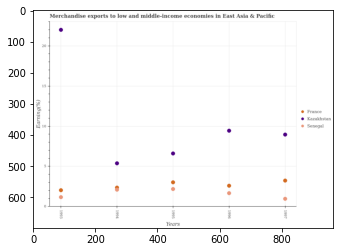

Number of QA =  28





,Years,France,Kazakhstan,Senegal
0,1995,3.052774,6.653041,2.225188
1,1994,2.140451,5.413298,2.406099
2,1997,3.280617,9.000773,1.009031
3,1996,2.636337,9.492519,1.713383
4,1993,2.071990,22.033311,1.217207


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in senegal in 1993 and that in 1995 ?
PREDICTED =  -1.0079811628817796
EXPECTED =  -1.01209702298726




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in kazakhstan in 1993 and the percentage of amount earned from merchandise exports in france in 1997?
PREDICTED =  13.032538157364163
EXPECTED =  18.768934376378528




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the percentage of amount earned from merchandise exports i

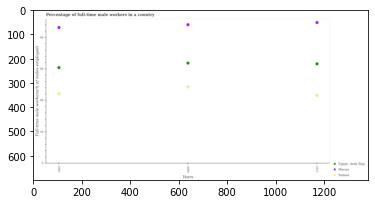

Number of QA =  28





,Years,Macao,Samoa,"Egypt, Arab Rep"
0,2001,86.814165,44.610961,61.295867
1,2006,88.646687,48.981753,64.158749
2,2011,90.034321,43.536045,63.640358


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in egypt, arab rep. in 2006 and that in 2011 ?
PREDICTED =  0.5183904154901029
EXPECTED =  0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in samoa in 2006 and the percentage of full-time male workers in egypt, arab rep. in 2001?
PREDICTED =  -12.314113241404215
EXPECTED =  -12.200000762939396




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the percentage of full-time male workers in macao and percentage of full-time male workers in egypt, arab

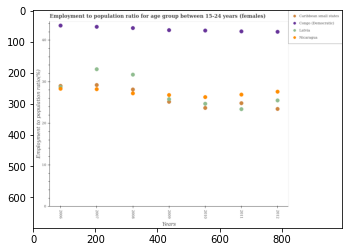

Number of QA =  29





,Years,Nicaragua,Caribbean small states,Congo (Democratic),Latvia
0,2008,27.234604,28.189409,42.915856,31.724339
1,2009,26.884561,25.227400,42.414934,25.797493
2,2012,27.657685,23.522369,42.002533,25.561685
3,2010,26.363603,23.731918,42.319909,24.726545
4,2007,28.238842,29.242819,43.195920,33.013260
5,2006,28.984680,28.383772,43.477858,NaN
6,2011,26.952906,24.878317,42.113980,23.442804


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in caribbean small states in 2012 ?
PREDICTED =  85.5356031809573
EXPECTED =  23.4536139158885




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in caribbean small states ?
PREDICTED =  68.80321557031289
EXPECTED =  29.2070490598277




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in congo (democratic) ?
PREDICTED =  47.901872471759
EXPECTED =  42.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluat

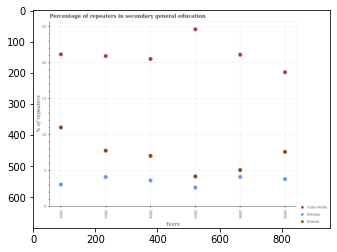

Number of QA =  28





,Years,Cabo Verde,Estonia,Kuwait
0,2004,20.467030,3.670134,7.076042
1,2006,21.052135,4.176027,5.122444
2,2008,18.631531,3.859790,7.626468
3,2002,21.112458,3.119253,10.996903
4,2003,20.858268,4.157997,7.797767
5,2005,24.554723,2.682324,4.239968


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters in secondary general education in kuwait in 2003 and that in 2004 ?
PREDICTED =  0.7217249962467438
EXPECTED =  0.7269196510314995




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters in secondary general education in estonia in 2004 and the percentage of repeaters in secondary general education in kuwait in 2008?
PREDICTED =  -0.18965590428984802
EXPECTED =  -3.98103976249694




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of repeaters in secondary general educat

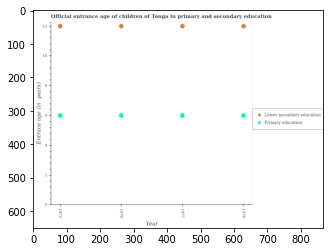

Number of QA =  27





,Year,Primary education,Lower secondary education
0,1976,6.086100,12.148004
1,1975,6.087789,12.139155
2,1978,6.083944,12.145504
3,1977,6.088004,12.147177


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of children in lower secondary education in 1975 and that in 1978 ?
PREDICTED =  -0.006349268274078668
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of children in lower secondary education in 1975 and the entrance age of chiildren in primary education in 1978?
PREDICTED =  -0.006349268274078668
EXPECTED =  6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the entrance age of children in lower secondary education and entrance age of chiildren in primary education ?
PREDICTED =  1

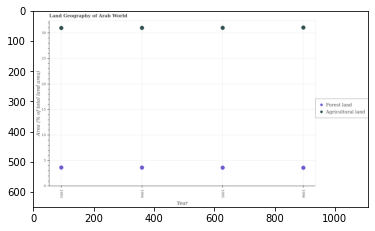

Number of QA =  27





,Year,Agricultural land,Forest land
0,1994,31.144868,3.720774
1,1995,31.160030,3.701289
2,1996,31.204223,3.684489
3,1993,31.135449,3.715345


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under agriculture in 1994 and that in 1995 ?
PREDICTED =  -0.01516249508565437
EXPECTED =  -0.006532574683600245




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under agriculture in 1994 and the percentage of land area under forests in 1993?
PREDICTED =  0.009418989853273274
EXPECTED =  27.366316718863708




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of land area under agriculture and percentage of land area under forests ?
PREDICTED =  27.519733777623067
E

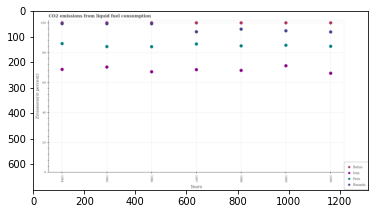

Number of QA =  29





,Years,Peru,Rwanda,Belize,Iran
0,1984,86.515633,99.915180,NaN,69.183945
1,1987,86.210810,94.386664,100.323860,69.054279
2,1985,84.411724,100.010063,NaN,70.761639
3,1989,85.360118,95.023958,100.303492,71.594877
4,1986,84.414235,99.941835,NaN,67.617884
5,1988,84.934957,96.150828,100.354193,68.529486
6,1990,84.666227,94.302461,100.323677,66.642994


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in belize in 1986 and that in 1987 ?
PREDICTED =  300.9813621434267
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in rwanda in 1984 and the total co2 emitted in iran in 1986?
PREDICTED =  -0.026655623810682982
EXPECTED =  32.1579890128469




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1986, what is the difference between the total co2 emitted in rwanda and total co2 emitted in peru ?
PREDICTED =  83.21728412265122
EXPECTED =  15.331451036601905




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_avai

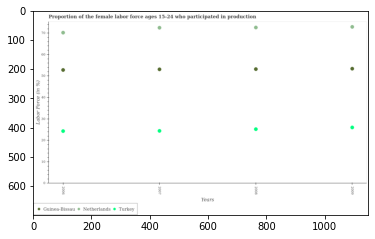

Number of QA =  28





,Years,Netherlands,Guinea-Bissau,Turkey
0,2008,72.297286,53.022940,25.254953
1,2006,69.882721,52.641301,24.337810
2,2009,72.588773,53.224993,26.049611
3,2007,72.179737,52.947175,24.448535


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in netherlands in 2007 and that in 2009 ?
PREDICTED =  -0.4090357027487954
EXPECTED =  -0.40000152587890625




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in guinea-bissau in 2006 and the proportion of the female labor force who participated in production in turkey in 2008?
PREDICTED =  -0.38163832758256433
EXPECTED =  27.599998474120998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between t

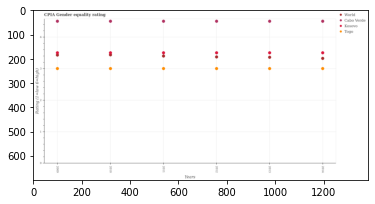

Number of QA =  29





,Years,World,Kosovo,Cabo Verde,Togo
0,2012,3.381858,3.507975,4.511613,3.010243
1,2010,3.446817,3.508736,4.509639,3.009812
2,2014,3.334141,3.511499,4.513197,3.012247
3,2011,3.410702,3.509207,4.510229,3.010983
4,2013,3.369566,3.509394,4.510568,3.012006
5,2009,3.442101,3.509259,4.513144,3.014090


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in world in 2009 and that in 2011 ?
PREDICTED =  0.0313994318178481
EXPECTED =  0.031135531135531025




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in world in 2011 and the cpia rating in cabo verde in 2014?
PREDICTED =  0.07656040208368653
EXPECTED =  -1.1025641025641




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the cpia rating in cabo verde and cpia rating in togo ?
PREDICTED =  1.5016331469725617
EXPECTED =  1.5




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs

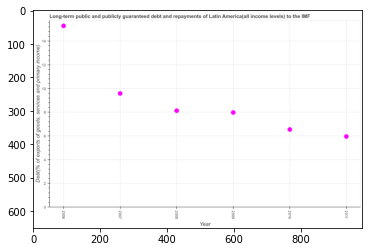

Number of QA =  24





,Year,"Debt(% of exports of goods, services and primary income)"
0,2007,9.617860
1,2008,8.170656
2,2010,6.591728
3,2009,8.014169
4,2006,15.305336
5,2011,6.006975


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt service in 2009 and 2010 ?
PREDICTED =  1.4224412426150064
EXPECTED =  1.432188953114018




				 1 / 1 = 1.0


> what is the median debt service ?
PREDICTED =  None
EXPECTED =  8.050673971689056




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the debt service in 2006 to that in 2010 ?
PREDICTED =  2.321900325029563
EXPECTED =  2.3368409950929396




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest debt service ?
PREDICTED =  7.2911663015409385
EXPECTED =  5.705107540174291




				 2 / 5 = 0.4


is_built_with_cuda

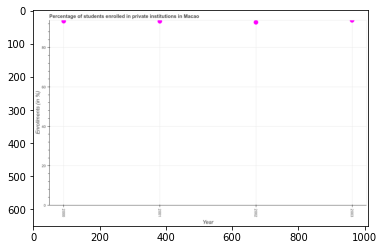

Number of QA =  24





,Year,Enrollments (in %)
0,2003,93.921644
1,2002,92.961430
2,2000,93.588647
3,2001,93.451247


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollments in private institutions in 2002 and 2003 ?
PREDICTED =  -0.9602143026292111
EXPECTED =  -1.0059127807617188




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median enrollments in private institutions ?
PREDICTED =  93.51994675645307
EXPECTED =  93.3333206176758




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the enrollments in private institutions in 2000 to that in 2001 ?
PREDICTED =  1.001470286969724
EXPECTED =  1.0005941248849521




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished 

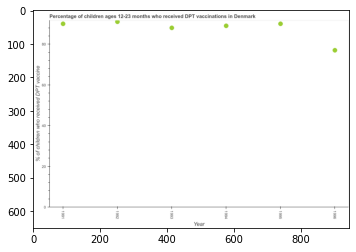

Number of QA =  24





,Year,% of children who received DPT vaccine
0,1993,87.789035
1,1995,89.776380
2,1996,76.811446
3,1992,90.736568
4,1994,88.772682
5,1991,89.682452


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccine in 1991 and 1996 ?
PREDICTED =  12.871006132388487
EXPECTED =  13




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of children who received dpt vaccine ?
PREDICTED =  89.22756709756274
EXPECTED =  89.5




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of children who received dpt vaccine in 1992 to that in 1995 ?
PREDICTED =  1.0106953230724338
EXPECTED =  1.011111111111111




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fin

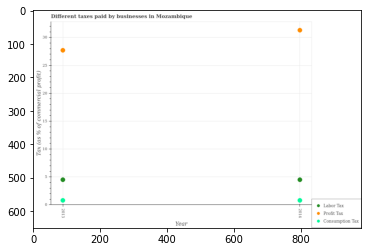

Number of QA =  24





,Year,Labor Tax,Consumption Tax,Profit Tax
0,2013,4.545719,0.884284,27.522948
1,2014,4.535394,0.881652,31.075040


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of profit tax in 2013 and that in 2014 ?
PREDICTED =  -3.55209224978816
EXPECTED =  -3.6000000000000014




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of profit tax in 2014 and the percentage of consumption tax in 2013?
PREDICTED =  3.55209224978816
EXPECTED =  30.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the percentage of labor tax and percentage of consumption tax ?
PREDICTED =  3.664066663414866
EXPECTED =  3.7




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GP

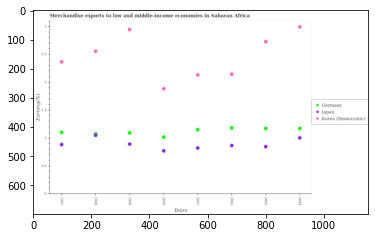

Number of QA =  28





,Years,Germany,Korea (Democratic),Japan
0,2004,1.192887,3.031903,1.023719
1,2003,1.193617,2.763187,0.864674
2,1998,1.067993,2.590922,1.099104
3,1997,1.121320,2.398575,0.901248
4,2000,1.039278,1.911065,0.788773
5,1999,1.114274,2.982347,0.910663
6,2001,1.172066,2.161861,0.839010
7,2002,1.204117,2.173461,0.882709


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in germany in 1998 and that in 2004 ?
PREDICTED =  -0.12489470273064329
EXPECTED =  -0.0952664298376098




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in korea (democratic) in 2002 and the percentage of amount earned from merchandise exports in germany in 2001?
PREDICTED =  0.01160007949794295
EXPECTED =  0.99126967815017




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of amount earned from merchandis

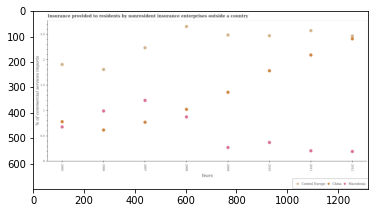

Number of QA =  28





,Years,China,Macedonia,Central Europe
0,2006,0.620590,0.995983,1.814483
1,2009,1.366004,0.277576,2.493873
2,2008,1.028524,0.880147,2.661603
3,2005,0.784964,0.684161,1.914622
4,2011,2.098507,0.213387,2.580038
5,2012,2.419929,0.199115,2.473910
6,2010,1.789795,0.375549,2.479278
7,2007,0.774226,1.204661,2.241985


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to residents in macedonia in 2007 and that in 2010 ?
PREDICTED =  0.8291124176569168
EXPECTED =  0.8286665151300372




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to residents in macedonia in 2005 and the insurance provided to residents in central europe in 2007?
PREDICTED =  -0.5205002633556564
EXPECTED =  -1.559304751458938




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wha

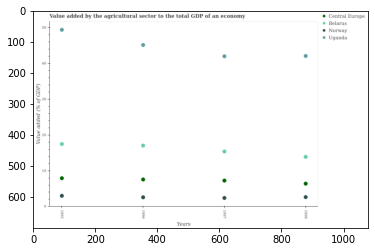

Number of QA =  29





,Years,Uganda,Central Europe,Norway,Belarus
0,1998,42.183461,6.523916,2.763239,14.014668
1,1995,49.479103,8.038649,3.121814,17.587966
2,1997,42.112297,7.393459,2.527356,15.509529
3,1996,45.245081,7.674002,2.698766,17.163567


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector to the total gdp in belarus in 1996 and that in 1998 ?
PREDICTED =  3.14889847849107
EXPECTED =  3.153065703971402




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector to the total gdp in norway in 1998 and the value added by the agricultural sector to the total gdp in uganda in 1995?
PREDICTED =  -0.35857504173334664
EXPECTED =  -46.7708656539142




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the value added by the agricultural sector to the total

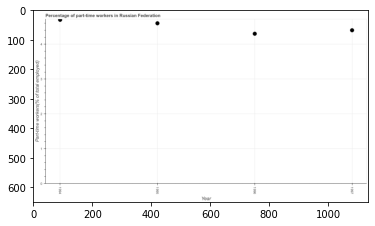

Number of QA =  24





,Year,Part-time workers(% of total employed)
0,1996,4.314092
1,1995,4.615607
2,1994,4.714622
3,1997,4.413714


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time workers in 1994 and 1997 ?
PREDICTED =  0.3009079409522517
EXPECTED =  0.29999971389770774




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time workers ?
PREDICTED =  1995.5
EXPECTED =  4.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of part-time workers in 1994 to that in 1996 ?
PREDICTED =  1.0928423488262164
EXPECTED =  1.0930231629738414




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wha

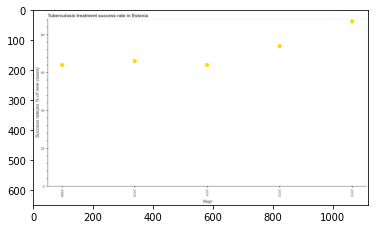

Number of QA =  24





,Year,Success rate(as % of new cases)
0,2012,74.562566
1,2009,64.484454
2,2010,66.512754
3,2013,87.615877
4,2011,64.532610


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in 2011 and 2012 ?
PREDICTED =  -10.029956026977814
EXPECTED =  -10




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median tuberculosis treatment success rate ?
PREDICTED =  2011.0
EXPECTED =  66.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the tuberculosis treatment success rate in 2010 to that in 2012 ?
PREDICTED =  0.8920394920722773
EXPECTED =  0.8918918918918919




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what 

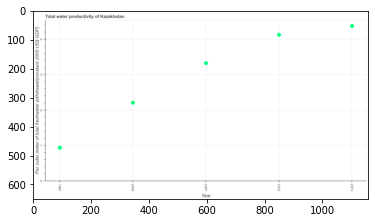

Number of QA =  24





,Year,Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDP)
0,2013,4.406300
1,1997,0.956850
2,2007,3.357215
3,2012,4.158934
4,2002,2.232753


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total water productivity in 2002 and 2007 ?
PREDICTED =  -1.124461773713977
EXPECTED =  -1.1170035421276707




				 1 / 1 = 1.0


> what is the median total water productivity ?
PREDICTED =  None
EXPECTED =  3.32354730307224




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total water productivity in 2007 to that in 2012 ?
PREDICTED =  0.8072295775157345
EXPECTED =  0.8058179041715267




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest total water productivity ?
PREDICTED =  0.0
EXPECTED =  0.24746637813831995






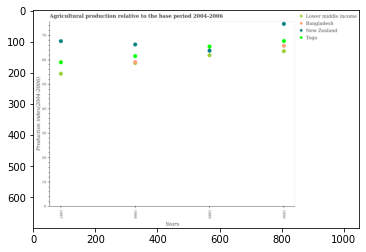

Number of QA =  29





,Years,Togo,New Zealand,Bangladesh,Lower middle income
0,1988,61.399672,66.073176,58.486562,58.952407
1,1990,67.457556,74.404451,65.495682,63.312033
2,1989,65.194789,63.559171,NaN,61.621332
3,1987,58.848781,67.403431,NaN,54.167968


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the agricultural production index in new zealand in 1989 and that in 1990 ?
PREDICTED =  -10.845280813790446
EXPECTED =  -10.969999999999992




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the agricultural production index in togo in 1990 and the agricultural production index in new zealand in 1987?
PREDICTED =  8.608774536009221
EXPECTED =  0.060000000000002274




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1989, what is the difference between the agricultural production index in new zealand and agricultural production index in bangladesh ?
PREDICTED =  5.0726081

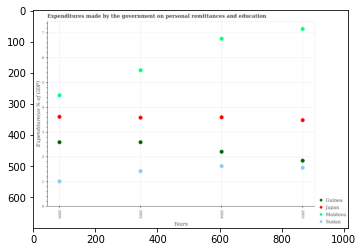

Number of QA =  29





,Years,Sudan,Moldova,Guinea,Japan
0,2002,1.435250,5.460819,2.587935,3.570438
1,2000,1.022679,4.460880,2.587581,3.599845
2,2004,1.633109,6.721879,2.213032,3.582166
3,2005,1.572482,7.111211,1.853090,3.470585


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in guinea in 2000 and that in 2004 ?
PREDICTED =  1.7869680494376197
EXPECTED =  0.3833999633789098




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in guinea in 2002 and the expenditures made by the government on personal remittances and education in sudan in 2005?
PREDICTED =  2.5647504852878997
EXPECTED =  1.0307998657226598




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between t

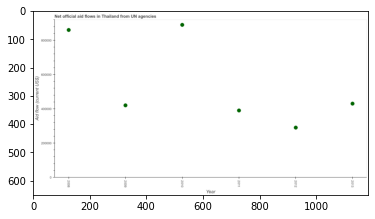

Number of QA =  24





,Year,Aid flow (current US$)
0,2013,433537.337494
1,2010,893810.858516
2,2009,423708.562792
3,2011,393156.036396
4,2008,863805.432848
5,2012,293385.601814


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official flows from un agencies in 2008 and 2009 ?
PREDICTED =  440096.87005640665
EXPECTED =  440000




				 1 / 1 = 1.0


> what is the median net official flows from un agencies ?
PREDICTED =  None
EXPECTED =  425000.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net official flows from un agencies in 2009 to that in 2011 ?
PREDICTED =  1.0777109431578298
EXPECTED =  1.0769230769230769




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest net official flows from un agencies ?
PREDICTED =  0.0
EXPECTED =  3

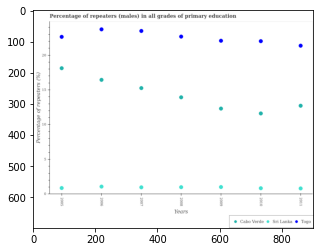

Number of QA =  28





,Years,Togo,Sri Lanka,Cabo Verde
0,2008,22.863994,1.056815,14.070941
1,2006,23.908690,1.140605,16.593476
2,2009,22.264019,1.072751,12.441581
3,2005,22.829803,0.938877,18.294494
4,2011,21.553482,0.891744,12.839004
5,2010,22.211747,0.897578,11.734993
6,2007,23.665889,1.035547,15.414690


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters (males) in sri lanka in 2008 and that in 2009 ?
PREDICTED =  -0.015935581543769617
EXPECTED =  -0.02078008651733798




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters (males) in sri lanka in 2011 and the percentage of repeaters (males) in togo in 2010?
PREDICTED =  -21.320003015881415
EXPECTED =  -21.21107989549638




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of repeaters (males) in sri lanka and percentage of repeaters (males) in cabo verde ?
PREDICTED =  0.

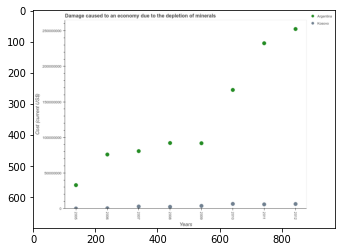

Number of QA =  27





,Years,Argentina,Kosovo
0,2005,3.374609e+08,9.090739e+06
1,2008,9.296721e+08,3.192529e+07
2,2006,7.698859e+08,1.274237e+07
3,2011,2.335439e+09,6.653970e+07
4,2009,9.270185e+08,4.569185e+07
5,2010,1.677371e+09,7.449252e+07
6,2012,2.535132e+09,7.279522e+07
7,2007,8.159208e+08,3.723355e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in kosovo in 2011 and that in 2012 ?
PREDICTED =  -6255518.985309459
EXPECTED =  -5204690.137025088




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in argentina in 2006 and the cost of damage caused due to the depletion of minerals in kosovo in 2009?
PREDICTED =  -157132602.8203689
EXPECTED =  722644545.3829951




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the cost of damage caused due to the depletion of miner

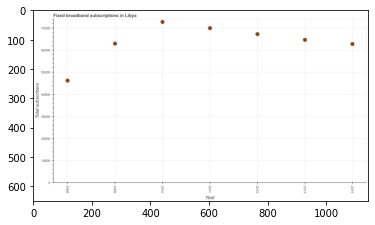

Number of QA =  24





,Year,Total subscribers
0,2008,46513.626285
1,2012,67623.115713
2,2014,63100.293888
3,2011,70296.788491
4,2013,64972.615702
5,2010,73108.222016
6,2009,63309.692238


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total number of fixed broadband subscriptions in 2011 and 2013 ?
PREDICTED =  5324.172788947122
EXPECTED =  5300




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total number of fixed broadband subscriptions ?
PREDICTED =  64972.615701713876
EXPECTED =  64700.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total number of fixed broadband subscriptions in 2008 to that in 2012 ?
PREDICTED =  0.6878361902496113
EXPECTED =  0.6871025260029717




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fin

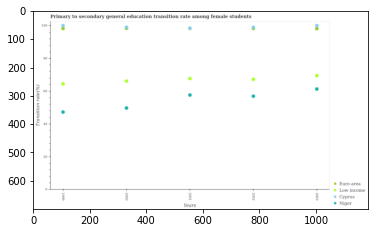

Number of QA =  29





,Years,Cyprus,Euro area,Niger,Low income
0,1999,100.110027,98.324149,47.412430,64.609929
1,2003,100.095252,98.334916,61.514254,69.633815
2,2000,99.210179,NaN,49.850595,66.319705
3,2002,99.120094,NaN,57.082041,67.434390
4,2001,98.523397,NaN,57.828068,67.892168


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate in niger in 1999 and that in 2000 ?
PREDICTED =  -2.4381650936194035
EXPECTED =  -2.4584884643555043




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate in cyprus in 2000 and the transition rate in niger in 2001?
PREDICTED =  0.6867819581420633
EXPECTED =  41.38210296630861




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the transition rate in low income and transition rate in euro area ?
PREDICTED =  67.63381483508724
EXPECTED =  -32.2501602172852




				 1 / 3 = 0.3333


is_built_with_cuda:

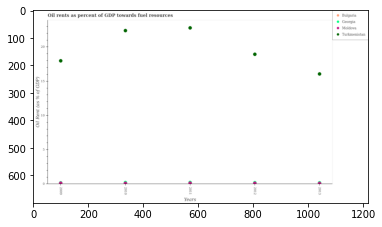

Number of QA =  29





,Years,Moldova,Georgia,Bulgaria,Turkmenistan
0,2011,0.265889,NaN,NaN,22.740961
1,2012,0.203497,NaN,NaN,18.892825
2,2010,0.261236,NaN,NaN,22.333669
3,2009,0.207896,NaN,NaN,17.954554
4,2013,0.205447,NaN,NaN,16.039946


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in moldova in 2009 and that in 2010 ?
PREDICTED =  -0.05334016555202867
EXPECTED =  0.02117275243878959




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in georgia in 2011 and the oil rent in moldova in 2009?
PREDICTED =  nan
EXPECTED =  0.10930662549381699




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the oil rent in turkmenistan and oil rent in georgia ?
PREDICTED =  2010.75
EXPECTED =  15.886807112053297




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pre

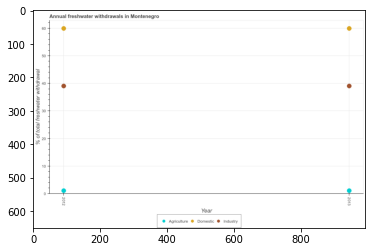

Number of QA =  24





,Year,Domestic,Agriculture,industry
0,2013,60.372093,1.328146,39.401231
1,2012,60.414355,1.304556,39.408550


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of freshwater withdrawal for agriculture in 2012 and that in 2013 ?
PREDICTED =  -0.0235899053915829
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of freshwater withdrawal for agriculture in 2013 and the percentage of freshwater withdrawal for domestic purposes in 2012?
PREDICTED =  0.0235899053915829
EXPECTED =  -58.852999999999994




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of freshwater withdrawal for agriculture and percentage of freshwater withdrawal for dom

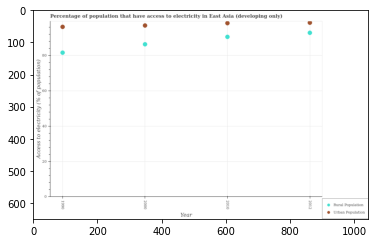

Number of QA =  27





,Year,Urban Population,Rural Population
0,2010,98.355206,90.626304
1,1990,96.265674,81.761629
2,2000,97.020389,86.413379
3,2012,98.616624,92.851169


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to electricity in 2000 and that in 2010 ?
PREDICTED =  -1.3348174879160553
EXPECTED =  -1.3380628557338952




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to electricity in 2012 and the percentage of rural population having access to electricity in 2000?
PREDICTED =  1.596235303603578
EXPECTED =  12.215363461057692




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of rural population having access to electricity and per

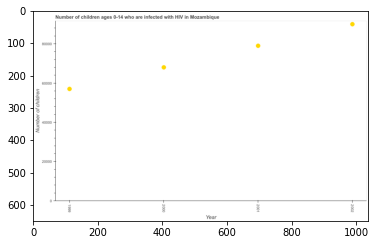

Number of QA =  24





,Year,Number of children
0,2000,68028.594758
1,1999,57056.161258
2,2001,78945.746401
3,2002,89885.287693


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of children living with hiv in 2000 and 2001 ?
PREDICTED =  -10917.151642932484
EXPECTED =  -11000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of children living with hiv ?
PREDICTED =  73487.17057953554
EXPECTED =  73500.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of children living with hiv in 2000 to that in 2001 ?
PREDICTED =  0.8617132380067795
EXPECTED =  0.8607594936708861




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.



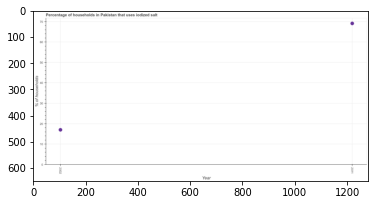

Number of QA =  20





,Year,% of households
0,2011,69.797453
1,2002,17.349737


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of households where iodized salt is consumed in 2002 and 2011 ?
PREDICTED =  -52.447716184887994
EXPECTED =  -52.099999999999994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of households where iodized salt is consumed ?
PREDICTED =  43.57359494997221
EXPECTED =  43.05




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of households where iodized salt is consumed in 2002 to that in 2011 ?
PREDICTED =  0.2485726355513962
EXPECTED =  0.24602026049204054




				 3 / 3 = 1.0


> what is the difference between two consecutive major

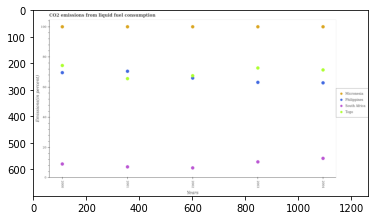

Number of QA =  29





,Years,Unnamed: 1,Philippines,South Africa,Micronesia
0,2003,73.393016,63.808914,10.835341,100.920858
1,2004,72.106066,63.463283,13.149181,100.905725
2,2002,68.248794,66.630960,6.792754,100.900636
3,2001,66.300683,71.245558,7.489841,100.894296
4,2000,75.064265,70.249439,9.379417,100.866059


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in south africa in 2000 and that in 2002 ?
PREDICTED =  2.5866624247012977
EXPECTED =  2.57983405272012




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in micronesia in 2000 and the total co2 emitted in south africa in 2001?
PREDICTED =  -0.028237145174443867
EXPECTED =  92.85793714175959




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the total co2 emitted in south africa and total co2 emitted in togo ?
PREDICTED =  -42.64653374044799
EXPECTED =  -58.47307909759559




				 1 / 3 = 0.

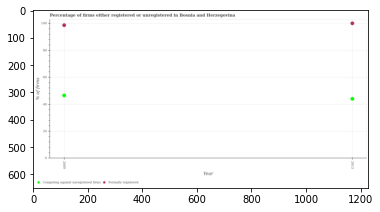

Number of QA =  23





,Year,Formally registered,Competing against unregistered firms
0,2009,98.538479,46.695603
1,2013,99.924925,44.196791


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of formally registered firms in 2009 and that in 2013 ?
PREDICTED =  -1.3864464081855203
EXPECTED =  -1.4000000000000057




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of registered firms in 2013 and the percentage of formally registered firms in 2009?
PREDICTED =  1.3864464081855203
EXPECTED =  -54.599999999999994




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of registered firms and percentage of formally registered firms ?
PREDICTED =  0.0
EXPECTED =  -56.0




				 1 / 3 = 0.333

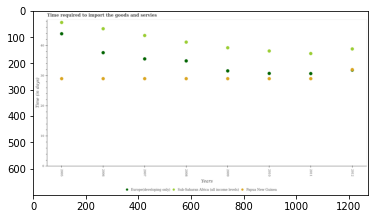

Number of QA =  28





,Years,Europe(developing only),Papua New Guinea,Sub-Saharan Africa (all income levels)
0,2005,44.094811,29.218529,47.833657
1,2011,30.876023,29.191937,37.527062
2,2008,35.064784,29.190814,41.318455
3,2010,30.927111,29.177206,38.343106
4,2006,37.779208,29.179491,45.737571
5,2007,35.750734,29.188707,43.492432
6,2009,31.783049,29.169887,39.428788
7,2012,NaN,32.086038,39.036028


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to import the goods and services in europe(developing only) in 2011 and that in 2012 ?
PREDICTED =  -22.876022888378678
EXPECTED =  -1.157894736842092




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to import the goods and services in papua new guinea in 2008 and the number of days required to import the goods and services in sub-saharan africa (all income levels) in 2010?
PREDICTED =  -22.927111047427054
EXPECTED =  -9.1739130434783




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference 

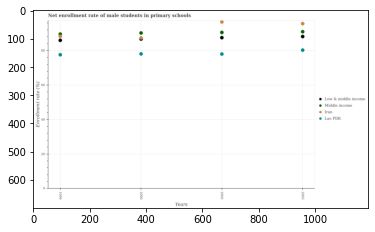

Number of QA =  29





,Years,Low & middle income,Lao PDR,Middle income,Iran
0,1999,86.221282,77.784336,89.768729,88.509802
1,2003,88.330290,80.511091,91.113178,95.811136
2,2002,87.690744,78.204538,90.709516,96.787473
3,2000,NaN,78.261391,90.404799,87.027894


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrollment rate of male students in primary schools in middle income in 2000 and that in 2002 ?
PREDICTED =  -0.30471633360900796
EXPECTED =  -0.30856323242178973




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrollment rate of male students in primary schools in middle income in 1999 and the net enrollment rate of male students in primary schools in iran in 2000?
PREDICTED =  -0.6360703536305294
EXPECTED =  2.219787597656193




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the net enrollment rate of male studen

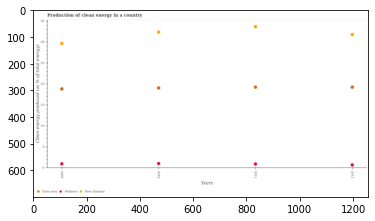

Number of QA =  28





,Years,Euro area,Moldova,New Zealand
0,2009,19.003514,1.060867,29.892403
1,2011,19.448997,1.012249,33.928077
2,2012,19.464140,0.818912,32.036718
3,2010,19.246417,1.119645,32.635370


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of clean energy produced in euro area in 2009 and that in 2012 ?
PREDICTED =  -0.46062554774264086
EXPECTED =  -0.424040093942498




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of clean energy produced in new zealand in 2010 and the percentage of clean energy produced in euro area in 2012?
PREDICTED =  0.5986513196139995
EXPECTED =  13.107428864060598




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of clean energy produced in moldova and percentage of clean energy produced in euro ar

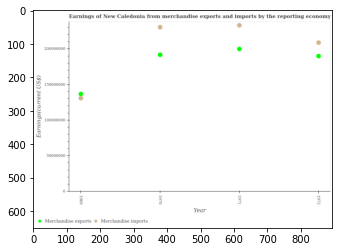

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,1972,2.081195e+08,1.894845e+08
1,1970,2.296062e+08,1.911213e+08
2,1969,1.307601e+08,1.365478e+08
3,1971,2.321068e+08,1.993313e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 1971 and that in 1972 ?
PREDICTED =  23987334.529880106
EXPECTED =  24268000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 1972 and the earnings from merchandise exports in 1971?
PREDICTED =  -23987334.529880106
EXPECTED =  8915000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1970, what is the difference between the earnings from merchandise imports and earnings from merchandise exports ?
PREDICTED =  32775471.781431943
EXPECTED =  38701000.0




				 1 / 3 = 0.3333


is_buil

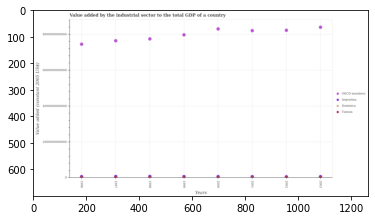

Number of QA =  29





,Years,Argentina,Tunisia,OECD members,Dominica
0,2003,NaN,7.349709e+10,8.410054e+12,NaN
1,1996,NaN,7.044362e+10,7.460286e+12,NaN
2,2002,NaN,6.722565e+10,8.236492e+12,NaN
3,1998,NaN,7.786242e+10,7.762132e+12,NaN
4,1999,NaN,7.676657e+10,7.982184e+12,NaN
5,2000,NaN,7.479720e+10,8.311340e+12,NaN
6,1997,NaN,7.718774e+10,7.653871e+12,NaN
7,2001,NaN,7.389024e+10,8.215026e+12,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in tunisia in 2001 and that in 2003 ?
PREDICTED =  393150982.2631531
EXPECTED =  -78605350.56038094




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in dominica in 2000 and the value added by the industrial sector in tunisia in 2001?
PREDICTED =  906958645.2898254
EXPECTED =  -7870360404.62




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the value added by the industrial sector in tunisia and value added by the industrial sector in oecd members ?
PR

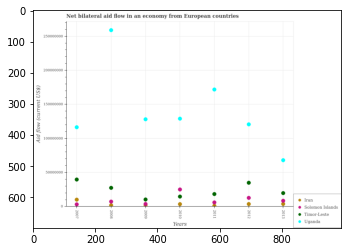

Number of QA =  29





,Years,Uganda,Solomon Islands,Timor-Leste,Iran
0,2012,1.214069e+08,1.333192e+07,3.564928e+07,4.208155e+06
1,2009,1.288786e+08,1.669837e+06,1.088868e+07,3.848843e+06
2,2008,2.600986e+08,7.690176e+06,2.796172e+07,2.238509e+06
3,2007,1.170566e+08,3.586106e+06,4.022744e+07,1.078640e+07
4,2011,1.727092e+08,6.520949e+06,1.895141e+07,1.086049e+06
5,2010,1.298388e+08,2.567137e+07,1.522525e+07,4.328630e+06
6,2013,6.878031e+07,8.912082e+06,2.041306e+07,4.500483e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in uganda in 2007 and that in 2011 ?
PREDICTED =  -55652518.41321415
EXPECTED =  -55410000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in solomon islands in 2011 and the net bilateral aid flow in iran in 2008?
PREDICTED =  -1169227.255944525
EXPECTED =  4200000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the net bilateral aid flow in uganda and net bilateral aid flow in solomon islands ?
PREDICTED =  998768952.5195444
EXPECTED =  107940000.0




				 1 / 3 = 0.333

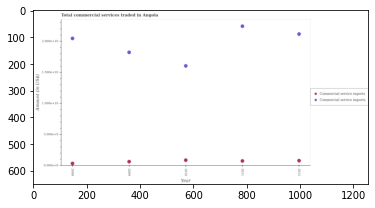

Number of QA =  27





,Year,Commercial service imports,Commercial service exports
0,2010,1.612851,0.094338
1,2012,2.125999,0.085428
2,2008,2.056007,0.041034
3,2011,2.251903,0.081617
4,2009,1.832089,0.069178


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of commercial service exports in 2010 and that in 2011 ?
PREDICTED =  0.01272164109486111
EXPECTED =  124617998.12634897




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of commercial service imports in 2009 and the amount of commercial service exports in 2008?
PREDICTED =  -0.22391814406550226
EXPECTED =  17880931367.64




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the amount of commercial service imports and amount of commercial service exports ?
PREDICTED =  6.878849554125729
EXPECTED =  21682779956.751

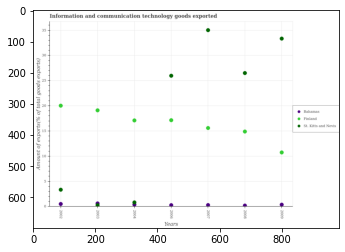

Number of QA =  28





,Years,Bahamas,St. Kitts and Nevis,Finland
0,2008,0.284649,26.843852,15.128850
1,2004,0.945551,0.448160,17.355668
2,2006,0.361174,26.326435,17.400175
3,2002,0.623766,3.489677,20.318410
4,2009,0.468455,33.764416,10.936908
5,2007,0.383858,35.455301,15.830109
6,2003,0.681961,0.358995,19.382042


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in bahamas in 2002 and that in 2003 ?
PREDICTED =  -0.0581949419594745
EXPECTED =  -0.11091630489999998




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in st. kitts and nevis in 2002 and the amount of goods exported in finland in 2008?
PREDICTED =  99.8429848557188
EXPECTED =  -11.5514741629




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the amount of goods exported in bahamas and amount of goods exported in st. kitts and nevis ?
PREDICTED =  -122.93742326940945
EXPECTED

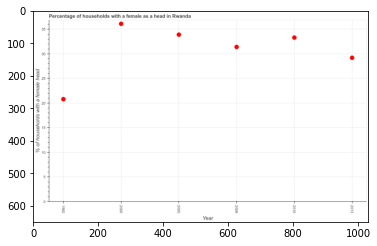

Number of QA =  24





,Year,% of households with a female head
0,2008,31.302385
1,2013,29.107365
2,2005,33.775872
3,2000,35.969744
4,2010,33.171864
5,1992,20.764639


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of female supervised households in 2008 and 2013 ?
PREDICTED =  2.1950202413268975
EXPECTED =  2.1999999999999993




				 1 / 1 = 1.0


> what is the median number of female supervised households ?
PREDICTED =  None
EXPECTED =  32.349999999999994




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of female supervised households in 2008 to that in 2013 ?
PREDICTED =  1.0754111637109385
EXPECTED =  1.0753424657534247




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest number of female supervised household

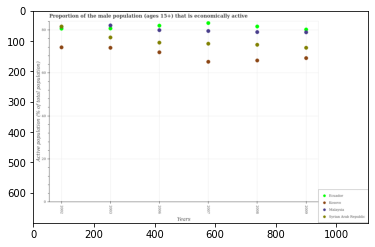

Number of QA =  29





,Years,Syrian Arab Republic,Ecuador,Malaysia,Kosovo
0,2002,81.098879,82.004858,NaN,72.352046
1,2009,72.143269,80.688133,79.342516,67.336060
2,2003,76.930499,81.152505,82.611987,72.106609
3,2006,74.543301,82.486801,80.343480,70.001581
4,2008,73.534040,82.082814,79.479281,66.232510
5,2007,74.071315,83.714076,79.982948,65.633678


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male population that is economically active in kosovo in 2003 and that in 2006 ?
PREDICTED =  2.105028277514208
EXPECTED =  2.0999984741212074




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male population that is economically active in kosovo in 2006 and the proportion of the male population that is economically active in malaysia in 2009?
PREDICTED =  2.6655210565525636
EXPECTED =  -9.300003051757912




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the proportion of the male populati

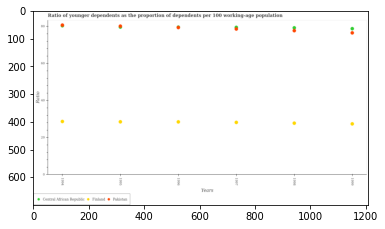

Number of QA =  28





,Years,Finland,Central African Republic,Pakistan
0,1998,27.979328,79.465851,77.860071
1,1999,27.646217,78.974347,76.757905
2,1994,28.851169,NaN,80.755521
3,1995,28.691607,NaN,80.211964
4,1996,28.687718,NaN,79.619328
5,1997,28.382599,79.696899,78.718862


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio(young) in central african republic in 1998 ?
PREDICTED =  13.24430858225814
EXPECTED =  79.23374410273371




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio(young) in finland ?
PREDICTED =  332.3333333333333
EXPECTED =  28.679653392936




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio(young) in central african republic ?
PREDICTED =  332.8333333333333
EXPECTED =  78.7839139140669




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluati

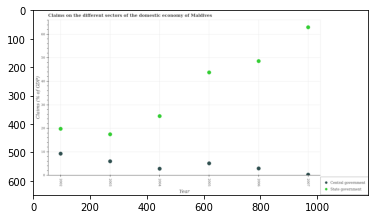

Number of QA =  27





,Year,State government,Central government
0,2002,20.140981,9.488956
1,2006,49.173646,3.128098
2,2003,17.773769,6.169223
3,2004,25.580380,3.025432
4,2007,63.678753,0.480297
5,2005,44.312007,5.300957


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the claims on state government in 2003 and that in 2004 ?
PREDICTED =  -7.806610134122025
EXPECTED =  -7.735764169563797




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the claims on central government in 2007 and the claims on state government in 2004?
PREDICTED =  -2.5451352785832704
EXPECTED =  -24.88623084617976




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the claims on central government and claims on state government ?
PREDICTED =  0.0
EXPECTED =  -11.476143935409041




				 1 / 3 = 0.3333


is_built_with_cuda: True
is

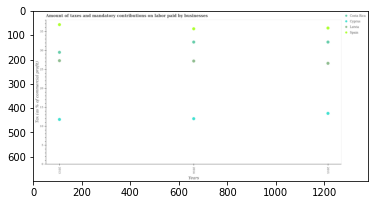

Number of QA =  29





,Years,Latvia,Spain,Cyprus,Costa Rica
0,2015,26.676043,35.951282,13.479841,32.270166
1,2014,27.270924,35.761398,12.082387,32.266511
2,2013,27.394253,36.837567,11.862652,29.553929


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of taxes paid by businesses in spain in 2013 and that in 2015 ?
PREDICTED =  0.8862848268508614
EXPECTED =  0.8999999999999986




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of taxes paid by businesses in spain in 2013 and the percentage of taxes paid by businesses in latvia in 2014?
PREDICTED =  1.076169272097772
EXPECTED =  9.599999999999998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2015, what is the difference between the percentage of taxes paid by businesses in spain and percentage of taxes paid by businesses in costa rica 

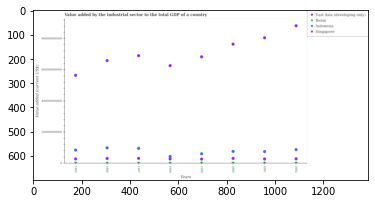

Number of QA =  29





,Years,East Asia (developing only),Benin,Indonesia,Singapore
0,1996,6.628770e+11,3.947960e+09,1.014335e+11,3.342086e+10
1,2002,8.874067e+11,4.540750e+09,9.032257e+10,3.123753e+10
2,1998,6.306131e+11,3.080763e+09,4.539157e+10,3.088996e+10
3,1997,6.942252e+11,3.118302e+09,9.869442e+10,3.418617e+10
4,1995,5.678703e+11,3.300317e+09,8.707748e+10,3.025615e+10
5,1999,6.874218e+11,4.633236e+09,6.388540e+10,2.928006e+10
6,2001,8.098993e+11,3.988074e+09,7.763148e+10,2.997411e+10
7,2000,7.694563e+11,3.309809e+09,7.889237e+10,3.430065e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in east asia (developing only) in 1996 and that in 1999 ?
PREDICTED =  -24544748344.687134
EXPECTED =  -23905667379.531006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in benin in 1998 and the value added by the industrial sector to the total gdp in singapore in 2001?
PREDICTED =  -907310528.6620898
EXPECTED =  -26790158729.349323




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the value added by the industrial 

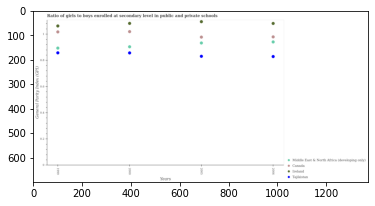

Number of QA =  29





,Years,Middle East & North Africa (developing only),Tajikistan,Ireland,Canada
0,1999,0.896418,0.859669,1.065855,1.020257
1,2005,0.935892,0.833662,1.098449,0.980979
2,2000,0.907653,0.860234,1.085043,1.022266
3,2006,0.943791,0.832506,1.085345,0.982487


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in middle east & north africa (developing only) in 2005 and that in 2006 ?
PREDICTED =  -0.007899929435305597
EXPECTED =  -0.008049964904785156




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in ireland in 2005 and the general parity index in tajikistan in 2000?
PREDICTED =  0.013405854382382065
EXPECTED =  0.23847997188568104




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the general parity index in middle east & north africa (developing only) and general parity index in tajiki

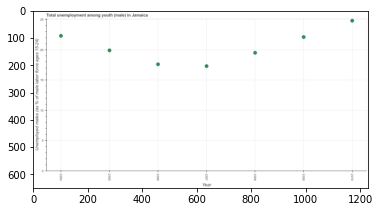

Number of QA =  24





,Year,Unemployed males (as % of male labor force ages 15-24)
0,2009,22.079857
1,2007,17.310938
2,2010,24.790278
3,2004,22.278406
4,2008,19.500066
5,2006,17.610556
6,2005,19.915958


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed male youth population in 2006 and 2009 ?
PREDICTED =  -4.469301777329601
EXPECTED =  -4.499999999999989




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed male youth population ?
PREDICTED =  2007.0
EXPECTED =  19.8999996185303




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed male youth population in 2005 to that in 2006 ?
PREDICTED =  1.1309102842376475
EXPECTED =  1.1306817720005375




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training ste

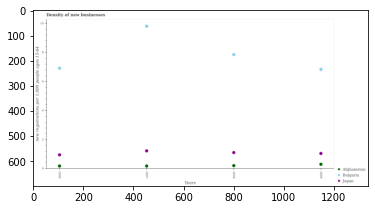

Number of QA =  28





,Years,Afghanistan,Bulgaria,Japan
0,2007,0.211562,9.895138,1.261552
1,2008,0.239160,7.929693,1.142612
2,2006,0.213998,6.976756,0.980108
3,2009,0.328719,6.896096,1.081021


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

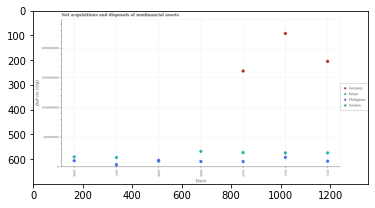

Number of QA =  28





,Years,Kenya,Philippines,Sweden,Germany
0,2011,2.409014e+08,1.680707e+08,NaN,2.262882e+09
1,2009,2.701713e+08,9.892370e+07,NaN,NaN
2,2008,NaN,1.066885e+08,NaN,NaN
3,2010,2.489175e+08,9.748950e+07,NaN,1.628142e+09
4,2006,1.762717e+08,1.110845e+08,NaN,NaN
5,2012,2.439060e+08,1.037524e+08,NaN,1.791351e+09
6,2007,1.650942e+08,4.482124e+07,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in philippines in 2006 and that in 2008 ?
PREDICTED =  4396001.897139519
EXPECTED =  -6958700.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in germany in 2006 and the balance of payments in kenya in 2008?
PREDICTED =  0.0
EXPECTED =  -94476758.72




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the balance of payments in philippines and balance of payments in kenya ?
PREDICTED =  -102100610.60570255
EXPECTED =  -170969718.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_

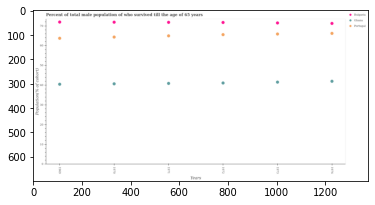

Number of QA =  28





,Years,Ghana,Bulgaria,Portugal
0,1974,42.597662,72.196994,67.102067
1,1973,42.142632,72.387364,66.766014
2,1970,41.302212,72.779734,65.231401
3,1972,41.726939,72.675279,66.488084
4,1971,41.493656,72.781343,65.832415
5,1969,41.052612,72.873053,64.608910


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total male population who survived till the age of 65 years in ghana in 1971 and that in 1972 ?
PREDICTED =  -0.23328317839082047
EXPECTED =  -0.20943999999999363




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total male population who survived till the age of 65 years in portugal in 1969 and the percentage of total male population who survived till the age of 65 years in ghana in 1973?
PREDICTED =  -2.157103225718174
EXPECTED =  22.211889999999997




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1974, what is the difference betw

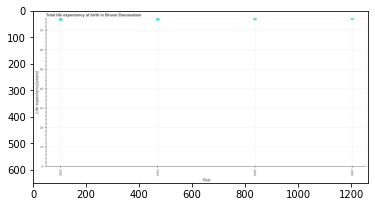

Number of QA =  24





,Year,Life expectancy(years)
0,2004,76.410578
1,2005,76.552527
2,2003,76.206241
3,2002,76.053014


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in 2002 and 2004 ?
PREDICTED =  -0.357564594903252
EXPECTED =  -0.35643902439019826




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median life expectancy at birth ?
PREDICTED =  76.30840969933053
EXPECTED =  75.9351463414634




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the life expectancy at birth in 2002 to that in 2003 ?
PREDICTED =  0.99798930271682
EXPECTED =  0.9976467130356605




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what

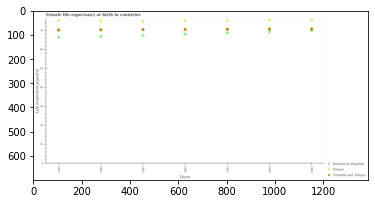

Number of QA =  28





,Years,Trinidad and Tobago,Dominican Republic,Poland
0,1983,70.531979,66.592547,75.487998
1,1989,71.067636,70.370786,75.828692
2,1988,70.955601,69.566257,75.974584
3,1984,70.622484,67.196224,75.226185
4,1986,70.829526,68.332085,75.407958
5,1985,70.761049,67.705870,75.060918
6,1987,70.884756,68.921016,75.511832


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female life expectancy at birth in dominican republic in 1986 and that in 1988 ?
PREDICTED =  -1.2341718302708387
EXPECTED =  -1.2489999999999952




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female life expectancy at birth in dominican republic in 1986 and the female life expectancy at birth in poland in 1987?
PREDICTED =  -0.5889312225375534
EXPECTED =  -7.126999999999995




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1988, what is the difference between the female life expectancy at birth in dominican republic and female life expectancy at birth in tr

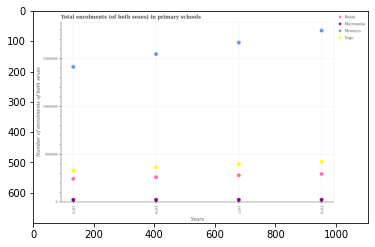

Number of QA =  29





,Years,Unnamed: 1,Morocco,Micronesia,Benin
0,1975,333445.270205,1.416519e+06,27473.632737,248257.867804
1,1977,399735.386254,1.669926e+06,28630.388824,284191.727302
2,1976,366861.274019,1.550541e+06,27607.030343,265026.004811
3,1978,425812.398178,1.796086e+06,28449.307848,298368.939169


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in primary schools in micronesia in 1975 and that in 1977 ?
PREDICTED =  -1156.7560868208056
EXPECTED =  -563.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in primary schools in benin in 1976 and the number of enrolments in primary schools in morocco in 1977?
PREDICTED =  -19165.722490894317
EXPECTED =  -1407893.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1978, what is the difference between the number of enrolments in primary schools in morocco and number of enrolments in primary schools in micronesia ?
P

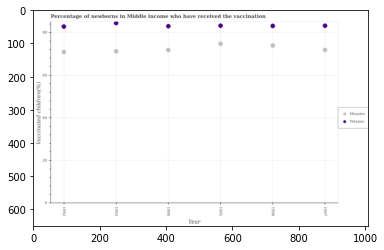

Number of QA =  27





,Year,Tetanus,Measles
0,1996,82.797701,73.687507
1,1997,82.909883,71.583668
2,1993,84.182907,70.947291
3,1994,82.657179,71.570865
4,1992,82.490166,70.710731
5,1995,82.941876,74.475651


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of newborns who received vaccination for tetanus in 1993 and that in 1995 ?
PREDICTED =  1.241031108932944
EXPECTED =  1.2579415697079952




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of newborns who received vaccination for tetanus in 1993 and the percentage of newborns who received vaccination for measles in 1995?
PREDICTED =  1.241031108932944
EXPECTED =  9.731246709496205




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of newborns who received vaccination for measles and percent

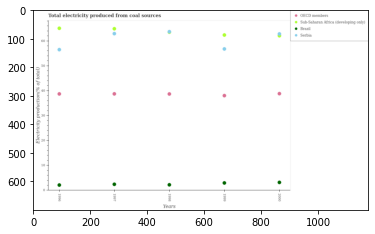

Number of QA =  29





,Years,Serbia,Brazil,OECD members,Sub-Saharan Africa (developing only)
0,1998,63.934901,2.430300,38.946612,NaN
1,1996,56.790747,2.321543,38.954669,65.369625
2,1999,57.071629,3.116578,38.317743,62.709782
3,2000,63.036868,3.344266,39.104242,62.374132
4,1997,63.226219,2.593615,38.991967,65.192822


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in brazil in 1999 and that in 2000 ?
PREDICTED =  -0.22768779053481314
EXPECTED =  -0.21697951612826039




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in oecd members in 1998 and the total electricity produced in brazil in 1999?
PREDICTED =  0.6288689540663341
EXPECTED =  35.72751621230158




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the total electricity produced in serbia and total electricity produced in sub-saharan africa (developing only) ?
PREDICTED =  300.0

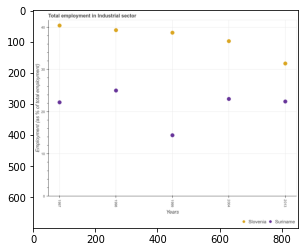

Number of QA =  27





,Years,Slovenia,Suriname
0,2004,36.973029,23.226447
1,1998,39.590401,25.245588
2,2013,31.662828,22.650389
3,1997,40.686664,22.409021
4,1999,38.988177,14.595046


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in industrial sector in suriname in 1997 and that in 1998 ?
PREDICTED =  -2.8365669482728215
EXPECTED =  -2.7999992370605007




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in industrial sector in slovenia in 1998 and the employment in industrial sector in suriname in 2013?
PREDICTED =  7.927573054151502
EXPECTED =  16.899999618530188




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the employment in industrial sector in slovenia and employment in industrial sector in suriname ?
PREDICTED =  37.58021

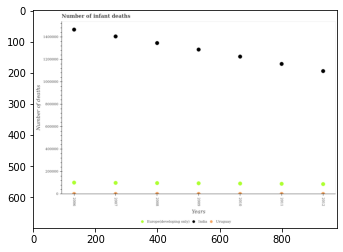

Number of QA =  28





,Years,Uruguay,India,Europe(developing only)
0,2009,4889.175721,1.294192e+06,100060.316068
1,2011,5814.354418,1.165191e+06,95460.131418
2,2012,5591.544508,1.100853e+06,92759.515796
3,2006,5292.965653,1.471619e+06,105723.641682
4,2008,5986.001200,1.351961e+06,102301.990791
5,2010,6306.894985,1.231362e+06,97662.351987
6,2007,5361.352853,1.410002e+06,103484.342693


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths in uruguay in 2008 and that in 2011 ?
PREDICTED =  171.6467813842164
EXPECTED =  57




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths in india in 2011 and the number of infant deaths in europe(developing only) in 2007?
PREDICTED =  -244810.57498596027
EXPECTED =  1060514.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the number of infant deaths in india and number of infant deaths in europe(developing only) ?
PREDICTED =  9025172.709958939
EXPECTED =  1248449.0




				 0 

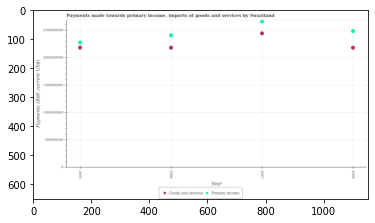

Number of QA =  27





,Year,Primary income,Goods and services
0,2006,2.421994e+09,2.194807e+09
1,2008,2.499319e+09,2.194980e+09
2,2005,2.290899e+09,2.197079e+09
3,2007,2.675155e+09,2.456461e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the payments made towards primary income in 2007 and the payments made towards goods and services in 2005?
PREDICTED =  384256988.2722211
EXPECTED =  476176281.8000002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the payments made towards goods and services in 2005 to that in 2007?
PREDICTED =  0.8944082397942842
EXPECTED =  0.8938944562069228




				 1 / 4 = 0.25


is_built_with_cuda: Tr

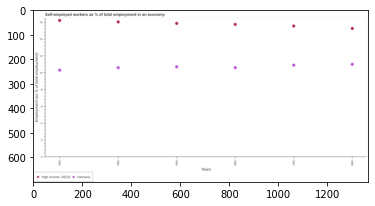

Number of QA =  27





,Years,High income: OECD,Germany
0,1996,15.716430,10.610974
1,1995,15.846680,10.703824
2,1998,15.235341,10.996523
3,1997,15.527235,10.902133
4,1993,16.181187,10.293744
5,1994,16.005562,10.601319


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in germany in 1996 and that in 1998 ?
PREDICTED =  -0.38554960532577986
EXPECTED =  -0.3999996185303001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in germany in 1998 and the percentage of self-employed workers in high income: oecd in 1995?
PREDICTED =  0.29269959084426667
EXPECTED =  -4.867681588283




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percentage of self-employed workers in high income: oecd and percentage of self-employed workers

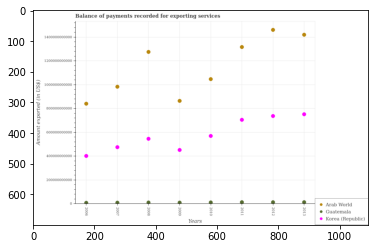

Number of QA =  28





,Years,Arab World,Korea (Republic),Guatemala
0,2007,9.946591e+11,4.834776e+11,1.418083e+10
1,2011,1.330666e+12,7.149549e+11,1.697555e+10
2,2013,1.435426e+12,7.619456e+11,1.742565e+10
3,2008,1.289206e+12,5.546142e+11,1.516222e+10
4,2012,1.476072e+12,7.470537e+11,1.731243e+10
5,2006,8.512658e+11,4.092107e+11,1.235109e+10
6,2009,8.750292e+11,4.597403e+11,1.519854e+10
7,2010,1.059095e+12,5.783325e+11,1.557649e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in guatemala in 2007 and that in 2008 ?
PREDICTED =  -981389583.3895969
EXPECTED =  -1277995367.6000004




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in arab world in 2012 and the amount exported in korea (republic) in 2008?
PREDICTED =  186866164214.57227
EXPECTED =  914875429334.1399




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount exported in guatemala and amount exported in arab world ?
PREDICTED =  -1460804925976.3142
EXPECTED =  -1265118288380.8699




				 0 / 3 = 0.0




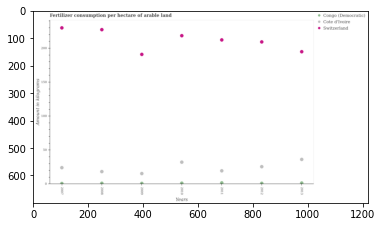

Number of QA =  28





,Years,Switzerland,Cote d'Ivoire,Congo (Democratic)
0,2009,191.631436,15.923955,1.336028
1,2013,195.544819,36.815517,1.855817
2,2011,213.003793,19.946738,2.003173
3,2010,219.209370,32.777486,1.560200
4,2008,228.031789,18.832911,1.585173
5,2012,210.036936,26.038334,1.240950
6,2007,230.672504,24.666392,1.190409


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in cote d'ivoire in 2008 and that in 2013 ?
PREDICTED =  -17.98260623391475
EXPECTED =  -17.9227586206897




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in congo (democratic) in 2008 and the amount of fertilizer consumption in cote d'ivoire in 2012?
PREDICTED =  -24.45316115605207
EXPECTED =  -24.508669220945105




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the amount of fertilizer consumption in cote d'ivoire and amount of fertilizer consumption in swi

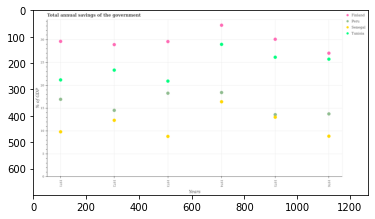

Number of QA =  29





,Years,Peru,Tunisia,Finland,Senegal
0,1975,13.761336,26.409781,30.365574,13.201553
1,1976,13.928054,25.976360,27.313736,9.016617
2,1972,14.711133,23.575746,29.182755,12.521360
3,1974,18.639240,29.237234,33.472624,16.601913
4,1973,18.485940,21.147931,29.871841,8.973868
5,1971,17.149799,21.414202,29.897362,10.014644


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual savings of the government in senegal in 1971 and that in 1973 ?
PREDICTED =  1.040776239452029
EXPECTED =  1.0083975806892607




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual savings of the government in tunisia in 1973 and the total annual savings of the government in finland in 1972?
PREDICTED =  -2.4278152588769437
EXPECTED =  -7.986287884062598




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1971, what is the difference between the total annual savings of the government in finland and total annual savings of the government in tu

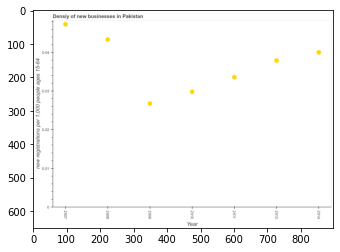

Number of QA =  24





,Year,"new registrations per 1,000 people ages 15-64"
0,2008,0.043659
1,2010,0.030097
2,2014,0.040324
3,2011,0.033867
4,2009,0.027048
5,2012,0.038211
6,2007,0.047622


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the density of new business in 2008 and 2010 ?
PREDICTED =  0.013561361536010778
EXPECTED =  0.013505297315786296




				 1 / 1 = 1.0


> what is the median density of new business ?
PREDICTED =  None
EXPECTED =  0.0378855814840984




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the density of new business in 2007 to that in 2014 ?
PREDICTED =  1.181010282172416
EXPECTED =  1.181453313895325




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest density of new business ?
PREDICTED =  0.0
EXPECTED =  0.003945731494863304






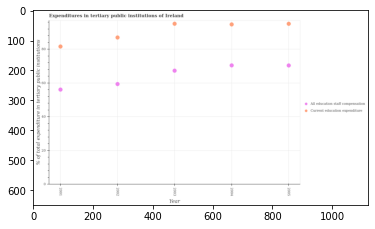

Number of QA =  27





,Year,All education staff compensatior,Current education expenditure
0,2005,70.401760,94.936135
1,2004,70.420026,94.590624
2,2002,59.434974,86.898479
3,2003,67.303889,94.971468
4,2001,56.200515,81.514848


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in 2004 and that in 2005 ?
PREDICTED =  -0.3455109518360331
EXPECTED =  -0.3799209594727131




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in 2003 and the expenditure in staff compensation in 2002?
PREDICTED =  8.072988475462992
EXPECTED =  35.71539306640618




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the expenditure in education and expenditure in staff compensation ?
PREDICTED =  -0.017666113741569234
EXPECTED =  24.257362365722585




				 0 / 3 = 0.0


is_built_w

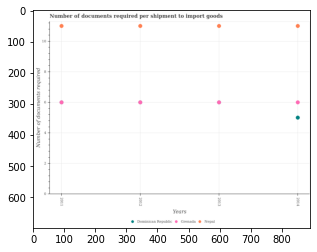

Number of QA =  28





,Years,Nepal,Grenada,Dominican Republic
0,2014,11.047143,6.044568,5.043078
1,2012,11.053276,6.045229,NaN
2,2011,11.053254,6.047941,NaN
3,2013,11.050540,6.046481,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of documents required per shipment to import goods in nepal in 2011 and that in 2013 ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of documents required per shipment to import goods in nepal in 2014 and the number of documents required per shipment to import goods in grenada in 2012?
PREDICTED =  -3.0
EXPECTED =  5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the number of documents required per shipment to import goods in grenada and number of documents required per sh

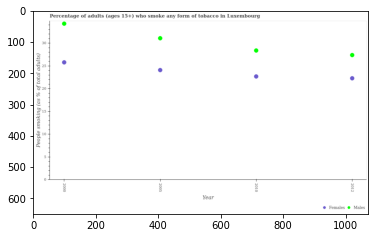

Number of QA =  27





,Year,Males,Females
0,2000,34.137591,25.713204
1,2010,28.305490,22.622414
2,2005,30.969780,24.026812
3,2012,27.298252,22.234429


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of males who smoke in 2000 and that in 2010 ?
PREDICTED =  5.832101148895138
EXPECTED =  5.899999999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of males who smoke in 2010 and the percentage of females who smoke in 2000?
PREDICTED =  -5.832101148895138
EXPECTED =  2.599999999999998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of males who smoke and percentage of females who smoke ?
PREDICTED =  5.063823185005905
EXPECTED =  5.699999999999999




				 1 / 3 = 0.3333


is_b

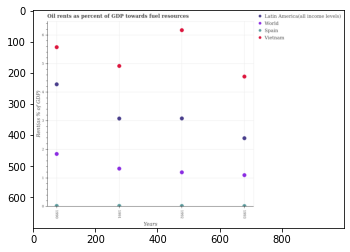

Number of QA =  29





,Years,Vietnam,Spain,World,Latin America(all income levels)
0,1992,6.168391,0.036111,1.207711,3.088285
1,1993,4.550833,0.031469,1.110513,2.400439
2,1990,5.573706,0.031259,1.845845,4.279503
3,1991,4.921995,0.037492,1.336548,3.087084


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in latin america(all income levels) in 1990 and that in 1992 ?
PREDICTED =  1.1912176701461847
EXPECTED =  1.1935079089619887




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in latin america(all income levels) in 1991 and the oil rent in vietnam in 1992?
PREDICTED =  -0.0012016502165401732
EXPECTED =  -3.0917983100188406




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the oil rent in world and oil rent in spain ?
PREDICTED =  1992.863668346199
EXPECTED =  1.3047873130348355




				 1 / 3 = 0.3333


is_

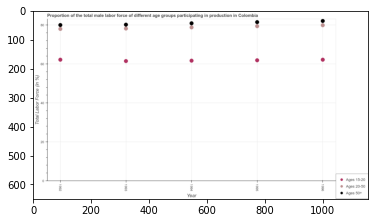

Number of QA =  28





,Year,Ages 20-50,Ages 15-20,Ages 50+
0,1993,78.536957,61.815958,80.527059
1,1995,79.730213,62.210996,81.779594
2,1994,79.164559,62.041036,81.199954
3,1992,78.345484,62.555470,80.393473
4,1996,80.280874,62.552224,82.452263


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force within the age group 15-20 in 1992 and that in 1993 ?
PREDICTED =  0.73951126412571
EXPECTED =  0.7000007629395029




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force above age 50 in 1994 and the percentage of male labor force within the age group 20-50 in 1996?
PREDICTED =  -0.27533052343206066
EXPECTED =  1.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the percentage of male labor force above age 50 and percentage of male labor force within the age group 20-

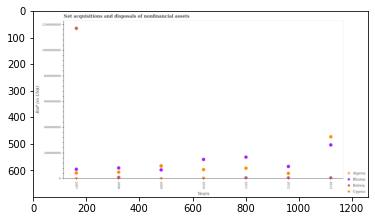

Number of QA =  28





,Years,Algeria,Bhutan,Bolivia,Cyprus
0,2010,6.529598e+06,1.533226e+08,NaN,7.377269e+07
1,2011,NaN,1.712859e+08,9.130276e+06,8.456009e+07
2,2009,4.042193e+06,7.101456e+07,NaN,1.032093e+08
3,2013,NaN,2.673296e+08,8.638032e+06,3.308398e+08
4,2012,NaN,9.857949e+07,8.248763e+06,4.538600e+07
5,2007,4.204791e+06,7.646769e+07,1.181153e+09,4.672517e+07
6,2008,NaN,8.690981e+07,1.268315e+07,5.362364e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in bhutan in 2010 and that in 2011 ?
PREDICTED =  -17963387.134512424
EXPECTED =  -17882977.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in algeria in 2008 and the balance of payments in cyprus in 2010?
PREDICTED =  -73772687.48081768
EXPECTED =  -70412741.03




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the balance of payments in bhutan and balance of payments in bolivia ?
PREDICTED =  267329559.79363385
EXPECTED =  73584467.47




				 2 / 3 = 0.6667


is_built_with_cuda: 

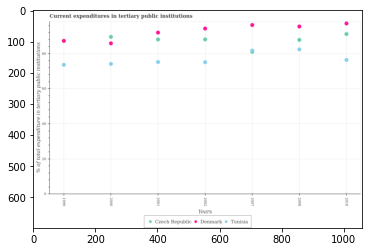

Number of QA =  28





,Years,Tunisia,Czech Republic,Denmark
0,2002,75.969637,88.996803,95.275446
1,2007,81.975799,NaN,97.273854
2,2008,83.276671,88.735598,96.424648
3,1999,74.430928,NaN,88.176194
4,2000,74.986415,90.462117,86.781202
5,2010,77.291364,92.126260,98.188661
6,2001,76.058305,88.986387,92.932222


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in tertiary public institutions in denmark in 2002 and that in 2008 ?
PREDICTED =  -1.1492016116346377
EXPECTED =  -1.1738586425782103




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in tertiary public institutions in czech republic in 1999 and the current expenditures in tertiary public institutions in tunisia in 2008?
PREDICTED =  -83.73559838029574
EXPECTED =  4.864959716796889




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the current expenditures in tertiary public institut

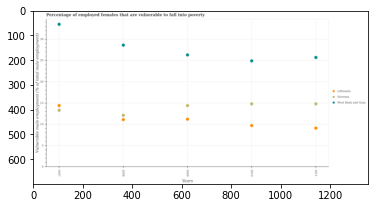

Number of QA =  28





,Years,Lithuania,Slovenia,West Bank and Gaza
0,2010,9.892724,15.017993,25.196395
1,2011,9.273350,15.013403,26.000054
2,2008,11.306294,12.292029,28.902248
3,2009,11.392923,14.613424,26.611515
4,2007,14.584157,13.513752,33.834985


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed females who are vulnerable to fall into poverty in lithuania in 2010 and that in 2011 ?
PREDICTED =  0.6193742424922561
EXPECTED =  0.5999994277954102




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of employed females who are vulnerable to fall into poverty in slovenia and percentage of employed females who are vulnerable to fall into poverty in lithuania ?
PREDICTED =  -1998.7079705525878
EXPECTED =  5.10000038146976




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gp

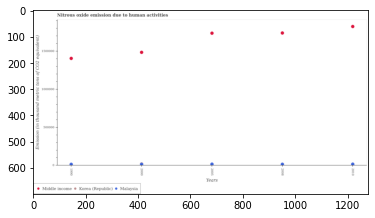

Number of QA =  28





,Years,Korea (Republic),Malaysia,Middle income
0,2000,NaN,20660.687443,1.487238e+06
1,2005,NaN,20560.681058,1.739886e+06
2,1990,NaN,18469.810731,1.408908e+06
3,2008,NaN,19502.402969,1.742092e+06
4,2010,NaN,20732.060420,1.827337e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in middle income in 1990 and that in 2005 ?
PREDICTED =  -330978.60405509034
EXPECTED =  -331449.19999999995




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in malaysia in 1990 and the amount of nitrous oxide emitted in middle income in 2008?
PREDICTED =  -1032.5922386518687
EXPECTED =  -1725670.9000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







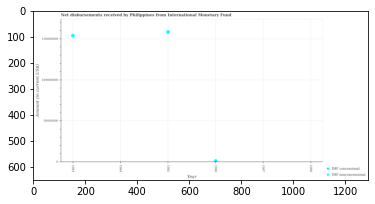

Number of QA =  22





,Year,IMF nonconcessional,IMF concessional
0,1988,NaN,NaN
1,1986,1.597266e+06,NaN
2,1984,NaN,NaN
3,1983,1.541799e+08,NaN
4,1987,NaN,NaN
5,1985,1.587249e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net non concessional disbursements from imf in 1983 and that in 1986 ?
PREDICTED =  152582678.84056535
EXPECTED =  152710000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest net non concessional disbursements from imf ?
PREDICTED =  152582678.84056535
EXPECTED =  4470000




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 0.25


> what is the difference between two consecutive

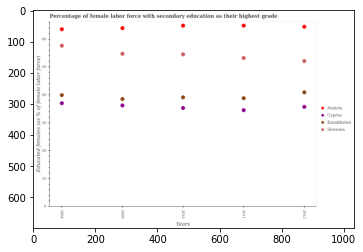

Number of QA =  29





,Years,Austria,Slovenia,Kazakhstan,Cyprus
0,2004,64.200853,58.305345,40.401931,37.484875
1,2009,64.585840,55.352999,39.010612,36.667250
2,2011,65.523837,53.817380,39.314889,34.977972
3,2010,65.499168,55.152144,39.611500,35.785731
4,2012,65.125915,52.731496,41.418046,36.191036


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with secondary education in cyprus in 2004 and that in 2010 ?
PREDICTED =  1.6991442076969818
EXPECTED =  1.7000007629395029




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with secondary education in kazakhstan in 2012 and the percentage of female labor force with secondary education in cyprus in 2009?
PREDICTED =  2.407433343974951
EXPECTED =  4.700000762939396




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of female labor force with seco

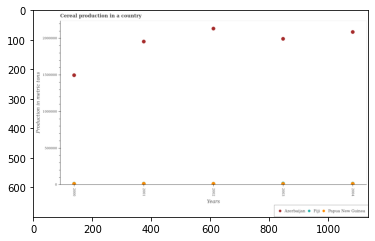

Number of QA =  28





,Years,Fiji,Azerbaijan,Papua New Guinea
0,2000,NaN,1.497686e+06,18600.652617
1,2003,NaN,1.994146e+06,19478.539574
2,2001,NaN,1.956800e+06,19651.928090
3,2002,NaN,2.133913e+06,17740.842335
4,2004,NaN,2.087064e+06,19440.418695


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production in papua new guinea in 2000 and that in 2002 ?
PREDICTED =  859.8102822217807
EXPECTED =  -1282




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production in azerbaijan in 2004 and the total cereal production in fiji in 2003?
PREDICTED =  92918.38264422794
EXPECTED =  2070087.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the total cereal production in fiji and total cereal production in azerbaijan ?
PREDICTED =  9669604.014432011
EXPECTED =  -2119672.0




				 0 / 3 = 0.0


is_bu

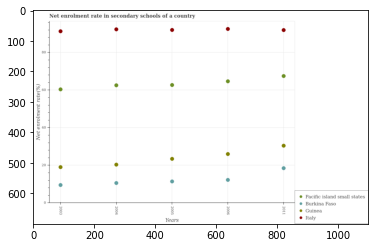

Number of QA =  29





,Years,Pacific island small states,Burkina Faso,Guinea,Italy
0,2004,62.852209,10.908398,20.662304,92.589980
1,2006,64.981091,12.555212,26.311184,92.796523
2,2005,62.991459,11.734699,23.744628,92.297363
3,2003,60.645826,9.830273,19.355527,91.560751
4,2011,67.763093,18.800022,30.761922,92.227244


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate in secondary schools in burkina faso in 2003 and that in 2005 ?
PREDICTED =  -1.9044268161910516
EXPECTED =  -1.9084501266479403




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate in secondary schools in italy in 2006 and the net enrolment rate in secondary schools in guinea in 2004?
PREDICTED =  0.20654312640844807
EXPECTED =  72.14363861083991




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the net enrolment rate in secondary schools in burkina faso and net enrolment rate in secondary

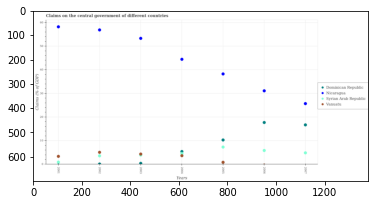

Number of QA =  28





,Years,Vanuatu,Nicaragua,Syrian Arab Republic,Dominican Republic
0,2002,5.237629,57.193040,3.714439,0.244032
1,2004,3.860432,44.731049,NaN,5.568865
2,2006,0.091130,31.335460,6.002315,17.894085
3,2003,4.416406,53.620504,NaN,0.568525
4,2005,1.007117,38.506592,7.442738,10.466854
5,2001,3.524562,58.490500,1.086244,NaN
6,2007,NaN,25.910454,5.013639,16.892778


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gdp claimed on the central government in nicaragua in 2005 and that in 2007 ?
PREDICTED =  12.596138152340547
EXPECTED =  12.5622995574418




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gdp claimed on the central government in syrian arab republic in 2003 and the percentage of gdp claimed on the central government in nicaragua in 2007?
PREDICTED =  -5.0136389296796935
EXPECTED =  -21.775085583775482




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of gdp claimed on the central g

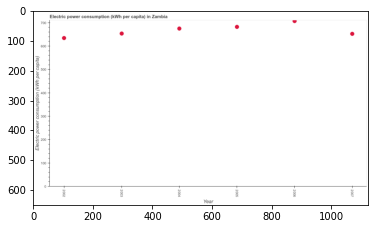

Number of QA =  24





,Year,Electric power consumption (kWh per capita)
0,2005,687.306892
1,2003,658.402344
2,2007,657.338039
3,2002,639.115741
4,2004,680.340203
5,2006,712.220220


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power consumption in 2003 and 2004 ?
PREDICTED =  -21.937858558419407
EXPECTED =  -21.336984561504096




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median electric power consumption ?
PREDICTED =  669.371273298847
EXPECTED =  664.177688757631




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the electric power consumption in 2004 to that in 2007 ?
PREDICTED =  1.0349928987743668
EXPECTED =  1.0346187086394631




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.






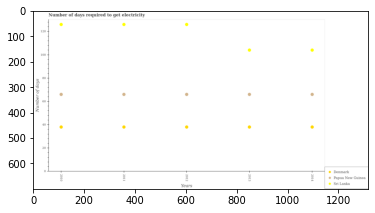

Number of QA =  28





,Years,Denmark,Sri Lanka,Papua New Guinea
0,2013,38.173058,103.707066,65.888464
1,2011,38.130663,125.438945,65.873983
2,2014,38.097586,103.655081,65.920331
3,2012,38.107326,125.561180,65.880978
4,2010,38.118769,125.501910,65.888770


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to get electricity in in sri lanka in 2011 and that in 2013 ?
PREDICTED =  -1.0
EXPECTED =  22




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to get electricity in in sri lanka in 2013 and the number of days required to get electricity in in denmark in 2014?
PREDICTED =  2.0
EXPECTED =  66




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the number of days required to get electricity in in papua new guinea and number of days required to get electricity in in sri lanka ?
PRE

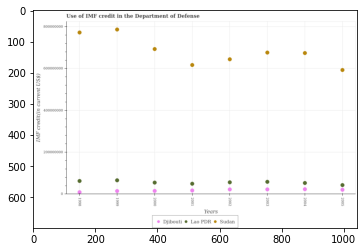

Number of QA =  28





,Years,Lao PDR,Sudan,Djibouti
0,1998,6.480078e+07,7.764841e+08,1.087336e+07
1,1999,6.832286e+07,7.912998e+08,1.701635e+07
2,2005,4.530446e+07,5.971898e+08,2.279517e+07
3,2001,5.201599e+07,6.211551e+08,1.938036e+07
4,2000,5.696449e+07,6.975319e+08,1.795475e+07
5,2002,5.846764e+07,6.481857e+08,2.484695e+07
6,2004,5.518793e+07,6.780211e+08,2.550885e+07
7,2003,6.088911e+07,6.807922e+08,2.489461e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imf credit in the department of defense in lao pdr in 2001 and that in 2005 ?
PREDICTED =  6711525.415320203
EXPECTED =  6512000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imf credit in the department of defense in sudan in 2003 and the imf credit in the department of defense in lao pdr in 2001?
PREDICTED =  59637079.6970005
EXPECTED =  626980000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the imf credit in the department of defense in lao pdr and imf credit in the department of defense in sudan ?
PREDICTED =  -

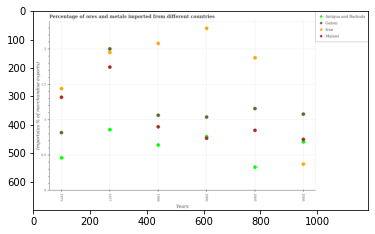

Number of QA =  29





,Years,Iran,Gabon,Malawi,Antigua and Barbuda
0,1975,1.436185,0.818214,1.313705,0.464383
1,1977,1.945602,1.994238,1.738264,0.860237
2,2000,2.283462,1.036954,0.738352,0.762435
3,1999,2.071075,1.061747,0.899825,0.643338
4,2006,0.375718,1.078732,0.722340,0.688003
5,2005,1.870000,1.155735,0.849690,0.331960


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in gabon in 2005 and that in 2006 ?
PREDICTED =  0.07700241485171877
EXPECTED =  0.07875705422394996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of imports to different countries in gabon and percentage of imports to different countries in iran ?
PREDICTED =  -2003.1875478209201
EXPECTED =  -1.01621246741357




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after traini

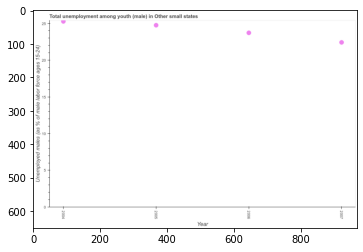

Number of QA =  24





,Year,Unemployed males (as % of male labor force ages 15-24)
0,2005,24.964336
1,2006,23.926488
2,2004,25.490399
3,2007,22.619819


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed male youth population in 2005 and 2007 ?
PREDICTED =  2.344517420115192
EXPECTED =  2.336742481712001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed male youth population ?
PREDICTED =  2005.5
EXPECTED =  24.23850086446015




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed male youth population in 2006 to that in 2007 ?
PREDICTED =  1.0577665798020113
EXPECTED =  1.0579510479109817




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step

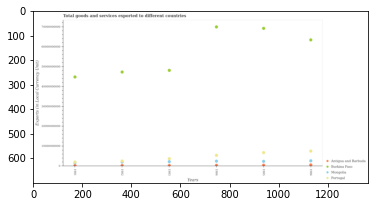

Number of QA =  29





,Years,Mongolia,Burkina Faso,Portugal,Antigua and Barbuda
0,1985,2.553851e+09,6.929357e+10,6.890050e+09,5.908802e+08
1,1982,NaN,4.738070e+10,2.613709e+09,4.111502e+08
2,1981,NaN,4.483808e+10,2.179195e+09,4.473695e+08
3,1983,2.434457e+09,4.820021e+10,3.881595e+09,4.664051e+08
4,1986,2.815272e+09,6.349634e+10,7.705074e+09,7.685324e+08
5,1984,2.633325e+09,7.000406e+10,5.555523e+09,5.358323e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods and services exports in antigua and barbuda in 1985 and that in 1986 ?
PREDICTED =  -1359412566.5765588
EXPECTED =  -148910000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods and services exports in burkina faso in 1983 and the amount of goods and services exports in portugal in 1986?
PREDICTED =  -111696545593.2016
EXPECTED =  40564224800.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the amount of goods and services exports in mongolia and amount of goods and services exports in ant

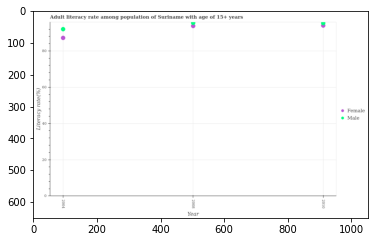

Number of QA =  27





,Year,Male,Female
0,2010,95.283818,94.118818
1,2008,95.576485,93.881929
2,2004,92.196425,87.353263


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male adult literacy rate in 2004 and that in 2008 ?
PREDICTED =  -3.380060526752658
EXPECTED =  -3.4766159057615766




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male adult literacy rate in 2004 and the female adult literacy rate in 2008?
PREDICTED =  -3.380060526752658
EXPECTED =  -1.7490463256835938




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the female adult literacy rate and male adult literacy rate ?
PREDICTED =  0.0
EXPECTED =  -1.727569580077983




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_avail

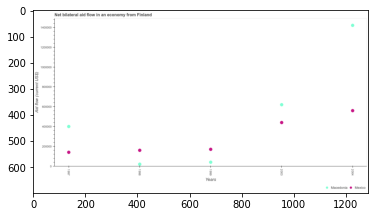

Number of QA =  27





,Years,Mexico,Macedonia
0,1998,166881.330522,2.726400e+04
1,2004,566649.543977,1.425010e+06
2,1997,146114.027470,4.062479e+05
3,1999,176551.644343,4.609802e+04
4,2003,446096.677125,6.261891e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in macedonia in 1998 and that in 1999 ?
PREDICTED =  -18834.02770701911
EXPECTED =  -20000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in macedonia in 2004 and the net bilateral aid flow in mexico in 1997?
PREDICTED =  1018761.9848573421
EXPECTED =  1280000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the net bilateral aid flow in macedonia and net bilateral aid flow in mexico ?
PREDICTED =  1425004.8967270318
EXPECTED =  260000.0




				 0 / 3 = 0.0


is_built_wi

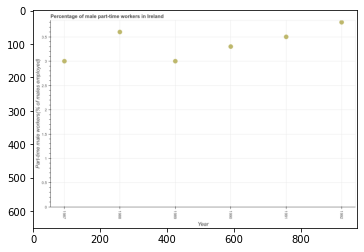

Number of QA =  24





,Year,Part-time male workers(% of males employed)
0,1989,3.035773
1,1990,3.341966
2,1988,3.643411
3,1991,3.539407
4,1987,3.039580
5,1992,3.843688


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time male workers in 1989 and 1992 ?
PREDICTED =  -0.807915699147876
EXPECTED =  -0.7999999523162802




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time male workers ?
PREDICTED =  1989.5
EXPECTED =  3.3999999761581403




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of part-time male workers in 1988 to that in 1989 ?
PREDICTED =  1.2001592116431765
EXPECTED =  1.1999999682108566




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished aft

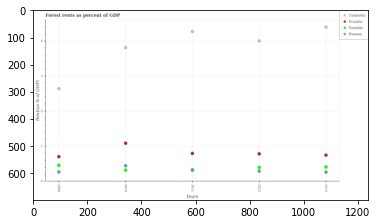

Number of QA =  29





,Years,Namibie,Cambodia,Ecuador,Panama
0,2010,0.330403,3.826091,1.097536,0.451531
1,2011,NaN,4.286906,0.805999,0.328079
2,2012,0.407751,4.014996,0.795180,0.299774
3,2009,0.468995,2.654199,0.712481,0.280467
4,2013,0.418419,4.410882,0.760301,0.275292


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the forest rent in namibia in 2011 and that in 2013 ?
PREDICTED =  -0.4184188116847069
EXPECTED =  -0.07573796414886003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the forest rent in cambodia in 2009 to that in 2013?
PREDICTED =  0.6017388363363932
EXPECTED =  0.6008822842793408




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Ev

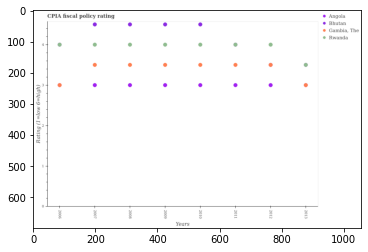

Number of QA =  29





,Years,Angola,"Gambia, The",Bhutan,Rwanda
0,2006,NaN,3.008365,NaN,4.006010
1,2012,3.006995,3.509288,NaN,4.006729
2,2007,3.005945,3.506371,4.503687,4.005874
3,2013,NaN,3.007076,NaN,3.507114
4,2011,3.007449,3.507754,NaN,4.006735
5,2010,3.006919,3.507722,4.505473,4.007931
6,2008,3.006930,3.506007,4.503816,4.006442
7,2009,3.005935,3.507377,4.504813,4.007271


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in rwanda in 2008 and that in 2010 ?
PREDICTED =  -0.001489026188426834
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in gambia, the in 2013 and the cpia rating in rwanda in 2010?
PREDICTED =  -0.5006466982436644
EXPECTED =  -1.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the cpia rating in bhutan and cpia rating in rwanda ?
PREDICTED =  -4.0
EXPECTED =  0.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation

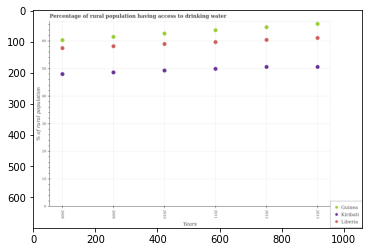

Number of QA =  28





,Years,Kiribati,Liberia,Guinea
0,2012,50.569325,60.348133,64.919115
1,2013,50.582378,61.035214,66.128111
2,2011,49.895227,59.558627,63.828263
3,2008,48.030866,57.344784,60.215138
4,2010,49.272577,58.816671,62.646180
5,2009,48.582857,58.041799,61.432765


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to drinking water in guinea in 2009 and that in 2012 ?
PREDICTED =  -3.4863502306794913
EXPECTED =  -3.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to drinking water in kiribati in 2012 and the percentage of rural population having access to drinking water in liberia in 2009?
PREDICTED =  1.9864674890040988
EXPECTED =  -7.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of rural population having access to drink

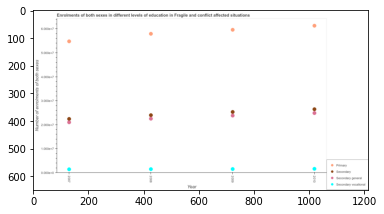

Number of QA =  29





,Year,Secondary,Primary,Secondary general,Secondary vocational
0,2008,2.403589,5.779924,2.261683,0.171615
1,2009,2.535309,5.946608,2.391132,0.174139
2,2010,2.654377,6.114166,2.490048,0.184104
3,2007,2.248657,5.468341,2.115186,0.162420


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in primary education in 2008 and that in 2009 ?
PREDICTED =  -0.16668422645665615
EXPECTED =  -1667128




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in primary education in 2009 and the number of enrolments in secondary vocational education in 2008?
PREDICTED =  0.16668422645665615
EXPECTED =  58125231.875




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the number of enrolments in secondary education and number of enrolments in secondary vocational education ?
PREDICTED =  0.0


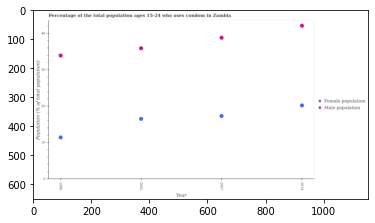

Number of QA =  27





,Year,Female population,Male population
0,1996,11.532904,34.080878
1,2002,16.640851,36.058616
2,2014,20.360512,42.279878
3,2007,17.447025,38.992502


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male population in 2002 and that in 2007 ?
PREDICTED =  -2.933886756332889
EXPECTED =  -2.8999999999999986




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male population in 2014 and the female population in 1996?
PREDICTED =  8.199000308684582
EXPECTED =  30.700000000000003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the male population and female population ?
PREDICTED =  0.0
EXPECTED =  19.4




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fi

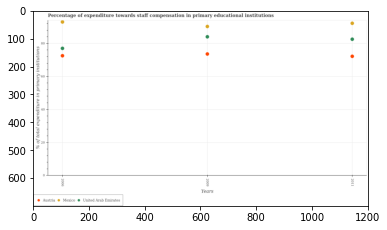

Number of QA =  28





,Years,Austria,United Arab Emirates,Mexico
0,2009,73.887733,84.292571,90.563211
1,2011,72.501973,82.864667,92.528157
2,2006,72.844635,77.330737,93.300076


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in mexico in 2006 and that in 2011 ?
PREDICTED =  0.7719191684031017
EXPECTED =  0.8048706054688068




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in austria in 2011 and the percentage of expenditure towards staff compensation in mexico in 2009?
PREDICTED =  -1.3857599873832527
EXPECTED =  -18.071777343749986




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of expenditure towards staff compensation in 

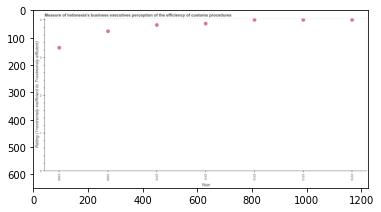

Number of QA =  24





,Year,Rating (1=extremely inefficient to 7=extremely efficient)
0,2014,4.010454
1,2012,4.009577
2,2009,3.707999
3,2010,3.872882
4,2013,4.010046
5,2011,3.909902
6,2008,3.270499


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating measuring burden of customs procedure in 2011 and 2014 ?
PREDICTED =  -0.10055212882490583
EXPECTED =  -0.10000000000000009




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median rating measuring burden of customs procedure ?
PREDICTED =  2011.0
EXPECTED =  3.9




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rating measuring burden of customs procedure in 2008 to that in 2013 ?
PREDICTED =  0.8155765072262551
EXPECTED =  0.81532462082271




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fi

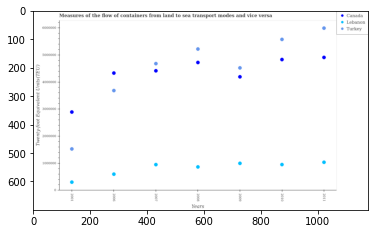

Number of QA =  28





,Years,Turkey,Canada,Lebanon
0,2008,5.223531e+06,4.729048e+06,8.753742e+05
1,2009,4.526701e+06,4.198447e+06,1.007883e+06
2,2007,4.686232e+06,4.421002e+06,9.605045e+05
3,2006,3.691069e+06,4.337519e+06,6.081716e+05
4,2001,1.535996e+06,2.897375e+06,3.131903e+05
5,2010,5.576136e+06,4.836020e+06,9.600238e+05
6,2011,5.993978e+06,4.911532e+06,1.046237e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in lebanon in 2001 and that in 2010 ?
PREDICTED =  -646833.4742714227
EXPECTED =  -649755.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in lebanon in 2001 and the container port traffic in turkey in 2009?
PREDICTED =  -694692.9349679807
EXPECTED =  -4222313.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the container port traffic in canada and container port traffic in lebanon ?
PREDICTED =  4087048.3433458256
EXPECTED =  3858732.0




				 1 / 3 = 0.3333


is_built_wi

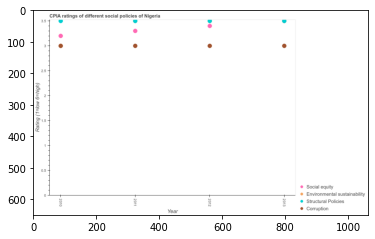

Number of QA =  29





,Year,Structural Policies,Environmental sustainability,Corruption,Social equity
0,2010,3.517902,NaN,3.017505,3.218138
1,2012,3.517332,NaN,3.016780,3.417573
2,2013,3.518025,NaN,3.017447,NaN
3,2011,3.519290,NaN,3.017042,3.318618


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of corruption in 2011 and that in 2013 ?
PREDICTED =  -0.0004043986468658112
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of corruption in 2011 and the cpia rating of environmental sustainability in 2012?
PREDICTED =  0.0002622236541669487
EXPECTED =  -0.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the cpia rating of social equity and cpia rating of corruption ?
PREDICTED =  0.4003799277476032
EXPECTED =  0.20000000000000018




				 0 / 3 = 0.0


is_built_with_cuda: True
is_

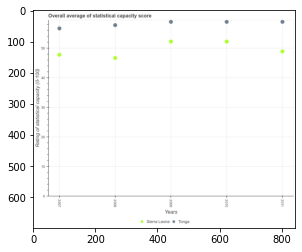

Number of QA =  27





,Years,Sierra Leone,Tonga
0,2009,52.276246,58.946342
1,2007,47.871511,56.748080
2,2008,46.734759,57.837444
3,2010,52.274585,58.953895
4,2011,48.935278,58.929675


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in sierra leone in 2007 and that in 2011 ?
PREDICTED =  -1.0637676103617935
EXPECTED =  -1.1111111111111214




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in tonga in 2010 and the rating of statistical capacity in sierra leone in 2008?
PREDICTED =  1.1164510874806837
EXPECTED =  12.2222222222222




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the rating of statistical capacity in sierra leone and rating of statistical capacity in tonga ?
PREDICTED =  94.54280

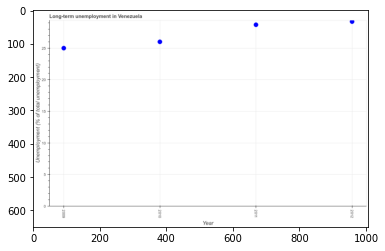

Number of QA =  24





,Year,Unemployment (% of total unemployment)
0,2012,29.470717
1,2009,25.262802
2,2010,26.267603
3,2011,28.992460


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term unemployment in 2009 and 2011 ?
PREDICTED =  -3.7296577070318655
EXPECTED =  -3.7000007629394993




				 1 / 1 = 1.0


> what is the median long-term unemployment ?
PREDICTED =  None
EXPECTED =  27.350000381469748




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the long-term unemployment in 2009 to that in 2010 ?
PREDICTED =  0.9617475239077976
EXPECTED =  0.9615384615384616




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest long-term unemployment ?
PREDICTED =  1982.5292825430938
EXPECTED =  0.5




				 2

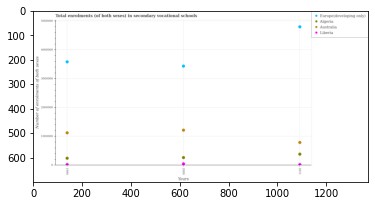

Number of QA =  29





,Years,Algeria,Australia,Liberia,Europe(developing only)
0,2000,276231.976244,1.225435e+06,58590.674384,3.444951e+06
1,2011,397186.205430,8.006973e+05,30837.836504,4.812517e+06
2,1999,252602.810062,1.138111e+06,32606.269182,3.592226e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in australia in 1999 and that in 2000 ?
PREDICTED =  -87323.76320910035
EXPECTED =  -92409.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in liberia in 2011 and the number of enrolments in secondary schools in australia in 1999?
PREDICTED =  -1768.4326785536541
EXPECTED =  -1103194.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the number of enrolments in secondary schools in algeria and number of enrolments in secondary schools in 

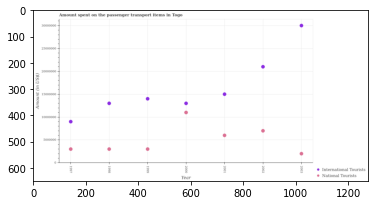

Number of QA =  27





,Year,National Tourists,International Tourists
0,1998,3.109430e+06,1.311277e+07
1,2000,1.110430e+07,1.310806e+07
2,2002,7.110947e+06,2.111031e+07
3,1999,3.106424e+06,1.410965e+07
4,2001,6.101633e+06,1.510547e+07
5,2003,2.089190e+06,3.011794e+07
6,1997,3.102367e+06,9.109942e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of national tourists in 1998 and that in 2002 ?
PREDICTED =  -4001517.670126191
EXPECTED =  -4000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of national tourists in 1997 and the amount spent on transport items of international tourists in 2003?
PREDICTED =  1013176.9141219473
EXPECTED =  -27000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the amount spent on transport items of national tourists and amount spent on transport items of internation

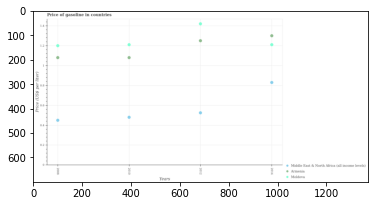

Number of QA =  28





,Years,Middle East & North Africa (all income levels),Moldova,Armenia
0,2008,0.451936,1.200240,1.080892
1,2014,0.831321,1.209228,1.300009
2,2012,0.526556,1.418804,1.249268
3,2010,0.482560,1.209506,1.081025


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of gasoline in moldova in 2012 and that in 2014 ?
PREDICTED =  0.2095764848581554
EXPECTED =  0.20999999999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of gasoline in moldova in 2012 and the price of gasoline in middle east & north africa (all income levels) in 2010?
PREDICTED =  0.20929848134169537
EXPECTED =  0.94




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the price of gasoline in middle east & north africa (all income levels) and price of gasoline in armenia ?
PREDICTED =  -1.461051359393478

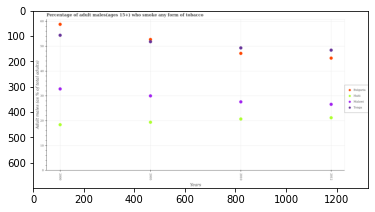

Number of QA =  29





,Years,Tonga,Haiti,Bulgaria,Malawi
0,2010,49.457552,20.855678,47.217415,27.732328
1,2012,48.511871,21.364947,45.312018,26.740256
2,2005,51.922771,19.515325,52.788031,30.143759
3,2000,54.534328,18.545238,58.864864,32.907263


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of adult males who smoke in bulgaria in 2000 and that in 2012 ?
PREDICTED =  13.552845207428533
EXPECTED =  13.599999999999994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of adult males who smoke in malawi in 2000 and the percentage of adult males who smoke in tonga in 2005?
PREDICTED =  2.7635039408720665
EXPECTED =  -19.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of adult males who smoke in haiti and percentage of adult males who smoke in malawi ?
PREDICTED =  -5.375308805

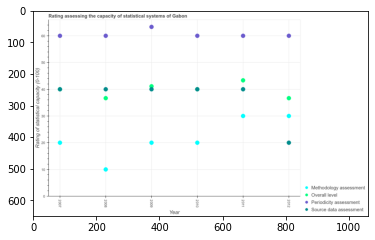

Number of QA =  29





,Year,Source data assessment,Methodology assessment,Overall level,Periodicity assessment
0,2010,40.419528,20.330863,NaN,60.484905
1,2011,40.413383,30.370299,43.765368,60.495908
2,2012,20.341555,30.381000,37.087211,60.495287
3,2008,40.413684,10.284622,37.074090,60.486389
4,2009,40.390256,20.343413,41.527196,63.841972
5,2007,40.427890,20.333571,NaN,60.515194


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the methodology assessment rating in 2007 and that in 2011 ?
PREDICTED =  -10.03672769174937
EXPECTED =  -10




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the periodicity assessment rating in 2007 and the overall level rating in 2008?
PREDICTED =  0.028804589984929407
EXPECTED =  23.3333333333333




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the source data assessment rating and overall level rating ?
PREDICTED =  218.40629560473153
EXPECTED =  -16.6666666666667




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_avail

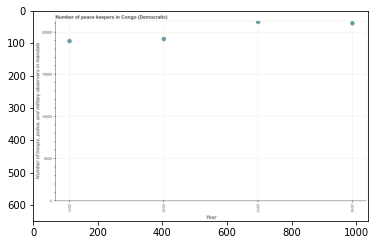

Number of QA =  24





,Year,"Number of troops, police, and military observers in mandate"
0,2012,19338.837733
1,2013,21383.736042
2,2014,21228.588107
3,2011,19104.034064


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of peace keepers in 2011 and 2013 ?
PREDICTED =  -2279.7019785465163
EXPECTED =  -2270




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of peace keepers ?
PREDICTED =  2012.5
EXPECTED =  20101.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of peace keepers in 2012 to that in 2013 ?
PREDICTED =  0.9043713266280724
EXPECTED =  0.9041419001792622




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the h

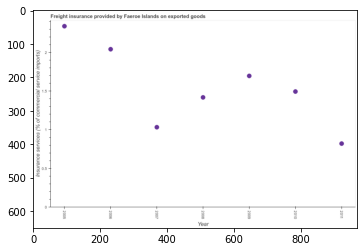

Number of QA =  24





,Year,Insurance services (% of commercial service imports)
0,2009,1.710850
1,2010,1.506881
2,2008,1.430058
3,2006,2.054838
4,2005,2.354558
5,2011,0.832908
6,2007,1.045218


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the freight insurance in 2006 and 2011 ?
PREDICTED =  1.2219293749042965
EXPECTED =  1.2209852478061898




				 1 / 1 = 1.0


> what is the median freight insurance ?
PREDICTED =  None
EXPECTED =  1.49385778027592




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the freight insurance in 2007 to that in 2011 ?
PREDICTED =  1.2549016248367852
EXPECTED =  1.2582356268456667




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest freight insurance ?
PREDICTED =  0.2997201458297565
EXPECTED =  0.2977708279156803




				 3 / 5 = 0.

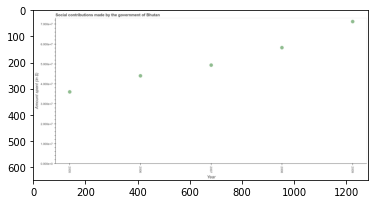

Number of QA =  24





,Year,Amount spent (in $)
0,2009,7.081212
1,2006,4.385997
2,2007,4.917946
3,2008,5.784758
4,2005,3.586597


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in making social contributions in 2005 and 2007 ?
PREDICTED =  -1.3313492287116948
EXPECTED =  -13418000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount spent in making social contributions ?
PREDICTED =  4.917945999897993
EXPECTED =  49419000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount spent in making social contributions in 2005 to that in 2007 ?
PREDICTED =  0.7292875463172411
EXPECTED =  0.7284849956494466




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluati

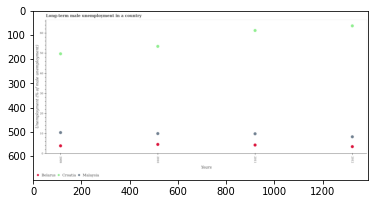

Number of QA =  28





,Years,Croatia,Malaysia,Belarus
0,2010,53.753579,10.235055,4.834439
1,2009,49.980428,10.733950,4.097336
2,2011,61.643120,10.140409,4.545205
3,2012,63.980080,8.654000,3.713072


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed male population in belarus in 2010 and that in 2011 ?
PREDICTED =  0.28923462634831143
EXPECTED =  0.2999997138977104




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed male population in malaysia in 2012 and the percentage of long-term unemployed male population in belarus in 2010?
PREDICTED =  -1.581055209150465
EXPECTED =  3.7999997138976997




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of long-term unemployed male population in malays

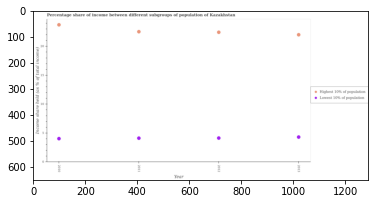

Number of QA =  27





,Year,Lowest 10% of population,Highest 10% of populatior
0,2011,4.156934,22.513034
1,2013,4.354698,21.975767
2,2012,4.175955,22.405537
3,2010,4.070963,23.685983


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 10% of the population in 2012 and that in 2013 ?
PREDICTED =  -0.17874291843132983
EXPECTED =  0.4299999999999997




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 10% of the population in 2012 and the income share held by highest 10% of the population in 2013?
PREDICTED =  -0.17874291843132983
EXPECTED =  -17.87




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the income share held by lowest 10% of the population and income share held by highest 10% of the population

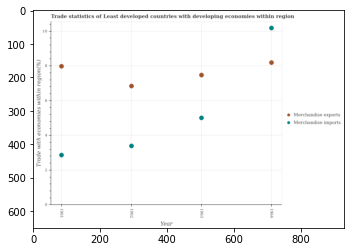

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,1962,3.445764,6.909736
1,1961,2.912480,8.055130
2,1963,5.062902,7.546329
3,1964,10.268718,8.265563


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1961 and that in 1962 ?
PREDICTED =  1.1453946053764694
EXPECTED =  1.13834338854494




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1962 and the merchandise exports in 1961?
PREDICTED =  0.5332841609198358
EXPECTED =  -4.58647519767616




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1963, what is the difference between the merchandise imports and merchandise exports ?
PREDICTED =  2.0031546741200366
EXPECTED =  -2.4648497780297385




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: 

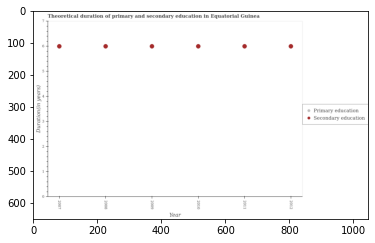

Number of QA =  27





,Year,Primary education,Secondary education
0,2009,NaN,6.009777
1,2010,NaN,6.010265
2,2011,NaN,6.010814
3,2007,NaN,6.011739
4,2008,NaN,6.008024
5,2012,NaN,6.008649


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the duration of secondary education in 2010 ?
PREDICTED =  1.0017108156904246
EXPECTED =  6




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum duration of secondary education ?
PREDICTED =  1.0019564506319434
EXPECTED =  6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum duration of secondary education ?
PREDICTED =  1.00133736567289
EXPECTED =  6




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the duration of secondary education max

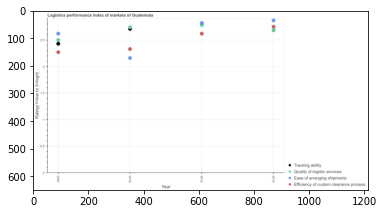

Number of QA =  29





,Year,Quality of logistic services,Tracking ability,Ease of arranging shipments,Efficiency of custom clearance process
0,2014,2.683471,NaN,2.869934,2.750554
1,2010,2.711985,2.743680,2.163966,2.332964
2,2012,2.782940,NaN,2.816709,2.621665
3,2007,2.500596,2.431352,2.621264,2.274063


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi rating of ease of arranging shipments in 2007 and that in 2010 ?
PREDICTED =  0.4572976993770892
EXPECTED =  0.45999999999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi rating of efficiency of custom clearance process in 2007 and the lpi rating of quality of logistic services in 2012?
PREDICTED =  -0.3476015020897205
EXPECTED =  -0.5099999999999998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the lpi rating of efficiency of custom clearance process and lpi rating of quality of logistic services ?
PREDI

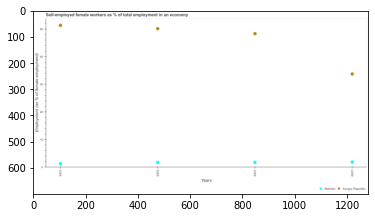

Number of QA =  27





,Years,Bahrain,Kyrgyz Republic
0,2006,1.902696,48.494361
1,2005,1.890620,50.274325
2,2004,1.393818,51.458367
3,2009,2.016893,33.887771


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in bahrain in 2004 and that in 2009 ?
PREDICTED =  -0.6230748576987071
EXPECTED =  -0.5999999046325599




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in kyrgyz republic in 2004 and the percentage of self-employed female workers in bahrain in 2005?
PREDICTED =  1.1840423155850246
EXPECTED =  49.599999189376774




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of self-employed female workers in bahrain and percentage of self

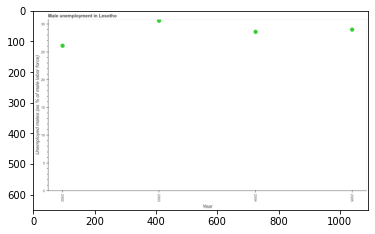

Number of QA =  24





,Year,Unemployed males (as % of male labor force)
0,2004,28.488756
1,2005,28.881486
2,2003,30.460588
3,2002,25.997877


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed males population in 2002 and 2004 ?
PREDICTED =  -2.4908791131985524
EXPECTED =  -2.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed males population ?
PREDICTED =  2003.5
EXPECTED =  28.800000190734846




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed males population in 2003 to that in 2005 ?
PREDICTED =  1.0546752202423022
EXPECTED =  1.0551724269472307




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the di

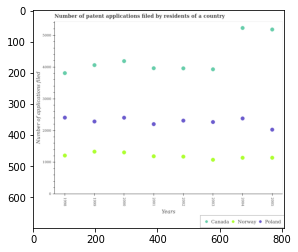

Number of QA =  28





,Years,Norway,Poland,Canada
0,2002,1193.445605,2327.329153,3971.753777
1,1999,1351.430818,2298.576114,4073.533003
2,2000,1327.064155,2419.984265,4199.295751
3,1998,1227.096921,2418.282564,3824.777799
4,2004,1157.686268,2394.170880,5245.291704
5,2003,1093.298764,2282.953341,3941.533080
6,2001,1204.372438,2215.308095,3975.141550
7,2005,1157.544347,2042.971861,5196.187576


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of applications filed in norway in 2003 and that in 2005 ?
PREDICTED =  1092.2987639454864
EXPECTED =  -64.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of applications filed in poland in 1999 and the number of applications filed in canada in 2001?
PREDICTED =  83.2680184858591
EXPECTED =  -1678.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the number of applications filed in poland and number of applications filed in norway ?
PREDICTED =  0.0
EXPECTED =  885.0




				 0 / 3 = 0.0


is_built_with_c

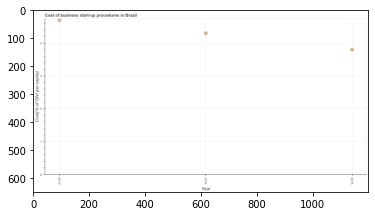

Number of QA =  24





,Year,Cost(% of GNI per capita)
0,2013,4.722485
1,2015,3.822448
2,2014,4.323976


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of business startup procedures in 2014 and 2015 ?
PREDICTED =  0.5015281466976531
EXPECTED =  0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median cost of business startup procedures ?
PREDICTED =  2014.0
EXPECTED =  4.3




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cost of business startup procedures in 2013 to that in 2014 ?
PREDICTED =  1.0921626726740028
EXPECTED =  1.0930232558139537




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is

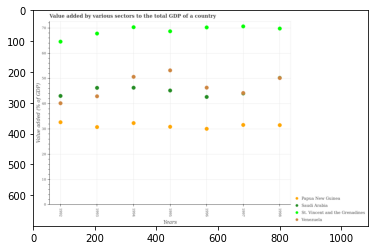

Number of QA =  29





,Years,Saudi Arabia,Venezuela,St. Vincent and the Grenadines,Papua New Guinea
0,1998,NaN,50.215238,69.717761,31.581634
1,1994,46.330169,50.666784,70.238287,32.388971
2,1997,NaN,44.148382,70.559495,31.645791
3,1996,42.693380,46.402498,70.157341,30.102608
4,1992,43.110157,40.237667,64.515362,32.771619
5,1995,45.253041,53.220956,68.609458,30.932854
6,1993,46.294261,42.982315,67.751263,30.810926


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by various sectors to the total gdp in saudi arabia in 1994 and that in 1996 ?
PREDICTED =  -220.6810077554143
EXPECTED =  3.6557430227576972




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by various sectors to the total gdp in venezuela in 1992 and the value added by various sectors to the total gdp in saudi arabia in 1997?
PREDICTED =  -3.91071512467267
EXPECTED =  -3.8839116531979982




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the value added by various sectors to the total gdp in saudi ar

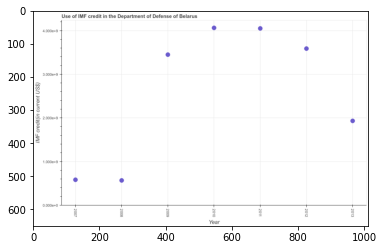

Number of QA =  24





,Year,IMF credit(in current US$)
0,2008,0.583363
1,2011,4.083193
2,2012,3.619908
3,2010,4.096355
4,2009,3.481266
5,2013,1.956443
6,2007,0.601000


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the use of imf credit in dod in 2010 and 2013 ?
PREDICTED =  2.1399123044956383
EXPECTED =  2130937000




				 0 / 1 = 0.0


> what is the median use of imf credit in dod ?
PREDICTED =  None
EXPECTED =  3449281000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the use of imf credit in dod in 2007 to that in 2008 ?
PREDICTED =  1.0302330943918994
EXPECTED =  1.0259557283824077




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest use of imf credit in dod ?
PREDICTED =  0.006581034706035105
EXPECTED =  12558000




				 1 / 

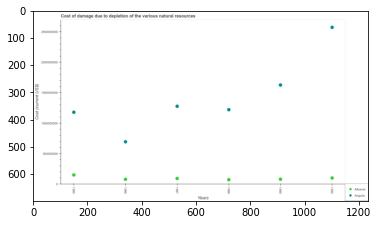

Number of QA =  27





,Years,Unnamed: 1,Albania
0,1990,2.585558e+09,1.085602e+08
1,1987,1.287545e+09,1.004811e+08
2,1989,1.637963e+09,8.927133e+07
3,1988,1.231784e+09,8.108851e+07
4,1985,1.187293e+09,1.589124e+08
5,1986,7.050433e+08,8.723659e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of various natural resources in angola in 1985 and that in 1987 ?
PREDICTED =  58431323.67965102
EXPECTED =  -98418777.31344986




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of various natural resources in albania in 1985 and the cost of damage caused due to the depletion of various natural resources in angola in 1988?
PREDICTED =  77823877.8153702
EXPECTED =  -1071510179.287406




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_availa

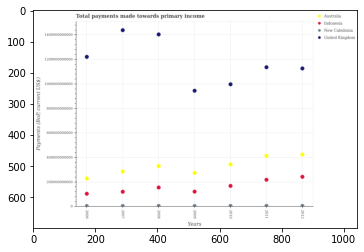

Number of QA =  29





,Years,Australia,United Kingdom,New Caledonia,Indonesia
0,2011,4.173042e+11,1.137822e+12,9.169026e+09,2.214460e+11
1,2009,2.779508e+11,9.459597e+11,7.632433e+09,1.249311e+11
2,2006,2.327913e+11,1.222657e+12,7.611463e+09,1.077265e+11
3,2007,2.887964e+11,1.439089e+12,8.137821e+09,1.242512e+11
4,2012,4.269199e+11,1.128318e+12,9.269701e+09,2.459054e+11
5,2008,3.323710e+11,1.404241e+12,9.058833e+09,1.587107e+11
6,2010,3.472708e+11,9.996887e+11,8.883948e+09,1.717213e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total payments made towards primary income in new caledonia in 2010 and that in 2012 ?
PREDICTED =  -385753918.2122402
EXPECTED =  -523286302.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total payments made towards primary income in indonesia in 2010 and the total payments made towards primary income in new caledonia in 2007?
PREDICTED =  47470095607.58031
EXPECTED =  163953977727.2




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total payments made towards primary income in united kingdom and total payments mad

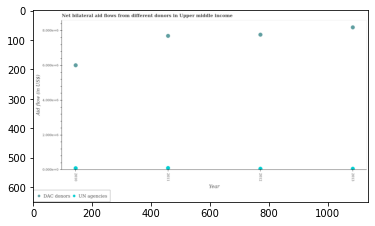

Number of QA =  27





,Year,DAC donors,UN agencies
0,2013,8.204957,0.091571
1,2011,7.717980,0.135823
2,2010,6.038648,0.123725
3,2012,7.790504,0.094990


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow from un agencies in 2012 and that in 2013 ?
PREDICTED =  7.698932794391
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow from dac donors in 2011 and the aid flow from un agencies in 2010?
PREDICTED =  1.6793319311351675
EXPECTED =  7610000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the aid flow from dac donors and aid flow from un agencies ?
PREDICTED =  4.204957181023888
EXPECTED =  5920000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pr

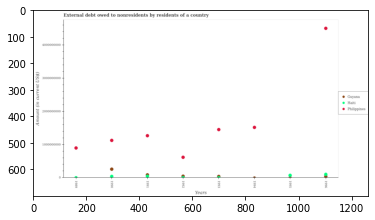

Number of QA =  27





,Years,Philippines,Haiti,Guyana
0,1995,8.184873e+07,1.895268e+07,NaN
1,1994,1.528344e+09,7.536111e+06,NaN
2,1996,4.511992e+09,4.862895e+07,1.105276e+08
3,1993,1.459678e+09,NaN,4.540896e+07
4,1991,1.276989e+09,2.238647e+07,9.513381e+07
5,1989,9.068908e+08,1.602737e+07,NaN
6,1990,1.132325e+09,5.276817e+07,2.669734e+08
7,1992,6.252223e+08,NaN,4.960096e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external debt owed by residents in philippines in 1991 and that in 1994 ?
PREDICTED =  -251354774.83297753
EXPECTED =  -250157000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external debt owed by residents in guyana in 1992 and the external debt owed by residents in haiti in 1996?
PREDICTED =  972007.2658642605
EXPECTED =  -55757000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the external debt owed by residents in haiti and external debt owed by residents in guyana ?
PREDICTED =  166299735.84693158
EXPECTED =  -4

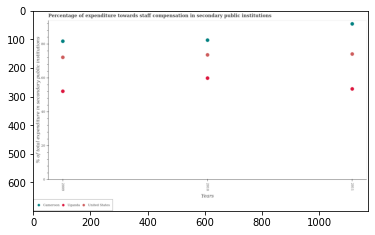

Number of QA =  28





,Years,Uganda,United States,Cameroon
0,2011,53.778011,74.409528,92.201405
1,2009,52.424682,72.503930,81.967841
2,2010,60.163400,73.912485,82.592355


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in cameroon in 2009 and that in 2011 ?
PREDICTED =  -10.233563375452533
EXPECTED =  -10.236419677734403




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in united states in 2011 and the percentage of expenditure towards staff compensation in uganda in 2009?
PREDICTED =  1.905597856783288
EXPECTED =  21.968219757080107




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of expenditure towards staff compensat

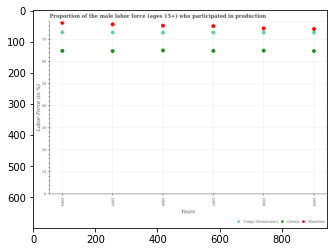

Number of QA =  28





,Years,Congo (Democratic),Mauritius,Greece
0,2008,73.033657,74.892705,64.860322
1,2006,73.040727,76.122394,64.985821
2,2004,73.147265,77.466347,64.808549
3,2007,73.057337,75.993357,64.754098
4,2009,73.029602,74.582845,64.692957
5,2005,73.044163,76.685439,64.669801


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in mauritius in 2006 and that in 2009 ?
PREDICTED =  1.5395494568827388
EXPECTED =  1.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in congo (democratic) in 2004 and the proportion of the male labor force who participated in production in mauritius in 2005?
PREDICTED =  0.10310131874838646
EXPECTED =  -3.6000061035155966




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the proportion of t

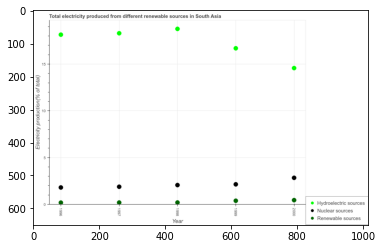

Number of QA =  28





,Year,Nuclear sources,Hydroelectric sources,Renewable sources
0,1998,2.144468,18.910699,0.274979
1,1997,1.970793,18.438534,0.258041
2,1999,2.214051,16.821167,0.471706
3,2000,2.914069,14.687624,0.527216
4,1996,1.881949,18.294353,0.242936


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by hydroelectric sources in 1999 and that in 2000 ?
PREDICTED =  2.1335428541566674
EXPECTED =  2.116956815826402




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by nuclear sources in 1997 and the percentage of electricity produced by renewable sources in 2000?
PREDICTED =  -0.943275310307705
EXPECTED =  1.430968746017438




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of electricity produced by hydroelectric sources and percentage of el

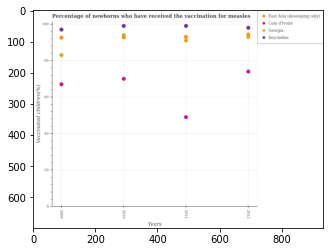

Number of QA =  29





,Years,Seychelles,East Asia (developing only),Cote d'Ivoire,Georgia
0,2009,97.325490,92.990485,67.342896,83.365242
1,2011,99.374213,93.350449,49.349460,91.377872
2,2012,98.384909,94.584578,74.382833,93.349446
3,2010,99.373007,93.161223,70.336829,94.397172


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in seychelles in 2009 and that in 2012 ?
PREDICTED =  -1.0594185244779908
EXPECTED =  -1.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in east asia (developing only) in 2011 and the percentage of vaccinated children in georgia in 2009?
PREDICTED =  0.35996367570476195
EXPECTED =  10.005756334013995




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of vaccinated children in seychelles and percentage of vaccinated children in georgia ?
PRE

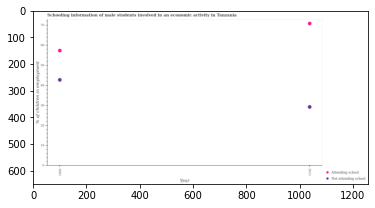

Number of QA =  23





,Year,Not attending school,Attending school
0,2011,29.339234,70.792770
1,2001,42.754097,57.336194


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed males who are not attending school in 2001 and that in 2011 ?
PREDICTED =  13.414863165039769
EXPECTED =  13.497772040735295




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed males who are not attending school in 2011 and the percentage of employed males who are attending school in 2001?
PREDICTED =  -13.414863165039769
EXPECTED =  -28.101072494735302




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the percentage of employed males who are attending school and percentage of empl

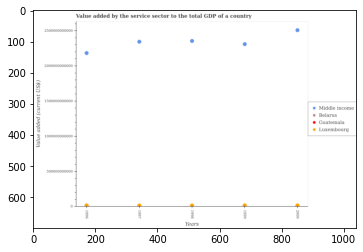

Number of QA =  29





,Years,Luxembourg,Belarus,Guatemala,Middle income
0,1998,1.756895e+10,NaN,NaN,2.355732e+12
1,1999,2.018352e+10,NaN,NaN,2.310976e+12
2,1996,1.950944e+10,NaN,NaN,2.184377e+12
3,2000,2.039252e+10,NaN,NaN,2.509798e+12
4,1997,1.719575e+10,NaN,NaN,2.345621e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the service sector to the total gdp in middle income in 1996 and that in 1997 ?
PREDICTED =  -161243534725.2373
EXPECTED =  -161798114461.82007




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the service sector to the total gdp in belarus in 1998 and the value added by the service sector to the total gdp in middle income in 2000?
PREDICTED =  -154065735341.14502
EXPECTED =  -2502361303497.5293




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the value added by the service sector to the total 

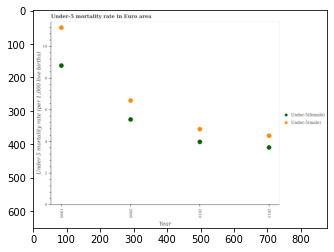

Number of QA =  27





,Year,Under-5(female),Under-5(male)
0,2015,3.630611,4.372369
1,2000,5.401460,6.582866
2,2010,3.987263,4.788528
3,1990,8.776947,11.164744


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 male mortality rate in 1990 and that in 2010 ?
PREDICTED =  6.376215876420179
EXPECTED =  6.40784283341084




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 male mortality rate in 2010 and the under-5 female mortality rate in 1990?
PREDICTED =  -6.376215876420179
EXPECTED =  -4.01209826003512




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the under-5 male mortality rate and under-5 female mortality rate ?
PREDICTED =  0.0
EXPECTED =  2.3957445733757208




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_

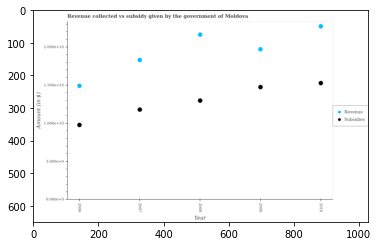

Number of QA =  27





,Year,Revenue,Subsidies
0,2009,1.976086,1.479902
1,2006,1.495467,0.983985
2,2010,2.276138,1.532376
3,2008,2.166344,1.302891
4,2007,1.833632,1.184474


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of subsidies given in 2006 and that in 2009 ?
PREDICTED =  -0.49591628816238453
EXPECTED =  -4968200000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of revenue collected in 2010 and the amount of subsidies given in 2006?
PREDICTED =  0.780670511606324
EXPECTED =  12945700000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount of subsidies given and amount of revenue collected ?
PREDICTED =  0.0
EXPECTED =  -6509200000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []

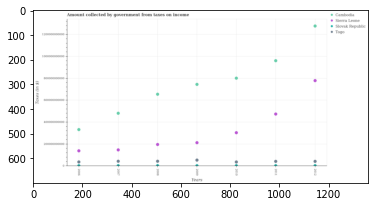

Number of QA =  29





,Years,Sierra Leone,Togo,Cambodia,Slovak Republic
0,2008,1.989003e+11,4.478575e+10,6.550832e+11,5.350526e+09
1,2009,2.143447e+11,5.617815e+10,7.445949e+11,5.861977e+09
2,2012,7.789967e+11,4.416956e+10,1.275456e+12,4.514658e+09
3,2011,4.748894e+11,4.349755e+10,9.605997e+11,5.748466e+09
4,2006,1.406134e+11,3.842789e+10,3.332319e+11,5.653885e+09
5,2010,3.056794e+11,3.843193e+10,8.016887e+11,5.627548e+09
6,2007,1.488363e+11,4.469727e+10,4.824334e+11,4.674191e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by government from taxes on income in sierra leone in 2009 and that in 2012 ?
PREDICTED =  -564652013466.5054
EXPECTED =  -566137000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by government from taxes on income in sierra leone in 2006 and the amount collected by government from taxes on income in cambodia in 2012?
PREDICTED =  -638383312898.0366
EXPECTED =  -1138392210693.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the amount collected by government from taxes on income i

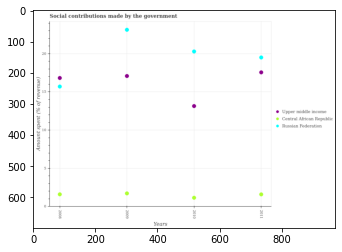

Number of QA =  28





,Years,Russian Federation,Central African Republic,Upper middle income
0,2011,19.688873,1.651153,17.725520
1,2009,23.336605,1.776366,17.250772
2,2008,15.846304,1.661990,16.967542
3,2010,20.472841,1.201580,13.285080


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the amount spent (in %) on social contributions in russian federation maximum?
PREDICTED =  502.25
EXPECTED =  2009




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the amount spent (in %) on social contributions in russian federation minimum?
PREDICTED =  502.0
EXPECTED =  2008




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent (in %) on social contributions in central african republic in 2008 and that in 2010 ?
PREDICTED =  0.4604098881811258
EXPECTED =  0.44954808662385015




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []


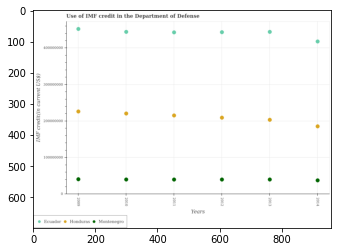

Number of QA =  28





,Years,Honduras,Ecuador,Montenegro
0,2010,2.204387e+08,4.422376e+08,4.066551e+07
1,2014,1.856636e+08,4.162303e+08,3.852896e+07
2,2009,2.257595e+08,4.501735e+08,4.133076e+07
3,2013,2.030667e+08,4.422570e+08,4.071083e+07
4,2011,2.151588e+08,4.409765e+08,4.058354e+07
5,2012,2.091478e+08,4.412495e+08,4.062396e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imf credit in the department of defense in montenegro in 2010 and that in 2014 ?
PREDICTED =  2136548.4792276397
EXPECTED =  2356000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imf credit in the department of defense in honduras in 2011 and the imf credit in the department of defense in ecuador in 2010?
PREDICTED =  -5279948.95002386
EXPECTED =  -228952000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the imf credit in the department of defense in montenegro and imf credit in the department of defense in ecuador ?


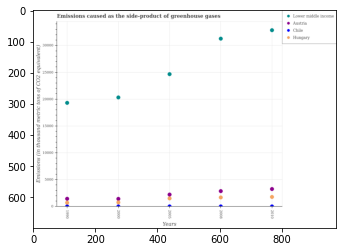

Number of QA =  29





,Years,Austria,Chile,Lower middle income,Hungary
0,2000,1502.640935,126.803824,20260.378206,853.769588
1,1990,1526.985106,143.718372,19238.808471,782.049938
2,2008,2950.794452,134.207120,31110.026881,1788.859593
3,2010,3338.811065,117.255713,32673.315650,1866.208065
4,2005,2308.308405,133.773594,24549.471565,1601.458614


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emissions caused as the side-product of greenhouse gases in lower middle income in 1990 and that in 2008 ?
PREDICTED =  -11871.218409564714
EXPECTED =  -11960.599999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emissions caused as the side-product of greenhouse gases in lower middle income in 2005 and the emissions caused as the side-product of greenhouse gases in austria in 2000?
PREDICTED =  4289.093359065257
EXPECTED =  23233.9




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the emissions caused as the side-p

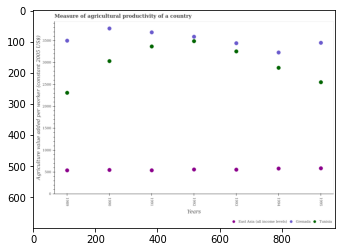

Number of QA =  28





,Years,East Asia (all income levels),Tunisia,Grenada
0,1990,566.142291,3057.523296,3804.876068
1,1992,575.131333,3512.624791,3615.929654
2,1994,596.234299,2904.116706,3254.472869
3,1993,569.903575,3279.849481,3466.711951
4,1989,556.314798,2332.730118,3525.148938
5,1995,600.636336,2573.901618,3475.674091
6,1991,556.352118,3392.576810,3716.445923


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the measure of agricultural productivity in grenada in 1989 and that in 1991 ?
PREDICTED =  -191.29698503255304
EXPECTED =  -190.01270701913018




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the measure of agricultural productivity in grenada in 1994 and the measure of agricultural productivity in east asia (all income levels) in 1989?
PREDICTED =  -270.676069167836
EXPECTED =  2689.9012732818464




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the measure of agricultural productivity in east asia (all income levels) and measure

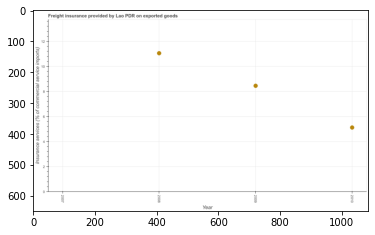

Number of QA =  22





,Year,Insurance services (% of commercial service imports)
0,2008,11.113608
1,2009,8.511847
2,2010,5.175620
3,2007,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the freight insurance in 2008 and 2009 ?
PREDICTED =  2.6017602793947088
EXPECTED =  2.6010059441193203




				 1 / 1 = 1.0


> what is the median freight insurance ?
PREDICTED =  None
EXPECTED =  6.787334428002155




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the freight insurance in 2009 to that in 2010 ?
PREDICTED =  1.6446042832693462
EXPECTED =  1.650865486995313




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest freight insurance ?
PREDICTED =  2.9689936457761252
EXPECTED =  2.6010059441193203




				 2 / 5 = 0.

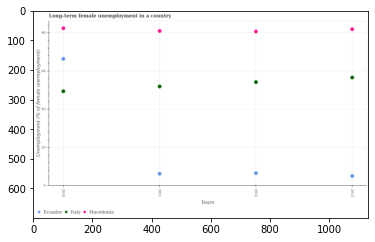

Number of QA =  28





,Years,Macedonia,Ecuador,Italy
0,2010,82.326841,66.373797,49.465975
1,2012,80.613039,6.737950,54.259485
2,2011,80.971228,6.425516,51.949513
3,2013,81.871391,5.240528,56.648021


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed female population in ecuador in 2011 and that in 2012 ?
PREDICTED =  -0.31243355438781695
EXPECTED =  -0.3000001907348606




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed female population in ecuador in 2011 and the percentage of long-term unemployed female population in italy in 2010?
PREDICTED =  -59.94828113151087
EXPECTED =  -43.20000171661376




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of long-term unemployed female population in

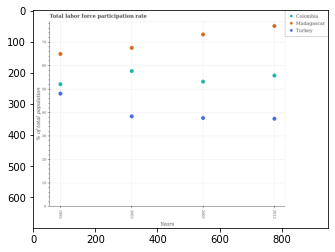

Number of QA =  28





,Years,Colombia,Madagascar,Turkey
0,2005,53.620956,73.789345,38.070183
1,2003,58.118357,68.052809,38.733598
2,1993,52.477520,65.460448,48.507521
3,2012,56.238908,77.400524,37.765228


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total labor force participation rate in madagascar in 1993 and that in 2012 ?
PREDICTED =  -11.940076524954236
EXPECTED =  -11.900001525878906




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total labor force participation rate in madagascar in 2003 and the total labor force participation rate in turkey in 2005?
PREDICTED =  -5.736535674273469
EXPECTED =  29.89999771118149




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the total labor force participation rate in madagascar and total labor force participation rate in col

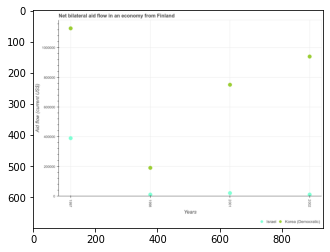

Number of QA =  27





,Years,Israel,Korea (Democratic)
0,2002,13357.757314,9.383911e+05
1,1998,13364.056582,1.930039e+05
2,1997,391056.948009,1.126983e+06
3,2001,23584.332925,7.490554e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in korea (democratic) in 2001 and that in 2002 ?
PREDICTED =  -189335.78432132828
EXPECTED =  -190000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in korea (democratic) in 1998 and the net bilateral aid flow in israel in 2001?
PREDICTED =  -556051.4373426825
EXPECTED =  170000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the net bilateral aid flow in israel and net bilateral aid flow in korea (democratic) ?
PREDICTED =  -2566070.196754303
EXPECTED =  -730000.0




	

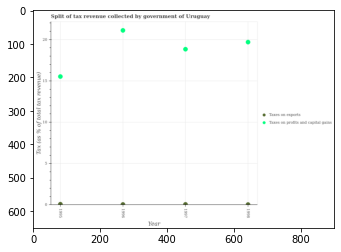

Number of QA =  27





,Year,Taxes on exports,Taxes on profits and capital gains
0,1996,0.118776,21.204260
1,1995,0.157124,15.616494
2,1997,0.135148,18.928832
3,1998,0.119973,19.787323


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on profits and capital gains in 1995 and that in 1996 ?
PREDICTED =  -21.06911183161617
EXPECTED =  -5.585089001642698




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on exports in 1998 and the percentage of revenue obtained from taxes on profits and capital gains in 1995?
PREDICTED =  -0.03715148157178469
EXPECTED =  -15.496069491284365




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of revenue obtained from taxes on profi

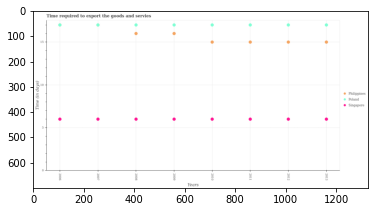

Number of QA =  28





,Years,Philippines,Poland,Singapore
0,2008,15.972179,16.968259,6.020997
1,2009,15.980647,16.970372,6.022068
2,2011,14.985699,16.972495,6.023244
3,2013,14.986187,16.975822,6.024460
4,2010,14.987953,16.974604,6.023055
5,2006,NaN,16.965939,6.023024
6,2007,NaN,16.968444,6.020634
7,2012,14.983183,16.978175,6.026927


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to export the goods and services in poland in 2008 and that in 2011 ?
PREDICTED =  6.0
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to export the goods and services in philippines in 2013 and the number of days required to export the goods and services in poland in 2007?
PREDICTED =  1.0
EXPECTED =  -2




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the number of days required to export the goods and services in philippines and number of days required to ex

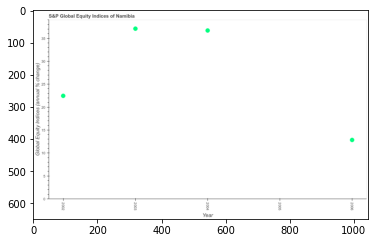

Number of QA =  22





,Year,Global Equity Indices (annual % change)
0,2003,37.328074
1,2002,22.647805
2,2004,36.933991
3,2006,13.035466
4,2005,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the s&p global equity indices in 2002 and 2003 ?
PREDICTED =  -14.680268756858474
EXPECTED =  -14.639999389599996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median s&p global equity indices ?
PREDICTED =  29.790898038478815
EXPECTED =  22.4599990845




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the s&p global equity indices in 2004 to that in 2006 ?
PREDICTED =  2.8333464587933586
EXPECTED =  2.8578143126302797




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







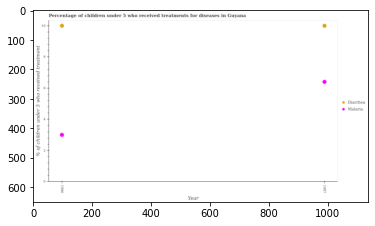

Number of QA =  23





,Year,Diarrhea,Malaria
0,1987,10.092939,6.470941
1,1986,10.093041,3.046580


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received treatment for malaria in 1986 and that in 1987 ?
PREDICTED =  -3.4243607335348942
EXPECTED =  -3.4000000000000004




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received treatment for diarrhoea in 1987 and the percentage of children who received treatment for malaria in 1986?
PREDICTED =  7.046359426046489
EXPECTED =  7.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the percentage of children who received treatment for malaria and percentage of children w

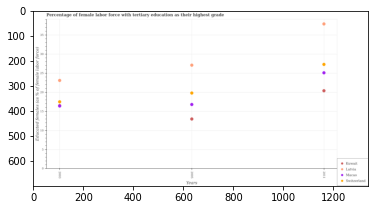

Number of QA =  29





,Years,Switzerland,Latvia,Macao,Kuwait
0,2003,17.613193,23.193456,16.564487,NaN
1,2005,19.902181,27.219555,16.911484,13.104181
2,2011,27.420342,38.016680,25.203813,20.505777


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with tertiary education in macao in 2003 and that in 2005 ?
PREDICTED =  -0.3469963234186402
EXPECTED =  -0.3999996185302024




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with tertiary education in latvia in 2011 and the percentage of female labor force with tertiary education in switzerland in 2005?
PREDICTED =  10.797125781677838
EXPECTED =  18.1000022888184




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of female labor force with terti

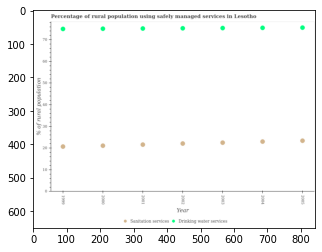

Number of QA =  27





,Year,Sanitation services,Drinking water services
0,1999,20.810683,74.723165
1,2005,23.423771,75.287844
2,2004,23.032397,75.175984
3,2002,22.186495,74.989275
4,2001,21.689837,74.864851
5,2003,22.577004,75.095192
6,2000,21.171772,74.753084


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population who used sanitation services in 1999 and that in 2005 ?
PREDICTED =  -2.613088620839747
EXPECTED =  -2.6999999999999993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population who used drinking water services in 2002 and the percentage of rural population who used sanitation services in 2005?
PREDICTED =  -0.29856927015633516
EXPECTED =  51.9




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of rural population who used drinking water services and percent

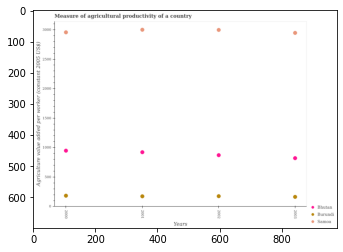

Number of QA =  28





,Years,Bhutan,Burundi,Samoa
0,2002,873.910996,181.702327,2993.935338
1,2001,925.909990,179.539556,2995.704733
2,2003,825.032245,169.339641,2944.181563
3,2000,949.605486,189.132763,2952.667750


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the measure of agricultural productivity in burundi in 2000 and that in 2002 ?
PREDICTED =  7.430436689028653
EXPECTED =  8.214447955461992




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the measure of agricultural productivity in burundi in 2002 and the measure of agricultural productivity in samoa in 2000?
PREDICTED =  -7.430436689028653
EXPECTED =  -2781.614886969182




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the measure of agricultural productivity in samoa and measure of agricultural productivity in bhutan ?
PREDICTED

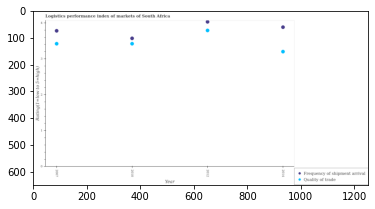

Number of QA =  27





,Year,Quality of trade,Frequency of shipment arrival
0,2014,3.214639,3.895565
1,2010,3.435511,3.584426
2,2012,3.802949,4.046333
3,2007,3.435184,3.794551


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi of frequency of shipment arrival in 2012 and that in 2014 ?
PREDICTED =  0.15076812854151678
EXPECTED =  0.14895900000000006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi of frequency of shipment arrival in 2014 and the lpi quality of trade in 2012?
PREDICTED =  -0.15076812854151678
EXPECTED =  0.09104100000000015




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the lpi of frequency of shipment arrival and lpi quality of trade ?
PREDICTED =  0.0
EXPECTED =  0.3599999999999999




				 1 / 3 = 0.3333


is_built_w

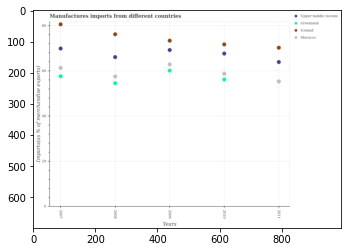

Number of QA =  29





,Years,Upper middle income,Greenland,Iceland,Morocco
0,2008,66.390855,54.887525,76.548161,57.788242
1,2011,64.243217,NaN,70.587171,55.628708
2,2009,69.563548,60.452999,73.691464,63.174725
3,2010,68.000408,56.479041,72.042881,59.007192
4,2007,70.248902,57.940882,80.869826,61.635337


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in morocco in 2007 and that in 2010 ?
PREDICTED =  2.628145381370935
EXPECTED =  2.5815083547940034




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in iceland in 2007 and the percentage of imports to different countries in greenland in 2009?
PREDICTED =  20.41682668566081
EXPECTED =  20.498037320620703




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of imports to different countries in upper middle income and percenta

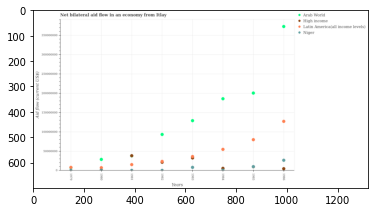

Number of QA =  28





,Years,Arab World,High income,Niger,Latin America(all income levels)
0,1983,1.297446e+08,3.377988e+07,9.261302e+06,3.692479e+07
1,1984,1.865408e+08,6.689730e+06,2.609296e+06,5.570912e+07
2,1981,NaN,3.914861e+07,1.561968e+06,1.643924e+07
3,1980,2.972510e+07,NaN,2.256684e+06,8.488791e+06
4,1986,3.732762e+08,5.834992e+06,2.765260e+07,1.281027e+08
5,1982,9.413674e+07,NaN,1.642670e+06,2.297528e+07
6,1979,NaN,NaN,2.183803e+06,8.973328e+06
7,1985,2.011651e+08,NaN,1.101708e+07,8.069570e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in latin america(all income levels) in 1981 and that in 1985 ?
PREDICTED =  -64256462.89902924
EXPECTED =  -64570000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in latin america(all income levels) in 1986 and the net bilateral aid flow in high income in 1980?
PREDICTED =  119613903.18359001
EXPECTED =  126210000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the net bilateral aid flow in niger and net bilateral aid flow in high income ?
PREDICTED =  1982.0
EXPECTED =

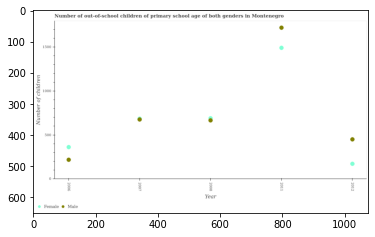

Number of QA =  27





,Year,Male,Female
0,2006,223.610852,367.357524
1,2008,692.069330,670.705078
2,2012,456.050845,178.370110
3,2011,1723.499809,1494.861653
4,2007,681.424646,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of female out-of-school students in 2007 and that in 2012 ?
PREDICTED =  -178.37010978584183
EXPECTED =  513




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of male out-of-school students in 2011 and the number of female out-of-school students in 2006?
PREDICTED =  1499.8889566863172
EXPECTED =  1358




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the number of female out-of-school students and number of male out-of-school students ?
PREDICTED =  1216.432711431258
EXPECTED =  -278




				 0 / 3 = 0.0


is_

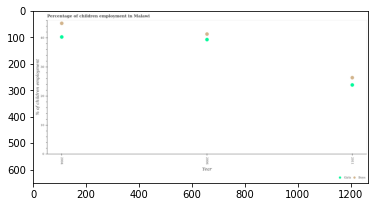

Number of QA =  27





,Year,Boys,Girls
0,2004,45.145847,40.423346
1,2006,41.452001,39.553692
2,2011,26.451748,23.933385


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed girls in 2004 and that in 2011 ?
PREDICTED =  16.489961452731123
EXPECTED =  16.499999999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed boys in 2011 and the percentage of employed girls in 2004?
PREDICTED =  -18.694098050251885
EXPECTED =  -13.999999999999996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of employed boys and percentage of employed girls ?
PREDICTED =  2.518363475642577
EXPECTED =  4.700000000000003




				 1 / 3 = 0.3333


is_built_w

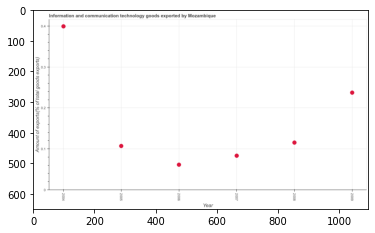

Number of QA =  24





,Year,Amount of exports(% of total goods exports)
0,2009,0.238197
1,2006,0.062768
2,2008,0.116781
3,2005,0.108484
4,2004,0.400056
5,2007,0.084696


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of ict goods exports in 2004 and 2008 ?
PREDICTED =  0.2832751830513973
EXPECTED =  0.2838200851




				 1 / 1 = 1.0


> what is the median amount of ict goods exports ?
PREDICTED =  None
EXPECTED =  0.11121518659999999




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of ict goods exports in 2005 to that in 2006 ?
PREDICTED =  1.7283373023718103
EXPECTED =  1.7453766268764865




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest amount of ict goods exports ?
PREDICTED =  0.2832751830513973
EXPECTED =  0

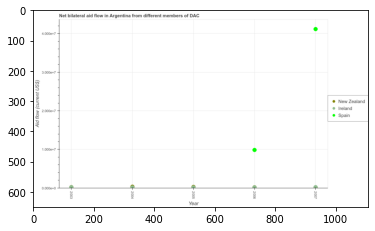

Number of QA =  27





,Year,Spain,lreland,New Zealand
0,2005,NaN,0.044973,NaN
1,2003,NaN,0.042112,NaN
2,2004,NaN,0.045392,NaN
3,2007,4.11219,0.039282,NaN
4,2006,0.99747,0.036267,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by new zealand in 2005 and that in 2006 ?
PREDICTED =  0.0
EXPECTED =  90000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by ireland in 2005 and the amount of aid provided by new zealand in 2004?
PREDICTED =  0.044972914551837634
EXPECTED =  -180000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of aid provided by new zealand in 2006 to 

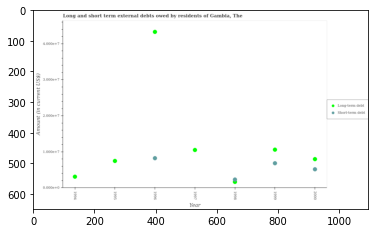

Number of QA =  26





,Year,Long-term debt,Short-term debt
0,1997,1.071779,NaN
1,2000,0.815749,0.533084
2,1996,4.367665,0.843690
3,1995,0.765203,NaN
4,1999,1.080573,0.702005
5,1998,0.178860,0.245193
6,1994,0.326465,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term debts owed by residents in 1994 and that in 1996 ?
PREDICTED =  -4.041200279595096
EXPECTED =  -40202000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term debts owed by residents in 1996 and the short-term debts owed by residents in 1995?
PREDICTED =  3.602461944154716
EXPECTED =  43295000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the long-term debts owed by residents in 19

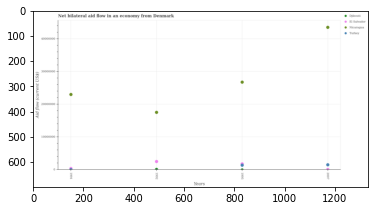

Number of QA =  27





,Years,Djibouti,E] Salvador,Turkey,Nicaragua
0,1995,1.849448e+06,8.876238e+04,1.402872e+06,2.685500e+07
1,2007,NaN,1.797542e+05,1.589819e+06,4.362008e+07
2,1991,NaN,3.455967e+05,NaN,2.307658e+07
3,1992,1.853865e+05,2.594073e+06,NaN,1.761424e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in el salvador in 1991 and that in 1995 ?
PREDICTED =  256834.30961962603
EXPECTED =  -1410000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in djibouti in 1991 and the net bilateral aid flow in el salvador in 1992?
PREDICTED =  0.0
EXPECTED =  -2440000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the net bilateral aid flow in turkey and net bilateral aid flow in el salvador ?
PREDICTED =  -3206191.5188154085
EXPECTED =  -400000.0




				 0 / 3 = 0.0


is_built_with

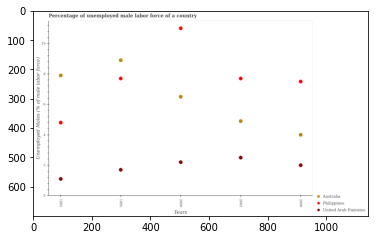

Number of QA =  28





,Years,Philippines,Australia,United Arab Emirates
0,1985,4.809263,7.894099,1.122539
1,2005,7.701035,4.913078,2.520924
2,2008,7.496819,4.013572,2.023869
3,1995,7.703367,8.892004,1.722844
4,2000,10.982009,6.501379,2.218557


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male labor force in australia in 1985 and that in 2000 ?
PREDICTED =  1.3927199784856334
EXPECTED =  1.400000095367429




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male labor force in australia in 1995 and the percentage of unemployed male labor force in philippines in 2000?
PREDICTED =  2.3906253248219054
EXPECTED =  -2.10000038146973




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of unemployed male labor force in united arab emirates and percentage of

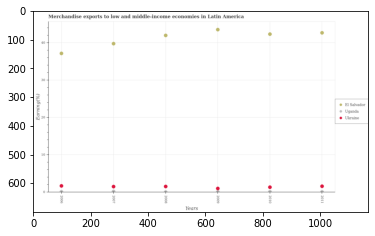

Number of QA =  28





,Years,Ukraine,Uganda,El Salvador
0,2006,1.801546,0.221745,37.294702
1,2011,1.707931,0.212366,42.824697
2,2008,1.657187,0.163908,42.117229
3,2007,1.660937,0.312335,39.943233
4,2010,1.466885,0.221618,42.478931
5,2009,1.118453,NaN,43.680636


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in el salvador in 2008 and that in 2010 ?
PREDICTED =  -0.36170149346910563
EXPECTED =  -0.3460709122800836




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in el salvador in 2009 and the percentage of amount earned from merchandise exports in ukraine in 2010?
PREDICTED =  1.2017054035779182
EXPECTED =  42.21982008291255




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of amount earned from merchandise e

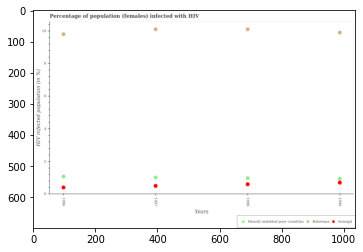

Number of QA =  28





,Years,Botswana,Heavily indebted poor countries,Senegal
0,1999,10.006301,0.984474,0.750504
1,1998,10.204982,1.020198,0.637034
2,1996,9.902936,1.115706,0.434768
3,1997,10.201992,1.058655,0.537565


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected female population in botswana in 1996 and that in 1999 ?
PREDICTED =  -0.10336505349678404
EXPECTED =  -0.09999999999999964




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected female population in senegal in 1998 and the percentage of hiv infected female population in heavily indebted poor countries in 1997?
PREDICTED =  0.09946961905175455
EXPECTED =  -0.41389343666800993




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percentage of hiv infected female population in 

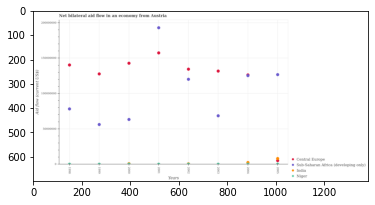

Number of QA =  28





,Years,Niger,India,Sub-Saharan Africa (developing only),Central Europe
0,1998,6.637853e+05,NaN,7.934208e+07,1.416837e+08
1,2000,1.312081e+06,NaN,6.416025e+07,1.441315e+08
2,2003,7.371496e+05,NaN,6.946982e+07,1.328904e+08
3,1999,6.905427e+05,NaN,5.704387e+07,1.288747e+08
4,2005,7.979724e+05,8.623070e+06,1.279345e+08,5.759008e+06
5,2004,NaN,2.903697e+06,1.269897e+08,NaN
6,2002,1.143523e+06,NaN,1.212092e+08,1.356371e+08
7,2001,7.582838e+05,NaN,1.946615e+08,1.588325e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in sub-saharan africa (developing only) in 2000 and that in 2001 ?
PREDICTED =  -130501260.92594841
EXPECTED =  -129630000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in sub-saharan africa (developing only) in 1999 and the net bilateral aid flow in central europe in 2000?
PREDICTED =  -7116379.656379528
EXPECTED =  -86610000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the net bilateral aid flow in central europe and net bilateral aid flow in sub-saharan africa (deve

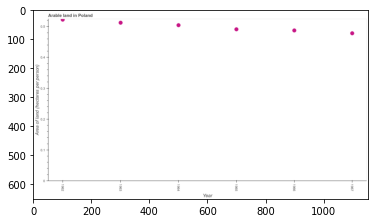

Number of QA =  24





,Year,Area of land (hectares per person)
0,1965,0.493934
1,1963,0.515249
2,1967,0.481156
3,1962,0.525494
4,1964,0.507332
5,1966,0.490421


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the area of arable land in 1966 and 1967 ?
PREDICTED =  0.009264812216420115
EXPECTED =  0.009196458454287015




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median area of arable land ?
PREDICTED =  1964.5
EXPECTED =  0.4975685746117695




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the area of arable land in 1964 to that in 1965 ?
PREDICTED =  1.027124692704578
EXPECTED =  1.02708025526182




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference b

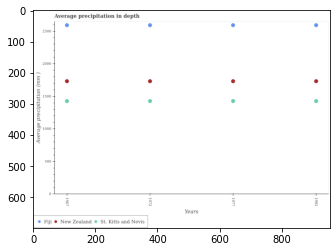

Number of QA =  28





,Years,St. Kitts and Nevis,Fiji,New Zealand
0,1972,1442.197858,2614.648398,1749.540683
1,1982,1443.073092,2614.748078,1749.722021
2,1967,1442.838519,2615.742927,1749.086934
3,1977,1442.199472,2614.366794,1749.132140


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average precipitation in new zealand in 1972 and that in 1982 ?
PREDICTED =  864.9263775124962
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average precipitation in st. kitts and nevis in 1967 and the average precipitation in fiji in 1972?
PREDICTED =  -1172.0711632930659
EXPECTED =  -1165




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1977, what is the difference between the average precipitation in fiji and average precipitation in new zealand ?
PREDICTED =  865.506105071318
EXPECTED =  860




				 2 / 3 = 0.6667


is_built_with_cuda: T

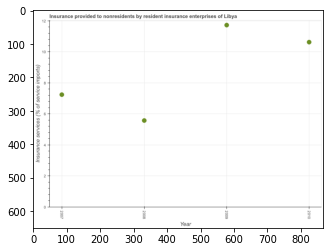

Number of QA =  24





,Year,Insurance services (% of service imports)
0,2007,7.339049
1,2008,5.663262
2,2009,11.866619
3,2010,10.754165


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance and financial services in 2009 and 2010 ?
PREDICTED =  -13.71501007116034
EXPECTED =  1.097890637116599




				 0 / 1 = 0.0


> what is the median insurance and financial services ?
PREDICTED =  None
EXPECTED =  8.9324930584817




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the insurance and financial services in 2008 to that in 2010 ?
PREDICTED =  0.5266110487888047
EXPECTED =  0.5245419444793943




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest insurance and financial services ?
PREDICTED =  0.0
EXPECTED 

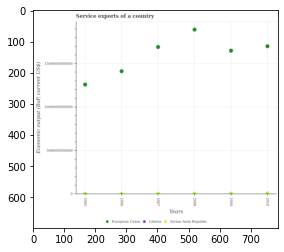

Number of QA =  28





,Years,Syrian Arab Republic,European Union,Liberia
0,2005,8.509763e+09,1.268798e+12,NaN
1,2008,1.021839e+10,1.904654e+12,NaN
2,2009,8.816791e+09,1.659997e+12,NaN
3,2007,8.894919e+09,1.702730e+12,NaN
4,2006,9.646797e+09,1.423569e+12,NaN
5,2010,1.238613e+10,1.711510e+12,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service exports in liberia in 2005 and that in 2007 ?
PREDICTED =  0.0
EXPECTED =  -132933737.90000004




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service exports in liberia in 2009 and the service exports in syrian arab republic in 2010?
PREDICTED =  0.0
EXPECTED =  -7058940369.1




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training o

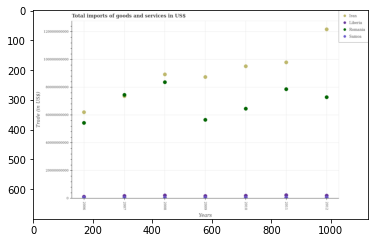

Number of QA =  29





,Years,Iran,Liberia,Samoa,Romania
0,2008,8.967435e+10,2.371906e+09,7.418449e+08,8.402391e+10
1,2007,2.095735e+09,NaN,4.562231e+08,7.494562e+10
2,2006,6.235711e+10,NaN,1.361739e+09,5.468048e+10
3,2010,9.555060e+10,2.222063e+09,1.150468e+09,6.495790e+10
4,2012,1.221364e+11,2.264466e+09,6.843872e+08,7.321956e+10
5,2011,9.829225e+10,2.623198e+09,7.808742e+08,7.897501e+10
6,2009,8.777303e+10,1.938797e+09,8.773940e+08,5.697348e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in samoa in 2007 and that in 2009 ?
PREDICTED =  -1333617114.9186032
EXPECTED =  9731317.226570964




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in samoa in 2011 and the total imports of goods and services in liberia in 2007?
PREDICTED =  -1237097275.4836578
EXPECTED =  -1376132081.9848971




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the total imports of goods and services in samoa and total imports of goods and services in iran ?
PREDICTED =  0

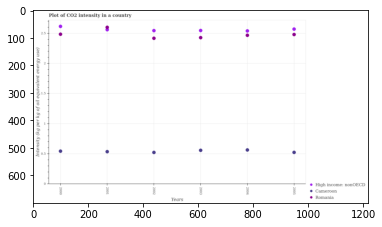

Number of QA =  28





,Years,High income: nonOECD,Cameroon,Romania
0,2003,2.559141,0.566121,2.440050
1,2001,2.572451,0.544949,2.611688
2,2005,2.583668,0.531137,2.492035
3,2004,2.552395,0.573040,2.479270
4,2002,2.558101,0.531374,2.429869
5,2000,2.626509,0.551978,2.496723


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 intensity in in high income: nonoecd in 2001 and that in 2002 ?
PREDICTED =  0.014349923700059275
EXPECTED =  0.015188799722530177




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 intensity in in romania in 2003 and the co2 intensity in in cameroon in 2005?
PREDICTED =  -0.051984737842696305
EXPECTED =  1.903572344193801




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the co2 intensity in in cameroon and co2 intensity in in romania ?
PREDICTED =  -0.4916058315590308
EXPECTED =  -1.8693237480674498




				 0 / 3 =

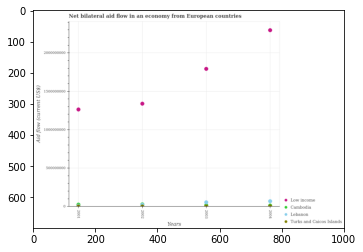

Number of QA =  28





,Years,Turks and Caicos Islands,Cambodia,Low income,Lebanon
0,2002,3.333924e+07,NaN,1.338845e+09,8.416889e+06
1,2003,1.699406e+07,NaN,1.789134e+09,6.018310e+07
2,2004,1.626603e+07,NaN,2.290687e+09,7.430703e+07
3,2001,1.377899e+07,3.135778e+07,1.262437e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in low income in 2001 and that in 2004 ?
PREDICTED =  -1028250276.0574207
EXPECTED =  -1032210000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in lebanon in 2002 and the net bilateral aid flow in cambodia in 2001?
PREDICTED =  8416889.174486754
EXPECTED =  -2200000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the net bilateral aid flow in cambodia and net bilateral aid flow in lebanon ?
PREDICTED =  -111549233.0096968
EXPECTED =  -56720000.0




				 1 / 3 = 0.3333




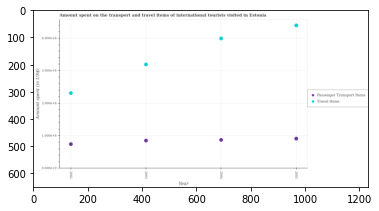

Number of QA =  27





,Year,Passenger Transport Items,Travel Items
0,2003,0.866002,3.214519
1,2005,0.927808,4.417766
2,2004,0.886275,4.018807
3,2002,0.755109,2.330123


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items in 2003 and that in 2004 ?
PREDICTED =  -0.020272950976281012
EXPECTED =  -2000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items in 2005 and the amount spent in travel items in 2004?
PREDICTED =  0.04153365980762902
EXPECTED =  -308000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the amount spent in travel items and amount spent on passenger transport items ?
PREDICTED =  0.0
EXPECTED =  157000000




				 0 / 3 = 0.0


is_built_w

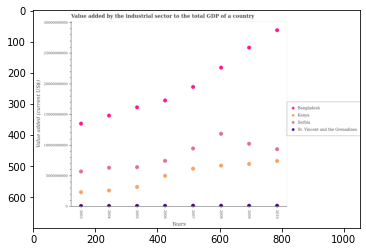

Number of QA =  29





,Years,Kenya,Serbia,St. Vincent and the Grenadines,Bangladesh
0,2004,2.704481e+09,6.435555e+09,1.604675e+08,1.498762e+10
1,2003,2.425425e+09,5.812863e+09,1.668917e+08,1.365500e+10
2,2008,6.791974e+09,1.200131e+10,1.980069e+08,2.284495e+10
3,2005,3.295833e+09,6.541948e+09,1.690970e+08,1.633396e+10
4,2010,7.548648e+09,9.472408e+09,2.004831e+08,2.898683e+10
5,2007,6.280387e+09,9.599978e+09,2.011108e+08,1.966686e+10
6,2006,5.112407e+09,7.570533e+09,1.822601e+08,1.745968e+10
7,2009,7.057386e+09,1.037278e+10,1.957004e+08,2.612962e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in bangladesh in 2004 and that in 2009 ?
PREDICTED =  -11142001060.89576
EXPECTED =  -11090799631.6706




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in st. vincent and the grenadines in 2003 and the value added by the industrial sector to the total gdp in serbia in 2009?
PREDICTED =  599600778.0109887
EXPECTED =  -10157269411.285437




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the value added by the industrial

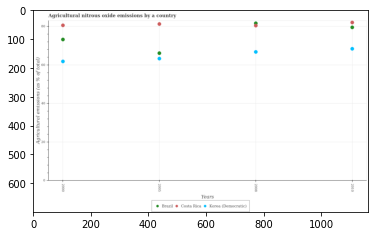

Number of QA =  28





,Years,Brazil,Costa Rica,Korea (Democratic)
0,2005,66.166084,81.178330,63.308451
1,2000,73.139086,80.523986,61.790580
2,2010,79.446220,81.973388,68.338556
3,2008,81.586017,80.365275,66.745754


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural nitrous oxide emitted in korea (democratic) in 2005 and that in 2010 ?
PREDICTED =  -5.030104465115642
EXPECTED =  -5.093611744510902




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural nitrous oxide emitted in costa rica in 2010 and the amount of agricultural nitrous oxide emitted in korea (democratic) in 2008?
PREDICTED =  1.6081129287989882
EXPECTED =  15.273350935683311




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount of agricultural nitrous oxide emitted in brazil 

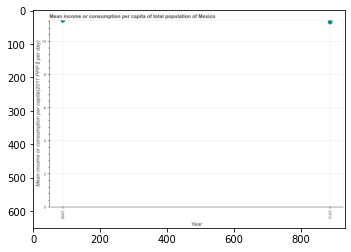

Number of QA =  20





,Year,Mean income or consumption per capita(2011 PPP $ per day)
0,2012,11.179088
1,2008,11.271513


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mean income or consumption in 2008 and 2012 ?
PREDICTED =  0.09242483918311173
EXPECTED =  0.09867522697209985




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median mean income or consumption ?
PREDICTED =  2010.0
EXPECTED =  11.21704772375855




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the mean income or consumption in 2008 to that in 2012 ?
PREDICTED =  1.008267654566271
EXPECTED =  1.008835761852498




				 1 / 3 = 0.3333


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Mean income or consumption per capita(2011 PPP $ p

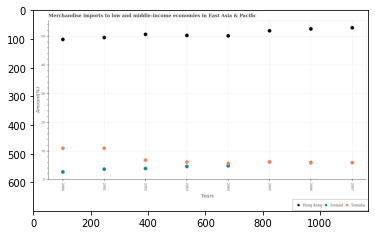

Number of QA =  28





,Years,Iceland,Hong Kong,Somalia
0,2006,NaN,52.695727,5.994093
1,2004,4.960847,50.261164,5.854383
2,2001,3.783532,49.619878,11.090929
3,2002,4.021190,50.776471,6.967232
4,2007,NaN,53.056726,6.085937
5,2005,NaN,52.027150,6.359221
6,2003,4.753820,50.354660,6.293822
7,2000,2.878335,48.946941,11.061445


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in somalia in 2001 and that in 2004 ?
PREDICTED =  5.236546837885627
EXPECTED =  5.26881449160166




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in iceland in 2006 and the percentage of amount earned from merchandise imports in hong kong in 2007?
PREDICTED =  -53.05672645612468
EXPECTED =  -47.023336567531466




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of amount earned from merchandise imports in 

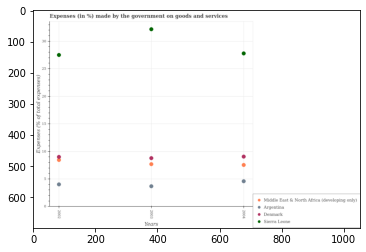

Number of QA =  29





,Years,Middle East & North Africa (developing only),Argentina,Sierra Leone,Denmark
0,2003,7.828794,3.801244,32.454295,8.949571
1,2004,7.680453,4.709240,28.045193,9.209787
2,2002,8.595497,4.150365,27.746788,9.138148


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on goods and services in sierra leone in 2002 and that in 2004 ?
PREDICTED =  -25.045193362628684
EXPECTED =  -0.2832070868646994




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on goods and services in argentina in 2004 and the percentage of expenses made by the government on goods and services in middle east & north africa (developing only) in 2003?
PREDICTED =  -4.680452844254738
EXPECTED =  -3.10129829861825




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, w

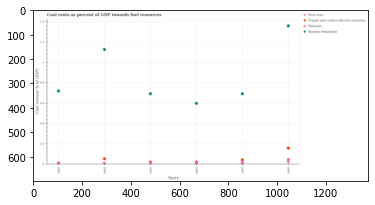

Number of QA =  29





,Years,Fragile and conflict affected situations,Russian Federation,Euro area,Malaysia
0,2001,NaN,0.718226,NaN,0.013611
1,2005,NaN,0.691711,NaN,0.023046
2,2006,NaN,0.597570,NaN,0.023164
3,2004,0.057684,1.123136,NaN,0.010401
4,2008,0.160684,1.353637,0.027853,0.049522
5,2007,0.045373,0.690776,NaN,0.017725


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum coal rent in russian federation ?
PREDICTED =  334.6666666666667
EXPECTED =  1.35928855301195




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the coal rent in fragile and conflict affected situations in 2007 and that in 2008 ?
PREDICTED =  2006.1272758318821
EXPECTED =  -0.11618791933059242




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the coal rent in russian federation in 2005 and the coal rent in euro area in 2007?
PREDICTED =  0.16666666666666666
EXPECTED =  0.6873307167039946




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_av

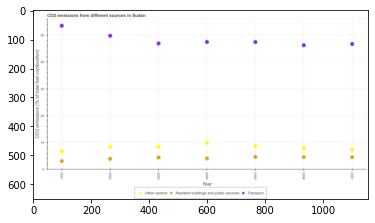

Number of QA =  28





,Year,Resident buildings and public services,Transport,Other sectors
0,2007,4.688462,47.037214,7.593763
1,2004,4.229857,47.798946,10.112497
2,2003,4.604422,47.211195,8.654468
3,2001,3.233012,53.866462,6.886859
4,2006,4.713422,46.563318,7.974026
5,2005,4.852268,47.787336,8.832189
6,2002,4.054131,50.110743,8.486096


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from other sectors in 2003 and that in 2006 ?
PREDICTED =  0.6804423916281701
EXPECTED =  0.6750176508991803




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from other sectors in 2005 and the percentage of co2 emissions from transport in 2004?
PREDICTED =  -1.2803077593511283
EXPECTED =  -38.8890875286041




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of co2 emissions from other sectors and percentage of co2 emissions from transport ?
PREDICTED =  -3

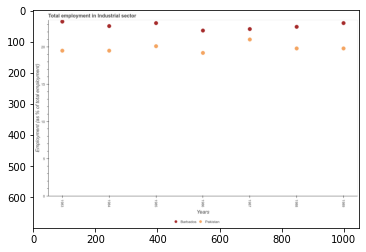

Number of QA =  27





,Years,Pakistan,Barbados
0,1986,19.245735,22.242770
1,1989,19.850509,23.243778
2,1984,19.541721,22.842629
3,1983,19.546859,23.424270
4,1985,20.137817,23.236218
5,1988,19.846748,22.748083
6,1987,21.046087,22.440738


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in industrial sector in barbados in 1986 and that in 1988 ?
PREDICTED =  -0.5053125318199214
EXPECTED =  -0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in industrial sector in pakistan in 1986 and the employment in industrial sector in barbados in 1987?
PREDICTED =  -1.8003515749641252
EXPECTED =  -3.1999988555908097




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1989, what is the difference between the employment in industrial sector in barbados and employment in industrial sector in pakistan ?
PREDICTED =  -1963.1173591834163


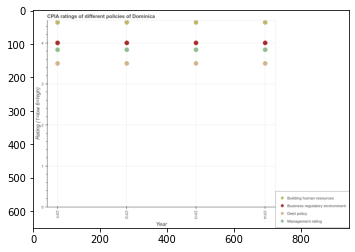

Number of QA =  29





,Year,Business regulatory environment,Debt policy,Management rating,Building human resources
0,2014,4.026514,3.527888,3.861285,4.530249
1,2011,4.026962,3.530218,3.861525,4.527820
2,2013,4.025675,3.527245,3.862291,4.529344
3,2012,4.027410,3.526597,3.860961,4.531739


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of debt policy in 2012 and that in 2014 ?
PREDICTED =  -0.0012910256569909073
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of management in 2014 and the cpia rating of building human resources in 2013?
PREDICTED =  -0.0010054104801366925
EXPECTED =  -0.6666699999999999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the cpia rating of management and cpia rating of business regulatory environment ?
PREDICTED =  -0.16425227242105755
EXPECTED =  -0.16666666666667096




				 1 / 3 

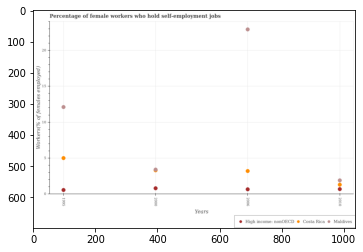

Number of QA =  28





,Years,Maldives,High income: nonOECD,Costa Rica
0,1995,12.224140,0.643103,5.107854
1,2000,3.427385,0.880561,NaN
2,2006,23.066451,0.752714,3.297428
3,2010,1.990317,0.767539,1.400284


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in high income: nonoecd in 1995 and that in 2010 ?
PREDICTED =  -0.12443594725431739
EXPECTED =  -0.12385784045304993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in costa rica in 2006 and the percentage of self-employed female workers in maldives in 1995?
PREDICTED =  -1.8104265264488753
EXPECTED =  -8.90000033378598




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of self-employed female workers in high income: nonoec

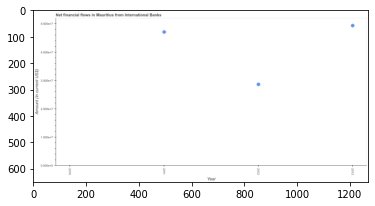

Number of QA =  22





,Year,Amount (in current US$)
0,2012,2.863186
1,2010,NaN
2,2013,4.923212
3,2011,4.697398


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net financial flows from ibrd in 2011 and 2013 ?
PREDICTED =  -0.22581454489304598
EXPECTED =  -2264000




				 0 / 1 = 0.0


> what is the median net financial flows from ibrd ?
PREDICTED =  None
EXPECTED =  37849500.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net financial flows from ibrd in 2011 to that in 2013 ?
PREDICTED =  0.9541326815464608
EXPECTED =  0.9541291838884837




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest net financial flows from ibrd ?
PREDICTED =  2008.3026022772785
EXPECTED =  226400

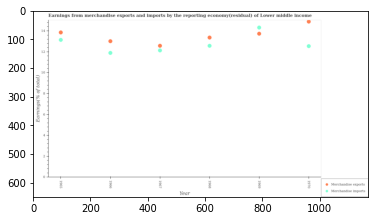

Number of QA =  27





,Year,Merchandise exports,Merchandise imports
0,1966,12.982070,11.868846
1,1970,14.851943,12.514541
2,1969,13.703509,14.278789
3,1968,13.332088,12.553199
4,1967,12.556865,12.109715
5,1965,13.820402,13.112399


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 1965 and that in 1967 ?
PREDICTED =  1.263537006543837
EXPECTED =  1.275247814503901




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 1966 and the earnings from merchandise exports in 1968?
PREDICTED =  -0.6843530460149445
EXPECTED =  -1.4709006333209




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the earnings from mercha

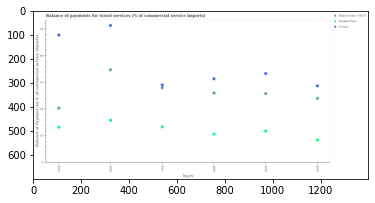

Number of QA =  28





,Years,High income: OECD,Tuvalu,Burkina Faso
0,2006,34.840435,51.475705,15.931720
1,2008,26.163605,31.498050,10.742808
2,2009,25.946173,33.478109,11.855932
3,2010,24.170913,28.827361,8.562695
4,2005,20.439964,47.900937,13.341495
5,2007,28.112665,29.134436,13.448570


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in tuvalu in 2005 and that in 2009 ?
PREDICTED =  14.42282767614585
EXPECTED =  14.447253548799694




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in tuvalu in 2006 and the balance of payments for travel services in burkina faso in 2008?
PREDICTED =  3.3423853869947635
EXPECTED =  40.7380625396585




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the balance of payments for travel services in burkina faso and balance of payments for travel serv

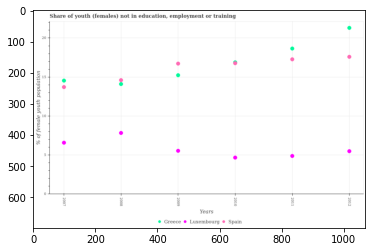

Number of QA =  28





,Years,Greece,Spain,Luxembourg
0,2011,18.601209,17.224764,4.913978
1,2007,14.503990,13.701435,6.598277
2,2009,15.207575,16.680188,5.569347
3,2008,14.060052,14.581180,7.844268
4,2010,NaN,16.715129,4.702709
5,2012,21.231081,17.549496,5.518054


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female population in in spain in 2009 and that in 2011 ?
PREDICTED =  -0.5445751486916173
EXPECTED =  -0.550001144409201




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female population in in spain in 2010 and the percentage of unemployed female population in in greece in 2012?
PREDICTED =  -0.8343673416347492
EXPECTED =  -4.5299987792968




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of unemployed female population in in luxembourg and percentage of unem

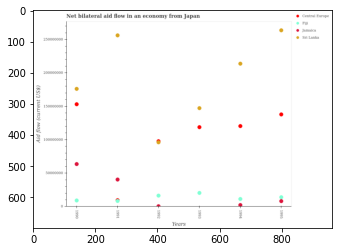

Number of QA =  28





,Years,Jamaica,Fiji,Sri Lanka,Central Europe
0,1994,2.850213e+06,1.219370e+07,2.151558e+08,1.215815e+08
1,1993,NaN,2.119533e+07,1.484511e+08,1.197798e+08
2,1991,4.116627e+07,1.024843e+07,2.577021e+08,NaN
3,1990,6.443221e+07,9.918639e+06,1.772323e+08,1.541858e+08
4,1992,1.301026e+06,1.707018e+07,9.890508e+07,NaN
5,1995,8.822984e+06,1.461350e+07,2.653190e+08,1.389933e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in central europe in 1993 and that in 1994 ?
PREDICTED =  -1801677.5045705885
EXPECTED =  -1640000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in fiji in 1991 and the net bilateral aid flow in central europe in 1994?
PREDICTED =  -1945276.090557212
EXPECTED =  -112120000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the net bilateral aid flow in sri lanka and net bilateral aid flow in jamaica ?
PREDICTED =  1162765367.2949753
EXPECTED =  215800000.0




				 0 / 3 =

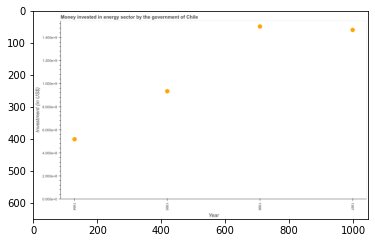

Number of QA =  24





,Year,Investment (in US$)
0,1995,0.941099
1,1996,1.504128
2,1997,1.474150
3,1994,0.524852


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investment in energy in 1994 and 1997 ?
PREDICTED =  -0.9492979444202791
EXPECTED =  -947000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median investment in energy ?
PREDICTED =  1.2076245147052234
EXPECTED =  1199400000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the investment in energy in 1994 to that in 1997 ?
PREDICTED =  0.3560371982631824
EXPECTED =  0.3535836177474403




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference 

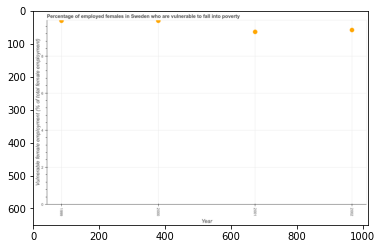

Number of QA =  24





,Year,Vulnerable female employment (% of total female employment)
0,1999,9.943272
1,2002,9.440341
2,2001,9.344012
3,2000,9.945832


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed females who are vulnerable to fall into poverty in 2000 and 2001 ?
PREDICTED =  0.6018207822446531
EXPECTED =  0.5999994277954102




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of employed females who are vulnerable to fall into poverty ?
PREDICTED =  2000.5
EXPECTED =  9.64999961853027




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of employed females who are vulnerable to fall into poverty in 2000 to that in 2002 ?
PREDICTED =  0.9897960355282995
EXPECTED =  1.053191491520313




				 1 / 3 = 0.3333


is_built_w

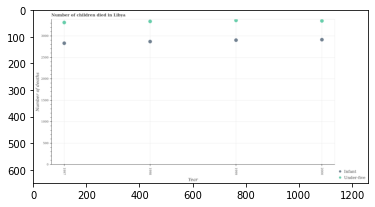

Number of QA =  27





,Year,Infant,Under-five
0,1999,2897.285643,3353.713289
1,1998,2863.704834,3331.217458
2,1997,2826.144079,3306.563911
3,2000,2908.454074,3342.493603


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in 1999 and that in 2000 ?
PREDICTED =  3352.7132888770007
EXPECTED =  11




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths in 2000 and the number of under-five deaths in 1998?
PREDICTED =  44.74923992183403
EXPECTED =  -426




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the number of under-five deaths and number of infant deaths ?
PREDICTED =  0.0
EXPECTED =  470




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...


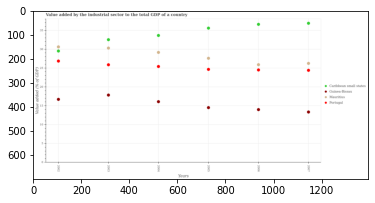

Number of QA =  29





,Years,Portugal,Caribbean small states,Mauritius,Guinea-Bissau
0,2005,24.755671,35.698227,27.718817,14.583499
1,2006,24.615009,36.703499,26.017449,14.086712
2,2004,25.509145,33.771346,29.262409,16.196933
3,2003,25.981748,32.626633,30.408724,17.939055
4,2002,26.944863,29.648375,30.720987,16.818002
5,2007,24.495625,37.005978,26.362682,13.452486


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in mauritius in 2003 and that in 2004 ?
PREDICTED =  1.1463147851845612
EXPECTED =  1.1472061177088975




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in guinea-bissau in 2006 and the value added by the industrial sector to the total gdp in mauritius in 2007?
PREDICTED =  0.6342264333927901
EXPECTED =  -12.255445756437402




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the value added by the industrial sector to th

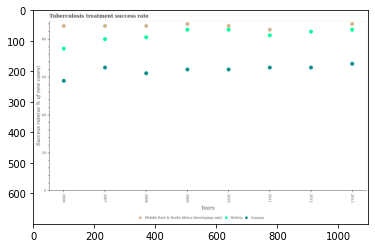

Number of QA =  28





,Years,Bolivia,Guyana,Middle East & North Africa (developing only)
0,2008,81.226217,62.249533,87.249644
1,2009,85.254639,64.252625,88.191558
2,2006,75.216257,58.215603,87.194941
3,2011,82.229779,65.239538,85.198634
4,2012,84.258115,65.244227,NaN
5,2013,85.158782,67.258148,88.251044
6,2010,85.194652,64.235501,87.265336
7,2007,80.217863,65.263810,87.239245


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in guyana in 2007 and that in 2012 ?
PREDICTED =  0.019582987139898478
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in guyana in 2006 and the tuberculosis treatment success rate in bolivia in 2007?
PREDICTED =  -7.048207240128399
EXPECTED =  -22.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the tuberculosis treatment success rate in bolivia and tuberculosis treatment success rate in guyana ?
PREDICTED =  11.221384179994573
EXPE

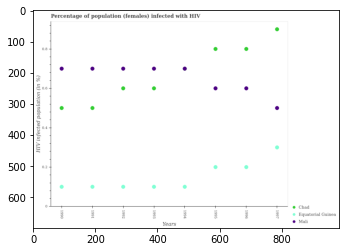

Number of QA =  28





,Years,Mali,Equatorial Guinea,Chad
0,1991,0.703893,0.102910,0.503849
1,1990,0.703985,0.102846,0.503877
2,1994,0.704645,0.102719,NaN
3,1995,0.604298,0.203232,0.804652
4,1993,0.704292,0.102538,0.604335
5,1992,0.704121,0.102810,0.604223
6,1997,0.503787,0.303184,0.905271
7,1996,0.604281,0.203100,0.804791


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected female population in mali in 1995 and that in 1997 ?
PREDICTED =  0.10051192050019164
EXPECTED =  0.09999999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected female population in equatorial guinea in 1994 and the percentage of hiv infected female population in mali in 1996?
PREDICTED =  -0.40106801912304074
EXPECTED =  -0.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the percentage of hiv infected female population in mali and percentage of hiv infected fe

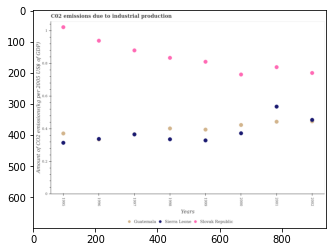

Number of QA =  28





,Years,Sierra Leone,Guatemala,Slovak Republic
0,1998,0.337632,0.404103,0.835547
1,2000,0.374351,0.425154,0.733252
2,1999,0.330355,0.396697,0.811562
3,1997,0.367320,NaN,0.880926
4,1996,0.338978,NaN,0.939895
5,1995,0.315761,0.373104,1.022999
6,2002,0.454840,NaN,0.742854
7,2001,0.537192,0.444970,0.778352


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted due to industrial production in slovak republic in 1995 and that in 1999 ?
PREDICTED =  0.2114374832609457
EXPECTED =  0.21185499613380587




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted due to industrial production in sierra leone in 1995 and the amount of co2 emitted due to industrial production in guatemala in 2000?
PREDICTED =  -0.05858998793898618
EXPECTED =  -0.10915599234256312




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the amount of co2 emitted due to industrial pr

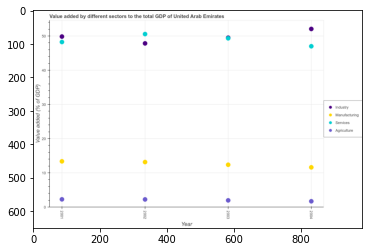

Number of QA =  29





,Year,Industry,Agriculture,Manufacturing,Services
0,2001,49.932311,2.407872,13.515879,48.354632
1,2004,52.179096,1.865756,11.760204,47.131333
2,2002,47.979693,2.392545,13.313394,50.686580
3,2003,NaN,2.113726,12.507705,49.496580


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in 2002 and that in 2004 ?
PREDICTED =  0.5267889494327298
EXPECTED =  0.5391576179218098




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing sector in 2003 and the value added by agricultural sector in 2001?
PREDICTED =  -1.0081741283394443
EXPECTED =  10.10922929663919




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the value added by manufacturing sector and value added by industrial sector ?
PREDICTED =  39.33697881628136
EXPECTED =  -34.69129643026419




	

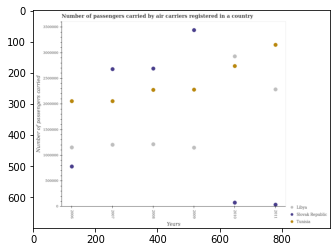

Number of QA =  28





,Years,Libya,Tunisia,Slovak Republic
0,2008,1.214098e+06,2.267609e+06,2.679305e+06
1,2011,2.278616e+06,3.141370e+06,4.167876e+04
2,2009,1.148315e+06,2.272222e+06,3.427704e+06
3,2006,1.152909e+06,2.049152e+06,7.830818e+05
4,2007,1.205037e+06,2.050247e+06,2.668731e+06
5,2010,2.917929e+06,2.730100e+06,8.533196e+04


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of passengers carried by air carriers in tunisia in 2006 and that in 2011 ?
PREDICTED =  -1092217.9377453888
EXPECTED =  -1098747.9766098899




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of passengers carried by air carriers in tunisia in 2009 and the number of passengers carried by air carriers in libya in 2010?
PREDICTED =  -457877.5624721721
EXPECTED =  -649741.6798501802




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the number of passengers carried by air carriers in tunisia and number of passengers

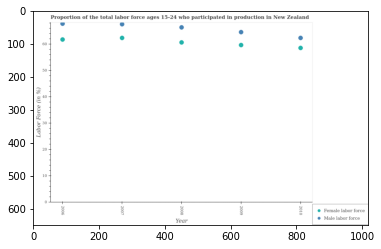

Number of QA =  27





,Year,Male labor force,Female labor force
0,2009,64.889936,60.003059
1,2008,66.699158,60.977970
2,2007,67.867807,62.671770
3,2010,62.664667,58.896842
4,2006,68.084323,62.097848


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in 2008 and that in 2010 ?
PREDICTED =  2.0811282937928652
EXPECTED =  2.099998474121101




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in 2007 and the percentage of male labour force in 2008?
PREDICTED =  1.6937999021806078
EXPECTED =  -4.000003814697301




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of male labour force and percentage of female labor force ?
PREDICTED =  9.187480708466083
EXPECTED =  4.900001525878899




				 1 / 3 = 0.

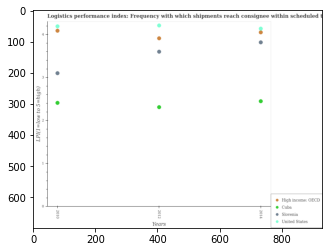

Number of QA =  29





,Years,Slovenia,High income: OECD,United States,Cuba
0,2014,3.831740,4.062587,4.152279,2.461902
1,2012,3.613543,3.926406,4.224504,2.322141
2,2010,3.116274,4.103270,4.204585,2.422503


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistics performance index in slovenia in 2010 and that in 2012 ?
PREDICTED =  -0.49726914150631263
EXPECTED =  -0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistics performance index in united states in 2014 and the logistics performance index in high income: oecd in 2012?
PREDICTED =  -0.0722253131691204
EXPECTED =  0.22488209677419002




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of

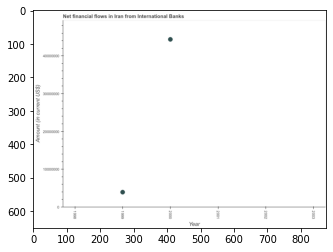

Number of QA =  18





,Year,Amount (in current US$)
0,1998,NaN
1,1999,4.089618e+06
2,2001,NaN
3,2002,NaN
4,2000,4.435984e+07
5,2003,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net financial flows from ibrd in 1999 and 2000 ?
PREDICTED =  -40270226.55358544
EXPECTED =  -40428000




				 1 / 1 = 1.0


> what is the median net financial flows from ibrd ?
PREDICTED =  None
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest net financial flows from ibrd ?
PREDICTED =  4087616.946248655
EXPECTED =  44355000




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Amount (in current US$)
EXPECTED =  10000000.0




				 1 / 5 = 0.2


> what is the title of the graph ?
PREDICTED =  Net financial flows in Iran from International Banks
EXPECTED =  Net financial flo

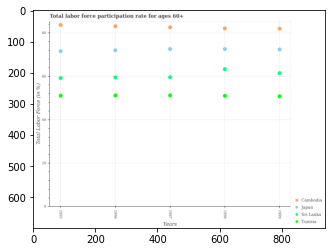

Number of QA =  29





,Years,Tunisia,Cambodia,Sri Lanka,Japan
0,1999,50.759659,81.834753,61.434955,72.260747
1,1996,51.139947,82.902890,59.460161,71.824764
2,1998,50.996868,81.904400,63.210829,72.453834
3,1995,51.086772,83.506704,59.153094,71.472890
4,1997,51.161527,82.439104,59.544185,72.461028


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in tunisia in 1995 and that in 1997 ?
PREDICTED =  -0.0747552996346883
EXPECTED =  -0.10000228881840201




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in cambodia in 1998 and the labor force participation rate in tunisia in 1996?
PREDICTED =  -0.998489780369539
EXPECTED =  30.89999771118149




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the labor force participation rate in cambodia and labor force participation rate in sri lanka ?
PREDICTED =  76.8347531290

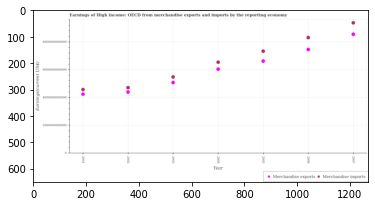

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,2004,6.573833e+12,6.068790e+12
1,2007,9.409504e+12,8.581836e+12
2,2005,7.369396e+12,6.651246e+12
3,2002,4.747068e+12,4.423561e+12
4,2006,8.344381e+12,7.486048e+12
5,2003,5.510572e+12,5.109203e+12
6,2001,4.599206e+12,4.277847e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 2003 and that in 2006 ?
PREDICTED =  -2376844862334.924
EXPECTED =  -2377103615874.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 2003 and the earnings from merchandise exports in 2007?
PREDICTED =  -3898932561485.7285
EXPECTED =  -3067127356803.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the earnings from merchandise imports and earnings from merchandise exports ?
PREDICTED =  827668478286.5215
EXPECTED =  713035571425.0




				 1 / 3 = 

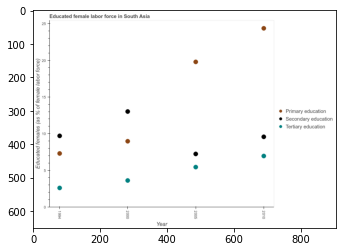

Number of QA =  28





,Year,Primary educatior,Secondary education,Tertiary education
0,2000,9.021056,13.047272,3.700064
1,1994,7.348125,9.742468,2.678877
2,2005,19.783201,7.282305,5.501463
3,2010,24.344622,9.627206,7.017686


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received tertiary education in 2005 and that in 2010 ?
PREDICTED =  -1.5162226391824785
EXPECTED =  -1.5125389807917617




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in 2000 and the percentage of female labor force who received tertiary education in 2005?
PREDICTED =  5.764966694379393
EXPECTED =  7.577210236456869




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of female labor force who received tertia

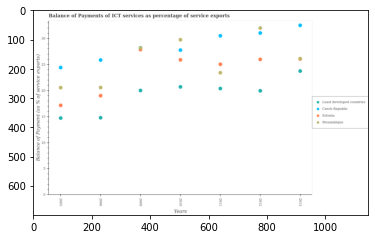

Number of QA =  29





,Years,Estonia,Least developed countries,Czech Republic,Mozambique
0,2006,19.139611,14.912271,26.002779,20.719554
1,2012,26.140517,20.091001,31.210974,32.157842
2,2013,NaN,23.895016,32.669241,26.254195
3,2010,26.055209,20.847174,27.916194,29.916333
4,2011,25.183987,20.524009,30.654915,23.559461
5,2005,17.285989,14.841879,24.554662,20.692181
6,2009,NaN,20.154236,28.005482,28.304561


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of ict services in estonia in 2005 and that in 2012 ?
PREDICTED =  -8.854527575538317
EXPECTED =  -8.8203607728278




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of ict services in estonia in 2011 and the balance of payments of ict services in least developed countries in 2009?
PREDICTED =  25.183987358214694
EXPECTED =  5.033086143655101




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the balance of payments of ict services in czech republic and balance of payments of ict service

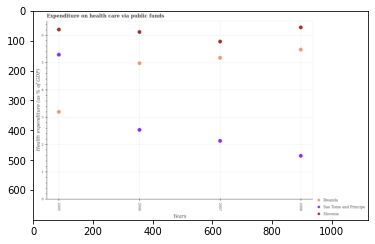

Number of QA =  28





,Years,Rwanda,Slovenia,Sao Tome and Principe
0,2005,3.218712,6.236495,5.315903
1,2008,5.504004,6.316273,1.613416
2,2006,5.002965,6.143870,2.560704
3,2007,5.198894,5.797724,2.155123


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure made on health care in rwanda in 2005 and that in 2006 ?
PREDICTED =  -1.7842535962262884
EXPECTED =  -1.78067586111402




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the expenditure made on health care in sao tome and principe in 2005 to that in 2007?
PREDICTED =  2.466635785370033
EXPECTED =  2.4759273609108297




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_avail

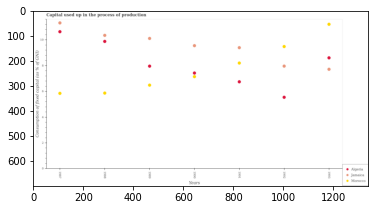

Number of QA =  28





,Years,Algeria,Jamaica,Morocco
0,1993,8.600510,7.711562,11.197426
1,1990,7.424750,9.542308,7.137773
2,1989,7.955485,10.100746,6.485255
3,1992,5.551166,7.957733,9.470057
4,1987,10.619083,11.298976,5.844614
5,1988,9.871638,10.333177,5.871660
6,1991,6.748476,9.389254,8.198871


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the capital used up in the process of production in morocco in 1990 and that in 1991 ?
PREDICTED =  -1.0610987451327718
EXPECTED =  -1.0560438093846




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the capital used up in the process of production in morocco in 1993 and the capital used up in the process of production in jamaica in 1989?
PREDICTED =  4.7121715468047745
EXPECTED =  1.0994890078098987




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the capital used up in the process of production in morocco and capital used up in th

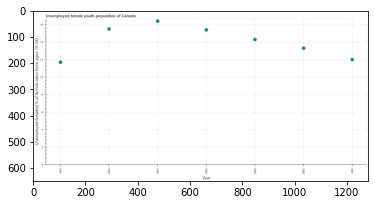

Number of QA =  24





,Year,Unemployed females(% of female labor force ages 15-24)
0,1984,15.605430
1,1981,11.857600
2,1985,14.485305
3,1986,13.484961
4,1982,15.698039
5,1987,12.162950
6,1983,16.605231


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth in 1981 and 1985 ?
PREDICTED =  -2.627704903898909
EXPECTED =  -2.600000381469801




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed female youth ?
PREDICTED =  1984.0
EXPECTED =  14.3000001907349




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed female youth in 1981 to that in 1987 ?
PREDICTED =  0.9748950831333811
EXPECTED =  0.974999984105425




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the diff

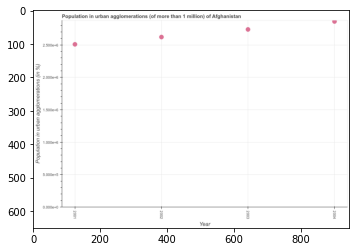

Number of QA =  24





,Year,Population in urban agglomerations (in %)
0,2003,2.769666
1,2001,2.537454
2,2004,2.894173
3,2002,2.651048


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the population in urban agglomerations in 2003 ?
PREDICTED =  1.0208547318368055
EXPECTED =  2738161




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum population in urban agglomerations ?
PREDICTED =  1.0667461033745453
EXPECTED =  2860946




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum population in urban agglomerations ?
PREDICTED =  737.5367221867741
EXPECTED =  2508477




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the populat

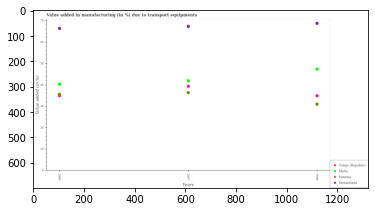

Number of QA =  29





,Years,Malta,Switzerland,Congo (Republic),Panama
0,1988,47.000384,68.167399,34.714174,30.830376
1,1987,41.647246,66.780474,39.141474,36.156113
2,1986,40.020785,65.767308,35.425335,34.689305


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in malta in 1986 and that in 1987 ?
PREDICTED =  -1.6264606408530042
EXPECTED =  -1.6171089119243973




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in congo (republic) in 1988 and the percentage of value added in manufacturing due to transport equipments in malta in 1986?
PREDICTED =  -0.7111613929695437
EXPECTED =  -5.3554406752312005




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1986, what is the difference betwe

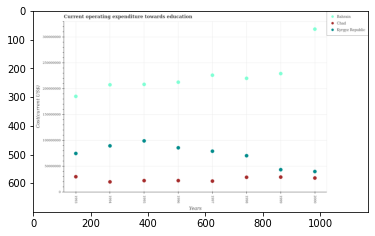

Number of QA =  28





,Years,Bahrain,Kyrgyz Republic,Chad
0,1994,2.088017e+08,9.042477e+07,2.074141e+07
1,1993,1.861422e+08,7.570438e+07,3.076012e+07
2,1999,2.303797e+08,4.435524e+07,2.990461e+07
3,1998,2.211865e+08,7.134536e+07,2.960509e+07
4,1996,2.137637e+08,8.667101e+07,2.314160e+07
5,2000,3.163513e+08,4.080906e+07,2.818464e+07
6,1995,2.094924e+08,9.988793e+07,2.312265e+07
7,1997,2.272768e+08,7.999005e+07,2.213003e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure towards education in bahrain in 1998 and that in 2000 ?
PREDICTED =  -95164824.8412
EXPECTED =  -95128361.254222




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure towards education in bahrain in 1995 and the expenditure towards education in chad in 1996?
PREDICTED =  -4271273.524176866
EXPECTED =  186095412.66000003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the expenditure towards education in chad and expenditure towards education in kyrgyz republic ?
PREDICTED =  -36517408.78685516
EXPECTED 

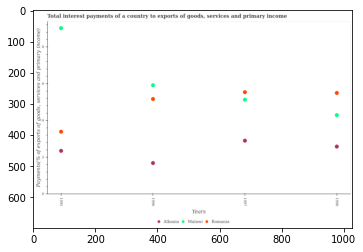

Number of QA =  28





,Years,Romania,Albania,Malawi
0,1998,5.516019,2.603544,4.312217
1,1996,5.183990,1.705638,5.934402
2,1995,3.408785,2.366199,9.039536
3,1997,5.558549,2.924042,5.151346


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total interest payments in albania in 1995 and that in 1996 ?
PREDICTED =  0.6605612085085144
EXPECTED =  0.6648386874505299




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total interest payments in romania in 1997 and the total interest payments in albania in 1996?
PREDICTED =  0.37455875848016973
EXPECTED =  3.85484568521693




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the total interest payments in malawi and total interest payments in albania ?
PREDICTED =  20.437501280931365
EXPECTED =  4.230313990819569




			

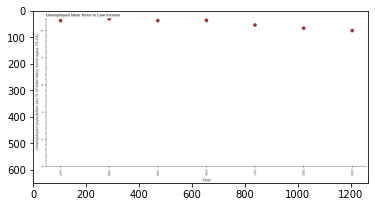

Number of QA =  24





,Year,Unemployed population (as % of total labor force ages 15-24)
0,2002,10.224753
1,2001,10.455269
2,1997,10.780303
3,2000,10.799748
4,2003,10.046437
5,1999,10.782503
6,1998,10.918958


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed youth population in 1999 and 2000 ?
PREDICTED =  -0.017244626180035638
EXPECTED =  -0.017566802759500177




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed youth population ?
PREDICTED =  2000.0
EXPECTED =  10.7262225907619




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total unemployed youth population in 2001 to that in 2002 ?
PREDICTED =  1.022544891874617
EXPECTED =  1.0230736345615763




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trai

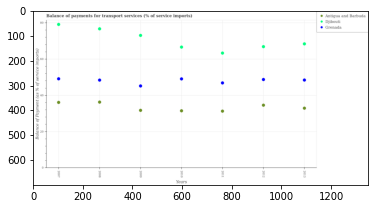

Number of QA =  28





,Years,Grenada,Djibouti,Antigua and Barbuda
0,2011,47.052905,63.516079,31.510979
1,2009,45.419962,73.262068,31.982326
2,2008,48.608124,76.902953,36.506871
3,2007,49.399908,79.350944,36.297252
4,2012,48.969677,67.044641,34.795630
5,2013,48.690697,68.600942,33.162537
6,2010,49.298488,66.833319,31.719925


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in antigua and barbuda in 2007 and that in 2012 ?
PREDICTED =  19.41939692354758
EXPECTED =  1.5332064912730061




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in grenada in 2013 and the balance of payments for transport services in antigua and barbuda in 2012?
PREDICTED =  -0.2789797673876606
EXPECTED =  13.8668588741074




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the balance of payments for transport services in antigua and barbud

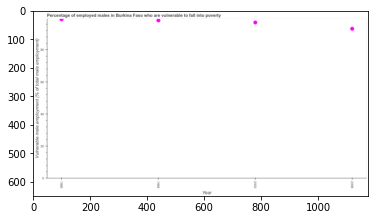

Number of QA =  24





,Year,Vulnerable male employment (% of total male employment)
0,1994,97.706040
1,2006,92.567136
2,2003,96.515636
3,1985,98.466036


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed males who are vulnerable to fall into poverty in 1985 and 1994 ?
PREDICTED =  0.7599960435273942
EXPECTED =  0.6999969482422017




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of employed males who are vulnerable to fall into poverty ?
PREDICTED =  1998.5
EXPECTED =  97.6500015258789




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of employed males who are vulnerable to fall into poverty in 2003 to that in 2006 ?
PREDICTED =  0.9590895305568613
EXPECTED =  1.04189045746293




				 0 / 3 = 0.0


is_built_with_cuda: 

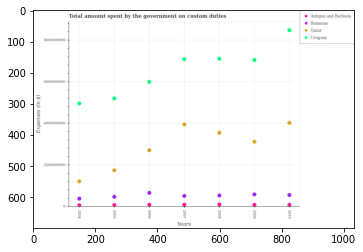

Number of QA =  29





,Years,Bahamas,Qatar,Uruguay,Antigua and Barbuda
0,2004,4.045742e+08,1.232168e+09,4.967089e+09,8.275248e+07
1,2005,4.874097e+08,1.763745e+09,5.208174e+09,9.293697e+07
2,2006,6.794177e+08,2.718596e+09,6.005181e+09,1.026985e+08
3,2009,6.062709e+08,3.134563e+09,7.051671e+09,1.005678e+08
4,2010,5.781011e+08,4.033285e+09,8.482746e+09,9.969001e+07
5,2008,5.545317e+08,3.557310e+09,7.111746e+09,1.170509e+08
6,2007,5.333228e+08,3.960100e+09,7.082976e+09,1.134085e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties by the government in antigua and barbuda in 2004 and that in 2005 ?
PREDICTED =  24113979.102798074
EXPECTED =  -10700000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties by the government in uruguay in 2006 and the amount spent on custom duties by the government in antigua and barbuda in 2009?
PREDICTED =  -1046489791.0165854
EXPECTED =  5915829881.45191




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount spent on custom duties by the government in qata

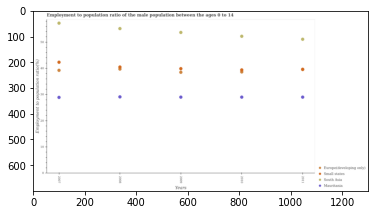

Number of QA =  29





,Years,South Asia,Mauritania,Small states,Europe(developing only)
0,2010,52.502801,29.217769,39.645538,38.878641
1,2009,53.996704,29.220392,40.106266,38.744191
2,2008,55.467367,29.309459,40.733895,39.928266
3,2011,51.390557,29.234015,39.834409,NaN
4,2007,57.554041,29.084334,42.603403,39.463441


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in mauritania in 2009 ?
PREDICTED =  68.7533562386312
EXPECTED =  29.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in south asia ?
PREDICTED =  34.94107373831099
EXPECTED =  57.2288662801145




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in small states ?
PREDICTED =  50.623603696035225
EXPECTED =  39.38512638128979




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trainin

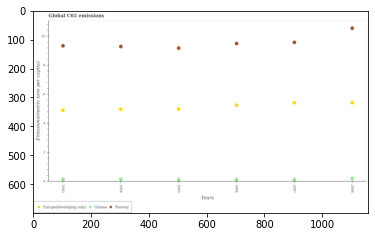

Number of QA =  28





,Years,Norway,Guinea,Europe(developing only)
0,2004,9.317057,0.171587,5.001185
1,2005,9.211772,0.141482,5.013133
2,2007,9.611014,0.141564,5.449250
3,2008,10.594986,0.221743,5.451163
4,2006,9.529403,0.142647,5.279704
5,2003,9.372297,0.167969,4.932223


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in in norway in 2003 and that in 2008 ?
PREDICTED =  -1.222689461519881
EXPECTED =  -1.215162903771569




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in in guinea in 2004 and the amount of co2 emitted in in europe(developing only) in 2008?
PREDICTED =  -0.05015534906761193
EXPECTED =  -5.27536274616932




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of co2 emitted in in norway and amount of co2 emitted in in guinea ?
PREDICTED =  9.607994738780835
EXPECTED =  10.362

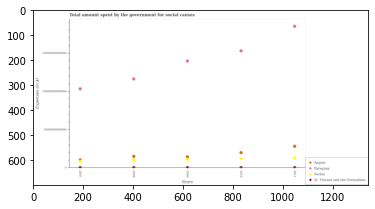

Number of QA =  29





,Years,Serbia,Angola,Paraguay,St. Vincent and the Grenadines
0,2011,1.338321e+12,2.857852e+12,1.854761e+13,6.591061e+10
1,2008,1.099221e+12,1.532585e+12,1.165703e+13,6.503834e+10
2,2009,1.145632e+12,1.480614e+12,1.400372e+13,7.451965e+10
3,2010,1.243535e+12,2.033599e+12,1.531833e+13,6.362477e+10
4,2007,9.076379e+11,1.095098e+12,1.035287e+13,7.731490e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent for social causes by the government in st. vincent and the grenadines in 2007 and that in 2010 ?
PREDICTED =  13690131407.018646
EXPECTED =  -94400000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent for social causes by the government in paraguay in 2011 and the amount spent for social causes by the government in angola in 2010?
PREDICTED =  16514009668325.09
EXPECTED =  16535659875052.7




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the amount spent for social causes by the government in par

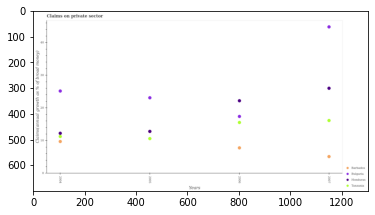

Number of QA =  29





,Years,Tanzania,Honduras,Bulgaria,Barbados
0,2004,11.329772,12.344849,25.271755,9.840080
1,2007,16.276617,26.149460,44.928410,5.227080
2,2005,10.731313,12.942095,23.221206,NaN
3,2006,15.658574,22.319712,17.512376,7.895825


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on private sector in tanzania in 2004 and that in 2005 ?
PREDICTED =  0.5984594214360737
EXPECTED =  0.6425935774906009




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on private sector in barbados in 2006 and the percentage of broad money claimed on private sector in honduras in 2004?
PREDICTED =  -1.944255571289454
EXPECTED =  -4.4608529943308906




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of broad money claimed on private sector in 

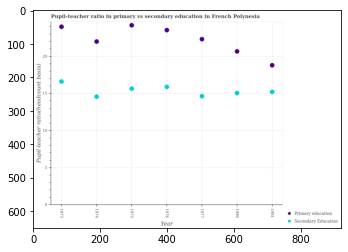

Number of QA =  27





,Year,Primary education,Secondary Education
0,1974,22.233180,14.745859
1,1973,24.256184,16.804470
2,1975,24.436208,15.836445
3,1981,19.023659,15.407005
4,1977,22.565066,14.819478
5,1976,23.793041,16.076916
6,1980,20.903743,15.247537


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the pupil-teacher ratio in primary education in 1980 ?
PREDICTED =  0.9307626357473564
EXPECTED =  20.66013




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum pupil teacher ratio on secondary education ?
PREDICTED =  0.7482378896287062
EXPECTED =  16.59743




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum pupil teacher ratio on secondary education ?
PREDICTED =  0.6565759615620675
EXPECTED =  14.56272




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in 

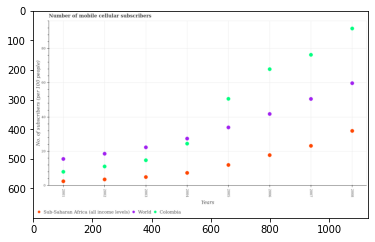

Number of QA =  28





,Years,World,Colombia,Sub-Saharan Africa (all income levels)
0,2006,42.192133,68.419910,18.054110
1,2005,34.276997,51.016132,12.325628
2,2004,27.758997,24.780003,7.634001
3,2003,22.601727,15.083558,5.193436
4,2008,60.220058,92.255300,32.276191
5,2007,50.970521,76.860483,23.522968
6,2002,18.953764,11.442154,3.820346
7,2001,15.773953,8.314643,2.718618


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in sub-saharan africa (all income levels) in 2002 and that in 2008 ?
PREDICTED =  -24.276191049304884
EXPECTED =  -28.30909226182914




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in world in 2006 and the number of mobile cellular subscribers in colombia in 2001?
PREDICTED =  26.418180189362097
EXPECTED =  33.71396928462756




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the number of mobile cellular subscribers in sub-saharan africa (all income

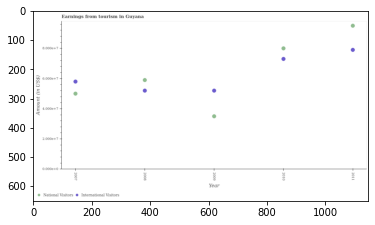

Number of QA =  27





,Year,National Visitors,International Visitors
0,2007,4.987139,5.782116
1,2008,5.888880,5.189951
2,2009,3.507293,5.189907
3,2010,7.969800,7.278511
4,2011,9.464760,7.876042


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from national visitors in 2007 and that in 2011 ?
PREDICTED =  -4.477621020379912
EXPECTED =  -45000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from international visitors in 2011 and the amount earned from national visitors in 2007?
PREDICTED =  2.0939251558638468
EXPECTED =  29000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount earned from national visitors and amount earned from international visitors ?
PREDICTED =  5.957467163267372
EXPECTED =  -8000000




				 0 / 3

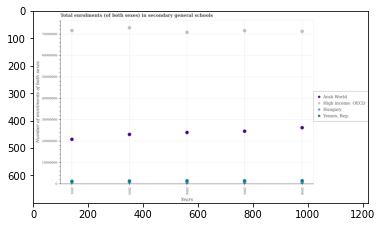

Number of QA =  29





,Years,High income: OECD,Arab World,"Yemen, Rep.",Hungary
0,2004,7.159435e+07,2.439780e+07,5.343653e+05,1.604339e+06
1,2001,7.236837e+07,2.119549e+07,1.317459e+06,NaN
2,2008,7.199469e+07,2.668366e+07,4.784433e+05,1.642714e+06
3,2005,7.231701e+07,2.501076e+07,5.422065e+05,1.611543e+06
4,2003,7.369887e+07,2.348999e+07,1.518565e+06,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in high income: oecd in 2003 and that in 2008 ?
PREDICTED =  1704179.8844444007
EXPECTED =  1675432.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in high income: oecd in 2004 and the number of enrolments in secondary schools in arab world in 2003?
PREDICTED =  -2104521.194060907
EXPECTED =  47676060.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the number of enrolments in secondary schools in high income: oecd and number of enrolm

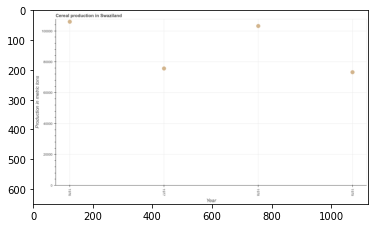

Number of QA =  24





,Year,Production in metric tons
0,1979,74025.778677
1,1978,104071.882918
2,1977,76388.675583
3,1976,106810.104839


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cereal production in 1977 and 1978 ?
PREDICTED =  -27683.207335240993
EXPECTED =  -27507




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median cereal production ?
PREDICTED =  1977.5
EXPECTED =  89413.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cereal production in 1977 to that in 1979 ?
PREDICTED =  1.0319199196249749
EXPECTED =  1.0330420535226652




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the se

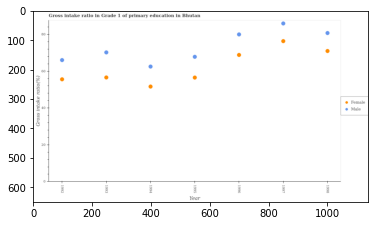

Number of QA =  27





,Year,Male,Female
0,1996,80.008777,68.918289
1,1995,67.898358,56.622608
2,1992,66.080079,55.653736
3,1994,62.595596,51.733277
4,1998,80.771296,71.033000
5,1993,70.254004,56.681567
6,1997,85.917612,76.382307


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

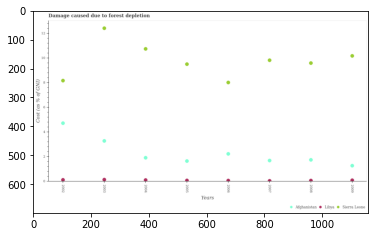

Number of QA =  28





,Years,Libya,Afghanistan,Sierra Leone
0,2008,0.095646,1.784099,9.650374
1,2009,0.119912,1.309065,10.231320
2,2005,0.101686,1.691514,9.558491
3,2004,0.135127,1.955428,10.798279
4,2003,0.171598,3.326702,12.475946
5,2006,0.095127,2.270858,8.065573
6,2002,0.150420,4.763021,8.220500
7,2007,0.082437,1.725460,9.875303


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to forest depletion in libya in 2006 and that in 2007 ?
PREDICTED =  0.012689751679026307
EXPECTED =  0.024689987019392894




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to forest depletion in sierra leone in 2006 and the cost of damage caused due to forest depletion in afghanistan in 2008?
PREDICTED =  -1.5848000188401148
EXPECTED =  6.276579290875069




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the cost of damage caused due to forest depletion in sierra leone and 

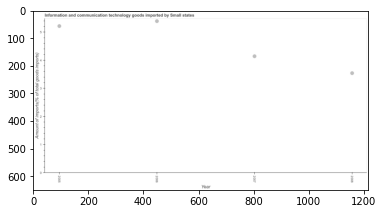

Number of QA =  24





,Year,Amount of imports(% of total goods imports)
0,2006,5.393519
1,2005,5.217430
2,2008,3.547772
3,2007,4.148140


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of ict goods imports in 2006 and 2008 ?
PREDICTED =  1.8457470252119976
EXPECTED =  1.8498403509028996




				 1 / 1 = 1.0


> what is the median amount of ict goods imports ?
PREDICTED =  None
EXPECTED =  4.676550093820885




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of ict goods imports in 2007 to that in 2008 ?
PREDICTED =  1.1692238279821894
EXPECTED =  1.1698682588117348




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest amount of ict goods imports ?
PREDICTED =  0.0
EXPECTED =  0.1757995465

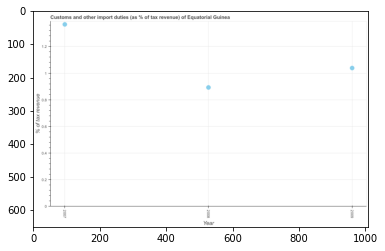

Number of QA =  24





,Year,% of tax revenue
0,2009,1.031449
1,2008,0.887590
2,2007,1.355817


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


> what is the median customs and other import duties ?
PREDICTED =  None
EXPECTED =  1.0383599125057




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the customs and other import duties in 2007 to that in 2009 ?
PREDICTED =  1.3144775831102458
EXPECTED =  1.315885677015723




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest customs and other import duties ?
PREDICTED =  0.0
EXPECTED =  0.32800302394784997




				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after 

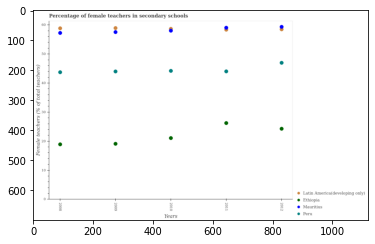

Number of QA =  29





,Years,Peru,Latin America(developing only),Mauritius,Ethiopia
0,2009,44.114191,59.065063,57.609343,19.224874
1,2008,43.829041,58.935811,57.353390,19.062224
2,2011,44.149629,59.163092,58.667176,26.376842
3,2010,44.308349,58.142984,58.749789,21.215557
4,2012,47.084023,58.582046,59.394263,24.428499


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in latin america(developing only) in 2008 and that in 2009 ?
PREDICTED =  -0.12925150108849692
EXPECTED =  -0.08006286621089487




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in latin america(developing only) in 2012 and the percentage of female teachers in peru in 2009?
PREDICTED =  -0.4830170428759857
EXPECTED =  14.502151489257805




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of female teachers in mauritius and percentage of female teachers 

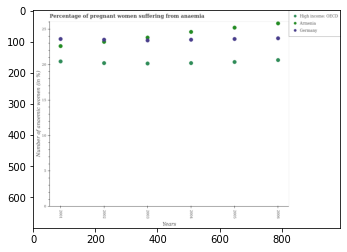

Number of QA =  28





,Years,High income: OECD,Armenia,Germany
0,2006,20.702403,25.867439,23.759848
1,2004,20.267568,24.665210,23.563117
2,2005,20.425460,25.268881,23.665149
3,2002,20.263117,23.260153,23.552909
4,2003,20.208529,23.863592,23.471583
5,2001,20.511511,22.679180,23.662479


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of anaemic women in high income: oecd in 2001 and that in 2002 ?
PREDICTED =  -19.263116927671906
EXPECTED =  0.23544675852721042




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of anaemic women in armenia in 2003 and the number of anaemic women in high income: oecd in 2001?
PREDICTED =  17.863591856425227
EXPECTED =  3.360473370067691




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the number of anaemic women in armenia and number of anaemic women in germany ?
PREDICTED =  0.0
EXPECTED =  1.100000000000001

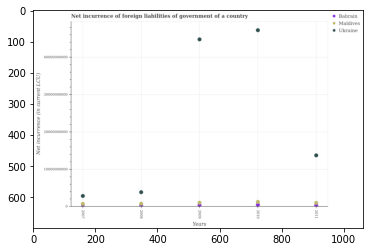

Number of QA =  27





,Years,Maldives,Bahrain,Ukraine
0,2008,2.921975e+08,8.665424e+08,3.927347e+09
1,2011,3.658507e+08,1.057802e+09,1.377288e+10
2,2009,3.951340e+08,1.152224e+09,4.479197e+10
3,2010,1.321913e+09,4.943255e+08,4.726957e+10
4,2007,2.335317e+08,8.232937e+08,2.931707e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in bahrain in 2009 and that in 2010 ?
PREDICTED =  657898157.3672736
EXPECTED =  -139740000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in maldives in 2010 and the net incurrence of foreign liabilities in ukraine in 2008?
PREDICTED =  1029715833.3065851
EXPECTED =  -2601300000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the net incurrence of foreign liabilities in bahrain and net incurrence of foreign liabilities in maldives ?
PREDICT

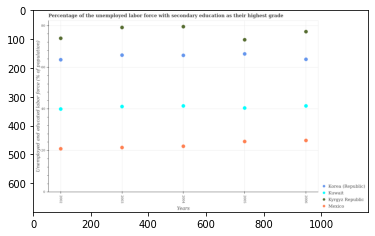

Number of QA =  29





,Years,Korea (Republic),Mexico,Kyrgyz Republic,Kuwait
0,2006,64.188654,25.114782,77.471315,41.735100
1,2003,66.159171,21.677927,79.490673,41.451145
2,2004,66.055389,22.286661,79.920278,41.744988
3,2002,63.959117,21.085603,74.276087,40.188963
4,2005,66.753592,24.581780,73.554771,40.707112


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with secondary education in kyrgyz republic in 2002 and that in 2003 ?
PREDICTED =  -15.531555920741077
EXPECTED =  -5.199996948242088




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with secondary education in kyrgyz republic in 2004 and the percentage of the unemployed labor force with secondary education in korea (republic) in 2002?
PREDICTED =  2.096271280245496
EXPECTED =  15.9000015258789




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_

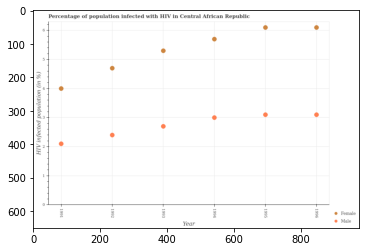

Number of QA =  27





,Year,Male,Female
0,1996,3.108864,6.096544
1,1994,3.007316,5.695336
2,1992,2.407569,4.700295
3,1993,2.708243,5.299604
4,1991,2.108826,4.001488
5,1995,3.107803,6.095493


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females who are infected with hiv in 1993 and that in 1995 ?
PREDICTED =  -0.7958891254949165
EXPECTED =  -0.7999999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of males who are infected with hiv in 1993 and the percentage of females who are infected with hiv in 1991?
PREDICTED =  0.5994174626644235
EXPECTED =  -1.2999999999999998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the percentage of males who are infected with hiv and percentage of females who are infected with hiv ?
PRE

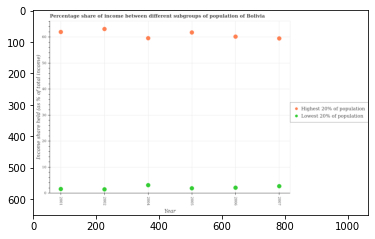

Number of QA =  27





,Year,Lowest 20% of population,Highest 20% of population
0,2004,3.276964,59.501635
1,2006,2.309900,60.063645
2,2001,1.813956,61.843435
3,2002,1.692760,62.999466
4,2005,2.103060,61.658585
5,2007,2.872016,59.400441


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 20% of the population in 2004 and that in 2007 ?
PREDICTED =  0.404948302773557
EXPECTED =  0.3899999999999997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 20% of the population in 2001 and the income share held by highest 20% of the population in 2005?
PREDICTED =  -0.2891041869634883
EXPECTED =  -60.14




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what 

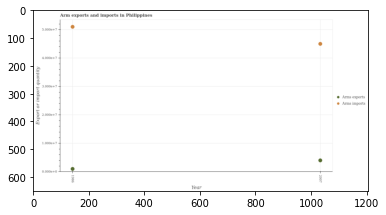

Number of QA =  23





,Year,Arms imports,Arms exports
0,1986,5.118990,0.117295
1,2007,4.519784,0.416060


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports in 1986 and that in 2007 ?
PREDICTED =  -0.29876453432775063
EXPECTED =  -3000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms imports in 2007 and the arms exports in 1986?
PREDICTED =  -0.599205985433028
EXPECTED =  44000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1986, what is the difference between the arms exports and arms imports ?
PREDICTED =  -4.403327065509363
EXPECTED =  -50000000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trainin

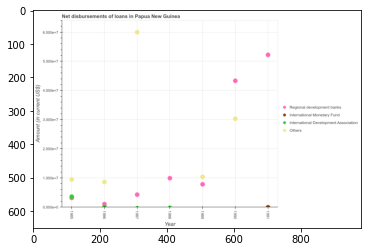

Number of QA =  27





,Year,International Monetary Fund,International Development Association,Others,Regional development banks
0,1986,NaN,0.031255,0.886700,0.125234
1,1985,NaN,0.370039,0.974994,NaN
2,1988,0.010937,NaN,NaN,1.019715
3,1989,NaN,NaN,1.065292,0.808165
4,1990,NaN,NaN,3.080378,4.393047
5,1987,0.001857,NaN,6.074522,0.450206
6,1991,0.018752,NaN,NaN,5.290528


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by regional development banks in 1986 and that in 1990 ?
PREDICTED =  -4.267813370495141
EXPECTED =  -42314000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by regional development banks in 1989 and the amount of loan disimbursed by other organisations in 1991?
PREDICTED =  -4.482363202010603
EXPECTED =  7797000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of loan disimbursed by other organisations in 1986 to that in 1987?
PREDICTED =  0.0
EXPECTED =  0.14315245478036176




				

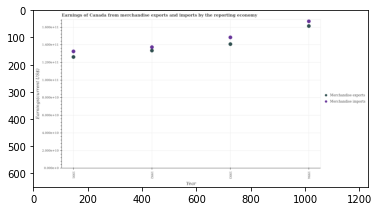

Number of QA =  27





,Year,Merchandise exports,Merchandise imports
0,1992,1.355713,1.395038
1,1994,1.636192,1.691483
2,1991,1.281881,1.346022
3,1993,1.429310,1.506881


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 1992 and that in 1993 ?
PREDICTED =  -0.07359689502178157
EXPECTED =  -7302000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 1993 and the earnings from merchandise exports in 1991?
PREDICTED =  0.16085865269020894
EXPECTED =  22245000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the earnings from merchandise expor

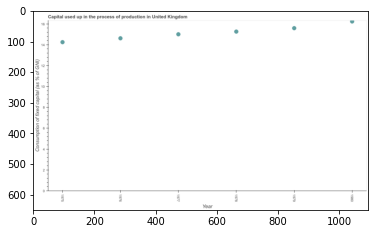

Number of QA =  24





,Year,Consumption of fixed capital (as % of GNI)
0,1978,15.406248
1,1977,15.141851
2,1975,14.374668
3,1980,16.382282
4,1976,14.751983
5,1979,15.725284


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the consumption of fixed capital in 1978 and 1979 ?
PREDICTED =  -0.31903590978442686
EXPECTED =  -0.32877607086619953




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median consumption of fixed capital ?
PREDICTED =  15.274049557273933
EXPECTED =  15.13336053699945




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the consumption of fixed capital in 1979 to that in 1980 ?
PREDICTED =  0.9598958153735073
EXPECTED =  0.9604002426117616




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training s

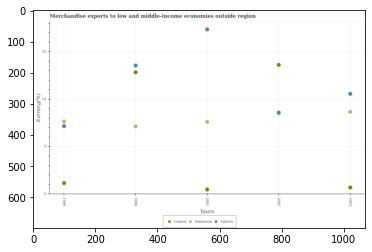

Number of QA =  28





,Years,Guinea,Liberia,Indonesia
0,1999,1.194185,7.190482,7.653524
1,2003,0.738182,10.565807,8.674858
2,2000,12.825626,13.532428,7.153287
3,2002,13.602867,8.580654,NaN
4,2001,0.527588,17.320639,7.625658


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in indonesia in 1999 and that in 2000 ?
PREDICTED =  0.5002373119385766
EXPECTED =  0.5166578650241398




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in indonesia in 2003 and the percentage of amount earned from merchandise exports in guinea in 1999?
PREDICTED =  7.480672626647516
EXPECTED =  7.512662709816329




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of amount earned from merchandise exports in

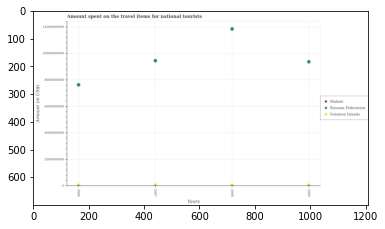

Number of QA =  28





,Years,Solomon Islands,Russian Federation,Malawi
0,2008,6.923233e+07,1.194540e+10,NaN
1,2009,6.720291e+07,9.453763e+09,NaN
2,2007,6.328090e+07,9.535020e+09,NaN
3,2006,6.206029e+07,7.702511e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the amount spent on the travel items for national tourists in russian federation in 2009 ?
PREDICTED =  144.4555402583188
EXPECTED =  9366000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum amount spent on the travel items for national tourists in russian federation ?
PREDICTED =  3.06521117162518e-05
EXPECTED =  7628000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items for national tourists in solomon islands in 2006 and that in 2009 ?
PREDICTED =  -5142620.695647448
EXPECTED =  -12300000




				 0 / 3 = 0.0


is_built_

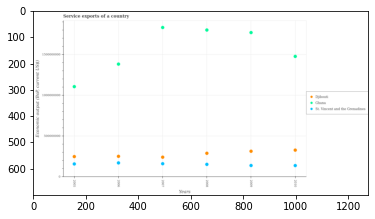

Number of QA =  28





,Years,Ghana,Djibouti,St. Vincent and the Grenadines
0,2005,1.111506e+09,2.527900e+08,1.631652e+08
1,2008,1.805408e+09,2.942658e+08,1.580847e+08
2,2006,1.387683e+09,2.556757e+08,1.758014e+08
3,2009,1.775119e+09,3.191522e+08,1.440556e+08
4,2010,1.482203e+09,3.322334e+08,1.431736e+08
5,2007,1.837595e+09,2.459864e+08,1.654993e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service exports in st. vincent and the grenadines in 2005 and that in 2006 ?
PREDICTED =  610813119.195197
EXPECTED =  -12859333.400000006




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service exports in st. vincent and the grenadines in 2006 and the service exports in ghana in 2009?
PREDICTED =  -825339503.6649274
EXPECTED =  -1598873748.1




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the service exports in st. vincent and the grenadines and service exports in djibouti ?
PREDICTED =  806606185.8872725
EXPECTED =  -1

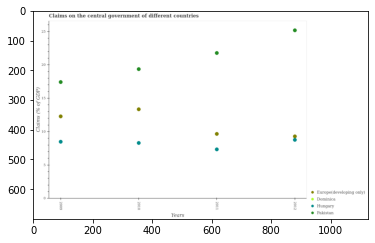

Number of QA =  28





,Years,Pakistan,Europe(developing only),Hungary,Dominica
0,2009,17.617918,12.431133,8.619609,NaN
1,2012,25.420376,9.435348,8.906635,NaN
2,2010,19.577873,13.523774,8.419262,NaN
3,2011,21.996440,9.800987,7.462063,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gdp claimed on the central government in hungary in 2011 and that in 2012 ?
PREDICTED =  -1.4445720820494472
EXPECTED =  -1.4246866501403703




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gdp claimed on the central government in europe(developing only) in 2011 and the percentage of gdp claimed on the central government in dominica in 2009?
PREDICTED =  -2.6301459934389406
EXPECTED =  9.657394517414039




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of gdp claimed on the central

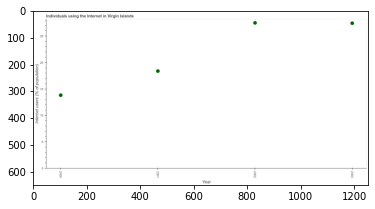

Number of QA =  24





,Year,Internet users (% of population)
0,2001,18.475481
1,2000,13.912556
2,2003,27.501140
3,2002,27.572864


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of internet users in 2000 and 2001 ?
PREDICTED =  -4.5629247962758335
EXPECTED =  -4.560685497827199




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of internet users ?
PREDICTED =  22.988310447917122
EXPECTED =  22.902419514255




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of internet users in 2000 to that in 2002 ?
PREDICTED =  0.5045742067947608
EXPECTED =  0.5024682943901572




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wha

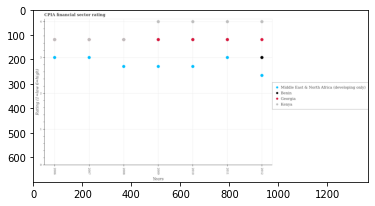

Number of QA =  29





,Years,Benin,Georgia,Middle East & North Africa (developing only),Kenya
0,2008,NaN,NaN,2.760168,3.510912
1,2006,NaN,NaN,3.009734,3.513169
2,2009,NaN,3.511897,2.759997,4.009360
3,2010,NaN,3.510746,2.760760,4.007882
4,2011,NaN,3.510601,3.010389,4.010268
5,2007,NaN,NaN,3.009297,3.508458
6,2012,3.011831,3.510502,2.508964,4.009361


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in middle east & north africa (developing only) in 2008 and that in 2010 ?
PREDICTED =  -0.0005914497561274601
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in kenya in 2006 and the cpia rating in georgia in 2011?
PREDICTED =  -0.497099524384752
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the cpia rating in kenya and cpia rating in middle east & north africa (developing only) ?
PREDICTED =  -2.9897315775978734
EXPECTED =  0.5




				 0 / 3 = 0.0


is_built_wi

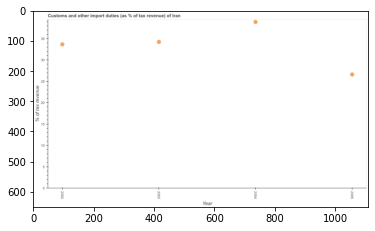

Number of QA =  24





,Year,% of tax revenue
0,2005,26.911856
1,2002,33.995633
2,2004,39.264088
3,2003,34.586939


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


> what is the median customs and other import duties ?
PREDICTED =  None
EXPECTED =  33.9450477688357




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the customs and other import duties in 2003 to that in 2004 ?
PREDICTED =  0.8808797156444388
EXPECTED =  0.8799030316615088




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest customs and other import duties ?
PREDICTED =  39.26408840383906
EXPECTED =  4.672223329508597




				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation f

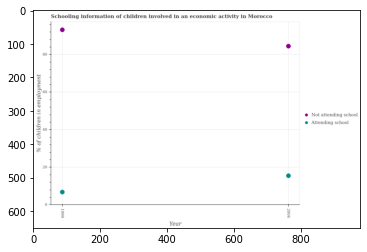

Number of QA =  23





,Year,Not attending school,Attending school
0,2004,84.842668,15.765945
1,1999,93.566517,7.078686


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed children who are not attending school in 1999 and that in 2004 ?
PREDICTED =  8.723849549221356
EXPECTED =  8.700000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed children who are attending school in 1999 and the percentage of employed children who are not attending school in 2004?
PREDICTED =  -77.76398171799777
EXPECTED =  -77.7




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of employed children who are not attending school and percentage of emplo

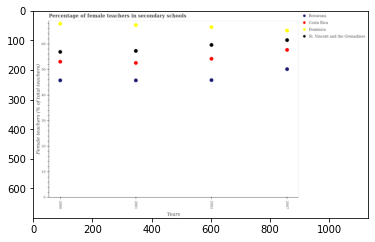

Number of QA =  29





,Years,Botswana,St. Vincent and the Grenadines,Dominica,Costa Rica
0,2000,46.112067,57.238735,68.262815,53.455308
1,2002,46.190148,59.988756,66.999848,54.557088
2,2001,46.087349,57.642495,67.763103,52.909364
3,2007,50.492203,61.864578,65.637807,58.022989


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in costa rica in 2000 and that in 2007 ?
PREDICTED =  -4.567680868969319
EXPECTED =  -4.615150451660213




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in botswana in 2002 and the percentage of female teachers in dominica in 2007?
PREDICTED =  -4.302055772502449
EXPECTED =  -19.382972717285092




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of female teachers in st. vincent and the grenadines and percentage of female teachers in costa rica ?
PREDI

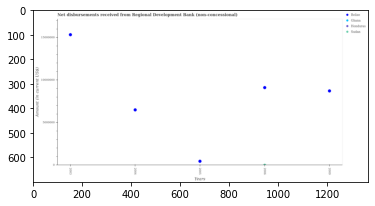

Number of QA =  25





,Years,Sudan,Belize,Ghana,Honduras
0,2005,NaN,4.888283e+05,NaN,NaN
1,2006,14187.999685,9.151532e+06,NaN,NaN
2,2009,NaN,8.762202e+06,NaN,NaN
3,2003,NaN,1.537711e+07,NaN,NaN
4,2004,NaN,6.530062e+06,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in sudan in 2004 and the amount of disbursements received from regional development bank in ghana in 2009?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of disbursements received from regional development bank in belize in 2005 to that in 2009?
PREDICTED =  0.055788298490019594
EXPECTED =  0.05082606700321248




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest amount of disbursements received from regional developme

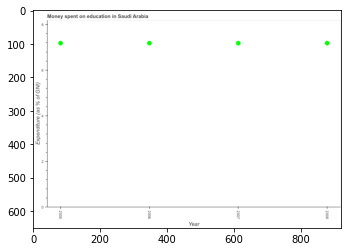

Number of QA =  24





,Year,Expenditure (as % of GNI)
0,2007,7.212037
1,2006,7.214072
2,2005,7.215214
3,2008,7.212563


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on education in 2005 and 2007 ?
PREDICTED =  0.003176814868880662
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median expenditure on education ?
PREDICTED =  7.213317209500081
EXPECTED =  7.1861867




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the expenditure on education in 2005 to that in 2008 ?
PREDICTED =  1.0003676320360948
EXPECTED =  1.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the h

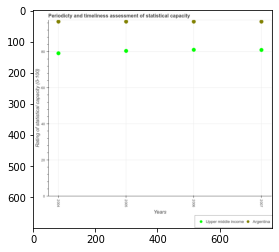

Number of QA =  27





,Years,Argentina,Upper middle income
0,2004,96.839825,79.415534
1,2006,96.884030,81.334121
2,2005,96.920279,80.632904
3,2007,96.917401,81.236123


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in argentina in 2005 and that in 2006 ?
PREDICTED =  0.03624912368900368
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in argentina in 2006 and the rating of statistical capacity in upper middle income in 2007?
PREDICTED =  15.647906716693015
EXPECTED =  15.701932894736785




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the rating of statistical capacity in upper middle income and rating of statistical capacity in argentina ?
PREDICTED =  77.

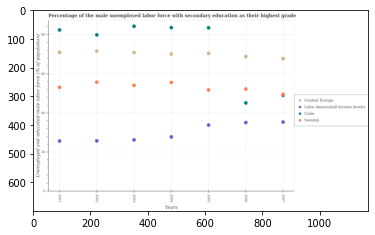

Number of QA =  29





,Years,Latin America(all income levels),Central Europe,Cuba,Sweden
0,2004,27.860298,69.977806,83.416569,55.582755
1,2006,35.120212,68.761559,45.134115,52.160520
2,2005,33.800925,70.363011,83.298314,51.668777
3,2007,35.341150,67.658486,NaN,49.232899
4,2003,26.296418,70.726774,84.109928,54.062863
5,2001,25.722817,70.776941,82.225000,53.038391
6,2002,25.856503,71.452136,79.756354,55.672603


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with secondary education in latin america(all income levels) in 2002 and that in 2007 ?
PREDICTED =  -9.484646881135745
EXPECTED =  -9.594841849310288




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with secondary education in cuba in 2004 and the percentage of the unemployed male labor force with secondary education in sweden in 2007?
PREDICTED =  83.41656939169755
EXPECTED =  34.099998474120994




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the diffe

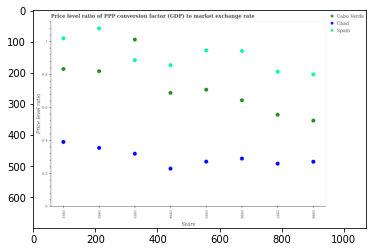

Number of QA =  28





,Years,Cabo Verde,Spain,Chad
0,1992,0.821889,1.080993,0.357267
1,1996,0.646070,0.944663,0.292923
2,1994,0.691162,0.859380,0.231748
3,1991,0.835137,1.021218,0.393469
4,1993,1.013385,0.888563,0.321956
5,1995,0.710069,0.948114,0.274550
6,1998,0.522618,0.802888,0.273926
7,1997,0.558588,0.820141,0.261883


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the price level ratio in chad in 1994 ?
PREDICTED =  0.00011598974334335301
EXPECTED =  0.22949772785819




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum price level ratio in cabo verde ?
PREDICTED =  0.9974974974974975
EXPECTED =  1.01231466315328




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum price level ratio in cabo verde ?
PREDICTED =  1.0
EXPECTED =  0.520853420900479




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the p

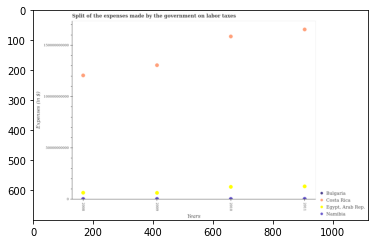

Number of QA =  29





,Years,"Egypt, Arab Rep.",Costa Rica,Namibia,Bulgaria
0,2009,6.739442e+09,1.309989e+11,8.632303e+08,NaN
1,2008,6.859593e+09,1.209641e+11,7.104335e+08,NaN
2,2011,1.301649e+10,1.658129e+11,8.843847e+08,NaN
3,2010,1.248834e+10,1.589209e+11,8.055794e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenses made by the government on labor taxes in bulgaria in 2010 and that in 2011 ?
PREDICTED =  -528147206.20201683
EXPECTED =  1232000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenses made by the government on labor taxes in bulgaria in 2008 and the expenses made by the government on labor taxes in costa rica in 2010?
PREDICTED =  -152061257275.61893
EXPECTED =  -158517361602.54




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the expenses made by the government on labor taxes in namibia and expenses made by

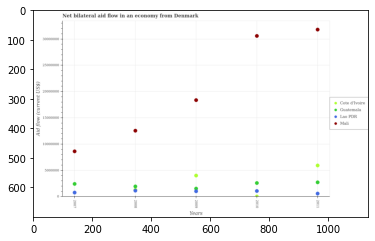

Number of QA =  28





,Years,Cote d'Ivoire,Lao PDR,Guatemala,Mali
0,2007,NaN,8.645328e+05,2.535434e+06,8.791038e+06
1,2011,6.078983e+06,6.724659e+05,2.851869e+06,3.222945e+07
2,2010,1.108514e+05,1.167248e+06,2.703083e+06,3.099775e+07
3,2008,NaN,1.240246e+06,2.042595e+06,1.275862e+07
4,2009,4.139208e+06,1.125077e+06,1.637617e+06,1.864065e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in mali in 2008 and that in 2009 ?
PREDICTED =  -5882028.787023583
EXPECTED =  -5820000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in lao pdr in 2007 and the net bilateral aid flow in guatemala in 2008?
PREDICTED =  -375713.7130582436
EXPECTED =  -1170000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the net bilateral aid flow in lao pdr and net bilateral aid flow in cote d'ivoire ?
PREDICTED =  -3.0
EXPECTED =  1050000.0




				 1 / 3 = 0.3333


is_built_with_cud

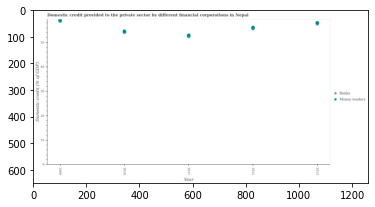

Number of QA =  27





,Year,Money lenders,Banks
0,2013,58.711375,NaN
1,2009,59.662222,NaN
2,2012,56.282979,56.80559
3,2010,55.099341,NaN
4,2011,53.569175,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided by banks in 2010 and that in 2011 ?
PREDICTED =  -56.805589959480365
EXPECTED =  1.7133025267750028




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided by money lenders in 2011 and the domestic credit provided by banks in 2013?
PREDICTED =  -5.142199878144801
EXPECTED =  -4.759563520302002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the domestic credit provided by banks and domestic credit provided by money lenders ?
PREDICTED =  3.2364148405533726
EXPECTED =  -0.40352482

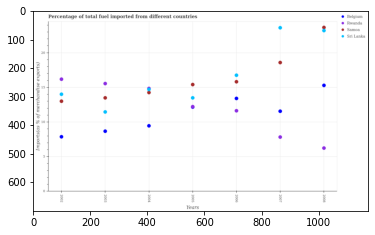

Number of QA =  29





,Years,Belgium,Rwanda,Sri Lanka,Samoa
0,2004,9.537879,NaN,14.904909,14.340993
1,2006,13.498499,11.708540,16.857846,15.917966
2,2002,7.938811,16.285853,14.104080,13.105102
3,2008,15.391988,6.316039,23.329155,23.775191
4,2005,NaN,12.268872,13.582421,15.512521
5,2003,8.752877,15.651746,11.540269,13.576886
6,2007,11.648936,7.903513,23.734258,18.694376


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in rwanda in 2005 and that in 2006 ?
PREDICTED =  0.560332448714659
EXPECTED =  0.5925584457096011




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in belgium in 2005 and the percentage of imports to different countries in rwanda in 2007?
PREDICTED =  1.849563007124729
EXPECTED =  4.33339569870922




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of imports to different countries in sri lanka and percentage of imports to

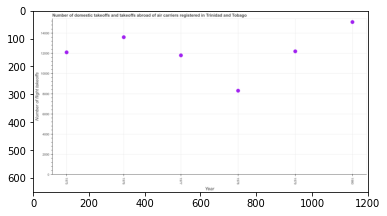

Number of QA =  24





,Year,Number of flight takeoffs
0,1977,11866.882900
1,1975,12166.905819
2,1976,13671.884916
3,1980,15176.764507
4,1979,12267.128534
5,1978,8370.679685


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of flight takeoffs in 1976 and 1979 ?
PREDICTED =  1404.7563821323165
EXPECTED =  1400.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of flight takeoffs ?
PREDICTED =  13721.946520700996
EXPECTED =  12150.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of flight takeoffs in 1975 to that in 1978 ?
PREDICTED =  1.4535146819036027
EXPECTED =  1.4578313253012047




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the differ

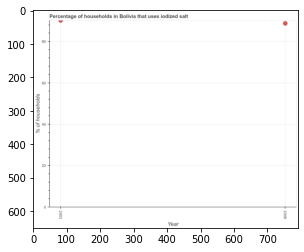

Number of QA =  20





,Year,% of households
0,2008,88.628112
1,2003,90.059902


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of households where iodized salt is consumed in 2003 and 2008 ?
PREDICTED =  1.431789770308285
EXPECTED =  1.3999999999999915




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of households where iodized salt is consumed ?
PREDICTED =  89.3440066247984
EXPECTED =  89.4




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of households where iodized salt is consumed in 2003 to that in 2008 ?
PREDICTED =  1.0161550296198834
EXPECTED =  1.015783540022548




				 3 / 3 = 1.0


> what is the difference between two consecutive major ticks 

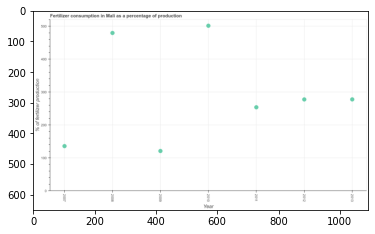

Number of QA =  24





,Year,% of fertilizer production
0,2007,137.656169
1,2010,502.731545
2,2012,278.959347
3,2008,480.670186
4,2013,279.133470
5,2011,255.327391
6,2009,122.448469


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in 2012 and 2013 ?
PREDICTED =  -0.17412298866202036
EXPECTED =  -0.13701699485199015




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of fertilizer consumption ?
PREDICTED =  278.95934692694686
EXPECTED =  277.578600720766




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of fertilizer consumption in 2007 to that in 2013 ?
PREDICTED =  0.4931553690143996
EXPECTED =  0.4886186603456682




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished af

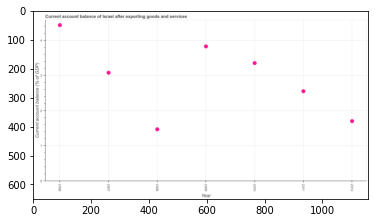

Number of QA =  24





,Year,Current account balance (% of GDP)
0,2006,4.467832
1,2010,3.382373
2,2008,1.489799
3,2011,2.576825
4,2007,3.105939
5,2012,1.722580
6,2009,3.858923


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current account balance in 2007 and 2009 ?
PREDICTED =  -0.7529840754109012
EXPECTED =  -0.7498724318902501




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median current account balance ?
PREDICTED =  3.1059390352767804
EXPECTED =  3.07722679579431




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the current account balance in 2009 to that in 2011 ?
PREDICTED =  1.4975494164818284
EXPECTED =  1.5000346178668944




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what

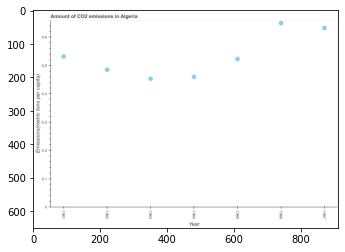

Number of QA =  24





,Year,Emissions(metric tons per capita)
0,1967,0.629377
1,1965,0.520633
2,1963,0.451518
3,1962,0.483524
4,1966,0.646542
5,1964,0.458292
6,1961,0.530011


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions in 1961 and 1964 ?
PREDICTED =  0.07171873587610139
EXPECTED =  0.07224107691824494




				 1 / 1 = 1.0


> what is the median amount of co2 emissions ?
PREDICTED =  None
EXPECTED =  0.5224485273684




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of co2 emissions in 1961 to that in 1963 ?
PREDICTED =  1.173842185853439
EXPECTED =  1.1744285993435846




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 5 = 0.4


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





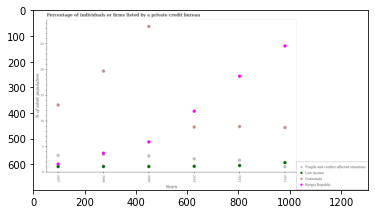

Number of QA =  29





,Years,Kyrgyz Republic,Guatemala,Fragile and conflict affected situations,Low income
0,2012,24.611532,8.752605,1.151565,1.918574
1,2008,3.775295,19.713662,NaN,1.183884
2,2009,5.950726,28.407158,3.251426,1.197880
3,2010,11.947247,8.849050,2.681617,1.240099
4,2011,18.728434,8.950957,2.429083,1.357706
5,2007,1.676639,13.123538,3.336488,1.193560


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population listed by a private credit bureau in kyrgyz republic in 2007 and that in 2008 ?
PREDICTED =  -2.098656442782114
EXPECTED =  -2.1




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population listed by a private credit bureau in guatemala in 2010 and the percentage of population listed by a private credit bureau in fragile and conflict affected situations in 2012?
PREDICTED =  0.09644510438524634
EXPECTED =  7.71515151515152




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available

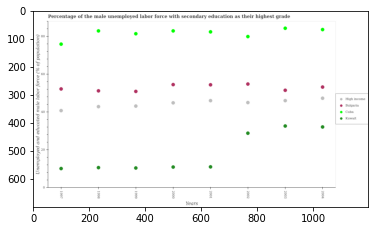

Number of QA =  29





,Years,Unnamed: 1,High income,Bulgaria,Kuwait
0,1998,83.222885,43.130371,51.450018,10.808409
1,1999,81.743509,43.398053,51.141293,10.623233
2,1997,76.244401,41.000103,52.473160,10.324754
3,2001,82.740618,46.268530,54.669300,11.209372
4,2004,83.938965,47.578158,53.494918,32.358173
5,2003,84.615431,46.308611,51.773977,32.812421
6,2000,83.254405,45.135074,54.786591,11.069245
7,2002,80.211855,45.268476,55.106327,29.030747


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with secondary education in high income in 1997 and that in 2002 ?
PREDICTED =  -4.268372592238393
EXPECTED =  -4.2459134155359095




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with secondary education in bulgaria in 2004 and the percentage of the unemployed male labor force with secondary education in kuwait in 1999?
PREDICTED =  2.3536256132315287
EXPECTED =  42.8000011444092




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the

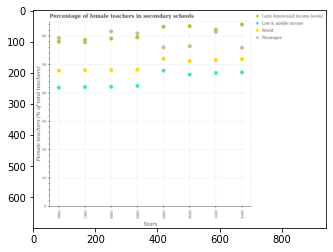

Number of QA =  29





,Years,Latin America(all income levels),Low & middle income,Nicaragua,World
0,1986,57.661340,41.668468,58.948851,47.625608
1,1999,62.952465,47.617297,55.721694,51.755327
2,1988,58.819400,41.964811,61.258471,47.817495
3,2001,61.231844,46.783209,61.842861,51.347735
4,1987,58.295104,41.861127,57.423805,47.720890
5,2000,63.176414,46.215994,56.164559,50.942902
6,2002,63.708961,46.964116,55.582845,51.568093
7,1989,59.238607,42.286154,60.591663,47.939078


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in latin america(all income levels) in 1988 and that in 1999 ?
PREDICTED =  -4.1330647644507295
EXPECTED =  -4.142490386962898




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in nicaragua in 1988 and the percentage of female teachers in world in 2001?
PREDICTED =  -0.5843904974190437
EXPECTED =  10.033751140136694




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the percentage of female teachers in low & middle income and percentage of female teachers in nicaragu

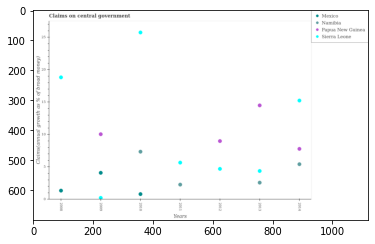

Number of QA =  28





,Years,Namibia,Sierra Leone,Papua New Guinea,Mexico
0,2014,5.504739,15.339464,7.869024,NaN
1,2013,2.651918,4.453973,14.598330,NaN
2,2008,NaN,18.923565,NaN,1.416188
3,2012,NaN,4.775110,9.085817,NaN
4,2011,2.356720,5.746315,NaN,NaN
5,2009,NaN,0.296496,10.135357,4.178771
6,2010,7.436180,25.841674,NaN,0.882188


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on centeral government in sierra leone in 2011 and that in 2012 ?
PREDICTED =  0.97120515147187
EXPECTED =  0.9671033872284012




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on centeral government in sierra leone in 2010 and the percentage of broad money claimed on centeral government in mexico in 2012?
PREDICTED =  21.066563973113205
EXPECTED =  25.7422456400626




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of broad money claimed on ce

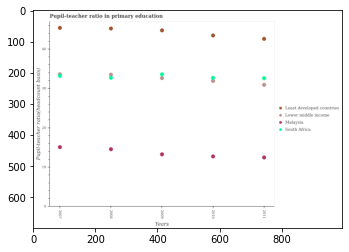

Number of QA =  29





,Years,South Africa,Least developed countries,Malaysia,Lower middle income
0,2011,32.848146,42.875622,12.619084,31.151134
1,2007,33.788052,45.643406,15.228832,33.416354
2,2010,32.919939,43.740972,12.881905,32.122801
3,2009,33.806182,45.042044,13.411768,32.853111
4,2008,32.969574,45.497213,14.717508,33.772601


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the pupil-teacher ratio in primary education in malaysia in 2010 ?
PREDICTED =  2.576381098979909
EXPECTED =  12.7222700119019




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum pupil-teacher ratio in primary education in malaysia ?
PREDICTED =  401.4
EXPECTED =  15.0826101303101




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum pupil-teacher ratio in primary education in south africa ?
PREDICTED =  6.569629167915629
EXPECTED =  32.5966606140137




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluati

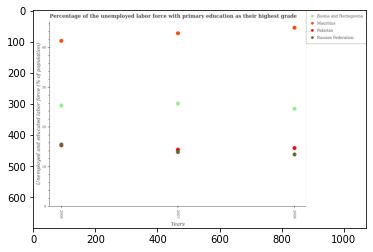

Number of QA =  29





,Years,Pakistan,Russian Federation,Mauritius,Bosnia and Herzegovina
0,2007,14.346825,13.759081,43.584116,25.936703
1,2008,14.773390,13.149398,44.970374,24.645866
2,2006,NaN,15.422628,41.672850,25.425563


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the percentage of the unemployed labor force with primary education in russian federation in 2006 ?
PREDICTED =  5.140875922634476
EXPECTED =  15.6000003814697




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the percentage of the unemployed labor force with primary education in russian federation minimum?
PREDICTED =  669.3333333333334
EXPECTED =  2008




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total percentage of the unemployed labor force with primary education in russian federation in the graph ?
PREDICTED =  1.0
EXPECTED =  42.4000005722045




				 0 / 3 = 0.0


is_built_with_cuda: True
is_

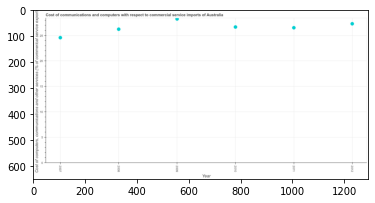

Number of QA =  24





,Year,"Cost of computers, communications and other services (% of commerical service exports"
0,2012,27.700314
1,2011,26.914929
2,2010,27.055151
3,2009,28.623381
4,2008,26.608478
5,2007,24.950208


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the  computer and other services in 2007 and 2011 ?
PREDICTED =  -45.8651373686441
EXPECTED =  -1.9485447026349014




				 0 / 1 = 0.0


> what is the median  computer and other services ?
PREDICTED =  None
EXPECTED =  26.597232054918052




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the  computer and other services in 2011 to that in 2012 ?
PREDICTED =  0.9716470783059893
EXPECTED =  0.9713982689959784




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest  computer and other services ?
PREDICTED =  0.0
EXPECTED =  0.9464001

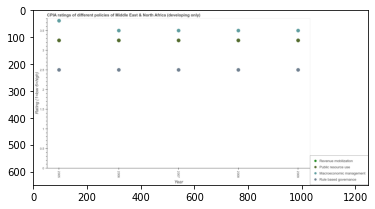

Number of QA =  29





,Year,Revenue mobilization,Macroeconomic management,Rule based governance,Public resource use
0,2009,NaN,3.513011,2.512613,3.262421
1,2008,NaN,3.511941,2.513445,3.261631
2,2006,NaN,3.513603,2.513517,3.263542
3,2007,NaN,3.512389,2.511932,3.262879
4,2005,NaN,3.760458,2.510532,3.261642


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of macroeconomic management in 2007 and that in 2008 ?
PREDICTED =  0.00044723588623885036
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of public resource use in 2007 and the cpia rating of rule based governance in 2008?
PREDICTED =  0.0012477397798438261
EXPECTED =  0.75




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the cpia rating of public resource use and cpia rating of rule based governance ?
PREDICTED =  0.7511339226237754
EXPECTED =  0.75




				 1 / 3 = 0.3333


is_bu

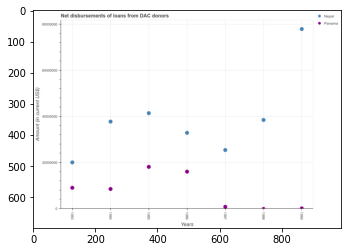

Number of QA =  26





,Years,Nepal,Panama
0,1989,7.810855e+07,3.443254e+05
1,1987,2.565416e+07,1.021881e+06
2,1985,4.163740e+07,1.838454e+07
3,1986,3.309875e+07,1.628081e+07
4,1984,3.796228e+07,8.772259e+06
5,1988,3.867606e+07,2.427813e+05
6,1983,2.033844e+07,9.288360e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in nepal in 1985 and that in 1987 ?
PREDICTED =  15983230.762472209
EXPECTED =  16000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in panama in 1988 and the amount of loans disbursed in nepal in 1983?
PREDICTED =  -9045578.29607205
EXPECTED =  -20005000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1989, what is the difference between the amount of loans disbursed in panama and amount of loans disbursed in nepal ?
PREDICTED =  -221140689.82807475
EXPECTED =  -77824000




				 1 / 3 = 0.3333


is_b

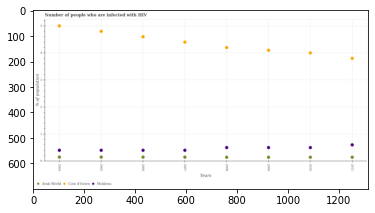

Number of QA =  28





,Years,Arab World,Moldova,Cote d'Ivoire
0,2008,0.156126,0.518161,4.244468
1,2009,0.154275,0.518694,4.139259
2,2005,0.161860,0.420452,4.844511
3,2004,0.161474,0.420290,5.045145
4,2011,0.160322,0.620709,3.840071
5,2010,0.157328,0.519803,4.041978
6,2006,0.163780,0.419139,4.648755
7,2007,0.162344,0.420514,4.445234


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in arab world in 2005 and that in 2006 ?
PREDICTED =  -0.0019202474443234252
EXPECTED =  0.00023721411734498044




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in moldova in 2006 and the percentage of hiv infected population in in arab world in 2010?
PREDICTED =  0.2618114584824485
EXPECTED =  0.2580328327214899




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of hiv infected population in in arab world and percentage of hiv i

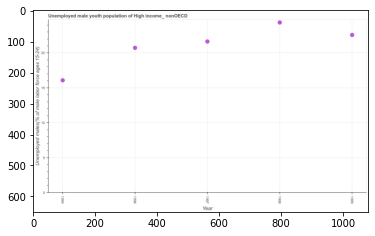

Number of QA =  24





,Year,Unemployed males(% of male labor force ages 15-24)
0,1998,24.307982
1,1996,20.701192
2,1999,22.526299
3,1994,16.079017
4,1997,21.599643


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed male youth in 1994 and 1998 ?
PREDICTED =  -8.228965153812734
EXPECTED =  -8.278800122587302




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed male youth ?
PREDICTED =  1997.0
EXPECTED =  21.6292092692185




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed male youth in 1998 to that in 1999 ?
PREDICTED =  1.0790934661665594
EXPECTED =  1.0791907348726333




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the differenc

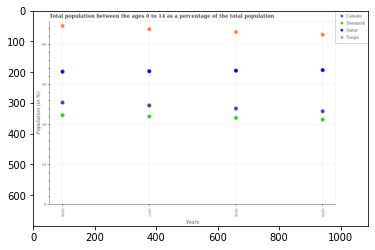

Number of QA =  29





,Years,Qatar,Tonga,Denmark,Canada
0,1978,33.523398,43.147771,21.742542,24.069690
1,1976,33.307694,44.684544,22.413692,25.603243
2,1979,33.673770,42.468480,21.332331,23.388123
3,1977,33.363454,43.847403,22.108804,24.841760


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 0 to 14 in canada in 1977 and that in 1979 ?
PREDICTED =  -22.388122714785915
EXPECTED =  1.4404911273145906




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 0 to 14 in qatar in 1978 and the percentage of the population ages 0 to 14 in denmark in 1976?
PREDICTED =  0.21570413734015403
EXPECTED =  11.122050425275201




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1978, what is the difference between the percentage of the population ages 0 to 14 in qatar and percentage of the population ages 0

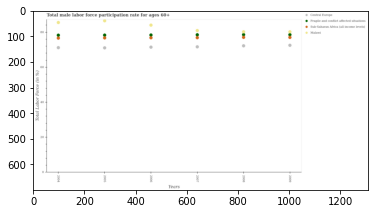

Number of QA =  29





,Years,Fragile and conflict affected situations,Malawi,Sub-Saharan Africa (all income levels,Central Europe
0,2009,79.059836,80.606906,77.404818,72.861637
1,2008,79.086236,80.592275,77.437409,72.587999
2,2005,78.681837,86.870217,77.061434,71.392948
3,2007,78.922643,81.312883,77.237139,71.996007
4,2006,78.739194,84.425965,77.169411,71.807429
5,2004,78.654161,85.915096,76.931777,71.542772


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in fragile and conflict affected situations in 2008 and that in 2009 ?
PREDICTED =  1845.8539280935252
EXPECTED =  0.018441124562102118




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in central europe in 2009 and the male labor force participation rate in fragile and conflict affected situations in 2008?
PREDICTED =  0.27363790385969367
EXPECTED =  -6.069294386206806




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the male labor force participation 

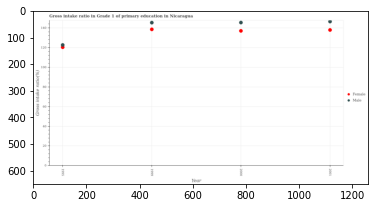

Number of QA =  27





,Year,Male,Female
0,1999,145.757585,139.009674
1,2000,145.837968,137.333521
2,1995,123.047575,120.719623
3,2001,146.882815,138.321307


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

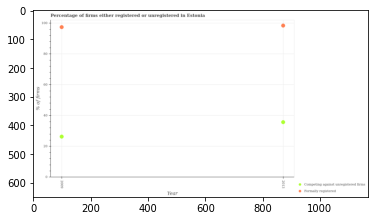

Number of QA =  23





,Year,Competing against unregistered firm:,Formally registered
0,2009,26.580938,97.816876
1,2013,36.008950,98.782719


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of registered firms in 2009 and that in 2013 ?
PREDICTED =  -0.965843028609342
EXPECTED =  -9.400000000000002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of formally registered firms in 2013 and the percentage of registered firms in 2009?
PREDICTED =  0.965843028609342
EXPECTED =  72.10000000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of formally registered firms and percentage of registered firms ?
PREDICTED =  -97.81687634841497
EXPECTED =  62.7




				 0 / 3 = 0.0



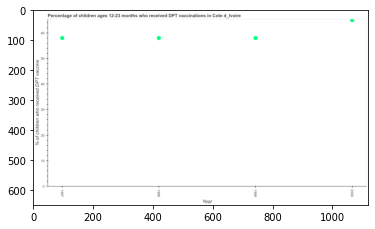

Number of QA =  24





,Year,% of children who received DPT vaccine
0,1998,58.378722
1,1999,58.377002
2,1997,58.363408
3,2000,65.355969


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccine in 1997 and 1998 ?
PREDICTED =  -0.01531370193155368
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of children who received dpt vaccine ?
PREDICTED =  58.3778620822262
EXPECTED =  58.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of children who received dpt vaccine in 1998 to that in 2000 ?
PREDICTED =  0.8932423965952445
EXPECTED =  0.8923076923076924




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation

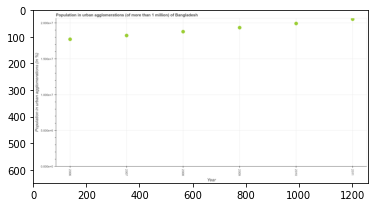

Number of QA =  24





,Year,Population in urban agglomerations (in %)
0,2007,1.828108
1,2009,1.940291
2,2010,1.997317
3,2006,1.776828
4,2008,1.883682
5,2011,2.056596


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the population in urban agglomerations in 2011 ?
PREDICTED =  1.0594465725114819
EXPECTED =  20534461




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum population in urban agglomerations ?
PREDICTED =  1.0594465725114819
EXPECTED =  20534461




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum population in urban agglomerations ?
PREDICTED =  1033.3821362584963
EXPECTED =  17733924




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the pop

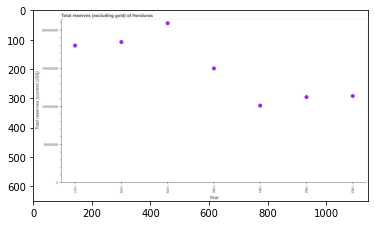

Number of QA =  24





,Year,Total reserves (current US$)
0,1980,1.500742e+08
1,1979,2.092831e+08
2,1977,1.800467e+08
3,1981,1.014265e+08
4,1978,1.846621e+08
5,1982,1.125565e+08
6,1983,1.139710e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (excluding gold) in 1979 and 1982 ?
PREDICTED =  573340298.3558997
EXPECTED =  96942044.88789001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total reserves (excluding gold) ?
PREDICTED =  150074193.83294177
EXPECTED =  149825508.19998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total reserves (excluding gold) in 1981 to that in 1982 ?
PREDICTED =  0.4477449410756562
EXPECTED =  0.9001126458840113




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after traini

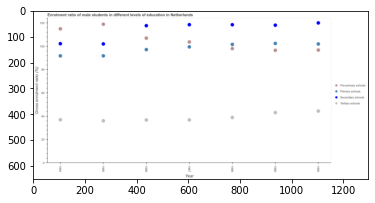

Number of QA =  29





,Year,Tertiary schools,Secondary schools,Pre-primary schools,Primary schools
0,1984,37.066291,101.978064,114.783257,91.679387
1,1986,37.015873,117.423937,106.847052,97.053433
2,1987,37.026160,118.344241,103.513900,99.357964
3,1988,39.086746,118.209119,97.892943,101.577360
4,1989,43.256512,117.917214,96.484990,102.296609
5,1985,36.257740,101.913101,118.663949,91.664852
6,1990,44.609096,119.839762,96.681825,101.862734


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio(female) in tertiary schools in 1988 ?
PREDICTED =  19.543373201346604
EXPECTED =  38.8517




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum gross enrolment ratio(female) in tertiary schools ?
PREDICTED =  22.304547930657264
EXPECTED =  44.34877




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum gross enrolment ratio(female) in secondary schools ?
PREDICTED =  50.956550645301526
EXPECTED =  101.98182




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tra

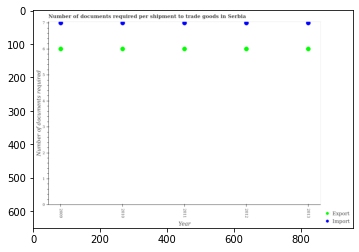

Number of QA =  27





,Year,Export,Import
0,2011,5.956306,6.938175
1,2009,5.956425,6.938987
2,2010,5.951711,6.939885
3,2013,5.954477,6.942334
4,2012,5.958959,6.937915


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of documents required to import goods in 2010 and that in 2013 ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of documents required to export goods in 2012 and the number of documents required to import goods in 2009?
PREDICTED =  0.0
EXPECTED =  -1




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the number of documents required to import goods and number of documents required to export goods ?
PREDICTED =  0.0
EXPECTED =  1




				 1 / 3 = 0.3333


is_built_with_cuda: Tru

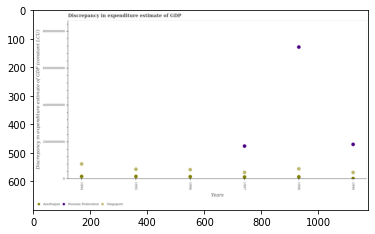

Number of QA =  27





,Years,Russian Federation,Azerbaijan,Singapore
0,1997,1.791220e+10,1.167850e+09,3.708227e+09
1,1996,NaN,1.379440e+09,5.221758e+09
2,1998,7.173612e+10,1.297858e+09,5.586753e+09
3,1994,NaN,1.495594e+09,8.290586e+09
4,1995,NaN,1.494979e+09,5.389917e+09
5,1999,1.886204e+10,4.274322e+08,3.694861e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in russian federation in 1997 and that in 1999 ?
PREDICTED =  0.4
EXPECTED =  -926791700.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in russian federation in 1997 and the discrepancy in expenditure estimate of gdp in azerbaijan in 1999?
PREDICTED =  0.2
EXPECTED =  17602452700.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the discrepancy in expenditure estimate of gdp in azerbaijan and discrepancy in expenditure estimate of gd

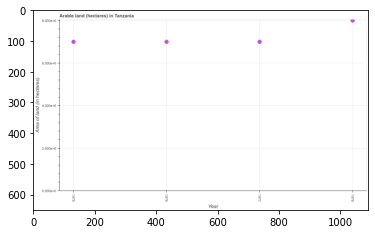

Number of QA =  24





,Year,Area of land (in hectares)
0,1975,7.033125
1,1977,7.035672
2,1978,8.031730
3,1976,7.036466


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the area of land in 1975 and 1976 ?
PREDICTED =  -0.003341229984767047
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median area of land ?
PREDICTED =  1976.5
EXPECTED =  7000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the area of land in 1975 to that in 1977 ?
PREDICTED =  0.9996379024686678
EXPECTED =  1.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest area of land ?
PRE

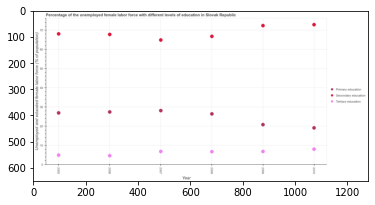

Number of QA =  28





,Year,Primary education,secondary education,Tertiary education
0,2009,21.083558,72.711688,7.057710
1,2010,19.425640,73.259684,8.305837
2,2006,27.700851,68.100832,4.869400
3,2007,28.412127,65.219741,7.053761
4,2005,27.183966,68.427260,5.176027
5,2008,26.706353,67.120782,6.963129


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in 2007 and that in 2008 ?
PREDICTED =  -1.9010412358894229
EXPECTED =  -1.9000015258789062




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received tertiary education in 2009 and the percentage of female labor force who received secondary education in 2008?
PREDICTED =  -58.16203083190618
EXPECTED =  -60.000002861022935




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of female labor force who received te

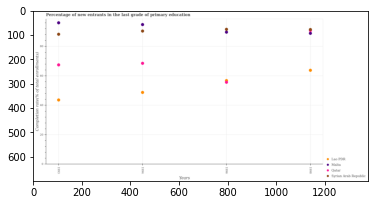

Number of QA =  29





,Years,Syrian Arab Republic,Malta,Lao PDR,Qatar
0,1998,91.334172,88.828948,63.820615,NaN
1,1994,90.331378,94.787500,48.793808,68.468214
2,1996,91.539505,89.603289,56.840247,55.714444
3,1993,88.135578,95.920552,43.636128,67.457921


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of new entrants in malta in 1994 and that in 1998 ?
PREDICTED =  5.958551663165437
EXPECTED =  5.938149999999993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of new entrants in syrian arab republic in 1998 and the percentage of new entrants in lao pdr in 1996?
PREDICTED =  -0.2053331305613142
EXPECTED =  34.68139000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of 

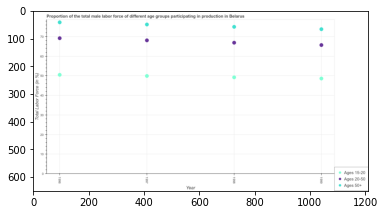

Number of QA =  28





,Year,Ages 20-50,Ages 15-20,Ages 50+
0,1996,69.121811,50.474148,77.145515
1,1999,65.652688,48.644177,73.664036
2,1998,66.860356,49.240144,74.924928
3,1997,68.017691,49.928836,76.057608


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force above age 50 in 1996 and the percentage of male labor force within the age group 15-20 in 1998?
PREDICTED =  19.88166725965248
EXPECTED =  28.100002288818295




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of male labor force within the age group 15-20 in 1997 to that in 1998?
PREDICTED =  1.0139863906854156
EXPECTED =  1.0142276575626943






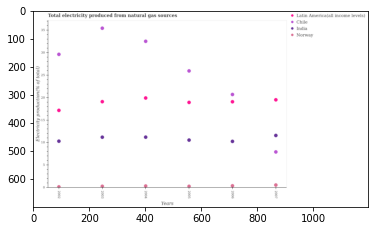

Number of QA =  29





,Years,India,Latin America(all income levels),Norway,Chile
0,2004,11.257886,19.935897,0.418291,32.507530
1,2005,10.583235,18.953729,0.327734,25.944799
2,2006,10.315680,19.091119,0.453654,20.717066
3,2007,11.629903,19.532978,0.649813,7.978630
4,2003,11.240923,19.123533,0.321999,35.400902
5,2002,10.329745,17.184459,0.211483,29.628228


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in india in 2004 and that in 2007 ?
PREDICTED =  -0.372017197625091
EXPECTED =  -0.3761771749160001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in norway in 2006 and the total electricity produced in latin america(all income levels) in 2004?
PREDICTED =  0.035362735622223584
EXPECTED =  -19.506540125259097




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the total electricity produced in india and total electricity produced in norway ?
PREDICTED =  62.9743987735027

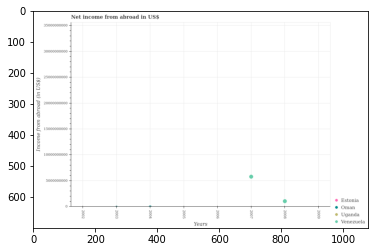

Number of QA =  22





,Years,Uganda,Oman,Venezuela,Estonia
0,2003,NaN,5.638502e+07,NaN,NaN
1,2005,NaN,NaN,NaN,NaN
2,2009,NaN,NaN,NaN,NaN
3,2007,NaN,NaN,5.822667e+09,NaN
4,2004,NaN,2.431515e+07,NaN,NaN
5,2008,NaN,NaN,1.125872e+09,NaN
6,2002,NaN,NaN,NaN,NaN
7,2006,NaN,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in venezuela in 2007 and that in 2008 ?
PREDICTED =  4696794828.7410755
EXPECTED =  4737705000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in venezuela in 2004 and the net income from abroad in uganda in 2008?
PREDICTED =  4696794828.7410755
EXPECTED =  0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest net income from abroad in venezuela ?
PREDICTED =  -5822667278.008007
EXPECTED =  5779000000.0




				 1 / 3 = 0.3333


> what is the difference between two con

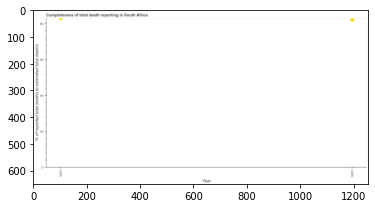

Number of QA =  20





,Year,% of reported total deaths to estimated total deaths
0,2005,83.481271
1,2009,82.647601


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completeness of total death reports in 2005 and 2009 ?
PREDICTED =  0.8336701911703983
EXPECTED =  0.820226218797302




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median completeness of total death reports ?
PREDICTED =  2007.0
EXPECTED =  82.67851796804544




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the completeness of total death reports in 2005 to that in 2009 ?
PREDICTED =  1.0100870464826501
EXPECTED =  1.0099701242561663




				 2 / 3 = 0.6667


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  % of reported total deat

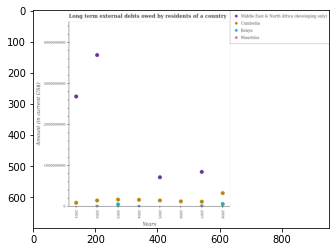

Number of QA =  26





,Years,Kenya,Middle East & North Africa (developing only),Cambodia,Mauritius
0,2002,1.161649e+07,3.689206e+09,1.581718e+08,NaN
1,2007,9.671213e+06,8.526197e+08,1.298043e+08,NaN
2,2008,7.412295e+07,NaN,3.366225e+08,NaN
3,2005,NaN,7.214188e+08,1.576940e+08,NaN
4,2003,6.166290e+07,NaN,1.811956e+08,NaN
5,2006,NaN,NaN,1.367246e+08,NaN
6,2004,NaN,NaN,1.755103e+08,9.744877e+06
7,2001,NaN,2.683153e+09,1.036231e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of long-term external debts owed by residents in cambodia in 2004 and that in 2008 ?
PREDICTED =  0.0
EXPECTED =  -163053000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of long-term external debts owed by residents in kenya in 2002 and the amount of long-term external debts owed by residents in cambodia in 2001?
PREDICTED =  -5.0
EXPECTED =  -91139000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest amount of long-term external debts owed by residents in cambodia ?
PREDICTED =  -1576

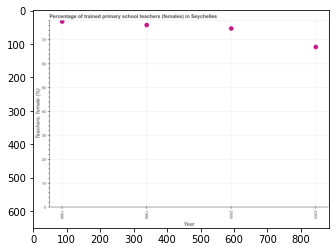

Number of QA =  24





,Year,"Teachers, female (%)"
0,1998,77.094077
1,1999,75.671013
2,2003,66.560745
3,2000,74.234014


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained female teachers in 1998 and 2003 ?
PREDICTED =  10.533332299794182
EXPECTED =  10.63158




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of trained female teachers ?
PREDICTED =  1999.5
EXPECTED =  75.4636611938476




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of trained female teachers in 2000 to that in 2003 ?
PREDICTED =  1.115282204460679
EXPECTED =  1.1154752133497536




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

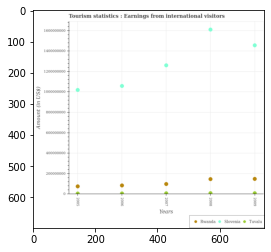

Number of QA =  28





,Years,Slovenia,Tuvalu,Rwanda
0,2009,1.473236e+09,1.237666e+07,1.537348e+08
1,2005,1.031894e+09,9.655467e+06,7.970552e+07
2,2006,1.071624e+09,1.007443e+07,9.005907e+07
3,2008,1.628333e+09,1.245268e+07,1.522716e+08
4,2007,1.275708e+09,1.167942e+07,1.039649e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from international visitors in tuvalu in 2005 and that in 2009 ?
PREDICTED =  -2721190.2696847003
EXPECTED =  -2820000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from international visitors in tuvalu in 2006 and the earnings from international visitors in slovenia in 2007?
PREDICTED =  -1604989.8186479304
EXPECTED =  -1254570000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the earnings from international visitors in tuvalu and earnings from international visitors in rwanda ?
PREDICTED =  -10

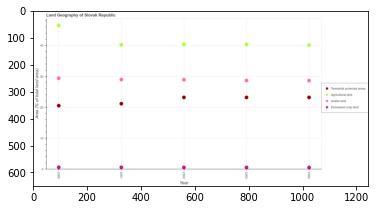

Number of QA =  29





,Year,Terrestrial protected areas,Arable land,Permanent crop land,Agricultural land
0,2004,23.119034,28.546061,0.676004,39.915747
1,2003,23.122146,28.562849,0.687275,40.081312
2,2002,23.129960,28.839007,0.750552,40.116454
3,2000,20.492452,29.271700,0.747183,46.187299
4,2001,21.136135,28.888507,0.731002,39.980471


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of area under agricultural land in 2001 and that in 2002 ?
PREDICTED =  -0.13598297507509471
EXPECTED =  -0.14553014553019494




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of area under arable land in 2003 and the percentage of area under agricultural land in 2004?
PREDICTED =  0.016788765626380098
EXPECTED =  -11.4760914760915




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of land under terrestrial protection and percentage of area under agricultural land ?
PREDICTED =  23.1299600

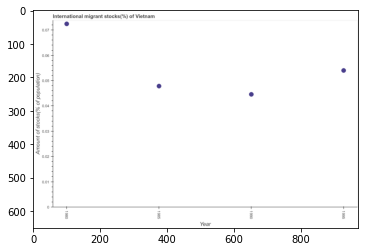

Number of QA =  24





,Year,Amount of stocks(% of population)
0,1985,0.047713
1,1995,0.053856
2,1980,0.072112
3,1990,0.044471


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of international migrant stocks in 1990 and 1995 ?
PREDICTED =  -0.009384889844501969
EXPECTED =  -0.0094447012872945




				 1 / 1 = 1.0


> what is the median number of international migrant stocks ?
PREDICTED =  None
EXPECTED =  0.05091504912992835




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of international migrant stocks in 1990 to that in 1995 ?
PREDICTED =  0.8257401601482848
EXPECTED =  0.8251180516615885




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest number of international migrant 

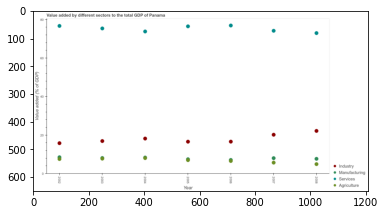

Number of QA =  29





,Year,Industry,Services,Manufacturing,Agriculture
0,2004,18.531552,74.371247,NaN,8.468728
1,2006,16.907116,77.470139,NaN,7.362335
2,2003,17.201959,75.943096,NaN,8.113092
3,2005,16.907019,77.033741,NaN,7.433973
4,2007,20.541817,74.744169,8.293819,5.967321
5,2008,22.533478,73.538441,7.987573,5.205509
6,2002,16.149008,77.276959,7.852794,8.545219


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector in 2002 and that in 2007 ?
PREDICTED =  -4.392808399337181
EXPECTED =  -4.3872958447317




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing sector in 2007 and the value added by services sector in 2008?
PREDICTED =  0.30624552562130614
EXPECTED =  -64.94853808903444




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the value added by industrial sector and value added by manufacturing sector ?
PREDICTED =  19.53347807118705
EXPECTED =  9.513359609096218




				 1 / 

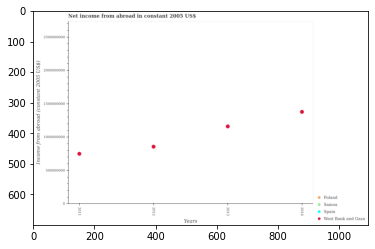

Number of QA =  26





,Years,West Bank and Gaza,Spain,Poland,Samoa
0,2014,1.393587e+09,NaN,NaN,NaN
1,2011,7.605232e+08,NaN,NaN,NaN
2,2012,8.683419e+08,NaN,NaN,NaN
3,2013,1.173502e+09,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in west bank and gaza in 2011 and that in 2012 ?
PREDICTED =  180646678.71468103
EXPECTED =  -106698225.7719841




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in poland in 2011 and the net income from abroad in samoa in 2013?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net income from abroad in west bank and gaza in 2011 to that in 2014?
PREDICTED =  0.5457304877773757
EXPECTED =  0.5438159319021627




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_availab

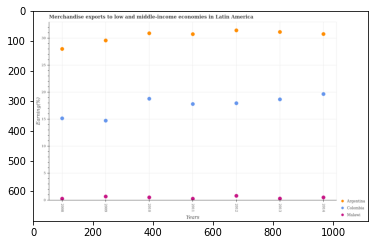

Number of QA =  28





,Years,Unnamed: 1,Colombia,Malawi
0,2011,30.814635,17.887173,0.345275
1,2014,30.836758,19.735054,0.601683
2,2008,28.092233,15.213915,0.351064
3,2013,31.220712,18.749734,0.371214
4,2012,31.516480,18.044670,0.887847
5,2010,30.973527,18.860769,0.610700
6,2009,29.649546,14.808631,0.771018


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in argentina in 2009 and that in 2010 ?
PREDICTED =  -28.97352742322625
EXPECTED =  -1.3291366205855013




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in argentina in 2010 and the percentage of amount earned from merchandise exports in malawi in 2012?
PREDICTED =  30.08568067574213
EXPECTED =  30.07449998529115




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of amount earned from merchandise exports i

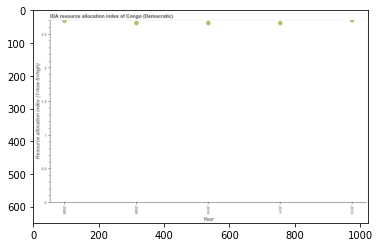

Number of QA =  24





,Year,Resource allocation index (1=low 6=high)
0,2010,2.696314
1,2009,2.695564
2,2008,2.730156
3,2011,2.696212
4,2012,2.737236


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in 2010 and 2012 ?
PREDICTED =  -0.04092173452686465
EXPECTED =  -0.04166666666665986




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median ida resource allocation index ?
PREDICTED =  2.6963142964848044
EXPECTED =  2.66666666666667




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the ida resource allocation index in 2008 to that in 2011 ?
PREDICTED =  1.0125895197438253
EXPECTED =  1.0124999999999988




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

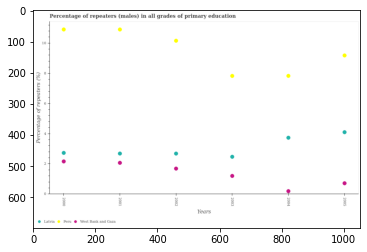

Number of QA =  28





,Years,Unnamed: 1,Latvia,West Bank and Gaza
0,2002,10.181352,2.704075,1.708578
1,2004,7.850734,3.751531,0.219823
2,2000,10.931893,2.750983,2.188171
3,2005,9.206548,4.119368,0.734921
4,2001,10.923344,2.703670,2.089577
5,2003,7.852851,2.489443,1.223409


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters (males) in latvia in 2000 and that in 2005 ?
PREDICTED =  -1.3683847596070646
EXPECTED =  -1.3711097240448002




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters (males) in west bank and gaza in 2002 and the percentage of repeaters (males) in latvia in 2005?
PREDICTED =  0.7509902491698737
EXPECTED =  -2.41086983680725




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of repeaters (males) in latvia and percentage of repeaters (males) in west bank and gaza ?
PREDICT

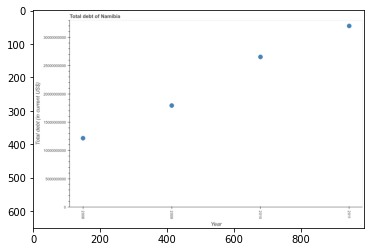

Number of QA =  24





,Year,Total debt (in current US$)
0,2011,3.222809e+10
1,2009,1.810246e+10
2,2008,1.231647e+10
3,2010,2.673032e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in 2009 and 2010 ?
PREDICTED =  -8627858072.91755
EXPECTED =  -8599340000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total debt ?
PREDICTED =  22416390104.774616
EXPECTED =  22243905000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total debt in 2008 to that in 2010 ?
PREDICTED =  0.46076764672690884
EXPECTED =  0.45852700700640364




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the sec

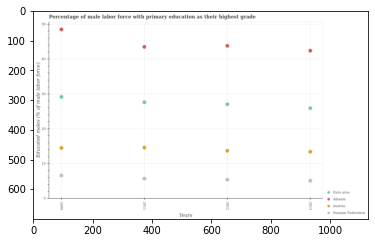

Number of QA =  29





,Years,Unnamed: 1,Austria,Russian Federation,Euro area
0,2013,42.662293,13.582348,5.263260,26.115234
1,2012,44.063404,13.882379,5.558636,27.240435
2,2011,43.780770,14.779790,5.854936,27.817804
3,2009,48.791493,14.688765,6.771348,29.352172


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with primary education in russian federation in 2009 and that in 2013 ?
PREDICTED =  0.0004967709885742673
EXPECTED =  1.5000000000000009




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with primary education in austria in 2011 and the percentage of male labor force with primary education in euro area in 2009?
PREDICTED =  0.0910248209558766
EXPECTED =  -14.5466450176444




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of male labor force with pr

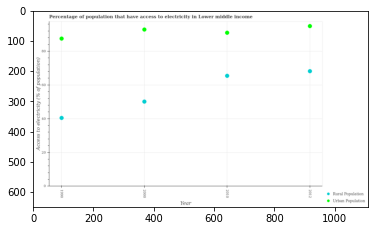

Number of QA =  27





,Year,Urban Population,Rural Population
0,2010,91.193495,65.626508
1,2000,93.014905,50.321169
2,2012,95.095712,68.364796
3,1990,87.701519,40.642412


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2000 and that in 2012 ?
PREDICTED =  -18.04362699563263
EXPECTED =  -18.035555330909617




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to electricity in 1990 and the percentage of rural population having access to electricity in 2000?
PREDICTED =  -5.313385671302299
EXPECTED =  37.362714923164106




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of urban population having access to electricity and per

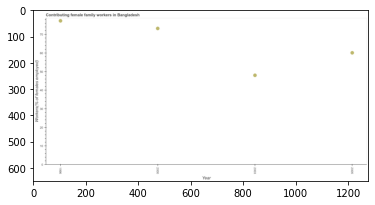

Number of QA =  24





,Year,Workers(% of females employed)
0,2000,73.682832
1,1996,77.706383
2,2003,48.403581
3,2005,60.515396


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contributing female family workers in 1996 and 2005 ?
PREDICTED =  17.19098719572498
EXPECTED =  17.200004577636697




				 1 / 1 = 1.0


> what is the median contributing female family workers ?
PREDICTED =  None
EXPECTED =  66.64999771118165




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the contributing female family workers in 1996 to that in 2005 ?
PREDICTED =  1.2840762594299489
EXPECTED =  1.286189767293305




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest contributing female family workers ?
PREDICTED =  17

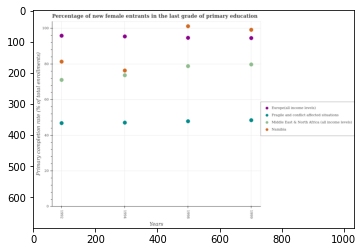

Number of QA =  29





,Years,Europe(all income levels),Fragile and conflict affected situation:,Namibia,Middle East & North Africa (all income levels)
0,1994,95.225109,47.145257,76.177703,73.549394
1,1992,95.669486,46.890229,81.137071,70.944388
2,1998,94.475685,47.858480,100.968753,78.626701
3,1999,94.348186,48.470081,98.959735,79.631155


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of new female entrants in middle east & north africa (all income levels) in 1994 and that in 1999 ?
PREDICTED =  -6.081761729170381
EXPECTED =  -6.062316894531293




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of new female entrants in europe(all income levels) in 1998 and the percentage of new female entrants in fragile and conflict affected situations in 1999?
PREDICTED =  0.12749886500496643
EXPECTED =  46.235797882080114




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the percentage of new fema

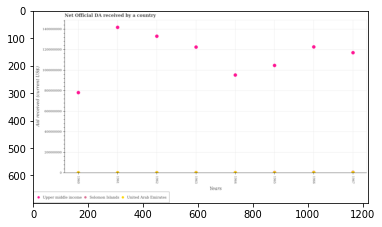

Number of QA =  28





,Years,Solomon Islands,United Arab Emirates,Upper middle income
0,1960,NaN,7.911639e+06,7.907069e+08
1,1965,NaN,9.343708e+06,1.057642e+09
2,1963,NaN,9.212876e+06,1.237790e+09
3,1962,NaN,7.890054e+06,1.343262e+09
4,1964,NaN,8.686499e+06,9.639278e+08
5,1967,NaN,1.066076e+07,1.182803e+09
6,1966,NaN,1.035980e+07,1.239278e+09
7,1961,NaN,7.528370e+06,1.430550e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official development assistance aid received in upper middle income in 1961 and that in 1962 ?
PREDICTED =  87287566.66639256
EXPECTED =  86490000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official development assistance aid received in solomon islands in 1967 and the net official development assistance aid received in united arab emirates in 1961?
PREDICTED =  3132392.6354685025
EXPECTED =  5460000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
E

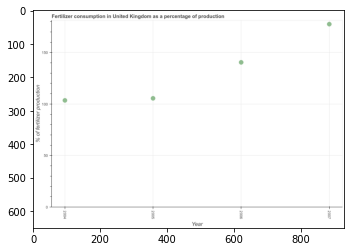

Number of QA =  24





,Year,% of fertilizer production
0,2007,177.959899
1,2006,140.833100
2,2005,106.076054
3,2004,103.979899


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in 2004 and 2005 ?
PREDICTED =  -2.096155775118447
EXPECTED =  -2.013399232070995




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of fertilizer consumption ?
PREDICTED =  123.45457734985773
EXPECTED =  123.024149002365




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of fertilizer consumption in 2004 to that in 2005 ?
PREDICTED =  0.9802391238125527
EXPECTED =  0.9809268874435667




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tra

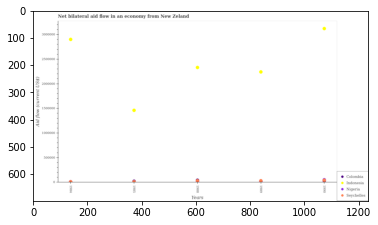

Number of QA =  29





,Years,Seychelles,Colombia,Nigeria,Indonesia
0,1985,24643.281373,NaN,NaN,1.465434e+06
1,1988,19820.192618,NaN,43218.529636,2.334698e+06
2,1989,12210.463948,39946.877000,NaN,2.244563e+06
3,1984,17974.020582,NaN,NaN,2.903374e+06
4,1990,29247.375465,59256.194031,NaN,3.124036e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in nigeria in 1989 and that in 1990 ?
PREDICTED =  0.0
EXPECTED =  -40000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in colombia in 1984 and the net bilateral aid flow in nigeria in 1988?
PREDICTED =  -59256.19403061525
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilateral aid flow in indonesia in 1985 to that in 1988

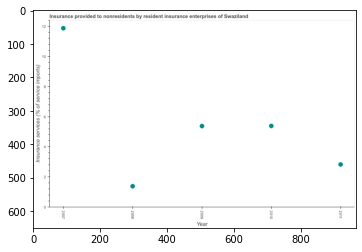

Number of QA =  24





,Year,Insurance services (% of service imports)
0,2010,5.419901
1,2008,1.421984
2,2009,5.412998
3,2011,2.857832
4,2007,11.905210


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance and financial services in 2008 and 2011 ?
PREDICTED =  1.1237690001330165
EXPECTED =  -1.4460629940133098




				 0 / 1 = 0.0


> what is the median insurance and financial services ?
PREDICTED =  None
EXPECTED =  5.375821486707292




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the insurance and financial services in 2007 to that in 2011 ?
PREDICTED =  4.165818237512179
EXPECTED =  4.20169889659388




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest insurance and financial services ?
PREDICTED =  0.0
EXPECTED

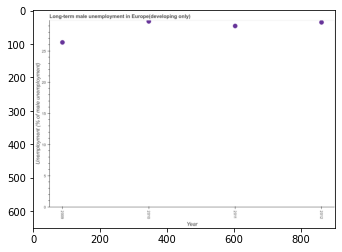

Number of QA =  24





,Year,Unemployment (% of male unemployment)
0,2010,29.867262
1,2011,29.131417
2,2009,26.490871
3,2012,29.705108


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term male unemployment in 2009 and 2012 ?
PREDICTED =  -3.214237254890456
EXPECTED =  -3.2105191599411995




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median long-term male unemployment ?
PREDICTED =  29.418262238644402
EXPECTED =  29.2936020215404




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the long-term male unemployment in 2009 to that in 2012 ?
PREDICTED =  0.8917951323729301
EXPECTED =  0.8914840684427399




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.


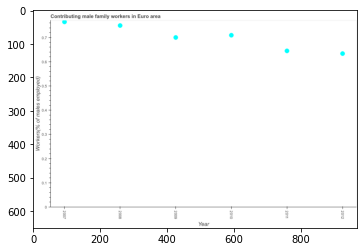

Number of QA =  24





,Year,Workers(% of males employed)
0,2011,0.649288
1,2009,0.704877
2,2010,0.714301
3,2008,0.754014
4,2007,0.769248
5,2012,0.637976


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contributing male family workers in 2009 and 2012 ?
PREDICTED =  0.066901622567337
EXPECTED =  0.06656185750853205




				 1 / 1 = 1.0


> what is the median contributing male family workers ?
PREDICTED =  None
EXPECTED =  0.7047916426221006




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the contributing male family workers in 2007 to that in 2010 ?
PREDICTED =  1.0769239375664243
EXPECTED =  1.0774673865836923




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest contributing male family workers ?
PREDICTED =  0.0
EXP

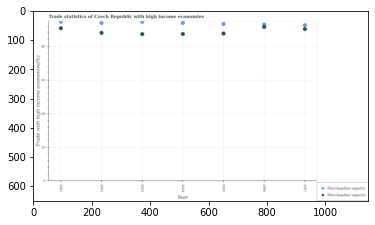

Number of QA =  27





,Year,Merchandise exports,Merchandise imports
0,2003,94.880556,87.545113
1,2002,94.216011,88.317218
2,2004,94.278912,87.597710
3,2006,93.355597,91.927852
4,2007,92.802807,90.566060
5,2005,93.641025,87.939309
6,2001,94.873422,91.123501


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 2002 and that in 2004 ?
PREDICTED =  0.719508296209284
EXPECTED =  0.6574168738679731




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 2006 and the merchandise imports in 2005?
PREDICTED =  -0.2854280961964406
EXPECTED =  5.361184790007783




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the merchandise exports and merchandise imports ?
PREDICTED =  0.8749547115017293
EXPECTED =  2.27394449143911




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
T

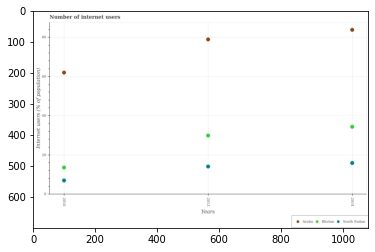

Number of QA =  28





,Years,Bhutan,Unnamed: 2,South Sudan
0,2010,13.811589,62.012595,7.223972
1,2013,30.064680,78.889769,14.295667
2,2014,34.517662,83.763391,16.078006


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of internet users in south sudan in 2010 and that in 2013 ?
PREDICTED =  -7.071694173496023
EXPECTED =  -7.1




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of internet users in south sudan in 2013 and the number of internet users in bhutan in 2014?
PREDICTED =  -1.7823393235163572
EXPECTED =  -20.269999999999996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the number of internet users in south sudan and number of internet users in bhutan ?
PREDICTED =  34.59764514620521
EXPECTED =  -6.6




				 1 / 3 =

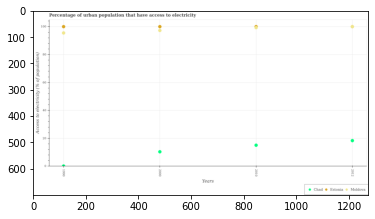

Number of QA =  28





,Years,Moldova,Chad,Estonia
0,1990,95.549846,0.495447,100.016205
1,2000,97.362331,10.599272,99.957445
2,2012,100.041297,18.574914,NaN
3,2010,99.437523,15.314700,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population that have access to electricity in estonia in 1990 and that in 2012 ?
PREDICTED =  0.02938019830709493
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population that have access to electricity in chad in 2012 and the percentage of urban population that have access to electricity in moldova in 2010?
PREDICTED =  3.2602135541054036
EXPECTED =  -80.9617355364428




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of urban population that have acces

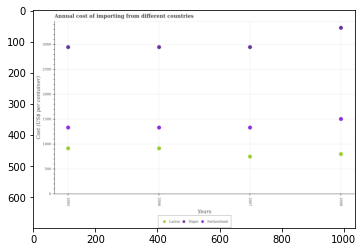

Number of QA =  28





,Years,Latvia,Switzerland,Niger
0,2008,811.954120,1514.720570,3342.670681
1,2005,924.234423,1342.730643,2954.156473
2,2006,927.226830,1344.117808,2957.020096
3,2007,761.485337,1343.890678,2956.024977


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in latvia in 2005 and that in 2007 ?
PREDICTED =  162.7490858385263
EXPECTED =  165




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in niger in 2006 and the total annual cost of importing in latvia in 2007?
PREDICTED =  0.9951191051345631
EXPECTED =  2195




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the total annual cost of importing in latvia and total annual cost of importing in switzerland ?
PREDICTED =  3420.9007095975685
EXPECTED =  -417




				 1 / 3

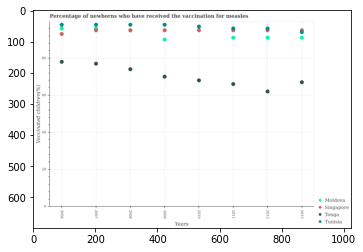

Number of QA =  29





,Years,Moldova,Tunisia,Tonga,Singapore
0,2006,96.440044,98.371547,78.346049,93.438389
1,2009,90.430437,98.426416,70.365979,95.447561
2,2013,91.474475,94.413481,67.392716,95.465174
3,2007,NaN,98.412302,77.360689,95.491870
4,2012,91.431017,95.413817,62.414369,96.355274
5,2010,NaN,97.374039,68.419612,95.460494
6,2011,91.427083,95.643862,66.431001,96.516098
7,2008,NaN,98.469741,74.411114,95.475027


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in singapore in 2007 and that in 2010 ?
PREDICTED =  0.0313764056153758
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in moldova in 2013 and the percentage of vaccinated children in tunisia in 2007?
PREDICTED =  -6.937827316079051
EXPECTED =  -7.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of vaccinated children in tunisia and percentage of vaccinated children in tonga ?
PREDICTED =  31.999112165260698
EXPECTED =  21.0

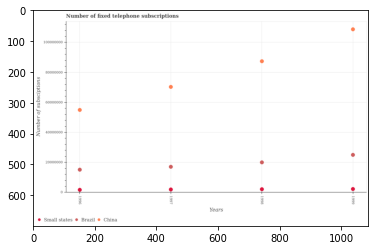

Number of QA =  28





,Years,China,Brazil,Small states
0,1999,1.082737e+08,2.514615e+07,2.585855e+06
1,1998,8.708541e+07,2.020902e+07,2.444987e+06
2,1997,7.011706e+07,1.727221e+07,2.250765e+06
3,1996,5.483917e+07,1.534568e+07,2.042410e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in brazil in 1997 and that in 1999 ?
PREDICTED =  -7873935.258483224
EXPECTED =  -7946177




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in small states in 1997 and the number of fixed telephone subscriptions in china in 1996?
PREDICTED =  208355.41142492858
EXPECTED =  -53044722.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the number of fixed telephone subscriptions in brazil and number of fixed telephone subscriptions in china ?
PREDI

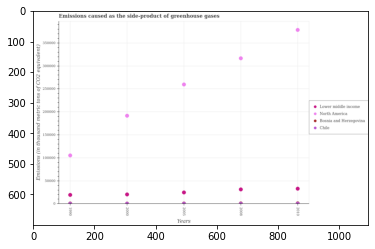

Number of QA =  29





,Years,North America,Chile,Lower middle income,Bosnia and Herzegovina
0,2000,191487.395198,1445.783328,21076.614377,NaN
1,1990,105796.460235,1668.839270,20144.501193,NaN
2,2010,377468.698226,1889.317117,33596.999341,NaN
3,2005,259265.098881,1708.809888,25415.730458,NaN
4,2008,316017.164427,1849.123199,32131.748353,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emissions caused as the side-product of greenhouse gases in chile in 2000 and that in 2010 ?
PREDICTED =  -356392.08384857164
EXPECTED =  -1.0999999999999996




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emissions caused as the side-product of greenhouse gases in lower middle income in 2000 and the emissions caused as the side-product of greenhouse gases in chile in 2010?
PREDICTED =  -12520.384964348701
EXPECTED =  20306.3




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the emissions caused as the side-product of gree

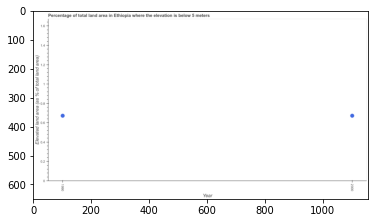

Number of QA =  20





,Year,Elevated land area (as % of total land area)
0,2000,0.676268
1,1990,0.675537


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total elevated land area in 1990 and 2000 ?
PREDICTED =  -0.0007308701811863383
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total elevated land area ?
PREDICTED =  1995.0
EXPECTED =  0.6725273




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total elevated land area in 1990 to that in 2000 ?
PREDICTED =  0.9989192594497993
EXPECTED =  1.0




				 1 / 3 = 0.3333


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Elevated land area (as % of total land area)
EXPECTED =  0.2




				 1 / 4 = 0.25


> wha

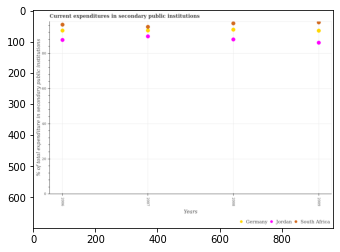

Number of QA =  28





,Years,South Africa,Germany,Jordan
0,2008,97.278562,93.732114,88.198308
1,2009,97.881480,93.185923,86.326038
2,2006,96.593799,93.243426,87.912339
3,2007,95.290342,93.244800,89.987361


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in secondary public institutions in south africa in 2008 and that in 2009 ?
PREDICTED =  -0.6029179988352809
EXPECTED =  -0.5500640869140909




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in secondary public institutions in south africa in 2009 and the current expenditures in secondary public institutions in germany in 2007?
PREDICTED =  4.6366795373836
EXPECTED =  4.600158691406293




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the current expenditures in secondary public inst

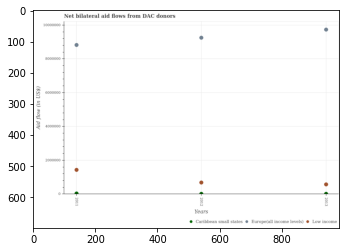

Number of QA =  28





,Years,Europe(all income levels),Caribbean small states,Low income
0,2011,8.897976e+06,55554.353949,1.458882e+06
1,2012,9.327966e+06,32332.536739,7.088798e+05
2,2013,9.809751e+06,37503.684337,6.000691e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in caribbean small states in 2011 and that in 2013 ?
PREDICTED =  18050.66961272232
EXPECTED =  20000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in caribbean small states in 2013 and the net bilateral aid flow in low income in 2012?
PREDICTED =  5171.147597529776
EXPECTED =  -670000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the net bilateral aid flow in low income and net bilateral aid flow in europe(all income levels) ?
PREDICTED =  922607.3881447177
EXPECTED 

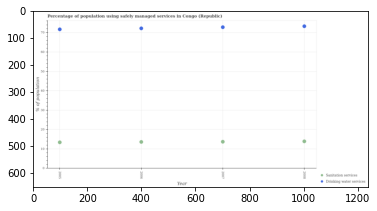

Number of QA =  27





,Year,Sanitation services,Drinking water services
0,2007,13.842972,72.505097
1,2008,14.085577,73.020297
2,2006,13.741329,71.929058
3,2005,13.551173,71.373974


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used sanitation services in 2007 and that in 2008 ?
PREDICTED =  -0.24260467218564408
EXPECTED =  -0.20000000000000107




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used drinking water services in 2005 and the percentage of population who used sanitation services in 2008?
PREDICTED =  -1.6463229994621003
EXPECTED =  57.800000000000004




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of population who used drinking water services and percentage of p

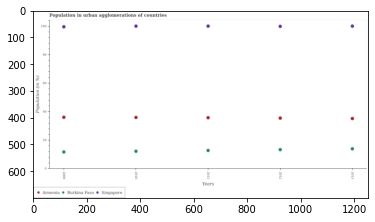

Number of QA =  28





,Years,Burkina Faso,Armenia,Singapore
0,2010,12.544850,36.346359,100.521858
1,2011,13.103752,36.101586,100.510404
2,2013,14.265587,35.543963,100.549009
3,2012,13.664423,35.856981,100.404112
4,2009,12.010601,36.407877,100.074866


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the percentage of population in urban agglomerations in burkina faso in 2012 ?
PREDICTED =  0.006794840091040271
EXPECTED =  13.3561628354198




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum percentage of population in urban agglomerations in burkina faso ?
PREDICTED =  0.007093777551907149
EXPECTED =  13.9550438366726




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum percentage of population in urban agglomerations in singapore ?
PREDICTED =  0.9990054699154649
EXPECTED =  99.53308204346779




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: F

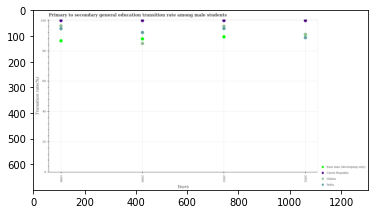

Number of QA =  29





,Years,East Asia (developing only),Ghana,Czech Republic,India
0,1999,86.815708,96.639388,100.107908,94.875244
1,2002,NaN,90.939406,100.189218,88.892405
2,2000,88.084936,85.074646,100.164884,92.320861
3,2001,89.447130,96.514368,100.105831,94.947079


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate in czech republic in 1999 and that in 2002 ?
PREDICTED =  -0.0813103532298669
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate in czech republic in 1999 and the transition rate in east asia (developing only) in 2001?
PREDICTED =  0.002076906413861934
EXPECTED =  10.687461853027301




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the transition rate in east asia (developing only) and transition rate in czech republic ?
PREDICTED =  174.90064444329437
EXPECTED =  -12.0895614624

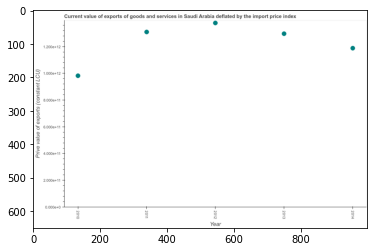

Number of QA =  24





,Year,Prive value of exports (constant LCU)
0,2013,1.312891
1,2010,0.995611
2,2011,1.325686
3,2012,1.393439
4,2014,1.203844


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price value of exports in 2010 and 2011 ?
PREDICTED =  -0.3300755340697855
EXPECTED =  -327451993756.8501




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median price value of exports ?
PREDICTED =  1.3128906993110316
EXPECTED =  1296394043082.93




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the price value of exports in 2011 to that in 2014 ?
PREDICTED =  1.101210847931413
EXPECTED =  1.1020047508772828




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what i

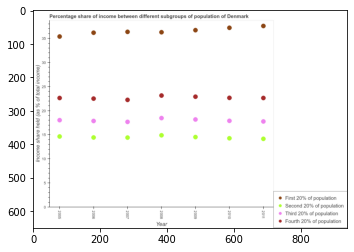

Number of QA =  29





,Year,Fourth 20% of populatior,Third 20% of population,First 20% of population,Second 20% of population
0,2007,22.329774,17.763248,36.407361,14.500653
1,2010,22.759265,18.005196,37.268698,14.382487
2,2005,22.701847,18.137930,35.460377,14.747493
3,2006,22.582615,17.955290,36.238702,14.542570
4,2009,23.014126,18.281287,36.789320,14.629275
5,2008,23.245944,18.557045,36.350228,14.982861
6,2011,22.716191,17.857688,37.632898,14.261840


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of the income held by second 20% of the population in 2006 and the share of the income held by third 20% of the population in 2008?
PREDICTED =  4.025569320972071
EXPECTED =  -4.030000000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the share of the income held by first 20% of the population in 2005 to that in 2007?
PREDICTED =  0.9739891930149608
EXPECTED =  0.973322332233

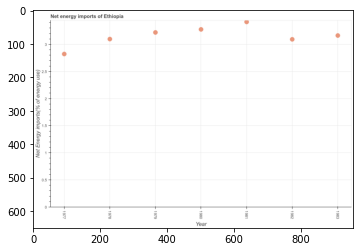

Number of QA =  24





,Year,Net Energy imports(% of energy use)
0,1978,3.099953
1,1980,3.279239
2,1982,3.098559
3,1983,3.167813
4,1981,3.417427
5,1979,3.221179
6,1977,2.826561


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the energy imports in 1979 and 1982 ?
PREDICTED =  0.12262038748679238
EXPECTED =  0.1268948201115001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median energy imports ?
PREDICTED =  3.167813041548561
EXPECTED =  3.162594427481169




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the energy imports in 1977 to that in 1978 ?
PREDICTED =  0.9118077860545512
EXPECTED =  0.9110619082827007




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between t

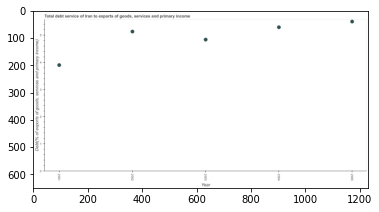

Number of QA =  24





,Year,"Debt(% of exports of goods, services and primary income)"
0,2004,5.290823
1,2001,3.901819
2,2002,5.132102
3,2003,4.840507
4,2005,5.501934


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in 2001 and 2005 ?
PREDICTED =  -1.6001146192071958
EXPECTED =  -1.6013350822312598




				 1 / 1 = 1.0


> what is the median total debt service ?
PREDICTED =  None
EXPECTED =  5.130541764018691




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total debt service in 2001 to that in 2004 ?
PREDICTED =  0.7374692238165418
EXPECTED =  0.7367225711987271




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest total debt service ?
PREDICTED =  0.0
EXPECTED =  0.20878133317046998




				 2 / 5 = 0.4


is_

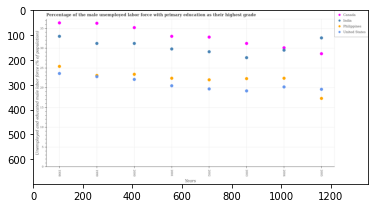

Number of QA =  29





,Years,Philippines,United States,Canada,India
0,2001,22.680941,20.793635,33.379982,30.169038
1,1998,25.699743,23.911124,36.828300,33.397472
2,2003,22.609270,19.477884,31.577496,27.945963
3,1999,NaN,NaN,36.699619,31.573603
4,2000,23.700685,22.403140,35.600678,31.563785
5,2005,17.569406,19.878975,28.949753,32.972743
6,2002,22.299705,19.963461,33.184853,29.457884
7,2004,22.701103,20.462933,30.447867,29.868036


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with primary education in philippines in 1998 and that in 2002 ?
PREDICTED =  3.4000387301402277
EXPECTED =  3.399999618530309




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with primary education in india in 1999 and the percentage of the unemployed male labor force with primary education in united states in 2000?
PREDICTED =  0.009818027754803893
EXPECTED =  9.100000381469808




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the 

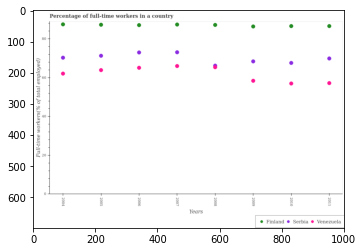

Number of QA =  28





,Years,Serbia,Venezuela,Finland
0,2008,65.375887,66.212082,87.103402
1,2006,72.997619,65.103912,87.018922
2,2010,67.634911,57.068663,86.565364
3,2009,68.381849,58.424902,86.308050
4,2005,71.258391,63.903031,87.187559
5,2004,70.276539,62.100891,87.437987
6,2011,69.920941,57.240190,86.558610
7,2007,73.101275,66.012806,87.311314


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in serbia in 2004 and that in 2011 ?
PREDICTED =  0.35559767107758944
EXPECTED =  0.40000152587890625




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in venezuela in 2011 and the percentage of full-time workers in serbia in 2004?
PREDICTED =  -4.8607004374401654
EXPECTED =  -13.100002288818295




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of full-time workers in serbia and percentage of full-time workers in venezuela ?
PREDICTED =  81.408499

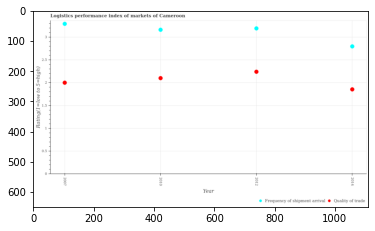

Number of QA =  27





,Year,Quality of trade,Frequency of shipment arrival
0,2010,2.120615,3.185175
1,2012,2.261240,3.214756
2,2014,1.873798,2.820661
3,2007,2.019156,3.314507


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi quality of trade in 2010 and that in 2014 ?
PREDICTED =  0.24681645297422317
EXPECTED =  0.2462580000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi of frequency of shipment arrival in 2007 and the lpi quality of trade in 2010?
PREDICTED =  0.12933286426477553
EXPECTED =  1.19




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the lpi of frequency of shipment arrival and lpi quality of trade ?
PREDICTED =  0.0
EXPECTED =  1.06




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []

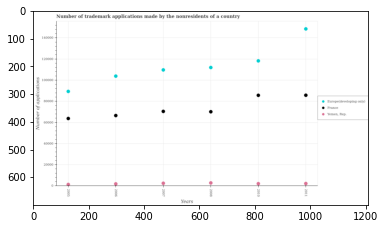

Number of QA =  28





,Years,"Yemen, Rep.",Europe(developing only),France
0,2010,2585.152773,117653.071628,85351.235470
1,2007,2936.497036,109206.659653,70292.096454
2,2006,2263.269595,103397.750380,66370.913185
3,2008,3283.416189,111444.837760,70001.046305
4,2011,2742.204547,147666.365299,85419.194224
5,2005,1682.898102,88946.344394,63663.625774


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents in europe(developing only) in 2006 and that in 2010 ?
PREDICTED =  0.0
EXPECTED =  -14417.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents in yemen, rep. in 2011 and the number of trademark applications made by the nonresidents in europe(developing only) in 2005?
PREDICTED =  0.0
EXPECTED =  -87132.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the number of trademark applications made by the nonresiden

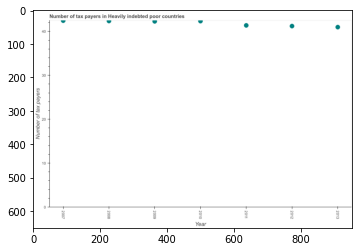

Number of QA =  24





,Year,Number of tax payers
0,2010,42.424693
1,2013,41.059508
2,2007,42.493314
3,2011,41.433490
4,2012,41.300128
5,2008,42.424506
6,2009,42.347519


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tax payers in 2011 and 2013 ?
PREDICTED =  0.37398122605408446
EXPECTED =  0.3947368421053099




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of tax payers ?
PREDICTED =  2010.0
EXPECTED =  42.2894736842105




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of tax payers in 2009 to that in 2012 ?
PREDICTED =  1.0253604914130026
EXPECTED =  1.0261813537675593




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference 

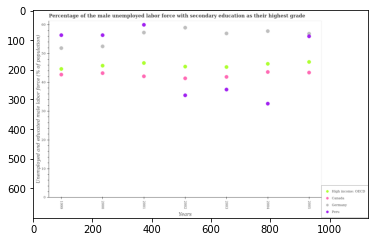

Number of QA =  29





,Years,Unnamed: 1,High income: OECD,Germany,Canada
0,2004,32.759375,46.606175,57.966206,43.782782
1,2002,35.653778,45.625781,59.154580,41.563856
2,2001,60.138841,46.876450,57.453391,42.267924
3,2003,37.691523,45.505327,57.131806,42.065585
4,1999,56.548286,44.808687,52.064834,42.866518
5,2005,56.157173,47.268014,57.102284,43.572703
6,2000,56.561021,45.965808,52.640006,43.366033


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with secondary education in peru in 2000 and that in 2003 ?
PREDICTED =  0.4604800836135965
EXPECTED =  18.9000015258789




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with secondary education in high income: oecd in 2002 and the percentage of the unemployed male labor force with secondary education in germany in 1999?
PREDICTED =  2.0677633264836572
EXPECTED =  -6.422982519146906




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between t

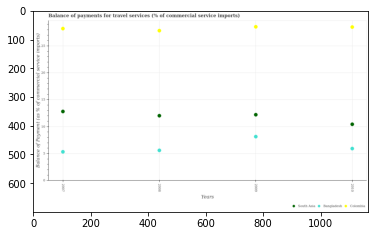

Number of QA =  28





,Years,Bangladesh,South Asia,Colombia
0,2010,6.037134,10.574685,28.678161
1,2008,5.699932,12.161097,28.005467
2,2009,8.267340,12.342457,28.733694
3,2007,5.440821,12.958971,28.374685


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in south asia in 2007 and that in 2009 ?
PREDICTED =  0.6165140407305536
EXPECTED =  0.6006574289287006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in south asia in 2010 and the balance of payments for travel services in bangladesh in 2008?
PREDICTED =  -1.5864123459598503
EXPECTED =  4.849595817760579




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the balance of payments for travel services in colombia and balance of payments for travel

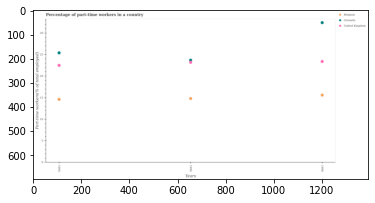

Number of QA =  28





,Years,Grenada,United Kingdom,Belgium
0,1996,23.906454,23.391740,14.953064
1,1998,32.628862,23.580440,15.760900
2,1994,25.593386,22.669935,14.729852


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time workers in united kingdom in 1994 and that in 1998 ?
PREDICTED =  -0.9105045862383889
EXPECTED =  -0.899999618530309




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time workers in belgium in 1994 and the percentage of part-time workers in united kingdom in 1996?
PREDICTED =  -0.2232118443535196
EXPECTED =  -8.6000003814698




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of part-time workers in united kingdom and percentage of part-time workers in grenada ?
PREDIC

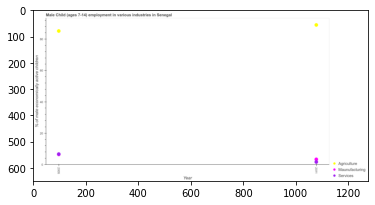

Number of QA =  24





,Year,Maunufacturing,Services,Agriculture
0,2011,3.651097,2.050585,89.649281
1,2005,NaN,6.915134,85.778710


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in manufacturing in 2005 and that in 2011 ?
PREDICTED =  -3.87057097543871
EXPECTED =  3.14




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in services in 2011 and the percentage of economically active children in agriculture in 2005?
PREDICTED =  -4.864548572696198
EXPECTED =  -83.54




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of economically active children in agriculture and percentage of economically active childr

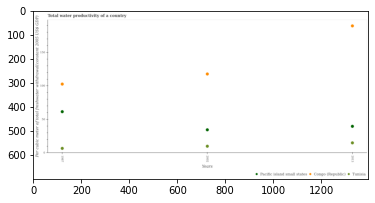

Number of QA =  28





,Years,Congo (Republic),Tunisia,Pacific island small states
0,1987,103.592274,7.306940,62.205685
1,2002,118.686594,10.349173,35.145386
2,2013,190.971478,15.579328,40.442480


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total water productivity in tunisia in 1987 and that in 2013 ?
PREDICTED =  -8.272387815522618
EXPECTED =  -8.21789513675674




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total water productivity in pacific island small states in 2013 and the total water productivity in congo (republic) in 1987?
PREDICTED =  -21.7632044839973
EXPECTED =  -63.0752555569486




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the total water productivity in congo (republic) and total water productivity in pacific island small states ?
PREDICT

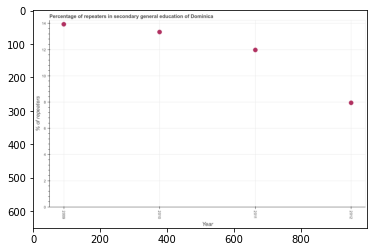

Number of QA =  24





,Year,% of repeaters
0,2010,13.274235
1,2012,7.925161
2,2011,11.930513
3,2009,13.865869


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters in 2009 and 2012 ?
PREDICTED =  5.940708008411139
EXPECTED =  5.98947000503544




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of repeaters ?
PREDICTED =  2010.5
EXPECTED =  12.657824993133548




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of repeaters in 2009 to that in 2010 ?
PREDICTED =  1.0445701041109348
EXPECTED =  1.044340782674795




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the diffe

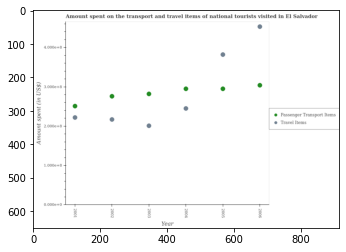

Number of QA =  27





,Year,Passenger Transport Items,Travel Items
0,2005,2.944073,3.808416
1,2006,3.032097,4.513189
2,2003,2.814434,2.011280
3,2001,2.507294,2.217546
4,2004,2.943747,2.447676
5,2002,2.753906,2.169298


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in travel items in 2001 and that in 2002 ?
PREDICTED =  0.048247866336387
EXPECTED =  5000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items in 2002 and the amount spent in travel items in 2005?
PREDICTED =  -0.1901674833577771
EXPECTED =  -106000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the amount spent in travel items and amount spent on passenger transport items ?
PREDICTED =  0.0
EXPECTED =  -81000000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_

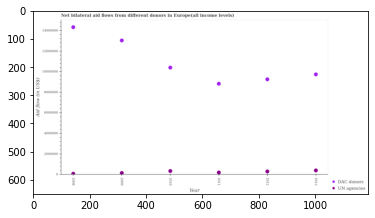

Number of QA =  27





,Year,DAC donors,UN agencies
0,2010,1.038628e+07,362308.165577
1,2009,1.300501e+07,168453.508563
2,2008,1.430924e+07,101745.162777
3,2012,9.244764e+06,331253.299488
4,2013,9.730040e+06,425426.982183
5,2011,8.814784e+06,234305.889699


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow from un agencies in 2009 and that in 2010 ?
PREDICTED =  -193854.65701405462
EXPECTED =  -190000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow from un agencies in 2012 and the aid flow from dac donors in 2008?
PREDICTED =  229508.13671064933
EXPECTED =  -14030000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the aid flow from dac donors and aid flow from un agencies ?
PREDICTED =  55760081.07817659
EXPECTED =  14250000




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: 

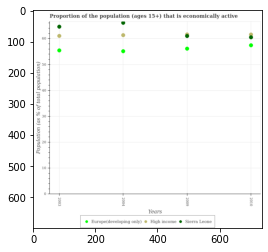

Number of QA =  28





,Years,Sierra Leone,High income,Europe(developing only)
0,2009,60.624807,NaN,55.778758
1,2004,65.654617,60.962457,54.803649
2,2003,64.185685,60.666031,55.131133
3,2010,60.148661,61.244150,57.079352


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the population that is economically active in sierra leone in 2004 and that in 2010 ?
PREDICTED =  5.50595622023355
EXPECTED =  5.599998474120994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the population that is economically active in europe(developing only) in 2010 and the proportion of the population that is economically active in sierra leone in 2009?
PREDICTED =  1.300593917479901
EXPECTED =  -3.574596387756607




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the proportion of the popu

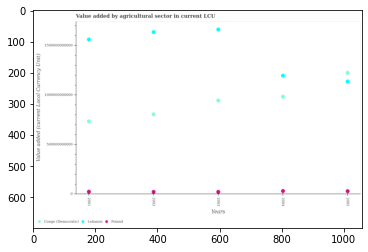

Number of QA =  28





,Years,Poland,Congo (Democratic),Lebanon
0,2003,2.658389e+10,9.500286e+11,1.667663e+12
1,2001,2.862690e+10,7.395360e+11,1.565509e+12
2,2002,2.840530e+10,8.099380e+11,1.640760e+12
3,2005,3.455966e+10,1.229986e+12,1.141976e+12
4,2004,3.676775e+10,9.879248e+11,1.200626e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in congo (democratic) in 2003 and that in 2004 ?
PREDICTED =  -37896169994.51575
EXPECTED =  -38300000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in poland in 2001 and the value added by agricultural sector in lebanon in 2005?
PREDICTED =  -5932762014.506504
EXPECTED =  -1112374841700.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the value added by agricultural sector in congo (democratic) and value added by agricultural sector in lebanon

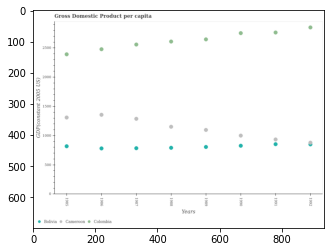

Number of QA =  28





,Years,Colombia,Bolivia,Cameroon
0,1989,2648.716135,811.890734,1103.626597
1,1990,2754.546652,833.274867,1005.608586
2,1986,2480.679821,787.005981,1362.279900
3,1988,2611.828764,798.077040,1157.562464
4,1985,2394.597578,822.858273,1313.404189
5,1987,2560.562374,790.778382,1293.485726
6,1991,2765.767312,858.860246,939.535792
7,1992,2853.186098,884.244508,855.612099


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in colombia in 1988 and that in 1992 ?
PREDICTED =  -241.35733462208827
EXPECTED =  -241.38658917869998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in colombia in 1991 and the gdp per capita in bolivia in 1988?
PREDICTED =  153.93854845595024
EXPECTED =  1973.0241904516552




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1989, what is the difference between the gdp per capita in cameroon and gdp per capita in bolivia ?
PREDICTED =  478.0353918862588
EXPECTED =  291.53201494235896




				 1 / 3 = 0.3333


is_built_with_cuda:

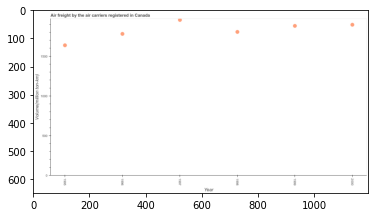

Number of QA =  24





,Year,Volume(million ton-km)
0,1997,1964.913734
1,1996,1788.357257
2,2000,1903.575358
3,1999,1889.354059
4,1998,1813.240997
5,1995,1645.587758


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the air freight in 1995 and 1996 ?
PREDICTED =  -142.76949871093757
EXPECTED =  -143.59997558589998




				 1 / 1 = 1.0


> what is the median air freight ?
PREDICTED =  None
EXPECTED =  1843.6499633788999




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the air freight in 1997 to that in 1998 ?
PREDICTED =  1.0836473124968977
EXPECTED =  1.0835133482338695




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest air freight ?
PREDICTED =  75.55967440752943
EXPECTED =  60.38599999999997




				 2 / 5 = 0.4


is_built_with_cuda

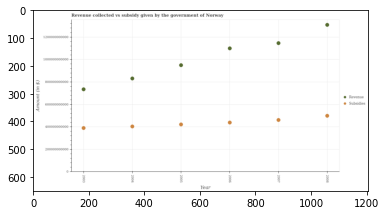

Number of QA =  27





,Year,Revenue,Subsidies
0,2008,1.322118e+12,5.064605e+11
1,2004,8.402936e+11,4.099315e+11
2,2003,7.426770e+11,3.960024e+11
3,2006,1.110569e+12,4.458330e+11
4,2007,1.157926e+12,4.684685e+11
5,2005,9.605042e+11,4.290322e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of subsidies given in 2006 and that in 2008 ?
PREDICTED =  -60627502683.854675
EXPECTED =  -60220000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of revenue collected in 2006 and the amount of subsidies given in 2005?
PREDICTED =  150064730784.54333
EXPECTED =  677866000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount of subsidies given and amount of revenue collected ?
PREDICTED =  0.0
EXPECTED =  -684530000000




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
G

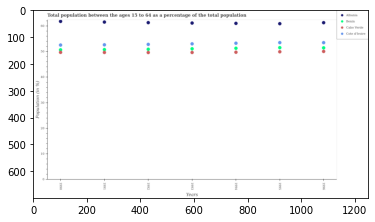

Number of QA =  29





,Years,Benin,Cote d'Ivoire,Cabo Verde,Albania
0,1993,51.463028,53.371326,49.974484,61.519030
1,1995,51.887541,53.826946,50.255729,61.261405
2,1996,51.790145,53.837734,50.354759,61.661494
3,1992,51.231534,53.102218,49.960402,61.657658
4,1994,51.657675,53.625198,50.042996,61.399672
5,1991,51.113067,53.003620,50.018060,61.875351
6,1990,51.027252,52.891422,50.061716,62.189253


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 15 to 64 in benin in 1992 and that in 1996 ?
PREDICTED =  -0.5586110862750857
EXPECTED =  -0.545702728487413




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 15 to 64 in benin in 1992 and the percentage of the population ages 15 to 64 in albania in 1996?
PREDICTED =  -0.5586110862750857
EXPECTED =  -10.384555847168215




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the percentage of the population ages 15 to 64 in albania and percentage of the population 

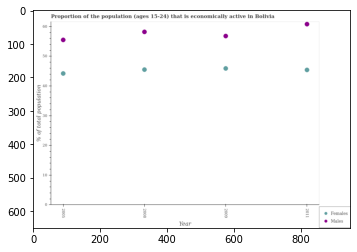

Number of QA =  27





,Year,Males,Females
0,2011,61.407437,45.878483
1,2009,57.375527,46.407271
2,2008,58.772194,45.963825
3,2005,56.066465,44.693688


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in 2005 and that in 2008 ?
PREDICTED =  -1.2701368842536525
EXPECTED =  -1.2999992370604971




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in 2009 and the percentage of economically active female population in 2008?
PREDICTED =  -1.3966666857412235
EXPECTED =  11.299999237060497




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of economically active male population and percentage of economically active fem

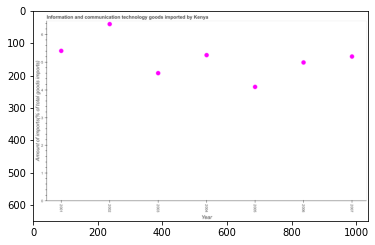

Number of QA =  24





,Year,Amount of imports(% of total goods imports)
0,2002,6.383857
1,2007,5.216383
2,2006,5.002593
3,2004,5.265531
4,2005,4.124899
5,2001,5.421463
6,2003,4.620065


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of ict goods imports in 2003 and 2007 ?
PREDICTED =  -0.5963174857472522
EXPECTED =  -0.5993679597000003




				 1 / 1 = 1.0


> what is the median amount of ict goods imports ?
PREDICTED =  None
EXPECTED =  5.204278402




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of ict goods imports in 2006 to that in 2007 ?
PREDICTED =  0.9590157713399119
EXPECTED =  0.9587759059512362




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest amount of ict goods imports ?
PREDICTED =  1.7132162159176554
EXPECTED =  0

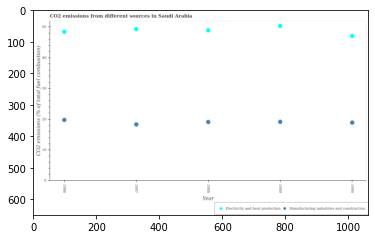

Number of QA =  27





,Year,Manufacturing industries and construction,Electricity and heat production
0,1986,19.817563,48.334148
1,1988,19.126838,48.838844
2,1989,19.169105,50.240600
3,1987,18.336236,49.183798
4,1990,18.950966,47.015801


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions due to manufacturing industries in 1986 and that in 1988 ?
PREDICTED =  -29.021281094397526
EXPECTED =  0.6687495707630013




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions due to manufacturing industries in 1989 and the co2 emissions due to electricity and heat production in 1990?
PREDICTED =  0.2181397093205284
EXPECTED =  -27.959224243483987




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the co2 emissions due to manufacturing industries and co2 emissions due to electricity and heat productio

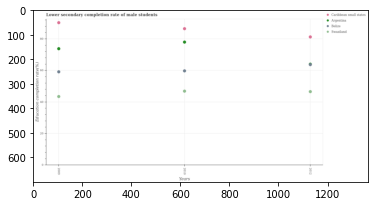

Number of QA =  29





,Years,Unnamed: 1,Swaziland,Belize,Caribbean small states
0,2010,78.355488,47.161735,60.127998,86.893310
1,2009,74.182102,43.701055,59.538498,90.759028
2,2012,NaN,46.899821,64.235495,81.638601


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of male students in swaziland in 2009 and that in 2012 ?
PREDICTED =  -3.19876515816496
EXPECTED =  -3.1077575683594887




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of male students in swaziland in 2010 and the lower secondary completion rate of male students in belize in 2009?
PREDICTED =  3.460679277408289
EXPECTED =  -12.258670806884886




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the lower secondary completion rate of male students in swaziland and

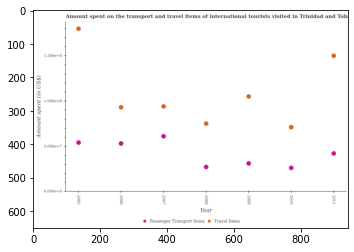

Number of QA =  27





,Year,Passenger Transport Items,Travel Items
0,2008,0.275004,0.753937
1,2007,0.615268,0.944862
2,2005,0.545135,1.804501
3,2010,0.265695,0.714732
4,2011,0.425503,1.503288
5,2006,0.536081,0.934026
6,2009,0.315619,1.053998


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items in 2007 and that in 2011 ?
PREDICTED =  0.18976489665849278
EXPECTED =  19000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items in 2007 and the amount spent in travel items in 2008?
PREDICTED =  0.34026408868498065
EXPECTED =  -14000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount spent in travel items and amount spent on passenger transport items ?
PREDICTED =  1.8045012529239601
EXPECTED =  33000000




				 0 / 3 = 0.0



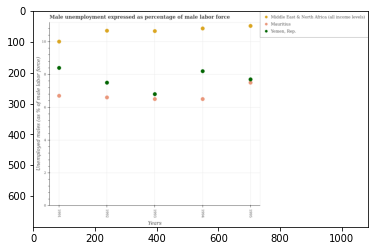

Number of QA =  28





,Years,Middle East & North Africa (all income levels),"Yemen, Rep.",Mauritius
0,1993,10.706762,6.850589,6.544245
1,1992,10.731686,7.552757,6.649228
2,1994,10.869359,8.252651,6.549322
3,1991,10.061216,8.452182,6.750542
4,1995,11.027072,7.744831,7.551010


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in males in in mauritius in 1991 and that in 1995 ?
PREDICTED =  -0.8004679957926744
EXPECTED =  -0.8000001907348606




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in males in in yemen, rep. in 1991 and the unemployment in males in in mauritius in 1992?
PREDICTED =  1.802953647233693
EXPECTED =  1.7999997138976989




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the unemployment in males in in yemen, rep. and unemployment in males in in middle east & north africa (all income levels) ?
PREDICTED 

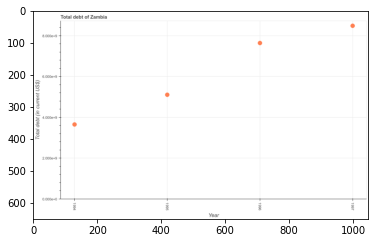

Number of QA =  24





,Year,Total debt (in current US$)
0,1995,5.166286
1,1996,7.716411
2,1997,8.561634
3,1994,3.703256


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in 1994 and 1997 ?
PREDICTED =  -4.858377687971629
EXPECTED =  -4836800000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total debt ?
PREDICTED =  6.441348560537711
EXPECTED =  6376350000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total debt in 1995 to that in 1997 ?
PREDICTED =  0.6034229316880712
EXPECTED =  0.6017363442532189




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the sec

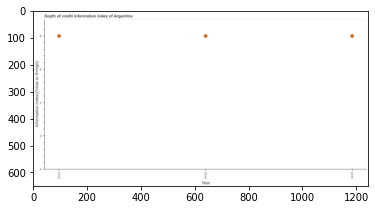

Number of QA =  24





,Year,Information index(O=low to 8=high)
0,2015,7.986628
1,2013,7.990515
2,2014,7.985171


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the depth of credit information index in 2014 and 2015 ?
PREDICTED =  -0.001457908736202107
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median depth of credit information index ?
PREDICTED =  7.986628464734068
EXPECTED =  8.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the depth of credit information index in 2013 to that in 2015 ?
PREDICTED =  1.0004866039806033
EXPECTED =  1.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the diff

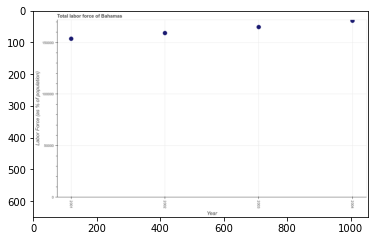

Number of QA =  24





,Year,Labor Force (as % of population)
0,2003,166426.380778
1,2004,172516.294771
2,2002,160519.437492
3,2001,154890.166234


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total labor force in 2001 and 2004 ?
PREDICTED =  -17626.128536341887
EXPECTED =  -17516




				 1 / 1 = 1.0


> what is the median total labor force ?
PREDICTED =  None
EXPECTED =  162142.5




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total labor force in 2002 to that in 2004 ?
PREDICTED =  0.9304595702425974
EXPECTED =  0.9299648393238871




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest total labor force ?
PREDICTED =  0.0
EXPECTED =  6152




				 2 / 5 = 0.4


is_built_with_cuda: True
is_gpu_available: F

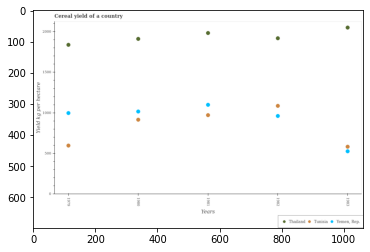

Number of QA =  28





,Years,Thailand,"Yemen, Rep",Tunisia
0,1982,1929.781623,968.775282,1095.035604
1,1983,2061.145175,534.758418,589.816639
2,1980,1921.351908,1024.561992,923.041427
3,1981,1993.561542,1107.376789,979.771388
4,1979,1848.186876,1005.197738,603.583585


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in thailand in 1982 and that in 1983 ?
PREDICTED =  -131.36355190713198
EXPECTED =  -131.5730000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in yemen, rep. in 1983 and the total cereal yield in tunisia in 1982?
PREDICTED =  -434.0168641542823
EXPECTED =  -559.69




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1982, what is the difference between the total cereal yield in yemen, rep. and total cereal yield in thailand ?
PREDICTED =  4638.670219295149
EXPECTED =  -957.5200000000001




				 1 / 3 = 0.3333


is_b

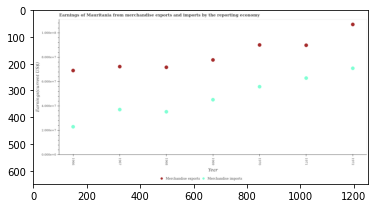

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,1969,15.942126,27.390550
1,1968,12.492720,25.271064
2,1971,22.177020,31.600276
3,1972,24.995860,37.587255
4,1966,8.183025,24.336150
5,1967,13.120802,25.443141
6,1970,19.691622,31.703698


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 1968 and that in 1970 ?
PREDICTED =  -7.198902212926354
EXPECTED =  -20559000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 1969 and the earnings from merchandise imports in 1968?
PREDICTED =  2.119486002460185
EXPECTED =  42500000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the earnings from merchandise imports and earnings from merchandise exports ?
PREDICTED =  -12.591394942023019
EXPECTED =  -35936000.0




				 0 / 3 = 0.0


is_built

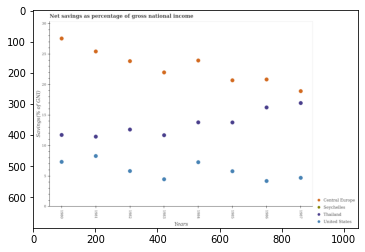

Number of QA =  28





,Years,Seychelles,United States,Thailand,Central Europe
0,1986,NaN,4.269812,16.328323,20.926474
1,1981,NaN,8.380312,11.558304,25.535786
2,1980,NaN,7.415145,11.819914,27.645725
3,1983,NaN,4.548513,11.786407,22.081640
4,1984,NaN,7.352071,13.888799,24.041236
5,1985,NaN,5.881501,13.872884,20.784400
6,1982,NaN,5.892124,12.716576,23.930395
7,1987,NaN,4.794582,17.064451,19.017191


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total savings in thailand in 1982 and that in 1983 ?
PREDICTED =  0.9301692995521371
EXPECTED =  0.9297264608063998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the total savings in thailand and total savings in central europe ?
PREDICTED =  3784.037152860762
EXPECTED =  -10.147771388249799




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total savings in united states in 19

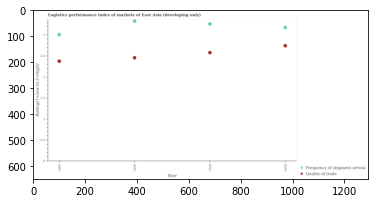

Number of QA =  27





,Year,Quality of trade,Frequency of shipment arrival
0,2012,2.582659,3.263482
1,2014,2.746939,3.176417
2,2010,2.460511,3.329978
3,2007,2.379301,3.010609


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi of frequency of shipment arrival in 2007 and that in 2014 ?
PREDICTED =  -0.16580794042679337
EXPECTED =  -0.16636030769230015




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi of frequency of shipment arrival in 2007 and the lpi quality of trade in 2012?
PREDICTED =  -0.25287276206256193
EXPECTED =  0.4284615384615398




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the lpi of frequency of shipment arrival and lpi quality of trade ?
PREDICTED =  0.0
EXPECTED =  0.87153846153846




				 1 / 3 = 0.3333


is_built_wi

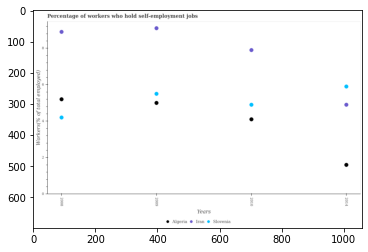

Number of QA =  28





,Years,Algeria,Slovenia,Iran
0,2008,5.226932,4.215727,8.915338
1,2009,5.020999,5.521901,9.117704
2,2010,4.125528,4.921221,7.922432
3,2014,1.629918,5.922401,4.924832


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in slovenia in 2009 and that in 2014 ?
PREDICTED =  -0.4004998855758126
EXPECTED =  -0.400000095367429




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in iran in 2009 and the percentage of self-employed workers in algeria in 2008?
PREDICTED =  0.2023654392733114
EXPECTED =  3.9000005722045925




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of self-employed workers in iran and percentage of self-employed workers in slovenia ?
PREDICTED 

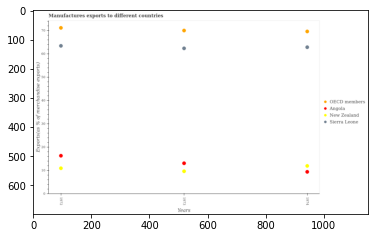

Number of QA =  29





,Years,Angola,New Zealand,Sierra Leone,OECD members
0,1974,9.588138,12.241235,62.997031,69.743015
1,1973,13.344673,9.913269,62.491038,70.135454
2,1972,16.586399,11.187927,63.554878,71.286371


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in new zealand in 1973 and that in 1974 ?
PREDICTED =  -2.327966295251052
EXPECTED =  -2.29229267561114




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in angola in 1973 and the percentage of exports to different countries in sierra leone in 1972?
PREDICTED =  -3.2417262969216214
EXPECTED =  -50.2974759521427




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1973, what is the difference between the percentage of exports to different countries in oecd members and percenta

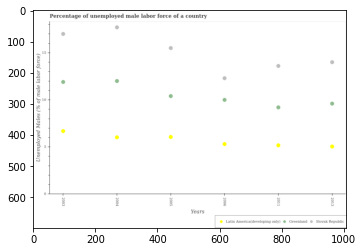

Number of QA =  28





,Years,Latin America(developing only),Slovak Republic,Greenland
0,2005,6.121467,15.558314,10.453446
1,2013,5.096772,14.063301,9.662972
2,2006,5.360931,12.370367,10.059686
3,2003,6.734886,17.068732,11.957276
4,2004,6.079402,17.767758,12.055446
5,2011,5.228731,13.661119,9.257883


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male labor force in slovak republic in 2003 and that in 2006 ?
PREDICTED =  4.698364679634084
EXPECTED =  4.699999809265099




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male labor force in slovak republic in 2006 and the percentage of unemployed male labor force in latin america(developing only) in 2011?
PREDICTED =  -1.2907514201508867
EXPECTED =  7.128209806660611




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of unemployed male labor force in latin a

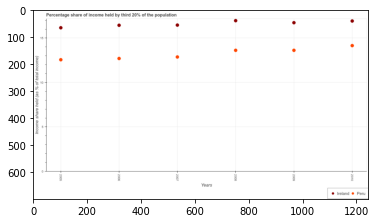

Number of QA =  27





,Years,Peru,Ireland
0,2006,12.715519,16.441320
1,2009,13.633762,16.733686
2,2010,14.163175,16.925501
3,2007,12.886199,16.460649
4,2005,12.589388,16.165318
5,2008,13.634781,16.974522


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by third 20% of the population in peru in 2008 and that in 2010 ?
PREDICTED =  -0.5283943860190572
EXPECTED =  -0.5300000000000011




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by third 20% of the population in ireland in 2009 and the share of income held by third 20% of the population in peru in 2010?
PREDICTED =  -0.19181509148893738
EXPECTED =  2.58




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the share of income held by third 20% of the population in ireland and share of

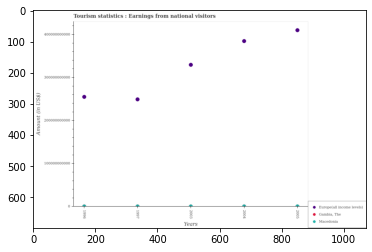

Number of QA =  28





,Years,"Gambia, The",Europe(all income levels),Macedonia
0,1996,NaN,2.563187e+11,1.649134e+09
1,1997,NaN,2.506281e+11,1.492620e+09
2,2005,NaN,4.116304e+11,1.506978e+09
3,2003,NaN,3.311413e+11,1.637409e+09
4,2004,NaN,3.865683e+11,1.458663e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from national visitors in europe(all income levels) in 1996 and that in 2003 ?
PREDICTED =  -74822585827.34567
EXPECTED =  -74545263175.99298




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from national visitors in gambia, the in 1997 and the earnings from national visitors in macedonia in 2005?
PREDICTED =  249121146794.90317
EXPECTED =  -40000000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the earnings from national visitors in gambia, the and earnings from national visitors in europe(all incom

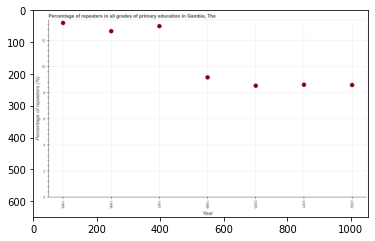

Number of QA =  24





,Year,Percentage of repeaters (%)
0,1996,12.746288
1,1995,13.380762
2,1999,9.202481
3,2002,8.630255
4,2001,8.644135
5,1997,13.130075
6,2000,8.566185


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters in primary education in 1995 and 1999 ?
PREDICTED =  4.178281507271409
EXPECTED =  4.169409784851071




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of repeaters in primary education ?
PREDICTED =  1999.0
EXPECTED =  9.16940021514893




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of repeaters in primary education in 1995 to that in 1997 ?
PREDICTED =  1.0190925536193398
EXPECTED =  1.0187298040183084




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Eval

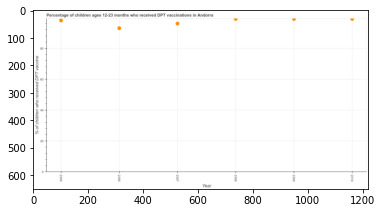

Number of QA =  24





,Year,% of children who received DPT vaccine
0,2009,99.378520
1,2010,99.361144
2,2008,99.388312
3,2006,93.427293
4,2005,98.442867
5,2007,96.384658


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccine in 2006 and 2008 ?
PREDICTED =  -5.9610193122690305
EXPECTED =  -6




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of children who received dpt vaccine ?
PREDICTED =  98.90200542815083
EXPECTED =  98.5




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of children who received dpt vaccine in 2007 to that in 2009 ?
PREDICTED =  0.9698741535621431
EXPECTED =  0.9696969696969697




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation f

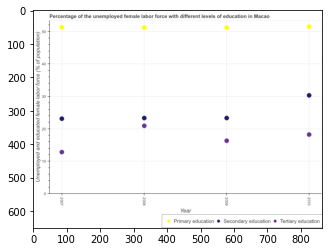

Number of QA =  28





,Year,Primary education,Secondary education,Tertiary education
0,2007,51.907094,23.465153,13.117824
1,2010,52.115902,30.713638,18.532823
2,2009,51.797277,23.672505,16.628650
3,2008,51.809724,23.684114,21.257733


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in 2007 and that in 2008 ?
PREDICTED =  0.09736994552669387
EXPECTED =  0.09999847412099427




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in 2007 and the percentage of female labor force who received primary education in 2008?
PREDICTED =  -0.21896133780455784
EXPECTED =  -28.100000381469812




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of female labor force who received pri

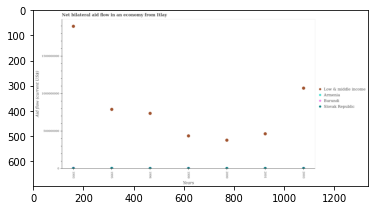

Number of QA =  29





,Years,Low & middle income,Armenia,Burundi,Slovak Republic
0,1993,1.904230e+09,NaN,NaN,7.151273e+06
1,2000,3.854433e+08,NaN,NaN,7.328089e+06
2,1995,7.947110e+08,NaN,NaN,9.014548e+06
3,1996,7.416347e+08,NaN,NaN,6.165628e+06
4,2001,4.701674e+08,NaN,NaN,7.656228e+06
5,1999,4.421259e+08,NaN,NaN,7.439482e+06
6,2003,1.079016e+09,NaN,NaN,6.988586e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in armenia in 1993 and the net bilateral aid flow in slovak republic in 1999?
PREDICTED =  0.0
EXPECTED =  2980000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilateral aid flow in low & middle income in 1993 to that in 1995?
PREDICTED =  2.3961293358211444
EXPECTED =  2.402544896898724




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available:

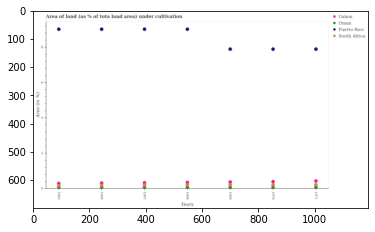

Number of QA =  29





,Years,Oman,South Africa,Gabon,Puerto Rico
0,1966,0.212955,0.064245,0.333253,9.008260
1,1971,0.078384,0.232587,0.454890,7.891365
2,1968,0.074254,0.226358,0.373658,9.013095
3,1969,0.075277,0.233371,0.395482,7.889459
4,1967,0.079539,0.212826,0.353657,9.008522
5,1970,0.083134,0.224503,0.408444,7.887483
6,1965,0.057872,0.170672,0.318958,9.009907


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land under cultivation in south africa in 1968 and that in 1969 ?
PREDICTED =  -0.007013145985953206
EXPECTED =  -0.008243411453395993




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land under cultivation in south africa in 1969 and the percentage of land under cultivation in oman in 1968?
PREDICTED =  0.007013145985953206
EXPECTED =  0.14792696646413772




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training st

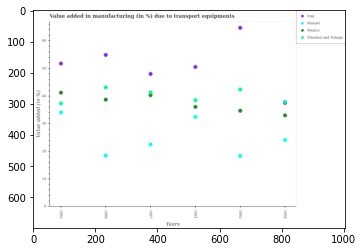

Number of QA =  29





,Years,Mexico,Iraq,Malawi,Trinidad and Tobaga
0,1994,33.035699,NaN,24.144362,37.950258
1,1986,38.742690,54.804945,18.518270,43.128419
2,1992,34.704447,64.610448,18.441288,42.369538
3,1985,41.220032,51.752489,34.066890,37.308992
4,1991,36.089133,50.529306,32.438449,38.530818
5,1987,40.357755,48.002760,22.490645,41.340304


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in trinidad and tobago in 1987 and that in 1991 ?
PREDICTED =  1.7881154630939733
EXPECTED =  2.8368317927744116




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in iraq in 1991 and the percentage of value added in manufacturing due to transport equipments in mexico in 1987?
PREDICTED =  2.526545873085908
EXPECTED =  10.216493689792685




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between

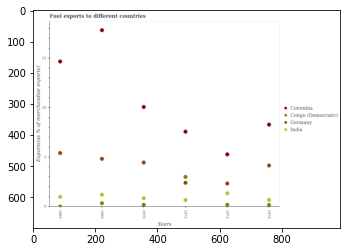

Number of QA =  29





,Years,Colombia,Germany,Congo (Democratic),India
0,1974,8.313145,4.189062,0.198083,0.725459
1,1962,14.686967,5.447545,0.060500,1.027032
2,1973,5.312729,2.368348,0.228229,1.380280
3,1972,7.603138,2.437273,3.038864,0.694144
4,1965,17.853034,4.862240,0.385371,1.239049
5,1970,10.100436,4.498816,0.216469,0.881460


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in colombia in 1965 and that in 1972 ?
PREDICTED =  7.752598549196369
EXPECTED =  10.256567922177332




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in india in 1965 and the percentage of exports to different countries in congo (democratic) in 1974?
PREDICTED =  0.5135900145660277
EXPECTED =  1.0369234041094741




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1965, what is the difference between the percentage of exports to different countries in germany and percentage 

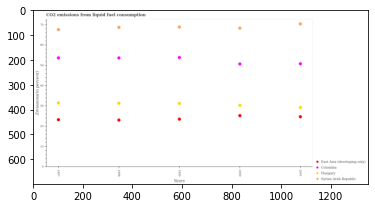

Number of QA =  29





,Years,Syrian Arab Republic,Colombia,East Asia (developing only),Hungary
0,1998,69.416720,54.261795,23.430472,31.787413
1,2001,71.133116,51.375654,25.118382,29.674178
2,1999,69.569163,54.438918,23.894900,31.683711
3,1997,68.255624,54.286608,23.623687,31.997171
4,2000,69.023762,51.260868,25.633014,30.751587


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in colombia in 2000 and that in 2001 ?
PREDICTED =  -0.11478647505784068
EXPECTED =  -0.09135769474719524




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in hungary in 1998 and the total co2 emitted in syrian arab republic in 2000?
PREDICTED =  1.0358254340577453
EXPECTED =  -36.99608943690801




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the total co2 emitted in hungary and total co2 emitted in east asia (developing only) ?
PREDICTED =  150.89406037200538
EXPECTED =  4.5576736631297

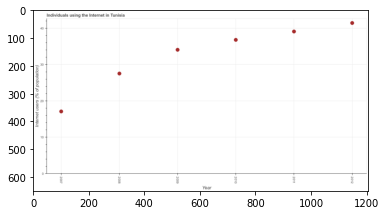

Number of QA =  24





,Year,Internet users (% of population)
0,2010,37.113944
1,2007,17.317029
2,2012,41.762159
3,2008,27.791192
4,2009,34.357327
5,2011,39.409846


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of internet users in 2009 and 2011 ?
PREDICTED =  -5.052519245653826
EXPECTED =  -5.030000000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of internet users ?
PREDICTED =  35.73563531131478
EXPECTED =  35.435




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of internet users in 2007 to that in 2008 ?
PREDICTED =  0.6231121348051103
EXPECTED =  0.6211405739193607




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the di

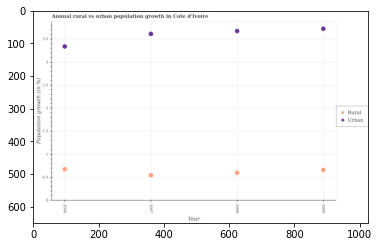

Number of QA =  27





,Year,Rural,Urban
0,2008,0.607652,3.644583
1,2007,0.548619,3.579968
2,2006,0.679060,3.312032
3,2009,0.662556,3.691768


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population growth in 2006 and that in 2008 ?
PREDICTED =  0.0714078826969825
EXPECTED =  0.07485027519570797




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population growth in 2007 and the rural population growth in 2009?
PREDICTED =  -0.11180013645296372
EXPECTED =  2.952860207670126




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the urban population growth and rural population growth ?
PREDICTED =  0.0
EXPECTED =  3.074300668163396




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: Fals

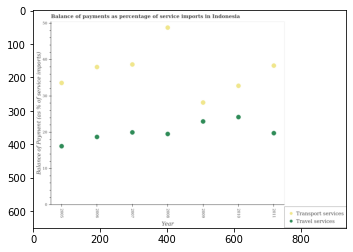

Number of QA =  27





,Year,Transport services,Travel services
0,2010,33.031353,24.379706
1,2006,38.187642,18.892173
2,2009,28.399829,23.181633
3,2005,33.791855,16.363917
4,2007,38.894251,20.154857
5,2008,49.078586,19.705382
6,2011,38.582876,19.941240


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in 2008 and that in 2011 ?
PREDICTED =  10.49570908966841
EXPECTED =  10.468022728460205




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2007 and the balance of payments of transport services in 2010?
PREDICTED =  -4.224849269554472
EXPECTED =  -12.823486208287804




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the balance of payments of travel services and balance of payments of transport services ?
PREDICTED =  -62.82825488098406
EXPECT

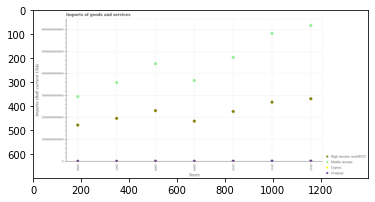

Number of QA =  29





,Years,High income: nonOECD,Uruguay,Cyprus,Middle income
0,2009,1.843238e+12,2.535835e+10,NaN,3.676202e+12
1,2008,2.312942e+12,2.568388e+10,NaN,4.437560e+12
2,2010,2.275826e+12,2.437678e+10,NaN,4.721661e+12
3,2006,1.658908e+12,2.441457e+10,NaN,2.947627e+12
4,2012,2.852305e+12,2.904760e+10,NaN,6.164049e+12
5,2011,2.696626e+12,2.881621e+10,NaN,5.809324e+12
6,2007,1.964589e+12,2.227508e+10,NaN,3.588371e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on imports in cyprus in 2006 and that in 2012 ?
PREDICTED =  -2852305339429.7114
EXPECTED =  -1195377646




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on imports in high income: nonoecd in 2011 and the amount spent on imports in cyprus in 2012?
PREDICTED =  -155679062878.81592
EXPECTED =  2687367144569.98




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount spent on imports in middle income and amount spent on imports in uruguay ?
PREDICTED =  6164048977811.655
EXPECTED =  3585906684462.

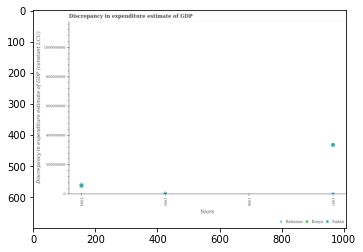

Number of QA =  26





,Years,Kenya,Bahamas,Sudan
0,1995,NaN,6.353752e+06,NaN
1,1997,NaN,3.838383e+06,3.390615e+08
2,1996,NaN,NaN,NaN
3,1994,NaN,NaN,5.977346e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in sudan in 1994 and that in 1997 ?
PREDICTED =  0.0
EXPECTED =  -278886000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in bahamas in 1994 and the discrepancy in expenditure estimate of gdp in sudan in 1997?
PREDICTED =  -3838382.5750503344
EXPECTED =  -271845500.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the discrepancy in expenditure estimate of gdp in sudan and discrepancy in expenditure estimate of gdp in bahamas ?
PREDIC

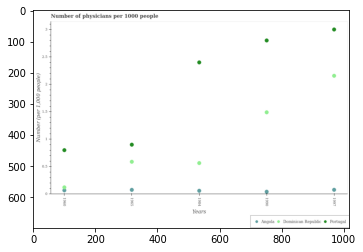

Number of QA =  28





,Years,Angola,Dominican Republic,Portugal
0,1984,0.069637,0.573774,2.413413
1,1990,0.052130,1.502019,2.814816
2,1965,0.087011,0.597512,0.910011
3,1960,0.075959,0.130037,0.809169
4,1997,0.087603,2.169104,3.015829


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of physicians in dominican republic in 1965 and that in 1984 ?
PREDICTED =  0.0
EXPECTED =  0.02388161420822099




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of physicians in portugal in 1997 and the number of physicians in dominican republic in 1960?
PREDICTED =  0.1908313023597491
EXPECTED =  2.878675326704979




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the number of physicians in portugal and number of physicians in dominican republic ?
PREDICTED =  0.0
EXPECTED =  1.3099999904999997




				 0 / 3

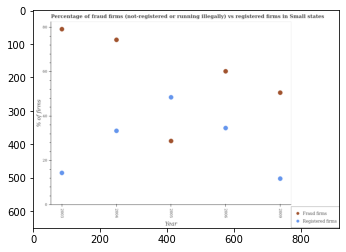

Number of QA =  27





,Year,Fraud firms,Registered firms
0,2003,79.451537,14.624142
1,2005,29.021108,48.764272
2,2004,74.624107,33.610548
3,2006,60.471022,34.863407
4,2009,50.822779,12.016302


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of registered firms in 2004 and that in 2005 ?
PREDICTED =  -15.153724056880215
EXPECTED =  -15.118831168831207




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of registered firms in 2003 and the percentage of fraud firms in 2009?
PREDICTED =  2.607840648894662
EXPECTED =  -36.156666666666695




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of registered firms and percentage of fraud firms ?
PREDICTED =  0.0
EXPECTED =  -64.7866666666667




				 1 / 3 = 0.3333


is_built_with_cuda: Tr

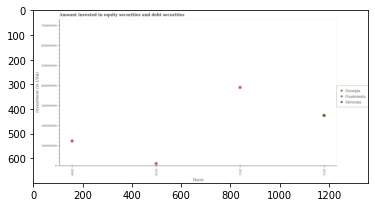

Number of QA =  22





,Years,Georgia,Slovenia,Guatemala
0,2009,NaN,NaN,1.260105e+08
1,2010,NaN,NaN,1.378746e+07
2,2011,NaN,NaN,3.941411e+08
3,2012,NaN,2.540310e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in slovenia in 2011 and the amount invested in equity securities and debt securities in guatemala in 2010?
PREDICTED =  -407928519.59598833
EXPECTED =  -11876700.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest amount invested in equity securities and debt securities in guatemala ?
PREDICTED =  -394139051.725005
EXPECTED =  267437100.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest amount invested in equity securities and d

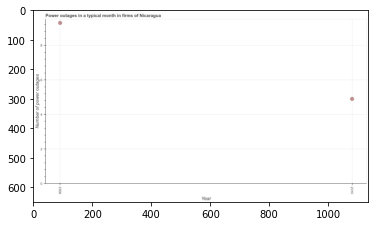

Number of QA =  20





,Year,Number of power outages
0,2006,9.326706
1,2010,4.927845


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of power outages in 2006 and 2010 ?
PREDICTED =  4.398861904840013
EXPECTED =  4.4




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of power outages ?
PREDICTED =  7.1272755144895585
EXPECTED =  7.1000000000000005




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of power outages in 2006 to that in 2010 ?
PREDICTED =  1.8926543541366527
EXPECTED =  1.8979591836734695




				 3 / 3 = 1.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Number of power outages
EXPECTED =  2.0




				 3 / 4 = 0.75


>

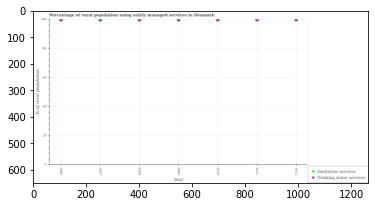

Number of QA =  27





,Year,Sanitation services,Drinking water services
0,2009,NaN,99.259370
1,2011,NaN,99.295836
2,2007,NaN,99.267558
3,2008,NaN,99.259143
4,2010,NaN,99.256964
5,2012,NaN,99.310640
6,2006,NaN,99.220449


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population who used sanitation services in 2007 and the percentage of rural population who used drinking water services in 2010?
PREDICTED =  -99.25696431702231
EXPECTED =  -0.4000000000000057




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of rural population who used sanitation services and percentage of rural population who used drinking water services ?
PREDICTED =  nan
EXPECTED =  -0.4000000000000057




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
G

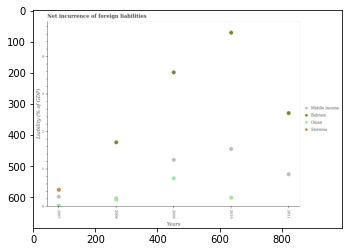

Number of QA =  27





,Years,Slovenia,Oman,Bahrain,Middle income
0,2009,NaN,0.765601,3.601415,1.257869
1,2008,NaN,0.203308,1.727694,NaN
2,2011,NaN,NaN,2.509755,0.876754
3,2010,NaN,0.248204,4.666716,1.549561
4,2007,0.459392,0.031259,NaN,0.273993


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in middle income in 2007 and that in 2010 ?
PREDICTED =  -1.2755678630752953
EXPECTED =  -1.2724922985967821




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in slovenia in 2010 and the net incurrence of foreign liabilities in middle income in 2009?
PREDICTED =  -2.0
EXPECTED =  -1.24464324925448




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the net incurrence of foreign liabilities in middle income and net incurrence of foreign liabilities in b

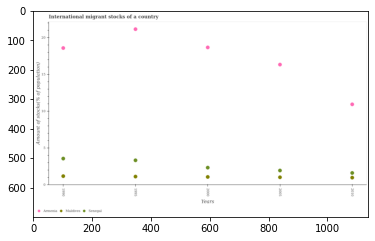

Number of QA =  28





,Years,Maldives,Armenia,Senegal
0,2000,1.142385,18.748185,2.406157
1,1995,1.199994,21.244858,3.405311
2,1990,1.242904,18.659549,3.635430
3,2010,1.039728,11.012077,1.696258
4,2005,1.091603,16.417553,2.025969


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in in senegal in 2000 and that in 2005 ?
PREDICTED =  0.3801877790139985
EXPECTED =  0.38870876104705987




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in in maldives in 1995 and the amount of stocks in in armenia in 2000?
PREDICTED =  0.05760938862715426
EXPECTED =  -17.53803327851792




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the amount of stocks in in senegal and amount of stocks in in maldives ?
PREDICTED =  0.0
EXPECTED =  2.38593515821672




				 1 / 3 = 0.3333


is_built_wi

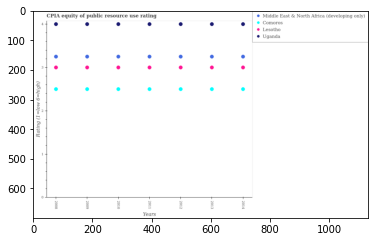

Number of QA =  29





,Years,Comoros,Uganda,Lesotho,Middle East & North Africa (developing only)
0,2014,2.508316,4.005009,3.006189,3.258294
1,2010,2.508401,4.004686,3.007072,3.259334
2,2011,2.507914,4.006293,3.007470,3.258231
3,2008,2.508282,4.005275,3.006444,3.257325
4,2009,2.505168,4.006657,3.007123,3.258643
5,2012,2.507370,4.005812,3.007341,3.256850
6,2013,2.509773,4.006097,3.007536,3.258072


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in comoros in 2008 and that in 2009 ?
PREDICTED =  0.003114004474559895
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in comoros in 2008 and the cpia rating in middle east & north africa (developing only) in 2009?
PREDICTED =  0.003114004474559895
EXPECTED =  -0.75




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the cpia rating in lesotho and cpia rating in uganda ?
PREDICTED =  -3.992974907567562
EXPECTED =  -1.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: 

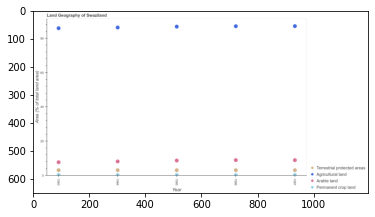

Number of QA =  29





,Year,Terrestrial protected areas,Arable land,Permanent crop land,Agricultural land
0,1997,3.389148,9.275520,0.620435,87.395717
1,1994,3.391772,8.507136,0.572243,86.575302
2,1993,3.354725,8.021741,0.618647,86.137157
3,1996,3.388236,9.283765,0.513491,87.323190
4,1995,3.364152,9.017512,0.534670,87.108957


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of area under agricultural land in 1993 and that in 1994 ?
PREDICTED =  -0.4381450665746769
EXPECTED =  -0.4069767441860961




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of area under arable land in 1994 and the percentage of area under agricultural land in 1995?
PREDICTED =  -0.5103757738059596
EXPECTED =  -78.66279069767447




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percentage of area under arable land and percentage of land under terrestrial protection ?
PREDICTED =  1.2620241935723744

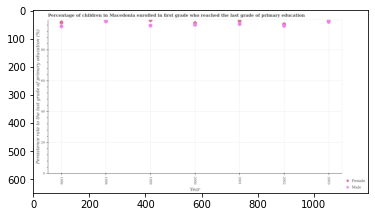

Number of QA =  27





,Year,Male,Female
0,2003,98.601878,NaN
1,1996,95.469046,98.087922
2,1998,98.844924,NaN
3,2001,97.041795,98.959910
4,1999,96.044221,99.476011
5,2002,95.733549,96.866424
6,2000,96.621140,97.676460


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of female students in 2000 and that in 2003 ?
PREDICTED =  0.8100361619441543
EXPECTED =  -1.269485473632784




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of male students in 2001 and the persistence rate of female students in 1996?
PREDICTED =  1.5727483383175098
EXPECTED =  -1.0436766455078015




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the persistence rate of male students and persistence rate of female students ?
PREDICTED =  -1.3973777728509589
EXPECTED =  -0.48175048828119316

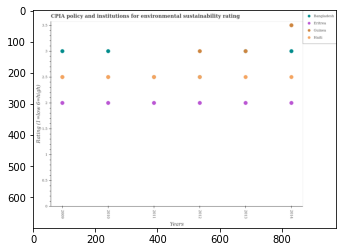

Number of QA =  29





,Years,Eritrea,Haiti,Guinea,Bangladesh
0,2014,2.010790,2.511402,3.511846,3.012054
1,2011,2.010828,2.509719,NaN,NaN
2,2009,2.010141,2.509908,NaN,3.013688
3,2010,2.010814,2.510292,NaN,3.011484
4,2013,2.010700,2.511236,3.011634,NaN
5,2012,2.010546,2.509633,3.012489,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in guinea in 2010 and that in 2014 ?
PREDICTED =  nan
EXPECTED =  -1.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in guinea in 2013 and the cpia rating in bangladesh in 2009?
PREDICTED =  nan
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in haiti in 2010 to that in 2014?
PREDICTED =  0.9995581799847408
EXPECTED =  1.0




				 1 / 4 = 

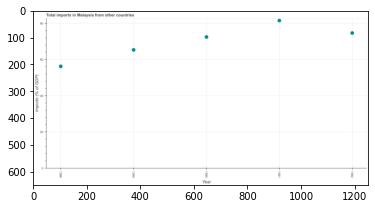

Number of QA =  24





,Year,Imports (% of GDP)
0,1990,73.056164
1,1988,56.757603
2,1992,75.255505
3,1989,65.890477
4,1991,82.187770


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in 1989 and 1991 ?
PREDICTED =  -16.29729238130483
EXPECTED =  -16.174282212798204




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total imports ?
PREDICTED =  73.05616439982437
EXPECTED =  72.42213283395341




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total imports in 1988 to that in 1990 ?
PREDICTED =  0.7769036822366138
EXPECTED =  0.7761263372764502




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the 

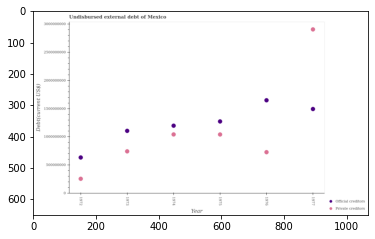

Number of QA =  27





,Year,Private creditors,Official creditors
0,1973,7.538870e+08,1.114215e+09
1,1974,1.050475e+09,1.205224e+09
2,1975,1.050214e+09,1.281163e+09
3,1977,2.909668e+09,1.501041e+09
4,1976,7.379181e+08,1.657008e+09
5,1972,2.667583e+08,6.418803e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of private creditors in 1972 and that in 1973 ?
PREDICTED =  -487128728.9000119
EXPECTED =  -485954000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of private creditors in 1976 and the undisbursed external debt of official creditors in 1977?
PREDICTED =  -2171749769.2377114
EXPECTED =  -764232000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1973, what is the difference between the undisbursed external debt of official creditors and undisbursed external debt of private creditors ?
PREDICTED =  -966663

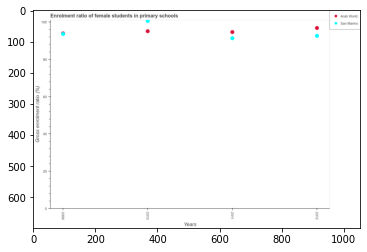

Number of QA =  27





,Years,Arab World,San Marino
0,2009,NaN,93.879002
1,2012,96.945134,92.764889
2,2011,94.782027,91.511994
3,2010,95.197126,100.711772


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the enrolment ratio of female students in primary schools in arab world in 2012 ?
PREDICTED =  1.0136311729324936
EXPECTED =  96.8388671875




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum enrolment ratio of female students in primary schools in arab world ?
PREDICTED =  21.036908618052642
EXPECTED =  96.8388671875




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum enrolment ratio of female students in primary schools in arab world ?
PREDICTED =  21.02645289806355
EXPECTED =  93.9314727783203




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: F

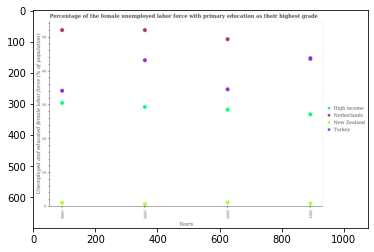

Number of QA =  29





,Years,Netherlands,New Zealand,High income,Turkey
0,1999,52.111795,0.896754,29.463414,43.240757
1,1998,52.107349,1.213110,30.637796,34.215719
2,2001,NaN,1.034796,27.276659,43.683288
3,2000,49.431716,1.329278,28.646511,34.661405


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with primary education in turkey in 1998 and that in 2000 ?
PREDICTED =  -4.023609408763782
EXPECTED =  -0.399997711181598




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with primary education in high income in 1998 and the percentage of the unemployed female labor force with primary education in turkey in 1999?
PREDICTED =  1.174381887506712
EXPECTED =  -12.620183963934604




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the 

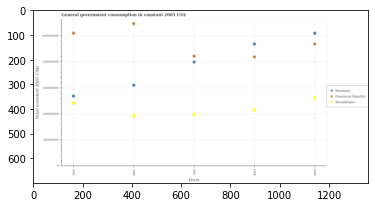

Number of QA =  28





,Years,Botswana,Dominican Republic,Mozambique
0,1989,1.024621e+09,9.417415e+08,5.259851e+08
1,1985,5.415845e+08,1.025779e+09,4.845006e+08
2,1987,8.031560e+08,8.480955e+08,3.987376e+08
3,1986,6.251622e+08,1.098961e+09,3.892458e+08
4,1988,9.424648e+08,8.420629e+08,4.325153e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in mozambique in 1985 and that in 1989 ?
PREDICTED =  -41484495.157591164
EXPECTED =  -41138369.218256




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in botswana in 1985 and the government conusmption in dominican republic in 1986?
PREDICTED =  -83577749.44711411
EXPECTED =  -556639247.822443




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1988, what is the difference between the government conusmption in mozambique and government conusmption in dominican republic ?
PREDICTED =  -2399873278.044489
EXPECTED =  -

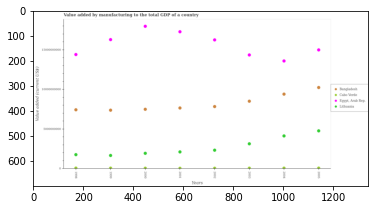

Number of QA =  29





,Years,Bangladesh,Lithuania,Cabo Verde,"Egypt, Arab Rep."
0,1998,7.491104e+09,1.818986e+09,1.202493e+08,1.450456e+10
1,1999,7.453722e+09,1.721115e+09,1.230742e+08,1.637556e+10
2,2002,7.905696e+09,2.387744e+09,1.075591e+08,1.634529e+10
3,2005,1.031096e+10,4.838742e+09,1.200434e+08,1.508702e+10
4,2001,7.738375e+09,2.166144e+09,1.114464e+08,1.737963e+10
5,2003,8.589176e+09,3.191395e+09,1.148510e+08,1.443405e+10
6,2004,9.489865e+09,4.190994e+09,1.132487e+08,1.368141e+10
7,2000,7.570533e+09,1.997270e+09,1.069182e+08,1.806361e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing to the total gdp in lithuania in 2000 and that in 2005 ?
PREDICTED =  -2841471728.125434
EXPECTED =  -2832681913.5329905




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing to the total gdp in cabo verde in 1998 and the value added by manufacturing to the total gdp in egypt, arab rep. in 2003?
PREDICTED =  5398298.064905822
EXPECTED =  -14285544462.657982




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the value added by manufacturing to the total gdp in lithuania and

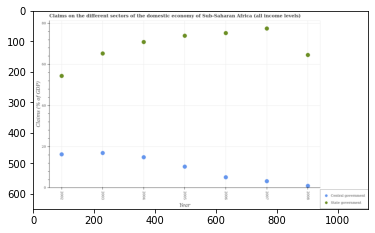

Number of QA =  27





,Year,State government,Central government
0,2003,65.714704,17.226513
1,2002,54.821287,16.610985
2,2006,75.670479,5.417952
3,2005,74.366619,10.567749
4,2008,65.004620,1.273740
5,2007,77.912526,3.510327
6,2004,71.295757,15.176072


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the claims on central government in 2004 and that in 2005 ?
PREDICTED =  4.608322891195892
EXPECTED =  4.572114046459101




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the claims on state government in 2002 and the claims on central government in 2005?
PREDICTED =  -19.545332183173585
EXPECTED =  44.0886009560194




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the claims on central government in 2004 

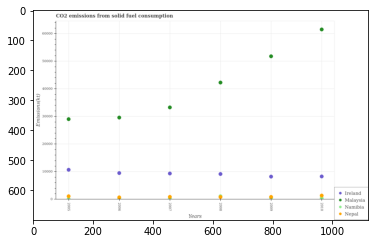

Number of QA =  29





,Years,Ireland,Namibia,Nepal,Malaysia
0,2006,9704.682684,NaN,880.613993,29835.682125
1,2008,9364.796639,NaN,1189.207719,42521.994889
2,2007,9533.771841,NaN,1094.079070,33529.945380
3,2010,8501.082158,290.376118,1518.708366,61834.657032
4,2005,10883.166351,NaN,1271.650114,29245.067413
5,2009,8414.642315,NaN,1053.746010,52057.021743


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in malaysia in 2006 and that in 2007 ?
PREDICTED =  -3694.2632547248613
EXPECTED =  -3678.0009999999966




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in ireland in 2010 and the amount of co2 emitted in malaysia in 2009?
PREDICTED =  86.4398430071833
EXPECTED =  -43512.622




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of co2 emitted in namibia and amount of co2 emitted in ireland ?
PREDICTED =  -56111.76587037261
EXPECTED =  -8052.732000000001




				 1 / 3 = 0.3

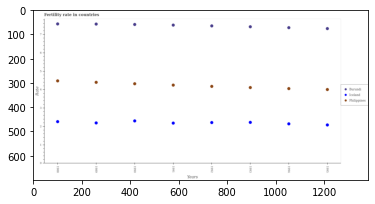

Number of QA =  28





,Years,Iceland,Philippines,Burundi
0,1989,2.190510,4.378912,7.515427
1,1995,2.084411,3.994537,7.281379
2,1991,2.187459,4.229193,7.463108
3,1993,2.224904,4.101459,7.377184
4,1988,2.267856,4.455613,7.529563
5,1990,2.306014,4.306097,7.500203
6,1992,2.215669,4.166799,7.420637
7,1994,2.143711,4.044572,7.325185


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fertility rate in philippines in 1988 and that in 1994 ?
PREDICTED =  0.41104120424226576
EXPECTED =  0.41999999999999993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fertility rate in burundi in 1988 and the fertility rate in philippines in 1994?
PREDICTED =  0.2043787777246182
EXPECTED =  3.516




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the fertility rate in burundi and fertility rate in iceland ?
PREDICTED =  6.810942280746799
EXPECTED =  5.2379999999999995




				 1 / 3 = 0.3333


is_built_with_cuda: True
is

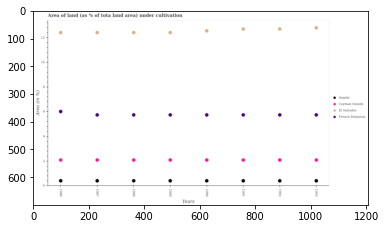

Number of QA =  29





,Years,El Salvador,Angola,Cayman Islands,French Polynesia
0,1989,12.531924,0.436387,2.133901,5.814911
1,1990,12.679561,0.434979,2.131586,5.817976
2,1992,12.825525,0.437106,2.137129,5.819243
3,1988,12.536395,0.438307,2.136037,5.817478
4,1986,12.535915,0.434363,2.130539,6.093917
5,1991,12.823872,0.434770,2.130537,5.821026
6,1993,12.924297,0.433579,2.137817,5.817732
7,1987,12.534767,0.435356,2.136563,5.818936


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land under cultivation in angola in 1988 and that in 1990 ?
PREDICTED =  0.0033282362416359734
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land under cultivation in angola in 1991 and the percentage of land under cultivation in french polynesia in 1987?
PREDICTED =  -0.0005855808605254031
EXPECTED =  -5.336646122813411




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the percentage of land under cultivation in el salvador and percentage of land under cultivation in french po

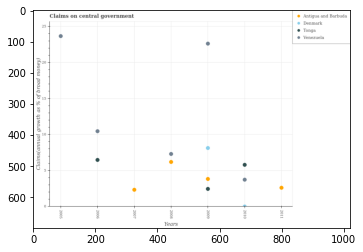

Number of QA =  26





,Years,Tonga,Venezuela,Denmark,Antigua and Barbuda
0,2009,2.494883,22.595257,8.144277,3.873754
1,2011,NaN,NaN,NaN,2.663326
2,2008,NaN,7.328507,NaN,6.219992
3,2005,NaN,23.645981,NaN,NaN
4,2010,5.825311,3.770960,0.071176,NaN
5,2006,6.503265,10.477012,NaN,NaN
6,2007,NaN,NaN,NaN,2.375139


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on centeral government in venezuela in 2009 and that in 2010 ?
PREDICTED =  18.824296784814738
EXPECTED =  18.89156881702409




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on centeral government in antigua and barbuda in 2009 and the percentage of broad money claimed on centeral government in denmark in 2007?
PREDICTED =  -5.769138709084851
EXPECTED =  3.822022067524069




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of broad money claime

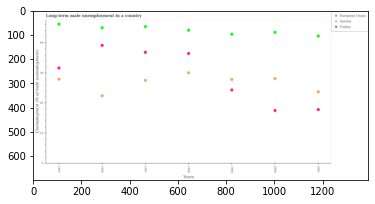

Number of QA =  28





,Years,Austria,European Union,Turkey
0,1996,22.543334,45.076346,39.197890
1,1998,30.134651,44.237987,36.543198
2,2001,23.848407,42.287168,17.935433
3,1997,27.631559,45.452935,36.929276
4,1995,27.991747,46.242550,31.711475
5,1999,27.929800,42.898842,24.422850
6,2000,28.220837,43.533067,17.631071


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed male population in european union in 1998 and that in 1999 ?
PREDICTED =  1.3391452677665683
EXPECTED =  1.3408643718779985




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed male population in austria in 2001 and the percentage of long-term unemployed male population in turkey in 1996?
PREDICTED =  1.3050721227311826
EXPECTED =  -15.399997711181602




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of long-term unemployed male population in t

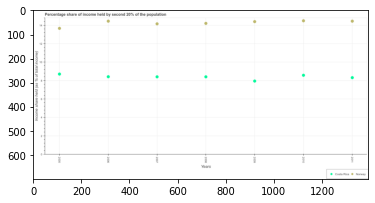

Number of QA =  27





,Years,Norway,Costa Rica
0,2010,14.562994,8.636151
1,2009,14.466547,8.007324
2,2006,14.517480,8.477311
3,2005,13.737422,8.773702
4,2008,14.279985,8.464308
5,2007,14.229191,8.466298
6,2011,14.529674,8.377345


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by second 20% of the population in norway in 2008 and the share of income held by second 20% of the population in costa rica in 2010?
PREDICTED =  5.643834419332407
EXPECTED =  5.629999999999999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the share of income held by second 20% of the population in norway and share of income held by second 20% of the population in costa rica ?
PREDICTED =  2001.3638492789228
EXPECTED =  6.129999999999999




				 1 / 3 = 0.3333


is_built_with_cuda: True


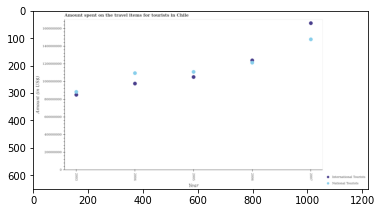

Number of QA =  27





,Year,National Tourists,International Tourists
0,2006,1.224121e+09,1.250661e+09
1,2007,1.489277e+09,1.673362e+09
2,2003,8.939071e+08,8.584949e+08
3,2005,1.118704e+09,1.061118e+09
4,2004,1.105717e+09,9.874800e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists in 2003 and that in 2005 ?
PREDICTED =  -202623477.42056227
EXPECTED =  -201000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists in 2006 and the amount spent on travel items of national tourists in 2004?
PREDICTED =  263180983.0830871
EXPECTED =  144000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount spent on travel items of national tourists and amount spent on travel items of international touri

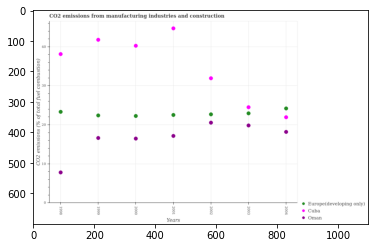

Number of QA =  28





,Years,Cuba,Oman,Europe(developing only)
0,2002,32.233680,20.797372,22.929654
1,1998,38.475715,7.987603,23.570004
2,2003,24.797997,20.103681,23.193546
3,2004,22.222498,18.427992,24.469840
4,1999,42.129434,16.861294,22.670744
5,2001,45.086483,17.395499,22.779441
6,2000,40.604016,16.726038,22.537302


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in oman in 1998 and that in 2000 ?
PREDICTED =  -8.738434845427461
EXPECTED =  -8.66949655392762




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in europe(developing only) in 1998 and the amount of co2 emitted in oman in 2003?
PREDICTED =  0.3764574369578355
EXPECTED =  3.492922357424




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the amount of co2 emitted in cuba and amount of co2 emitted in oman ?
PREDICTED =  -96.07698184909259
EXPECTED =  4.669807080828299




				 1 / 3 =

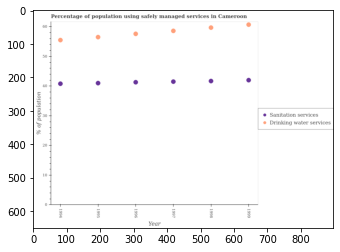

Number of QA =  27





,Year,Sanitation services,Drinking water services
0,1996,41.275235,57.514433
1,1998,41.650544,59.565948
2,1995,40.968544,56.355163
3,1997,41.461377,58.473765
4,1994,40.748405,55.394265
5,1999,41.985270,60.549042


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used sanitation services in 1995 and that in 1997 ?
PREDICTED =  -0.4928330782862318
EXPECTED =  -0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used sanitation services in 1994 and the percentage of population who used drinking water services in 1998?
PREDICTED =  -0.9021383527645099
EXPECTED =  -18.900000000000006




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the percentage of population who used sanitation services and percentage of population who used d

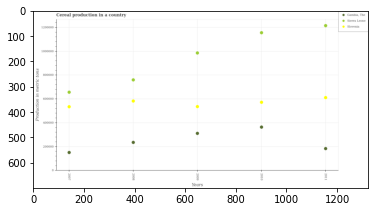

Number of QA =  28





,Years,"Gambia, The",Slovenia,Sierra Leone
0,2008,238548.128526,584373.013158,7.611590e+05
1,2011,186284.281065,612933.350017,1.215536e+06
2,2010,366303.507530,574421.496081,1.155805e+06
3,2009,313954.474234,537686.435574,9.866185e+05
4,2007,153695.504749,536727.932605,6.573809e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production in gambia, the in 2008 and that in 2009 ?
PREDICTED =  -75406.34570763237
EXPECTED =  -75807




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production in gambia, the in 2011 and the total cereal production in sierra leone in 2007?
PREDICTED =  32588.77631574063
EXPECTED =  -473063




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the total cereal production in gambia, the and total cereal production in sierra leone ?
PREDICTED =  1258780.8961035942
EXPECTED =  -505712




				 1 / 3 = 

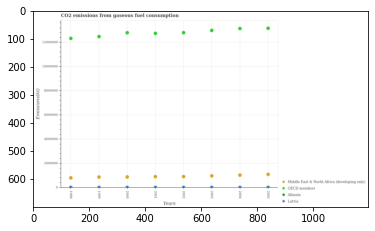

Number of QA =  29





,Years,Middle East & North Africa (developing only),Albania,OECD members,Latvia
0,1999,9.074739e+05,NaN,1.251032e+07,51963.497732
1,1998,8.353893e+05,NaN,1.235836e+07,44842.090447
2,2001,9.383158e+05,NaN,1.276823e+07,52053.606204
3,2000,9.087319e+05,NaN,1.283122e+07,49762.580586
4,2004,1.067161e+06,NaN,1.317529e+07,53967.879079
5,2002,9.442084e+05,NaN,1.283344e+07,50210.994395
6,2003,1.002020e+06,NaN,1.302257e+07,52128.105333
7,2005,1.131042e+06,NaN,1.319373e+07,51627.187375


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in middle east & north africa (developing only) in 2002 and that in 2004 ?
PREDICTED =  -122952.65416231286
EXPECTED =  -122532.80500000005




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in latvia in 2002 and the amount of co2 emitted in middle east & north africa (developing only) in 1999?
PREDICTED =  -1752.5033370510573
EXPECTED =  -860369.875




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the amount of co2 emitted in albania and amount of co2 emitted in middle east & nort

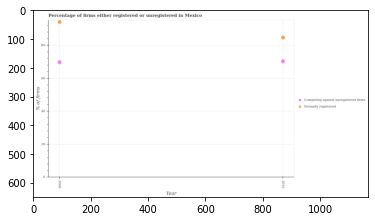

Number of QA =  23





,Year,Competing against unregistered firms,Formally registered
0,2010,70.312634,84.591991
1,2006,69.625292,93.868216


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of formally registered firms in 2006 and that in 2010 ?
PREDICTED =  9.27622473687363
EXPECTED =  9.399999999999991




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of registered firms in 2010 and the percentage of formally registered firms in 2006?
PREDICTED =  -9.27622473687363
EXPECTED =  -23.799999999999997




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of formally registered firms and percentage of registered firms ?
PREDICTED =  0.0
EXPECTED =  24.39999999999999




				 1 / 3 =

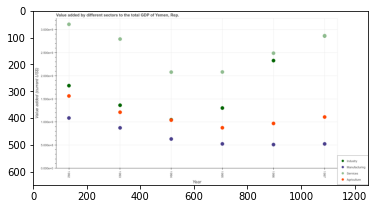

Number of QA =  29





,Year,Industry,Services,Manufacturing,Agnculture
0,1995,1.310094,2.088592,0.536132,0.883852
1,1996,2.332795,2.494195,0.520157,0.976508
2,1994,NaN,2.085240,0.642188,1.052614
3,1993,1.369381,2.796234,0.881832,1.218394
4,1992,1.791652,3.114698,1.093939,1.572086
5,1997,NaN,2.867862,0.536337,1.115064


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in 1995 and that in 1997 ?
PREDICTED =  -0.23121218004308708
EXPECTED =  -232765763.43084407




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in 1996 and the value added by manufacturing sector in 1992?
PREDICTED =  -0.8151445614978384
EXPECTED =  -117988787.10600996




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the value added by manufacturing sector and value added by agricultural sector ?
PREDICTED =  0.0
EXPECTED =  -349017996.548607




				 0 / 

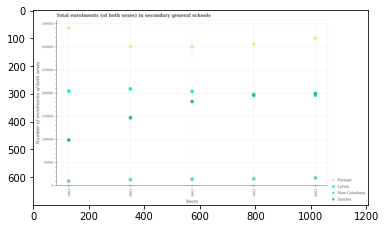

Number of QA =  29





,Years,Latvia,Zambia,New Caledonia,Finland
0,1994,200170.686331,197500.161329,18052.400919,320306.848986
1,1986,210492.208074,148278.577423,14230.155555,301975.934693
2,1981,205602.168064,99919.012555,11139.597632,342470.834768
3,1990,205070.356709,183048.975959,15109.992612,301369.818798
4,1991,NaN,197175.706137,16034.746883,307485.272624


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in latvia in 1981 and that in 1994 ?
PREDICTED =  5431.481733463501
EXPECTED =  8640.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in new caledonia in 1991 and the number of enrolments in secondary schools in zambia in 1994?
PREDICTED =  -2017.6540363269287
EXPECTED =  -184265.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the number of enrolments in secondary schools in latvia and number of enrolments in secondary schools in finla

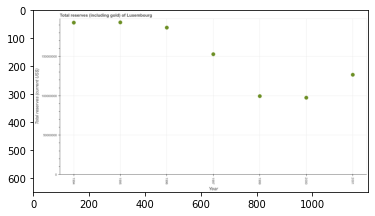

Number of QA =  24





,Year,Total reserves (current US$)
0,1994,1.931819e+08
1,2001,1.270726e+08
2,1996,1.867470e+08
3,1995,1.933756e+08
4,1999,9.993316e+07
5,1997,1.530078e+08
6,2000,9.793379e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (including gold) in 1996 and 1997 ?
PREDICTED =  33739264.106906325
EXPECTED =  33762420.884959996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total reserves (including gold) ?
PREDICTED =  153007767.92816168
EXPECTED =  152705833.0954




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total reserves (including gold) in 2000 to that in 2001 ?
PREDICTED =  1.7706918978605102
EXPECTED =  0.7696557890519596




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after train

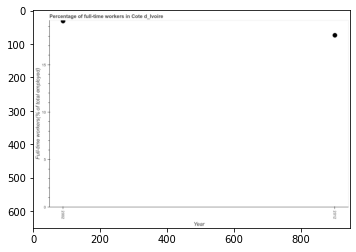

Number of QA =  20





,Year,Full-time workers(% of total employed)
0,2012,18.208440
1,2002,19.701212


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in 2002 and 2012 ?
PREDICTED =  1.4927714458227044
EXPECTED =  1.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of full-time workers ?
PREDICTED =  18.954825890421723
EXPECTED =  18.8500003814697




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of full-time workers in 2002 to that in 2012 ?
PREDICTED =  1.0819823901492827
EXPECTED =  1.0828729264301928




				 3 / 3 = 1.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Full-time workers(% of total employed)
EXP

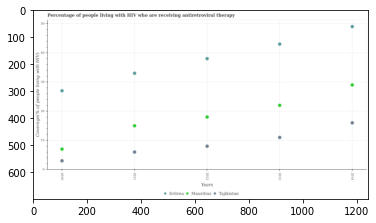

Number of QA =  28





,Years,Eritrea,Tajikistan,Mauritius
0,2012,38.083159,8.133197,18.120654
1,2014,49.078984,16.131728,29.105685
2,2010,27.087194,3.152413,7.124542
3,2013,43.089980,11.147052,22.115177
4,2011,33.081437,6.131722,15.121503


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the hiv infected people who are receiving antiretroviral therapy in eritrea in 2011 and that in 2014 ?
PREDICTED =  -15.997546839367217
EXPECTED =  -16




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the hiv infected people who are receiving antiretroviral therapy in mauritius in 2013 and the percentage of the hiv infected people who are receiving antiretroviral therapy in tajikistan in 2012?
PREDICTED =  3.9945225188440183
EXPECTED =  14




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the per

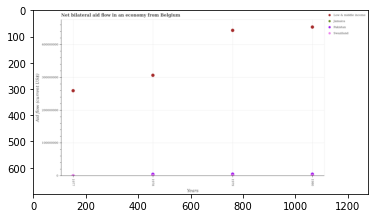

Number of QA =  29





,Years,Pakistan,Low & middle income,Swaziland,Jamaica
0,1977,NaN,2.607300e+08,2.072910e+06,NaN
1,1980,6.745633e+06,4.544102e+08,NaN,NaN
2,1978,5.751045e+06,3.072806e+08,NaN,NaN
3,1979,3.018658e+06,4.441321e+08,NaN,6.847854e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in low & middle income in 1978 and that in 1979 ?
PREDICTED =  -136851538.31382304
EXPECTED =  -136790000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in low & middle income in 1978 and the net bilateral aid flow in pakistan in 1980?
PREDICTED =  -147129649.64864862
EXPECTED =  301140000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the net bilateral aid flow in jamaica and net bilateral aid flow in low & middle income ?
PREDICTED =  6847849.695087131
EXPECTED =  -4528

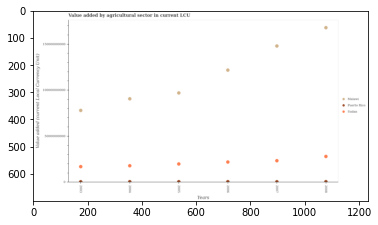

Number of QA =  28





,Years,Sudan,Puerto Rica,Malawi
0,2004,1.848841e+10,1.139986e+09,9.145220e+10
1,2006,2.253187e+10,1.161769e+09,1.227717e+11
2,2008,2.860395e+10,1.083781e+09,1.690707e+11
3,2003,1.752605e+10,1.079686e+09,7.877896e+10
4,2007,2.395443e+10,1.051338e+09,1.490097e+11
5,2005,2.031693e+10,1.168262e+09,9.779079e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in sudan in 2005 and that in 2006 ?
PREDICTED =  -2214941717.56184
EXPECTED =  -2101083400




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in sudan in 2006 and the value added by agricultural sector in malawi in 2007?
PREDICTED =  -1422565422.4485626
EXPECTED =  -126092553500




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the value added by agricultural sector in malawi and value added by agricultural sector in puerto rico ?
PREDICTED =  169070740480.

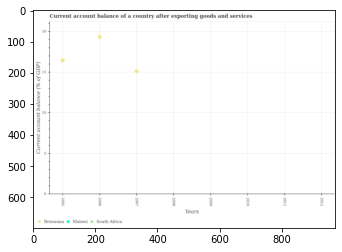

Number of QA =  21





,Years,Botswana,South Africa,Malawi
0,2008,NaN,NaN,NaN
1,2006,19.325793,NaN,NaN
2,2012,NaN,NaN,NaN
3,2009,NaN,NaN,NaN
4,2005,16.454856,NaN,NaN
5,2010,NaN,NaN,NaN
6,2011,NaN,NaN,NaN
7,2007,15.105169,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest account balance in botswana ?
PREDICTED =  -2.8709365559969022
EXPECTED =  2.8738950475084017




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest account balance in botswana ?
PREDICTED =  0.0
EXPECTED =  19.3260279788078




				 0 / 3 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Current account balance (% of GDP)
EXPECTED =  5.0




				 0 / 4 = 0.0


> what is the title of the graph ?
PREDICTED =  Current account balance 

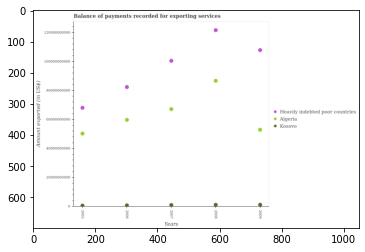

Number of QA =  28





,Years,Algeria,Heavily indebted poor countries,Kosovo
0,2007,6.754416e+10,1.008827e+11,1.328134e+09
1,2006,6.017254e+10,8.280247e+10,1.065097e+09
2,2009,5.329954e+10,1.083889e+11,1.485001e+09
3,2008,8.709929e+10,1.221232e+11,1.524180e+09
4,2005,5.068462e+10,6.848428e+10,8.645031e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in heavily indebted poor countries in 2008 and that in 2009 ?
PREDICTED =  13734364356.859451
EXPECTED =  13742276141.557999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in heavily indebted poor countries in 2007 and the amount exported in algeria in 2009?
PREDICTED =  -7506170214.450272
EXPECTED =  47539531196.45599




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the rati

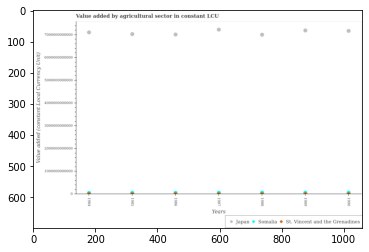

Number of QA =  28





,Years,Somalia,St. Vincent and the Grenadines,Japan
0,1986,7.480572e+10,NaN,7.036340e+12
1,1987,7.769341e+10,NaN,7.253109e+12
2,1984,5.057906e+10,NaN,7.131950e+12
3,1985,5.284775e+10,NaN,7.055333e+12
4,1988,8.042269e+10,NaN,7.028641e+12
5,1989,6.855721e+10,NaN,7.217621e+12
6,1990,6.823204e+10,NaN,7.196328e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in st. vincent and the grenadines in 1987 and that in 1990 ?
PREDICTED =  -145925450070.23825
EXPECTED =  -45319096.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in somalia in 1989 and the value added by agricultural sector in st. vincent and the grenadines in 1987?
PREDICTED =  -9136197003.140144
EXPECTED =  59704224591.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the value added by agricultural sector in st. vincent and the grenadines and va

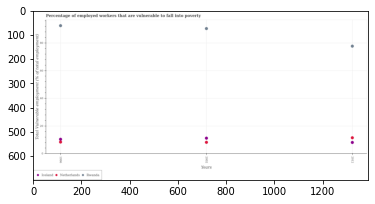

Number of QA =  28





,Years,Iceland,Rwanda,Netherlands
0,1996,10.706878,92.652655,8.796980
1,2002,11.475486,90.536300,8.568064
2,2012,8.417892,77.877403,11.827129


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed workers who are vulnerable to fall into poverty in rwanda in 1996 and that in 2002 ?
PREDICTED =  2.1163557058525413
EXPECTED =  2.0999984741210938




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed workers who are vulnerable to fall into poverty in netherlands in 2002 and the percentage of employed workers who are vulnerable to fall into poverty in iceland in 1996?
PREDICTED =  -0.22891511557181765
EXPECTED =  -2.1999998092651616




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is

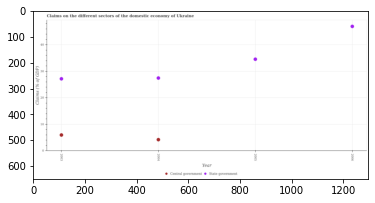

Number of QA =  26





,Year,State government,Central government
0,2005,34.632796,NaN
1,2004,27.545172,4.349264
2,2003,27.286025,6.095012
3,2006,46.959222,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the claims on state government in 2003 and that in 2005 ?
PREDICTED =  -7.346771759594642
EXPECTED =  -7.390826336901302




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the claims on state government in 2003 and the claims on central government in 2004?
PREDICTED =  -0.25914734167914943
EXPECTED =  22.953040087382867




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the claims on state government in 2003

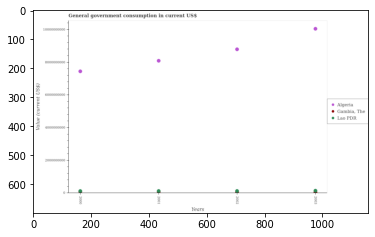

Number of QA =  28





,Years,Algeria,Lao PDR,"Gambia, The"
0,2001,8.099828e+09,4.550358e+07,1.391186e+08
1,2003,1.005360e+10,6.318149e+07,1.587974e+08
2,2000,7.456070e+09,1.361567e+08,NaN
3,2002,8.800251e+09,1.403434e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in gambia, the in 2000 and that in 2001 ?
PREDICTED =  -139118623.83136505
EXPECTED =  9762793.170466408




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in lao pdr in 2003 and the government conusmption in algeria in 2001?
PREDICTED =  17677910.85057988
EXPECTED =  -7950355791.195213




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the government conusmption in lao pdr and government conusmption in gambia, the ?
PREDICTED =  1224757.574446261
EXPECTED =  41259588.482657194





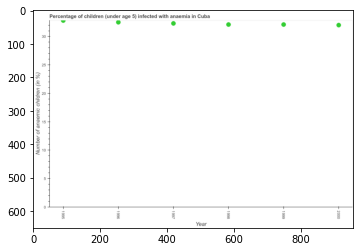

Number of QA =  24





,Year,Number of anaemic children (in %)
0,1999,32.148532
1,1998,32.142893
2,2000,32.029608
3,1997,32.335338
4,1995,32.805295
5,1996,32.547555


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of anaemic children in 1996 and 1997 ?
PREDICTED =  0.21221769474536956
EXPECTED =  0.20000000000000284




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of anaemic children ?
PREDICTED =  32.24193497909023
EXPECTED =  32.2




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of anaemic children in 1999 to that in 2000 ?
PREDICTED =  1.0037129531616322
EXPECTED =  1.003125




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the dif

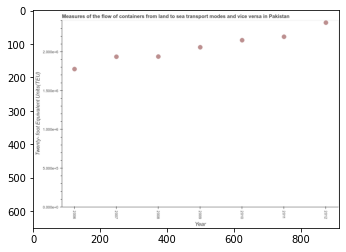

Number of QA =  24





,Year,Twenty- foot Equivalent Units(TEU)
0,2010,2.154673
1,2012,2.379173
2,2008,1.942688
3,2006,1.783239
4,2009,2.062829
5,2007,1.940382
6,2011,2.197638


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in 2007 and 2012 ?
PREDICTED =  -0.43879041018220954
EXPECTED =  -439276.2250000001




				 0 / 1 = 0.0


> what is the median container port traffic ?
PREDICTED =  None
EXPECTED =  2058056.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the container port traffic in 2008 to that in 2010 ?
PREDICTED =  0.901616372975105
EXPECTED =  0.9018152629129828




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest container port traffic ?
PREDICTED =  0.2704218576055766
EXPECTED =  181755.2250000001




				

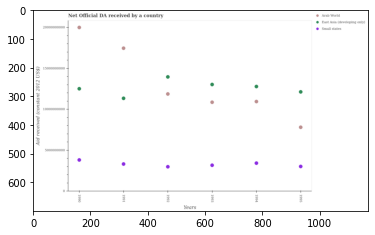

Number of QA =  28





,Years,Arab World,East Asia (developing only),Small states
0,1994,1.097846e+10,1.280478e+10,3.471154e+09
1,1995,7.843100e+09,1.215612e+10,3.080471e+09
2,1992,1.189907e+10,1.398586e+10,3.044307e+09
3,1991,1.746757e+10,1.137239e+10,3.371157e+09
4,1993,1.089234e+10,1.304995e+10,3.222909e+09
5,1990,1.999914e+10,1.252903e+10,3.865767e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official development assistance aid received in east asia (developing only) in 1990 and that in 1994 ?
PREDICTED =  -275747414.6512947
EXPECTED =  -270110000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official development assistance aid received in arab world in 1994 and the net official development assistance aid received in east asia (developing only) in 1990?
PREDICTED =  -9020671121.604902
EXPECTED =  -1565750000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the net official development assistance aid 

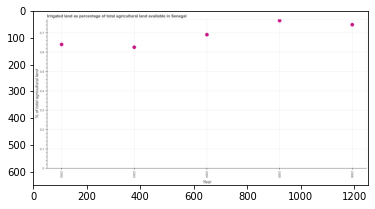

Number of QA =  24





,Year,% of total agricuttural land
0,2004,0.695992
1,2002,0.645223
2,2006,0.747521
3,2003,0.630523
4,2005,0.768999


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural irrigated land in 2004 and 2006 ?
PREDICTED =  -0.05152872616974302
EXPECTED =  -0.05153708288474612




				 1 / 1 = 1.0


> what is the median percentage of agricultural irrigated land ?
PREDICTED =  None
EXPECTED =  0.690687233797629




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of agricultural irrigated land in 2003 to that in 2006 ?
PREDICTED =  0.8434845315336511
EXPECTED =  0.8428439030848665




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest percentage of agricultura

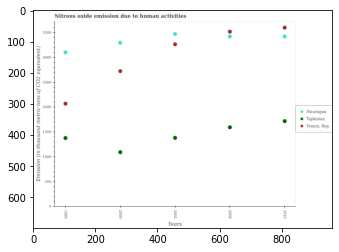

Number of QA =  28





,Years,Nicaragua,"Yemen, Rep.",Tajikistan
0,2005,3471.529340,3265.850533,1388.244128
1,1990,3103.499871,2074.176497,1382.581614
2,2008,3421.488193,3517.838098,1599.325513
3,2000,3296.578095,2725.961798,1101.393458
4,2010,3423.279805,3600.665051,1723.371504


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in yemen, rep. in 2005 and that in 2008 ?
PREDICTED =  -251.9875642067741
EXPECTED =  -253.80000000000018




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in nicaragua in 2000 and the amount of nitrous oxide emitted in tajikistan in 2008?
PREDICTED =  -124.9100976455884
EXPECTED =  1701.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of nitrous oxide emitted in tajikistan and amount of nitrous oxide emitted in yemen, rep. ?
PREDICTED =  -13745.50

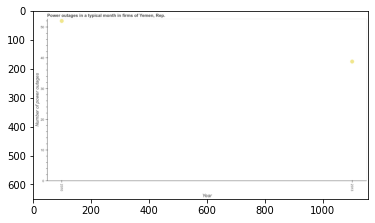

Number of QA =  20





,Year,Number of power outages
0,2010,52.093534
1,2013,38.930632


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of power outages in 2010 and 2013 ?
PREDICTED =  13.162902209953387
EXPECTED =  13.200000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of power outages ?
PREDICTED =  45.512082861675786
EXPECTED =  45.4




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of power outages in 2010 to that in 2013 ?
PREDICTED =  1.3381117032011263
EXPECTED =  1.3402061855670104




				 3 / 3 = 1.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Number of power outages
EXPECTED =  10.0




				 3 / 4 = 0.75


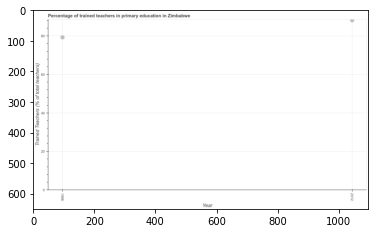

Number of QA =  20





,Year,Trained Teachers (% of total teachers)
0,1998,79.368129
1,2012,88.213251


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained teachers in 1998 and 2012 ?
PREDICTED =  -8.845122061569
EXPECTED =  -8.8666190283203




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of trained teachers ?
PREDICTED =  2005.0
EXPECTED =  83.72081951416015




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of trained teachers in 1998 to that in 2012 ?
PREDICTED =  0.8997302335591619
EXPECTED =  0.8994191295852765




				 2 / 3 = 0.6667


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Trained Teachers (% of total teachers)
EXPE

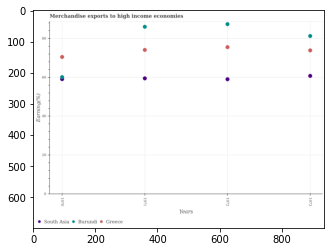

Number of QA =  28





,Years,Greece,South Asia,Burundi
0,1973,74.128367,61.012975,81.485745
1,1971,74.343056,59.700486,86.187738
2,1972,75.738316,59.244205,87.561074
3,1970,70.782465,60.314050,59.272796


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in burundi in 1970 and that in 1971 ?
PREDICTED =  -26.914942302772936
EXPECTED =  -25.86364141919701




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in greece in 1973 and the percentage of amount earned from merchandise exports in burundi in 1971?
PREDICTED =  -12.059371273917918
EXPECTED =  -12.122191999907812




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1970, what is the difference between the percentage of amount earned from merchandise exports i

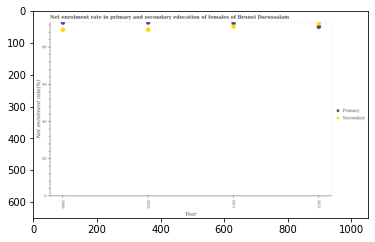

Number of QA =  27





,Year,Secondary,Primary
0,2010,89.404475,93.274214
1,2009,89.423280,93.260159
2,2012,92.608876,90.974658
3,2011,91.080236,93.057885


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in 2009 and that in 2010 ?
PREDICTED =  -0.014054331800963382
EXPECTED =  -0.08135223388669033




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in 2010 and the enrollment rate in secondary education in 2012?
PREDICTED =  2.2995561825951825
EXPECTED =  0.5608291625977131




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the enrollment rate in primary education and enrollment rate in secondary education ?
PREDICTED =  -186.3180448130491
EXPECTED =  1.81

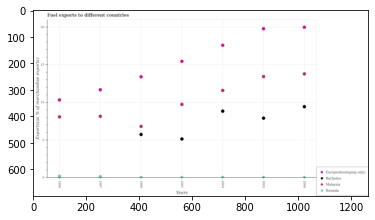

Number of QA =  29





,Years,Barbados,Rwanda,Malaysia,Europe(developing only)
0,2005,7.971981,0.068868,13.522112,19.901119
1,1996,NaN,0.197626,8.130848,10.397105
2,2004,8.910842,0.066633,11.662207,17.688131
3,1999,5.787648,0.051231,6.879100,13.489308
4,2001,5.189895,0.062037,9.804499,15.547420
5,1997,NaN,0.159535,8.215319,11.751773
6,2006,9.504171,0.054836,13.878732,20.100904


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in malaysia in 2001 and that in 2006 ?
PREDICTED =  -5.536932229739522
EXPECTED =  -4.052191098064149




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in malaysia in 1997 and the percentage of exports to different countries in rwanda in 2005?
PREDICTED =  -5.30679378320349
EXPECTED =  8.129493249187187




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of exports to different countries in malaysia and percentage of export

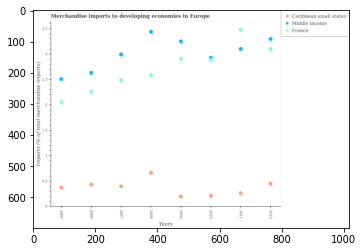

Number of QA =  28





,Years,Caribbean small states,France,Middle income
0,2006,0.445815,2.284947,2.660879
1,2008,0.676134,2.616362,3.472636
2,2012,0.462182,3.131658,3.333176
3,2011,0.272541,3.512780,3.133953
4,2005,0.386152,2.075250,2.533950
5,2010,0.223727,2.958783,2.917201
6,2009,0.207175,2.937482,3.282321
7,2007,0.409619,2.511303,3.021967


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage total merchandise imports in france in 2006 and that in 2011 ?
PREDICTED =  -1.2278326595506486
EXPECTED =  -1.22071425326371




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage total merchandise imports in middle income in 2007 and the percentage total merchandise imports in france in 2010?
PREDICTED =  0.10476588926012198
EXPECTED =  0.10404070154008016




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage total merchandise imports in france and percentage total merchandise imports in middle 

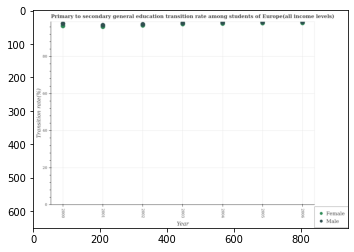

Number of QA =  27





,Year,Male,Female
0,2004,97.816396,NaN
1,2005,98.084902,NaN
2,2006,98.124536,NaN
3,2000,96.401189,97.554885
4,2003,97.669870,NaN
5,2001,96.853821,NaN
6,2002,97.016099,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among female students in 2001 and that in 2002 ?
PREDICTED =  0.0
EXPECTED =  -0.7353897094727984




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among male students in 2006 and the transition rate among female students in 2002?
PREDICTED =  1.1084370681534352
EXPECTED =  1.8648376464842897




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the transition rate among female students and transition rate among male students ?
PREDICTED =  0.0
EXPECTED =  -0.5187377929688068




				 0 / 3 = 0.0


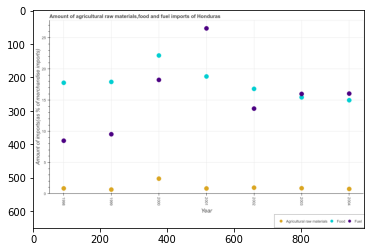

Number of QA =  28





,Year,Unnamed: 1,Agricultural raw materials,Fuel
0,2003,15.511014,0.970041,16.062877
1,2004,15.069896,0.844067,16.126856
2,2002,16.887991,1.059545,13.718707
3,2001,18.874395,0.929542,26.575523
4,2000,22.223662,2.506366,18.310844
5,1999,17.999168,0.754036,9.613165
6,1998,17.860094,0.939108,8.553124


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of raw materials imports in 2000 and that in 2002 ?
PREDICTED =  1.446821340098959
EXPECTED =  1.449037050463727




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports in 2000 and the percentage of raw materials imports in 2004?
PREDICTED =  17.466776722021823
EXPECTED =  21.41421700405336




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of fuel imports and percentage of food imports ?
PREDICTED =  90.80213410334373
EXPECTED =  1.0619584550701013




				 1 / 3 = 0.3333


is_b

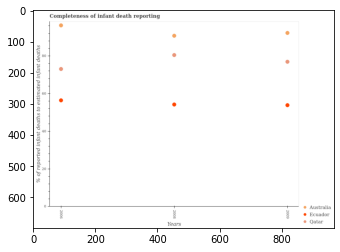

Number of QA =  28





,Years,Ecuador,Australia,Qatar
0,2008,54.398005,90.878001,80.609102
1,2009,54.010972,92.413350,77.064289
2,2006,56.561136,96.312082,73.220545


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of infant deaths reported in qatar in 2006 and that in 2008 ?
PREDICTED =  -7.388556584085364
EXPECTED =  -7.410881801125711




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of infant deaths reported in ecuador in 2006 and the percentage of infant deaths reported in qatar in 2008?
PREDICTED =  2.1631307155116417
EXPECTED =  -24.071707687464098




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of infant deaths reported in qatar and percentage of infant deaths reported in ecuador ?
PREDICT

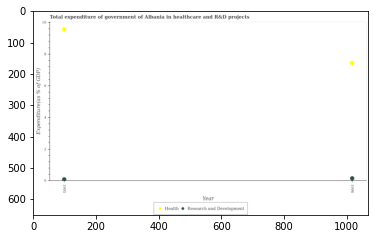

Number of QA =  23





,Year,Research and Development,Health
0,1995,0.114012,9.585996
1,1996,0.183932,7.461627


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in healthcare in 1995 and that in 1996 ?
PREDICTED =  2.124368569123744
EXPECTED =  2.12473828




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in healthcare in 1996 and the expenditure in r&d in 1995?
PREDICTED =  -2.124368569123744
EXPECTED =  7.34460435




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the expenditure in r&d and expenditure in healthcare ?
PREDICTED =  -15.047623029092371
EXPECTED =  -9.46934263




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tr

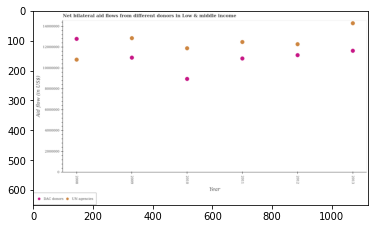

Number of QA =  27





,Year,DAC donors,UN agencies
0,2013,1.179149e+07,1.444096e+07
1,2012,1.136124e+07,1.241315e+07
2,2011,1.103729e+07,1.263125e+07
3,2008,1.293042e+07,1.093456e+07
4,2009,1.111694e+07,1.299406e+07
5,2010,9.062100e+06,1.202043e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow from dac donors in 2009 and that in 2010 ?
PREDICTED =  2054842.4638793766
EXPECTED =  2040000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow from un agencies in 2013 and the aid flow from dac donors in 2008?
PREDICTED =  3506400.2511634044
EXPECTED =  1500000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the aid flow from dac donors and aid flow from un agencies ?
PREDICTED =  55507989.4200567
EXPECTED =  -1050000




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tr

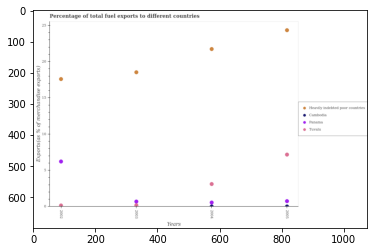

Number of QA =  29





,Years,Cambodia,Panama,Heavily indebted poor countries,Tuvalu
0,2003,NaN,0.735950,18.625768,0.210362
1,2002,NaN,6.293378,17.686216,0.165705
2,2004,0.091599,0.624955,21.842306,3.176852
3,2005,0.081518,0.796669,24.454145,7.247075


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in cambodia in 2003 and that in 2005 ?
PREDICTED =  -1.0
EXPECTED =  0.0009564955630859261




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of exports to different countries in cambodia and percentage of exports to different countries in heavily indebted poor countries ?
PREDICTED =  -3.0
EXPECTED =  -24.332080108839673




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tr

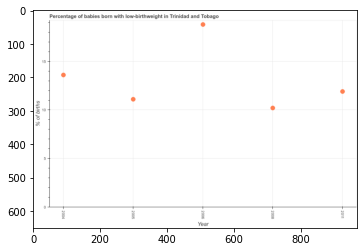

Number of QA =  24





,Year,% of births
0,2005,11.243030
1,2011,12.044635
2,2006,18.982955
3,2008,10.341637
4,2004,13.745253


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of babies who were born with low-birthweight in 2005 and 2011 ?
PREDICTED =  -0.8016041355753778
EXPECTED =  -0.8000000000000007




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of babies who were born with low-birthweight ?
PREDICTED =  12.04463450852664
EXPECTED =  11.9




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of babies who were born with low-birthweight in 2004 to that in 2005 ?
PREDICTED =  1.2225577098220997
EXPECTED =  1.2252252252252251




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: [

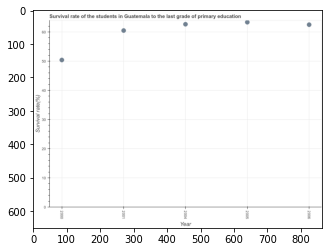

Number of QA =  24





,Year,Survival rate(%)
0,2000,50.550345
1,2005,63.459109
2,2004,62.786860
3,2001,60.602530
4,2006,62.629300


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate in primary education in 2000 and 2004 ?
PREDICTED =  -12.236515070522614
EXPECTED =  -12.255180358886697




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median survival rate in primary education ?
PREDICTED =  2004.0
EXPECTED =  62.4939308166504




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the survival rate in primary education in 2000 to that in 2004 ?
PREDICTED =  0.8051102554461476
EXPECTED =  0.8043800281937806




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trai

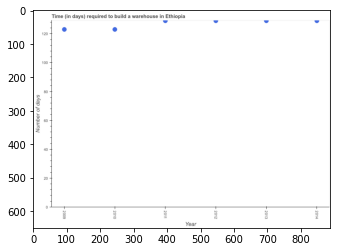

Number of QA =  24





,Year,Number of days
0,2013,129.421781
1,2011,129.456067
2,2010,123.435388
3,2009,123.435468
4,2012,129.466680
5,2014,129.423111


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time required to build a warehouse in 2009 and 2010 ?
PREDICTED =  7.976755912864064e-05
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median time required to build a warehouse ?
PREDICTED =  2011.5
EXPECTED =  129.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the time required to build a warehouse in 2009 to that in 2011 ?
PREDICTED =  15.52650292786984
EXPECTED =  0.9534883720930233




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the

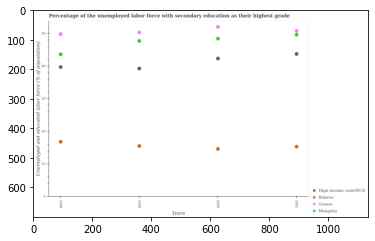

Number of QA =  29





,Years,Mongolia,High income: nonOECD,Greece,Belarus
0,1998,43.795462,39.908971,50.014837,16.942824
1,1999,47.929631,39.422606,50.517193,15.645528
2,2001,49.792755,43.939162,51.037557,15.454469
3,2000,48.632164,42.529156,52.211336,14.764894


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with secondary education in belarus in 1998 and that in 2000 ?
PREDICTED =  2.1779300790732314
EXPECTED =  2.1999988555908008




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with secondary education in high income: nonoecd in 2000 and the percentage of the unemployed labor force with secondary education in mongolia in 2001?
PREDICTED =  -1.4100057905099064
EXPECTED =  -7.275286956944399




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_a

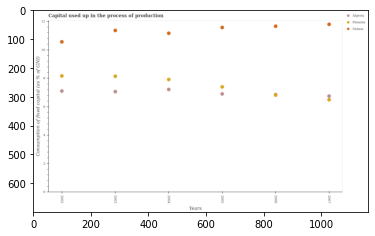

Number of QA =  28





,Years,Algeria,Samoa,Panama
0,2004,7.215998,11.155103,7.915944
1,2002,7.102148,10.549256,8.160411
2,2006,NaN,11.642008,6.826263
3,2003,7.071028,11.351723,8.143109
4,2005,6.909486,11.557427,7.398802
5,2007,6.745313,11.780300,6.500535


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the capital used up in the process of production in algeria in 2006 and that in 2007 ?
PREDICTED =  nan
EXPECTED =  0.10651760761485995




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the capital used up in the process of production in samoa in 2006 and the capital used up in the process of production in algeria in 2005?
PREDICTED =  0.48690490857293156
EXPECTED =  4.75885849687598




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the capital used up in the process of production in algeria and capital used up in the process of pro

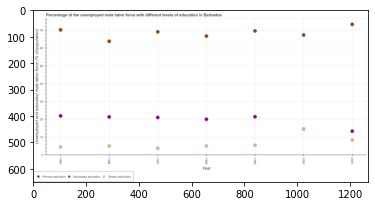

Number of QA =  28





,Year,Primary education,Secondary education,Tertiary education
0,2001,13.602075,73.776750,8.621446
1,1998,20.358169,67.134850,5.322290
2,1996,21.660925,64.248900,5.307781
3,1999,21.735584,70.095369,5.724052
4,1995,22.255223,70.682503,4.681296
5,2000,NaN,67.776777,14.821764
6,1997,21.370274,69.538653,4.000271


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received tertiary education in 1995 and that in 2000 ?
PREDICTED =  -10.14046781677735
EXPECTED =  -10.09999990463257




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received secondary education in 1999 and the percentage of male labor force who received primary education in 1998?
PREDICTED =  2.960519397246344
EXPECTED =  49.599998474120994




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evalua

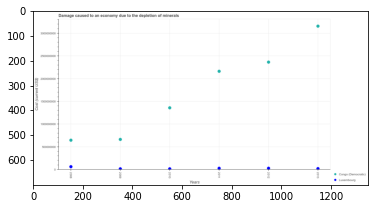

Number of QA =  27





,Years,Luxembourg,Congo (Democratic)
0,2009,2.485263e+07,6.770042e+08
1,2012,3.773266e+07,2.386925e+09
2,2011,3.694096e+07,2.183062e+09
3,2010,2.568072e+07,1.375819e+09
4,2013,2.884534e+07,3.181296e+09
5,2008,7.375109e+07,6.585426e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in luxembourg in 2012 and that in 2013 ?
PREDICTED =  8887320.401193276
EXPECTED =  7825903.537843399




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in luxembourg in 2013 and the cost of damage caused due to the depletion of minerals in congo (democratic) in 2009?
PREDICTED =  3992710.6696235687
EXPECTED =  -643064150.6847273




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the cost of damage caused due to the de

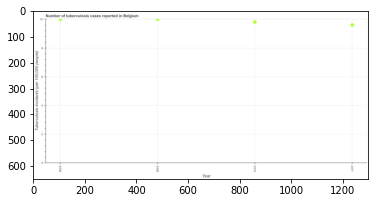

Number of QA =  24





,Year,"Tuberculosis incidents (per 100,000 people)"
0,2011,9.562062
1,2010,9.756605
2,2008,9.963114
3,2009,9.956166


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis incidents in 2009 and 2011 ?
PREDICTED =  0.39410422735673123
EXPECTED =  0.40000000000000036




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of tuberculosis incidents ?
PREDICTED =  9.856385392609717
EXPECTED =  9.9




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of tuberculosis incidents in 2009 to that in 2010 ?
PREDICTED =  1.0204540096854018
EXPECTED =  1.0204081632653061




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

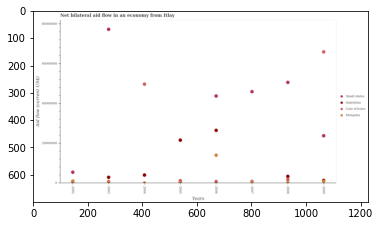

Number of QA =  28





,Years,Mongolia,Argentina,Cote d'Ivoire,Small states
0,2005,NaN,2.181850e+07,1.218329e+06,NaN
1,2004,3.132043e+05,4.247332e+06,4.995350e+07,NaN
2,2003,NaN,3.055745e+06,8.518467e+05,7.751275e+07
3,2009,1.465731e+06,NaN,6.621663e+07,2.402125e+07
4,2002,1.099918e+06,NaN,NaN,5.638966e+06
5,2008,4.852762e+05,3.583079e+06,1.967838e+06,5.084584e+07
6,2006,1.421850e+07,2.673166e+07,9.360218e+05,4.400645e+07
7,2007,9.712429e+05,NaN,2.841931e+05,4.622394e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in cote d'ivoire in 2006 and that in 2009 ?
PREDICTED =  -65280611.21890732
EXPECTED =  -65210000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in mongolia in 2004 and the net bilateral aid flow in argentina in 2009?
PREDICTED =  -1152526.2472617284
EXPECTED =  -1320000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the net bilateral aid flow in small states and net bilateral aid flow in argentina ?
PREDICTED =  2001.6
EXPECTED =  -20940000.0




				 1 / 3 = 0.3333




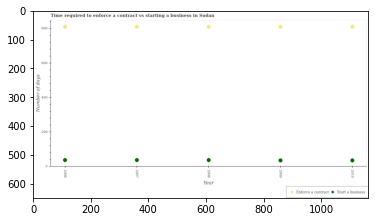

Number of QA =  27





,Year,Start a business,Enforce a contract
0,2006,39.442644,807.324006
1,2008,39.296801,807.725853
2,2009,37.729919,807.870521
3,2010,37.579780,807.597119
4,2007,39.542906,807.364162


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to start a business in 2009 and that in 2010 ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to start a business in 2010 and the number of days to enforece a contract in 2009?
PREDICTED =  -36.729919245499225
EXPECTED =  -775




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the number of days to enforece a contract and number of days to start a business ?
PREDICTED =  -2.0
EXPECTED =  773




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: Fal

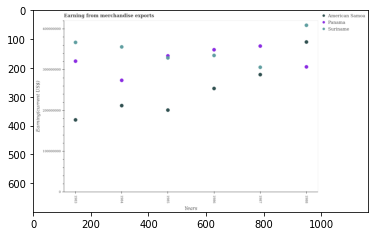

Number of QA =  28





,Years,Suriname,Panama,American Samoa
0,1988,4.108980e+08,3.086755e+08,3.698465e+08
1,1986,3.367180e+08,3.509525e+08,2.556154e+08
2,1984,3.578411e+08,2.756984e+08,2.135444e+08
3,1983,3.688526e+08,3.225850e+08,1.783010e+08
4,1985,3.306970e+08,3.358865e+08,2.024925e+08
5,1987,3.077758e+08,3.598441e+08,2.897924e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in suriname in 1983 and that in 1984 ?
PREDICTED =  11011483.229732215
EXPECTED =  11000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in suriname in 1985 and the amount earned from merchandise exports in american samoa in 1986?
PREDICTED =  -6021034.156371951
EXPECTED =  75000000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the amount earned from merchandise exports in panama and amount earned from merchandise exports in suriname ?
P

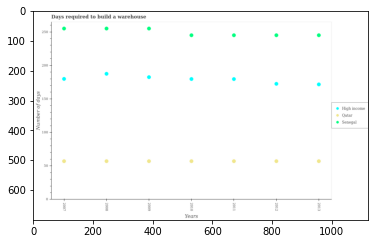

Number of QA =  28





,Years,Unnamed: 1,High income,Senegal
0,2008,57.771542,188.247375,256.031214
1,2007,57.885087,180.609329,256.057792
2,2009,57.837071,183.181696,255.954885
3,2013,57.856578,172.499324,245.872424
4,2011,57.790708,180.414616,245.845200
5,2012,57.813189,173.350148,245.854863
6,2010,57.834812,180.515050,245.794671


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in in high income in 2009 and that in 2011 ?
PREDICTED =  -1953.1629290840497
EXPECTED =  2.863095238096008




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in in qatar in 2013 and the days required to build a warehouse in in high income in 2007?
PREDICTED =  -1950.1434219969112
EXPECTED =  -122.811320754717




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the days required to build a warehouse in in qatar and days required to build a warehouse in in hig

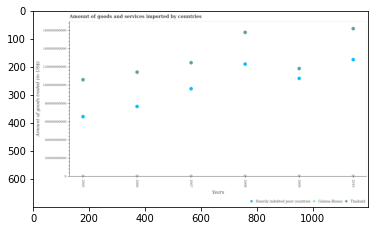

Number of QA =  28





,Years,Heavily indebted poor countries,Guinea-Bissau,Thailand
0,2005,6.602238e+10,7.173395e+08,1.065628e+11
1,2009,1.080606e+11,6.829675e+08,1.189103e+11
2,2006,7.721620e+10,8.183830e+08,1.149408e+11
3,2008,1.237710e+11,8.450178e+08,1.585533e+11
4,2010,1.287030e+11,6.776686e+08,1.627467e+11
5,2007,9.670778e+10,8.020739e+08,1.253505e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services imported in guinea-bissau in 2005 and that in 2010 ?
PREDICTED =  -677668627.6908157
EXPECTED =  -90642708.1




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services imported in heavily indebted poor countries in 2007 and the total amount of goods and services imported in guinea-bissau in 2010?
PREDICTED =  -225410804745.7248
EXPECTED =  95900576851.7682




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total amount of goods and services imported in heavily i

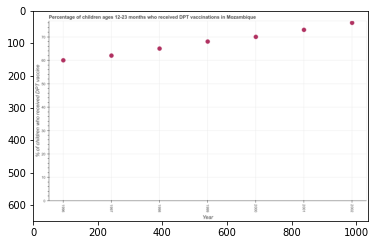

Number of QA =  24





,Year,% of children who received DPT vaccine
0,1999,68.675424
1,1998,65.686049
2,1997,62.655139
3,2000,70.713248
4,1996,60.639717
5,2001,73.717242
6,2002,76.725360


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccine in 1998 and 2002 ?
PREDICTED =  -11.039311641929018
EXPECTED =  -11




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of children who received dpt vaccine ?
PREDICTED =  68.67542415410087
EXPECTED =  68.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of children who received dpt vaccine in 1996 to that in 2002 ?
PREDICTED =  0.7903477629135515
EXPECTED =  0.7894736842105263




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation 

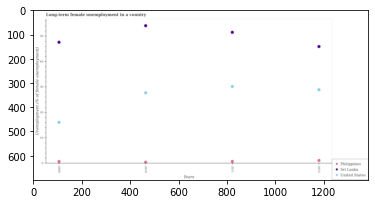

Number of QA =  28





,Years,Philippines,United States,Sri Lanka
0,2009,0.795250,16.172707,47.605522
1,2010,0.526433,27.736994,54.042059
2,2011,0.816449,30.230571,51.454021
3,2012,1.252176,28.922834,45.871587


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed female population in philippines in 2011 and that in 2012 ?
PREDICTED =  -0.4357269208883855
EXPECTED =  -0.40000003576278886




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of long-term unemployed female population in sri lanka and percentage of long-term unemployed female population in united states ?
PREDICTED =  121.13709619535128
EXPECTED =  26.3999977111816




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicti

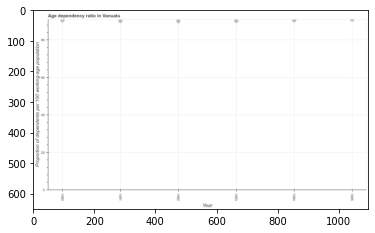

Number of QA =  24





,Year,Proportion of dependents per 100 working-age population
0,1982,90.012807
1,1981,90.131504
2,1984,90.518905
3,1985,90.912719
4,1983,90.168499
5,1980,90.479823


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio in 1981 ?
PREDICTED =  15.021917336321868
EXPECTED =  90.15073765234119




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio ?
PREDICTED =  330.8333333333333
EXPECTED =  90.93405383180858




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio ?
PREDICTED =  330.3333333333333
EXPECTED =  90.0478903217729




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the age dependency ratio 

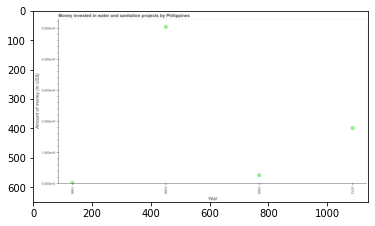

Number of QA =  24





,Year,Amount of money (in US$)
0,2012,1.802400
1,2009,0.285658
2,1999,0.037622
3,2006,5.065479


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investment in 1999 and 2012 ?
PREDICTED =  -1.764777761028193
EXPECTED =  -176700000




				 0 / 1 = 0.0


> what is the median investment ?
PREDICTED =  None
EXPECTED =  102450000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the investment in 1999 to that in 2006 ?
PREDICTED =  0.007427130026772255
EXPECTED =  0.0031752331811867435




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest investment ?
PREDICTED =  0.0
EXPECTED =  325600000




				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
T

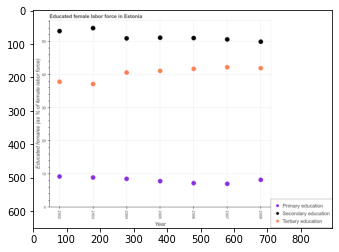

Number of QA =  28





,Year,Primary education,Secondary education,Tertiary education
0,2005,7.965068,51.176294,41.192002
1,2002,9.383029,53.169737,37.920535
2,2008,8.380739,49.954147,41.998538
3,2006,7.414686,51.065943,41.770174
4,2004,8.677958,50.949488,40.706099
5,2003,9.077550,54.056369,37.190171
6,2007,7.204931,50.673814,42.310783


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in 2003 and that in 2004 ?
PREDICTED =  0.39959229205566515
EXPECTED =  0.3999996185302699




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in 2005 and the percentage of female labor force who received secondary education in 2004?
PREDICTED =  -0.7128897397993121
EXPECTED =  -43.100001335144036




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of female labor force who received prima

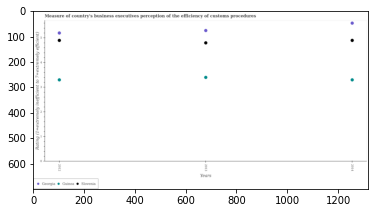

Number of QA =  28





,Years,Georgia,Slovenia,Guinea
0,2013,5.322041,4.818540,3.421645
1,2012,5.216391,4.917311,3.320011
2,2014,5.620026,4.918950,3.318795


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of the efficiency of customs procedure in georgia in 2012 and that in 2013 ?
PREDICTED =  -0.1056492156751716
EXPECTED =  -0.09999999999999964




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of the efficiency of customs procedure in georgia in 2013 and the rating of the efficiency of customs procedure in guinea in 2014?
PREDICTED =  -0.2979858652836027
EXPECTED =  2.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the rating of the efficiency of customs procedure in georgia and rating of the efficiency of 

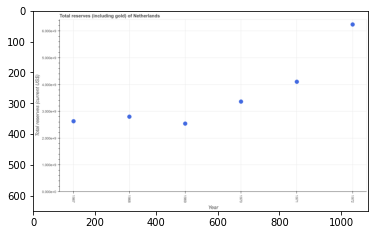

Number of QA =  24





,Year,Total reserves (current US$)
0,1967,2.644282
1,1969,2.558298
2,1970,3.380830
3,1968,2.815974
4,1971,4.117868
5,1972,6.251847


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (including gold) in 1969 and 1971 ?
PREDICTED =  -1.5595699135855003
EXPECTED =  -1562911090.42666




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total reserves (including gold) ?
PREDICTED =  6.2518473769739735
EXPECTED =  3080304436.320655




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total reserves (including gold) in 1968 to that in 1970 ?
PREDICTED =  0.8329237595972966
EXPECTED =  0.8321662758026167




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tr

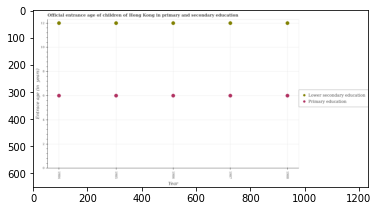

Number of QA =  27





,Year,Primary education,Lower secondary education
0,1985,6.085714,12.128428
1,1988,6.077716,12.122512
2,1984,6.084406,12.131520
3,1987,6.084564,12.125850
4,1986,6.086904,12.127752


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of chiildren in primary education in 1986 and that in 1987 ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of children in lower secondary education in 1986 and the entrance age of chiildren in primary education in 1984?
PREDICTED =  -0.003768232013030115
EXPECTED =  6




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the entrance age of children in lower secondary education and entrance age of chiildren in primary education ?
PREDICTED =  12.12251249097528
EXPECTED

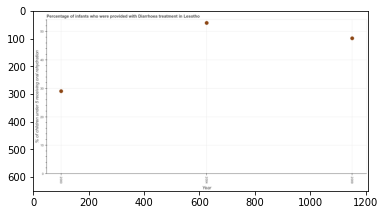

Number of QA =  24





,Year,% of children under 5 receiving oral rehydration
0,2009,47.601880
1,2000,29.053311
2,2004,52.988093


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who were provided with treatment diarrhoea in 2000 and 2004 ?
PREDICTED =  -23.934781920907724
EXPECTED =  -24.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of children who were provided with treatment diarrhoea ?
PREDICTED =  2004.0
EXPECTED =  47.6




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of children who were provided with treatment diarrhoea in 2000 to that in 2009 ?
PREDICTED =  0.6103395636530895
EXPECTED =  0.6092436974789915




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False

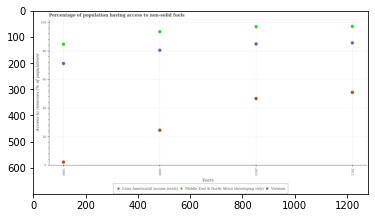

Number of QA =  28





,Years,Latin America(all income levels),Vietnam,Middle East & North Africa (developing only)
0,1990,71.483002,2.598440,84.916108
1,2000,80.729741,24.913370,93.659774
2,2010,85.092209,47.023452,97.207280
3,2012,85.903146,51.318109,97.395615


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to non-solid fuels in latin america(all income levels) in 1990 and that in 2000 ?
PREDICTED =  -9.246738707224793
EXPECTED =  -9.226801130173897




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to non-solid fuels in latin america(all income levels) in 2000 and the percentage of population having access to non-solid fuels in middle east & north africa (developing only) in 2012?
PREDICTED =  -5.17340509248757
EXPECTED =  -16.71404691797069




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the y

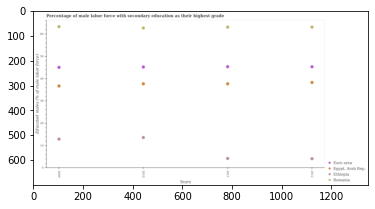

Number of QA =  29





,Years,"Egypt, Arab Rep",Ethiopia,Euro area,Romania
0,2010,37.755103,13.750700,45.217550,62.654583
1,2009,36.704469,13.045982,45.107609,63.251422
2,2011,37.759394,4.374641,45.384182,63.064400
3,2012,38.340783,4.282306,45.348294,63.071230


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with secondary education in euro area in 2009 and that in 2011 ?
PREDICTED =  -0.2765732161807435
EXPECTED =  -0.30095327451450515




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with secondary education in romania in 2012 and the percentage of male labor force with secondary education in euro area in 2009?
PREDICTED =  -0.18019183979442488
EXPECTED =  18.046300047445904




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pr

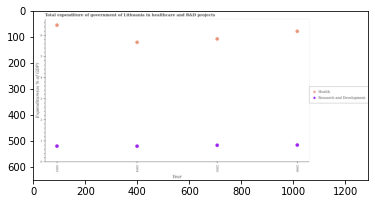

Number of QA =  27





,Year,Research and Development,Health
0,2006,0.828955,6.271995
1,2004,0.773452,5.746018
2,2005,0.819109,5.906991
3,2003,0.778666,6.565372


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in healthcare in 2003 and that in 2005 ?
PREDICTED =  0.6583811658940224
EXPECTED =  0.6526111400000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in healthcare in 2003 and the expenditure in r&d in 2004?
PREDICTED =  0.8193538635034185
EXPECTED =  5.73849833




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the expenditure in r&d and expenditure in healthcare ?
PREDICTED =  -22.49037696013571
EXPECTED =  -5.042107189999999




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: Fa

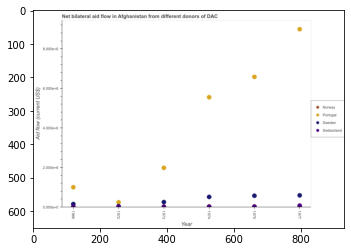

Number of QA =  29





,Year,Unnamed: 1,Switzerland,Norway,Portugal
0,1975,0.604659,0.063449,NaN,6.604061
1,1972,NaN,0.068197,NaN,0.278749
2,1977,0.619974,0.109000,NaN,9.009514
3,1974,0.543513,0.066355,NaN,5.571680
4,1966,0.186468,0.065827,NaN,1.033036
5,1973,0.284121,0.057434,NaN,2.010490


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by switzerland in 1972 and that in 1974 ?
PREDICTED =  0.0018419234179404415
EXPECTED =  -10000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by sweden in 1975 and the amount of aid given by switzerland in 1972?
PREDICTED =  0.5364620033080113
EXPECTED =  560000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the amount of aid given by sweden and amount of aid given by norway ?
PREDICTED =  2.0
EXPECTED =  540000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: F

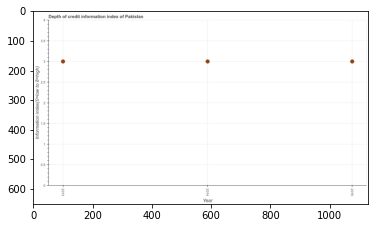

Number of QA =  24





,Year,Information index(O0=low to 8=high)
0,2015,2.998304
1,2014,2.996134
2,2013,2.998111


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the depth of credit information index in 2013 and 2014 ?
PREDICTED =  0.0019772027874878084
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median depth of credit information index ?
PREDICTED =  2.9981112950941475
EXPECTED =  3.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the depth of credit information index in 2013 to that in 2014 ?
PREDICTED =  1.0006599179898406
EXPECTED =  1.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the dif

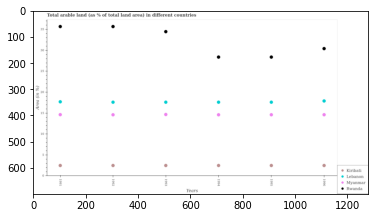

Number of QA =  29





,Years,Kiribati,Myanmar,Rwanda,Lebanon
0,1994,2.538563,14.587077,28.296902,17.567209
1,1996,2.552339,14.611907,30.315899,17.867482
2,1993,2.542091,14.652592,34.329639,17.578928
3,1991,2.543681,14.610315,35.535117,17.644620
4,1992,2.546316,14.594312,35.537069,17.565324
5,1995,2.547655,14.607164,28.302032,17.576261


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of arable land in lebanon in 1995 and that in 1996 ?
PREDICTED =  -0.29122089286455477
EXPECTED =  -0.29325513196479847




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of arable land in kiribati in 1993 and the percentage of arable land in lebanon in 1992?
PREDICTED =  -0.004225175569569473
EXPECTED =  -15.126172115419461




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the percentage of arable land in rwanda and percentage of arable land in kiribati ?
PREDICTED =  32.984729957371066
EXPECTED =  31.9

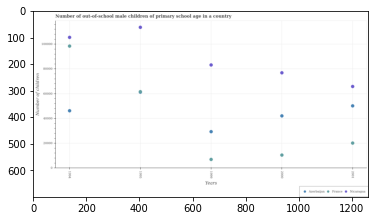

Number of QA =  28





,Years,Nicaragua,France,Azerbaijan
0,1994,105910.071057,98946.534491,46648.535874
1,1995,114086.311637,61841.525039,NaN
2,2001,66254.565947,20484.305028,50566.944440
3,1999,83677.579446,7218.899664,29694.377008
4,2000,77282.884500,10772.315274,42485.173493


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school male children in azerbaijan in 1995 and that in 2000 ?
PREDICTED =  -42485.173493173505
EXPECTED =  19185.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school male children in azerbaijan in 1995 and the number of out-of-school male children in nicaragua in 2000?
PREDICTED =  -77282.88450011528
EXPECTED =  -15595.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the number of out-of-school male children in france and number of out-of-school male children in nicaragua ?
PREDICTE

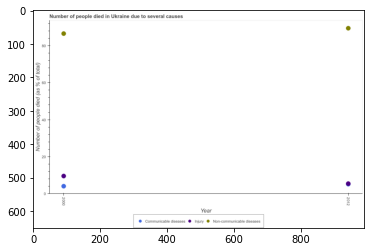

Number of QA =  24





,Year,Communicable diseases,Injury,Non-communicable diseases
0,2000,4.364061,9.875490,87.114787
1,2012,NaN,5.691485,90.014011


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of people who dies of non-communicable diseases in 2000 and that in 2012 ?
PREDICTED =  -89.01401145944527
EXPECTED =  -2.9000000000000057




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the number of people who died of injury and number of people who dies of non-communicable diseases ?
PREDICTED =  -7.875490486898995
EXPECTED =  -77.1




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ra

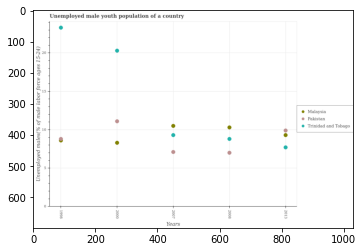

Number of QA =  28





,Years,Pakistan,Malaysia,Trinidad and Tobago
0,2000,11.092893,8.317813,20.240663
1,2007,7.116846,10.497627,9.306636
2,2008,7.024160,10.297352,8.808712
3,1998,8.595262,8.824727,23.226485
4,2013,9.893056,9.317918,7.709452


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male youth population in pakistan in 1998 and that in 2000 ?
PREDICTED =  -2.4976308571007255
EXPECTED =  -2.30000019073484




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male youth population in pakistan in 1998 and the percentage of unemployed male youth population in trinidad and tobago in 2008?
PREDICTED =  1.5711019528803227
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of unemployed male youth population in trinidad and tobago and p

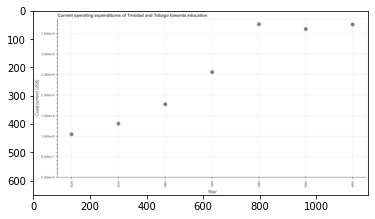

Number of QA =  24





,Year,Cost(current US$)
0,1978,1.063262
1,1983,3.630218
2,1979,1.321820
3,1984,3.739913
4,1981,2.581332
5,1980,1.794602
6,1982,3.746255


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education expenditure in 1982 and 1984 ?
PREDICTED =  0.0063419771073083275
EXPECTED =  637426.0710000396




				 0 / 1 = 0.0


> what is the median education expenditure ?
PREDICTED =  None
EXPECTED =  255973648.468994




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the education expenditure in 1981 to that in 1983 ?
PREDICTED =  0.7110681412437482
EXPECTED =  0.7094240318325338




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest education expenditure ?
PREDICTED =  0.0
EXPECTED =  637426.0710000396




				 1 / 5 = 0.

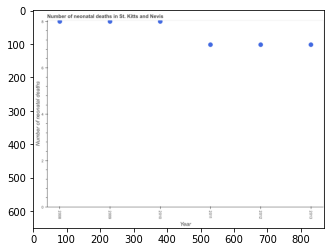

Number of QA =  24





,Year,Number of neonatal deaths
0,2008,8.047750
1,2012,7.044970
2,2013,7.040187
3,2010,8.046173
4,2009,8.048359
5,2011,7.043587


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of neonatal deaths in 2009 and 2010 ?
PREDICTED =  0.0021864558545274804
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of neonatal deaths ?
PREDICTED =  2010.5
EXPECTED =  7.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of neonatal deaths in 2008 to that in 2012 ?
PREDICTED =  1.142339982342783
EXPECTED =  1.1428571428571428




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the hi

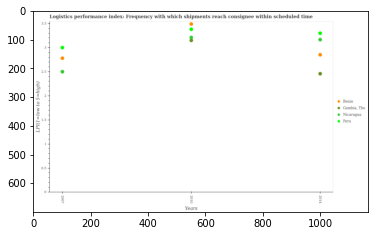

Number of QA =  29





,Years,Benin,"Gambia, The",Peru,Nicaragua
0,2014,2.854616,2.462568,3.302684,3.169298
1,2010,3.492600,3.151882,3.383270,3.214284
2,2007,2.784680,NaN,3.003916,2.502479


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistics performance index in nicaragua in 2007 and that in 2014 ?
PREDICTED =  -0.6668185690864634
EXPECTED =  -0.665664




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistics performance index in nicaragua in 2010 and the logistics performance index in gambia, the in 2007?
PREDICTED =  0.7118052811780928
EXPECTED =  0.71




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the logistics perfor

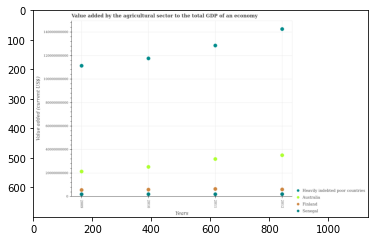

Number of QA =  29





,Years,Australia,Heavily indebted poor countries,Finland,Senegal
0,2011,3.213625e+10,1.281243e+11,6.800877e+09,2.290992e+09
1,2009,2.157971e+10,1.110819e+11,5.922053e+09,2.380552e+09
2,2010,2.549635e+10,1.172372e+11,6.270463e+09,2.388900e+09
3,2012,3.531295e+10,1.420384e+11,6.473209e+09,2.505406e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector to the total gdp in senegal in 2011 and that in 2012 ?
PREDICTED =  -214413748.05964947
EXPECTED =  -91675127.77610016




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector to the total gdp in finland in 2012 and the value added by the agricultural sector to the total gdp in senegal in 2010?
PREDICTED =  202745647.52282238
EXPECTED =  4050292339.2284775




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the value added by the agricultural sector to the 

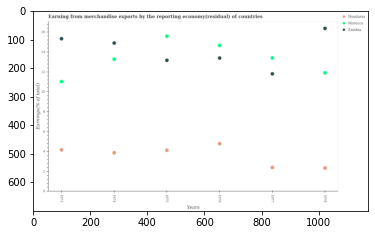

Number of QA =  28





,Years,Zambia,Honduras,Morocco
0,1977,11.801113,2.427902,13.400893
1,1973,15.326882,4.184598,11.032251
2,1974,14.888653,3.902638,13.272990
3,1976,13.387510,4.813673,14.655095
4,1978,16.352170,2.371677,11.908691
5,1975,13.166939,4.147836,15.572419


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in honduras in 1973 and that in 1976 ?
PREDICTED =  -0.6290747260174161
EXPECTED =  -0.6212557411774196




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in morocco in 1977 and the percentage of amount earned from merchandise exports in zambia in 1974?
PREDICTED =  0.12790274772384258
EXPECTED =  -1.4960292014089998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the percentage of amount earned from merchandise exports

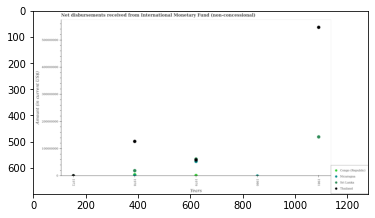

Number of QA =  27





,Years,Nicaragua,Congo (Republic),Sri Lanka,Thailand
0,1980,1.387543e+06,NaN,NaN,NaN
1,1978,4.769856e+06,NaN,2.047114e+07,1.285780e+08
2,1979,5.489206e+07,3.109540e+06,NaN,6.313634e+07
3,1972,NaN,NaN,NaN,2.048254e+06
4,1981,NaN,NaN,1.453815e+08,5.494750e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in thailand in 1972 and that in 1981 ?
PREDICTED =  -547426735.7438883
EXPECTED =  -546589000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in nicaragua in 1981 and the amount of disbursements received from international monetary fund in thailand in 1978?
PREDICTED =  3.0
EXPECTED =  -126765000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1979, what is the difference between the amount of disbursements received from intern

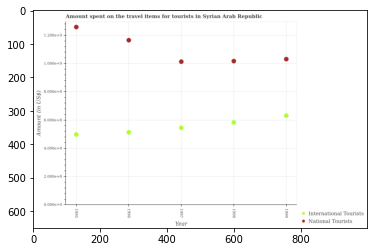

Number of QA =  27





,Year,International Tourists,National Tourists
0,1998,0.587911,1.022937
1,1999,0.636273,1.036570
2,1997,0.549770,1.019492
3,1995,0.503083,1.264909
4,1996,0.517768,1.171017


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists in 1995 and that in 1998 ?
PREDICTED =  -0.08482806164148138
EXPECTED =  -85000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of national tourists in 1998 and the amount spent on travel items of international tourists in 1995?
PREDICTED =  -0.6769982736237221
EXPECTED =  519000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the amount spent on travel items of international tourists and amount spent on travel items of national tou

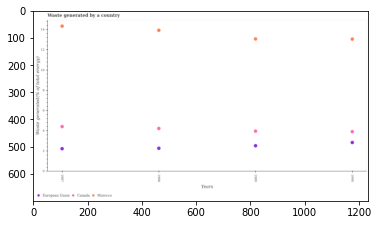

Number of QA =  28





,Years,European Union,Morocco,Canada
0,1990,2.889379,13.144608,3.971494
1,1987,2.275018,14.425869,4.466751
2,1989,2.572458,13.152105,4.022611
3,1988,2.319824,14.005833,4.280805


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total waste generated in morocco in 1988 and that in 1989 ?
PREDICTED =  0.8537281845198912
EXPECTED =  0.8543368334002999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total waste generated in morocco in 1988 and the total waste generated in canada in 1990?
PREDICTED =  0.861225403327655
EXPECTED =  10.01624133106973




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the total waste generated in morocco and total waste generated in european union ?
PREDICTED =  50.72841452218274
EXPECTED =  10.2182134003205




				 1 / 

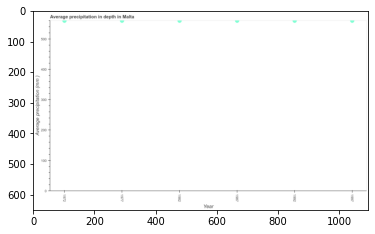

Number of QA =  24





,Year,Average precipitation (mm )
0,1992,562.962153
1,1977,562.840355
2,1972,562.483582
3,1987,563.145251
4,1982,563.126650
5,1997,563.211473


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average precipitation in depth in 1977 and 1982 ?
PREDICTED =  -0.28629423199322446
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median average precipitation in depth ?
PREDICTED =  563.2114728958587
EXPECTED =  560.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the average precipitation in depth in 1977 to that in 1992 ?
PREDICTED =  0.9997836487258823
EXPECTED =  1.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference b

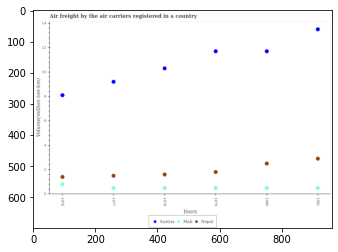

Number of QA =  28





,Years,Unnamed: 1,Austria,Nepal
0,1979,0.540294,11.789765,1.849812
1,1978,0.542218,10.375794,1.642997
2,1976,0.845747,8.165904,1.443358
3,1980,0.542983,11.784266,2.551538
4,1981,0.541522,13.587546,2.951398
5,1977,0.540553,9.278281,1.544002


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the volume of the air carriers in mali in 1976 and that in 1978 ?
PREDICTED =  0.3035289544223807
EXPECTED =  0.30000001190000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the volume of the air carriers in nepal in 1980 and the volume of the air carriers in mali in 1977?
PREDICTED =  1.0075364682894508
EXPECTED =  2.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the volume of the air carriers in austria and volume of the air carriers in mali ?
PREDICTED =  7.58754606831017
EXPECTED =  11.1999998093




				 1 / 3 = 0.33

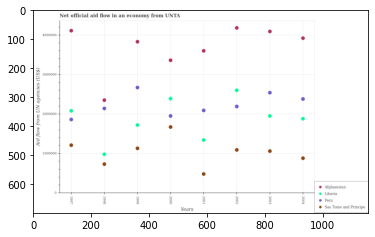

Number of QA =  29





,Years,Peru,Afghanistan,Sao Tome and Principe,Liberia
0,1998,2.153387e+06,2.364599e+06,7.433527e+05,9.949521e+05
1,2004,2.394110e+06,3.932119e+06,8.914351e+05,1.893291e+06
2,1997,1.874005e+06,4.122012e+06,1.220817e+06,2.091318e+06
3,2003,2.552435e+06,4.102684e+06,1.073951e+06,1.961687e+06
4,2001,2.101271e+06,3.613473e+06,4.920721e+05,1.353400e+06
5,1999,2.681928e+06,3.842142e+06,1.142167e+06,1.731935e+06
6,2000,1.961286e+06,3.373196e+06,1.681668e+06,2.400896e+06
7,2002,2.202660e+06,4.194604e+06,1.101526e+06,2.611506e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in peru in 1999 and that in 2003 ?
PREDICTED =  129492.87573831156
EXPECTED =  130000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in afghanistan in 1998 and the net official aid flow in sao tome and principe in 2000?
PREDICTED =  -1008597.0261161518
EXPECTED =  680000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the net official aid flow in sao tome and principe and net official aid flow in liberia ?
PREDICTED =  -58152.75355127326
EXPECTED =  -250000.0




				 1 / 

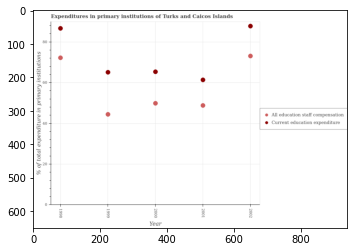

Number of QA =  27





,Year,All education staff compensation,Current education expenditure
0,2000,50.319748,65.868298
1,1998,72.688244,87.177305
2,1999,44.841394,65.533498
3,2001,49.253763,61.803031
4,2002,73.535327,88.330921


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in 1999 and that in 2002 ?
PREDICTED =  -22.797423784738072
EXPECTED =  -22.6697616577149




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in 2000 and the expenditure in education in 1998?
PREDICTED =  -22.36849600145576
EXPECTED =  -36.79867904296869




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the expenditure in staff compensation and expenditure in education ?
PREDICTED =  -12.536032532563468
EXPECTED =  -14.683334350585909




				 1 / 3 = 0.3333


is_built

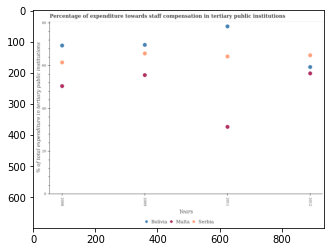

Number of QA =  28





,Years,Bolivia,Serbia,Malta
0,2008,69.858616,61.900416,50.769308
1,2009,70.109724,66.115536,55.960047
2,2012,59.733772,65.284326,56.740053
3,2011,78.807141,64.694149,31.669532


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in bolivia in 2011 and that in 2012 ?
PREDICTED =  19.07336959972129
EXPECTED =  18.9942398071289




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in serbia in 2012 and the percentage of expenditure towards staff compensation in bolivia in 2009?
PREDICTED =  -0.8312105975878836
EXPECTED =  -4.852256774902315




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of expenditure towards staff compensation in mal

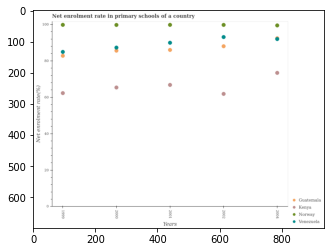

Number of QA =  29





,Years,Kenya,Norway,Venezuela,Guatemala
0,2004,73.700035,99.710183,92.434152,NaN
1,2001,67.094798,100.033755,90.201321,86.274024
2,2000,65.651300,99.961066,87.472674,85.795100
3,1999,62.592132,99.986991,85.173154,82.992802
4,2002,62.115817,99.999707,93.332779,88.268523


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate in primary schools in venezuela in 2001 and that in 2004 ?
PREDICTED =  -2.232831782526972
EXPECTED =  -2.037483215332003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate in primary schools in guatemala in 2002 and the net enrolment rate in primary schools in venezuela in 2001?
PREDICTED =  1.994498411117931
EXPECTED =  -1.9199676513671875




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the net enrolment rate in primary schools in norway and net enrolment rate in primary schools in ke

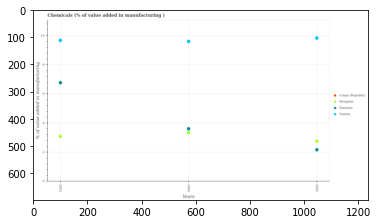

Number of QA =  28





,Years,Mongolia,Tanzania,Tunisia,Congo (Republic)
0,2004,3.363499,3.646081,9.660499,NaN
1,2003,3.118421,6.818178,9.732195,NaN
2,2005,2.789553,2.202028,9.895981,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing chemicals in tanzania in 2003 and that in 2005 ?
PREDICTED =  4.61615030533714
EXPECTED =  4.605092441928841




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing chemicals in tanzania in 2003 and the value added in manufacturing chemicals in tunisia in 2005?
PREDICTED =  4.61615030533714
EXPECTED =  -3.0623095237373494




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the value added in manufacturing chemicals in mongolia and value added in manufacturing chemicals in tan

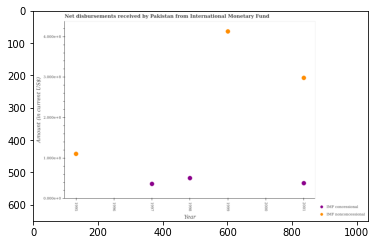

Number of QA =  25





,Year,IMF nonconcessional,IMF concessional
0,1999,4.161172,NaN
1,2000,NaN,NaN
2,1995,1.122889,NaN
3,1996,NaN,NaN
4,2001,3.007235,0.394678
5,1997,NaN,0.376692
6,1998,NaN,0.520472


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net non concessional disbursements from imf in 1999 and that in 2001 ?
PREDICTED =  1.1539373887656685
EXPECTED =  114780000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net non concessional disbursements from imf in 1999 and the net concessional disbursements from imf in 1998?
PREDICTED =  3.6407002614957413
EXPECTED =  362387000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the net non concessional disbursements from imf and net concessional disbursements from imf ?
PREDICTED =  0.0
EXPECTED =  260119000




				 

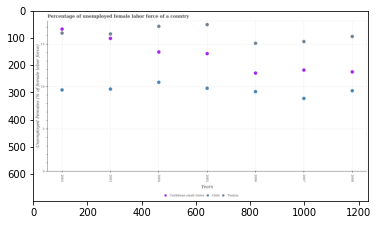

Number of QA =  28





,Years,Chile,Tunisia,Caribbean small states
0,2002,9.654820,16.378107,16.839503
1,2005,9.864976,17.377172,13.948732
2,2004,10.563901,17.164596,14.145602
3,2006,9.460196,15.161256,11.657171
4,2008,9.557352,15.969414,11.785624
5,2003,9.754704,16.269527,15.742099
6,2007,8.655470,15.377228,12.007986


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female labor force in caribbean small states in 2003 and that in 2007 ?
PREDICTED =  3.734112212727597
EXPECTED =  3.7339731332883996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female labor force in caribbean small states in 2007 and the percentage of unemployed female labor force in tunisia in 2008?
PREDICTED =  0.22236228335302144
EXPECTED =  -3.9619448504494006




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ..

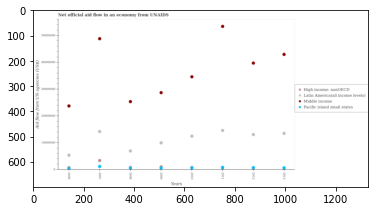

Number of QA =  29





,Years,Latin America(all income levels),Pacific island small states,High income: nonOECD,Middle income
0,2006,5.499015e+06,4.623221e+05,8.103208e+05,2.385357e+07
1,2011,1.472700e+07,8.961577e+05,NaN,5.354792e+07
2,2012,1.318373e+07,8.610654e+05,NaN,3.986192e+07
3,2008,7.104790e+06,7.708909e+05,NaN,2.548717e+07
4,2010,1.260005e+07,8.862304e+05,NaN,3.474646e+07
5,2013,1.366714e+07,7.451013e+05,NaN,4.309667e+07
6,2009,1.011354e+07,6.054056e+05,1.048052e+06,2.882116e+07
7,2007,1.429687e+07,1.287771e+06,3.532789e+06,4.894007e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in pacific island small states in 2006 and that in 2010 ?
PREDICTED =  -423908.25946790836
EXPECTED =  -240000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in high income: nonoecd in 2010 and the net official aid flow in middle income in 2009?
PREDICTED =  -28821164.98927993
EXPECTED =  -27880000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the net official aid flow in latin america(all income levels) and net official aid flow in pacific island small states ?
PREDICTED = 

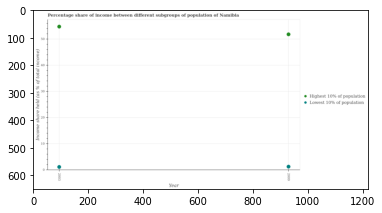

Number of QA =  23





,Year,Lowest 10% of population,Highest 10% of population
0,2003,1.317824,54.955865
1,2009,1.428523,52.035380


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 10% of the population in 2003 and that in 2009 ?
PREDICTED =  -50.717556232751754
EXPECTED =  2.9499999999999957




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 10% of the population in 2003 and the income share held by highest 10% of the population in 2009?
PREDICTED =  2.920484798611696
EXPECTED =  -50.690000000000005




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the income share held by highest 10% of the population and income share held by lowest 10% of the p

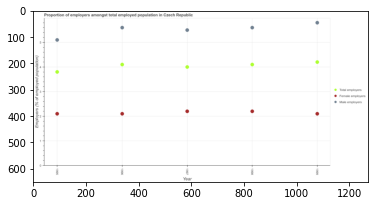

Number of QA =  28





,Year,Female employers,Total employers,Male employers
0,1999,2.122178,4.220704,5.819510
1,1996,2.121308,4.122644,5.615934
2,1998,2.221512,4.121122,5.618105
3,1997,2.219914,4.019438,5.518930
4,1995,2.118111,3.817425,5.115669


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total employers in 1998 and that in 1999 ?
PREDICTED =  -0.09958125194955247
EXPECTED =  -0.09999990463257102




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female employers in 1998 and the percentage of total employers in 1995?
PREDICTED =  0.1034016253640786
EXPECTED =  -1.5999999046325604




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of male employers and percentage of total employers ?
PREDICTED =  0.0
EXPECTED =  1.29999995231629




				 1 / 3 = 0.3333


is_built_with_c

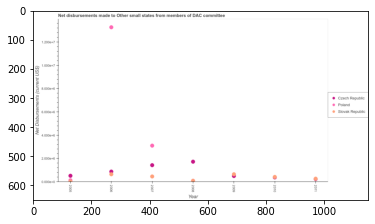

Number of QA =  27





,Year,Poland,Slovak Republic,Czech Republic
0,2007,0.314383,0.050933,0.146944
1,2009,0.069480,0.053578,NaN
2,2010,NaN,0.044550,NaN
3,2006,1.327570,0.068143,0.092943
4,2008,NaN,0.013518,0.176669
5,2005,NaN,0.017371,0.056925
6,2011,NaN,0.031357,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements made by czech republic in 2008 and that in 2010 ?
PREDICTED =  nan
EXPECTED =  1350000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements made by slovak republic in 2011 and the net disbursements made by czech republic in 2008?
PREDICTED =  0.017838998385921935
EXPECTED =  -1460000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net disbursements made by slovak

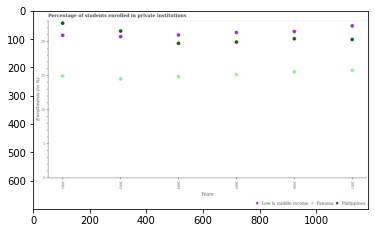

Number of QA =  28





,Years,Low & middle income,Philippines,Panama
0,2004,21.054982,19.828338,14.933701
1,2005,21.422462,20.025613,15.238948
2,2006,21.583040,20.506420,15.648432
3,2001,20.990353,22.794229,15.043806
4,2002,20.812732,21.631285,14.606119
5,2007,22.395837,20.385322,15.867470


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained teachers in panama in 2001 and that in 2005 ?
PREDICTED =  -0.19514150382988227
EXPECTED =  -0.19820022583010122




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained teachers in low & middle income in 2006 and the percentage of trained teachers in philippines in 2001?
PREDICTED =  0.5926875585198204
EXPECTED =  -1.2091693878174006




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the percentage of trained teachers in low & middle income and percentage of trained teachers in philippine

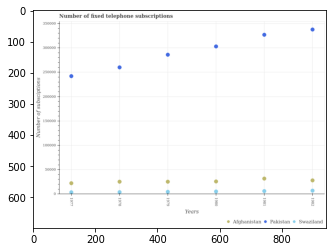

Number of QA =  28





,Years,Swaziland,Afghanistan,Pakistan
0,1978,4956.998449,26493.274594,261635.117174
1,1979,5541.975764,26395.107111,287669.046738
2,1980,6250.947936,26966.769935,304718.109902
3,1977,4488.332298,23365.737955,243533.285468
4,1981,7063.542428,32804.147513,328640.605197
5,1982,8092.863976,29182.195555,339537.920465


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in pakistan in 1979 and that in 1981 ?
PREDICTED =  -40971.55845963064
EXPECTED =  -40930




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in pakistan in 1981 and the number of fixed telephone subscriptions in swaziland in 1982?
PREDICTED =  -10897.315267922648
EXPECTED =  319991




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1982, what is the difference between the number of fixed telephone subscriptions in swaziland and number of fixed telephone subscriptions in pakistan ?
PRE

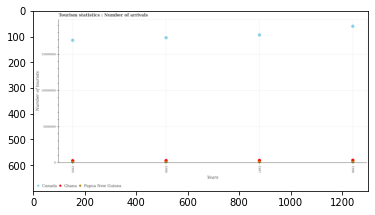

Number of QA =  28





,Years,Ghana,Papua New Guinea,Canada
0,1995,163298.306482,327837.037991,1.696997e+07
1,1996,366297.837157,164246.866797,1.731783e+07
2,1998,403509.498917,138650.984964,1.890046e+07
3,1997,391190.194348,156725.905220,1.770085e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist arrivals in ghana in 1996 and that in 1997 ?
PREDICTED =  -24892.357190351177
EXPECTED =  -20000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist arrivals in canada in 1998 and the number of tourist arrivals in papua new guinea in 1997?
PREDICTED =  1199604.5342054293
EXPECTED =  18804000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the number of tourist arrivals in papua new guinea and number of tourist arrivals in ghana ?
PREDICTED =  787456.7949730442
EXPECTED =  -244000.0




	

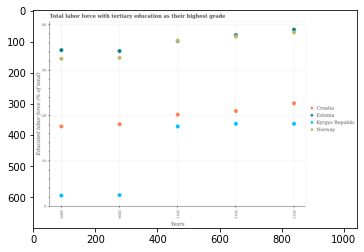

Number of QA =  29





,Years,Croatia,Norway,Estonia,Kyrgyz Republic
0,2012,21.098448,37.807281,37.461346,18.287672
1,2005,17.673227,32.594277,34.483043,2.504830
2,2006,18.203372,32.801656,34.286820,2.595573
3,2011,20.267732,36.505869,NaN,17.687914
4,2013,22.790944,38.381957,38.972731,18.265215


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with tertiary education in norway in 2005 and that in 2013 ?
PREDICTED =  -5.787680039162183
EXPECTED =  -5.799999237060497




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with tertiary education in estonia in 2013 and the percentage of male labor force with tertiary education in kyrgyz republic in 2005?
PREDICTED =  4.489687481215547
EXPECTED =  36.50000143051147




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of male labor force with tertiary 

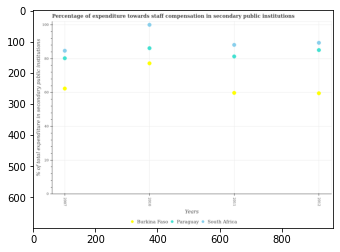

Number of QA =  28





,Years,South Africa,Burkina Faso,Paraguay
0,2010,100.063167,77.252724,86.193844
1,2007,84.669489,62.415077,80.251845
2,2012,89.386628,59.656191,85.147221
3,2011,88.142971,59.851863,81.319348


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in burkina faso in 2010 and that in 2012 ?
PREDICTED =  17.59653303580525
EXPECTED =  17.6838760375977




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in paraguay in 2012 and the percentage of expenditure towards staff compensation in south africa in 2007?
PREDICTED =  0.4777323449127522
EXPECTED =  0.3980789184570881




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of expenditure towards staff compensa

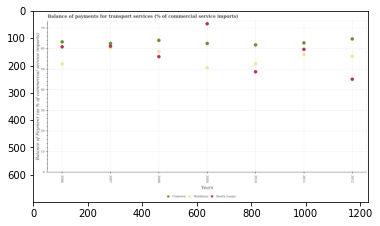

Number of QA =  28





,Years,Honduras,Comoros,Sierra Leone
0,2006,53.019114,63.730120,61.400402
1,2011,57.683429,63.310328,60.149644
2,2012,56.774075,65.235146,45.610774
3,2008,59.019242,64.536778,56.572206
4,2009,51.136080,62.994295,72.632893
5,2010,53.098019,62.316810,49.210043
6,2007,NaN,63.063748,61.620382


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in comoros in 2009 and that in 2011 ?
PREDICTED =  -0.31603322809498025
EXPECTED =  -0.27467496392439017




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in sierra leone in 2006 and the balance of payments for transport services in honduras in 2012?
PREDICTED =  4.6263265044668245
EXPECTED =  4.588139842055597




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the balance of payments for transport services in comoros and balance of payments

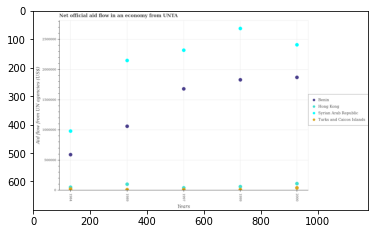

Number of QA =  29





,Years,Syrian Arab Republic,Turks and Caicos Islands,Hong Kong,Benin
0,2000,2.405087e+06,45701.419783,116145.744454,1.868359e+06
1,1984,9.804440e+05,53473.094153,25517.814748,5.929076e+05
2,1989,2.147760e+06,16474.707278,105937.755786,1.061063e+06
3,1999,2.674408e+06,17858.731661,64426.370963,1.828199e+06
4,1997,2.316146e+06,45686.608924,13537.987281,1.678478e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in benin in 1989 and that in 1999 ?
PREDICTED =  -767136.136125305
EXPECTED =  -770000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in syrian arab republic in 1989 and the net official aid flow in benin in 1999?
PREDICTED =  -526647.9245799459
EXPECTED =  320000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the net official aid flow in turks and caicos islands and net official aid flow in syrian arab republic ?
PREDICTED =  -2068930.0456199602
EXPECTED =  -960000.0





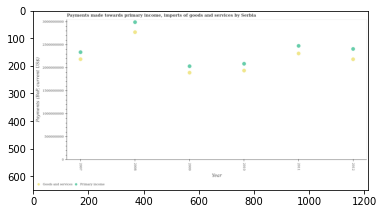

Number of QA =  27





,Year,Goods and services,Primary income
0,2012,2.198113e+10,2.420366e+10
1,2009,1.905862e+10,2.045749e+10
2,2008,2.787818e+10,3.004305e+10
3,2011,2.322458e+10,2.489163e+10
4,2007,2.198962e+10,2.351141e+10
5,2010,1.950942e+10,2.099276e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the payments made towards goods and services in 2007 and that in 2012 ?
PREDICTED =  2966053091.4850464
EXPECTED =  14002271




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the payments made towards primary income in 2012 and the payments made towards goods and services in 2008?
PREDICTED =  -5839385391.667679
EXPECTED =  -3646295474




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the payments made towards primary income and payments made towards goods and services ?
PREDICTED =  144100005921.0982
EXPECTED =  1525954318




				

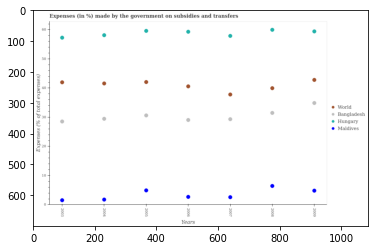

Number of QA =  29





,Years,Maldives,World,Bangladesh,Hungary
0,2009,4.955355,42.783629,34.872366,59.340401
1,2008,6.554488,39.928863,31.479730,59.884578
2,2005,5.052292,42.020107,30.648283,59.487115
3,2004,1.913397,41.520477,29.508795,58.022594
4,2006,2.833368,40.567973,29.085914,59.202393
5,2003,1.694251,41.900369,28.542737,57.182802
6,2007,2.726351,37.771891,29.377118,57.799942


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on subsidies and transfers in world in 2004 and that in 2008 ?
PREDICTED =  -41.520476779001534
EXPECTED =  1.6234848230773977




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of expenses made by the government on subsidies and transfers in maldives and percentage of expenses made by the government on subsidies and transfers in bangladesh ?
PREDICTED =  -3.675643247107865
EXPECTED =  -26.75406088051994




				 0 / 3 = 0.0


is_built_with_cuda: True
is_

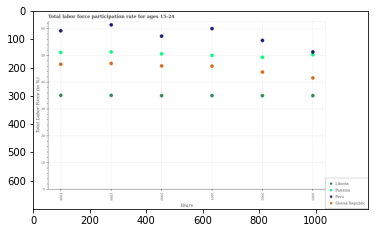

Number of QA =  29





,Years,Peru,Slovak Republic,Panama,Libenia
0,2001,59.976088,46.027976,50.019670,35.056396
1,2002,55.614149,43.841688,49.344654,35.050747
2,2003,51.284849,41.644809,50.288057,35.051041
3,1998,59.187931,46.742863,51.113543,35.163189
4,1999,61.373108,47.039316,51.314896,35.164940
5,2000,57.199750,46.130764,50.626709,35.062746


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in panama in 1999 and that in 2003 ?
PREDICTED =  1.0268391656183624
EXPECTED =  1.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in liberia in 2002 and the labor force participation rate in slovak republic in 2001?
PREDICTED =  9.586172920782317
EXPECTED =  -11.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the labor force participation rate in liberia and labor force participation rate in peru ?
PREDICTED =  -338.6358754398738
EXPECTED =  -24.100002288

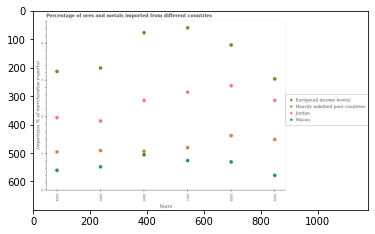

Number of QA =  29





,Years,Europe(all income levels),Macao,Heavily indebted poor countries,Jordan
0,2006,4.289056,0.975003,1.075199,2.452444
1,2009,3.033740,0.414639,1.391041,2.452770
2,2005,3.330046,0.648580,1.088787,1.891815
3,2004,3.236608,0.553110,1.051976,1.984624
4,2008,3.954751,0.780916,1.494273,2.849234
5,2007,4.422849,0.817005,1.166867,2.674641


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in heavily indebted poor countries in 2008 and that in 2009 ?
PREDICTED =  0.10323200201293892
EXPECTED =  0.10306681399629003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in jordan in 2008 and the percentage of imports to different countries in macao in 2007?
PREDICTED =  0.17459345701936568
EXPECTED =  2.038723850068364




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of imports to different countries in macao and

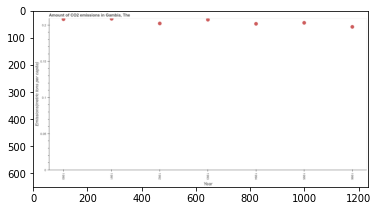

Number of QA =  24





,Year,Emissions(metric tons per capita)
0,1992,0.202627
1,1991,0.209088
2,1990,0.208594
3,1996,0.197926
4,1994,0.202063
5,1995,0.203454
6,1993,0.207725


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions in 1992 and 1995 ?
PREDICTED =  -0.0008269960113318486
EXPECTED =  -0.0008853060317750849




				 0 / 1 = 0.0


> what is the median amount of co2 emissions ?
PREDICTED =  None
EXPECTED =  0.203006157189424




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of co2 emissions in 1992 to that in 1994 ?
PREDICTED =  1.0027901693803778
EXPECTED =  1.0024157209296742




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest amount of co2 emissions ?
PREDICTED =  1990.7909123315221
EXPECTED =  0.00056

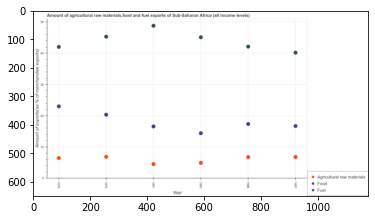

Number of QA =  28





,Year,Fuel,Agricultural raw materials,Food
0,1979,45.591967,6.999947,20.526150
1,1978,42.333905,6.614426,23.195469
2,1981,49.094300,4.659109,16.749932
3,1983,45.371529,5.056456,14.580648
4,1997,40.447010,6.972684,16.881273
5,1996,42.382785,6.922626,17.552190


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel exports in 1981 and that in 1996 ?
PREDICTED =  6.711514899820912
EXPECTED =  6.691183631476299




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of raw materials exports in 1981 and the percentage of fuel exports in 1996?
PREDICTED =  -37.72367604848969
EXPECTED =  -37.631618135099075




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1983, what is the difference between the percentage of raw materials exports and percentage of fuel exports ?
PREDICTED =  6.999947430950552
EXPECTED =  -40.21681096193613




				 2 / 3 = 0.6667


is

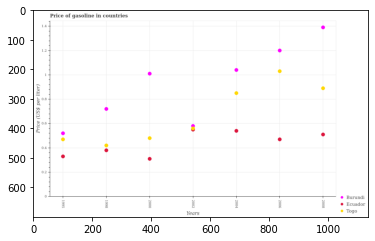

Number of QA =  28





,Years,Togo,Ecuador,Burundi
0,1998,0.420889,0.380817,0.718632
1,2004,0.848040,0.540028,1.036569
2,2006,1.026396,0.470336,1.194854
3,2008,0.887490,0.510388,1.383561
4,2002,0.551685,NaN,0.580114
5,1995,0.471588,0.331035,0.519972
6,2000,0.480896,0.311811,1.006551


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of gasoline in ecuador in 2006 and that in 2008 ?
PREDICTED =  -0.04005257347771296
EXPECTED =  -0.040000000000000036




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of gasoline in togo in 2006 and the price of gasoline in ecuador in 2008?
PREDICTED =  0.13890673519784213
EXPECTED =  0.52




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the price of gasoline in ecuador and price of gasoline in togo ?
PREDICTED =  -0.48636794466608124
EXPECTED =  -0.56




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_a

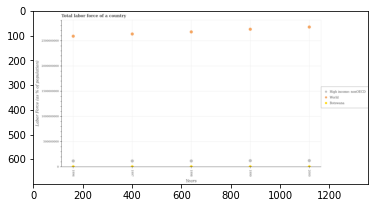

Number of QA =  28





,Years,Botswana,World,High income: nonOECL
0,2000,1.154267e+07,2.779162e+09,1.330061e+08
1,1997,1.203331e+07,2.640692e+09,1.255236e+08
2,1999,9.366329e+06,2.734729e+09,1.322433e+08
3,1996,1.057723e+07,2.598748e+09,1.273767e+08
4,1998,1.186344e+07,2.681899e+09,1.270656e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force in world in 1996 and that in 1997 ?
PREDICTED =  -41944061.611418724
EXPECTED =  -43663660




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force in world in 1997 and the percentage of labor force in high income: nonoecd in 1996?
PREDICTED =  41944061.611418724
EXPECTED =  2517044077




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of labor force in world and percentage of labor force in botswana ?
PREDICTED =  13424153704.118227
EXPECTED =  2728704615




				 1

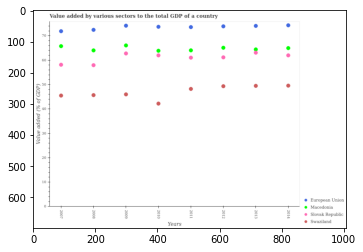

Number of QA =  29





,Years,Swaziland,European Union,Macedonia,Slovak Republic
0,2014,49.334982,73.787799,64.564429,61.636166
1,2012,49.096930,73.407217,64.739715,60.796232
2,2007,45.275859,71.410406,65.345248,57.797889
3,2011,48.000620,73.097409,63.650141,60.661499
4,2013,49.248116,73.573875,64.067605,62.700570
5,2008,45.461870,71.987561,63.619254,57.636409
6,2010,42.035070,73.220698,63.497688,61.626915
7,2009,45.766146,73.666622,65.656191,62.405159


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by various sectors to the total gdp in slovak republic in 2008 and that in 2010 ?
PREDICTED =  53.80738287149995
EXPECTED =  -4.031927466806216




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the value added by various sectors to the total gdp in slovak republic and value added by various sectors to the total gdp in swaziland ?
PREDICTED =  419.6244290888425
EXPECTED =  12.6458825633174




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluat

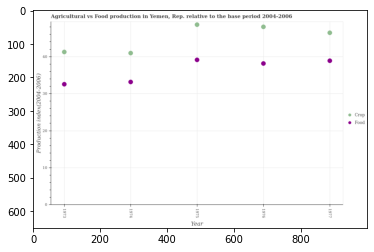

Number of QA =  27





,Year,Unnamed: 1,Food
0,1975,49.006301,39.476592
1,1977,46.821851,39.272829
2,1974,41.325480,33.459921
3,1973,41.601852,32.867207
4,1976,48.449504,38.488102


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the crop production index in 1973 and that in 1975 ?
PREDICTED =  -6.609385081360692
EXPECTED =  -7.369999999999997




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the crop production index in 1977 and the food production index in 1973?
PREDICTED =  6.405622037148909
EXPECTED =  13.89




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1977, what is the difference between the food production index and crop production index ?
PREDICTED =  0.0
EXPECTED =  -7.550000000000004




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predi

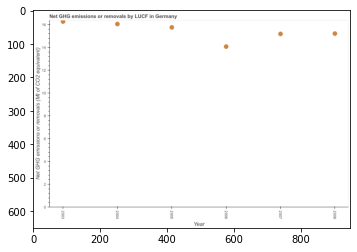

Number of QA =  24





,Year,Net GHG emissions or removals (Mt of CO2 equivalent)
0,2006,14.079439
1,2004,16.038292
2,2007,15.177005
3,2008,15.208462
4,2003,16.258283
5,2005,15.746776


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ghg net emissions or removals in 2005 and 2006 ?
PREDICTED =  1.6673378300460655
EXPECTED =  1.686251529236399




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median ghg net emissions or removals ?
PREDICTED =  15.477619218252904
EXPECTED =  15.48854864191665




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the ghg net emissions or removals in 2006 to that in 2008 ?
PREDICTED =  0.925763470867021
EXPECTED =  0.924947850164192




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 

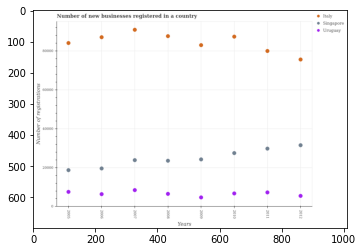

Number of QA =  28





,Years,Uruguay,Italy,Singapore
0,2011,7474.922591,80133.342254,29964.199079
1,2008,6732.268181,87746.418222,23758.946913
2,2005,7796.746173,84187.488962,18920.893385
3,2006,6590.696068,87170.322648,19812.612691
4,2010,6923.175511,87471.916936,27648.248118
5,2009,4900.656098,83134.740714,24457.391461
6,2007,8619.185302,91047.757737,24070.253751
7,2012,5702.276516,75733.900881,31722.467309


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of new businesses registered in singapore in 2007 and that in 2010 ?
PREDICTED =  -3577.9943668059714
EXPECTED =  -3633.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of new businesses registered in uruguay in 2005 and the number of new businesses registered in singapore in 2010?
PREDICTED =  873.5706623611231
EXPECTED =  -19957.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the number of new businesses registered in singapore and number of new businesses registered in uruguay ?
PREDICTED =  0.0
EXPEC

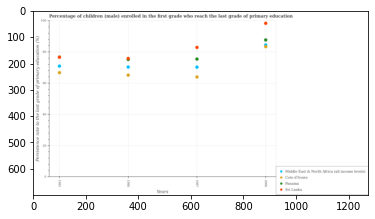

Number of QA =  29





,Years,Panama,Sri Lanka,Cote d'Ivoire,Middle East & North Africa (all income levels)
0,1986,NaN,75.931604,65.304308,70.531849
1,2006,87.862680,98.532964,84.622862,83.545649
2,1985,NaN,76.887177,66.933736,71.086818
3,1987,75.659074,83.115605,64.143222,70.529332


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of children in panama in 1986 and that in 1987 ?
PREDICTED =  -75.65907436620033
EXPECTED =  -0.2560399999999561




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of children in panama in 1985 and the persistence rate of children in cote d'ivoire in 1986?
PREDICTED =  0.0
EXPECTED =  11.583299999999994




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the persistence rate of children in panama and persistence rate of children in cote d'ivoire ?
PREDICTED =  75.65907436620033
EXPECTED =  4.25

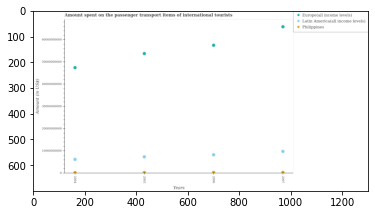

Number of QA =  28





,Years,Philippines,Europe(all income levels),Latin America(all income levels)
0,2005,4.592143e+08,5.395450e+10,7.541022e+09
1,2004,4.494843e+08,4.761070e+10,6.380901e+09
2,2006,5.035125e+08,5.771148e+10,8.467711e+09
3,2007,5.060896e+08,6.604179e+10,9.944596e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the passenger transport items of international tourists in philippines in 2005 and that in 2006 ?
PREDICTED =  -44298105.41202581
EXPECTED =  -53000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the passenger transport items of international tourists in philippines in 2006 and the amount spent on the passenger transport items of international tourists in europe(all income levels) in 2004?
PREDICTED =  -47107186221.90124
EXPECTED =  -47101818534.0791




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the differ

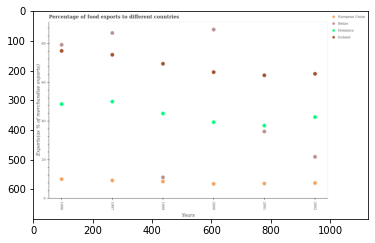

Number of QA =  29





,Years,Iceland,European Union,Belize,Dominica
0,1997,74.068790,9.524808,85.293856,50.071361
1,2001,63.546970,7.962039,34.672640,37.741112
2,1996,76.073420,10.171382,79.216124,48.738100
3,1999,69.474038,8.922076,11.120583,43.905540
4,2000,65.160612,7.801542,87.048921,39.426008
5,2002,64.309684,8.186523,21.670071,42.074929


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in belize in 2001 and that in 2002 ?
PREDICTED =  13.002569253243948
EXPECTED =  13.063514443676599




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in european union in 1997 and the percentage of exports to different countries in belize in 1999?
PREDICTED =  0.602732041725849
EXPECTED =  -1.58641534050577




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of exports to different countries in iceland and percentage of exp

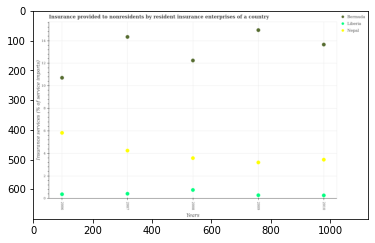

Number of QA =  28





,Years,Nepal,Liberia,Bermuda
0,2008,3.672929,0.808666,12.448370
1,2010,3.535478,0.323324,13.880014
2,2009,3.287679,0.331905,15.173332
3,2006,5.939479,0.418989,10.888355
4,2007,4.347220,0.473756,14.560585


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to nonresidents in liberia in 2007 and that in 2010 ?
PREDICTED =  0.1504327306467183
EXPECTED =  0.14823232743486298




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to nonresidents in liberia in 2010 and the insurance provided to nonresidents in bermuda in 2007?
PREDICTED =  -14.237261655855363
EXPECTED =  -14.065289214920632




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wha

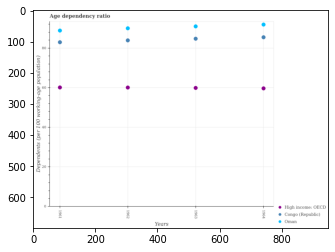

Number of QA =  28





,Years,Oman,High income: OECD,Congo (Republic)
0,1963,91.349435,60.197826,85.057141
1,1962,90.344915,60.382738,84.231272
2,1961,89.207896,60.447692,83.320126
3,1964,92.237825,60.030951,85.835026


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio in in congo (republic) in 1963 ?
PREDICTED =  0.04334121850545208
EXPECTED =  84.7297121995515




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio in in high income: oecd ?
PREDICTED =  0.999235668789809
EXPECTED =  60.1119010675985




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio in in high income: oecd ?
PREDICTED =  1.000764331210191
EXPECTED =  59.6439018141069




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished aft

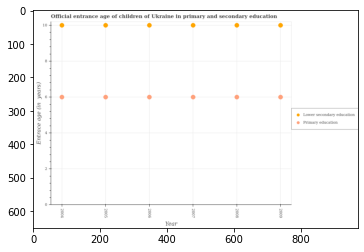

Number of QA =  27





,Year,Primary education,Lower secondary education
0,2005,6.032484,10.037759
1,2004,6.035262,10.045653
2,2008,6.030619,10.035146
3,2009,6.030737,10.037568
4,2006,6.031443,10.035007
5,2007,6.030358,10.036638


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of chiildren in primary education in 2007 and that in 2009 ?
PREDICTED =  -0.0003794546153024214
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of chiildren in primary education in 2008 and the entrance age of children in lower secondary education in 2009?
PREDICTED =  -0.00011854390425458661
EXPECTED =  -4




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the entrance age of children in lower secondary education and entrance age of chiildren in primary education ?
PREDICTED =  10.0

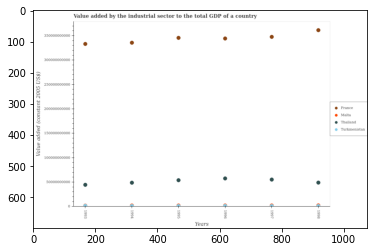

Number of QA =  29





,Years,Malta,France,Thailand,Turkmenistan
0,1996,NaN,3.465737e+11,5.890092e+10,2.857797e+09
1,1994,NaN,3.378239e+11,5.011133e+10,3.033566e+09
2,1993,NaN,3.353582e+11,4.564488e+10,2.593284e+09
3,1998,NaN,3.636805e+11,5.023411e+10,2.916445e+09
4,1995,NaN,3.479205e+11,5.523913e+10,2.596391e+09
5,1997,NaN,3.499998e+11,5.658235e+10,3.019690e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in malta in 1996 and that in 1997 ?
PREDICTED =  -3426089452.9141846
EXPECTED =  -6619560.500420094




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in turkmenistan in 1997 and the value added by the industrial sector in thailand in 1996?
PREDICTED =  161893346.99251366
EXPECTED =  -56619192278.327126




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.






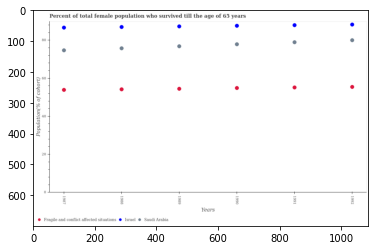

Number of QA =  28





,Years,Fragile and conflict affected situations,Israel,Saudi Arabia
0,1988,54.119802,86.707957,75.578602
1,1989,54.418731,87.036011,76.617947
2,1992,55.383026,87.966891,79.829610
3,1991,55.082029,87.638953,78.733468
4,1987,53.802090,86.379209,74.512188
5,1990,54.810864,87.326871,77.699272


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total female population who survived till the age of 65 years in fragile and conflict affected situations in 1989 and that in 1990 ?
PREDICTED =  -49.418730542241036
EXPECTED =  -0.40856630819738626




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total female population who survived till the age of 65 years in saudi arabia in 1992 and the percentage of total female population who survived till the age of 65 years in israel in 1989?
PREDICTED =  -7.206401421958461
EXPECTED =  -7.2694800000000015




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





>

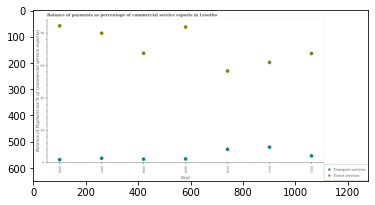

Number of QA =  27





,Year,Transport services,Travel services
0,2007,3.074078,79.853437
1,2012,4.540323,67.337637
2,2006,2.278940,84.316980
3,2011,9.870731,61.872250
4,2008,2.498594,67.574841
5,2009,2.689394,83.657588
6,2010,8.534052,56.627306


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2010 and that in 2012 ?
PREDICTED =  -10.71033180889556
EXPECTED =  -10.758156156299115




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2011 and the balance of payments of transport services in 2007?
PREDICTED =  -17.98118648355669
EXPECTED =  59.09418834397271




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the balance of payments of transport services and balance of payments of travel services ?
PREDICTED =  1.3366796781761643
EXPECTED 

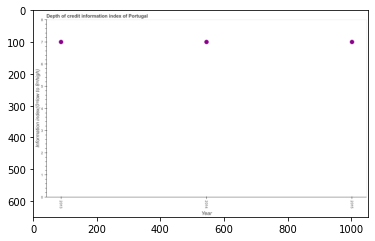

Number of QA =  24





,Year,Information index(O0=low to 8=high)
0,2015,6.945591
1,2013,6.948011
2,2014,6.946634


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the depth of credit information index in 2013 and 2014 ?
PREDICTED =  0.0013777396882010962
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median depth of credit information index ?
PREDICTED =  6.946633590037781
EXPECTED =  7.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the depth of credit information index in 2014 to that in 2015 ?
PREDICTED =  1.0001501506305568
EXPECTED =  1.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the diff

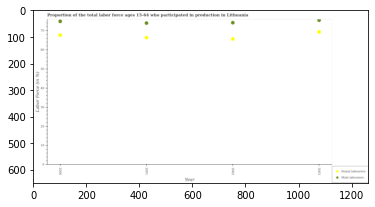

Number of QA =  27





,Year,Femal labourers,Male labourers
0,2003,69.454593,75.533234
1,2002,65.751876,74.232779
2,2001,66.417158,74.016510
3,2000,67.750363,74.925701


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in 2000 and that in 2001 ?
PREDICTED =  1.3332056934448104
EXPECTED =  1.299995422363196




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in 2003 and the percentage of female labor force in 2001?
PREDICTED =  1.51672460130753
EXPECTED =  9.099998474121108




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of male labour force and percentage of female labor force ?
PREDICTED =  0.0
EXPECTED =  6.099998474121108




				 1 / 3 = 0.3333


is_built_w

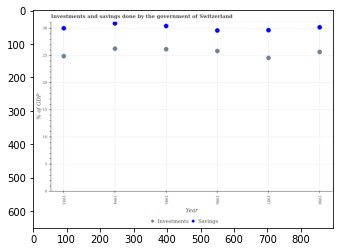

Number of QA =  27





,Year,Investments,Savings
0,1998,25.772499,30.308607
1,1994,26.378501,31.011766
2,1995,26.278585,30.548592
3,1993,25.011874,30.134487
4,1996,25.943859,29.728896
5,1997,24.677495,29.806394


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the savings of government in 1997 and that in 1998 ?
PREDICTED =  -0.5022125815533371
EXPECTED =  -0.5287236182666




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the savings of government in 1997 and the investments of government in 1994?
PREDICTED =  -1.2053721156030974
EXPECTED =  3.4018718552837015




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the investments of government and savings of government ?
PREDICTED =  127.68431208031562
EXPECTED =  -3.7725600470072003




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_avail

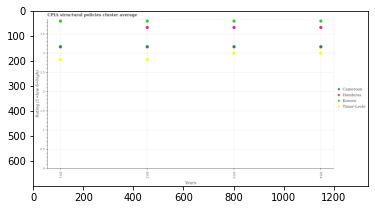

Number of QA =  29





,Years,Timor-Leste,Honduras,Kosovo,Cameroon
0,2014,3.030395,3.703949,3.872013,3.199875
1,2012,2.862707,3.703078,3.871878,3.199447
2,2011,2.863423,NaN,3.868587,3.200764
3,2013,3.029918,3.704431,3.872035,3.199956


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in kosovo in 2012 and that in 2014 ?
PREDICTED =  -0.0001350590225124293
EXPECTED =  3.3333333289142786e-06




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in timor-leste in 2013 and the cpia rating in kosovo in 2012?
PREDICTED =  0.16721143024881213
EXPECTED =  -0.833333333333329




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the cpia rating in cameroon and cpia rating in honduras ?
PREDICTED =  9.800042047932132
EXPECTED =  -0.5000033333333298




				 0 / 3 = 0.0


is_built_with_cuda: True
is_

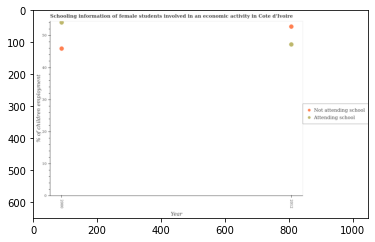

Number of QA =  23





,Year,Not attending school,Attending school
0,2012,52.640207,47.101418
1,2000,45.847607,53.919470


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed females who are not attending school in 2000 and that in 2012 ?
PREDICTED =  -6.792600540837967
EXPECTED =  -6.852479532735309




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed females who are attending school in 2012 and the percentage of employed females who are not attending school in 2000?
PREDICTED =  -6.818052495365514
EXPECTED =  1.2956686154646846




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finishe

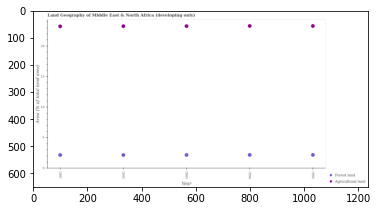

Number of QA =  27





,Year,Agricultural land,Forest land
0,1992,23.350814,2.230299
1,1993,23.342564,2.229852
2,1994,23.381811,2.237905
3,1995,23.378238,2.249206
4,1991,23.314365,2.223827


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under forests in 1991 and that in 1994 ?
PREDICTED =  -0.01407823284476617
EXPECTED =  -0.016784420614719853




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under agriculture in 1995 and the percentage of land area under forests in 1991?
PREDICTED =  0.06387279876127394
EXPECTED =  21.134333033456688




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of land area under agriculture and percentage of land area under forests ?
PREDICTED =  23.314365312236447
EXPECT

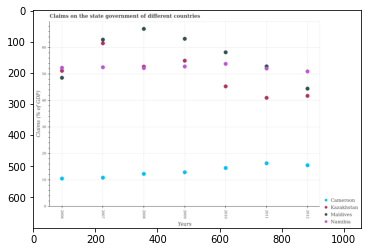

Number of QA =  29





,Years,Namibia,Maldives,Cameroon,Kazakhstan
0,2006,52.582306,48.857283,10.763221,51.456618
1,2012,51.204770,44.707419,15.787604,41.977911
2,2011,52.306731,53.142441,16.513332,41.225036
3,2008,52.566176,67.268570,12.529166,NaN
4,2009,53.105442,63.548397,13.133412,55.277620
5,2007,52.795482,63.247059,11.093111,61.848658
6,2010,54.068668,58.460138,14.736159,45.550436


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gdp claimed on the state government in cameroon in 2009 and that in 2011 ?
PREDICTED =  -3.3799201853947203
EXPECTED =  -3.3947192603387997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gdp claimed on the state government in kazakhstan in 2009 and the percentage of gdp claimed on the state government in cameroon in 2010?
PREDICTED =  9.727184003421058
EXPECTED =  40.501917756229986




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of gdp claimed on the state government in namibi

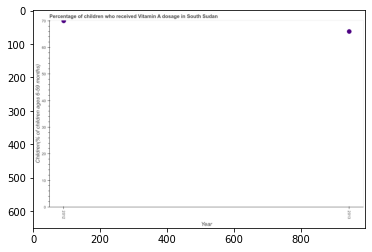

Number of QA =  20





,Year,Children(% of children ages 6-59 months)
0,2013,66.487756
1,2012,70.487476


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the vitamin a supplementation coverage rate in 2012 and 2013 ?
PREDICTED =  3.9997201168287546
EXPECTED =  4




				 1 / 1 = 1.0


> what is the median vitamin a supplementation coverage rate ?
PREDICTED =  None
EXPECTED =  68.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the vitamin a supplementation coverage rate in 2012 to that in 2013 ?
PREDICTED =  1.0601572431990653
EXPECTED =  1.0606060606060606




				 2 / 4 = 0.5


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Children(% of children ages 6-59 months)
EXPECTED =  10.0




				 2 / 5 = 0.4


> what is the title of the graph ?
PREDICTED =  Percentage of children who received Vitamin A d

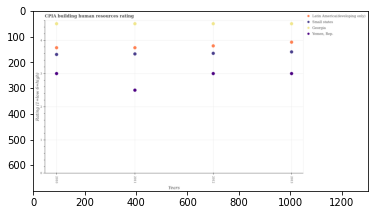

Number of QA =  29





,Years,Georgia,Latin America(developing only),"Yemen, Rep.",Small states
0,2013,4.525746,3.968256,3.021331,3.674112
1,2012,4.525085,3.858530,3.020210,3.631737
2,2011,4.526288,3.803132,2.520193,3.614428
3,2010,4.524504,3.801123,3.020712,3.598360


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in yemen, rep. in 2010 and that in 2012 ?
PREDICTED =  0.0005016341295682736
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in latin america(developing only) in 2012 and the cpia rating in yemen, rep. in 2010?
PREDICTED =  0.057407594721776256
EXPECTED =  0.833333333333329




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the cpia rating in latin america(developing only) and cpia rating in yemen, rep. ?
PREDICTED =  0.0
EXPECTED =  0.9444444444444402




				 0 / 3 = 0.0


is_built_

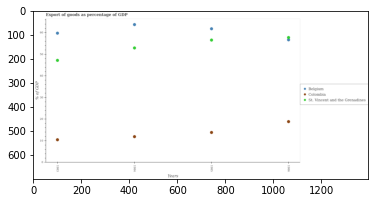

Number of QA =  28





,Years,Colombia,Belgium,St. Vincent and the Grenadines
0,1984,12.034430,63.727801,52.896470
1,1986,18.932801,56.650031,57.733217
2,1983,10.577593,59.718101,47.196447
3,1985,13.955136,61.755789,56.553993


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in colombia in 1984 and that in 1986 ?
PREDICTED =  -6.898370525655929
EXPECTED =  -6.961451509134502




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in colombia in 1984 and the export of goods as percentage of gdp in belgium in 1983?
PREDICTED =  -47.6836708128005
EXPECTED =  -47.88999460495829




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the export of goods as percentage of gdp in colombia and export of goods as percentage of gdp in st. vincen

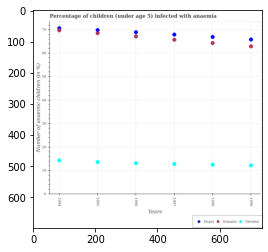

Number of QA =  28





,Years,Nepal,Somalia,Sweden
0,1996,69.276768,67.470224,13.356505
1,1998,67.276540,64.693729,12.781266
2,1999,66.209640,63.296223,12.467203
3,1994,71.044264,70.077849,14.512441
4,1997,68.303756,66.076933,13.017882
5,1995,70.264065,68.903958,13.836878


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children infected with anaemia in in somalia in 1994 and that in 1998 ?
PREDICTED =  5.38411987135116
EXPECTED =  5.400000000000006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children infected with anaemia in in somalia in 1994 and the percentage of children infected with anaemia in in sweden in 1999?
PREDICTED =  6.781625782979667
EXPECTED =  57.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of children infected with anaemia in in nepal and percentage of children infect

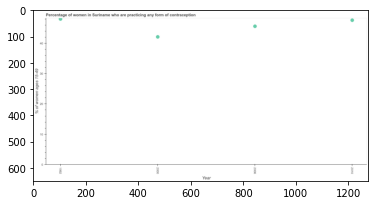

Number of QA =  24





,Year,% of women ages 15-49
0,2006,45.848353
1,2000,42.375758
2,2010,47.854315
3,1992,48.309211


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contraceptive prevalence in 2000 and 2006 ?
PREDICTED =  -3.4725954528159377
EXPECTED =  -3.5




				 1 / 1 = 1.0


> what is the median contraceptive prevalence ?
PREDICTED =  None
EXPECTED =  46.6




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the contraceptive prevalence in 1992 to that in 2006 ?
PREDICTED =  1.0536738533903196
EXPECTED =  1.0526315789473684




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest contraceptive prevalence ?
PREDICTED =  0.0
EXPECTED =  0.3999999999999986




				 2 / 5 = 0.4


is_built

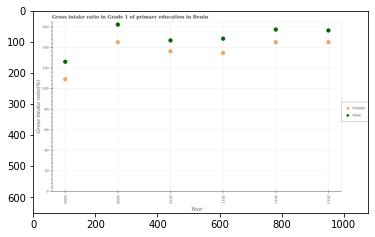

Number of QA =  27





,Year,Male,Female
0,2012,158.671137,146.381071
1,2008,163.481744,146.327173
2,2011,149.762496,135.883612
3,2013,157.699664,146.315171
4,2006,127.213995,110.169820
5,2010,147.950691,137.377491


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

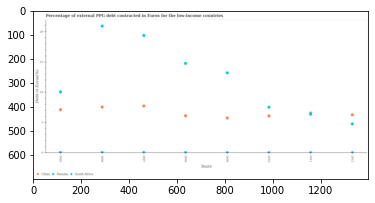

Number of QA =  28





,Years,Panama,South Africa,China
0,2011,0.069464,6.429208,6.583779
1,2008,0.105108,14.842370,6.187171
2,2007,0.103272,19.467388,7.805389
3,2010,0.096144,7.599113,6.165496
4,2006,0.118452,20.994985,7.637382
5,2009,0.082298,13.279942,5.819670
6,2012,0.068698,4.836456,6.357845
7,2005,0.089250,10.123515,7.206579


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of external ppg debt contracted in euros in south africa in 2005 and that in 2008 ?
PREDICTED =  -4.718855055679402
EXPECTED =  -4.704000000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of external ppg debt contracted in euros in china in 2006 and the percentage of external ppg debt contracted in euros in panama in 2009?
PREDICTED =  1.817711871840788
EXPECTED =  7.5438




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of external ppg debt contracted in euros in china and perce

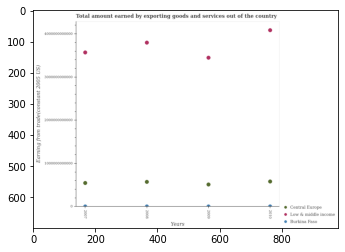

Number of QA =  28





,Years,Burkina Faso,Low & middle income,Central Europe
0,2008,1.657848e+10,3.791245e+12,5.794847e+11
1,2010,1.653267e+10,4.077585e+12,5.882296e+11
2,2007,1.612715e+10,3.564671e+12,5.533213e+11
3,2009,1.620190e+10,3.443937e+12,5.174969e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount earned by exporting goods and services in burkina faso in 2007 and that in 2010 ?
PREDICTED =  14860904923731.25
EXPECTED =  -772884052.8754549




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount earned by exporting goods and services in burkina faso in 2007 and the total amount earned by exporting goods and services in central europe in 2008?
PREDICTED =  14860859111078.914
EXPECTED =  -569446504230.2473




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the total amount earned by exporting goods and 

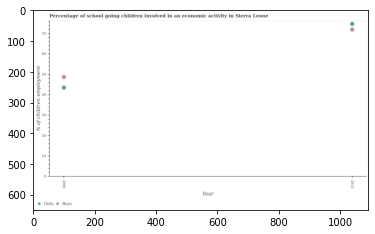

Number of QA =  23





,Year,Boys,Girls
0,2013,72.373063,75.175459
1,2000,49.068250,43.880288


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of school going girls in 2000 and that in 2013 ?
PREDICTED =  -31.295171738275663
EXPECTED =  -31.200000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of school going girls in 2013 and the percentage of school going boys in 2000?
PREDICTED =  31.295171738275663
EXPECTED =  26.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of school going girls and percentage of school going boys ?
PREDICTED =  75.17545939657248
EXPECTED =  -5.200000000000003




				 1 / 3 = 0.3333


is_

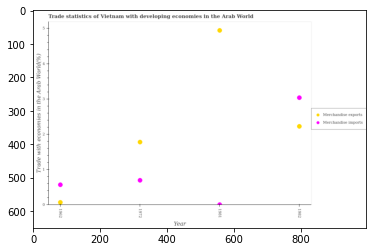

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,1972,0.706968,1.780603
1,1982,3.035531,2.225471
2,1962,0.584312,0.084305
3,1981,0.026182,4.928833


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1981 and that in 1982 ?
PREDICTED =  -3.0093494069054194
EXPECTED =  -3.0307808337335094




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1982 and the merchandise imports in 1981?
PREDICTED =  -2.703361725718924
EXPECTED =  2.2179569856823194




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the merchandise imports and merchandise exports ?
PREDICTED =  0.7807281151738064
EXPECTED =  -1.0829517691681971




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
G

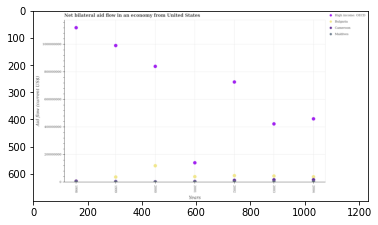

Number of QA =  28





,Years,High income: OECD,Bulgaria,Maldives,Cameroon
0,2002,7.297967e+08,5.023305e+07,4.878912e+06,1.596290e+07
1,2003,4.259290e+08,4.800182e+07,4.067572e+06,2.100124e+07
2,2004,4.627251e+08,4.252837e+07,4.051871e+06,2.045333e+07
3,1998,1.122883e+09,NaN,9.649908e+06,NaN
4,1999,9.935741e+08,3.949437e+07,7.385522e+06,NaN
5,2001,1.434899e+08,4.249660e+07,8.466927e+06,NaN
6,2000,8.430864e+08,1.224127e+08,5.905181e+06,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in cameroon in 2000 and that in 2002 ?
PREDICTED =  0.0
EXPECTED =  -10570000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in maldives in 1998 and the net bilateral aid flow in bulgaria in 2003?
PREDICTED =  5582335.607899473
EXPECTED =  -44620000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the net bilateral aid flow in bulgaria and net bilateral aid flow in high income: oecd ?
PREDICTED =  -4376317010.783021
EXPECTED =  -721060000.0




				 0 / 3 = 0.0


is_built

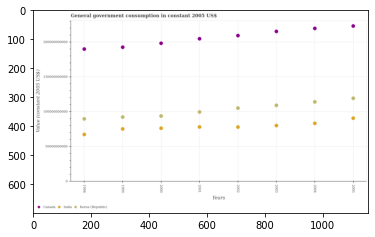

Number of QA =  28





,Years,Korea (Republic),Canada,India
0,2002,1.059539e+11,2.101574e+11,7.873026e+10
1,1999,9.309026e+10,1.935291e+11,7.600606e+10
2,2003,1.100028e+11,2.161500e+11,8.098058e+10
3,1998,9.045942e+10,1.907721e+11,6.794912e+10
4,2000,9.459293e+10,1.992599e+11,7.711700e+10
5,2001,1.004235e+11,2.057413e+11,7.883804e+10
6,2004,1.149037e+11,2.205277e+11,8.410162e+10
7,2005,1.201662e+11,2.240042e+11,9.153116e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in korea (republic) in 2003 and that in 2004 ?
PREDICTED =  -4900902683.41951
EXPECTED =  -4944546633.929001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in canada in 1998 and the government conusmption in india in 1999?
PREDICTED =  -2756974724.648102
EXPECTED =  114686696362.0861




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the government conusmption in india and government conusmption in korea (republic) ?
PREDICTED =  -52217073055.51317
EXPECTED =  -27263903052.0412

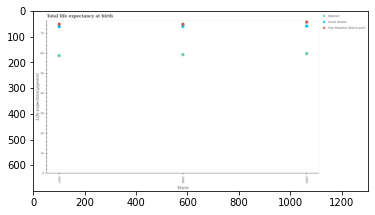

Number of QA =  28





,Years,Saudi Arabia,Sint Maarten (Dutch part},Djibouti
0,2008,73.436928,74.485370,59.338584
1,2009,73.515335,75.602460,59.869853
2,2007,73.313361,74.473606,58.856976


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in djibouti in 2008 and that in 2009 ?
PREDICTED =  -2.0
EXPECTED =  -0.5189268292683025




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in djibouti in 2007 and the life expectancy at birth in in saudi arabia in 2008?
PREDICTED =  1947.6614161294392
EXPECTED =  -14.616414634146402




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the life expec

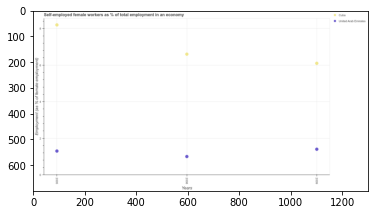

Number of QA =  27





,Years,United Arab Emirates,Cuba
0,2008,1.020817,6.595886
1,2005,1.318905,8.187529
2,2009,1.419536,6.094834


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in united arab emirates in 2005 and that in 2008 ?
PREDICTED =  0.298088171066591
EXPECTED =  0.29999995231627996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in united arab emirates in 2005 and the percentage of self-employed female workers in cuba in 2009?
PREDICTED =  -4.775929127310844
EXPECTED =  -4.799999952316291




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of self-employed female workers in cuba and percenta

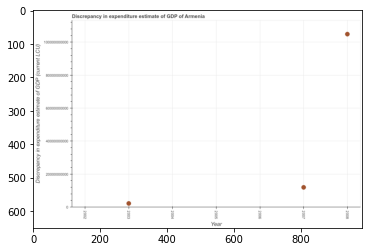

Number of QA =  20





,Year,Discrepancy in expenditure estimate of GDP (current LCU)
0,2005,NaN
1,2003,2.679234e+09
2,2008,1.046291e+11
3,2006,NaN
4,2004,NaN
5,2007,1.228739e+10
6,2002,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in 2003 and 2008 ?
PREDICTED =  -101949825678.68916
EXPECTED =  -102674000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median discrepancy in expenditure estimate of gdp ?
PREDICTED =  12287390051.930252
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the discrepancy in expenditure estimate of gdp in 2003 to that in 2007 ?
PREDICTED =  0.21804745606199
EXPECTED =  0.18227357398177668




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation f

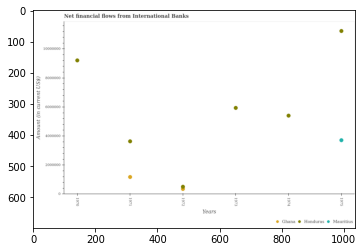

Number of QA =  25





,Years,Ghana,Honduras,Mauritius
0,1970,NaN,9.180572e+06,NaN
1,1974,NaN,5.402845e+06,NaN
2,1975,NaN,1.119057e+07,3.722353e+06
3,1971,1.203475e+06,3.649732e+06,NaN
4,1973,NaN,5.931967e+06,NaN
5,1972,5.369004e+05,3.915869e+05,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net financial aid flows in honduras in 1971 and that in 1972 ?
PREDICTED =  3258145.3837733264
EXPECTED =  3130000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net financial aid flows in honduras in 1971 and the net financial aid flows in mauritius in 1972?
PREDICTED =  3258145.3837733264
EXPECTED =  3632000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net financial aid flows in ghana in 1971 to that in 1972?
PREDICTED =  2.2415236384064774
EXPECTED =  3.3514285714285714




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available:

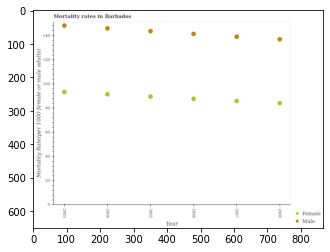

Number of QA =  27





,Year,Male,Female
0,2004,146.441232,91.923710
1,2008,137.554299,84.629814
2,2006,141.900837,88.213479
3,2003,148.841555,93.723582
4,2005,144.237646,90.087585
5,2007,139.689319,86.379893


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female mortality rate in 2004 and that in 2006 ?
PREDICTED =  3.710231307602072
EXPECTED =  3.695999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male mortality rate in 2003 and the female mortality rate in 2006?
PREDICTED =  6.940718436410975
EXPECTED =  60.59




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the male mortality rate and female mortality rate ?
PREDICTED =  52.92448559205614
EXPECTED =  53.68199999999999




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trainin

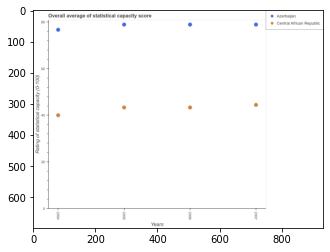

Number of QA =  27





,Years,Azerbaijan,Central African Republic
0,2004,76.774221,40.147730
1,2007,78.997841,44.637160
2,2005,78.997005,43.525080
3,2006,79.024285,43.531501


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in central african republic in 2004 and that in 2005 ?
PREDICTED =  -3.3773498162928988
EXPECTED =  -3.3333333333333




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in central african republic in 2004 and the rating of statistical capacity in azerbaijan in 2007?
PREDICTED =  -4.489429842496435
EXPECTED =  -38.8888888888889




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the rating of statistical capacity in azerbaijan and rating of statistical capacity in cent

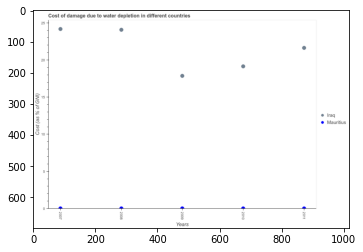

Number of QA =  27





,Years,lraq,Mauritius
0,2009,17.977503,0.111235
1,2008,24.196468,0.107788
2,2010,19.270406,0.106565
3,2007,24.296915,0.104344
4,2011,21.764818,0.102732


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to water depletion in iraq in 2009 and that in 2011 ?
PREDICTED =  -3.7873150671155535
EXPECTED =  -3.7674100909282977




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to water depletion in mauritius in 2011 and the cost of damage caused due to water depletion in iraq in 2008?
PREDICTED =  -0.0050561247640781015
EXPECTED =  -24.06164277178188




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the cost of damage caused due to water depletion in mauritius and cost of damage c

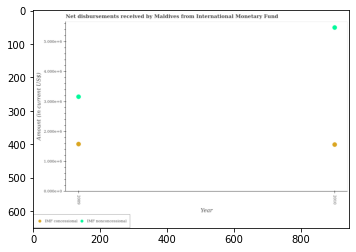

Number of QA =  23





,Year,IMF nonconcessional,IMF concessional
0,2009,3.193593,1.604872
1,2010,5.516308,1.596352


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net non concessional disbursements from imf in 2009 and that in 2010 ?
PREDICTED =  -2.322714938959649
EXPECTED =  -2311000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net non concessional disbursements from imf in 2010 and the net concessional disbursements from imf in 2009?
PREDICTED =  2.322714938959649
EXPECTED =  3892000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the net non concessional disbursements from imf and net concessional disbursements from imf ?
PREDICTED =  0.0
EXPECTED =  3909000




				 0 / 3 

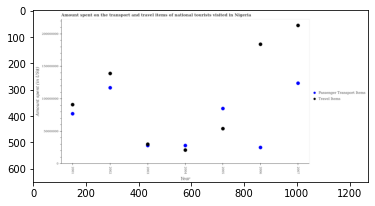

Number of QA =  27





,Year,Travel Items,Passenger Transport Items
0,2003,3.108280e+07,2.874535e+07
1,2001,9.228238e+07,7.811821e+07
2,2004,2.185100e+07,2.883728e+07
3,2002,1.406165e+08,1.183693e+08
4,2005,5.492446e+07,8.615653e+07
5,2007,2.148508e+08,1.253951e+08
6,2006,1.857173e+08,2.583313e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in travel items in 2003 and that in 2007 ?
PREDICTED =  -183767979.1653163
EXPECTED =  -183000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items in 2001 and the amount spent in travel items in 2004?
PREDICTED =  49280927.19107765
EXPECTED =  56000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount spent on passenger transport items and amount spent in travel items ?
PREDICTED =  0.0
EXPECTED =  -89000000




				 1 / 3 = 0.3333


is_built_with_cuda: True


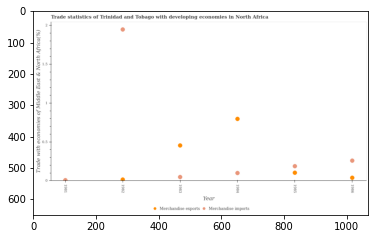

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,1983,0.054629,0.460199
1,1982,1.949664,0.021854
2,1984,0.105696,0.800127
3,1986,0.264392,0.046217
4,1985,0.193691,0.109900
5,1981,0.013461,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1982 and that in 1986 ?
PREDICTED =  1.6852722773838433
EXPECTED =  1.6884503517938019




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1981 and the merchandise imports in 1984?
PREDICTED =  nan
EXPECTED =  -0.09431671936965354




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the merchandise imports and merchandise exports ?
PREDICTED =  0.5113666728744581
EXPECTED =  -0.6968612631401755




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trainin

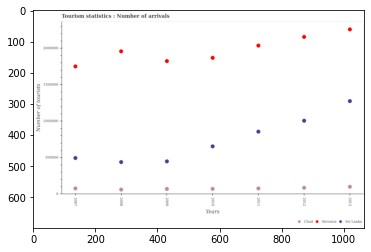

Number of QA =  28





,Years,Slovenia,Chad,Sri Lanka
0,2010,1.876541e+06,77118.109679,6.593567e+05
1,2009,1.830044e+06,76396.161899,4.543450e+05
2,2013,2.265062e+06,106372.581532,1.281004e+06
3,2008,1.963576e+06,67342.271529,4.435815e+05
4,2011,2.043006e+06,83321.382391,8.618197e+05
5,2012,2.163578e+06,92878.875358,1.011820e+06
6,2007,1.758640e+06,83936.635811,4.992178e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist arrivals in chad in 2010 and that in 2011 ?
PREDICTED =  -6203.272712545644
EXPECTED =  -6000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist arrivals in sri lanka in 2012 and the number of tourist arrivals in chad in 2010?
PREDICTED =  934702.3341478235
EXPECTED =  935000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the number of tourist arrivals in chad and number of tourist arrivals in sri lanka ?
PREDICTED =  106365.58153200187
EXPECTED =  -1175000.0




				 2 / 3 = 0.6667


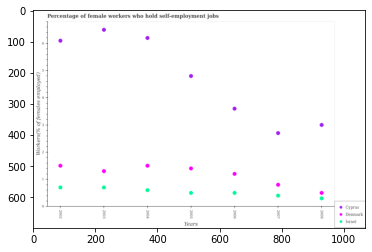

Number of QA =  28





,Years,Israel,Cyprus,Denmark
0,2004,0.617549,6.240116,1.522345
1,2002,0.720493,6.134934,1.520183
2,2008,0.320976,3.025967,0.520632
3,2006,0.518830,3.630594,1.219497
4,2005,0.518680,4.834956,1.422221
5,2003,0.719630,6.538037,1.322771
6,2007,0.420520,2.725533,0.818701


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in israel in 2002 and that in 2007 ?
PREDICTED =  0.2999735462623166
EXPECTED =  0.29999998211860707




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in cyprus in 2004 and the percentage of self-employed female workers in israel in 2005?
PREDICTED =  1.4051601933205653
EXPECTED =  5.699999809265139




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of self-employed female workers in denmark and percentage of self-employed fem

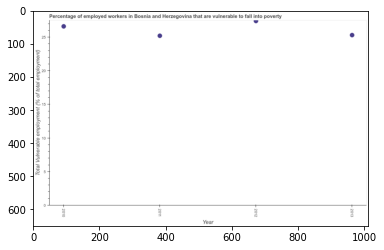

Number of QA =  24





,Year,Total Vulnerable employment (% of total employment)
0,2010,26.723855
1,2013,25.411870
2,2012,27.506345
3,2011,25.313693


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total vulnerable employment in 2010 and 2011 ?
PREDICTED =  1.4101617258645227
EXPECTED =  1.3999996185301917




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total vulnerable employment ?
PREDICTED =  27.5063445409882
EXPECTED =  25.949999809265094




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total vulnerable employment in 2011 to that in 2013 ?
PREDICTED =  0.9961365802301932
EXPECTED =  0.9960474910222716




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

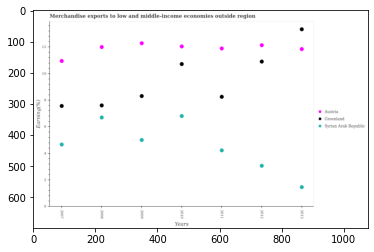

Number of QA =  28





,Years,Syrian Arab Republic,Austria,Greenland
0,2007,4.672766,10.913582,7.552014
1,2012,3.081491,12.093904,10.868508
2,2010,6.793165,12.004110,10.684622
3,2011,4.237170,11.846642,8.234012
4,2008,6.689205,11.954801,7.586004
5,2013,1.484615,11.805894,13.280004
6,2009,5.011509,12.237896,8.288144


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in austria in 2007 and that in 2010 ?
PREDICTED =  -1.0905277353240006
EXPECTED =  -1.094776145005401




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in austria in 2012 and the percentage of amount earned from merchandise exports in syrian arab republic in 2007?
PREDICTED =  1.1803222422814148
EXPECTED =  7.470899106212259




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of amount earned from merchandis

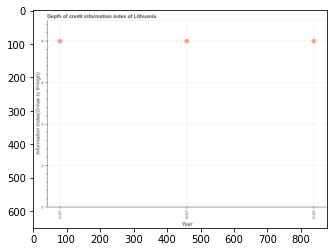

Number of QA =  24





,Year,Information index(O0=low to 8=high)
0,2013,8.010412
1,2014,8.009600
2,2015,8.004586


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the depth of credit information index in 2013 and 2015 ?
PREDICTED =  0.005826187387881987
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median depth of credit information index ?
PREDICTED =  8.009600081771914
EXPECTED =  8.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the depth of credit information index in 2013 to that in 2015 ?
PREDICTED =  1.0007278562175375
EXPECTED =  1.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the diffe

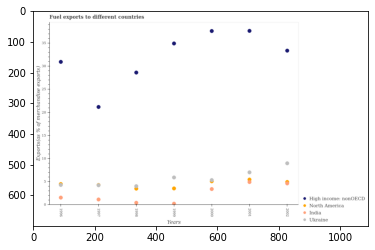

Number of QA =  29





,Years,North America,High income: nonOECD,Ukraine,India
0,1998,3.595471,28.760763,4.141854,0.534520
1,2000,NaN,37.753381,5.474996,3.520852
2,2002,5.071751,33.500263,9.084213,4.701288
3,1999,3.655337,35.083774,6.036215,0.320051
4,1996,NaN,31.064720,4.567834,1.648151
5,2001,5.568658,37.820870,7.125649,4.993858
6,1997,NaN,21.294392,4.364983,1.264709


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in india in 1998 and that in 2001 ?
PREDICTED =  -4.459337755313326
EXPECTED =  -4.485156443545103




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in high income: nonoecd in 1999 and the percentage of exports to different countries in north america in 1996?
PREDICTED =  5.353857265319768
EXPECTED =  30.433289195197567




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percentage of exports to different countries in india and percen

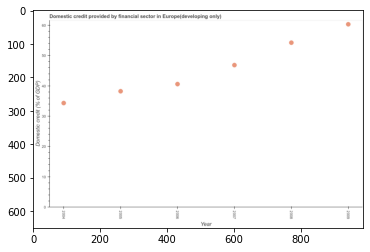

Number of QA =  24





,Year,Domestic credit (% of GDP)
0,2005,38.671358
1,2008,54.744481
2,2006,41.014614
3,2007,47.323934
4,2009,60.845584
5,2004,34.733195


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided by financial sector in 2005 and 2008 ?
PREDICTED =  -16.0731232905693
EXPECTED =  -16.030452488414916




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median domestic credit provided by financial sector ?
PREDICTED =  44.169273996643284
EXPECTED =  43.71263619561405




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the domestic credit provided by financial sector in 2006 to that in 2007 ?
PREDICTED =  0.8666780150833623
EXPECTED =  0.8661652795110115




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predict

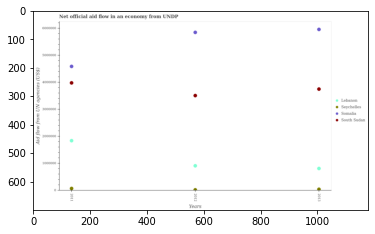

Number of QA =  29





,Years,Seychelles,South Sudan,Somalia,Lebanon
0,2012,37191.288983,3.521425e+06,5.859062e+06,9.254439e+05
1,2011,85196.048528,3.996047e+06,4.604071e+06,1.853055e+06
2,2013,57383.560830,3.763120e+06,5.970305e+06,8.269576e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in somalia in 2011 and that in 2012 ?
PREDICTED =  -1254991.075652441
EXPECTED =  -1260000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in seychelles in 2011 and the net official aid flow in lebanon in 2013?
PREDICTED =  27812.48769814834
EXPECTED =  -740000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the net official aid flow in south sudan and net official aid flow in somalia ?
PREDICTED =  5802778.33946341
EXPECTED =  -2340000.0




				 1 / 3 = 0.3333


is_built_

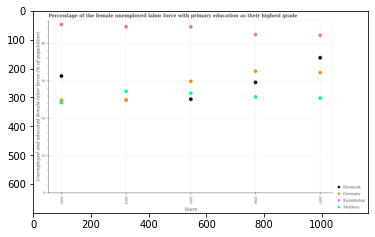

Number of QA =  29





,Years,Moldova,Germany,Denmark,Kazakhstan
0,2004,27.316299,24.997162,NaN,44.576142
1,2006,25.819679,32.691241,29.689895,42.484333
2,2005,26.800852,30.005643,25.204432,44.592065
3,2007,25.526438,32.289853,36.287521,42.279936
4,2003,24.342839,24.934871,31.385655,45.170812


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with primary education in kazakhstan in 2004 and that in 2006 ?
PREDICTED =  2.296205317198101
EXPECTED =  2.099998474121101




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with primary education in denmark in 2006 and the percentage of the unemployed female labor force with primary education in germany in 2003?
PREDICTED =  4.755024143804839
EXPECTED =  4.80000114440919




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the perc

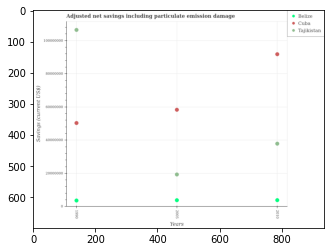

Number of QA =  28





,Years,Tajikistan,Cuba,Belize
0,2005,1.971368e+07,5.886488e+07,4.178648e+06
1,2010,3.838577e+07,9.250408e+07,4.184819e+06
2,1990,1.071685e+08,5.083836e+07,3.964594e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings in belize in 1990 and that in 2010 ?
PREDICTED =  -220225.48065230483
EXPECTED =  -220084.75167675037




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings in tajikistan in 2005 and the net savings in belize in 2010?
PREDICTED =  -18672089.29449644
EXPECTED =  15473832.047134332




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the net savings in tajikistan and net savings in belize ?
PREDICTED =  152939892.19493425
EXPECTED =  15508127.48910623




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_av

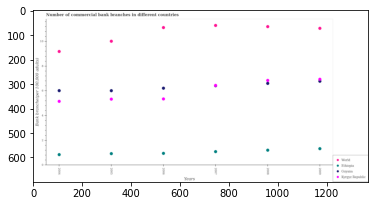

Number of QA =  29





,Years,Ethiopia,Kyrgyz Republic,World,Guyana
0,2009,1.355967,6.957152,11.076464,6.802745
1,2008,1.232875,6.860927,11.210877,6.625970
2,2005,0.957257,5.349020,10.024325,6.038789
3,2004,0.868826,5.172130,9.211982,6.036725
4,2006,0.976045,5.369732,11.138741,6.237846
5,2007,1.115737,6.451147,11.310272,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of commercial bank branches in guyana in 2004 and that in 2008 ?
PREDICTED =  -0.5892453439164953
EXPECTED =  -0.5871344682124304




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of commercial bank branches in kyrgyz republic in 2004 and the number of commercial bank branches in guyana in 2005?
PREDICTED =  1.1721300381156645
EXPECTED =  -0.8614929103507976




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the number of commercial bank branches in kyrgyz republic and number of commercial bank branches in world

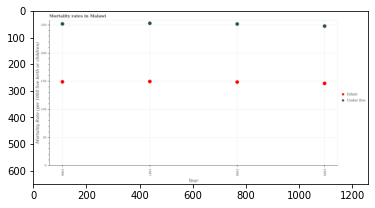

Number of QA =  27





,Year,Infant,Under five
0,1988,148.656540,251.443180
1,1986,149.128748,251.668486
2,1989,146.290328,247.781474
3,1987,149.663101,252.767815


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in 1987 and that in 1989 ?
PREDICTED =  3.3727739183136123
EXPECTED =  3.4000000000000057




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in 1987 and the under-5 mortality rate in 1986?
PREDICTED =  -102.0053849770625
EXPECTED =  -102.4




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1988, what is the difference between the under-5 mortality rate and infant mortality rate ?
PREDICTED =  0.0
EXPECTED =  103.20000000000002




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training o

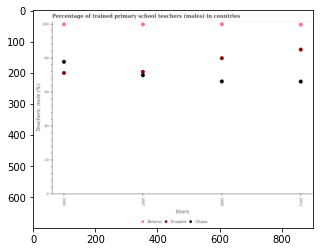

Number of QA =  28





,Years,Ghana,Ecuador,Belarus
0,2012,66.569503,85.421016,100.093701
1,2009,66.608902,80.366800,100.320198
2,2005,78.188262,71.590325,100.264221
3,2007,70.320544,72.318660,100.261344


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained primary school teachers (males) in ecuador in 2007 and that in 2009 ?
PREDICTED =  -8.048139785215696
EXPECTED =  -8.012268066406193




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained primary school teachers (males) in ecuador in 2005 and the percentage of trained primary school teachers (males) in ghana in 2012?
PREDICTED =  -13.830690936519886
EXPECTED =  5.047248840332088




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of trained primary school teachers (males) i

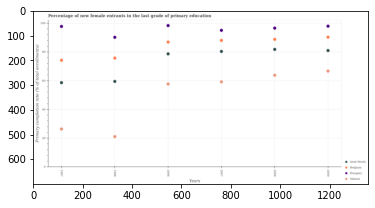

Number of QA =  29





,Years,Arab World,Hungary,Belgium,Malawi
0,1987,59.170696,98.310682,74.770683,26.687213
1,2006,79.253971,98.982601,87.481729,58.099343
2,2009,81.527482,98.570247,90.886923,67.202528
3,2008,82.367038,97.205651,89.366336,64.294533
4,1988,60.003272,90.754352,76.281548,21.431566
5,2007,80.991816,95.667029,88.654061,59.721761


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of new female entrants in malawi in 1988 and that in 2007 ?
PREDICTED =  -38.29019480221609
EXPECTED =  -38.1219491906738




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of new female entrants in arab world in 2006 and the percentage of new female entrants in malawi in 1988?
PREDICTED =  19.250699478466373
EXPECTED =  57.587155336914094




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of new female entrants in belgium and percentage of new female entrants in malawi ?
PREDICTED =  23.68

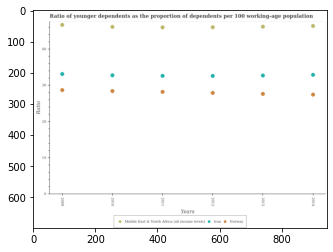

Number of QA =  28





,Years,Middle East & North Africa (all income levels),Iran,Norway
0,2012,46.299844,32.838187,28.100527
1,2010,46.382287,32.990646,28.628894
2,2009,46.919125,33.326027,28.874094
3,2011,46.267354,32.842563,28.401672
4,2014,46.656908,33.117172,27.656481
5,2013,46.446729,32.918606,27.826218


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio(young) in middle east & north africa (all income levels) in 2013 ?
PREDICTED =  7.741121521775195
EXPECTED =  46.18273349924629




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio(young) in middle east & north africa (all income levels) ?
PREDICTED =  7.776151335287246
EXPECTED =  46.675642275522




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio(young) in iran ?
PREDICTED =  335.3333333333333
EXPECTED =  32.59741744826




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs:

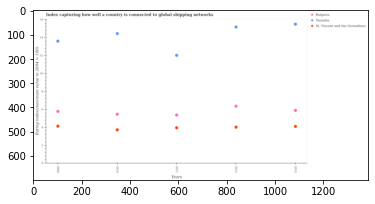

Number of QA =  28





,Years,Namibia,Bulgaria,St. Vincent and the Grenadines
0,2013,15.499710,5.920712,4.137239
1,2009,13.614040,5.796943,4.163639
2,2011,12.030383,5.399888,3.982261
3,2010,14.453336,5.493618,3.748631
4,2012,15.194766,6.392239,4.054810


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating index in namibia in 2010 and that in 2012 ?
PREDICTED =  -0.7414298172391298
EXPECTED =  -0.7300000000000004




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating index in namibia in 2011 and the rating index in st. vincent and the grenadines in 2012?
PREDICTED =  -3.1643828884287917
EXPECTED =  8.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rating index in bulgaria in 2009 to 

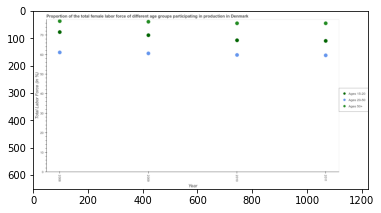

Number of QA =  28





,Year,Ages 20-50,Ages 15-20,Ages 50+
0,2008,60.851936,71.088579,76.620131
1,2009,60.319433,69.530808,76.415443
2,2010,59.519246,66.952661,75.590744
3,2011,59.320536,66.693302,75.578222


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force within the age group 20-50 in 2010 and that in 2011 ?
PREDICTED =  0.19870994287172294
EXPECTED =  0.20000076293939628




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force within the age group 20-50 in 2011 and the percentage of female labor force above age 50 in 2008?
PREDICTED =  -1949.6794640398732
EXPECTED =  -17.499999999999893




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of female labor force within the age group 15-20 and percentage of 

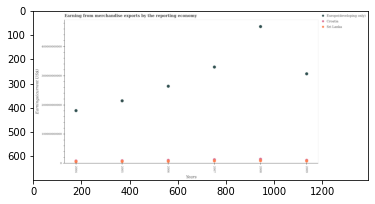

Number of QA =  28





,Years,Croatia,Sri Lanka,Europe(developing only)
0,2006,NaN,1.106979e+10,2.649747e+11
1,2004,NaN,8.139388e+09,1.816581e+11
2,2007,1.315773e+10,9.745835e+09,3.308632e+11
3,2005,NaN,8.920451e+09,2.151994e+11
4,2008,1.519834e+10,1.097895e+10,4.693834e+11
5,2009,NaN,1.028088e+10,3.076008e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in europe(developing only) in 2006 and that in 2007 ?
PREDICTED =  -65888506402.61087
EXPECTED =  -65695341035.26999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in europe(developing only) in 2006 and the amount earned from merchandise exports in sri lanka in 2007?
PREDICTED =  -65888506402.61087
EXPECTED =  255711617691.23




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the amount earned from merchandise exports in sri lanka and amount earn

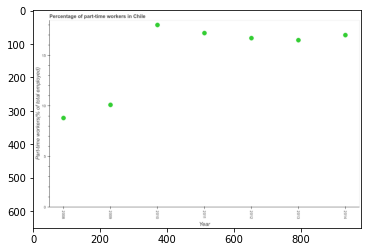

Number of QA =  24





,Year,Part-time workers(% of total employed)
0,2012,16.847436
1,2008,8.909385
2,2013,16.646773
3,2010,18.141289
4,2009,10.207711
5,2014,17.141668
6,2011,17.340721


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time workers in 2011 and 2012 ?
PREDICTED =  0.4932852078913825
EXPECTED =  0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time workers ?
PREDICTED =  2011.0
EXPECTED =  16.7000007629395




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of part-time workers in 2011 to that in 2012 ?
PREDICTED =  1.0292795423770278
EXPECTED =  1.0299401183926646




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what i

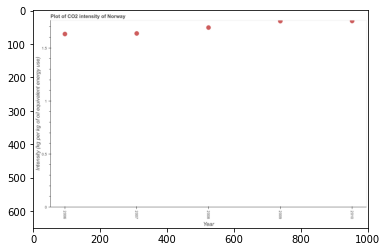

Number of QA =  24





,Year,Intensity (kg per kg of oil equivalent energy use)
0,2008,1.705445
1,2006,1.643955
2,2007,1.650267
3,2009,1.766477
4,2010,1.766913


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 intensity in 2006 and 2007 ?
PREDICTED =  -0.0063119404071414476
EXPECTED =  -0.005440366098319993




				 0 / 1 = 0.0


> what is the median co2 intensity ?
PREDICTED =  None
EXPECTED =  1.69227363663463




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the co2 intensity in 2007 to that in 2008 ?
PREDICTED =  0.9676458920441959
EXPECTED =  0.9672199536012881




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest co2 intensity ?
PREDICTED =  0.0
EXPECTED =  0.0013158826832000425




				 1 / 5 = 0.2


is_built_with_cuda:

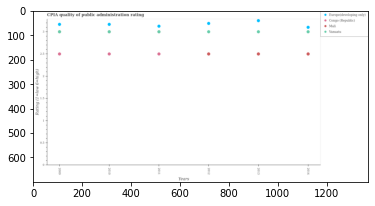

Number of QA =  29





,Years,Vanuatu,Congo (Republic),Mali,Europe(developing only)
0,2009,3.018221,2.515462,NaN,3.185035
1,2012,3.018224,NaN,2.516690,3.206800
2,2013,3.017795,NaN,2.517835,3.269201
3,2010,3.017715,2.517332,NaN,3.184411
4,2014,3.017780,NaN,2.516798,3.118947
5,2011,3.018758,2.517361,NaN,3.145531


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in europe(developing only) in 2009 and that in 2010 ?
PREDICTED =  0.0006237918439455648
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the cpia rating in europe(developing only) and cpia rating in mali ?
PREDICTED =  3.0
EXPECTED =  0.125




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in europe(developing only) in 2011 to that in 2014?
P

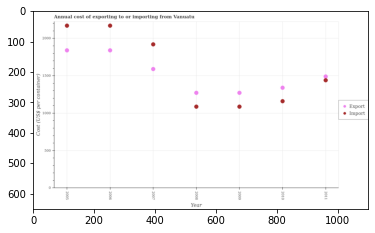

Number of QA =  27





,Year,Import,Export
0,2008,1091.142900,1276.538307
1,2011,1444.543777,1496.590204
2,2007,1923.550066,1594.408527
3,2009,1091.694136,1276.782342
4,2005,2171.494867,1844.517360
5,2006,2172.793403,1843.983466
6,2010,1165.238121,1344.311716


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export cost in 2006 and that in 2008 ?
PREDICTED =  567.4451594809166
EXPECTED =  568




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export cost in 2006 and the import cost in 2009?
PREDICTED =  567.201123940953
EXPECTED =  753




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the import cost and export cost ?
PREDICTED =  0.0
EXPECTED =  330




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of 

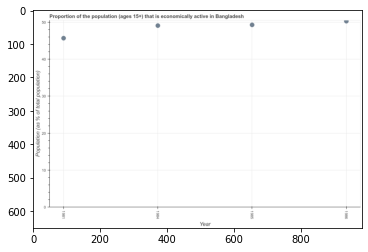

Number of QA =  24





,Year,Population (as % of total population)
0,1984,49.391163
1,1985,49.614092
2,1981,45.987124
3,1986,50.581952


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active population in 1981 and 1986 ?
PREDICTED =  -4.5948276049806225
EXPECTED =  -4.599998474120994




				 1 / 1 = 1.0


> what is the median percentage of economically active population ?
PREDICTED =  None
EXPECTED =  49.1999988555908




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of economically active population in 1981 to that in 1986 ?
PREDICTED =  0.9091607291501077
EXPECTED =  0.9085487367019329




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest percentage of econom

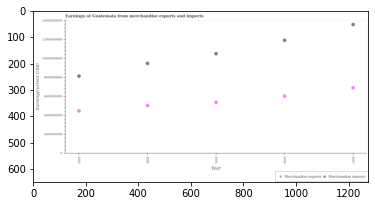

Number of QA =  27





,Year,Merchandise imports,Merchandise exports
0,2005,1.057836e+10,5.438162e+09
1,2006,1.199110e+10,6.087709e+09
2,2003,8.196774e+09,4.515642e+09
3,2007,1.365730e+10,6.966025e+09
4,2004,9.542307e+09,5.099646e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 2006 and that in 2007 ?
PREDICTED =  -878316821.5377913
EXPECTED =  -872537000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 2007 and the earnings from merchandise imports in 2006?
PREDICTED =  878316821.5377913
EXPECTED =  -5016800000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the earnings from merchandise imports

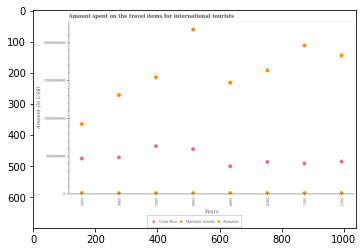

Number of QA =  28





,Years,Marshall Islands,Romania,Costa Rica
0,2012,1.936323e+07,1.844505e+09,4.369866e+08
1,2006,1.701771e+07,1.320106e+09,4.928524e+08
2,2005,1.883562e+07,9.327611e+08,4.773918e+08
3,2008,1.741336e+07,2.188194e+09,6.010608e+08
4,2010,1.736294e+07,1.646402e+09,4.318806e+08
5,2009,1.835616e+07,1.481726e+09,3.744981e+08
6,2007,1.699994e+07,1.554130e+09,6.422738e+08
7,2011,1.887394e+07,1.977759e+09,4.127989e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items for international tourists in marshall islands in 2007 and that in 2010 ?
PREDICTED =  -363001.55778715387
EXPECTED =  310000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items for international tourists in costa rica in 2011 and the amount spent on the travel items for international tourists in marshall islands in 2008?
PREDICTED =  395385582.1768251
EXPECTED =  393400000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount spent on the travel item

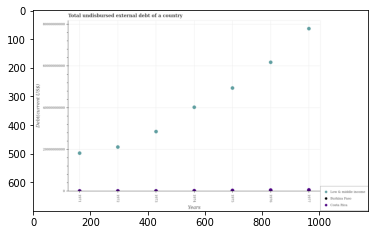

Number of QA =  28





,Years,Low & middle income,Burkina Faso,Costa Rica
0,1976,6.205188e+10,NaN,5.981393e+08
1,1972,2.138216e+10,NaN,3.508497e+08
2,1975,4.978076e+10,NaN,4.951430e+08
3,1974,4.050150e+10,NaN,4.147580e+08
4,1973,2.885977e+10,NaN,3.420181e+08
5,1971,1.846035e+10,NaN,3.332706e+08
6,1977,7.825936e+10,NaN,6.847725e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in costa rica in 1973 and that in 1975 ?
PREDICTED =  -153124915.15073138
EXPECTED =  -217519000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in costa rica in 1974 and the total undisbursed external debt in burkina faso in 1977?
PREDICTED =  -270014516.662079
EXPECTED =  50379000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the total undisbursed external debt in burkina faso and total undisbursed external debt in costa rica ?
PREDICTED =  280835427880.

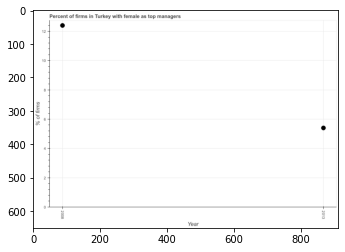

Number of QA =  20





,Year,% of firms
0,2013,5.465353
1,2008,12.496679


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms with female as top manager in 2008 and 2013 ?
PREDICTED =  7.031325859113891
EXPECTED =  7.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of firms with female as top manager ?
PREDICTED =  8.98101615290675
EXPECTED =  8.9




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of firms with female as top manager in 2008 to that in 2013 ?
PREDICTED =  2.2865272511708357
EXPECTED =  2.2962962962962963




				 3 / 3 = 1.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  % of firms
EX

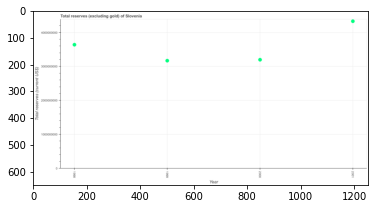

Number of QA =  24





,Year,Total reserves (current US$)
0,1998,3.676702e+09
1,2000,3.231295e+09
2,2001,4.373223e+09
3,1999,3.202518e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (excluding gold) in 1998 and 1999 ?
PREDICTED =  474183538.07146645
EXPECTED =  470511701.50626993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total reserves (excluding gold) ?
PREDICTED =  3453998231.929856
EXPECTED =  3417262825.16374




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total reserves (excluding gold) in 1998 to that in 2001 ?
PREDICTED =  0.840730388324456
EXPECTED =  0.8403052168619849




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

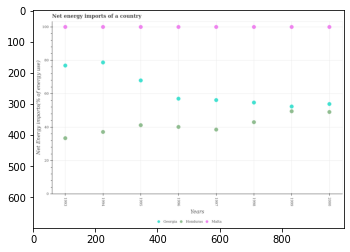

Number of QA =  28





,Years,Georgia,Malta,Honduras
0,1998,55.267035,100.688354,43.483355
1,1994,79.350725,100.650907,37.611388
2,1996,57.531535,100.661902,40.592204
3,1997,56.739758,100.686845,39.002803
4,1993,77.389930,100.689037,33.822700
5,1995,68.502981,100.685818,41.701316
6,1999,52.778587,100.682901,50.028406
7,2000,54.352245,100.675634,49.521518


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net energy imports in honduras in 1996 and that in 2000 ?
PREDICTED =  -8.929314191212463
EXPECTED =  -8.9365200119219




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net energy imports in georgia in 1995 and the net energy imports in honduras in 1997?
PREDICTED =  11.763222921097892
EXPECTED =  29.40360122906081




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the net energy imports in honduras and net energy imports in malta ?
PREDICTED =  235.0860159170881
EXPECTED =  -50.437230597596304




				 1 / 3 = 0.3333


is_bu

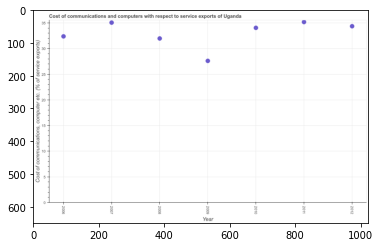

Number of QA =  24





,Year,"Cost of communications, computer etc. (% of service exports)"
0,2008,32.232707
1,2006,32.649123
2,2009,27.868187
3,2012,34.639961
4,2007,35.352430
5,2011,35.433163
6,2010,34.341799


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computer in 2006 and 2008 ?
PREDICTED =  167.63554145725917
EXPECTED =  0.40838126057390056




				 0 / 1 = 0.0


> what is the median cost of communications and computer ?
PREDICTED =  None
EXPECTED =  34.05793465840789




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cost of communications and computer in 2008 to that in 2012 ?
PREDICTED =  0.9305064443541022
EXPECTED =  0.9305940859698396




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest cost of communications and computer ?
PREDICTED 

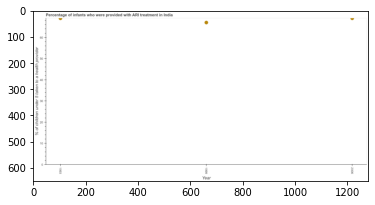

Number of QA =  24





,Year,% of children under 5 taken to a health provider
0,1993,69.801999
1,2006,69.757711
2,1999,67.776226


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who were provided with ari treatment in 1999 and 2006 ?
PREDICTED =  -1.9814853736909441
EXPECTED =  -2




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of children who were provided with ari treatment ?
PREDICTED =  1999.0
EXPECTED =  69.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of children who were provided with ari treatment in 1999 to that in 2006 ?
PREDICTED =  0.9715947477893996
EXPECTED =  0.9710144927536232




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or

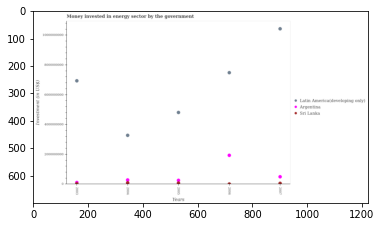

Number of QA =  28





,Years,Argentina,Latin America(developing only),Sri Lanka
0,2003,1.338502e+08,6.936846e+09,6.076651e+07
1,2006,1.949265e+09,7.486284e+09,3.199397e+07
2,2004,2.910847e+08,3.283822e+09,1.042614e+08
3,2005,2.719810e+08,4.819252e+09,6.774478e+07
4,2007,5.181238e+08,1.042572e+10,6.350130e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the money spent in energy sector in sri lanka in 2003 and that in 2005 ?
PREDICTED =  -6978269.889297321
EXPECTED =  -43320000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the money spent in energy sector in latin america(developing only) in 2004 and the money spent in energy sector in argentina in 2005?
PREDICTED =  -1535429895.4769735
EXPECTED =  3021140000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the money spent in energy sector in argentina and money spent in energy sector in latin america(developing only) ?
PR

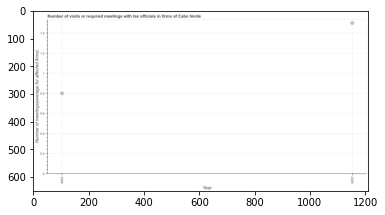

Number of QA =  20





,Year,Number of meetings(average for affected firms)
0,2009,1.496802
1,2006,0.800526


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of required meetings with tax officials in 2006 and 2009 ?
PREDICTED =  -0.6962754588672515
EXPECTED =  -0.7




				 1 / 1 = 1.0


> what is the median number of required meetings with tax officials ?
PREDICTED =  None
EXPECTED =  1.15




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of required meetings with tax officials in 2006 to that in 2009 ?
PREDICTED =  0.534824531398475
EXPECTED =  0.5333333333333333




				 2 / 4 = 0.5


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Number of meetings(average for affected firms)
EXPECTED =  0.2




				 2 / 5 = 0.4


> what is the title of the graph ?
PREDICTED =  Number of visits o

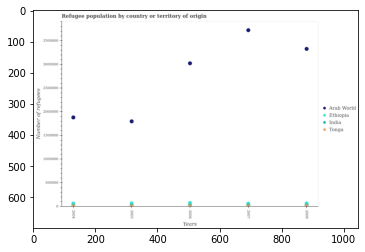

Number of QA =  29





,Years,Arab World,Ethiopia,Tonga,India
0,2004,1.890661e+06,72960.128553,16004.619865,47473.134478
1,2006,3.035705e+06,83851.561715,14895.651301,NaN
2,2008,3.341446e+06,45177.061364,17732.650397,75182.283820
3,2005,1.809415e+06,45366.475846,16522.848247,74963.744100
4,2007,3.737883e+06,70469.217636,12042.181380,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees in arab world in 2005 and that in 2007 ?
PREDICTED =  -1928468.075223461
EXPECTED =  -1925031




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees in tonga in 2008 and the number of refugees in ethiopia in 2007?
PREDICTED =  5690.46901677212
EXPECTED =  -59851.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the number of refugees in tonga and number of refugees in ethiopia ?
PREDICTED =  77192.9511901175
EXPECTED =  -63871.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_avai

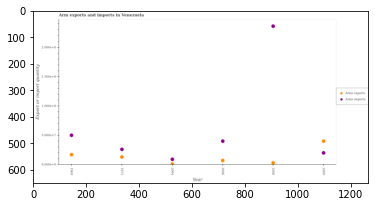

Number of QA =  27





,Year,Arms imports,Arms exports
0,2004,0.096469,0.015388
1,1975,0.266683,0.137674
2,1969,0.506261,0.176903
3,2008,2.369217,0.037765
4,2009,0.207115,0.407932
5,2006,0.407214,0.077799


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports in 1975 and that in 2006 ?
PREDICTED =  0.05987479920928736
EXPECTED =  6000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports in 1969 and the arms imports in 2006?
PREDICTED =  0.09910402906858896
EXPECTED =  -23000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the arms exports and arms imports ?
PREDICTED =  -0.23422792938156317
EXPECTED =  -13000000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after train

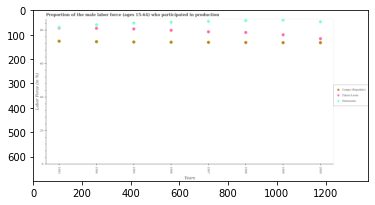

Number of QA =  28





,Years,Venezuela,Congo (Republic),Timor-Leste
0,2000,85.292716,72.840965,75.221634
1,1994,83.574199,73.395899,81.419164
2,1995,84.559681,73.219064,81.010169
3,1993,81.972234,73.725038,NaN
4,1997,85.505589,73.026024,79.308545
5,1998,86.067578,72.958059,78.962080
6,1999,86.362256,72.861976,77.528756
7,1996,85.021057,73.154146,80.222448


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in congo (republic) in 1994 and that in 1999 ?
PREDICTED =  -72.30704217402096
EXPECTED =  0.5999984741209943




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in congo (republic) in 1998 and the proportion of the male labor force who participated in production in timor-leste in 1999?
PREDICTED =  -72.74488204501436
EXPECTED =  -4.599998474121207




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between

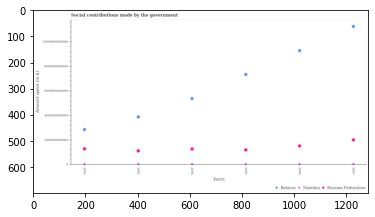

Number of QA =  28





,Years,Namibia,Russian Federation,Belarus
0,2007,5.110156e+10,2.036783e+12,1.127404e+13
1,2003,4.923150e+10,1.146357e+12,3.913181e+12
2,2004,5.122043e+10,1.303616e+12,5.403327e+12
3,2002,5.322690e+10,1.309014e+12,2.868293e+12
4,2006,5.068130e+10,1.546629e+12,9.306230e+12
5,2005,4.810323e+10,1.225876e+12,7.368884e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum amount spent on social contributions in russian federation ?
PREDICTED =  334.5
EXPECTED =  2004000000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on social contributions in russian federation in 2002 and that in 2004 ?
PREDICTED =  0.3333333333333333
EXPECTED =  11410984500.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on social contributions in belarus in 2004 and the amount spent on social contributions in russian federation in 2003?
PREDICTED =  0.16666666666666666
EXPECTED =  426637077570

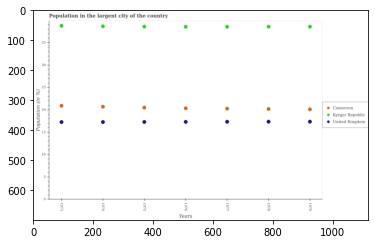

Number of QA =  28





,Years,Kyrgyz Republic,United Kingdom,Cameroon
0,1974,38.474496,17.234026,20.642239
1,1978,38.415442,17.315412,20.122422
2,1975,38.425664,17.258112,20.432142
3,1976,38.390066,17.283077,20.278397
4,1973,38.603662,17.232310,20.836793
5,1979,38.428259,17.316517,20.041282
6,1977,38.396140,17.293656,20.205628


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population in the largent city in kyrgyz republic in 1973 and that in 1979 ?
PREDICTED =  0.17540227007386022
EXPECTED =  0.19906654390028677




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population in the largent city in cameroon in 1973 and the percentage of population in the largent city in united kingdom in 1974?
PREDICTED =  0.19455438932611457
EXPECTED =  3.640439172573199




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1973, what is the difference between the percentage of population in the largent city in cameroon and p

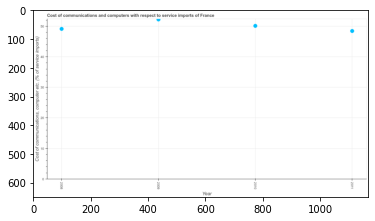

Number of QA =  24





,Year,"Cost of communications, computer etc. (% of service imports)"
0,2010,50.390930
1,2009,52.460153
2,2011,48.705462
3,2008,49.398169


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computer in 2009 and 2010 ?
PREDICTED =  -54.14562085581345
EXPECTED =  2.099711731457596




				 0 / 1 = 0.0


> what is the median cost of communications and computer ?
PREDICTED =  None
EXPECTED =  49.6126665997393




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cost of communications and computer in 2008 to that in 2011 ?
PREDICTED =  1.0142223637461456
EXPECTED =  1.0141989953376387




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest cost of communications and computer ?
PREDICTED =  

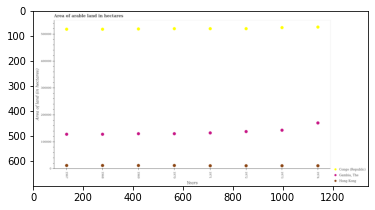

Number of QA =  28





,Years,"Gambia, The",Hong Kong,Congo (Republic)
0,1972,139217.527227,12376.791531,520148.411093
1,1971,134172.481189,12507.910591,520266.840357
2,1974,171045.647660,12432.884491,526187.911487
3,1968,129040.370965,13677.498260,518158.831243
4,1973,144035.502746,12406.180286,524081.684419
5,1970,131136.820620,13579.865425,520178.658197
6,1969,131218.699387,13327.743818,518951.518727
7,1967,128825.691763,13671.253149,517988.100945


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in congo (republic) in 1968 and that in 1973 ?
PREDICTED =  -5922.853176182602
EXPECTED =  -6000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in gambia, the in 1972 and the total arable land in congo (republic) in 1974?
PREDICTED =  -31828.120432291646
EXPECTED =  -388000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1970, what is the difference between the total arable land in hong kong and total arable land in congo (republic) ?
PREDICTED =  0.0
EXPECTED =  -508000




				 1 / 3 = 0.3333


is_built_with_cuda: True

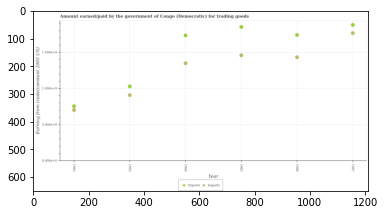

Number of QA =  27





,Year,Imports,Exports
0,1983,0.917689,1.040429
1,1986,1.445415,1.755104
2,1984,1.362680,1.747680
3,1982,0.711567,0.763912
4,1985,1.471129,1.865321
5,1987,1.780022,1.895484


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount paid for imports in 1983 and that in 1986 ?
PREDICTED =  -0.5277262151488528
EXPECTED =  -523851439.3088989




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from exports in 1985 and the amount paid for imports in 1982?
PREDICTED =  1.1014090333382112
EXPECTED =  1149286831.832338




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the amount paid for imports and amount earned from exports ?
PREDICTED =  -0.11546262082634007
EXPECTED =  -391832823.67042017




				 0 / 3 = 0.0


is_built_with_cuda: True
is

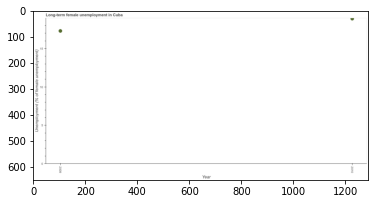

Number of QA =  20





,Year,Unemployment (% of female unemployment)
0,2009,17.313635
1,2010,18.912043


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term female unemployment in 2009 and 2010 ?
PREDICTED =  -1.5984080584891416
EXPECTED =  -1.6000003814697976




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median long-term female unemployment ?
PREDICTED =  18.11283868250085
EXPECTED =  18.0999994277954




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the long-term female unemployment in 2009 to that in 2010 ?
PREDICTED =  0.9154819982774023
EXPECTED =  0.9153438934516647




				 3 / 3 = 1.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Unemployment (% of female unempl

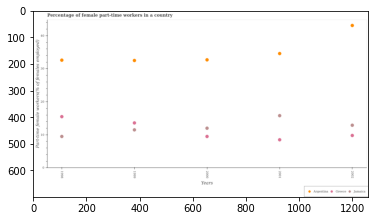

Number of QA =  28





,Years,Greece,Jamaica,Argentina
0,1998,15.670196,9.674506,32.855151
1,1999,13.817624,11.679453,32.786596
2,2002,9.980615,13.097637,43.417655
3,2000,9.666860,12.185551,32.980304
4,2001,8.684900,16.003865,34.897835


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female part-time workers in greece in 1998 and that in 1999 ?
PREDICTED =  1.8525714973825789
EXPECTED =  1.8999996185303




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female part-time workers in argentina in 1998 and the percentage of female part-time workers in greece in 2002?
PREDICTED =  -10.562504468087681
EXPECTED =  22.79999828338624




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of female part-time workers in jamaica and percentage of female part-time workers in argen

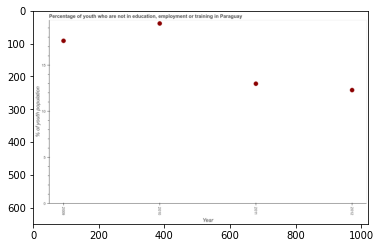

Number of QA =  24





,Year,% of youth population
0,2011,13.051006
1,2009,17.687090
2,2012,12.362615
3,2010,19.572370


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed youth population in 2009 and 2011 ?
PREDICTED =  4.636083597670439
EXPECTED =  4.650000572204499




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed youth population ?
PREDICTED =  2010.5
EXPECTED =  15.29500055313105




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unemployed youth population in 2009 to that in 2010 ?
PREDICTED =  0.9036764572843862
EXPECTED =  0.9035897866273487




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what

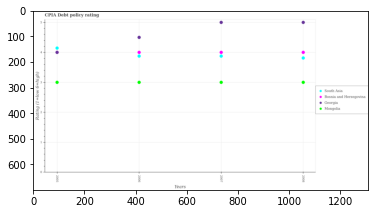

Number of QA =  29





,Years,Georgia,Mongolia,South Asia,Bosnia and Herzegovina
0,2007,5.039185,3.025331,3.905706,4.030330
1,2005,4.035329,3.027319,4.174434,NaN
2,2008,5.038163,3.027083,3.844246,4.034906
3,2006,4.537046,3.027100,3.904235,4.031221


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the cpia rating in south asia and cpia rating in mongolia ?
PREDICTED =  0.0
EXPECTED =  0.875




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in bosnia and herzegovina in 2006 to that in 2007?
PREDICTED =  1.0002210799711686
EXPECTED =  1.0




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation

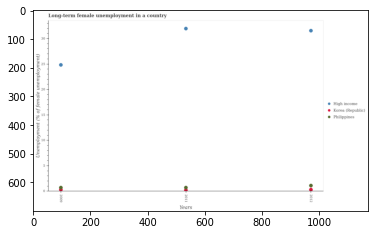

Number of QA =  28





,Years,Korea (Republic),Philippines,High income
0,2012,0.348917,1.160727,31.430874
1,2011,0.272300,0.756650,31.841443
2,2009,0.362690,0.764230,24.729094


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed female population in high income in 2011 and that in 2012 ?
PREDICTED =  0.4105688382864159
EXPECTED =  0.41174406425790977




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed female population in korea (republic) in 2012 and the percentage of long-term unemployed female population in philippines in 2009?
PREDICTED =  -0.01377260908811584
EXPECTED =  -0.39999997615814203




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of long-term unemployed

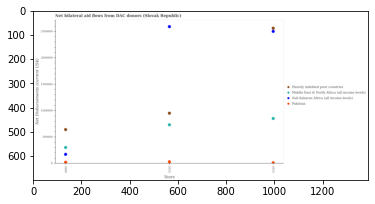

Number of QA =  29





,Years,Middle East & North Africa (all income levels),Pakistan,Heavily indebted poor countries,Sub-Saharan Africa (all income levels)
0,2012,738932.357948,36559.989659,9.588041e+05,2.605447e+06
1,2013,859809.260508,16002.461335,2.575214e+06,2.514245e+06
2,2009,306663.404678,25988.122684,6.474543e+05,1.780632e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in sub-saharan africa (all income levels) in 2012 and that in 2013 ?
PREDICTED =  91202.25578534976
EXPECTED =  90000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in middle east & north africa (all income levels) in 2013 and the net bilateral aid flows in heavily indebted poor countries in 2009?
PREDICTED =  553145.8558301062
EXPECTED =  210000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the net bilateral aid flows in heavily indebted poor countries and net bilater

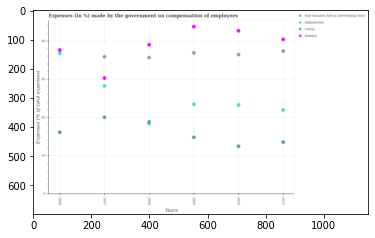

Number of QA =  29





,Years,Zambia,Latvia,Afghanistan,Sub-Saharan Africa (developing only)
0,2006,37.818763,16.260491,36.949526,NaN
1,2008,39.255999,18.933158,18.523638,35.879827
2,2009,43.986469,14.982293,23.631339,37.121738
3,2007,30.505133,20.217818,28.415215,36.091925
4,2011,40.678085,13.707216,22.164589,37.598386
5,2010,42.908110,12.634369,23.467418,36.677437


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on compensation of employees in afghanistan in 2008 and that in 2010 ?
PREDICTED =  -4.943779742080423
EXPECTED =  -4.919539688369703




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on compensation of employees in zambia in 2007 and the percentage of expenses made by the government on compensation of employees in sub-saharan africa (developing only) in 2010?
PREDICTED =  -6.172304583847936
EXPECTED =  -6.1654128811236895




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the yea

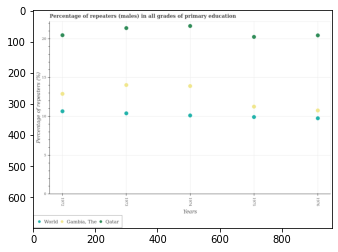

Number of QA =  28





,Years,World,"Gambia, The",Qatar
0,1974,10.254060,14.060716,21.842991
1,1976,9.873485,10.898249,20.622867
2,1973,10.531519,14.201202,21.569037
3,1972,10.778780,13.047120,20.639034
4,1975,10.046506,11.391008,20.427791


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters (males) in gambia, the in 1972 and that in 1974 ?
PREDICTED =  -1.013596503650648
EXPECTED =  -1.0023499999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters (males) in qatar in 1975 and the percentage of repeaters (males) in gambia, the in 1976?
PREDICTED =  -0.1950755313424004
EXPECTED =  9.47455




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the percentage of repeaters (males) in world and percentage of repeaters (males) in gambia, the ?
PREDICTED =  -2.846174359365

In [ ]:
# IMAGE_IDs = list(map(str, plot_types["hbar_categorical"][:5]))
# NO_CSV = 2

# IMAGE_IDs = []
# files = random.sample(csvs, NO_CSV)
# for f in files:
#   w = f.split("/content/final_csv/")[-1]
#   IMAGE_IDs.append(w.split(".csv")[0])

per_img_data_dl = []
IMG_COUNT = 0
for TEST_IMG in sample_dl_IMAGE_IDs:

  TOTAL_QA = 0
  TOTAL_CORRECT_QA = 0
  
  IMG_COUNT += 1
  print("Image number = ", IMG_COUNT)
  print("\n\n")
  
  IMAGE_ID = TEST_IMG

  ind, plotqa_questions, plotqa_answers = display_image_qa_pairs(IMAGE_ID)

  df = pd.read_csv('/home/pessat/Capstone/content/final_csv/' + IMAGE_ID + '.csv')
  

  dic_labels = dict()
  for col in df.columns:
    if col == 'xlabel':
      dic_labels['xlabel'] = df['xlabel'].iloc[-1].strip()
    elif col == 'ylabel':
      dic_labels['ylabel'] = df['ylabel'].iloc[-1].strip()
    elif col == 'title':
      dic_labels['title'] = df['title'].iloc[-1].strip()
  

  df.drop(axis = 1 , labels = ['Unknown' , 'xlabel' , 'ylabel' ,'title' , 'legend orientation'] , inplace= True, errors = 'ignore')
  columns = list(df.columns)

  display(df)

  data = get_list_of_list('/home/pessat/Capstone/content/final_csv/' + IMAGE_ID + '.csv', False)

  question_answer = dict()
  for i, q in enumerate(plotqa_questions):
      question_answer[q.lower()] = plotqa_answers[i]

  questions = plotqa_questions    

  tapas_questions, tabfact_questions = binary_classifier_predict(questions)
  tapas_find_answers(tapas_questions, columns, data, question_answer, dic_labels)
  tabfact_find_answers(data, tabfact_questions, columns, question_answer) 

  ACCURACY = round(TOTAL_CORRECT_QA * 100 / TOTAL_QA, 4)
  per_img_data_dl.append([TEST_IMG, TOTAL_CORRECT_QA, TOTAL_QA, ACCURACY])

In [ ]:
per_img_data_dl

[['4377', 17, 29, 58.6207],
 ['1798', 7, 28, 25.0],
 ['5443', 12, 25, 48.0],
 ['5299', 16, 24, 66.6667],
 ['1978', 17, 28, 60.7143],
 ['464', 14, 27, 51.8519],
 ['1086', 17, 27, 62.963],
 ['1196', 10, 28, 35.7143],
 ['5372', 13, 20, 65.0],
 ['5295', 14, 24, 58.3333],
 ['3435', 13, 29, 44.8276],
 ['5228', 11, 24, 45.8333],
 ['5289', 16, 24, 66.6667],
 ['2278', 14, 28, 50.0],
 ['995', 16, 27, 59.2593],
 ['1650', 14, 24, 58.3333],
 ['5164', 10, 25, 40.0],
 ['3052', 10, 29, 34.4828],
 ['200', 15, 27, 55.5556],
 ['354', 13, 24, 54.1667],
 ['2936', 14, 29, 48.2759],
 ['2706', 14, 28, 50.0],
 ['3045', 14, 29, 48.2759],
 ['5483', 12, 25, 48.0],
 ['1807', 18, 28, 64.2857],
 ['79', 15, 27, 55.5556],
 ['65', 17, 27, 62.963],
 ['3394', 11, 29, 37.931],
 ['5508', 15, 24, 62.5],
 ['3195', 13, 29, 44.8276],
 ['916', 11, 27, 40.7407],
 ['3892', 8, 29, 27.5862],
 ['4568', 12, 25, 48.0],
 ['2393', 17, 28, 60.7143],
 ['2922', 14, 29, 48.2759],
 ['1960', 18, 28, 64.2857],
 ['3244', 9, 29, 31.0345],
 ['499

In [ ]:
df_dl_per_img = pd.DataFrame(per_img_data_dl, columns=["Image ID", "Correct QA", "Total QA", "Accuracy"])
df_dl_per_img

,Image ID,Correct QA,Total QA,Accuracy
0,4377,17,29,58.6207
1,1798,7,28,25.0000
2,5443,12,25,48.0000
3,5299,16,24,66.6667
4,1978,17,28,60.7143
...,...,...,...,...
1221,3359,14,29,48.2759
1222,2482,11,28,39.2857
1223,4395,9,29,31.0345
1224,4048,17,29,58.6207


In [ ]:
print(f"AVERAGE ACCURACY FOR DOT-LINE IMGS = {round(df_dl_per_img['Accuracy'].mean(), 4)} %")

AVERAGE ACCURACY FOR DOT-LINE IMGS = 47.1558 %


### Save the data - dot-line

In [ ]:
df_dl_per_img.to_csv("/home/pessat/Capstone/dot_line_3.csv", encoding='utf-8', index=False)

In [ ]:
# from google.colab import files
# files.download("/content/dot_line_1.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### line


In [ ]:
count = 500

sample_l_IMAGE_IDs = l_IMAGE_IDs[0: count]

In [ ]:
# already_done = [str(i) for i in list(pd.read_csv("/content/line.csv")['Image ID'])]
# set(sample_l_IMAGE_IDs).intersection(set(already_done))

set()

In [ ]:
# sample_l_IMAGE_IDs

Image number =  1




Image:

/home/pessat/Capstone/TEST/png/17083.png


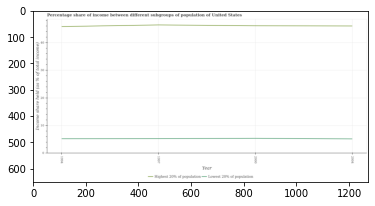

Number of QA =  27





,Year,Lowest 20% of population,Highest 20% of population
0,1994,NaN,46.157377
1,1997,5.422563,46.742648
2,2004,5.294256,46.458848
3,2000,5.533948,46.458848


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 20% of the population in 2000 and that in 2004 ?
PREDICTED =  41.164591803467104
EXPECTED =  0.21999999999999975




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the income share held by highest 20% of the population and income share held by lowest 20% of the population ?
PREDICTED =  -44.458847865596006
EXPECTED =  41.14




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is 

In [ ]:
# IMAGE_IDs = list(map(str, plot_types["hbar_categorical"][:5]))
# NO_CSV = 2

# IMAGE_IDs = []
# files = random.sample(csvs, NO_CSV)
# for f in files:
#   w = f.split("/content/final_csv/")[-1]
#   IMAGE_IDs.append(w.split(".csv")[0])

per_img_data_l = []
IMG_COUNT = 0
for TEST_IMG in sample_l_IMAGE_IDs:

  TOTAL_QA = 0
  TOTAL_CORRECT_QA = 0
  
  IMG_COUNT += 1
  print("Image number = ", IMG_COUNT)
  print("\n\n")
  
  IMAGE_ID = TEST_IMG

  ind, plotqa_questions, plotqa_answers = display_image_qa_pairs(IMAGE_ID)

  df = pd.read_csv('/home/pessat/Capstone/content/final_csv/' + IMAGE_ID + '.csv')
  

  dic_labels = dict()
  for col in df.columns:
    if col == 'xlabel':
      dic_labels['xlabel'] = df['xlabel'].iloc[-1].strip()
    elif col == 'ylabel':
      dic_labels['ylabel'] = df['ylabel'].iloc[-1].strip()
    elif col == 'title':
      dic_labels['title'] = df['title'].iloc[-1].strip()
  

  df.drop(axis = 1 , labels = ['Unknown' , 'xlabel' , 'ylabel' ,'title' , 'legend orientation'] , inplace= True, errors = 'ignore')
  columns = list(df.columns)

  display(df)

  data = get_list_of_list('/home/pessat/Capstone/content/final_csv/' + IMAGE_ID + '.csv', False)

  question_answer = dict()
  for i, q in enumerate(plotqa_questions):
      question_answer[q.lower()] = plotqa_answers[i]

  questions = plotqa_questions    

  tapas_questions, tabfact_questions = binary_classifier_predict(questions)
  tapas_find_answers(tapas_questions, columns, data, question_answer, dic_labels)
  tabfact_find_answers(data, tabfact_questions, columns, question_answer) 

  ACCURACY = round(TOTAL_CORRECT_QA * 100 / TOTAL_QA, 4)
  per_img_data_l.append([TEST_IMG, TOTAL_CORRECT_QA, TOTAL_QA, ACCURACY])

In [ ]:
per_img_data_l

[['17083', 10, 27, 37.037]]

In [ ]:
df_line_per_img = pd.DataFrame(per_img_data_l, columns=["Image ID", "Correct QA", "Total QA", "Accuracy"])
df_line_per_img

,Image ID,Correct QA,Total QA,Accuracy
0,17083,10,27,37.037


In [ ]:
print(f"AVERAGE ACCURACY FOR LINE IMGS = {round(df_line_per_img['Accuracy'].mean(), 4)} %")

AVERAGE ACCURACY FOR LINE IMGS = 37.037 %


### Save the data - line

In [ ]:
df_line_per_img.to_csv("/home/pessat/Capstone/line_2.csv", encoding='utf-8', index=False)

In [ ]:
# from google.colab import files
# files.download("/content/line_1.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>